In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import requests
import tensorflow_datasets as tfds
import tqdm
import os
import shutil
import re
import cv2
import time
import logging

2023-11-06 21:22:51.408127: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
class TqdmLoggingHandler(logging.Handler):
    def __init__(self, level=logging.NOTSET):
        super().__init__(level)

    def emit(self, record):
        try:
            msg = self.format(record)
            tqdm.tqdm.write(msg)
            self.flush()
        except (KeyboardInterrupt, SystemExit):
            raise
        except:
            self.handleError(record)
log = logging.getLogger(__name__)
log.setLevel(logging.INFO)
log.addHandler(TqdmLoggingHandler())

In [3]:
# Load the 'cats_vs_dogs' dataset
ds, info = tfds.load('cats_vs_dogs', split='train', with_info=True)

# Define the map function to modify the feature structure
def map_function(data):
    modified_data = {
        'image': data['image'],
        'label': tf.one_hot(data['label'], depth=5)  # Modify the label feature as required
    }
    return modified_data

# Apply the map function to the dataset
modified_ds = ds.map(map_function)

# Split the modified dataset into training and testing subsets
train_data = modified_ds.skip(600)
test_data = modified_ds.take(600)




In [4]:
tqdm.tqdm(train_data)

  0%|          | 0/22662 [00:00<?, ?it/s]

In [5]:
@tf.function
def build_data(data):
  #cropped=tf.dtypes.cast(tf.image.random_crop(data['image'] / 255,(128,128,3)),tf.float32)
  #cropped = tf.image.resize(data['image'], (128, 128)) / 255.0
  resized = tf.image.resize(data['image'], (128, 128))
  resized_normalized = resized / 255.0  # Normalize the resized image

  # Cast the normalized image to float16
  resized_normalized_float32 = tf.dtypes.cast(resized_normalized, tf.float32)
  lr=tf.image.resize(resized_normalized_float32,(32,32))
  #lr=tf.image.resize(lr,(128,128),method=tf.image.ResizeMethod.BICUBIC)
  return (lr,resized_normalized_float32)

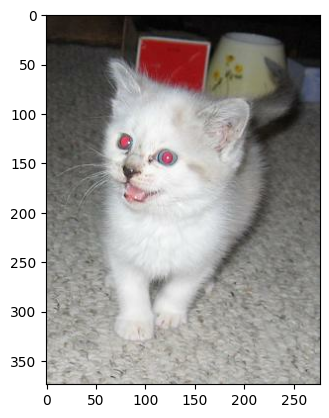

In [6]:
for x in train_data.take(1):
  plt.imshow(x['image'])
  plt.show()

In [7]:
def bicubic_interpolate(image,shape):
  img_resized=cv2.resize(image,shape, interpolation=cv2.INTER_CUBIC)
  return img_resized

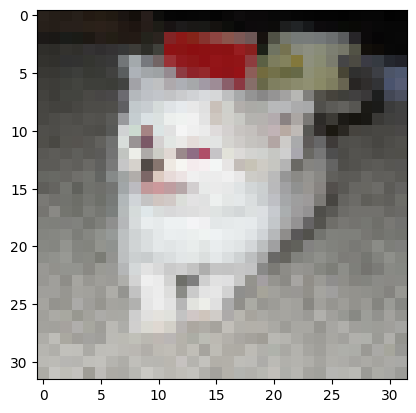

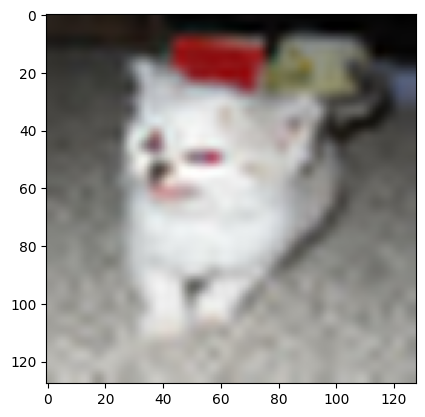

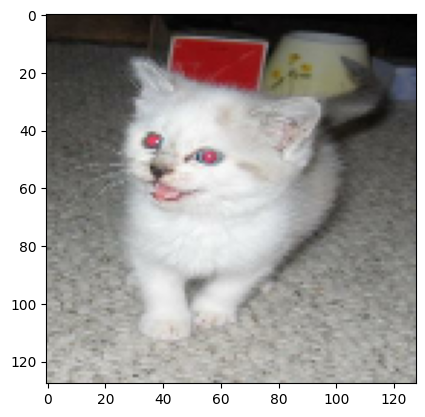

In [8]:
train_dataset_mapped = train_data.map(build_data,num_parallel_calls=tf.data.AUTOTUNE)
for x in train_dataset_mapped.take(1):
  plt.imshow(x[0].numpy())
  plt.show()

  plt.imshow(bicubic_interpolate(x[0].numpy(),(128,128)))
  plt.show()
  plt.imshow(x[1].numpy())
  plt.show()

In [9]:
def residual_block_gen(ch=64,k_s=3,st=1):
  model=tf.keras.Sequential([
    tf.keras.layers.Conv2D(ch,k_s,strides=(st,st),padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LeakyReLU(),
    tf.keras.layers.Conv2D(ch,k_s,strides=(st,st),padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LeakyReLU(),
  ])
  return model

def Upsample_block(x, ch=256, k_s=3, st=1):
    x = tf.keras.layers.Conv2D(ch,k_s, strides=(st,st), padding='same')(x)
    x = tf.nn.depth_to_space(x, 2) # Subpixel pixelshuffler
    x = tf.keras.layers.LeakyReLU()(x)
    return x

input_lr=tf.keras.layers.Input(shape=(None,None,3))
input_conv=tf.keras.layers.Conv2D(64,9,padding='same')(input_lr)
input_conv=tf.keras.layers.LeakyReLU()(input_conv)

SRRes=input_conv
for x in range(5):
  res_output=residual_block_gen()(SRRes)
  SRRes=tf.keras.layers.Add()([SRRes,res_output])

SRRes=tf.keras.layers.Conv2D(64,9,padding='same')(SRRes)
SRRes=tf.keras.layers.BatchNormalization()(SRRes)

SRRes=tf.keras.layers.Add()([SRRes,input_conv])

SRRes=Upsample_block(SRRes)
SRRes=Upsample_block(SRRes)

output_sr=tf.keras.layers.Conv2D(3,9,activation='tanh',padding='same')(SRRes)

SRResnet=tf.keras.models.Model(input_lr,output_sr)

In [10]:
tf.keras.utils.plot_model(SRResnet,show_shapes=True)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [11]:
def residual_block_disc(ch=64,k_s=3,st=1):
  model=tf.keras.Sequential([
    tf.keras.layers.Conv2D(ch,k_s,strides=(st,st),padding='same'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.LeakyReLU(),
  ])
  return model

input_lr=tf.keras.layers.Input(shape=(128,128,3))
input_conv=tf.keras.layers.Conv2D(64,3,padding='same')(input_lr)
input_conv=tf.keras.layers.LeakyReLU()(input_conv)

channel_nums=[64,128,128,256,256,512,512]
stride_sizes=[2,1,2,1,2,1,2]

disc=input_conv
for x in range(7):
  disc=residual_block_disc(ch=channel_nums[x],st=stride_sizes[x])(disc)

disc=tf.keras.layers.Flatten()(disc)

disc=tf.keras.layers.Dense(1024)(disc)
disc=tf.keras.layers.LeakyReLU()(disc)

disc_output=tf.keras.layers.Dense(1,activation='sigmoid')(disc)

discriminator=tf.keras.models.Model(input_lr,disc_output)

In [12]:
tf.keras.utils.plot_model(discriminator,show_shapes=True)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [13]:
def PSNR(y_true,y_pred):
  mse=tf.reduce_mean( (y_true - y_pred) ** 2 )
  return 20 * log10(1 / (mse ** 0.5))

def log10(x):
  numerator = tf.math.log(x)
  denominator = tf.math.log(tf.constant(10, dtype=numerator.dtype))
  return numerator / denominator

def pixel_MSE(y_true,y_pred):
  return tf.reduce_mean( (y_true - y_pred) ** 2 )

In [14]:
VGG19=tf.keras.applications.VGG19(weights='imagenet',include_top=False,input_shape=(128,128,3))
VGG19.layers

In [15]:
VGG19=tf.keras.applications.VGG19(weights='imagenet',include_top=False,input_shape=(128,128,3))

VGG_i,VGG_j=2,2
def VGG_loss(y_hr,y_sr,i_m=2,j_m=2):
  i,j=0,0
  accumulated_loss=0.0
  for l in VGG19.layers:
    cl_name=l.__class__.__name__
    if cl_name=='Conv2D':
      j+=1
    if cl_name=='MaxPooling2D':
      i+=1
      j=0
    if i==i_m and j==j_m:
      break

    y_hr=l(y_hr)
    y_sr=l(y_sr)
    if cl_name=='Conv2D':
      accumulated_loss+=tf.reduce_mean((y_hr-y_sr)**2) * 0.006

  return accumulated_loss
def VGG_loss_intuitive(y_true,y_pred):
  accumulated_loss=0.0
  for l in VGG19.layers:
    y_true=l(y_true)
    y_pred=l(y_pred)
    accumulated_loss+=tf.reduce_mean((y_true-y_pred)**2) * 0.006
  return accumulated_loss

In [17]:
generator_optimizer=tf.keras.optimizers.SGD(0.0001)
discriminator_optimizer=tf.keras.optimizers.SGD(0.0001)

adv_ratio=0.001
evaluate=['PSNR']
# MSE
loss_func,adv_learning = pixel_MSE,False
# VGG2.2
loss_func,adv_learning = lambda y_hr,y_sr:VGG_loss(y_hr,y_sr,i_m=2,j_m=2),False
# VGG 5.4
loss_func,adv_learning = lambda y_hr,y_sr:VGG_loss(y_hr,y_sr,i_m=5,j_m=4),False
# SRGAN-MSE
loss_func,adv_learning = pixel_MSE,True
# SRGAN-VGG 2.2
loss_func,adv_learning = lambda y_hr,y_sr:VGG_loss(y_hr,y_sr,i_m=2,j_m=2),True
# SRGAN-VGG 5.4
loss_func,adv_learning = lambda y_hr,y_sr:VGG_loss(y_hr,y_sr,i_m=5,j_m=4),True

#Real loss
loss_func,adv_learning = lambda y_hr,y_sr:VGG_loss(y_hr,y_sr,i_m=5,j_m=4),True

In [18]:
cross_entropy = tf.keras.losses.BinaryCrossentropy()
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

@tf.function()
def train_step(data,loss_func=pixel_MSE,adv_learning=True,evaluate=['PSNR'],adv_ratio=0.001):
  logs={}
  gen_loss,disc_loss=0,0

  low_resolution,high_resolution=data
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    super_resolution = SRResnet(low_resolution, training=True)
    gen_loss=loss_func(high_resolution,super_resolution)

    logs['reconstruction']=gen_loss

    if adv_learning:
      real_output = discriminator(high_resolution, training=True)
      fake_output = discriminator(super_resolution, training=True)

      adv_loss_g = generator_loss(fake_output) * adv_ratio
      gen_loss += adv_loss_g

      disc_loss = discriminator_loss(real_output, fake_output)

      logs['adv_g']=adv_loss_g
      logs['adv_d']=disc_loss

  gradients_of_generator = gen_tape.gradient(gen_loss, SRResnet.trainable_variables)
  generator_optimizer.apply_gradients(zip(gradients_of_generator, SRResnet.trainable_variables))

  if adv_learning:
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
  for x in evaluate:
    if x=='PSNR':
      logs[x]=PSNR(high_resolution,super_resolution)

  return logs

In [19]:
SRResnet=tf.keras.models.load_model('SRGAN Models/SRResNet-generator-150.h5',compile=False)
discriminator=tf.keras.models.load_model('SRGAN Models/discriminator-150.h5',compile=False)


In [ ]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

# Mount Drive
from google.colab import drive
drive.mount('/content/drive')

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 5016795483927465159
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 15240134656
locality {
  bus_id: 1
  links {
  }
}
incarnation: 15255235507692616726
physical_device_desc: "device: 0, name: Tesla V100-SXM2-16GB, pci bus id: 0000:00:04.0, compute capability: 7.0"
xla_global_id: 416903419
]
Mounted at /content/drive


In [ ]:
DirPath = '/content/drive/MyDrive/AI/midterm/SRGAN-Training/'
x=0
print(DirPath + 'SRResNet-generator-' + str(x+33) + '.h5')

/content/drive/MyDrive/AI/midterm/SRGAN-Training/SRResNet-generator-33.h5


In [ ]:
for x in range(155):
  train_dataset_mapped = train_data.map(build_data,num_parallel_calls=tf.data.AUTOTUNE).batch(64)
  val_dataset_mapped = test_data.map(build_data,num_parallel_calls=tf.data.AUTOTUNE).batch(64)

  for image_batch in tqdm.tqdm(train_dataset_mapped, position=0, leave=True):
    logs=train_step(image_batch,loss_func,adv_learning,evaluate,adv_ratio)
    for k in logs.keys():
      print(k,':',logs[k],end='  ')
    print()

  SRResnet.save(DirPath + 'SRResNet-generator-' + str(x+33) + '.h5')
  discriminator.save(DirPath + 'discriminator-' + str(x+33) + '.h5')

  0%|          | 1/355 [00:30<2:58:50, 30.31s/it]

reconstruction : tf.Tensor(1.325645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006849241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029919662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.523505, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:30<1:14:37, 12.68s/it]

tf.Tensor(1.2927095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068490575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031978025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.498968, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:30<41:19,  7.04s/it]  

tf.Tensor(1.2686188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066295024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039159693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6473055, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:31<25:43,  4.40s/it]

tf.Tensor(1.3758104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069613424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032787872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322338, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:31<17:06,  2.93s/it]

tf.Tensor(1.2237269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068132035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034505879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.766073, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:32<11:56,  2.05s/it]

tf.Tensor(1.2445514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006881246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003159239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.62461, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:32<08:40,  1.50s/it]

tf.Tensor(1.3450543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068816068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049266936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240722, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:32<06:32,  1.13s/it]

tf.Tensor(1.3312428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006949876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028345664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083288, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:33<05:05,  1.13it/s]

tf.Tensor(1.4094076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069728154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024501914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314074, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:33<04:06,  1.40it/s]

tf.Tensor(1.3191068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069046416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003466724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280597, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:33<03:26,  1.67it/s]

tf.Tensor(1.4105818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066017257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007931961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.812161, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:34<02:58,  1.93it/s]

tf.Tensor(1.3833985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067626927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039743884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290871, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:34<02:39,  2.15it/s]

tf.Tensor(1.5146368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069331005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036225342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327506, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:34<02:26,  2.33it/s]

tf.Tensor(1.3759177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00698344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002846937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.507877, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:35<02:15,  2.50it/s]

tf.Tensor(1.2679392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069230436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031527816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.47935, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:35<02:10,  2.60it/s]

tf.Tensor(1.50472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004097924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477784, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:35<02:05,  2.68it/s]

tf.Tensor(1.3031372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006724028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004061815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.689404, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:36<02:01,  2.76it/s]

tf.Tensor(1.3291497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065747676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054805153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.571442, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:36<01:58,  2.83it/s]

tf.Tensor(1.3403105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067248484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004014422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.398866, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:36<01:57,  2.86it/s]

tf.Tensor(1.2582222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072544026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026848568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.589225, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:37<01:55,  2.90it/s]

tf.Tensor(1.442213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006809333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054593524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.639856, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:37<01:54,  2.92it/s]

tf.Tensor(1.3997597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068911016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004221468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.59578, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:37<01:52,  2.94it/s]

tf.Tensor(1.2825071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006545305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045590503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.637961, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:38<01:53,  2.91it/s]

tf.Tensor(1.4237702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070000454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030817017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037853, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:38<01:52,  2.92it/s]

tf.Tensor(1.2963643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006730986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047334307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.50467, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:38<01:52,  2.94it/s]

tf.Tensor(1.4123309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069292467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004433378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.627997, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:39<01:52,  2.93it/s]

tf.Tensor(1.4590373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040645124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.496455, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:39<01:51,  2.92it/s]

tf.Tensor(1.4694948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068930783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035636737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366896, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:39<01:50,  2.94it/s]

tf.Tensor(1.3357428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00682881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004339661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.377549, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:40<01:51,  2.91it/s]

tf.Tensor(1.3692752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00688942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004282669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149717, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:40<01:51,  2.90it/s]

tf.Tensor(1.3677988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068279714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004957416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.506429, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:40<01:51,  2.90it/s]

tf.Tensor(1.3240485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006782014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034754782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.600729, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:41<01:50,  2.92it/s]

tf.Tensor(1.3742971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067514316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042763846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253292, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:41<01:52,  2.86it/s]

tf.Tensor(1.3765273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006696898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033620805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169579, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:41<01:50,  2.90it/s]

tf.Tensor(1.4103311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067696357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042804396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3731365, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:42<01:50,  2.89it/s]

tf.Tensor(1.2146989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070545906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029689125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.667698, shape=(), dtype=float32)  


 10%|█         | 37/355 [00:42<01:54,  2.79it/s]

reconstruction : tf.Tensor(1.4361132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068379757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037464225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.636341, shape=(), dtype=float32)  


 11%|█         | 38/355 [00:42<01:52,  2.82it/s]

reconstruction : tf.Tensor(1.3280593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071086744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004305645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.666893, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:43<01:53,  2.79it/s]

tf.Tensor(1.3378456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068527283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004293879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265164, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:43<01:53,  2.78it/s]

tf.Tensor(1.3310912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069952374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004507228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.630854, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:44<01:52,  2.79it/s]

tf.Tensor(1.3809088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006585937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00407324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193217, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:44<01:52,  2.79it/s]

tf.Tensor(1.2749029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068863435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038190982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.837777, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:44<01:49,  2.84it/s]

tf.Tensor(1.4021515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073555424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027023272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092326, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:45<01:48,  2.87it/s]

tf.Tensor(1.2665035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006780292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037570568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.744979, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:45<01:48,  2.87it/s]

tf.Tensor(1.3902324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068109324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004288233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.489198, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:45<01:47,  2.87it/s]

tf.Tensor(1.3755286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068541826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003543959, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5339155, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:46<01:46,  2.89it/s]

tf.Tensor(1.3918331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006479584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050594257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415841, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:46<01:45,  2.92it/s]

tf.Tensor(1.418502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066060885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057350304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.67297, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:46<01:44,  2.93it/s]

tf.Tensor(1.2763866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069322204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036517866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.770309, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:47<01:43,  2.95it/s]

tf.Tensor(1.397918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066599334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043275887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154794, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:47<01:43,  2.95it/s]

tf.Tensor(1.3264166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006767228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00470616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.7143755, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:47<01:43,  2.92it/s]

tf.Tensor(1.3605555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068523027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004339434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.57865, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:48<01:43,  2.90it/s]

tf.Tensor(1.3867391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006666832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004243358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19357, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:48<01:42,  2.93it/s]

tf.Tensor(1.3201914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007151375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002644422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091037, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:48<01:43,  2.91it/s]

tf.Tensor(1.2356254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068905368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024377706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.632687, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:49<01:42,  2.91it/s]

tf.Tensor(1.264555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068491627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003199185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51654, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:49<01:42,  2.92it/s]

tf.Tensor(1.3164933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006855178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029546157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218767, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:49<01:41,  2.94it/s]

tf.Tensor(1.3649554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071303295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029032603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.711392, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:50<01:40,  2.94it/s]

tf.Tensor(1.3520302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067706294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004306646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.525186, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:50<01:40,  2.94it/s]

tf.Tensor(1.3284833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068437858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048163487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.531732, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:50<01:40,  2.91it/s]

tf.Tensor(1.3420187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006780951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046455516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.699446, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:51<01:39,  2.94it/s]

tf.Tensor(1.4062457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006708973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006529025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45814, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:51<01:40,  2.91it/s]

tf.Tensor(1.3136067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067775454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004044629, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6442375, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:51<01:40,  2.90it/s]

tf.Tensor(1.4375113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00671806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041404217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.527187, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:52<01:40,  2.90it/s]

tf.Tensor(1.3650987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00679759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045650946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372297, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:52<01:39,  2.91it/s]

tf.Tensor(1.4025683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070789126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026469794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256556, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:52<01:38,  2.93it/s]

tf.Tensor(1.2589487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067609292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00431911, shape=(), dtype=float32)  PSNR : tf.Tensor(13.630068, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:53<01:38,  2.92it/s]

tf.Tensor(1.316714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071483087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026583213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051178, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:53<01:37,  2.92it/s]

tf.Tensor(1.2436721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069308598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003599018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.883411, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:54<01:37,  2.93it/s]

tf.Tensor(1.3177265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070918626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003530752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522612, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:54<01:37,  2.91it/s]

tf.Tensor(1.2783978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066581997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046083545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.547198, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:54<01:36,  2.92it/s]

tf.Tensor(1.4005759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068820403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050020637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358168, shape=(), dtype=float32)  


 21%|██        | 73/355 [00:55<01:44,  2.70it/s]

reconstruction : tf.Tensor(1.3825142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007120911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031355284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089742, shape=(), dtype=float32)  


 21%|██        | 74/355 [00:55<01:47,  2.61it/s]

reconstruction : tf.Tensor(1.4333797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003539959, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025031, shape=(), dtype=float32)  


 21%|██        | 75/355 [00:55<01:47,  2.60it/s]

reconstruction : tf.Tensor(1.3689827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006845019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036474692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38515, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:56<01:48,  2.57it/s]

tf.Tensor(1.2634442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067699444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038084253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.527921, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:56<01:46,  2.60it/s]

tf.Tensor(1.3254465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067470525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003558796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292711, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:57<01:44,  2.64it/s]

tf.Tensor(1.3429332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068877405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040814593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.616337, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:57<01:43,  2.67it/s]

tf.Tensor(1.4023818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006837005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029343567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20083, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:57<01:42,  2.69it/s]

tf.Tensor(1.4014543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068752063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034879358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278134, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:58<01:41,  2.69it/s]

tf.Tensor(1.3291671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00684516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004077311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.405637, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:58<01:40,  2.73it/s]

tf.Tensor(1.441302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066563184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053550047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.396915, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:58<01:38,  2.76it/s]

tf.Tensor(1.3747904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070656645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049144514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330097, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:59<01:36,  2.82it/s]

tf.Tensor(1.2861482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069601275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025667432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435068, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:59<01:35,  2.83it/s]

tf.Tensor(1.360068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007024996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003025668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.495047, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:59<01:34,  2.86it/s]

tf.Tensor(1.3524096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007021255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031278534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23455, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [01:00<01:32,  2.89it/s]

tf.Tensor(1.3793781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066990755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038984213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.471359, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [01:00<01:33,  2.86it/s]

tf.Tensor(1.3271682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066498513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051816497, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51707, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [01:00<01:31,  2.90it/s]

tf.Tensor(1.271664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006729992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004556305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.887816, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [01:01<01:31,  2.89it/s]

tf.Tensor(1.4252398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006919523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045768544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.452511, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [01:01<01:30,  2.92it/s]

tf.Tensor(1.3722169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067526544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040828614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.591692, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [01:01<01:29,  2.93it/s]

tf.Tensor(1.395449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066896738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053525134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435201, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [01:02<01:28,  2.95it/s]

tf.Tensor(1.2148674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069815824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030116371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.478459, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [01:02<01:28,  2.95it/s]

tf.Tensor(1.3435326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006839783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038215732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.630141, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [01:02<01:28,  2.94it/s]

tf.Tensor(1.3124621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068779346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035941785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.680983, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [01:03<01:27,  2.95it/s]

tf.Tensor(1.3704147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070585264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0062172553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934002, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [01:03<01:27,  2.95it/s]

tf.Tensor(1.404485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067399293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004059694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558009, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [01:03<01:27,  2.94it/s]

tf.Tensor(1.2969503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038992164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.680979, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [01:04<01:27,  2.93it/s]

tf.Tensor(1.2765926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006820495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004160198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.578978, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [01:04<01:27,  2.92it/s]

tf.Tensor(1.3541774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006812115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040342687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.620195, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [01:05<01:26,  2.93it/s]

tf.Tensor(1.2611665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006917359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028396184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.549278, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [01:05<01:25,  2.95it/s]

tf.Tensor(1.2991215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006810771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040227734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6305275, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [01:05<01:26,  2.92it/s]

tf.Tensor(1.2879488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006533136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036423677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.771288, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [01:06<01:25,  2.93it/s]

tf.Tensor(1.3907442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006878649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035919403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.436889, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [01:06<01:26,  2.90it/s]

tf.Tensor(1.3812724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006730721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034398346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204523, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [01:06<01:25,  2.90it/s]

tf.Tensor(1.3905792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067753126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047624055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1793785, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [01:07<01:25,  2.91it/s]

tf.Tensor(1.4032656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00654306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042771935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338579, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [01:07<01:24,  2.91it/s]

tf.Tensor(1.2478577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006889011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022496544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29104, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [01:07<01:23,  2.93it/s]

tf.Tensor(1.2513585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006724167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005225957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.470054, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [01:08<01:23,  2.92it/s]

tf.Tensor(1.3414212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068861307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045217033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.394625, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [01:08<01:22,  2.94it/s]

tf.Tensor(1.2929207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068811886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002726351, shape=(), dtype=float32)  PSNR : tf.Tensor(13.591445, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [01:08<01:23,  2.91it/s]

tf.Tensor(1.335874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067949337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044317776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.379507, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [01:09<01:24,  2.87it/s]

tf.Tensor(1.2296726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069322553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028163414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544905, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [01:09<01:23,  2.89it/s]

tf.Tensor(1.298184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070129903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029181358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.553616, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [01:09<01:24,  2.84it/s]

tf.Tensor(1.3617761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038760018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416183, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [01:10<01:24,  2.84it/s]

tf.Tensor(1.3009855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067300857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039406186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.73767, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [01:10<01:25,  2.79it/s]

tf.Tensor(1.4202566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068135816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038673966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363484, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [01:10<01:24,  2.79it/s]

tf.Tensor(1.3728582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070524304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036423795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.474614, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [01:11<01:25,  2.78it/s]

tf.Tensor(1.2296498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070644133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002705185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.599926, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [01:11<01:23,  2.83it/s]

tf.Tensor(1.4155447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065496704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009006998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.645743, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [01:11<01:21,  2.87it/s]

tf.Tensor(1.3569309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006823711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028600306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.573646, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [01:12<01:22,  2.82it/s]

tf.Tensor(1.4050236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069592968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034410327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308428, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [01:12<01:23,  2.79it/s]

tf.Tensor(1.3381627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006834177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045390413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.610412, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [01:13<01:21,  2.83it/s]

tf.Tensor(1.2553036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072219823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030274803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285666, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [01:13<01:20,  2.86it/s]

tf.Tensor(1.4084321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00688161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005101065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417987, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [01:13<01:19,  2.87it/s]

tf.Tensor(1.4239186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006758141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033835117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180692, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [01:14<01:18,  2.89it/s]

tf.Tensor(1.3233255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006949044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026948233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203838, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [01:14<01:17,  2.91it/s]

tf.Tensor(1.3181481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006759365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0067994343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.86024, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [01:14<01:17,  2.92it/s]

tf.Tensor(1.2436838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068066646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029669951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375344, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [01:15<01:17,  2.90it/s]

tf.Tensor(1.3756579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006890731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032114233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01977, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [01:15<01:16,  2.92it/s]

tf.Tensor(1.2182564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006823504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007111791, shape=(), dtype=float32)  PSNR : tf.Tensor(13.693479, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [01:15<01:16,  2.93it/s]

tf.Tensor(1.4208168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006514489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0059575196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.720769, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [01:16<01:15,  2.94it/s]

tf.Tensor(1.4454759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006475906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057205143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196162, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [01:16<01:15,  2.94it/s]

tf.Tensor(1.3830769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070885015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033557685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.492485, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [01:16<01:15,  2.93it/s]

tf.Tensor(1.4427911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006929137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038149944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257998, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [01:17<01:14,  2.94it/s]

tf.Tensor(1.3106565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007359334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030898126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201032, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [01:17<01:14,  2.94it/s]

tf.Tensor(1.296794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069636134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046623643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.505368, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [01:17<01:14,  2.93it/s]

tf.Tensor(1.4271802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068607945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004069185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.489353, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [01:18<01:13,  2.93it/s]

tf.Tensor(1.307796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006952674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036635143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.764574, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [01:18<01:12,  2.95it/s]

tf.Tensor(1.3517599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067920005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003996498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3370905, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [01:18<01:13,  2.92it/s]

tf.Tensor(1.3004408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068910206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032351068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.549205, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [01:19<01:13,  2.91it/s]

tf.Tensor(1.3420314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006864716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036247296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346069, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [01:19<01:12,  2.92it/s]

tf.Tensor(1.3305292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006667899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053681685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.549718, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [01:19<01:13,  2.89it/s]

tf.Tensor(1.3699379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006847141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004482028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412705, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [01:20<01:12,  2.88it/s]

tf.Tensor(1.3755981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067093545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042951345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.546027, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [01:20<01:11,  2.91it/s]

tf.Tensor(1.4436455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069482317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005616588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368197, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [01:20<01:11,  2.90it/s]

tf.Tensor(1.4483713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067451615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004108657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31015, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [01:21<01:11,  2.89it/s]

tf.Tensor(1.276113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006787735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031352171, shape=(), dtype=float32)  PSNR : tf.Tensor(13.49373, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [01:21<01:11,  2.89it/s]

tf.Tensor(1.3733988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067961556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033402995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335901, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [01:21<01:10,  2.91it/s]

tf.Tensor(1.352058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071405037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041704597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5814, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [01:22<01:10,  2.91it/s]

tf.Tensor(1.3653069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068050134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002810431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194874, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [01:22<01:09,  2.91it/s]

tf.Tensor(1.2968416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006813276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039018304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.750781, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [01:22<01:09,  2.92it/s]

tf.Tensor(1.3212917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068443366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034547532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.562779, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [01:23<01:08,  2.92it/s]

tf.Tensor(1.478625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00689359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040769833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.482333, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [01:23<01:09,  2.89it/s]

tf.Tensor(1.291571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031838547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.68258, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [01:24<01:10,  2.83it/s]

tf.Tensor(1.3579748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067676385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034637263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315435, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [01:24<01:10,  2.79it/s]

tf.Tensor(1.3596869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066552907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037183396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.616233, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [01:24<01:10,  2.81it/s]

tf.Tensor(1.3018304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066826167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036249843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.355474, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [01:25<01:10,  2.77it/s]

tf.Tensor(1.3425939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006828459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041966885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.418927, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [01:25<01:10,  2.78it/s]

tf.Tensor(1.3115956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00662645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054044416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.826579, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [01:25<01:10,  2.75it/s]

tf.Tensor(1.2958635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00720013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003144463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046428, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [01:26<01:10,  2.75it/s]

tf.Tensor(1.3245095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006883205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039736712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556119, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [01:26<01:10,  2.74it/s]

tf.Tensor(1.2947521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069756224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032076854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.57366, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:26<01:09,  2.73it/s]

tf.Tensor(1.340291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068453886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033382406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163511, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:27<01:07,  2.79it/s]

tf.Tensor(1.2622703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068221577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004024261, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276217, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:27<01:07,  2.82it/s]

tf.Tensor(1.3035117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066395095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039133523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327688, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:28<01:06,  2.83it/s]

tf.Tensor(1.3861191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067158374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054576676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.465115, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:28<01:05,  2.86it/s]

tf.Tensor(1.2153676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069729867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021643685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.755676, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:28<01:04,  2.89it/s]

tf.Tensor(1.3838013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00698208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004075855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.580007, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:29<01:04,  2.89it/s]

tf.Tensor(1.2325099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007244759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027079117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.586732, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:29<01:03,  2.88it/s]

tf.Tensor(1.3341295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070147784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034408846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.557382, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:29<01:02,  2.91it/s]

tf.Tensor(1.26173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006861939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031178882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345285, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:30<01:02,  2.90it/s]

tf.Tensor(1.2988335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069555184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003591531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.713306, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:30<01:02,  2.89it/s]

tf.Tensor(1.1800754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007277754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022778676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.657162, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:30<01:02,  2.89it/s]

tf.Tensor(1.309878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006858274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032138322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354819, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:31<01:01,  2.90it/s]

tf.Tensor(1.4225564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065771337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004031977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.476097, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:31<01:02,  2.87it/s]

tf.Tensor(1.3347819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007120518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023231218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397664, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:31<01:01,  2.88it/s]

tf.Tensor(1.3119373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006869023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003754142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207047, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:32<01:00,  2.90it/s]

tf.Tensor(1.3097043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069407136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037111456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364021, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:32<01:00,  2.89it/s]

tf.Tensor(1.1899915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071084797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023986509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.663933, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:32<01:00,  2.90it/s]

tf.Tensor(1.2320181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071066497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023471415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104561, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:33<00:59,  2.92it/s]

tf.Tensor(1.3689628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066097635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052991225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3885355, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:33<00:58,  2.93it/s]

tf.Tensor(1.247485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067382003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003154571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.46169, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:33<00:58,  2.93it/s]

tf.Tensor(1.3590795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067654033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042493115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429994, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:34<00:58,  2.93it/s]

tf.Tensor(1.4133582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042467183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115686, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:34<00:57,  2.93it/s]

tf.Tensor(1.4419615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006885276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052966815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459408, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:34<00:57,  2.94it/s]

tf.Tensor(1.3282554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007241947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002455188, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196832, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:35<00:56,  2.94it/s]

tf.Tensor(1.3609505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066265874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044606617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514703, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:35<00:56,  2.96it/s]

tf.Tensor(1.2894088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007003135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004516391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268376, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:35<00:55,  2.96it/s]

tf.Tensor(1.326001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025752704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.438534, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:36<00:55,  2.96it/s]

tf.Tensor(1.3339558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006919235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036300686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.654586, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:36<00:55,  2.95it/s]

tf.Tensor(1.3856517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00637556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005403242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.445037, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:36<00:55,  2.94it/s]

tf.Tensor(1.2912314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067855134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033095141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477024, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:37<00:55,  2.91it/s]

tf.Tensor(1.3811103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006859568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004081945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.594241, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:37<00:55,  2.90it/s]

tf.Tensor(1.286226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00717271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025585806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409009, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:37<00:55,  2.86it/s]

tf.Tensor(1.4681659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067517054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039875647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388629, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:38<00:56,  2.79it/s]

tf.Tensor(1.4805936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069939764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032713173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171526, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:38<00:56,  2.78it/s]

tf.Tensor(1.5337042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068959305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004858572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296001, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:39<00:55,  2.81it/s]

tf.Tensor(1.2606105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007039133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002697154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.532757, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:39<00:55,  2.81it/s]

tf.Tensor(1.3080386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067739664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003405771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.576245, shape=(), dtype=float32)  


 57%|█████▋    | 201/355 [01:39<00:54,  2.80it/s]

reconstruction : tf.Tensor(1.3407279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006839466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008256814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346964, shape=(), dtype=float32)  


 57%|█████▋    | 202/355 [01:40<00:56,  2.73it/s]

reconstruction : tf.Tensor(1.3086762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006921433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032070433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.529719, shape=(), dtype=float32)  


 57%|█████▋    | 203/355 [01:40<00:56,  2.69it/s]

reconstruction : tf.Tensor(1.3740449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006849719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032738363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288155, shape=(), dtype=float32)  


 57%|█████▋    | 204/355 [01:40<00:58,  2.59it/s]

reconstruction : tf.Tensor(1.26691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066856397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035694158, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473205, shape=(), dtype=float32)  


 58%|█████▊    | 205/355 [01:41<00:58,  2.55it/s]

reconstruction : tf.Tensor(1.3645748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006614405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040276423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45479, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:41<00:57,  2.58it/s]

tf.Tensor(1.387261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006642552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036867955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375927, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:42<00:57,  2.58it/s]

tf.Tensor(1.3215978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00661034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004291246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21333, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:42<00:55,  2.65it/s]

tf.Tensor(1.2909309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00648555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00392164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.483493, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:42<00:53,  2.71it/s]

tf.Tensor(1.2147915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007009372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00322205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.622389, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:43<00:52,  2.76it/s]

tf.Tensor(1.388206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067144283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041801017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.456629, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:43<00:51,  2.81it/s]

tf.Tensor(1.2487493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006613705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042545483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.940109, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:43<00:50,  2.84it/s]

tf.Tensor(1.3936048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006939503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041419165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357349, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:44<00:49,  2.86it/s]

tf.Tensor(1.3474929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071714786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017598, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:44<00:48,  2.90it/s]

tf.Tensor(1.2855884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069054626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034304853, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4005, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:44<00:48,  2.88it/s]

tf.Tensor(1.2847394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006785591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056116716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.739665, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:45<00:48,  2.87it/s]

tf.Tensor(1.1899551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006750784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038445434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191513, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:45<00:47,  2.88it/s]

tf.Tensor(1.3415328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066297613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052619833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.451771, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:45<00:47,  2.90it/s]

tf.Tensor(1.3540851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068090986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032627673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289509, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:46<00:46,  2.93it/s]

tf.Tensor(1.2878721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067330184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041780476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358563, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:46<00:46,  2.91it/s]

tf.Tensor(1.3186576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007025043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004343941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.437769, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:46<00:45,  2.92it/s]

tf.Tensor(1.2380849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006830466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033663444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.632072, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:47<00:45,  2.91it/s]

tf.Tensor(1.3135366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069137216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049126535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.551071, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:47<00:45,  2.91it/s]

tf.Tensor(1.3288255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069793477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034958313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393913, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:47<00:44,  2.93it/s]

tf.Tensor(1.2343706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0063236407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057763048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412478, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:48<00:44,  2.91it/s]

tf.Tensor(1.3982736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070158797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032887845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247211, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:48<00:44,  2.90it/s]

tf.Tensor(1.2816701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033161654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.49305, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:49<00:43,  2.91it/s]

tf.Tensor(1.3615572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007020238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051215766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.499298, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:49<00:43,  2.89it/s]

tf.Tensor(1.194329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006994775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034368779, shape=(), dtype=float32)  PSNR : tf.Tensor(13.725459, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:49<00:43,  2.91it/s]

tf.Tensor(1.3473083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067483573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046733255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.618783, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:50<00:42,  2.92it/s]

tf.Tensor(1.3493468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006657003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032155337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0757475, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:50<00:43,  2.88it/s]

tf.Tensor(1.3824755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007004641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032836483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261644, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:50<00:43,  2.86it/s]

tf.Tensor(1.4078871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007040896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00402442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350787, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:51<00:43,  2.81it/s]

tf.Tensor(1.2495527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068643754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030356897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.600494, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:51<00:44,  2.74it/s]

tf.Tensor(1.2967279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006786798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031930995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.646205, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:51<00:42,  2.81it/s]

tf.Tensor(1.4206206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067099794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044768276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.671071, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:52<00:41,  2.86it/s]

tf.Tensor(1.3640853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070423824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038604033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223915, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:52<00:42,  2.81it/s]

tf.Tensor(1.3151025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069640586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030667363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994998, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:52<00:41,  2.84it/s]

tf.Tensor(1.3321164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006896593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036599056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162379, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:53<00:40,  2.85it/s]

tf.Tensor(1.2719835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006998758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030156286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.565294, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:53<00:40,  2.83it/s]

tf.Tensor(1.4497107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006700655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005406448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387376, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:53<00:40,  2.80it/s]

tf.Tensor(1.3581443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00653762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003968773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368854, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:54<00:40,  2.77it/s]

tf.Tensor(1.4157131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070611225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030392446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.402974, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:54<00:40,  2.78it/s]

tf.Tensor(1.3822032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070776893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044034543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.769462, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:55<00:39,  2.78it/s]

tf.Tensor(1.408293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007093714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006240843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330052, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:55<00:39,  2.81it/s]

tf.Tensor(1.1824155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007402146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023506656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.518319, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:55<00:39,  2.78it/s]

tf.Tensor(1.3459494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068230447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030954098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217916, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:56<00:38,  2.77it/s]

tf.Tensor(1.316586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066376915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031386237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.424428, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:56<00:38,  2.77it/s]

tf.Tensor(1.3928295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068966174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040499093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.488656, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:56<00:37,  2.79it/s]

tf.Tensor(1.3029672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067322697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031939908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273562, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:57<00:36,  2.84it/s]

tf.Tensor(1.4366596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006540635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.013414193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.591676, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:57<00:36,  2.86it/s]

tf.Tensor(1.3895886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006620242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042211968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246611, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:57<00:35,  2.86it/s]

tf.Tensor(1.3383253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006760755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004361745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.7409115, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:58<00:35,  2.87it/s]

tf.Tensor(1.371273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069866898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041836062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514354, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:58<00:35,  2.87it/s]

tf.Tensor(1.2670816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066903955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0069591547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.738792, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:58<00:34,  2.90it/s]

tf.Tensor(1.2849393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00681829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038984844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.677525, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:59<00:34,  2.91it/s]

tf.Tensor(1.4423304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0061838063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331952, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:59<00:33,  2.91it/s]

tf.Tensor(1.3152423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066061113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038092365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39808, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:59<00:33,  2.90it/s]

tf.Tensor(1.3749723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006916052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003348846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327674, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [02:00<00:33,  2.89it/s]

tf.Tensor(1.3715358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070245573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034371335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4934635, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [02:00<00:33,  2.87it/s]

tf.Tensor(1.3214705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006742885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042174235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5875845, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [02:00<00:32,  2.89it/s]

tf.Tensor(1.3678138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006774683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0070496416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2504425, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [02:01<00:31,  2.91it/s]

tf.Tensor(1.3047699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070339455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034111731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544619, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [02:01<00:31,  2.90it/s]

tf.Tensor(1.3674204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068026218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030984853, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1683855, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [02:02<00:31,  2.92it/s]

tf.Tensor(1.2845446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006966358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003278882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.43439, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [02:02<00:30,  2.90it/s]

tf.Tensor(1.260407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068750046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004764706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.578524, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [02:02<00:30,  2.91it/s]

tf.Tensor(1.3307285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006846355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0071900943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.606929, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [02:03<00:30,  2.90it/s]

tf.Tensor(1.3164003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067473655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045611546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38155, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [02:03<00:30,  2.90it/s]

tf.Tensor(1.329649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00695525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002469597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841279, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [02:03<00:29,  2.91it/s]

tf.Tensor(1.3291335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069103367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033002773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417962, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [02:04<00:29,  2.90it/s]

tf.Tensor(1.3821434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069354344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003524367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.611188, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [02:04<00:28,  2.91it/s]

tf.Tensor(1.3858677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068117394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043869507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.884775, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [02:04<00:28,  2.93it/s]

tf.Tensor(1.3498584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067760423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041303798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253291, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [02:05<00:27,  2.94it/s]

tf.Tensor(1.4297411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069471523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040973728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.407433, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [02:05<00:27,  2.94it/s]

tf.Tensor(1.3096801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069326386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038426828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317106, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [02:05<00:27,  2.95it/s]

tf.Tensor(1.3055968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066019795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054208254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540269, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [02:06<00:26,  2.96it/s]

tf.Tensor(1.4740767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006804603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053169355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365171, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [02:06<00:26,  2.97it/s]

tf.Tensor(1.3031743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069585512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00299855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.657044, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [02:06<00:26,  2.94it/s]

tf.Tensor(1.2588587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071039987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002992545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.456194, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [02:07<00:26,  2.88it/s]

tf.Tensor(1.4278637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070492937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038826116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354486, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [02:07<00:26,  2.84it/s]

tf.Tensor(1.3719403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066410555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039023333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037013, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [02:07<00:26,  2.81it/s]

tf.Tensor(1.3653578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067013227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039429455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.520224, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [02:08<00:26,  2.79it/s]

tf.Tensor(1.3972731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006833894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004181166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.531183, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [02:08<00:26,  2.77it/s]

tf.Tensor(1.3119142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006680076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060328236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289455, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [02:08<00:25,  2.77it/s]

tf.Tensor(1.5336698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006829262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004589766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.588799, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [02:09<00:25,  2.73it/s]

tf.Tensor(1.4102592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006662536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004220757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.530411, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [02:09<00:24,  2.80it/s]

tf.Tensor(1.3319334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069654398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030308634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406035, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [02:10<00:24,  2.79it/s]

tf.Tensor(1.4282333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071836943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031644718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.506293, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [02:10<00:24,  2.78it/s]

tf.Tensor(1.2823688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071410355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032127616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.452643, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [02:10<00:23,  2.82it/s]

tf.Tensor(1.4143946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065405336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041224593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.431568, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [02:11<00:22,  2.84it/s]

tf.Tensor(1.3073298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068613985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028854113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.754041, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [02:11<00:22,  2.88it/s]

tf.Tensor(1.384317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067123044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005282889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.499827, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [02:11<00:22,  2.84it/s]

tf.Tensor(1.208546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006888453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003889808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.485483, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [02:12<00:21,  2.85it/s]

tf.Tensor(1.3312457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007154059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029314319, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085193, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [02:12<00:21,  2.88it/s]

tf.Tensor(1.3554616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069130557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027849907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32306, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [02:12<00:20,  2.87it/s]

tf.Tensor(1.3996027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00688559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030874996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1868925, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [02:13<00:20,  2.89it/s]

tf.Tensor(1.3652997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069632707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041310396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.647209, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [02:13<00:20,  2.89it/s]

tf.Tensor(1.2585697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003369792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.679552, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [02:13<00:19,  2.91it/s]

tf.Tensor(1.3990185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066813873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005185495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.61464, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [02:14<00:19,  2.91it/s]

tf.Tensor(1.332758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006762503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003966206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44866, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [02:14<00:18,  2.92it/s]

tf.Tensor(1.2745658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067180553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004172287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.575238, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [02:14<00:18,  2.91it/s]

tf.Tensor(1.3310375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006943929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034244498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448117, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [02:15<00:18,  2.92it/s]

tf.Tensor(1.409565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066623567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006705434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.465255, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [02:15<00:17,  2.92it/s]

tf.Tensor(1.3474462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006690469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040087583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.628118, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [02:15<00:17,  2.91it/s]

tf.Tensor(1.2877327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071332944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004384194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.670456, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [02:16<00:17,  2.89it/s]

tf.Tensor(1.273974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067739068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042574927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463759, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [02:16<00:16,  2.91it/s]

tf.Tensor(1.4084101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006936661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042858482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.453898, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [02:16<00:16,  2.93it/s]

tf.Tensor(1.5672388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006878655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004458087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040843, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [02:17<00:16,  2.89it/s]

tf.Tensor(1.5358077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067122607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006336476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263268, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [02:17<00:15,  2.90it/s]

tf.Tensor(1.3427587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006934168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004928129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416538, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [02:18<00:15,  2.90it/s]

tf.Tensor(1.3274233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065697106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041164067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350671, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [02:18<00:15,  2.92it/s]

tf.Tensor(1.4308436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042888713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306274, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [02:18<00:14,  2.92it/s]

tf.Tensor(1.4128946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035488214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359634, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [02:19<00:14,  2.93it/s]

tf.Tensor(1.3964853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007087317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004093722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.601214, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [02:19<00:13,  2.94it/s]

tf.Tensor(1.3051724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070032924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036752475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.582144, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [02:19<00:13,  2.94it/s]

tf.Tensor(1.285656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006891145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004307982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.817127, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [02:20<00:13,  2.94it/s]

tf.Tensor(1.3393245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006660951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004635088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246685, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [02:20<00:12,  2.93it/s]

tf.Tensor(1.397977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067516374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037618447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.453352, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [02:20<00:12,  2.94it/s]

tf.Tensor(1.278682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006978722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004288577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.77666, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [02:21<00:12,  2.88it/s]

tf.Tensor(1.4976914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069749425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009676515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250582, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [02:21<00:12,  2.81it/s]

tf.Tensor(1.3474221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006944319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003933264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497437, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [02:21<00:12,  2.78it/s]

tf.Tensor(1.2484298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070315255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00302706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.704416, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [02:22<00:11,  2.75it/s]

tf.Tensor(1.3805096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067818053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00553066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.50405, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [02:22<00:11,  2.80it/s]

tf.Tensor(1.3845011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067430767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055879327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12111, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [02:22<00:11,  2.79it/s]

tf.Tensor(1.3673816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067817224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035499334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.530868, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [02:23<00:10,  2.81it/s]

tf.Tensor(1.399823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00693915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004841321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.392253, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [02:23<00:10,  2.79it/s]

tf.Tensor(1.4111383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006654326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042734067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310209, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [02:23<00:09,  2.82it/s]

tf.Tensor(1.341421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070775533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039614616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344543, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [02:24<00:09,  2.81it/s]

tf.Tensor(1.3195298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003581752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.405738, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [02:24<00:09,  2.79it/s]

tf.Tensor(1.3522794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069875075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003760259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.495697, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [02:25<00:09,  2.76it/s]

tf.Tensor(1.4004176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065989946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036977811, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141866, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [02:25<00:08,  2.80it/s]

tf.Tensor(1.3285911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006853097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005193164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.7637415, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:25<00:08,  2.83it/s]

tf.Tensor(1.3495411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006976745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003382119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5456295, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:26<00:07,  2.88it/s]

tf.Tensor(1.3752594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006824714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004043852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375329, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:26<00:07,  2.88it/s]

tf.Tensor(1.4179177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007033063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028466377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150813, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:26<00:06,  2.90it/s]

tf.Tensor(1.3521733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00670758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004330458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.736648, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:27<00:06,  2.92it/s]

tf.Tensor(1.3266749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029863876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2287035, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:27<00:06,  2.93it/s]

tf.Tensor(1.3367169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036190157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.611719, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:27<00:05,  2.93it/s]

tf.Tensor(1.2237445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006673608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004216549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.814679, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:28<00:05,  2.95it/s]

tf.Tensor(1.3197092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067910734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030261287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139905, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:28<00:05,  2.94it/s]

tf.Tensor(1.319794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006875844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036098221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.727803, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:28<00:04,  2.92it/s]

tf.Tensor(1.2641351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006812149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030978299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.697493, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:29<00:04,  2.94it/s]

tf.Tensor(1.3831939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007047972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039143716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173641, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:29<00:04,  2.95it/s]

tf.Tensor(1.2845342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006703845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004391728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.955148, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:29<00:03,  2.95it/s]

tf.Tensor(1.3013052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067236875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042627947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330833, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:30<00:03,  2.92it/s]

tf.Tensor(1.4138311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068965335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036673348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306018, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:30<00:03,  2.89it/s]

tf.Tensor(1.4431063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066916267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038777818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223462, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:30<00:02,  2.88it/s]

tf.Tensor(1.351987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006809905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039200196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014533, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:31<00:02,  2.90it/s]

tf.Tensor(1.4014703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006788563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038195061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.481799, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:31<00:02,  2.92it/s]

tf.Tensor(1.2957116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070199715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003178162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265808, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:31<00:01,  2.92it/s]

tf.Tensor(1.3767396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070814425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034989016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344103, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:32<00:01,  2.91it/s]

tf.Tensor(1.4153626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067934133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043617776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313153, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:32<00:01,  2.93it/s]

tf.Tensor(1.2861893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071815713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031511616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.549926, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:32<00:00,  2.93it/s]

tf.Tensor(1.4403517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067395023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004323242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958122, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:33<00:00,  2.95it/s]

tf.Tensor(1.333248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00702957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038612406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.685875, shape=(), dtype=float32)  


100%|██████████| 355/355 [02:38<00:00,  2.24it/s]
/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3079: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


reconstruction : tf.Tensor(1.2614168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070269704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022516737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.378689, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:05,  1.16it/s]

tf.Tensor(1.3167573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068744854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002932991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.485451, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:15,  1.80it/s]

tf.Tensor(1.2849095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00310827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.462948, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:41,  2.18it/s]

tf.Tensor(1.2608182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066411737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038727485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.611218, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:24,  2.43it/s]

tf.Tensor(1.3679214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032010851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286858, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:15,  2.58it/s]

tf.Tensor(1.216276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006843144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033762346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.727449, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:13,  2.61it/s]

tf.Tensor(1.2369319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006915374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030369996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.584879, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:10,  2.66it/s]

tf.Tensor(1.3363771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069081625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004801182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206937, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:09,  2.69it/s]

tf.Tensor(1.322994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006959979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002806386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048769, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:07,  2.71it/s]

tf.Tensor(1.4006429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069881827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024121106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279301, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:04,  2.76it/s]

tf.Tensor(1.3110471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069298227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033893099, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247716, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:02,  2.81it/s]

tf.Tensor(1.4022866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006636061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0077581443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.775405, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:00,  2.85it/s]

tf.Tensor(1.3747978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067750583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003930232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254634, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:58,  2.88it/s]

tf.Tensor(1.5061672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069488557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035819109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29231, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:57,  2.90it/s]

tf.Tensor(1.368292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069923983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028170354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.470617, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:56,  2.91it/s]

tf.Tensor(1.2595702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006947852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030683833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44389, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:57,  2.89it/s]

tf.Tensor(1.4960312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006964649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004015618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.442926, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.2953621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067437203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003989023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.651553, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:57,  2.88it/s]

tf.Tensor(1.3207924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006598181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005366708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.536461, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:56,  2.87it/s]

tf.Tensor(1.332409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006742903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039572744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362879, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.250179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072695995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026316443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.552201, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.4339988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00683516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053477446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.605158, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:54,  2.92it/s]

tf.Tensor(1.3922706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069165537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041420907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558749, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:53,  2.92it/s]

tf.Tensor(1.2749467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065760794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044351537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.601582, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:53,  2.92it/s]

tf.Tensor(1.4154844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007020814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029931762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003372, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:53,  2.92it/s]

tf.Tensor(1.288376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006752768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004623483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.468808, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:52,  2.92it/s]

tf.Tensor(1.4036164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069388603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004354656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.592793, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:09<01:54,  2.87it/s]

tf.Tensor(1.4509221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006922359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039754994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459084, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:55,  2.82it/s]

tf.Tensor(1.4613247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069153975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034568445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329753, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:57,  2.77it/s]

tf.Tensor(1.3274506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068558315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00421465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.343558, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.3608168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006902739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041598035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115914, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:59,  2.72it/s]

tf.Tensor(1.3599001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006832515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004911144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.469091, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:56,  2.78it/s]

tf.Tensor(1.3153858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068037664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003411876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.563603, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.3664826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006761775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042000636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217776, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:52,  2.85it/s]

tf.Tensor(1.3684082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067226775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033015097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133275, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:52,  2.85it/s]

tf.Tensor(1.4015149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067882636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004164016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338756, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:54,  2.78it/s]

tf.Tensor(1.2072749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070838807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028744733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.629156, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:55,  2.75it/s]

tf.Tensor(1.4276495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068679135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036495328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.601247, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:54,  2.77it/s]

tf.Tensor(1.3196084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007121064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042227004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.628692, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.3295898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006883222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041542095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23268, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:52,  2.81it/s]

tf.Tensor(1.3232503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007014685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044282377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.593369, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:51,  2.82it/s]

tf.Tensor(1.3728392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006597875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004039554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156474, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:50,  2.83it/s]

tf.Tensor(1.2668976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069112633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003720676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.801228, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:48,  2.88it/s]

tf.Tensor(1.3942013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073791523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026386085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056364, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:15<01:47,  2.91it/s]

tf.Tensor(1.2592261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067992187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036879757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.708309, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:45,  2.93it/s]

tf.Tensor(1.3819581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006827855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041909725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.455086, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:44,  2.95it/s]

tf.Tensor(1.3674058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006870735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003489473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497986, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:16<01:44,  2.96it/s]

tf.Tensor(1.3843691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065028216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049791792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381566, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:43,  2.96it/s]

tf.Tensor(1.410072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066255387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005596892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.638453, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:42,  2.97it/s]

tf.Tensor(1.2687911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069498513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035753667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.731551, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:17<01:43,  2.94it/s]

tf.Tensor(1.3898864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066887694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041935425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120622, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:43,  2.94it/s]

tf.Tensor(1.318399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006794942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004592036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.676718, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:43,  2.93it/s]

tf.Tensor(1.3527339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006871209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004274861, shape=(), dtype=float32)  PSNR : tf.Tensor(13.542624, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:18<01:42,  2.94it/s]

tf.Tensor(1.3781353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066857543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041642236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161269, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:42,  2.94it/s]

tf.Tensor(1.3123358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00717394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025637164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056867, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:42,  2.93it/s]

tf.Tensor(1.2279472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023816593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.593655, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:42,  2.93it/s]

tf.Tensor(1.257369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068653896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003137096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479362, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:41,  2.93it/s]

tf.Tensor(1.3094592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006875424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028841067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183837, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:40,  2.94it/s]

tf.Tensor(1.3571949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071484754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002846687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.674141, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:40,  2.95it/s]

tf.Tensor(1.3441947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067983842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004206072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490537, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:39,  2.95it/s]

tf.Tensor(1.3207719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068665873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004714706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.495542, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:39,  2.96it/s]

tf.Tensor(1.3335963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068120207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045443326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.663671, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:38,  2.96it/s]

tf.Tensor(1.3981347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006734258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006255729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423066, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:39,  2.93it/s]

tf.Tensor(1.3056654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006800934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039756116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.608188, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:38,  2.95it/s]

tf.Tensor(1.4285467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067571034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040376512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.491848, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:38,  2.95it/s]

tf.Tensor(1.3565811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068227504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044481065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337442, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:37,  2.96it/s]

tf.Tensor(1.3940406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007105667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025672251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220242, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:23<01:36,  2.97it/s]

tf.Tensor(1.2517136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006786882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042146696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.593661, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:37,  2.94it/s]

tf.Tensor(1.308963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071597495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026011178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015002, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:39,  2.87it/s]

tf.Tensor(1.2359605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069516273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035689329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.844724, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:24<01:39,  2.87it/s]

tf.Tensor(1.3104527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071128476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034699556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.484922, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:38,  2.88it/s]

tf.Tensor(1.2706231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066731623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045094164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514362, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:40,  2.82it/s]

tf.Tensor(1.3922435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004945748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3235855, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:25<01:40,  2.82it/s]

tf.Tensor(1.3749688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030554398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056793, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:40,  2.80it/s]

tf.Tensor(1.4247942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003480977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991738, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:40,  2.79it/s]

tf.Tensor(1.3610798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068717217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035599247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.351341, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:26<01:40,  2.78it/s]

tf.Tensor(1.2553229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006792754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003755128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.492929, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:40,  2.77it/s]

tf.Tensor(1.3168564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067717023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034866654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258996, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:38,  2.81it/s]

tf.Tensor(1.3347571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069085937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003961867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.579785, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:38,  2.79it/s]

tf.Tensor(1.3940955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068473956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028901086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166817, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:37,  2.82it/s]

tf.Tensor(1.3930209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069032484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034145806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243319, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:36,  2.83it/s]

tf.Tensor(1.3219596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006871826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003972975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.370514, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:35,  2.87it/s]

tf.Tensor(1.4330403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066734413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052446416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362065, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:33,  2.90it/s]

tf.Tensor(1.3668351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007080886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004830869, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293903, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:33,  2.89it/s]

tf.Tensor(1.2788199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069745844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025210183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.398658, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:32,  2.91it/s]

tf.Tensor(1.3521672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070418706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029671646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.460058, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:31,  2.93it/s]

tf.Tensor(1.3442961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070308135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030987852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200555, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:32,  2.89it/s]

tf.Tensor(1.370985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006713836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003816646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.437652, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.92it/s]

tf.Tensor(1.3198831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006671107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005088883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.484796, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:30,  2.94it/s]

tf.Tensor(1.2632269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067586857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044603413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.848891, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:31<01:29,  2.95it/s]

tf.Tensor(1.4172032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00693684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045048506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416425, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:30,  2.93it/s]

tf.Tensor(1.3642757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00677121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004000642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556836, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:29,  2.94it/s]

tf.Tensor(1.3871768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006716555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053102514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.399818, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:32<01:29,  2.92it/s]

tf.Tensor(1.2074274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069989343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002991072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443082, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:30,  2.89it/s]

tf.Tensor(1.3355448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006864449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003757047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.594839, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:30,  2.88it/s]

tf.Tensor(1.3050463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069028526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00355126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.642389, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:33<01:29,  2.88it/s]

tf.Tensor(1.3623588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007089021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060178824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899325, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:28,  2.90it/s]

tf.Tensor(1.3958073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067638485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039904034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522726, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:27,  2.93it/s]

tf.Tensor(1.2895366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006895764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037949723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.643052, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:34<01:27,  2.94it/s]

tf.Tensor(1.2690966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006837577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040812856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.543869, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:27,  2.93it/s]

tf.Tensor(1.3463494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006828316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003926981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.583495, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:28,  2.88it/s]

tf.Tensor(1.2535145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069344942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027719212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514057, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:35<01:26,  2.91it/s]

tf.Tensor(1.291253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068306676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003925736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.596647, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:27,  2.88it/s]

tf.Tensor(1.2797815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006556976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003559842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.735756, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:27,  2.85it/s]

tf.Tensor(1.3823915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069033583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035486575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401052, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:36<01:27,  2.84it/s]

tf.Tensor(1.3737202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067490274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003356555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17031, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:26,  2.87it/s]

tf.Tensor(1.382295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068012187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046469294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143265, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:25,  2.90it/s]

tf.Tensor(1.3946658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006572999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00416138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304038, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:37<01:24,  2.92it/s]

tf.Tensor(1.2396942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068983906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022220588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256344, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:24,  2.91it/s]

tf.Tensor(1.2435719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067412863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005153751, shape=(), dtype=float32)  PSNR : tf.Tensor(13.430048, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:23,  2.93it/s]

tf.Tensor(1.3331678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069057927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004441083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3600445, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.2853801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068921717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027029603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.55683, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:23,  2.91it/s]

tf.Tensor(1.3281366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068211416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004345537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3449135, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:39<01:23,  2.90it/s]

tf.Tensor(1.2218729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006953978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002751236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.510016, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:24,  2.84it/s]

tf.Tensor(1.2902768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070325965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002864123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.517822, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:24,  2.86it/s]

tf.Tensor(1.3539153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068787495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037673956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381354, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:40<01:23,  2.87it/s]

tf.Tensor(1.2930667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006760879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038474137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.699283, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:23,  2.84it/s]

tf.Tensor(1.412048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006839742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037869373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328804, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:24,  2.82it/s]

tf.Tensor(1.3645489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070735617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035907868, shape=(), dtype=float32)  PSNR : tf.Tensor(13.436861, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:41<01:24,  2.81it/s]

tf.Tensor(1.222521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007077431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026501839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.562064, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:24,  2.78it/s]

tf.Tensor(1.4077551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065729236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008830527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.610285, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:24,  2.77it/s]

tf.Tensor(1.3489538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006853824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002782518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5360365, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:42<01:24,  2.76it/s]

tf.Tensor(1.397063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069855237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033348775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272776, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:23,  2.78it/s]

tf.Tensor(1.3304837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006858781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004447746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5752, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:22,  2.82it/s]

tf.Tensor(1.2473855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072406693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029901834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250482, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:21,  2.84it/s]

tf.Tensor(1.4004059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006909103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004973258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381475, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:19,  2.88it/s]

tf.Tensor(1.4155905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006776105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003318296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147365, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:18,  2.91it/s]

tf.Tensor(1.315625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006962978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002648342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16978, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:17,  2.92it/s]

tf.Tensor(1.3103092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006795415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006572893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.821966, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:17,  2.91it/s]

tf.Tensor(1.2359879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068286136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029036333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339391, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:45<01:16,  2.94it/s]

tf.Tensor(1.3674675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069114887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003166201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986491, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.89it/s]

tf.Tensor(1.2112331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006848288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0070220693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.657011, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:16,  2.90it/s]

tf.Tensor(1.4121056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006540252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005804758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.685944, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:46<01:15,  2.92it/s]

tf.Tensor(1.4368821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065003266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056235124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164574, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:15,  2.93it/s]

tf.Tensor(1.3749827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071038143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032966272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4578905, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:15,  2.93it/s]

tf.Tensor(1.4336969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037731137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222758, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:47<01:14,  2.93it/s]

tf.Tensor(1.303257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073735006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003022146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163431, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.90it/s]

tf.Tensor(1.289249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006996921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045124013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.469415, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:14,  2.92it/s]

tf.Tensor(1.4189904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006881886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039878134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4558115, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:48<01:13,  2.94it/s]

tf.Tensor(1.2999356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069762575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035791951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.728556, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:13,  2.94it/s]

tf.Tensor(1.3443712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006802339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003945223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301189, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:12,  2.94it/s]

tf.Tensor(1.2929175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006910492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031507767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511341, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:49<01:12,  2.93it/s]

tf.Tensor(1.3346863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068824417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035611726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309537, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:13,  2.90it/s]

tf.Tensor(1.322455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066819144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052931905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511633, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:12,  2.92it/s]

tf.Tensor(1.3623904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043894383, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376426, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:50<01:12,  2.89it/s]

tf.Tensor(1.3670821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067314315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004217254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511111, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:11,  2.90it/s]

tf.Tensor(1.4355268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069654686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005527453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332494, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:11,  2.92it/s]

tf.Tensor(1.4405276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067665447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040491037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274501, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:51<01:11,  2.91it/s]

tf.Tensor(1.2684162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068154316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030647288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.456211, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:10,  2.92it/s]

tf.Tensor(1.3653277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006816016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003256598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299213, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:09,  2.93it/s]

tf.Tensor(1.3448565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041403323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544841, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:52<01:09,  2.95it/s]

tf.Tensor(1.3572934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068287575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027611675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160431, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:09,  2.93it/s]

tf.Tensor(1.2889378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006834926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038068611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.715267, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:53<01:10,  2.88it/s]

tf.Tensor(1.3132704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068681748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033863725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.528659, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:53<01:09,  2.87it/s]

tf.Tensor(1.4699199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069088433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00399157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44811, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:10,  2.84it/s]

tf.Tensor(1.283824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007014482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031464875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6469965, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:54<01:09,  2.85it/s]

tf.Tensor(1.3498247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006778854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033934512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282604, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:09,  2.83it/s]

tf.Tensor(1.3512425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066622873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036813742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.579765, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:10,  2.80it/s]

tf.Tensor(1.2941943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006699918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035784633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320973, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:55<01:10,  2.77it/s]

tf.Tensor(1.3350792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006847932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004158225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383768, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:10,  2.75it/s]

tf.Tensor(1.3038825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066494546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005246218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.789935, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:09,  2.79it/s]

tf.Tensor(1.2876357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007221247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030730944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01365, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:56<01:10,  2.74it/s]

tf.Tensor(1.3171555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006895902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039164536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522159, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:10,  2.74it/s]

tf.Tensor(1.2868555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069991015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031174598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.537759, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:08,  2.77it/s]

tf.Tensor(1.3327315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068727755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032478848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129063, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:57<01:07,  2.80it/s]

tf.Tensor(1.254857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068516918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039402023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241771, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:06,  2.84it/s]

tf.Tensor(1.2956439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066549364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003835143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291699, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:58<01:05,  2.88it/s]

tf.Tensor(1.3780407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006738688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00533608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429922, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:58<01:04,  2.89it/s]

tf.Tensor(1.208219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069922954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021306684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.7168, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:04,  2.90it/s]

tf.Tensor(1.3756049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006990891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004031547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5435705, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [00:59<01:04,  2.87it/s]

tf.Tensor(1.2250454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072700954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026433407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.548624, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [00:59<01:04,  2.87it/s]

tf.Tensor(1.3263744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007034094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003373357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.521665, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:03,  2.89it/s]

tf.Tensor(1.2546214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068832287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030262847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310587, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:00<01:03,  2.88it/s]

tf.Tensor(1.2912261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069808173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035360185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.675561, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:02,  2.88it/s]

tf.Tensor(1.1725668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073000416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022189186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.617096, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:03,  2.85it/s]

tf.Tensor(1.3014807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068869004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031055051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320912, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:01<01:03,  2.84it/s]

tf.Tensor(1.4139804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006594115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003934856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.440617, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:02,  2.85it/s]

tf.Tensor(1.3269337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022714287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361274, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:01,  2.87it/s]

tf.Tensor(1.3037596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006891222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036701774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174883, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:02<01:00,  2.89it/s]

tf.Tensor(1.3018723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006951195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036650486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327292, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<00:59,  2.93it/s]

tf.Tensor(1.1828763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071355617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023306871, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6242, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<00:59,  2.94it/s]

tf.Tensor(1.2244071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071199075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022939728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072193, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:03<00:59,  2.91it/s]

tf.Tensor(1.3610711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006631144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005217979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.355044, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.2397478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067542596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030793806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.427289, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:58,  2.92it/s]

tf.Tensor(1.3517232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006789673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041539078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3932295, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:04<00:57,  2.94it/s]

tf.Tensor(1.4052026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006923441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041966564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083739, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:57,  2.94it/s]

tf.Tensor(1.4338713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069099334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051793517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.424548, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:57,  2.94it/s]

tf.Tensor(1.3201112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072642765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002392991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161238, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:05<00:57,  2.92it/s]

tf.Tensor(1.3527508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006650573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00431599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.478987, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:57,  2.91it/s]

tf.Tensor(1.2813754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070280144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044583674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233501, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:06<00:56,  2.93it/s]

tf.Tensor(1.3188423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070928764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025087814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.402854, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:06<00:56,  2.92it/s]

tf.Tensor(1.3261284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069414712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035303482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.618746, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:55,  2.93it/s]

tf.Tensor(1.3777816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0064022564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005205759, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409003, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:07<00:55,  2.94it/s]

tf.Tensor(1.2837049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068089506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032555296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439575, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:07<00:54,  2.94it/s]

tf.Tensor(1.3733397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006884207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040138536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5584955, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:54,  2.93it/s]

tf.Tensor(1.2784727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025007674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372665, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:08<00:55,  2.86it/s]

tf.Tensor(1.4599419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006759496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003930642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354145, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:08<00:55,  2.86it/s]

tf.Tensor(1.4716636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007019623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003167206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1351795, shape=(), dtype=float32)  


 56%|█████▌    | 198/355 [01:09<00:55,  2.81it/s]

reconstruction : tf.Tensor(1.5253474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069164406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004745178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260933, shape=(), dtype=float32)  


 56%|█████▌    | 199/355 [01:09<00:57,  2.70it/s]

reconstruction : tf.Tensor(1.2535895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007059841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026469014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.494934, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:58,  2.64it/s]

tf.Tensor(1.3001727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006800873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003311626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540576, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:57,  2.67it/s]

tf.Tensor(1.3327165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068534683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0080482075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313172, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:10<00:56,  2.71it/s]

tf.Tensor(1.3012401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069548734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00310991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.493971, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:56,  2.71it/s]

tf.Tensor(1.3660325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068690437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032256958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252254, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:55,  2.71it/s]

tf.Tensor(1.2590615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067004664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035311533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.437768, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:11<00:55,  2.72it/s]

tf.Tensor(1.3571504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006637217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039163027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420727, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:53,  2.76it/s]

tf.Tensor(1.3796899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006658895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036342253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342998, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:52,  2.81it/s]

tf.Tensor(1.3139784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006631175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042370353, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178695, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:12<00:51,  2.85it/s]

tf.Tensor(1.2836806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065099364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038438397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.449421, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:50,  2.87it/s]

tf.Tensor(1.2074152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070353714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031357561, shape=(), dtype=float32)  PSNR : tf.Tensor(13.587666, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:13<00:50,  2.90it/s]

tf.Tensor(1.3797183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067407195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040847734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421314, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:13<00:49,  2.89it/s]

tf.Tensor(1.2414114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006640066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041240533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.901844, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:49,  2.91it/s]

tf.Tensor(1.3854973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069566197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322526, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:14<00:48,  2.93it/s]

tf.Tensor(1.3396701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007199732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024501025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982875, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:48,  2.90it/s]

tf.Tensor(1.2783593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069323545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003307927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364727, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:47,  2.92it/s]

tf.Tensor(1.2775395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068038064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055373567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.702074, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:15<00:47,  2.93it/s]

tf.Tensor(1.1824069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006770065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003763938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159349, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:46,  2.94it/s]

tf.Tensor(1.3338412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006650252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005207139, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416051, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:46,  2.93it/s]

tf.Tensor(1.3461018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068270764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031950935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254523, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:16<00:46,  2.93it/s]

tf.Tensor(1.2799954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067552673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041003795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32591, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:45,  2.94it/s]

tf.Tensor(1.3110062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00705032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042326385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.40266, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:46,  2.91it/s]

tf.Tensor(1.2303846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068659806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003278134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.596637, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:17<00:45,  2.89it/s]

tf.Tensor(1.3059345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047992077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51447, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:45,  2.92it/s]

tf.Tensor(1.3208733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007004571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034077154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358007, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:44,  2.92it/s]

tf.Tensor(1.2271277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006347049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056337565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3793125, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:18<00:44,  2.94it/s]

tf.Tensor(1.3902082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070308778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032099122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212897, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:43,  2.95it/s]

tf.Tensor(1.2741748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068680244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032758226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.454528, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:43,  2.96it/s]

tf.Tensor(1.3538991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007042738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005073174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463996, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:19<00:43,  2.93it/s]

tf.Tensor(1.186904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033765775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.689365, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.91it/s]

tf.Tensor(1.3390342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006778827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045647467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.583336, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:20<00:42,  2.93it/s]

tf.Tensor(1.3412151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006682252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003139474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043164, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:20<00:42,  2.95it/s]

tf.Tensor(1.374484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007028046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032176753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22765, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:41,  2.96it/s]

tf.Tensor(1.3993809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007062245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003954082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316815, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:21<00:41,  2.96it/s]

tf.Tensor(1.2416072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068850885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029707327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.563863, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:21<00:41,  2.94it/s]

tf.Tensor(1.2890935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006803978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031564962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6091585, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.91it/s]

tf.Tensor(1.4126879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006737254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00439549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.634189, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:22<00:41,  2.87it/s]

tf.Tensor(1.3558632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070588477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037728779, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18978, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:22<00:41,  2.85it/s]

tf.Tensor(1.3072734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069748396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030505038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962851, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:41,  2.82it/s]

tf.Tensor(1.3242017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035888548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129603, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:23<00:41,  2.81it/s]

tf.Tensor(1.2648495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007011925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002965786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.528106, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:23<00:40,  2.81it/s]

tf.Tensor(1.4409083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067197653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053402763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.355425, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:40,  2.79it/s]

tf.Tensor(1.3504075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00655724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039008092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336044, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:24<00:40,  2.77it/s]

tf.Tensor(1.4076073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007089264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029657285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366611, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:40,  2.76it/s]

tf.Tensor(1.3742895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043087555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.732667, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:40,  2.76it/s]

tf.Tensor(1.3999039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071102437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006118576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296232, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:25<00:40,  2.75it/s]

tf.Tensor(1.1751829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074255634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002315612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.48096, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:39,  2.74it/s]

tf.Tensor(1.3385679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068302373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030712916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183484, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:39,  2.76it/s]

tf.Tensor(1.3092933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066504977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030962715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386802, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:26<00:38,  2.81it/s]

tf.Tensor(1.3854444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039548306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.452055, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:37,  2.83it/s]

tf.Tensor(1.2958126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006753484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031286464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238705, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:36,  2.87it/s]

tf.Tensor(1.428637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065668174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.013298732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.557693, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:27<00:36,  2.85it/s]

tf.Tensor(1.3814096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006646401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041117286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210717, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:36,  2.86it/s]

tf.Tensor(1.330477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067785713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042780773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.704668, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:35,  2.88it/s]

tf.Tensor(1.3637171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070003113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00409632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479686, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:28<00:35,  2.87it/s]

tf.Tensor(1.259741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067091943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0068050884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.702194, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.89it/s]

tf.Tensor(1.277512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006833557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038111168, shape=(), dtype=float32)  PSNR : tf.Tensor(13.64065, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:29<00:33,  2.91it/s]

tf.Tensor(1.4342617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006923658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006073161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299247, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:29<00:33,  2.89it/s]

tf.Tensor(1.307517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006633183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037102187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.360883, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:33,  2.92it/s]

tf.Tensor(1.3671218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006927591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033110194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292372, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:30<00:32,  2.93it/s]

tf.Tensor(1.3645632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070416937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033786746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.456609, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:30<00:32,  2.91it/s]

tf.Tensor(1.313879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067624147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041443915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.552286, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:32,  2.92it/s]

tf.Tensor(1.3604505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006808517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006821733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214191, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:31<00:32,  2.90it/s]

tf.Tensor(1.297466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070445226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033697458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.509457, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:31,  2.89it/s]

tf.Tensor(1.3591486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006831548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030389903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13666, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:31,  2.88it/s]

tf.Tensor(1.2769808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006983857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003195115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3981905, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:32<00:30,  2.91it/s]

tf.Tensor(1.2524734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068972143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046865344, shape=(), dtype=float32)  PSNR : tf.Tensor(13.543217, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:30,  2.93it/s]

tf.Tensor(1.323177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068675284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007005606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.56948, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:30,  2.91it/s]

tf.Tensor(1.3093767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067726364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044549266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346313, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:33<00:29,  2.91it/s]

tf.Tensor(1.3222523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069749737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002425787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810176, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:29,  2.91it/s]

tf.Tensor(1.3215414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032359674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382657, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:29,  2.93it/s]

tf.Tensor(1.3732204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006954778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034347838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.57647, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:34<00:28,  2.94it/s]

tf.Tensor(1.3783389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068388153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004280667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.850455, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.94it/s]

tf.Tensor(1.341638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006802714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040237415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219978, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:27,  2.93it/s]

tf.Tensor(1.4220656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006962826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004019511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373293, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:35<00:27,  2.90it/s]

tf.Tensor(1.3016272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006951283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037623434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2821665, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.88it/s]

tf.Tensor(1.297905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006642939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005266048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.506026, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:36<00:27,  2.89it/s]

tf.Tensor(1.4657835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00682604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052152257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328981, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:36<00:26,  2.90it/s]

tf.Tensor(1.2953082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006992034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029245005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.618529, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.90it/s]

tf.Tensor(1.251177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071304324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029069716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.419923, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:37<00:26,  2.91it/s]

tf.Tensor(1.4196155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070661055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037736804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319573, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:37<00:26,  2.85it/s]

tf.Tensor(1.3636329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066647544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038395813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005758, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:25,  2.87it/s]

tf.Tensor(1.3572824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006715457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038415464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.486004, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:38<00:25,  2.86it/s]

tf.Tensor(1.3895319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068548387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040738834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497022, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:38<00:25,  2.87it/s]

tf.Tensor(1.3040395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066970903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005812998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253417, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:25,  2.80it/s]

tf.Tensor(1.5243927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006843757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045192223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.554202, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:39<00:25,  2.78it/s]

tf.Tensor(1.4025717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066834763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004111802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4952755, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:24,  2.82it/s]

tf.Tensor(1.3242499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006987308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029767416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.370809, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:24,  2.83it/s]

tf.Tensor(1.4196641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072036106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003099091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.470857, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:40<00:23,  2.83it/s]

tf.Tensor(1.2746018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071611493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031523602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417323, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:23,  2.84it/s]

tf.Tensor(1.4064147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065650097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004022788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.394396, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:23,  2.82it/s]

tf.Tensor(1.2996699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006878342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028165956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.71741, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:41<00:22,  2.85it/s]

tf.Tensor(1.3761853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006724217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005195942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.465267, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.89it/s]

tf.Tensor(1.2013993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037779477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.450355, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:21,  2.91it/s]

tf.Tensor(1.3238822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071609407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028958437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049235, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:42<00:20,  2.92it/s]

tf.Tensor(1.3480538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069339727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002720432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288299, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.94it/s]

tf.Tensor(1.3920083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069073434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030611237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153436, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:20,  2.92it/s]

tf.Tensor(1.3574437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006980381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040457323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6102915, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:43<00:19,  2.91it/s]

tf.Tensor(1.251319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069274474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033111647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.643537, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.92it/s]

tf.Tensor(1.3910036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067043887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005106047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.577971, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:19,  2.93it/s]

tf.Tensor(1.3253672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067760604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003911097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411668, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:44<00:18,  2.94it/s]

tf.Tensor(1.2675374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006737663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040596076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.539409, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:18,  2.94it/s]

tf.Tensor(1.3239778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069718156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033493373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409535, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:45<00:18,  2.91it/s]

tf.Tensor(1.4015266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066859024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006550795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.430693, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:45<00:18,  2.89it/s]

tf.Tensor(1.339252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006719806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039162976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.593625, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.89it/s]

tf.Tensor(1.279981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004254035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.634025, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:46<00:17,  2.91it/s]

tf.Tensor(1.2665788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006803346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004108897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.430023, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:46<00:16,  2.91it/s]

tf.Tensor(1.4008934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069673113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004183867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.418526, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:16,  2.92it/s]

tf.Tensor(1.5586035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068994514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004362531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007719, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:47<00:16,  2.92it/s]

tf.Tensor(1.5278351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067355656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0062197843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229947, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:47<00:15,  2.93it/s]

tf.Tensor(1.3344548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069594616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048024054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3818, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:15,  2.94it/s]

tf.Tensor(1.3200798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065922854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040590614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318266, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:48<00:14,  2.94it/s]

tf.Tensor(1.4228816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068871235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042126803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27052, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:48<00:14,  2.94it/s]

tf.Tensor(1.4041013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070124026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003466784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326721, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.90it/s]

tf.Tensor(1.3888818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007116314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004010371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.566227, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:49<00:14,  2.88it/s]

tf.Tensor(1.2974292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070214528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036093057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.545819, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:49<00:13,  2.87it/s]

tf.Tensor(1.2780921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069117215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042261537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.783178, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:13,  2.86it/s]

tf.Tensor(1.3314083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066891667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004521446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212287, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:50<00:13,  2.89it/s]

tf.Tensor(1.389609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067770933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036715444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.419988, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.91it/s]

tf.Tensor(1.2716525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070037576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004197784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.739832, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:51<00:12,  2.89it/s]

tf.Tensor(1.4893119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006995148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009446489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216157, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:51<00:12,  2.89it/s]

tf.Tensor(1.3394781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069650034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003877392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464967, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:11,  2.89it/s]

tf.Tensor(1.2412387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070547746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029497095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.669212, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:52<00:11,  2.90it/s]

tf.Tensor(1.3725058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067926114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054505602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.469284, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:52<00:11,  2.87it/s]

tf.Tensor(1.3769025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067664837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054820604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0882, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.89it/s]

tf.Tensor(1.3598545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068064835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034526945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.49365, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:53<00:10,  2.89it/s]

tf.Tensor(1.3917927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00696189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004768544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357987, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:53<00:10,  2.81it/s]

tf.Tensor(1.4035782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066687237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004259823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275911, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:10,  2.78it/s]

tf.Tensor(1.3338344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007104107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038583246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310693, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:54<00:09,  2.77it/s]

tf.Tensor(1.3122212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069671543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035004313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372588, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:54<00:09,  2.83it/s]

tf.Tensor(1.3445884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007003581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036854453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459885, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.87it/s]

tf.Tensor(1.3922644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066265985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036075385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110514, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:55<00:08,  2.87it/s]

tf.Tensor(1.3211956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006885726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005058879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.7270775, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:55<00:08,  2.81it/s]

tf.Tensor(1.3414891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007002658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033027336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511987, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.85it/s]

tf.Tensor(1.3675644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006850993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003921756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339405, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:56<00:07,  2.85it/s]

tf.Tensor(1.409387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070490106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028077986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117074, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:56<00:06,  2.88it/s]

tf.Tensor(1.343845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006728174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004243864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.699776, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.91it/s]

tf.Tensor(1.3189032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007118538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029220097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194054, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:57<00:06,  2.92it/s]

tf.Tensor(1.3290194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068883244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035336667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.575548, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.93it/s]

tf.Tensor(1.2164514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006702783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041104727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.778373, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.92it/s]

tf.Tensor(1.3117824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068173427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029556167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107476, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:58<00:05,  2.93it/s]

tf.Tensor(1.312222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068982826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035570306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.691108, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.93it/s]

tf.Tensor(1.2573476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068315193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030429852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.659241, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.92it/s]

tf.Tensor(1.3743954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038085706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139473, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [01:59<00:04,  2.88it/s]

tf.Tensor(1.2768083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006727957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004306106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.917813, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.91it/s]

tf.Tensor(1.2937262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006747816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041587176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296127, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:00<00:03,  2.89it/s]

tf.Tensor(1.4056625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035896231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270284, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:00<00:03,  2.91it/s]

tf.Tensor(1.4350501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006715749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037726145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191666, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.91it/s]

tf.Tensor(1.3441335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068293405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038424968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982569, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:01<00:02,  2.93it/s]

tf.Tensor(1.3937074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068255123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037315735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446088, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:01<00:02,  2.94it/s]

tf.Tensor(1.2876755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007045707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003107245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231303, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.95it/s]

tf.Tensor(1.3692187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071066795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034346427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309961, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:02<00:01,  2.95it/s]

tf.Tensor(1.4069974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006822923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004252606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279621, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:02<00:01,  2.90it/s]

tf.Tensor(1.2788372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030782758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.513875, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.91it/s]

tf.Tensor(1.432448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006764689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042736316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926581, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:03<00:00,  2.87it/s]


tf.Tensor(1.3254145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070595765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037650992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.648219, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2547293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070443638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021895408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339282, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:11,  1.14it/s]

tf.Tensor(1.3083419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068989336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002873316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448773, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:17,  1.79it/s]

tf.Tensor(1.277487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068882364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030148649, shape=(), dtype=float32)  PSNR : tf.Tensor(13.428182, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:42,  2.17it/s]

tf.Tensor(1.2534451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066569587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038215923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.576358, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:25,  2.41it/s]

tf.Tensor(1.3604325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070075924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003122206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252632, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:19,  2.52it/s]

tf.Tensor(1.209205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006870888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032979862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.69024, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:14,  2.60it/s]

tf.Tensor(1.2296985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002926408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.546584, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:11,  2.65it/s]

tf.Tensor(1.3281516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069354926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046723434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174315, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:09,  2.68it/s]

tf.Tensor(1.3151788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006970607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027790202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015395, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:07,  2.71it/s]

tf.Tensor(1.3923527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007003552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002373305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245618, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.3034018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006953966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003316035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215933, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.3944395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006669926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0075895768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.739962, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:03,  2.77it/s]

tf.Tensor(1.3666033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067884782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003879439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219578, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.4981227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069626314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035421746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2581835, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:04,  2.73it/s]

tf.Tensor(1.3610617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070037376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027822903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434613, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.2516685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006973288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029853426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.40955, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.4877485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069892784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039315056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409276, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:00,  2.80it/s]

tf.Tensor(1.2879511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006764867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039106198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.614943, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:59,  2.83it/s]

tf.Tensor(1.3128415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066216625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052548414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.502644, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:57,  2.86it/s]

tf.Tensor(1.3249007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006759957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039029506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328087, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.2425561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072849137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002580224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5163, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.4261811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068609915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005239482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.571633, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:54,  2.91it/s]

tf.Tensor(1.3851547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069438647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040520206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522914, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:56,  2.85it/s]

tf.Tensor(1.2677733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066047134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004314413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.566364, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:54,  2.88it/s]

tf.Tensor(1.4076171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070419298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029109083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969974, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:53,  2.90it/s]

tf.Tensor(1.2807821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067730304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044914214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434181, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:52,  2.92it/s]

tf.Tensor(1.3953305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069486047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004283022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558673, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:53,  2.89it/s]

tf.Tensor(1.4432077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069505493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038892683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423027, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:53,  2.87it/s]

tf.Tensor(1.4535735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006938708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033522556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29388, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:52,  2.91it/s]

tf.Tensor(1.3195757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068835234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004087995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310634, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:51,  2.92it/s]

tf.Tensor(1.352744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006919607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004030958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083038, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:51,  2.91it/s]

tf.Tensor(1.3524431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068390523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00484694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.433005, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:50,  2.92it/s]

tf.Tensor(1.3071853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068263793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033489303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.527619, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:50,  2.92it/s]

tf.Tensor(1.3590821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006772837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041233795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183403, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:49,  2.93it/s]

tf.Tensor(1.3607641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067483163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032457206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098173, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:50,  2.90it/s]

tf.Tensor(1.3931494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068086665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040507633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305348, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:51,  2.87it/s]

tf.Tensor(1.2002406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002785449, shape=(), dtype=float32)  PSNR : tf.Tensor(13.59197, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:51,  2.86it/s]

tf.Tensor(1.4196206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068975505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035512543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.567274, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:50,  2.86it/s]

tf.Tensor(1.3115599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071336017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004136491, shape=(), dtype=float32)  PSNR : tf.Tensor(13.591694, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:49,  2.90it/s]

tf.Tensor(1.3217673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006913292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004031681, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20119, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:47,  2.92it/s]

tf.Tensor(1.3158436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070361313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043470804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.55716, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:46,  2.94it/s]

tf.Tensor(1.3652036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066118627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040099495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120927, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:46,  2.95it/s]

tf.Tensor(1.2593354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006935352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036269585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.765841, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:45,  2.95it/s]

tf.Tensor(1.3866673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025734783, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021504, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:15<01:45,  2.95it/s]

tf.Tensor(1.25232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006818555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036118352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.672851, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:45,  2.95it/s]

tf.Tensor(1.3741373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068436633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004091325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421955, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:47,  2.87it/s]

tf.Tensor(1.3596703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068864096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034400916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463134, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:16<01:48,  2.84it/s]

tf.Tensor(1.3772502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006529665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048854956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348287, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.4020709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006644419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054547964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6049385, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:49,  2.79it/s]

tf.Tensor(1.2615573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006968187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034981095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.693982, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:49,  2.78it/s]

tf.Tensor(1.3822829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067179925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040646647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087489, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:49,  2.76it/s]

tf.Tensor(1.3107903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006823354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044839494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.640186, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:50,  2.74it/s]

tf.Tensor(1.3453083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006891724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004206951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.507745, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:47,  2.80it/s]

tf.Tensor(1.3699597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006704292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004087407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129983, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.3048973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071944906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024918136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023658, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:48,  2.76it/s]

tf.Tensor(1.2206806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023236163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.555879, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.2505369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006884359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030687815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443384, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:46,  2.79it/s]

tf.Tensor(1.302768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068980185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028086905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15005, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:46,  2.78it/s]

tf.Tensor(1.3498517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071661207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027908431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.63808, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:44,  2.82it/s]

tf.Tensor(1.3367689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068271067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040978245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.457023, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:43,  2.84it/s]

tf.Tensor(1.3134544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006890576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046121897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.460535, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:41,  2.89it/s]

tf.Tensor(1.3256241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006844051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004437968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.629043, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:41,  2.89it/s]

tf.Tensor(1.3904189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067594456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0059960024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389084, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:40,  2.91it/s]

tf.Tensor(1.2981445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006825173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038932762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.573378, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:40,  2.91it/s]

tf.Tensor(1.4200323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006795983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003940127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45765, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:39,  2.91it/s]

tf.Tensor(1.3484352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068467017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043284944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303696, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:38,  2.93it/s]

tf.Tensor(1.3859673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071326126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024847444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185122, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:23<01:38,  2.91it/s]

tf.Tensor(1.2448455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068130926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004114414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558485, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:38,  2.92it/s]

tf.Tensor(1.3015932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071711317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025489195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980007, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:38,  2.90it/s]

tf.Tensor(1.2286135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069727106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035332367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.807326, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:39,  2.88it/s]

tf.Tensor(1.3035243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034103151, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448331, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:38,  2.87it/s]

tf.Tensor(1.2632426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006690494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044028973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.48245, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:39,  2.85it/s]

tf.Tensor(1.3843411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048856596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290015, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:39,  2.84it/s]

tf.Tensor(1.367779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029750504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024861, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:37,  2.89it/s]

tf.Tensor(1.4166013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069358693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034249872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9593935, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:36,  2.91it/s]

tf.Tensor(1.353582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006897536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034728982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318552, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:36,  2.89it/s]

tf.Tensor(1.247621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068160556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003702602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458903, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:35,  2.91it/s]

tf.Tensor(1.3087049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067970213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034120302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226231, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:34,  2.93it/s]

tf.Tensor(1.3269734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069305385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038421543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544264, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:35,  2.90it/s]

tf.Tensor(1.386274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068571386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028433863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133795, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:34,  2.92it/s]

tf.Tensor(1.3850107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069302637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003344038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209516, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:34,  2.90it/s]

tf.Tensor(1.3150971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068988935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038752204, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3364525, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:34,  2.87it/s]

tf.Tensor(1.4252017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066920468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005120737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328224, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:33,  2.90it/s]

tf.Tensor(1.3592775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070977486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047360165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258753, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:33,  2.90it/s]

tf.Tensor(1.2718586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006990094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024761143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363282, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.3446906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007060948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029059472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.426054, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.3366035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070423055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030680706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167487, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:32,  2.91it/s]

tf.Tensor(1.3630048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006728717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037381293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404867, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.3129562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066919415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004997754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45348, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:32,  2.86it/s]

tf.Tensor(1.2552705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067886533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004366732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.811083, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:31<01:32,  2.85it/s]

tf.Tensor(1.4095484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006953439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004434767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381311, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:33,  2.84it/s]

tf.Tensor(1.3567535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039118766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522955, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:33,  2.81it/s]

tf.Tensor(1.3793234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006743313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00528377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365394, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:33,  2.79it/s]

tf.Tensor(1.2003727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070172786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029602398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408588, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:33,  2.80it/s]

tf.Tensor(1.3279328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068902946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036893296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.56047, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:31,  2.85it/s]

tf.Tensor(1.2980239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006927759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035045347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.604806, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:31,  2.82it/s]

tf.Tensor(1.35468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071186502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0058269408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865563, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:30,  2.86it/s]

tf.Tensor(1.3876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067900596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003918235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.488356, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:29,  2.88it/s]

tf.Tensor(1.2824758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006924129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036898456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.606193, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:28,  2.90it/s]

tf.Tensor(1.2619935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068547586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040005017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.509675, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:27,  2.92it/s]

tf.Tensor(1.3388684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068466947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038148607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.547781, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:26,  2.93it/s]

tf.Tensor(1.2462891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069517195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027099247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479688, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:26,  2.94it/s]

tf.Tensor(1.2837474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006851944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038254724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.563604, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:25,  2.94it/s]

tf.Tensor(1.2720466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00658073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003478272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.701148, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:26,  2.91it/s]

tf.Tensor(1.3744645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069278013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003502131, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366133, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:25,  2.91it/s]

tf.Tensor(1.3665779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006766844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032805814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136869, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:26,  2.88it/s]

tf.Tensor(1.3743988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006826053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045443657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107994, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:25,  2.90it/s]

tf.Tensor(1.3865148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006604397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004039191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270272, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:25,  2.90it/s]

tf.Tensor(1.2319345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006910847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002189233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222459, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:24,  2.92it/s]

tf.Tensor(1.2361864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006758861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005066458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.391119, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:23,  2.93it/s]

tf.Tensor(1.3253419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006925467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043612015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32631, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:23,  2.94it/s]

tf.Tensor(1.2782005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006901806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026761803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522949, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:23,  2.89it/s]

tf.Tensor(1.3208032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068488317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004259715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311113, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.214471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006977818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026819478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.475987, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:22,  2.92it/s]

tf.Tensor(1.2827799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028073797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.482896, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:21,  2.93it/s]

tf.Tensor(1.3464806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069056028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036643988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347366, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:40<01:21,  2.95it/s]

tf.Tensor(1.2855525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067901947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003759234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.661975, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:21,  2.93it/s]

tf.Tensor(1.4042437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037031055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294994, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:22,  2.89it/s]

tf.Tensor(1.3566706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070957546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035381187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.400102, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:41<01:21,  2.91it/s]

tf.Tensor(1.215745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007091462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025964624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.525286, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:20,  2.93it/s]

tf.Tensor(1.4003091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006595463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008660508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.575772, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:19,  2.94it/s]

tf.Tensor(1.3413876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068867635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027017775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.499522, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:42<01:18,  2.95it/s]

tf.Tensor(1.3895172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070119794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032288805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238044, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:18,  2.96it/s]

tf.Tensor(1.3231747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068862364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043512965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540947, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:17,  2.97it/s]

tf.Tensor(1.2398707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007258981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029500746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216203, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:17,  2.95it/s]

tf.Tensor(1.3927624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069341776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048496164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34607, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:17,  2.95it/s]

tf.Tensor(1.407669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006796006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003248661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114844, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:17,  2.96it/s]

tf.Tensor(1.3082874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069810897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00259395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136655, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:17,  2.91it/s]

tf.Tensor(1.3028473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006831665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0063566044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.784817, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:17,  2.90it/s]

tf.Tensor(1.2286735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068506226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028421814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304446, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:45<01:18,  2.85it/s]

tf.Tensor(1.3596952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069312127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031181972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954043, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.88it/s]

tf.Tensor(1.2045733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068740197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0069114454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.62156, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:18,  2.85it/s]

tf.Tensor(1.4038471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006566827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005659558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.652075, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:46<01:17,  2.87it/s]

tf.Tensor(1.4287248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006525167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005520568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133759, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:16,  2.88it/s]

tf.Tensor(1.3672831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007119435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032394016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4242735, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:18,  2.82it/s]

tf.Tensor(1.4250755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069530606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037294175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188479, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:47<01:18,  2.79it/s]

tf.Tensor(1.2962432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007389596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002954929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126976, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:18,  2.78it/s]

tf.Tensor(1.2820759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070303823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043709716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434504, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:18,  2.77it/s]

tf.Tensor(1.4112395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006903232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003907512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423143, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:48<01:18,  2.77it/s]

tf.Tensor(1.2924712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069979224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003497588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.693534, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:16,  2.81it/s]

tf.Tensor(1.337372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068136877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003889768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2663145, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:15,  2.85it/s]

tf.Tensor(1.2857726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006933256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030642583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.474635, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:49<01:14,  2.84it/s]

tf.Tensor(1.3276873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00690255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034951814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274081, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:14,  2.86it/s]

tf.Tensor(1.3148304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006697356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005216902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.474756, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:13,  2.88it/s]

tf.Tensor(1.3552061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042867796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341211, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:12,  2.91it/s]

tf.Tensor(1.3589873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006752246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041438495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477182, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:12,  2.87it/s]

tf.Tensor(1.4278156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069841607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054399883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297823, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:12,  2.87it/s]

tf.Tensor(1.4330689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006788564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004001115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239895, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:11,  2.89it/s]

tf.Tensor(1.2611028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006845032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029865475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.419825, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:10,  2.92it/s]

tf.Tensor(1.357691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006838431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031774677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263632, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:09,  2.93it/s]

tf.Tensor(1.3380353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071597644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041101165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.509337, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.89it/s]

tf.Tensor(1.349681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027096337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126981, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:09,  2.91it/s]

tf.Tensor(1.2814646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068565207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037146478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.680812, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:53<01:10,  2.87it/s]

tf.Tensor(1.3056253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003317589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.495538, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:09,  2.88it/s]

tf.Tensor(1.4616762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006924793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039097858, shape=(), dtype=float32)  PSNR : tf.Tensor(13.414893, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:09,  2.89it/s]

tf.Tensor(1.2764604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00701863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031094528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.612499, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:54<01:09,  2.87it/s]

tf.Tensor(1.3421061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067907036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033264826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250727, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:08,  2.88it/s]

tf.Tensor(1.3432474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066715553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003637487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544397, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:08,  2.87it/s]

tf.Tensor(1.286923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067177573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035383308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287466, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:55<01:07,  2.89it/s]

tf.Tensor(1.3279335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006867284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004115132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349651, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:07,  2.90it/s]

tf.Tensor(1.2965413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006673164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051044915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.754287, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:06,  2.92it/s]

tf.Tensor(1.2798569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007244543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030050902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981667, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:56<01:06,  2.92it/s]

tf.Tensor(1.310183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006909999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038588447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.489136, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:05,  2.93it/s]

tf.Tensor(1.2793466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007024586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030301847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.502777, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:05,  2.90it/s]

tf.Tensor(1.3255545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069013773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00316218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095561, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:57<01:05,  2.88it/s]

tf.Tensor(1.2477939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006879264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003872152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20827, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:05,  2.90it/s]

tf.Tensor(1.2881832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006671391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037576042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256794, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:58<01:05,  2.88it/s]

tf.Tensor(1.3704039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067622093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00521944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.395736, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:58<01:04,  2.88it/s]

tf.Tensor(1.2013959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007012808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020973096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.679212, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:04,  2.89it/s]

tf.Tensor(1.3678558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006999903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039951606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.508206, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [00:59<01:05,  2.85it/s]

tf.Tensor(1.2179832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072935144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5117445, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:04,  2.86it/s]

tf.Tensor(1.3189981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007053033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033030794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.487009, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:04,  2.83it/s]

tf.Tensor(1.2478858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006905005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029413076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276918, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:00<01:03,  2.85it/s]

tf.Tensor(1.2840185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007005699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034812721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.638949, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:02,  2.88it/s]

tf.Tensor(1.1654522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007323786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002162784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.578235, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:02,  2.89it/s]

tf.Tensor(1.2935421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006914205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003007834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287926, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:01<01:01,  2.89it/s]

tf.Tensor(1.4058511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066122394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038384823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406137, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:01,  2.89it/s]

tf.Tensor(1.3194653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071531986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022213375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325971, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:01,  2.87it/s]

tf.Tensor(1.2960265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069130682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035920055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143551, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:02<01:02,  2.81it/s]

tf.Tensor(1.2944245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00696186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003622735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291705, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:02,  2.79it/s]

tf.Tensor(1.1760988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071629537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002267437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.585726, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<01:02,  2.77it/s]

tf.Tensor(1.2172428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071323807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002248011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040712, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:03<01:02,  2.76it/s]

tf.Tensor(1.3535805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066556907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051114084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322496, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<01:01,  2.81it/s]

tf.Tensor(1.2324386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067713433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003006916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393908, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<01:01,  2.80it/s]

tf.Tensor(1.3447242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068130917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004058484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357683, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:04<00:59,  2.85it/s]

tf.Tensor(1.3974593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069439854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00414429, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052778, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:59,  2.86it/s]

tf.Tensor(1.426176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006934297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050719404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390763, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.3123915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007285854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002334001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126665, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:05<00:57,  2.92it/s]

tf.Tensor(1.3449892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066745435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004178425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444442, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:56,  2.94it/s]

tf.Tensor(1.2737383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070534735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004405828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199706, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:06<00:56,  2.94it/s]

tf.Tensor(1.3120406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007117434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024426284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368272, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:55,  2.93it/s]

tf.Tensor(1.3186985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069638076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034329172, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5840645, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:55,  2.93it/s]

tf.Tensor(1.3702935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00643072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050303303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.374037, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:07<00:55,  2.91it/s]

tf.Tensor(1.2765584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00683571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031960132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.403334, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:55,  2.88it/s]

tf.Tensor(1.3659565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006908527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003950574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.523834, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:56,  2.85it/s]

tf.Tensor(1.2711127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007215421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002446091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337364, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:08<00:55,  2.86it/s]

tf.Tensor(1.4521388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006770577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003861022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320649, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.4631861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070447046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030666785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099961, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:54,  2.90it/s]

tf.Tensor(1.5173961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069384743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046276134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226934, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:09<00:53,  2.92it/s]

tf.Tensor(1.2469196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070831208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025976433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458327, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.88it/s]

tf.Tensor(1.2927425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006830854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032192795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.505977, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:53,  2.90it/s]

tf.Tensor(1.3251019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006870356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00782644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280353, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:10<00:53,  2.87it/s]

tf.Tensor(1.2941799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069895578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030118192, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459326, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:52,  2.91it/s]

tf.Tensor(1.3584342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006888806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031772486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217435, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:51,  2.92it/s]

tf.Tensor(1.2516088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067188283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034879327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.403395, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:11<00:51,  2.94it/s]

tf.Tensor(1.3500901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006659211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038168393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387733, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:50,  2.95it/s]

tf.Tensor(1.3725182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00667844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035714954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311037, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:50,  2.96it/s]

tf.Tensor(1.3067307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066534267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041734492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145111, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:12<00:49,  2.96it/s]

tf.Tensor(1.2768122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065343427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037647916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4163885, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:49,  2.97it/s]

tf.Tensor(1.2003753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007060377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030583157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.553979, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:13<00:49,  2.92it/s]

tf.Tensor(1.3716745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006767591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039898288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387042, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:13<00:49,  2.92it/s]

tf.Tensor(1.234441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006669948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003991284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.864786, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:48,  2.94it/s]

tf.Tensor(1.3778172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069757653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039531984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288699, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:14<00:48,  2.93it/s]

tf.Tensor(1.3322357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007228031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023673838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949163, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:14<00:48,  2.90it/s]

tf.Tensor(1.2714757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006961289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031857563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330039, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:49,  2.84it/s]

tf.Tensor(1.2706834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00682069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00547152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.665735, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:15<00:48,  2.85it/s]

tf.Tensor(1.175238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006788612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003674828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128129, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:15<00:47,  2.88it/s]

tf.Tensor(1.3265226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066695376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00516023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381439, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:48,  2.84it/s]

tf.Tensor(1.338514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068445685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031302064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220572, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:16<00:48,  2.79it/s]

tf.Tensor(1.2725364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067763003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004034508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294219, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:47,  2.83it/s]

tf.Tensor(1.3037766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070756027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004121906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368577, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:46,  2.87it/s]

tf.Tensor(1.2230542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006901806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031830184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.56228, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:17<00:46,  2.83it/s]

tf.Tensor(1.2987525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006968033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046805227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479012, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:46,  2.86it/s]

tf.Tensor(1.3133391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070288144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033204271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323169, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:46,  2.79it/s]

tf.Tensor(1.2202222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0063729286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054871594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347181, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:18<00:46,  2.77it/s]

tf.Tensor(1.3825698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070460876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031370972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179637, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:46,  2.79it/s]

tf.Tensor(1.2670393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006883123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032289342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417271, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:45,  2.81it/s]

tf.Tensor(1.346602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007067092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050150584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429813, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:19<00:44,  2.83it/s]

tf.Tensor(1.1798804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007023046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033019641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.654409, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:44,  2.86it/s]

tf.Tensor(1.3312248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006808902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044561406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.548951, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:20<00:43,  2.85it/s]

tf.Tensor(1.3334904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006708978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030647386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011488, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:20<00:44,  2.81it/s]

tf.Tensor(1.3668797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00315899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194645, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:43,  2.86it/s]

tf.Tensor(1.3912778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00708426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038800114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283881, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:21<00:42,  2.88it/s]

tf.Tensor(1.2340673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069085425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029015467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.528393, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:21<00:42,  2.84it/s]

tf.Tensor(1.2818462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068241223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031103282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.573356, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.88it/s]

tf.Tensor(1.40515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067668557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004304515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.598594, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:22<00:41,  2.90it/s]

tf.Tensor(1.3480328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070754355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036888607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156683, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.92it/s]

tf.Tensor(1.2998621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069853575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030341758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931649, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.88it/s]

tf.Tensor(1.3167359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006930279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035114735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097834, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:23<00:40,  2.87it/s]

tf.Tensor(1.2581047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070240684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002921551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.492143, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.89it/s]

tf.Tensor(1.4325703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067417356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005268636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324492, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:39,  2.87it/s]

tf.Tensor(1.3430694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065760734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038407526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304302, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:24<00:39,  2.86it/s]

tf.Tensor(1.3999304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007118607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028914693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331446, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:39,  2.83it/s]

tf.Tensor(1.3667986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007116668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004217557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.697143, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:38,  2.85it/s]

tf.Tensor(1.3919321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007130808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005992401, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263497, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:25<00:38,  2.87it/s]

tf.Tensor(1.1683214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074501717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022759712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444841, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.90it/s]

tf.Tensor(1.3315754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006839515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003047173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150176, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:37,  2.89it/s]

tf.Tensor(1.3023696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006665504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003048622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350379, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:26<00:37,  2.89it/s]

tf.Tensor(1.3784167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069430294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038689899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416733, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.88it/s]

tf.Tensor(1.2889967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067761345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030598408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20506, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:36,  2.90it/s]

tf.Tensor(1.4210217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006593305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.013159534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.524964, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:27<00:36,  2.89it/s]

tf.Tensor(1.3736801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066743796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004004026, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176068, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.91it/s]

tf.Tensor(1.3230134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067967516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004187675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.669698, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:34,  2.93it/s]

tf.Tensor(1.356503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00701483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00399816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44625, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:28<00:34,  2.94it/s]

tf.Tensor(1.2527525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006729871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006647731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.666996, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.90it/s]

tf.Tensor(1.2704518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006849293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037365826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.605161, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:29<00:34,  2.85it/s]

tf.Tensor(1.4266251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006936795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0059624948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267756, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:29<00:34,  2.80it/s]

tf.Tensor(1.3001698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066620708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003612698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325072, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.79it/s]

tf.Tensor(1.3596799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00693824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032773332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258364, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:30<00:33,  2.83it/s]

tf.Tensor(1.357921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007058775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033235364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421142, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.86it/s]

tf.Tensor(1.3066795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006783401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040613515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.518294, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:33,  2.84it/s]

tf.Tensor(1.3534366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068433094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006614334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17931, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:31<00:33,  2.81it/s]

tf.Tensor(1.2905307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070560384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033291401, shape=(), dtype=float32)  PSNR : tf.Tensor(13.475602, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:32,  2.79it/s]

tf.Tensor(1.3513244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006861106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029809498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106017, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:32,  2.76it/s]

tf.Tensor(1.2698112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00700319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003110721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363355, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:32<00:32,  2.80it/s]

tf.Tensor(1.244972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069200816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004608949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.509228, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:32,  2.78it/s]

tf.Tensor(1.3159848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006887603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006819148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5335, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:31,  2.77it/s]

tf.Tensor(1.3027335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067975163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004348316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312479, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:33<00:30,  2.83it/s]

tf.Tensor(1.3152698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006996166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023796507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780195, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:30,  2.86it/s]

tf.Tensor(1.3143406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031686684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348743, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:29,  2.89it/s]

tf.Tensor(1.3647764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003346982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.543022, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:34<00:29,  2.89it/s]

tf.Tensor(1.3711495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068674586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041761873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.817566, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.92it/s]

tf.Tensor(1.3338073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068325414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00390923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187956, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:28,  2.89it/s]

tf.Tensor(1.414746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006978222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039502555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.340535, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:35<00:28,  2.88it/s]

tf.Tensor(1.2940062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006970516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036825337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24853, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.89it/s]

tf.Tensor(1.2905874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066839517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051130746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473184, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:36<00:27,  2.86it/s]

tf.Tensor(1.4579271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068475096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051118787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294252, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.88it/s]

tf.Tensor(1.2878255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070258398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028531463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.581536, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.88it/s]

tf.Tensor(1.2439214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071564866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028158447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385096, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:37<00:26,  2.84it/s]

tf.Tensor(1.4117353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070827533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036759158, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286044, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:26,  2.88it/s]

tf.Tensor(1.3557694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066897566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037833238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975676, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:25,  2.91it/s]

tf.Tensor(1.3496122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067297877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037299828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.453075, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:38<00:25,  2.88it/s]

tf.Tensor(1.3821919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068772263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039640684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464158, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.91it/s]

tf.Tensor(1.296565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006716501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055612405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218809, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:24,  2.86it/s]

tf.Tensor(1.5156156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006859789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004446407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.520899, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:39<00:24,  2.90it/s]

tf.Tensor(1.3952404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006707578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003997444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.461532, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.92it/s]

tf.Tensor(1.3169717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007010998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029165207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336986, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:23,  2.94it/s]

tf.Tensor(1.4114987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072254012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030324839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.436824, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:40<00:22,  2.95it/s]

tf.Tensor(1.267224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071814684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030976955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383485, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:22,  2.96it/s]

tf.Tensor(1.3988132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065906253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039196094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358763, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:22,  2.93it/s]

tf.Tensor(1.292388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006895044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027499471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.682253, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:41<00:21,  2.92it/s]

tf.Tensor(1.3684661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067362064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051115016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.432049, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.94it/s]

tf.Tensor(1.1946425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006936557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036581892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416641, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:21,  2.95it/s]

tf.Tensor(1.3169281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028639892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014646, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:42<00:20,  2.95it/s]

tf.Tensor(1.3409795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069568437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002649175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254937, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.95it/s]

tf.Tensor(1.3848103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069294507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003033665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121331, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:20,  2.94it/s]

tf.Tensor(1.3499981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006998045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003964239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.574845, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:43<00:19,  2.95it/s]

tf.Tensor(1.2444491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069447854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032598516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.608973, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.89it/s]

tf.Tensor(1.3833921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067286934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050270217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.542775, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:19,  2.86it/s]

tf.Tensor(1.318334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067930217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038521322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376141, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:44<00:19,  2.82it/s]

tf.Tensor(1.2608755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067577125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003929403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.50506, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:19,  2.79it/s]

tf.Tensor(1.3172798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006997454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032765158, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372586, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:45<00:19,  2.78it/s]

tf.Tensor(1.3938754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006710522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006395953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397469, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:18,  2.77it/s]

tf.Tensor(1.3314517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067491783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038267744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.560484, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:18,  2.77it/s]

tf.Tensor(1.2726097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041182693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.599048, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:46<00:18,  2.76it/s]

tf.Tensor(1.2595321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068329456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003960414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397592, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.76it/s]

tf.Tensor(1.3937732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069972654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004085155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384516, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:17,  2.79it/s]

tf.Tensor(1.5503938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069200746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004271973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975859, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:47<00:16,  2.82it/s]

tf.Tensor(1.5202265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060994998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198003, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.79it/s]

tf.Tensor(1.326605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069852127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046814433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348428, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:16,  2.81it/s]

tf.Tensor(1.3131058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066195833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039992477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287178, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:48<00:15,  2.85it/s]

tf.Tensor(1.4153186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041365502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236215, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:15,  2.86it/s]

tf.Tensor(1.3957245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007040493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033828446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295099, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.85it/s]

tf.Tensor(1.3816845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039262827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.532635, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:49<00:14,  2.84it/s]

tf.Tensor(1.2900771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070409747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035475926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51099, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:13,  2.88it/s]

tf.Tensor(1.2709099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006933475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041431873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.750662, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:13,  2.87it/s]

tf.Tensor(1.3238838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00672023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004392531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179323, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:50<00:13,  2.89it/s]

tf.Tensor(1.3816941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006802201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035804836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387974, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.87it/s]

tf.Tensor(1.2649758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070274165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041052504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.704609, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:51<00:12,  2.85it/s]

tf.Tensor(1.4813502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007016455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009220546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183181, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:51<00:12,  2.88it/s]

tf.Tensor(1.3319418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069871065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038172046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.433879, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:11,  2.86it/s]

tf.Tensor(1.2344176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00707691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028763015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.635471, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:52<00:11,  2.84it/s]

tf.Tensor(1.3648968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068059494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005359918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4360285, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.88it/s]

tf.Tensor(1.3696762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006789875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053439513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056755, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.90it/s]

tf.Tensor(1.352694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068328558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003356556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458047, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:53<00:10,  2.91it/s]

tf.Tensor(1.3841889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004698313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325163, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.88it/s]

tf.Tensor(1.396395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066829924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042469474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243089, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:09,  2.87it/s]

tf.Tensor(1.3266072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071315714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037525226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278325, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:54<00:09,  2.85it/s]

tf.Tensor(1.3052793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006995463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034157096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.340809, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.89it/s]

tf.Tensor(1.3372926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003613275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.425575, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.91it/s]

tf.Tensor(1.3845018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00665364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035190803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080409, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:55<00:08,  2.93it/s]

tf.Tensor(1.3141825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069165626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049244077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.691927, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.89it/s]

tf.Tensor(1.333869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070286207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032231936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479776, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.91it/s]

tf.Tensor(1.3602774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006878037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038074616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30497, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:56<00:07,  2.87it/s]

tf.Tensor(1.4012988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070646433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027658367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084695, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:06,  2.89it/s]

tf.Tensor(1.3359418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067491718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004149559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.664421, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.86it/s]

tf.Tensor(1.3115191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071340767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028650502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160902, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:57<00:06,  2.86it/s]

tf.Tensor(1.321696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069159986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003450022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540887, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.85it/s]

tf.Tensor(1.2095081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067323763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040015634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.743595, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.80it/s]

tf.Tensor(1.3042108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068424703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002886618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076521, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:58<00:05,  2.81it/s]

tf.Tensor(1.3050417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069216397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035003414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.655976, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:05,  2.77it/s]

tf.Tensor(1.2508762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068515358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029901434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6226225, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.74it/s]

tf.Tensor(1.3660297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00706499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003704981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106663, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.79it/s]

tf.Tensor(1.2694913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006754637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042077587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.882092, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.76it/s]

tf.Tensor(1.2865034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006773148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004053812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263028, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:00<00:03,  2.76it/s]

tf.Tensor(1.3979214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069442396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003510875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236046, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.83it/s]

tf.Tensor(1.427408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006740022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036652235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161375, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.79it/s]

tf.Tensor(1.3366922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006847878, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037658783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952107, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:01<00:02,  2.77it/s]

tf.Tensor(1.3863494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006860184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003646292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412003, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.80it/s]

tf.Tensor(1.2800488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007072627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030347544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198375, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.80it/s]

tf.Tensor(1.3620596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071296105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033803815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277389, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:02<00:01,  2.78it/s]

tf.Tensor(1.3990743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006852588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041465955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247595, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.83it/s]

tf.Tensor(1.2718563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072296453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030009113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479522, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.86it/s]

tf.Tensor(1.4249293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006791372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004208807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89646, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:04<00:00,  2.86it/s]


tf.Tensor(1.3179604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070891217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003673817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.612219, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2483656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007064615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021266371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301719, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:12,  1.13it/s]

tf.Tensor(1.3003716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002817884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.413807, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:19,  1.77it/s]

tf.Tensor(1.2704234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069101155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002915211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.395089, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:45,  2.12it/s]

tf.Tensor(1.2464585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066711893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003774855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.543196, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:29,  2.36it/s]

tf.Tensor(1.3532823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070286603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030545406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220083, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:18,  2.54it/s]

tf.Tensor(1.2024583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068982807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032213363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.654825, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:11,  2.66it/s]

tf.Tensor(1.2227939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069773565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00282318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.510111, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:06,  2.74it/s]

tf.Tensor(1.3203516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006963716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045405626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143292, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:03,  2.80it/s]

tf.Tensor(1.3077704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069822143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027496195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983666, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:03,  2.80it/s]

tf.Tensor(1.3845145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070152967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023423473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213517, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:02,  2.81it/s]

tf.Tensor(1.2961543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006979358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032412172, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185679, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:00,  2.86it/s]

tf.Tensor(1.3870093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006704928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0074117375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.706098, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<01:59,  2.88it/s]

tf.Tensor(1.3587937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068047214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038253055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186028, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:57,  2.91it/s]

tf.Tensor(1.4904613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069769947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035035107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2255335, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:56,  2.93it/s]

tf.Tensor(1.3541864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070155463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027453285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.400277, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:58,  2.87it/s]

tf.Tensor(1.2441769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069971983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002908331, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376685, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.85it/s]

tf.Tensor(1.4798661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070110746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038542557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.377162, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:57,  2.88it/s]

tf.Tensor(1.2808876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006787224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038323398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.579954, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:58,  2.84it/s]

tf.Tensor(1.3052967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066454588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051596602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.470355, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:57,  2.87it/s]

tf.Tensor(1.3177717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006776622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038509008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294848, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:56,  2.89it/s]

tf.Tensor(1.2353011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073010945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025274977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.481979, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:54,  2.92it/s]

tf.Tensor(1.4187063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006886949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00513525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.539593, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.87it/s]

tf.Tensor(1.3783895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003950915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.488665, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:57,  2.83it/s]

tf.Tensor(1.260957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006634793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041827005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.532716, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:55,  2.86it/s]

tf.Tensor(1.4001608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070640375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028263219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938117, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.81it/s]

tf.Tensor(1.2736033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067911725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043849065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401246, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:59,  2.76it/s]

tf.Tensor(1.3874559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00695908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042098034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.52604, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:01,  2.70it/s]

tf.Tensor(1.4358456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069787144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003805242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388694, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:59,  2.74it/s]

tf.Tensor(1.4462044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069604754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032576045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259672, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:57,  2.78it/s]

tf.Tensor(1.3121045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069116238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039672535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27923, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.3450754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069406303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039058733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0516, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:56,  2.78it/s]

tf.Tensor(1.3453687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006848625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004779801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.398579, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:55,  2.80it/s]

tf.Tensor(1.2994245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068494324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032842555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.493243, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.3520675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067841103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004047489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150644, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:53,  2.83it/s]

tf.Tensor(1.3535405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00677464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031940828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064808, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:53,  2.81it/s]

tf.Tensor(1.3852057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00682903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003950205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273457, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.1935592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071440376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002699946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556657, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:52,  2.82it/s]

tf.Tensor(1.4120045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069264187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003450824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.534919, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:50,  2.86it/s]

tf.Tensor(1.3039149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071467236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556388, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:49,  2.90it/s]

tf.Tensor(1.3143368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069442703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039092475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171293, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:47,  2.92it/s]

tf.Tensor(1.3088647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042635603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.52267, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:47,  2.93it/s]

tf.Tensor(1.3579719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066268826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039704414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087054, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:46,  2.93it/s]

tf.Tensor(1.2521567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069588027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003528146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.732172, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:47,  2.91it/s]

tf.Tensor(1.3795362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007428343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025084326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988326, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:15<01:46,  2.92it/s]

tf.Tensor(1.2457705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068372223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035371308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.639177, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:47,  2.89it/s]

tf.Tensor(1.3666939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006860833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039952192, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3904295, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:46,  2.89it/s]

tf.Tensor(1.3523165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069018146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033922747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.43001, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:16<01:46,  2.91it/s]

tf.Tensor(1.3704691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065582925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004794456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316653, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:45,  2.91it/s]

tf.Tensor(1.3944507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066623935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005325897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.572932, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:46,  2.88it/s]

tf.Tensor(1.2546842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069861836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034248265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.658215, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:17<01:44,  2.91it/s]

tf.Tensor(1.3750654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067477096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039490242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056022, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:45,  2.89it/s]

tf.Tensor(1.3035514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068547945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043664193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.605348, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:43,  2.92it/s]

tf.Tensor(1.3382618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069116442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004143361, shape=(), dtype=float32)  PSNR : tf.Tensor(13.474525, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:42,  2.94it/s]

tf.Tensor(1.3621771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067223636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004013163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100335, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:41,  2.96it/s]

tf.Tensor(1.2978328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072114295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002432526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992007, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:43,  2.91it/s]

tf.Tensor(1.2137942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069377795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002268125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51995, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:42,  2.93it/s]

tf.Tensor(1.2440279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069045527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002992346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409189, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:41,  2.94it/s]

tf.Tensor(1.2963866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002738852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117913, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:40,  2.96it/s]

tf.Tensor(1.3428503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007184951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027317777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.60369, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:42,  2.90it/s]

tf.Tensor(1.3296993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006855878, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039883927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.425056, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:41,  2.90it/s]

tf.Tensor(1.3064942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006917107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045116115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.427182, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:42,  2.87it/s]

tf.Tensor(1.3180497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068754093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004339141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5959635, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:42,  2.85it/s]

tf.Tensor(1.3830614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067847823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057566604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3566265, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:41,  2.88it/s]

tf.Tensor(1.2909899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068495995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003805249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5401945, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:39,  2.91it/s]

tf.Tensor(1.4119456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068326043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038507206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.425003, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:39,  2.91it/s]

tf.Tensor(1.3406856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004214216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271491, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:39,  2.92it/s]

tf.Tensor(1.3783121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071552345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024109294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151593, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:23<01:40,  2.86it/s]

tf.Tensor(1.2383089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068365345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040241573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.524925, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.2946053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007183406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00249757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9466505, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:39,  2.87it/s]

tf.Tensor(1.221647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069954083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034855532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.771686, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:24<01:41,  2.80it/s]

tf.Tensor(1.2969334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071533015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033475282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.413375, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:40,  2.82it/s]

tf.Tensor(1.2562437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006707912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004298182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.452044, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:40,  2.80it/s]

tf.Tensor(1.3768497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048162397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257992, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:41,  2.78it/s]

tf.Tensor(1.3609581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007165221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029021036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994459, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:39,  2.82it/s]

tf.Tensor(1.4088228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069506597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033691186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928521, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:38,  2.85it/s]

tf.Tensor(1.3464746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033834006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287329, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.2403221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006842604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003645132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.42645, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.3009591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006819896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033416112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195082, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:38,  2.82it/s]

tf.Tensor(1.3195913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006953552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037234973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.510395, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:36,  2.86it/s]

tf.Tensor(1.3788404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068668104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027957256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102391, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:36,  2.86it/s]

tf.Tensor(1.3773936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006957362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032745227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17732, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:34,  2.90it/s]

tf.Tensor(1.3085512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069260993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037799375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303972, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:33,  2.92it/s]

tf.Tensor(1.4177542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067110714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00501151, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295923, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.88it/s]

tf.Tensor(1.3520839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071151434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046428395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225263, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:33,  2.91it/s]

tf.Tensor(1.2652406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007006908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024295333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329616, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:32,  2.91it/s]

tf.Tensor(1.3376031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00708041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028440503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393733, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.3293034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070535634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030425936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13601, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:32,  2.91it/s]

tf.Tensor(1.355411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067420183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036660314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373531, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.93it/s]

tf.Tensor(1.3063539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067127636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004918429, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4236555, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.2477176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006818742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004268006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.774937, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:31<01:31,  2.89it/s]

tf.Tensor(1.4022707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069707264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004359807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34775, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:32,  2.86it/s]

tf.Tensor(1.3496032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006812262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003816838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490679, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:32,  2.86it/s]

tf.Tensor(1.3718798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006772508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052397354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332572, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:32<01:30,  2.89it/s]

tf.Tensor(1.1936833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029219626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375728, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:31,  2.86it/s]

tf.Tensor(1.3206999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00691666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036183884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.527672, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:30,  2.89it/s]

tf.Tensor(1.2913444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069514704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034544189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.568956, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:33<01:29,  2.89it/s]

tf.Tensor(1.3473744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056459587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833442, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:28,  2.90it/s]

tf.Tensor(1.3798366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006817991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038384718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.455555, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:27,  2.93it/s]

tf.Tensor(1.2757429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069555724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035802722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.57106, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:34<01:27,  2.92it/s]

tf.Tensor(1.2552788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068726246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003917706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477127, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:27,  2.92it/s]

tf.Tensor(1.3317297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006867245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003703815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.513792, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:26,  2.94it/s]

tf.Tensor(1.2394602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006970013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026545983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447016, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:25,  2.95it/s]

tf.Tensor(1.2766352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006875996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037244756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.53219, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:25,  2.94it/s]

tf.Tensor(1.264696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006605077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033965376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.668274, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:25,  2.95it/s]

tf.Tensor(1.3669333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069532837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003455822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332917, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:24,  2.96it/s]

tf.Tensor(1.3598266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006783089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032138068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1051, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:24,  2.94it/s]

tf.Tensor(1.3668659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068514184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004437455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074411, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:24,  2.95it/s]

tf.Tensor(1.3787887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006638432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003909114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238145, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:25,  2.87it/s]

tf.Tensor(1.2245828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069246297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021539775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1902895, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:25,  2.88it/s]

tf.Tensor(1.2291827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006776815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004972467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35404, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:27,  2.81it/s]

tf.Tensor(1.3179005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069465167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042859726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29421, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:26,  2.81it/s]

tf.Tensor(1.2713621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026479512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490744, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:26,  2.80it/s]

tf.Tensor(1.3138497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006877763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004172915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278971, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:39<01:27,  2.78it/s]

tf.Tensor(1.2074397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070017343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002608152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443604, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:27,  2.75it/s]

tf.Tensor(1.2756596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007072644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027536019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.449551, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:27,  2.74it/s]

tf.Tensor(1.3394207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069315247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035658889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314907, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:40<01:25,  2.80it/s]

tf.Tensor(1.2784077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068205013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036750126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.626326, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:24,  2.82it/s]

tf.Tensor(1.3968213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068983855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00360994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262768, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:24,  2.81it/s]

tf.Tensor(1.3492151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071182204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034840372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364992, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:24,  2.79it/s]

tf.Tensor(1.2092794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071078427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002541157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490169, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:24,  2.78it/s]

tf.Tensor(1.3932161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066181705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008502331, shape=(), dtype=float32)  PSNR : tf.Tensor(13.542764, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:22,  2.84it/s]

tf.Tensor(1.3341968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026202044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464675, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:20,  2.88it/s]

tf.Tensor(1.3823521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031280597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204877, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:20,  2.87it/s]

tf.Tensor(1.3162029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069147726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004254152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.508231, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:21,  2.85it/s]

tf.Tensor(1.2327323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007278436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002902241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183475, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:21,  2.82it/s]

tf.Tensor(1.3854877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069579785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047348207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312277, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:20,  2.84it/s]

tf.Tensor(1.4001591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006816874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031791944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083837, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:19,  2.88it/s]

tf.Tensor(1.3013028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070014745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025355604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105129, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:19,  2.85it/s]

tf.Tensor(1.2957375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068675587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006161836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.749292, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:18,  2.88it/s]

tf.Tensor(1.2217102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068738996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002775201, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271188, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:45<01:17,  2.90it/s]

tf.Tensor(1.3523053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006952903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003063172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923141, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:16,  2.92it/s]

tf.Tensor(1.198219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006900264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006790178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.587806, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:17,  2.87it/s]

tf.Tensor(1.396021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006592521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055250665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.619732, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:46<01:16,  2.89it/s]

tf.Tensor(1.4209597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006549746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005406447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104364, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:16,  2.87it/s]

tf.Tensor(1.3599445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031827535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3922825, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:15,  2.91it/s]

tf.Tensor(1.4168653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069665904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003681941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155795, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:47<01:14,  2.92it/s]

tf.Tensor(1.2895621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074048666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028977436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092257, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:14,  2.95it/s]

tf.Tensor(1.2752192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007065492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042367415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401219, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:13,  2.94it/s]

tf.Tensor(1.4038775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006926463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003826748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3919525, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:48<01:13,  2.95it/s]

tf.Tensor(1.2853861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007019095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034141054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.660093, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:13,  2.94it/s]

tf.Tensor(1.3307254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006825149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038329172, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233072, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:13,  2.92it/s]

tf.Tensor(1.2789699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006957776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002984227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439667, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:49<01:12,  2.92it/s]

tf.Tensor(1.3210127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006925566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034264044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240314, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:12,  2.93it/s]

tf.Tensor(1.3075925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067149806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051149586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439649, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:12,  2.92it/s]

tf.Tensor(1.3483386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068733315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041763717, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307679, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:50<01:11,  2.93it/s]

tf.Tensor(1.351293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006774984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004063965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444768, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:10,  2.95it/s]

tf.Tensor(1.4205053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070017125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053595584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264754, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:11,  2.92it/s]

tf.Tensor(1.4259644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068103345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003954146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206894, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:10,  2.93it/s]

tf.Tensor(1.2541318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068753995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029130303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385244, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:10,  2.92it/s]

tf.Tensor(1.3504424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006860882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030984788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229767, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:11,  2.89it/s]

tf.Tensor(1.3315344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071705193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040747896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.475447, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:11,  2.84it/s]

tf.Tensor(1.342461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068814205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026557164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095114, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:12,  2.81it/s]

tf.Tensor(1.2743765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068773846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036241817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.647944, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:53<01:12,  2.80it/s]

tf.Tensor(1.2983532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006919708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003249763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463998, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:11,  2.80it/s]

tf.Tensor(1.4538555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006941617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003833294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383201, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:11,  2.79it/s]

tf.Tensor(1.2694535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070223096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030657647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.579592, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:54<01:10,  2.82it/s]

tf.Tensor(1.3347605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068046562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003259554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220341, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:09,  2.85it/s]

tf.Tensor(1.3356702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066837324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035809698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.510698, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:08,  2.87it/s]

tf.Tensor(1.2800004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006733857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035028819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255546, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:55<01:09,  2.81it/s]

tf.Tensor(1.3211172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068900962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040634014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317175, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:08,  2.85it/s]

tf.Tensor(1.2895442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00669694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049795355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.720335, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:07,  2.87it/s]

tf.Tensor(1.2724975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029466609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951296, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:56<01:07,  2.86it/s]

tf.Tensor(1.3035827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069273477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003793127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.457739, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:06,  2.90it/s]

tf.Tensor(1.2722176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070521007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002940977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.469479, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:05,  2.90it/s]

tf.Tensor(1.3187429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006930711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030810935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06369, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:57<01:05,  2.91it/s]

tf.Tensor(1.2410557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069057476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037865695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176456, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:04,  2.92it/s]

tf.Tensor(1.2811047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006690456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036716145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22371, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:58<01:04,  2.91it/s]

tf.Tensor(1.3631519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067858817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051080557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363158, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:04,  2.89it/s]

tf.Tensor(1.1948925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007034031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020614138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.643497, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:04,  2.89it/s]

tf.Tensor(1.3604966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070089744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003956148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.474465, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [00:59<01:04,  2.86it/s]

tf.Tensor(1.2113199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073151155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025087046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.476687, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:03,  2.89it/s]

tf.Tensor(1.3120139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007072364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032301643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.453957, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:03,  2.88it/s]

tf.Tensor(1.2414895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006925101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028625862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.244933, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:00<01:02,  2.91it/s]

tf.Tensor(1.2772055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070333285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003419031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.604057, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:01,  2.93it/s]

tf.Tensor(1.1586939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073476103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021095711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.54118, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:01,  2.95it/s]

tf.Tensor(1.286001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029201007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256533, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:01<01:00,  2.96it/s]

tf.Tensor(1.3981352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066308924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003747115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373258, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:00,  2.96it/s]

tf.Tensor(1.3123599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071670515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021798802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292352, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<00:59,  2.96it/s]

tf.Tensor(1.2886798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069374517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003512451, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113734, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:02<01:00,  2.91it/s]

tf.Tensor(1.2873371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006972485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035890278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257856, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<00:59,  2.92it/s]

tf.Tensor(1.169626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007192249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002207336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.549098, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<01:00,  2.86it/s]

tf.Tensor(1.2104595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071465764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022002675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010829, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:03<01:00,  2.84it/s]

tf.Tensor(1.346446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006680955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049989764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291523, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<01:00,  2.85it/s]

tf.Tensor(1.2255111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067890757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029388545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362218, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.3380611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068353964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039717844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323866, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:04<00:58,  2.90it/s]

tf.Tensor(1.3901107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069651227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004089762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023338, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:57,  2.92it/s]

tf.Tensor(1.4188488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069579454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004971814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358588, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:56,  2.95it/s]

tf.Tensor(1.3050768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002272523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093722, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:05<00:56,  2.95it/s]

tf.Tensor(1.3375943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066988044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040460355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411605, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:55,  2.97it/s]

tf.Tensor(1.2664528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070806295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043510534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16757, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:06<00:55,  2.97it/s]

tf.Tensor(1.3055509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071414923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002376031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335374, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:06<00:55,  2.95it/s]

tf.Tensor(1.3116534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069874157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003338161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.551052, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:55,  2.94it/s]

tf.Tensor(1.3631601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0064622946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004866453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.340747, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:07<00:54,  2.95it/s]

tf.Tensor(1.2697469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068645254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00314202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368841, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:07<00:55,  2.89it/s]

tf.Tensor(1.3589174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069329594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038913996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.49083, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:56,  2.82it/s]

tf.Tensor(1.2641538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007236525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023907481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303845, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:08<00:56,  2.83it/s]

tf.Tensor(1.4447079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067820144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037985523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288799, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:08<00:55,  2.87it/s]

tf.Tensor(1.4551171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007071196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029674899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066494, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:54,  2.88it/s]

tf.Tensor(1.5098135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069580604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045174393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1945095, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:09<00:53,  2.91it/s]

tf.Tensor(1.2405632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007106936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025472147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423557, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:54,  2.83it/s]

tf.Tensor(1.2857009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006861976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031333412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473128, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:55,  2.80it/s]

tf.Tensor(1.3178517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006888494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0076119783, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249123, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:10<00:54,  2.78it/s]

tf.Tensor(1.2874398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007023577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029172904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.426423, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:55,  2.74it/s]

tf.Tensor(1.3512123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006909382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031219479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184307, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:54,  2.76it/s]

tf.Tensor(1.244532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067394846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034355856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.370758, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:11<00:53,  2.81it/s]

tf.Tensor(1.3433651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066810222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003726259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356382, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:53,  2.80it/s]

tf.Tensor(1.3657204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006698003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035138037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280655, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:51,  2.85it/s]

tf.Tensor(1.2998272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066773733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040965173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113295, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:12<00:51,  2.85it/s]

tf.Tensor(1.2702967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006557622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003689306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385072, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:51,  2.85it/s]

tf.Tensor(1.1936902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007085733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029826781, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522006, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:13<00:50,  2.85it/s]

tf.Tensor(1.3640494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00679664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038957368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354422, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:13<00:50,  2.84it/s]

tf.Tensor(1.2278202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066995854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038715147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.829504, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:49,  2.89it/s]

tf.Tensor(1.370539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069957096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003857619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25647, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:14<00:48,  2.91it/s]

tf.Tensor(1.3251708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007255641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022917227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9170885, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:14<00:48,  2.88it/s]

tf.Tensor(1.264913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069902567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003071315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29702, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:48,  2.89it/s]

tf.Tensor(1.2641574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006840409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053950907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.631143, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:15<00:47,  2.92it/s]

tf.Tensor(1.1684127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068077194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035923384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098513, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:48,  2.87it/s]

tf.Tensor(1.3195553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006689251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00511679, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34851, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:47,  2.90it/s]

tf.Tensor(1.3312776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068625407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030691926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188252, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:16<00:46,  2.91it/s]

tf.Tensor(1.2654641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067966054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003967967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264072, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:46,  2.93it/s]

tf.Tensor(1.2969005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007102579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040056203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336148, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:45,  2.94it/s]

tf.Tensor(1.2160649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006938477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030825986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.529546, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:17<00:45,  2.94it/s]

tf.Tensor(1.291964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006993972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045726495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.445201, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:45,  2.93it/s]

tf.Tensor(1.306196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070523843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032308453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289952, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:45,  2.90it/s]

tf.Tensor(1.2136526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006400929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005333532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316594, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:18<00:44,  2.92it/s]

tf.Tensor(1.3753141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070622363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030674387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147932, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:44,  2.93it/s]

tf.Tensor(1.2602291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068994095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003175179, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381718, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:43,  2.94it/s]

tf.Tensor(1.3396518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007092057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049499837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397179, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:19<00:43,  2.95it/s]

tf.Tensor(1.1732059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070361844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032182601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.621052, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:42,  2.96it/s]

tf.Tensor(1.3238318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068399035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004344946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.516139, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:20<00:42,  2.91it/s]

tf.Tensor(1.3261523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067351335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029976615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981265, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:20<00:42,  2.89it/s]

tf.Tensor(1.3596555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070796222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003096405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163249, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:42,  2.92it/s]

tf.Tensor(1.3835508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071062567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038081203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252448, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:21<00:42,  2.86it/s]

tf.Tensor(1.2268878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00283569, shape=(), dtype=float32)  PSNR : tf.Tensor(13.494496, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:21<00:41,  2.89it/s]

tf.Tensor(1.2749778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068462137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030590803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.539127, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:42,  2.85it/s]

tf.Tensor(1.3979824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006795209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042192717, shape=(), dtype=float32)  PSNR : tf.Tensor(13.564521, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:22<00:42,  2.82it/s]

tf.Tensor(1.3405497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070920805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036061257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12507, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:22<00:42,  2.78it/s]

tf.Tensor(1.2928051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069960044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00301182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901864, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:42,  2.77it/s]

tf.Tensor(1.3096632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069502536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003430291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067446, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:23<00:41,  2.77it/s]

tf.Tensor(1.251715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070364643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028777483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.457754, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:41,  2.74it/s]

tf.Tensor(1.424657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006763396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051849866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294825, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:42,  2.71it/s]

tf.Tensor(1.3360846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065953746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037852006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274001, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:24<00:41,  2.71it/s]

tf.Tensor(1.3926159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071462356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028197882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297781, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:40,  2.78it/s]

tf.Tensor(1.3596869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041227904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.663082, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:39,  2.79it/s]

tf.Tensor(1.3843787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071517997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005868746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232091, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:25<00:40,  2.74it/s]

tf.Tensor(1.1617966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074728536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022375383, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41023, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:39,  2.77it/s]

tf.Tensor(1.3249131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068501798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030229315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118314, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:38,  2.81it/s]

tf.Tensor(1.2957779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066809156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029944978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315451, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:26<00:37,  2.85it/s]

tf.Tensor(1.3717128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006965911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037750339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382992, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:37,  2.84it/s]

tf.Tensor(1.2825149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068002017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029908144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172838, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:36,  2.88it/s]

tf.Tensor(1.4137982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006618503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.013001443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.493664, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:27<00:35,  2.91it/s]

tf.Tensor(1.3663352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006702374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039048577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142903, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.92it/s]

tf.Tensor(1.3159387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00681651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040933527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.636092, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:35,  2.90it/s]

tf.Tensor(1.34963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007031657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038946078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.414148, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:28<00:34,  2.92it/s]

tf.Tensor(1.2460774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067505175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0064887675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.633303, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.93it/s]

tf.Tensor(1.2637427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068653645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003653018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.571121, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:29<00:33,  2.93it/s]

tf.Tensor(1.4194005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00695194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005853055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237556, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:29<00:34,  2.87it/s]

tf.Tensor(1.2931805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066920165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003515232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290843, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:33,  2.89it/s]

tf.Tensor(1.3525972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006949735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032428661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225787, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:30<00:32,  2.91it/s]

tf.Tensor(1.3515639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070743673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003271514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3872, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:30<00:32,  2.93it/s]

tf.Tensor(1.299822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068053873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039765183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.485786, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:32,  2.93it/s]

tf.Tensor(1.3467625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068759033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0064292047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145896, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:31<00:31,  2.93it/s]

tf.Tensor(1.2839572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032843477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443117, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:31,  2.93it/s]

tf.Tensor(1.3438858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068889745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029253624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076705, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:31,  2.89it/s]

tf.Tensor(1.2630079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070242896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030284557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329949, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:32<00:31,  2.87it/s]

tf.Tensor(1.2378545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069448208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045308378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.476668, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:30,  2.89it/s]

tf.Tensor(1.3091167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069090314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006623841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.499062, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:30,  2.89it/s]

tf.Tensor(1.2964343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006822654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042438093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280077, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:33<00:30,  2.86it/s]

tf.Tensor(1.3086314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007016888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023364588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751434, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:30,  2.84it/s]

tf.Tensor(1.3075187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069557107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003096473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316198, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:29,  2.85it/s]

tf.Tensor(1.3567457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069940444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032607063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5108595, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:34<00:29,  2.89it/s]

tf.Tensor(1.3643041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068946686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040781703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.7859955, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.91it/s]

tf.Tensor(1.3263701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037978336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157223, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:27,  2.93it/s]

tf.Tensor(1.4077989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006993328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038844426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30906, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:35<00:27,  2.91it/s]

tf.Tensor(1.2867664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069912877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035955545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21615, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.92it/s]

tf.Tensor(1.2836167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006722735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049765455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.441717, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:36<00:27,  2.84it/s]

tf.Tensor(1.4504663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068707755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004993786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260832, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:36<00:27,  2.81it/s]

tf.Tensor(1.2807059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070593082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027808887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.545974, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:27,  2.78it/s]

tf.Tensor(1.2370212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007183177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002725654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.351626, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:37<00:27,  2.75it/s]

tf.Tensor(1.4042403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070981546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003586763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253748, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:27,  2.74it/s]

tf.Tensor(1.3483009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067161387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037246428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946741, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:26,  2.80it/s]

tf.Tensor(1.3422921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067460285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036174404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421358, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:38<00:26,  2.80it/s]

tf.Tensor(1.3751885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006899848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038404632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.432512, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:25,  2.78it/s]

tf.Tensor(1.2894686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067380983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00531571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185501, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:25,  2.77it/s]

tf.Tensor(1.5073034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006877829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004369825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.488769, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:39<00:25,  2.74it/s]

tf.Tensor(1.3882312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006734472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038827586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429053, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:25,  2.74it/s]

tf.Tensor(1.310061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007033952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028572362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30442, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:24,  2.74it/s]

tf.Tensor(1.4037087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072494815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029621534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404011, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:40<00:24,  2.74it/s]

tf.Tensor(1.2601868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072004893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00304152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350974, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:23,  2.80it/s]

tf.Tensor(1.3915864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00661867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038095196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324478, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:23,  2.81it/s]

tf.Tensor(1.2854521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069114496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026855727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.648356, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:41<00:22,  2.80it/s]

tf.Tensor(1.3611528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067497245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050172177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39999, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:22,  2.85it/s]

tf.Tensor(1.1882399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069621494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003534635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384207, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:21,  2.84it/s]

tf.Tensor(1.3103187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00283232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981367, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.87it/s]

tf.Tensor(1.3342125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069802552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025793326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222826, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.88it/s]

tf.Tensor(1.3779514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069532394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002997172, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09048, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:20,  2.91it/s]

tf.Tensor(1.3429778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007014543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038871933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540724, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:19,  2.93it/s]

tf.Tensor(1.2378927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006961753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032135919, shape=(), dtype=float32)  PSNR : tf.Tensor(13.575773, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.95it/s]

tf.Tensor(1.3761388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006754598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004945166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.508883, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:18,  2.96it/s]

tf.Tensor(1.3116482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068120966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037850896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341954, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:18,  2.97it/s]

tf.Tensor(1.2545261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067794165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037942743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.472095, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:18,  2.96it/s]

tf.Tensor(1.3108985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070227203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031967543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337126, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:45<00:17,  2.96it/s]

tf.Tensor(1.3866103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006737951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006242033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36546, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.94it/s]

tf.Tensor(1.3240228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067768614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037469463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.528598, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.91it/s]

tf.Tensor(1.2655711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072247568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039857696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.565432, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:46<00:17,  2.93it/s]

tf.Tensor(1.2528363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003817457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3663845, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:16,  2.90it/s]

tf.Tensor(1.3869988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070247184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003995684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.351844, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:16,  2.92it/s]

tf.Tensor(1.5425819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006942851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004176462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945219, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:47<00:16,  2.93it/s]

tf.Tensor(1.5129521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067803594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005971426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167232, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:15,  2.88it/s]

tf.Tensor(1.3191562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070123426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004558408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316217, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:15,  2.86it/s]

tf.Tensor(1.3064799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006646253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039514545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257254, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:48<00:15,  2.88it/s]

tf.Tensor(1.4081265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040617385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2031765, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:14,  2.91it/s]

tf.Tensor(1.3877223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033046282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2646, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.91it/s]

tf.Tensor(1.3748343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071708933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038398863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.500277, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:49<00:14,  2.92it/s]

tf.Tensor(1.2831066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007061449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034825318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477438, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:13,  2.94it/s]

tf.Tensor(1.264057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006957295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040553273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.719392, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:13,  2.95it/s]

tf.Tensor(1.3167132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067519476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004258043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147603, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:50<00:12,  2.94it/s]

tf.Tensor(1.3741912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006827892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034879735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357145, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.94it/s]

tf.Tensor(1.2586297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070490204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040190634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.67069, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:51<00:12,  2.88it/s]

tf.Tensor(1.4737569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070365136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009007137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151425, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:51<00:12,  2.89it/s]

tf.Tensor(1.3247672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070120543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037484125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404016, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:11,  2.87it/s]

tf.Tensor(1.2279315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070992503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027962765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.602982, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:52<00:11,  2.89it/s]

tf.Tensor(1.3576454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006823069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005258845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404094, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:52<00:11,  2.88it/s]

tf.Tensor(1.3627915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006815349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005170489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026487, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.85it/s]

tf.Tensor(1.3458872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068594273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032621296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4237795, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:53<00:10,  2.81it/s]

tf.Tensor(1.3769919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007012619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004629944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293487, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.79it/s]

tf.Tensor(1.3895519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006697865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042295298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211479, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:10,  2.78it/s]

tf.Tensor(1.3197092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071595614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003643552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247165, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:54<00:09,  2.79it/s]

tf.Tensor(1.2987003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070228186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033303832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3102, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.83it/s]

tf.Tensor(1.3303514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007035352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035417178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.392491, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.81it/s]

tf.Tensor(1.3770975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00668204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034301316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051399, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:55<00:08,  2.84it/s]

tf.Tensor(1.3075163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069454727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004793741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.658042, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.89it/s]

tf.Tensor(1.3266304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00705477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003141802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448741, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.88it/s]

tf.Tensor(1.3533359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037018876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271801, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:56<00:07,  2.89it/s]

tf.Tensor(1.3936322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007081361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027216445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053443, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:07,  2.86it/s]

tf.Tensor(1.3284397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067688604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004057275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.630359, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.89it/s]

tf.Tensor(1.3045079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007149879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002807196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12894, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:57<00:06,  2.91it/s]

tf.Tensor(1.3147318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069425255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033682853, shape=(), dtype=float32)  PSNR : tf.Tensor(13.507488, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.89it/s]

tf.Tensor(1.2029071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067602773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038963698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.710101, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.91it/s]

tf.Tensor(1.2970115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068677906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028135628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046718, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:58<00:05,  2.91it/s]

tf.Tensor(1.2981904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003446748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.622089, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.92it/s]

tf.Tensor(1.2447202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068723257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029354517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.587382, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.92it/s]

tf.Tensor(1.3580827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070743235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036039061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074939, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [01:59<00:04,  2.94it/s]

tf.Tensor(1.2625146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067819105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041103633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.847691, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.95it/s]

tf.Tensor(1.2796248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006800031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00394084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231081, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:00<00:03,  2.95it/s]

tf.Tensor(1.3905834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069683976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034332722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203012, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:00<00:03,  2.96it/s]

tf.Tensor(1.4201127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006763267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035623575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132156, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.92it/s]

tf.Tensor(1.3296127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068678665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036780438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922674, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:01<00:02,  2.88it/s]

tf.Tensor(1.3793546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068954653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035611633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.379143, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:01<00:02,  2.91it/s]

tf.Tensor(1.2727981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029603401, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166553, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.87it/s]

tf.Tensor(1.3552241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071505764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033270384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245981, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:02<00:01,  2.85it/s]

tf.Tensor(1.3915582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006881709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040452424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216662, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.83it/s]

tf.Tensor(1.2652054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007255626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029261904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446376, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.86it/s]

tf.Tensor(1.4177548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006818576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041401647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867347, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:03<00:00,  2.90it/s]

tf.Tensor(1.3108562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007115672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035869738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.577515, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2423292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070878314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020645037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26565, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:12,  1.13it/s]

tf.Tensor(1.2928097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006945378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027629915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380051, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:20,  1.76it/s]

tf.Tensor(1.2637005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069338284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028154245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363158, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:41,  2.18it/s]

tf.Tensor(1.2398257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006684245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037292966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511223, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:26,  2.39it/s]

tf.Tensor(1.3464881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007049681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029915874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188644, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:16,  2.56it/s]

tf.Tensor(1.196017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069245026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031466768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.620651, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:10,  2.68it/s]

tf.Tensor(1.2162308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070070545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027209348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.474889, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:07,  2.72it/s]

tf.Tensor(1.3129348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006992379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044081905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113394, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:05,  2.76it/s]

tf.Tensor(1.3007455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069946125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002719988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953044, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:05,  2.76it/s]

tf.Tensor(1.3770971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007028438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002312988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182551, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:02,  2.81it/s]

tf.Tensor(1.2892649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070078685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031656632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156559, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:02,  2.81it/s]

tf.Tensor(1.3799744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006741112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0072300495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.673479, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.3513324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006821986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003764568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153681, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:59,  2.87it/s]

tf.Tensor(1.4831814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069907373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034707002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194091, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:57,  2.90it/s]

tf.Tensor(1.347655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00702809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027065042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367272, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:56,  2.91it/s]

tf.Tensor(1.2370409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070233275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028310246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344942, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.4723797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070323083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037785743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346301, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:56,  2.90it/s]

tf.Tensor(1.2741431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006812115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037477992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.546232, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:56,  2.90it/s]

tf.Tensor(1.2981191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066705076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050730295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439294, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:54,  2.92it/s]

tf.Tensor(1.3109858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006792552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038001311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262953, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:54,  2.94it/s]

tf.Tensor(1.2283943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073193857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024731066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448952, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:52,  2.96it/s]

tf.Tensor(1.411568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005035743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.508801, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:55,  2.88it/s]

tf.Tensor(1.3719168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070065428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038507907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.455699, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:57,  2.83it/s]

tf.Tensor(1.2544639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006666142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040479535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.500312, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:57,  2.82it/s]

tf.Tensor(1.3930702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007086918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002741791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907483, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:58,  2.78it/s]

tf.Tensor(1.2667898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006808862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004278475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369631, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:59,  2.75it/s]

tf.Tensor(1.3799648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069694626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004138134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.494596, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:09<01:56,  2.81it/s]

tf.Tensor(1.428824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003715904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3556185, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:54,  2.84it/s]

tf.Tensor(1.4391791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006982987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031678285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226737, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:55,  2.83it/s]

tf.Tensor(1.3050299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006939101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038462253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248937, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.74it/s]

tf.Tensor(1.3377457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069610397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003791131, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0213, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:56,  2.77it/s]

tf.Tensor(1.3386316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006861386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004712057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365497, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:57,  2.76it/s]

tf.Tensor(1.2920634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068744523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032198112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.460075, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:59,  2.69it/s]

tf.Tensor(1.345409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067968494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039649233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119126, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:57,  2.72it/s]

tf.Tensor(1.3466705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006803859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003139931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032666, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:54,  2.78it/s]

tf.Tensor(1.3776408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006849401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038540636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242685, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.1871915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071752314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026131356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.52275, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:52,  2.82it/s]

tf.Tensor(1.4047568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006955232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033501761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5037155, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:50,  2.86it/s]

tf.Tensor(1.2966261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007158885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003966682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522382, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:50,  2.86it/s]

tf.Tensor(1.3072711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006975246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037914568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1424885, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:49,  2.87it/s]

tf.Tensor(1.3022146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070755924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041815103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.489422, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:50,  2.85it/s]

tf.Tensor(1.3510987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066441013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003914283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054359, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:48,  2.89it/s]

tf.Tensor(1.2453386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069837086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034295006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.699735, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:46,  2.92it/s]

tf.Tensor(1.3727827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024459802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95631, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:15<01:45,  2.94it/s]

tf.Tensor(1.239554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006854956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034639533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.606758, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:45,  2.95it/s]

tf.Tensor(1.359608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068783206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003904831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.360033, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:44,  2.96it/s]

tf.Tensor(1.3453159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069182445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033419572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.398118, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:16<01:44,  2.94it/s]

tf.Tensor(1.3639967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065881102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004700862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286206, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:44,  2.93it/s]

tf.Tensor(1.3872124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066834493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051976647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.542074, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:43,  2.94it/s]

tf.Tensor(1.2481432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070059025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033531114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.623795, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:46,  2.88it/s]

tf.Tensor(1.3681947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067761918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038381969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025752, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.2966635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006885415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042493884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.571743, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:45,  2.87it/s]

tf.Tensor(1.3315637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069311587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004079136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.442422, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:44,  2.89it/s]

tf.Tensor(1.3547701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067412974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039382232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071742, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:44,  2.87it/s]

tf.Tensor(1.2911425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072284634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023737503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961435, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:43,  2.89it/s]

tf.Tensor(1.207238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006955337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022158707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.485252, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:44,  2.86it/s]

tf.Tensor(1.2378185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006923932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002917948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376269, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:44,  2.85it/s]

tf.Tensor(1.2902899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069448566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026691598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08694, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:44,  2.85it/s]

tf.Tensor(1.33618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026735081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.57049, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:42,  2.88it/s]

tf.Tensor(1.3229778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006886452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038730835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39431, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:42,  2.87it/s]

tf.Tensor(1.2998645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006947194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044065216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.395079, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:41,  2.89it/s]

tf.Tensor(1.3108345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006907388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004236617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.564067, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:40,  2.92it/s]

tf.Tensor(1.376019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006811895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005523213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325394, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:39,  2.94it/s]

tf.Tensor(1.2841926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006872724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037248072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.508263, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:40,  2.90it/s]

tf.Tensor(1.404231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068672216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037659258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393475, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.3333149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006892009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041090343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24041, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:40,  2.87it/s]

tf.Tensor(1.371026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023444153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119274, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:23<01:39,  2.88it/s]

tf.Tensor(1.2320889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068611605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003925873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.492636, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:40,  2.85it/s]

tf.Tensor(1.2879623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071957125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024485555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914565, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:40,  2.83it/s]

tf.Tensor(1.2150311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070177857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034353465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.737387, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:24<01:41,  2.81it/s]

tf.Tensor(1.2906542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007171736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003287118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.379656, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.2495772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006725618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00419446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.422752, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:41,  2.78it/s]

tf.Tensor(1.3697346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006959795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004747431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227086, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:39,  2.83it/s]

tf.Tensor(1.3544667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007181571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028285275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965094, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:38,  2.86it/s]

tf.Tensor(1.4014165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006965402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033103728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898681, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:38,  2.85it/s]

tf.Tensor(1.3397158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006945978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032970926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257136, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.2333783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006869014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035897717, shape=(), dtype=float32)  PSNR : tf.Tensor(13.395047, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:36,  2.88it/s]

tf.Tensor(1.2935662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068409084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032743504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164913, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:37,  2.85it/s]

tf.Tensor(1.3125674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006978869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036054032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477625, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:35,  2.89it/s]

tf.Tensor(1.3717481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006876683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027486712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072048, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:36,  2.86it/s]

tf.Tensor(1.3701626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032035713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146206, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:34,  2.89it/s]

tf.Tensor(1.3023287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069522327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003684242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272635, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:33,  2.92it/s]

tf.Tensor(1.4106693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006731046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049219616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264721, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:32,  2.95it/s]

tf.Tensor(1.345208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007132517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045503117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192941, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:31,  2.95it/s]

tf.Tensor(1.2589451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070247585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023780297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297119, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:31,  2.94it/s]

tf.Tensor(1.3308537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007097698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002785579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36259, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:31,  2.93it/s]

tf.Tensor(1.3223495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003015047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105639, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:32,  2.89it/s]

tf.Tensor(1.3481722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067556975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035910243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.343287, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.90it/s]

tf.Tensor(1.3000596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067355703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048352107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.394963, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:31,  2.92it/s]

tf.Tensor(1.2405423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006848173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041696373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.740104, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:31<01:30,  2.92it/s]

tf.Tensor(1.3953239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069896057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042851097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31545, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:30,  2.92it/s]

tf.Tensor(1.3427858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068358458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037215336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459572, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:31,  2.89it/s]

tf.Tensor(1.364783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006805045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051689814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300896, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:32<01:30,  2.90it/s]

tf.Tensor(1.1873345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070584565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028789528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344022, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:30,  2.89it/s]

tf.Tensor(1.3138041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069437097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035472228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.496021, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:29,  2.90it/s]

tf.Tensor(1.2849753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003403029, shape=(), dtype=float32)  PSNR : tf.Tensor(13.53437, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:33<01:29,  2.88it/s]

tf.Tensor(1.3404107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054809395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802464, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:29,  2.88it/s]

tf.Tensor(1.3724698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006845734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037542533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423881, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:28,  2.91it/s]

tf.Tensor(1.2693263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069870013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034753177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.537185, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:28,  2.89it/s]

tf.Tensor(1.2489083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068911323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038314085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.445705, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:28,  2.88it/s]

tf.Tensor(1.324901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068882243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035998928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.480987, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:28,  2.86it/s]

tf.Tensor(1.2329751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069871373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026078746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415502, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:27,  2.89it/s]

tf.Tensor(1.2698804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069011985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003619851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.501827, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:26,  2.91it/s]

tf.Tensor(1.2577028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066277045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033205743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.636563, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:25,  2.93it/s]

tf.Tensor(1.3597878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069775158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034056986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300909, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:24,  2.96it/s]

tf.Tensor(1.3534029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067981714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031461662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074384, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:24,  2.94it/s]

tf.Tensor(1.3596696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006877329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00432574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041918, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:25,  2.90it/s]

tf.Tensor(1.3714223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066711335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003789247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20708, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:26,  2.85it/s]

tf.Tensor(1.2175907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006937379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002118243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159252, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:27,  2.80it/s]

tf.Tensor(1.2225322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067951456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048725377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318264, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:27,  2.81it/s]

tf.Tensor(1.3108252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006969515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042083184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26321, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:27,  2.79it/s]

tf.Tensor(1.2648379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006925564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026115137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459608, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:25,  2.84it/s]

tf.Tensor(1.3072333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006906554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004079433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247952, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:39<01:26,  2.81it/s]

tf.Tensor(1.2007333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070253178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025303734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412332, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:24,  2.85it/s]

tf.Tensor(1.2688704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00709432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00270317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417359, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:25,  2.80it/s]

tf.Tensor(1.3327003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069572357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003471124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283581, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:40<01:25,  2.80it/s]

tf.Tensor(1.2715728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003590134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.591972, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:23,  2.84it/s]

tf.Tensor(1.389723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069275526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003516793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231665, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:24,  2.80it/s]

tf.Tensor(1.3421412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007140528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034266177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331151, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:24,  2.79it/s]

tf.Tensor(1.2031083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071260096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002486795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.456339, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:23,  2.80it/s]

tf.Tensor(1.3864571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066431956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008347049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51092, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:23,  2.81it/s]

tf.Tensor(1.3273734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069547747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002540117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.431114, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:23,  2.81it/s]

tf.Tensor(1.3755476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070657814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003036203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172902, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:21,  2.86it/s]

tf.Tensor(1.309563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006942854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041606184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.476743, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:19,  2.89it/s]

tf.Tensor(1.225908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072961575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002861073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151952, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:20,  2.85it/s]

tf.Tensor(1.3785691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069816834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046245256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279762, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:19,  2.89it/s]

tf.Tensor(1.3930212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068363203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031137387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053992, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:18,  2.91it/s]

tf.Tensor(1.2946228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007021081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024767139, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07478, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:17,  2.93it/s]

tf.Tensor(1.2889767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006903578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0059729214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.715067, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:16,  2.95it/s]

tf.Tensor(1.2150648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006895522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027137927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239177, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:45<01:17,  2.90it/s]

tf.Tensor(1.3452566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006976593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003004687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893431, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:18,  2.86it/s]

tf.Tensor(1.192141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006925691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006670672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.555378, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:18,  2.84it/s]

tf.Tensor(1.3885849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066180606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054059178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.588592, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:46<01:17,  2.88it/s]

tf.Tensor(1.4135464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006575148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052742134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076091, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:17,  2.84it/s]

tf.Tensor(1.3529294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007153143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003126989, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361576, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:17,  2.83it/s]

tf.Tensor(1.40902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006983624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036236332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124431, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:47<01:16,  2.87it/s]

tf.Tensor(1.2832019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028510122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059019, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.90it/s]

tf.Tensor(1.2686881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071003083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004099979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36934, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:15,  2.86it/s]

tf.Tensor(1.3968768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069509787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037431065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362096, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:15,  2.88it/s]

tf.Tensor(1.2786387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070384135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003331195, shape=(), dtype=float32)  PSNR : tf.Tensor(13.628056, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:14,  2.88it/s]

tf.Tensor(1.3243934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068372684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003769483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20118, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:15,  2.85it/s]

tf.Tensor(1.2724833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006982295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029081877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406136, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:13,  2.88it/s]

tf.Tensor(1.3146122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069493204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033567077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208008, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:13,  2.90it/s]

tf.Tensor(1.3007424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067322752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050193053, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406026, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:13,  2.88it/s]

tf.Tensor(1.3417742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068875696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004059599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275484, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:13,  2.86it/s]

tf.Tensor(1.3439695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067970105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039868243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.413689, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:12,  2.89it/s]

tf.Tensor(1.4135778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005278312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233014, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:11,  2.92it/s]

tf.Tensor(1.4191892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00683201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003908013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175237, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:10,  2.92it/s]

tf.Tensor(1.2474868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069047622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028425641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3520775, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:10,  2.94it/s]

tf.Tensor(1.3435687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068832403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030224302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197293, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:09,  2.93it/s]

tf.Tensor(1.3253242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071832174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040296707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.442969, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.90it/s]

tf.Tensor(1.3355865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069077853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002603608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064651, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:10,  2.87it/s]

tf.Tensor(1.2676479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068990136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035300432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.616467, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:53<01:10,  2.89it/s]

tf.Tensor(1.2914268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006945981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003184641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.433827, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:10,  2.85it/s]

tf.Tensor(1.4464037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006957618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003762554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35288, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:10,  2.85it/s]

tf.Tensor(1.262805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070264875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030263746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.548096, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:54<01:10,  2.82it/s]

tf.Tensor(1.3277724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006819754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031996325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191258, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:10,  2.79it/s]

tf.Tensor(1.3284799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066978987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00351714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.478465, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:10,  2.79it/s]

tf.Tensor(1.2734181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067480146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034689386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224998, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:10,  2.77it/s]

tf.Tensor(1.3145974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069140596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040040947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286032, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:10,  2.76it/s]

tf.Tensor(1.2828865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006719514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048556356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6878195, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:10,  2.75it/s]

tf.Tensor(1.2655333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072889663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028894579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922184, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:08,  2.80it/s]

tf.Tensor(1.2973022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069451346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003726302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4277315, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:07,  2.86it/s]

tf.Tensor(1.2654258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007078457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00285144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.437582, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:07,  2.83it/s]

tf.Tensor(1.3122767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006961349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029909262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033196, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:06,  2.88it/s]

tf.Tensor(1.2345948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069310633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036809482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146063, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:05,  2.90it/s]

tf.Tensor(1.27436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067092427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035885118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192079, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:58<01:05,  2.88it/s]

tf.Tensor(1.3562552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068087066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004991792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331952, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:04,  2.91it/s]

tf.Tensor(1.1886692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007053545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020281996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.609334, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:05,  2.86it/s]

tf.Tensor(1.3535109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039185574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.442084, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [00:59<01:04,  2.86it/s]

tf.Tensor(1.2049735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007336174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024408936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443088, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:03,  2.89it/s]

tf.Tensor(1.3053703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070932047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003156974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.422307, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:02,  2.91it/s]

tf.Tensor(1.2354121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069449125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027861902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214297, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:00<01:03,  2.88it/s]

tf.Tensor(1.2707269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070616854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033549534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.570609, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:03,  2.86it/s]

tf.Tensor(1.1522572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073692496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020569994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5056095, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:02,  2.87it/s]

tf.Tensor(1.2788343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006965339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028450433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226387, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:01<01:01,  2.89it/s]

tf.Tensor(1.3908119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066500036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036573412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341652, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:01,  2.91it/s]

tf.Tensor(1.3055761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007181009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002138954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260138, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:01,  2.88it/s]

tf.Tensor(1.2817047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006963515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034318308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085143, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:02<01:00,  2.91it/s]

tf.Tensor(1.2806203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006983618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035616832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225475, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<00:59,  2.92it/s]

tf.Tensor(1.163472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072214105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021494941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.513979, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<01:00,  2.88it/s]

tf.Tensor(1.2040198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982258, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:03<00:59,  2.91it/s]

tf.Tensor(1.339669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067045894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004895185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261855, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:58,  2.93it/s]

tf.Tensor(1.2189411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068068677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028805253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331856, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:58,  2.94it/s]

tf.Tensor(1.3316885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006856889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038822435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291555, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:57,  2.94it/s]

tf.Tensor(1.3831298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006985253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004041246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995168, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:58,  2.91it/s]

tf.Tensor(1.4118686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006981354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048721563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327791, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:58,  2.86it/s]

tf.Tensor(1.2981229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073277173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022151065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062161, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.89it/s]

tf.Tensor(1.3305538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006723785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039197747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380112, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:57,  2.90it/s]

tf.Tensor(1.2595018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071080113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004289844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13674, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:06<00:56,  2.93it/s]

tf.Tensor(1.2993438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071633905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023152777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303823, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:55,  2.94it/s]

tf.Tensor(1.3049561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00701254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032494676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.519424, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:55,  2.96it/s]

tf.Tensor(1.3563643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006493931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004719736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308853, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:07<00:54,  2.97it/s]

tf.Tensor(1.2632536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068942807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030846656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335836, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:55,  2.89it/s]

tf.Tensor(1.3521864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069561037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038354257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45916, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:54,  2.91it/s]

tf.Tensor(1.2575414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00725714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002335879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271743, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:08<00:55,  2.85it/s]

tf.Tensor(1.4376369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006793044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003742284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258307, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:55,  2.87it/s]

tf.Tensor(1.4474266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070971455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028727856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034385, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.5025935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069773733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004410982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163431, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:09<00:54,  2.84it/s]

tf.Tensor(1.2344937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071305903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025016586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390289, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:54,  2.86it/s]

tf.Tensor(1.27898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068912758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030567434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.441662, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:54,  2.83it/s]

tf.Tensor(1.3109447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069082677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007399378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219208, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:10<00:53,  2.86it/s]

tf.Tensor(1.2810278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070573515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028255037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.394896, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:53,  2.85it/s]

tf.Tensor(1.3443295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030582268, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152549, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:53,  2.80it/s]

tf.Tensor(1.2377907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006760977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033738557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339526, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:53,  2.78it/s]

tf.Tensor(1.3369548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067030243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036381898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326385, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:52,  2.83it/s]

tf.Tensor(1.3592651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067164754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003456284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251592, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:52,  2.84it/s]

tf.Tensor(1.2932528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067014247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040225424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08279, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.83it/s]

tf.Tensor(1.2640923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065794643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036221726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35521, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:50,  2.87it/s]

tf.Tensor(1.1873021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007109463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029110196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.491402, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:13<00:50,  2.88it/s]

tf.Tensor(1.3568039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006825185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038073768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323202, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:49,  2.90it/s]

tf.Tensor(1.221512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067286957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037610917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.795712, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:49,  2.92it/s]

tf.Tensor(1.3636439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070143584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037663546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225668, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:14<00:48,  2.93it/s]

tf.Tensor(1.318447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072835498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002218138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886374, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:48,  2.93it/s]

tf.Tensor(1.2586321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070184367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029598153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26544, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:48,  2.88it/s]

tf.Tensor(1.257922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068609505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005300849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.598058, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:15<00:47,  2.91it/s]

tf.Tensor(1.1619253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006825325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035057068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070131, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:47,  2.93it/s]

tf.Tensor(1.3129064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067088758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050666872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316971, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:46,  2.93it/s]

tf.Tensor(1.324369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068811304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003005568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157313, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:16<00:46,  2.89it/s]

tf.Tensor(1.2587653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068158675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039111124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2352, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:47,  2.87it/s]

tf.Tensor(1.2903507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038924902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305038, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:46,  2.90it/s]

tf.Tensor(1.2093912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069737695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029911855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.498195, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:17<00:45,  2.92it/s]

tf.Tensor(1.2855172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007016288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044858716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412764, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:45,  2.92it/s]

tf.Tensor(1.2993846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007075449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031425136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258076, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:44,  2.94it/s]

tf.Tensor(1.2073941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0064310706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051734755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287311, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:18<00:44,  2.94it/s]

tf.Tensor(1.3684047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070785843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029987618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1175585, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:44,  2.92it/s]

tf.Tensor(1.2537397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069143157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031228673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347721, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:44,  2.88it/s]

tf.Tensor(1.3330549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007117143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048835403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36592, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:19<00:43,  2.90it/s]

tf.Tensor(1.1668547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070507354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.589137, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.89it/s]

tf.Tensor(1.3168163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00687082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004237272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.484739, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:20<00:43,  2.88it/s]

tf.Tensor(1.3191493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067609665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00293227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952308, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:20<00:42,  2.90it/s]

tf.Tensor(1.3527737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007104883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030393382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133142, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:42,  2.92it/s]

tf.Tensor(1.3761623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071287914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037363297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222338, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:21<00:42,  2.88it/s]

tf.Tensor(1.2200476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006958568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027681016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.462035, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:21<00:41,  2.91it/s]

tf.Tensor(1.2684543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068697566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030057393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.506379, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.87it/s]

tf.Tensor(1.391167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068240063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041339574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.531948, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:22<00:42,  2.83it/s]

tf.Tensor(1.3334153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007108949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035236229, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094811, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:41,  2.81it/s]

tf.Tensor(1.2860982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070055877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029936477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873384, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:41,  2.79it/s]

tf.Tensor(1.3029215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006970018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033479296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038373, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:23<00:41,  2.81it/s]

tf.Tensor(1.2456517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070487545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028350628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.424872, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:41,  2.79it/s]

tf.Tensor(1.4171246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006784557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005091658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266467, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:40,  2.83it/s]

tf.Tensor(1.3294349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066149295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037373495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2450075, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:24<00:40,  2.82it/s]

tf.Tensor(1.3856423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007172648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027478803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265525, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:39,  2.83it/s]

tf.Tensor(1.3529222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007157188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040247194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.630466, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:39,  2.80it/s]

tf.Tensor(1.3771881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007171453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005751512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202023, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:25<00:38,  2.84it/s]

tf.Tensor(1.155576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074944464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021991394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.377056, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.87it/s]

tf.Tensor(1.3185449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068629235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029954745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087815, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:38,  2.82it/s]

tf.Tensor(1.2894961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006696648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029460262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282011, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:26<00:37,  2.82it/s]

tf.Tensor(1.3653288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006990696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036734045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35077, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:38,  2.79it/s]

tf.Tensor(1.2763388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006824466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029248863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142033, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:37,  2.82it/s]

tf.Tensor(1.4069116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066441507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.01282545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463767, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.86it/s]

tf.Tensor(1.3593428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067308955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038075515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1111355, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.88it/s]

tf.Tensor(1.3092241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006837747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040004803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.603891, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:35,  2.89it/s]

tf.Tensor(1.3430635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007049329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037941057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38333, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:34,  2.91it/s]

tf.Tensor(1.2397003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067699496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0063302843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.601022, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.93it/s]

tf.Tensor(1.2573394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006881277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003568932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.538518, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:29<00:34,  2.89it/s]

tf.Tensor(1.412539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006968448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005744469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20862, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:33,  2.89it/s]

tf.Tensor(1.2865198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006720073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003431017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258048, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:33,  2.89it/s]

tf.Tensor(1.3458496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069626993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003206655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19452, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:30<00:33,  2.90it/s]

tf.Tensor(1.3455002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007087914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032244844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354699, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:32,  2.91it/s]

tf.Tensor(1.2932844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006828406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00389959, shape=(), dtype=float32)  PSNR : tf.Tensor(13.454673, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:32,  2.93it/s]

tf.Tensor(1.3404174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069097215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006251339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113901, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:31<00:31,  2.94it/s]

tf.Tensor(1.2777069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032354724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411993, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:31,  2.88it/s]

tf.Tensor(1.336839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069159023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028725592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048619, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:31,  2.86it/s]

tf.Tensor(1.2565308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007047686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029462257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297915, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:32<00:31,  2.90it/s]

tf.Tensor(1.2310799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069695855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004450961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44548, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:30,  2.91it/s]

tf.Tensor(1.3025644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006931329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006422201, shape=(), dtype=float32)  PSNR : tf.Tensor(13.466104, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:30,  2.86it/s]

tf.Tensor(1.2904501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068489998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004141368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249086, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:33<00:30,  2.85it/s]

tf.Tensor(1.3023334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070388713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002292796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7238655, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:29,  2.88it/s]

tf.Tensor(1.3010199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00697156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030197385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28502, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:29,  2.88it/s]

tf.Tensor(1.3490833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007014393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031773252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4799795, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:34<00:29,  2.87it/s]

tf.Tensor(1.3577602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006925113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039793886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.75581, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.90it/s]

tf.Tensor(1.3192791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068918406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036870372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127787, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:28,  2.88it/s]

tf.Tensor(1.4011711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007009377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038158959, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278917, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:35<00:28,  2.88it/s]

tf.Tensor(1.2798715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070120683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035092803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185145, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.89it/s]

tf.Tensor(1.2769623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006762258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048345597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411659, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:36<00:27,  2.90it/s]

tf.Tensor(1.4433522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004873487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228901, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:36<00:27,  2.86it/s]

tf.Tensor(1.2739186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00709323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002710571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511966, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.89it/s]

tf.Tensor(1.2304528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007213655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00262726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319681, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:37<00:26,  2.86it/s]

tf.Tensor(1.3970972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00711424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034966543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22292, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:26,  2.80it/s]

tf.Tensor(1.3411766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067449883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036577524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919135, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:26,  2.78it/s]

tf.Tensor(1.3353014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00676502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003503595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.391067, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:38<00:26,  2.76it/s]

tf.Tensor(1.3685066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006923159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037141806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.402275, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:26,  2.75it/s]

tf.Tensor(1.2827133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006761416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050788946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153691, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:25,  2.75it/s]

tf.Tensor(1.4993916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068976465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042905537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458006, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:39<00:25,  2.75it/s]

tf.Tensor(1.3815335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067621465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037714634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39799, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:25,  2.72it/s]

tf.Tensor(1.3034809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00705499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028028348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273232, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:24,  2.75it/s]

tf.Tensor(1.3962615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007275743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002886959, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372639, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:40<00:24,  2.74it/s]

tf.Tensor(1.253465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072182235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029858889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319971, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:24,  2.74it/s]

tf.Tensor(1.3846903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006648166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037049153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291813, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:23,  2.73it/s]

tf.Tensor(1.2788235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069287675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026181084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.615891, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:23,  2.74it/s]

tf.Tensor(1.3542196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067635607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049194945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369303, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:22,  2.75it/s]

tf.Tensor(1.1821593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069901403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00340998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353234, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:22,  2.81it/s]

tf.Tensor(1.304035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071866936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027936278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949567, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.84it/s]

tf.Tensor(1.3277497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070023537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025164518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19216, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:21,  2.83it/s]

tf.Tensor(1.3714166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006979319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002958381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061007, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:21,  2.81it/s]

tf.Tensor(1.3363231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007032551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038070576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.50803, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:20,  2.83it/s]

tf.Tensor(1.2316439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069798646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003163189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544069, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.87it/s]

tf.Tensor(1.3692101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067833625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048407186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.476496, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:19,  2.84it/s]

tf.Tensor(1.3053017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006832132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003720927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30928, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.86it/s]

tf.Tensor(1.2484832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068016425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036650158, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44057, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:18,  2.89it/s]

tf.Tensor(1.3048185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007048491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031102407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303313, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:45<00:18,  2.88it/s]

tf.Tensor(1.3796844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006766094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006092309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334838, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.90it/s]

tf.Tensor(1.3169544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006804063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036663306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.498073, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.93it/s]

tf.Tensor(1.2588383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072543006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003857215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.533347, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:46<00:17,  2.88it/s]

tf.Tensor(1.246454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068922928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036923317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336576, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.85it/s]

tf.Tensor(1.3805463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070526376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039042057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32063, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:16,  2.88it/s]

tf.Tensor(1.535128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069662896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004081753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915934, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.89it/s]

tf.Tensor(1.5060036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006804697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00584788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137794, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:15,  2.91it/s]

tf.Tensor(1.3120569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070401398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044319984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285413, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:15,  2.92it/s]

tf.Tensor(1.3001816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066743195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039155264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2286, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.90it/s]

tf.Tensor(1.4012644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069420417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039897747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171525, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:14,  2.88it/s]

tf.Tensor(1.3800828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032321694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235364, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.90it/s]

tf.Tensor(1.36831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071977377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037546298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.46926, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.87it/s]

tf.Tensor(1.2764868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007081744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034151026, shape=(), dtype=float32)  PSNR : tf.Tensor(13.445317, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:14,  2.84it/s]

tf.Tensor(1.2575201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069827437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039683213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.689429, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:13,  2.84it/s]

tf.Tensor(1.3098738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067845834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041374695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117167, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.85it/s]

tf.Tensor(1.3670673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006853497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00340003, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327514, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.86it/s]

tf.Tensor(1.2525631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070715533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003932012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.638104, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:51<00:12,  2.88it/s]

tf.Tensor(1.4665204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070598377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008770086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12091, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.91it/s]

tf.Tensor(1.317943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00703804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003678139, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375351, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:11,  2.94it/s]

tf.Tensor(1.221771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071231853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027150377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.571739, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:52<00:11,  2.88it/s]

tf.Tensor(1.3507564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006843098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005157359, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373442, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.85it/s]

tf.Tensor(1.3562204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068433774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004979835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997471, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.82it/s]

tf.Tensor(1.3394092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068859505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031693713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390923, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:53<00:10,  2.79it/s]

tf.Tensor(1.3701549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007037825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004550757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263121, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.75it/s]

tf.Tensor(1.3830262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067142323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004197306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181123, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:10,  2.77it/s]

tf.Tensor(1.3131193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071877115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003536672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217268, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.81it/s]

tf.Tensor(1.2924297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070495815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032514273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280818, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.80it/s]

tf.Tensor(1.3237374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007053311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034731105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.360779, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:09,  2.78it/s]

tf.Tensor(1.3699989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067128125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033369116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023558, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.76it/s]

tf.Tensor(1.3011757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069737025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004666306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.625549, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:08,  2.75it/s]

tf.Tensor(1.3197414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070811315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030586915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.418969, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.81it/s]

tf.Tensor(1.346711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069321054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035939217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239993, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.83it/s]

tf.Tensor(1.3863653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070992922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026768125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023395, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:07,  2.82it/s]

tf.Tensor(1.3213091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067886966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039693005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.597637, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.81it/s]

tf.Tensor(1.2978255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002752895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098255, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.86it/s]

tf.Tensor(1.3080866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069687464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032878988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.47545, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.90it/s]

tf.Tensor(1.1965982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006788302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003791697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.678041, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.91it/s]

tf.Tensor(1.2901642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027409531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018179, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.89it/s]

tf.Tensor(1.291673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069707055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033949655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.589601, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.84it/s]

tf.Tensor(1.2388374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028769625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.553649, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.81it/s]

tf.Tensor(1.3505111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007083879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035098614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044513, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.85it/s]

tf.Tensor(1.2558539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006810206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040046074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.814732, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.85it/s]

tf.Tensor(1.2730671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068276636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038284934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200539, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.89it/s]

tf.Tensor(1.3835919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069922777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003353461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171315, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.91it/s]

tf.Tensor(1.4131653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006786749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003459023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104142, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.91it/s]

tf.Tensor(1.3228666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068882196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035928674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894465, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.90it/s]

tf.Tensor(1.3727036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034776297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347674, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.86it/s]

tf.Tensor(1.2658839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007128755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002885763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136023, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.84it/s]

tf.Tensor(1.3486717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071713477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032750806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215783, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.81it/s]

tf.Tensor(1.3844064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069104466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039416393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186939, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.79it/s]

tf.Tensor(1.2588482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072837383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028500287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.414527, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.85it/s]

tf.Tensor(1.4109092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00684561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004071799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839341, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:04<00:00,  2.85it/s]

tf.Tensor(1.3041074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071421913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003496924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544194, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2366005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071102083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020053957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231123, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<06:33,  1.11s/it]

tf.Tensor(1.28563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069674635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027086926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347639, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:55,  1.50it/s]

tf.Tensor(1.2572966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069602006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027165038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332545, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<03:01,  1.94it/s]

tf.Tensor(1.2335165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006700168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036695749, shape=(), dtype=float32)  PSNR : tf.Tensor(13.480551, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:36,  2.24it/s]

tf.Tensor(1.339983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070731407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029300274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158527, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:23,  2.44it/s]

tf.Tensor(1.1898471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069502145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003074673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.587944, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:17,  2.55it/s]

tf.Tensor(1.2099632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007034161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026297914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.441189, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:12,  2.63it/s]

tf.Tensor(1.3058683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070212805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042727767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08474, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:06,  2.73it/s]

tf.Tensor(1.294061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00700802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026900049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92365, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:03,  2.80it/s]

tf.Tensor(1.3700392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070421905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022841818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152755, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:03,  2.80it/s]

tf.Tensor(1.2827318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007037512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030874312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128573, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.37328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067787967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007051534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.642213, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<01:59,  2.87it/s]

tf.Tensor(1.3441902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006838696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003701665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12254, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:58,  2.89it/s]

tf.Tensor(1.4762483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070034508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034416635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163816, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:56,  2.92it/s]

tf.Tensor(1.341446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070401053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026699365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335547, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:58,  2.87it/s]

tf.Tensor(1.2302186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007050172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027480246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314448, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:56,  2.91it/s]

tf.Tensor(1.4652524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070549264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037008342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3166485, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:57,  2.89it/s]

tf.Tensor(1.2676814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068380823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003664414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51381, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:55,  2.92it/s]

tf.Tensor(1.291286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006695769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049915733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409479, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:54,  2.94it/s]

tf.Tensor(1.304528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068074944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037598137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232325, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:53,  2.95it/s]

tf.Tensor(1.221785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007338854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024201018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417197, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:54,  2.91it/s]

tf.Tensor(1.4047552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069371294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049372343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479209, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.85it/s]

tf.Tensor(1.3657032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037461757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.424004, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:57,  2.82it/s]

tf.Tensor(1.2482736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066976347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003916374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.46915, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.3863015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007111368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026599327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878041, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:55,  2.85it/s]

tf.Tensor(1.2603124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006828236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041617504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339337, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:57,  2.80it/s]

tf.Tensor(1.3728116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006977363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004070433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464381, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:55,  2.83it/s]

tf.Tensor(1.4221019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036277159, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323952, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:54,  2.86it/s]

tf.Tensor(1.4324932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007005834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030826102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195187, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:54,  2.85it/s]

tf.Tensor(1.2983004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069672796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037298352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219889, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.80it/s]

tf.Tensor(1.33074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069804415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036863836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992199, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:55,  2.80it/s]

tf.Tensor(1.3322176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006875021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004642912, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33383, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2850974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069005596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031555616, shape=(), dtype=float32)  PSNR :

  9%|▉         | 32/355 [00:11<02:01,  2.66it/s]

 tf.Tensor(13.428272, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<02:03,  2.61it/s]

tf.Tensor(1.3390648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006812259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038726535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088898, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<02:01,  2.65it/s]

tf.Tensor(1.3401464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068338206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003083731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001857, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:58,  2.70it/s]

tf.Tensor(1.3704376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068687415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037654894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213079, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:57,  2.72it/s]

tf.Tensor(1.1811426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025318833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490204, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:56,  2.72it/s]

tf.Tensor(1.3978642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003252487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473744, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2896594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071702288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038852063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.489702, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:52,  2.81it/s]

tf.Tensor(1.3005106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070046238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036908793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114809, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:50,  2.85it/s]

tf.Tensor(1.295891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070938934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004102611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.457498, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.3445544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066642268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038475464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022967, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.2388288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070097004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003333263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.668592, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:49,  2.84it/s]

tf.Tensor(1.3663576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074723274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023907023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925537, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.2336279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006873906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003385261, shape=(), dtype=float32)  PSNR : tf.Tensor(13.575653, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:49,  2.83it/s]

tf.Tensor(1.3528465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068954676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038225078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33084, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:49,  2.82it/s]

tf.Tensor(1.3386433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006936445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032859375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3674755, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.3578175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006618473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046036844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2569275, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:48,  2.83it/s]

tf.Tensor(1.3802983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067053093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050790366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.512392, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.82it/s]

tf.Tensor(1.2419106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007029173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032832148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.590708, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:48,  2.81it/s]

tf.Tensor(1.361645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068066646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037281625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996654, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:46,  2.86it/s]

tf.Tensor(1.2900856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006917084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041283793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.53948, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.3251853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069507486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004012469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4115925, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:47,  2.81it/s]

tf.Tensor(1.3476998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067618117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038600694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044277, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:46,  2.83it/s]

tf.Tensor(1.284795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072457734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023164419, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932003, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.2009933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021608856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.451947, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.2318823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069432603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028482382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34469, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:45,  2.83it/s]

tf.Tensor(1.2844589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069699455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002602343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057165, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.3298168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00722409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00261433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.538584, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:45,  2.82it/s]

tf.Tensor(1.3165874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006919503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00375481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364746, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:45,  2.80it/s]

tf.Tensor(1.2935497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069778566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042991024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364279, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.3039539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069403993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041266996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.533458, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:43,  2.82it/s]

tf.Tensor(1.3692812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068411613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005285076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2954035, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:43,  2.81it/s]

tf.Tensor(1.2777214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006897464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036406019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477647, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:44,  2.79it/s]

tf.Tensor(1.3968633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006903227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003678528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3632, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:43,  2.79it/s]

tf.Tensor(1.3262987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069181523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004020921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210542, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:41,  2.85it/s]

tf.Tensor(1.3640931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007199998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022762564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088216, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:40,  2.87it/s]

tf.Tensor(1.2261646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068866676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003822393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.461721, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:39,  2.90it/s]

tf.Tensor(1.2816247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007208422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024016122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883798, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:38,  2.90it/s]

tf.Tensor(1.2087175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070406278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033897702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.704609, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:39,  2.86it/s]

tf.Tensor(1.2846497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071893297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003227552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347351, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:39,  2.86it/s]

tf.Tensor(1.2432216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006746065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004084596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.394688, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:40,  2.81it/s]

tf.Tensor(1.3629621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069805128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004682011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197436, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:41,  2.78it/s]

tf.Tensor(1.3482944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072000436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002758585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937026, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:41,  2.76it/s]

tf.Tensor(1.394333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006981685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032505714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870098, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.82it/s]

tf.Tensor(1.3332828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006970461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032106605, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228319, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:37,  2.85it/s]

tf.Tensor(1.2267611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006894561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035359315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365021, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:37,  2.84it/s]

tf.Tensor(1.2865002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032080922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136106, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:38,  2.80it/s]

tf.Tensor(1.305886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070050666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034868794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446284, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:39,  2.78it/s]

tf.Tensor(1.3649794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068863253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027055065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04305, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.78it/s]

tf.Tensor(1.3632588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007009223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031360015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1165, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:38,  2.78it/s]

tf.Tensor(1.2963858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006979741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035891505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242719, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:36,  2.82it/s]

tf.Tensor(1.4038965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067502293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048494963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234882, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.3386372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071485178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044631036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16204, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:34,  2.86it/s]

tf.Tensor(1.2529392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070448453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023227467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2661, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:35,  2.84it/s]

tf.Tensor(1.324402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007113745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027306878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332836, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.81it/s]

tf.Tensor(1.3157277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070813247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029806308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076592, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:34,  2.85it/s]

tf.Tensor(1.3412385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067688557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035194617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3143215, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:32,  2.88it/s]

tf.Tensor(1.294041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067580417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047560562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367503, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:31,  2.91it/s]

tf.Tensor(1.2337132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006877623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040704473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.706791, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:32,  2.87it/s]

tf.Tensor(1.3886616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007010849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042045247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284581, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:30,  2.91it/s]

tf.Tensor(1.3362918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006861054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003624059, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429886, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.3580272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006838749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050898353, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270682, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:30,  2.89it/s]

tf.Tensor(1.1812724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007078181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002826252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313785, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:29,  2.92it/s]

tf.Tensor(1.3072327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006973069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034641344, shape=(), dtype=float32)  PSNR : tf.Tensor(13.465819, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:30,  2.87it/s]

tf.Tensor(1.2788868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006997517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033520744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.501273, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:30,  2.86it/s]

tf.Tensor(1.3337685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007215221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053217914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772893, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:30,  2.85it/s]

tf.Tensor(1.3654503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006874264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003676552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393554, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:28,  2.89it/s]

tf.Tensor(1.2631845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070190253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033747163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.504796, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:27,  2.92it/s]

tf.Tensor(1.2428485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006911061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037409277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415687, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:28,  2.89it/s]

tf.Tensor(1.3183833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069068903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035015484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4496565, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:28,  2.86it/s]

tf.Tensor(1.226824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007006603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025667078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385317, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:27,  2.90it/s]

tf.Tensor(1.2634366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069289785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003513824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.472801, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:26,  2.92it/s]

tf.Tensor(1.2510527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066503426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003245506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.606259, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:25,  2.93it/s]

tf.Tensor(1.3529819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007001336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003353919, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270298, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:26,  2.89it/s]

tf.Tensor(1.3472911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068150996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030733573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045003, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:27,  2.85it/s]

tf.Tensor(1.3527975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042062667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010852, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:25,  2.88it/s]

tf.Tensor(1.3644389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006703164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036777689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177431, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:24,  2.91it/s]

tf.Tensor(1.2109219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069499514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020814629, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129623, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:25,  2.89it/s]

tf.Tensor(1.2162135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068134475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047816597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28411, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.3040901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006992932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004136182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233652, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:24,  2.88it/s]

tf.Tensor(1.2585995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025734366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429885, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:25,  2.85it/s]

tf.Tensor(1.3009404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069354135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039842753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218345, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:24,  2.85it/s]

tf.Tensor(1.1943339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007051638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002451756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382457, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:23,  2.87it/s]

tf.Tensor(1.2624173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071183257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026488185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386523, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:23,  2.88it/s]

tf.Tensor(1.3262728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069855005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003374326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253572, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:22,  2.88it/s]

tf.Tensor(1.2650384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068828263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035058162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.559086, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:21,  2.91it/s]

tf.Tensor(1.3829402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00695887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034208558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201851, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:21,  2.92it/s]

tf.Tensor(1.3353975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071624154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033609248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298705, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:20,  2.91it/s]

tf.Tensor(1.197216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071465503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002436431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423912, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:22,  2.85it/s]

tf.Tensor(1.3799975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006670521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008180967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.480375, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:23,  2.81it/s]

tf.Tensor(1.3208925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006990981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024606655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.398945, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:23,  2.80it/s]

tf.Tensor(1.3690692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070956196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029434233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142245, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:23,  2.78it/s]

tf.Tensor(1.3032354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069719288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00406776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446574, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:22,  2.81it/s]

tf.Tensor(1.2193719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028258224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121717, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:20,  2.86it/s]

tf.Tensor(1.3719895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007006147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004515049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248604, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:20,  2.84it/s]

tf.Tensor(1.3862333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068567796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030485706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025324, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:19,  2.88it/s]

tf.Tensor(1.2882546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007043028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024146386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045694, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:18,  2.91it/s]

tf.Tensor(1.2825452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006941478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057909777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.682253, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:17,  2.91it/s]

tf.Tensor(1.2087388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006916692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002655442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208493, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:16,  2.93it/s]

tf.Tensor(1.3385324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070025525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002938386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864887, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.89it/s]

tf.Tensor(1.186329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006952472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006549368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.524293, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:17,  2.86it/s]

tf.Tensor(1.381509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066444357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052932585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558739, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:16,  2.89it/s]

tf.Tensor(1.4064865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006600538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051445877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048913, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:16,  2.90it/s]

tf.Tensor(1.346218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071696313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030744981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332087, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:15,  2.91it/s]

tf.Tensor(1.4015114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070033316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035630746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094306, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:14,  2.93it/s]

tf.Tensor(1.277122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074381945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027949456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027114, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:14,  2.94it/s]

tf.Tensor(1.2624769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039613307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338724, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:13,  2.95it/s]

tf.Tensor(1.3902006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069789183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036563477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333378, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:13,  2.95it/s]

tf.Tensor(1.2721912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070573227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032515433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.597251, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:12,  2.96it/s]

tf.Tensor(1.3183533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006849359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003714832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170563, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:13,  2.90it/s]

tf.Tensor(1.2663033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070086843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028309342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373919, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:14,  2.85it/s]

tf.Tensor(1.3084974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069744196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032829265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176897, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:14,  2.86it/s]

tf.Tensor(1.2942302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006749858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049229143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373713, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:13,  2.89it/s]

tf.Tensor(1.3355107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069040675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039441017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.244473, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:11,  2.92it/s]

tf.Tensor(1.3370266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006817995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003915587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383758, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:11,  2.94it/s]

tf.Tensor(1.4069798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070360713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005194078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202409, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:10,  2.93it/s]

tf.Tensor(1.4127192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006854833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038633244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144717, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:10,  2.95it/s]

tf.Tensor(1.241159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069372756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027680336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320176, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:09,  2.95it/s]

tf.Tensor(1.3370203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069058235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029475873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165976, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:09,  2.96it/s]

tf.Tensor(1.3193508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071966033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003978048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41163, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:09,  2.91it/s]

tf.Tensor(1.329022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069359867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025483405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03528, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:10,  2.88it/s]

tf.Tensor(1.2612473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003436828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.586113, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:09,  2.89it/s]

tf.Tensor(1.284817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069715814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031207572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404704, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:09,  2.91it/s]

tf.Tensor(1.439306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036921154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323657, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:08,  2.91it/s]

tf.Tensor(1.256439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070321774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029869468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51775, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:08,  2.90it/s]

tf.Tensor(1.3211179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068355966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031439243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16317, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:09,  2.85it/s]

tf.Tensor(1.3216369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067142495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034484712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447408, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:08,  2.86it/s]

tf.Tensor(1.2671275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006764186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034244144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195492, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:09,  2.83it/s]

tf.Tensor(1.3083465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039337897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255974, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:07,  2.87it/s]

tf.Tensor(1.2764964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067441817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047241617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6564455, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:07,  2.86it/s]

tf.Tensor(1.2589271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073088817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028269552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893965, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:07,  2.85it/s]

tf.Tensor(1.2913121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006964524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003658194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39872, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:08,  2.82it/s]

tf.Tensor(1.258933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007103678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027677943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406696, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:08,  2.79it/s]

tf.Tensor(1.306126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069940914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028982651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00366, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:08,  2.77it/s]

tf.Tensor(1.2284167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006956977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035595307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11659, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:08,  2.75it/s]

tf.Tensor(1.2679327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067307963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035039124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161482, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:08,  2.76it/s]

tf.Tensor(1.349686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068333903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048710858, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301736, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:07,  2.77it/s]

tf.Tensor(1.1827159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007073832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019967325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.576303, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:06,  2.82it/s]

tf.Tensor(1.3468729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070291683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038820498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410764, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:04,  2.85it/s]

tf.Tensor(1.1989324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007356034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023760174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410653, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:04,  2.85it/s]

tf.Tensor(1.299033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071143317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030761827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39171, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:04,  2.86it/s]

tf.Tensor(1.2296236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069655892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002710933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184665, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:03,  2.89it/s]

tf.Tensor(1.2645622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070899907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032943692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.538311, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:02,  2.90it/s]

tf.Tensor(1.1461312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073915855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020042884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.471284, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:01,  2.92it/s]

tf.Tensor(1.2720144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069921096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027696672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197268, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:01,  2.92it/s]

tf.Tensor(1.3838464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066683833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035702763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311111, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:01,  2.91it/s]

tf.Tensor(1.2991152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071964352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020992768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229051, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:00,  2.92it/s]

tf.Tensor(1.2750816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069885296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033567937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057483, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:00,  2.91it/s]

tf.Tensor(1.274227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069953944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194237, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:00,  2.88it/s]

tf.Tensor(1.1575942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002092128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.480057, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:00,  2.87it/s]

tf.Tensor(1.1978862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00209759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954605, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:00,  2.88it/s]

tf.Tensor(1.3332148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006730479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004785768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233145, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.90it/s]

tf.Tensor(1.2126969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068269884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028250844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302489, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<00:58,  2.92it/s]

tf.Tensor(1.3256115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068797166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003792155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260367, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:59,  2.88it/s]

tf.Tensor(1.3764977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070046284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004001287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967886, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.4051962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070045427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047661355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298075, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:57,  2.92it/s]

tf.Tensor(1.2914939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021589382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031591, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.89it/s]

tf.Tensor(1.3238281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006751769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037926289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349689, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:58,  2.86it/s]

tf.Tensor(1.2528812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004218657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106906, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:57,  2.85it/s]

tf.Tensor(1.2933973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071862424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002257266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273283, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:57,  2.86it/s]

tf.Tensor(1.2985618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070378156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031586406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.488867, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:56,  2.89it/s]

tf.Tensor(1.3498996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006528103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004568982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277973, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:55,  2.89it/s]

tf.Tensor(1.2570647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006924846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003024912, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303879, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:55,  2.89it/s]

tf.Tensor(1.3457506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006980431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003783763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.42852, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:54,  2.91it/s]

tf.Tensor(1.2512285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072766556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022826246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240612, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:54,  2.92it/s]

tf.Tensor(1.4308827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068067936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003685218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22875, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.92it/s]

tf.Tensor(1.4400891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071239346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002779711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0033245, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:53,  2.94it/s]

tf.Tensor(1.4957088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006997202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004304058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1333685, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:53,  2.91it/s]

tf.Tensor(1.2286984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024601575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358126, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:54,  2.86it/s]

tf.Tensor(1.2725568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006922582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029807913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411215, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:53,  2.88it/s]

tf.Tensor(1.3043523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006929887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007176934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1902685, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:53,  2.85it/s]

tf.Tensor(1.2749131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070924447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027358327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364423, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:52,  2.87it/s]

tf.Tensor(1.3377638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006955561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002988779, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121862, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:52,  2.86it/s]

tf.Tensor(1.2313447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006785776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003306162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309325, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:53,  2.82it/s]

tf.Tensor(1.3308424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006728393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035387264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297375, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:52,  2.82it/s]

tf.Tensor(1.3530889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067389677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033955018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223485, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.85it/s]

tf.Tensor(1.2869699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067280075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039317254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053304, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:52,  2.82it/s]

tf.Tensor(1.2581546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066028708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035533071, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326349, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:51,  2.84it/s]

tf.Tensor(1.1811998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00283887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.461791, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:50,  2.88it/s]

tf.Tensor(1.3498927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068543893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003720506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293008, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:49,  2.89it/s]

tf.Tensor(1.2154758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067587635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036485502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.763123, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:49,  2.88it/s]

tf.Tensor(1.3570788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070333094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036779137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1958275, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:49,  2.87it/s]

tf.Tensor(1.3120575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021418585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856588, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:49,  2.87it/s]

tf.Tensor(1.2526299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070470567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028564744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234893, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:49,  2.85it/s]

tf.Tensor(1.2519538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006882458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052035674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.566183, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:48,  2.88it/s]

tf.Tensor(1.1557456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068461974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034037111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042646, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:48,  2.87it/s]

tf.Tensor(1.3065666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006730277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005016191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286547, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:47,  2.90it/s]

tf.Tensor(1.3177847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069008744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029413914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127405, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:46,  2.91it/s]

tf.Tensor(1.2523775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006837646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038321528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207271, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:47,  2.86it/s]

tf.Tensor(1.2841126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071590664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037866384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274997, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:46,  2.87it/s]

tf.Tensor(1.2030042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070107747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029005492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.467921, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:45,  2.90it/s]

tf.Tensor(1.2793692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070400364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043861773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381526, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:45,  2.91it/s]

tf.Tensor(1.2928809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007099761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003052993, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227354, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:45,  2.89it/s]

tf.Tensor(1.2014234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006463427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049982006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25913, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:45,  2.85it/s]

tf.Tensor(1.3618149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070942873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029286267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088296, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:44,  2.89it/s]

tf.Tensor(1.2475208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069284155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030719044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315022, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.91it/s]

tf.Tensor(1.3267314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007141515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00482225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335866, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:44,  2.86it/s]

tf.Tensor(1.1607915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070676357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003035579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558458, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.89it/s]

tf.Tensor(1.3101224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069014514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004131047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.454579, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.88it/s]

tf.Tensor(1.3124619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006788443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028643156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924405, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:43,  2.87it/s]

tf.Tensor(1.3462038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007130914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002979943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104197, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:42,  2.90it/s]

tf.Tensor(1.3690838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007153504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003662061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19346, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:41,  2.90it/s]

tf.Tensor(1.2135134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069837184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027030008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.430923, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:41,  2.92it/s]

tf.Tensor(1.2622356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006894339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002956757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.475019, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:40,  2.93it/s]

tf.Tensor(1.3846211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040448112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.500746, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:40,  2.95it/s]

tf.Tensor(1.3266134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071275756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034424574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065754, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.95it/s]

tf.Tensor(1.2796999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070170853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029700915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846081, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:39,  2.94it/s]

tf.Tensor(1.2965219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069925175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032609086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0104475, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.89it/s]

tf.Tensor(1.239869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070617474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002794575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393358, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.89it/s]

tf.Tensor(1.4099654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006807565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004999676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239254, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:39,  2.86it/s]

tf.Tensor(1.3230971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006636045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036863396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217217, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:39,  2.89it/s]

tf.Tensor(1.3789904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072012534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026781298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234606, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:38,  2.90it/s]

tf.Tensor(1.3464663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039329045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.599267, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:39,  2.84it/s]

tf.Tensor(1.3703473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071911216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005645095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173143, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:38,  2.84it/s]

tf.Tensor(1.1496191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075162356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021615967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345232, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:39,  2.79it/s]

tf.Tensor(1.3124484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006878219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029621425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058467, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:38,  2.82it/s]

tf.Tensor(1.2834848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067144656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002892517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249895, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:37,  2.86it/s]

tf.Tensor(1.359214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007014925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035751818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3198185, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.87it/s]

tf.Tensor(1.2704569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006847805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028566734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112426, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:36,  2.86it/s]

tf.Tensor(1.4003574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00666958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.012653792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435131, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.84it/s]

tf.Tensor(1.3526727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067605693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037028596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080575, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:36,  2.84it/s]

tf.Tensor(1.3028228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006860578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003905891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.57297, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:35,  2.86it/s]

tf.Tensor(1.3367695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070664817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037028757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353673, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:35,  2.88it/s]

tf.Tensor(1.233588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067915786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0061663114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.570039, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:35,  2.82it/s]

tf.Tensor(1.2512078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068984237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034869467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.507178, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:35,  2.81it/s]

tf.Tensor(1.4059857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056360774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18076, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:35,  2.80it/s]

tf.Tensor(1.2801714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067476085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033513694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226468, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.83it/s]

tf.Tensor(1.3394173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069774035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031664656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164408, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.84it/s]

tf.Tensor(1.3397133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071003153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003179067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323409, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.88it/s]

tf.Tensor(1.2870629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068510566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038178677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.424685, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:32,  2.90it/s]

tf.Tensor(1.334342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069460454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060668727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083074, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:31,  2.91it/s]

tf.Tensor(1.2717519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070992433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003180746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381987, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:32,  2.86it/s]

tf.Tensor(1.330122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006943474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028168345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021478, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:31,  2.89it/s]

tf.Tensor(1.2503419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070708958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002867622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267035, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:30,  2.91it/s]

tf.Tensor(1.2246264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006995935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043699117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41539, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:30,  2.93it/s]

tf.Tensor(1.2963034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00695355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0062212604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434366, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:30,  2.93it/s]

tf.Tensor(1.2847545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068756174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004038849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219197, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:29,  2.94it/s]

tf.Tensor(1.29635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007062056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022482327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697129, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:29,  2.95it/s]

tf.Tensor(1.2948232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069861035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002943793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254907, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:29,  2.90it/s]

tf.Tensor(1.3417823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070364736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030932273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.450158, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:28,  2.92it/s]

tf.Tensor(1.3514844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006955277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038848019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.726747, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.94it/s]

tf.Tensor(1.3125174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069203083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035815113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099324, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.89it/s]

tf.Tensor(1.3948328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070269187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037483294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249826, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:27,  2.91it/s]

tf.Tensor(1.2733335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070346803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034189383, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155155, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.92it/s]

tf.Tensor(1.2705948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068015633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046867603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382736, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.92it/s]

tf.Tensor(1.4365463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006923848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047535906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198078, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:26,  2.93it/s]

tf.Tensor(1.267452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071272114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002641493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479133, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.92it/s]

tf.Tensor(1.2241819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072447597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002532463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288775, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:25,  2.93it/s]

tf.Tensor(1.3902507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007132522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034047584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193133, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:25,  2.95it/s]

tf.Tensor(1.334397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067736646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003591143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892404, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:25,  2.89it/s]

tf.Tensor(1.3286356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067851795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033995656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361683, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.91it/s]

tf.Tensor(1.3621397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035891426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373031, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.92it/s]

tf.Tensor(1.2762388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067867353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00487082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122924, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:24,  2.93it/s]

tf.Tensor(1.4918318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069192615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004209782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.428263, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.92it/s]

tf.Tensor(1.3751237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067915404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036601413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367992, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.93it/s]

tf.Tensor(1.2972028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007077529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027432765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243091, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:23,  2.87it/s]

tf.Tensor(1.389146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073025534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028118931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34236, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.84it/s]

tf.Tensor(1.2470653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072328784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029358133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290068, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:23,  2.81it/s]

tf.Tensor(1.3780805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006678463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036012058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260328, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:23,  2.82it/s]

tf.Tensor(1.2724817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069470457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025525969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.584562, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:22,  2.83it/s]

tf.Tensor(1.3476058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067771226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004821893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339647, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:22,  2.84it/s]

tf.Tensor(1.1763859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070202947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032787945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323291, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:21,  2.82it/s]

tf.Tensor(1.298048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071989745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027542238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918804, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.79it/s]

tf.Tensor(1.3215694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007025556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00245271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162583, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:21,  2.77it/s]

tf.Tensor(1.3651946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007006343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002923239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032556, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:21,  2.77it/s]

tf.Tensor(1.3299727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037257802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4765625, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:21,  2.75it/s]

tf.Tensor(1.2256866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069999527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003102181, shape=(), dtype=float32)  PSNR : tf.Tensor(13.513548, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:20,  2.75it/s]

tf.Tensor(1.3626041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068119005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047430163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.445268, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:20,  2.75it/s]

tf.Tensor(1.2992511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068525453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036605378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277734, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.75it/s]

tf.Tensor(1.2427073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068229157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035459576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410165, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:19,  2.74it/s]

tf.Tensor(1.2990241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007075678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030179806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270796, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:19,  2.75it/s]

tf.Tensor(1.373064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067938054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005940916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305304, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:18,  2.81it/s]

tf.Tensor(1.3101907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068317503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003584288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.468633, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.85it/s]

tf.Tensor(1.2524096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072837286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037278663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.502456, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.89it/s]

tf.Tensor(1.2403512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069218343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003572288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307813, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:16,  2.92it/s]

tf.Tensor(1.3743964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070800567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038097715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290569, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:16,  2.92it/s]

tf.Tensor(1.5280167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069870204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003990544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8877325, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.91it/s]

tf.Tensor(1.4993695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068283225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005719819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109449, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:15,  2.88it/s]

tf.Tensor(1.3052981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070671863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043099676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255722, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:15,  2.88it/s]

tf.Tensor(1.2941711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067022983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003886608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200985, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.91it/s]

tf.Tensor(1.394705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069613564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039204187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141021, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:14,  2.92it/s]

tf.Tensor(1.3727798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071287155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031656343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207215, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:14,  2.91it/s]

tf.Tensor(1.362093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072238133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036729893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439437, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.92it/s]

tf.Tensor(1.2701747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007101577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033444255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.414454, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:13,  2.95it/s]

tf.Tensor(1.2512933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038834992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.660655, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.96it/s]

tf.Tensor(1.3033503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006817426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004019834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087888, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.87it/s]

tf.Tensor(1.3602881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033214083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299001, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:13,  2.83it/s]

tf.Tensor(1.2467717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007094225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038415077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.606832, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.87it/s]

tf.Tensor(1.4596171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007083259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008536805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091589, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.90it/s]

tf.Tensor(1.3114252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007061977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036093271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347877, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:11,  2.91it/s]

tf.Tensor(1.2158804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007148492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026385032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.541727, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.92it/s]

tf.Tensor(1.3441812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068650735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050508757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3441, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.88it/s]

tf.Tensor(1.3499612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068720877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047854846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969593, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.88it/s]

tf.Tensor(1.3332179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006915396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030755522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359381, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.89it/s]

tf.Tensor(1.3636532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007063041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044643893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233942, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:09,  2.92it/s]

tf.Tensor(1.3767605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006728477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041798227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1519375, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:09,  2.94it/s]

tf.Tensor(1.3068092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072132405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034355656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188565, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.94it/s]

tf.Tensor(1.2864312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070749857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031795003, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252603, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:08,  2.95it/s]

tf.Tensor(1.3174062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00707216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003410223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330306, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.96it/s]

tf.Tensor(1.3632083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067428565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032464755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996796, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.96it/s]

tf.Tensor(1.2951267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070020757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00454578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.594398, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.91it/s]

tf.Tensor(1.3131682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007107429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029822337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390405, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.86it/s]

tf.Tensor(1.3403883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006959883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034840163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2094555, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.81it/s]

tf.Tensor(1.3794695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007116964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002641506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994507, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:07,  2.80it/s]

tf.Tensor(1.3145052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068108616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038765476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.566261, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.84it/s]

tf.Tensor(1.2914243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026966431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0687685, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.79it/s]

tf.Tensor(1.3017479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006995441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032065134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444706, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:06,  2.82it/s]

tf.Tensor(1.1905835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006817186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036820099, shape=(), dtype=float32)  PSNR : tf.Tensor(13.64724, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.84it/s]

tf.Tensor(1.2836403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069198613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026716557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990709, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.82it/s]

tf.Tensor(1.2854477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00699586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033422231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558323, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:05,  2.80it/s]

tf.Tensor(1.233218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069168783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028126314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.521245, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.81it/s]

tf.Tensor(1.3432748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007095007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034137154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015177, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.80it/s]

tf.Tensor(1.2495158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006841525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038941693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.783133, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.79it/s]

tf.Tensor(1.2668113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068561034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003719177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17122, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.82it/s]

tf.Tensor(1.3769069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032712247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140856, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.85it/s]

tf.Tensor(1.4065653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006809538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033592982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077195, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.85it/s]

tf.Tensor(1.3164405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006908153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035048546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867297, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.83it/s]

tf.Tensor(1.3663515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006969468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033950876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3175, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.84it/s]

tf.Tensor(1.2592928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071571064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028094559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10666, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.85it/s]

tf.Tensor(1.3423712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071915183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032176422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186827, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.89it/s]

tf.Tensor(1.3776002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006939018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003841599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158406, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.86it/s]

tf.Tensor(1.2527931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027718327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383977, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.89it/s]

tf.Tensor(1.4043568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068719396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040023136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812419, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:04<00:00,  2.85it/s]


tf.Tensor(1.2976515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00717168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034020669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.512327, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2311757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019380719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198052, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<06:31,  1.10s/it]

tf.Tensor(1.2787926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069902777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026542319, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316559, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:54,  1.51it/s]

tf.Tensor(1.2511944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069885897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026207918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303244, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<03:01,  1.94it/s]

tf.Tensor(1.2274858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067197937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003596704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45117, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:38,  2.22it/s]

tf.Tensor(1.3337512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007097325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028705033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129645, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:25,  2.41it/s]

tf.Tensor(1.1839489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069759577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030042147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.55661, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:16,  2.56it/s]

tf.Tensor(1.2039973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070595928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025477014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408904, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:10,  2.67it/s]

tf.Tensor(1.2991219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070502213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041398215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057226, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:07,  2.73it/s]

tf.Tensor(1.2876776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007021701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026616897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895363, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:07,  2.72it/s]

tf.Tensor(1.3633199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070539056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022636484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124077, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.276504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030092588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101702, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.3669015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068169273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006878632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.612297, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:04,  2.76it/s]

tf.Tensor(1.3373523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068568573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003632829, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092639, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:02,  2.79it/s]

tf.Tensor(1.4696407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003413613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134707, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.3355094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00705267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026349593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30509, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.2237208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007075999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026682434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2851515, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:01,  2.79it/s]

tf.Tensor(1.4584744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070770667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00362358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28821, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:01,  2.77it/s]

tf.Tensor(1.2615116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006864837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035808356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.48267, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.2847568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067209722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004909208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380872, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.2983556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068232357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003718419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202932, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:58,  2.84it/s]

tf.Tensor(1.2154788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002366466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386685, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.3982165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069607557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048394073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.450825, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:57,  2.83it/s]

tf.Tensor(1.3597484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070707393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036411316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393572, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.2423527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067297854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037884265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439149, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:56,  2.85it/s]

tf.Tensor(1.3798372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00713425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025859652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849663, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.2541184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040331916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310255, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:57,  2.79it/s]

tf.Tensor(1.3659805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069856285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040019033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435269, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<01:59,  2.75it/s]

reconstruction : tf.Tensor(1.4156717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070709405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035350944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293482, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<02:01,  2.70it/s]

tf.Tensor(1.4261285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070302933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002999554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164841, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:57,  2.77it/s]

tf.Tensor(1.2918868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069966684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036130412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191872, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.3240507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070002056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035829167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964171, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:57,  2.75it/s]

tf.Tensor(1.3261079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068909847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045700325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303382, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.80it/s]

tf.Tensor(1.2784468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069274735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030869988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397638, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:52,  2.86it/s]

tf.Tensor(1.333021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006830014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003776101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0598345, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:50,  2.90it/s]

tf.Tensor(1.3339406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006863701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003029966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972215, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:49,  2.91it/s]

tf.Tensor(1.3635602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068900352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036780532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184574, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:48,  2.93it/s]

tf.Tensor(1.1753647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002458254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4590025, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:48,  2.94it/s]

tf.Tensor(1.3912996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070137656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031571134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444938, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:47,  2.94it/s]

tf.Tensor(1.2829654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071812817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038043517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458338, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:49,  2.88it/s]

tf.Tensor(1.2940519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007033994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003594892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088251, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:48,  2.91it/s]

tf.Tensor(1.289864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007113018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040211556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.426849, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:47,  2.92it/s]

tf.Tensor(1.3383038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006687231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037703542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992788, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:47,  2.92it/s]

tf.Tensor(1.2326075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070355106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032404892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.6387, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:47,  2.90it/s]

tf.Tensor(1.360229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007495324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023328136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895941, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:46,  2.91it/s]

tf.Tensor(1.2280004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068950597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032990759, shape=(), dtype=float32)  PSNR : tf.Tensor(13.545884, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:48,  2.86it/s]

tf.Tensor(1.3463886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069128852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037428122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302795, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:46,  2.89it/s]

tf.Tensor(1.332278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069566793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032245351, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338064, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.88it/s]

tf.Tensor(1.3519225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066491337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004506782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228808, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:45,  2.90it/s]

tf.Tensor(1.3736925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006726293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049622087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.483839, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:46,  2.87it/s]

tf.Tensor(1.2359546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007054138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032149698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558936, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.3554099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006838382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003618706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968644, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:46,  2.86it/s]

tf.Tensor(1.2838081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069494094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004008849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.508516, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:45,  2.88it/s]

tf.Tensor(1.3190914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069709267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039432663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381998, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:43,  2.91it/s]

tf.Tensor(1.3409544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006783814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003778169, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0178795, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:45,  2.87it/s]

tf.Tensor(1.27873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072635273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022647493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903673, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:45,  2.84it/s]

tf.Tensor(1.1950378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006997301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021034372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420001, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:43,  2.88it/s]

tf.Tensor(1.2262095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006964055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027773497, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314396, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:42,  2.91it/s]

tf.Tensor(1.2788812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006994881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025334065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028559, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:42,  2.90it/s]

tf.Tensor(1.3237371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00724513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025557182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.507992, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:41,  2.92it/s]

tf.Tensor(1.310476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069533796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003631664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336341, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:42,  2.88it/s]

tf.Tensor(1.2875247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070074582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041969847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334731, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:41,  2.89it/s]

tf.Tensor(1.2973608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069737537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004008756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.504076, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:40,  2.90it/s]

tf.Tensor(1.3628349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068716807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005051555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266531, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:40,  2.91it/s]

tf.Tensor(1.271537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006922831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035535134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448239, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:41,  2.86it/s]

tf.Tensor(1.3898504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069409725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035921237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3341, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:42,  2.83it/s]

tf.Tensor(1.3195794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069450573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039279656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181852, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:42,  2.81it/s]

tf.Tensor(1.3574854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072232727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022081407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058315, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:42,  2.80it/s]

tf.Tensor(1.2204959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069130473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037170523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.432043, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:43,  2.78it/s]

tf.Tensor(1.275583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007222179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002356967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854149, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:43,  2.77it/s]

tf.Tensor(1.2027051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070665246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003331102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.673142, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:42,  2.77it/s]

tf.Tensor(1.2788948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072067273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003171685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31623, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.2371447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067697675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003975345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367658, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.77it/s]

tf.Tensor(1.356499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070022354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004614799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168911, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:40,  2.81it/s]

tf.Tensor(1.3424035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072209686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026903278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909967, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:40,  2.80it/s]

tf.Tensor(1.3875475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006999762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031843162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842489, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.78it/s]

tf.Tensor(1.3271546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069961655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031245127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200496, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:39,  2.81it/s]

tf.Tensor(1.2204491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034753277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33604, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:38,  2.82it/s]

tf.Tensor(1.2797498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068856743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031425795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1082115, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.299493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007033013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033699577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416045, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:36,  2.85it/s]

tf.Tensor(1.3585156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006895692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00266304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015084, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.89it/s]

tf.Tensor(1.3566544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070356126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003068785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08785, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:33,  2.92it/s]

tf.Tensor(1.2907026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070077814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003493508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213977, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:34,  2.89it/s]

tf.Tensor(1.397413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067679984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047814352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206109, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:33,  2.92it/s]

tf.Tensor(1.3323658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071643093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043777367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132291, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:33,  2.88it/s]

tf.Tensor(1.2471888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00706513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002266001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236215, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.88it/s]

tf.Tensor(1.3182274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026758963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30416, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.3094074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007097337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002947595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048584, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:33,  2.86it/s]

tf.Tensor(1.3345964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006783629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034462328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286391, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:32,  2.89it/s]

tf.Tensor(1.2882972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006780986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046743676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341032, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.2272137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069091464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003964099, shape=(), dtype=float32)  PSNR : tf.Tensor(13.674759, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:30,  2.91it/s]

tf.Tensor(1.3822644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070334026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041203676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254856, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:31,  2.89it/s]

tf.Tensor(1.3300743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068867924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00353317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401279, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:30,  2.91it/s]

tf.Tensor(1.3515738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006871879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050184005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241615, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:29,  2.93it/s]

tf.Tensor(1.1755009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007099742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027665903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284696, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:28,  2.95it/s]

tf.Tensor(1.3009582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007005053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033760604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.43681, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:28,  2.94it/s]

tf.Tensor(1.273082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007020028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033003753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.469384, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:28,  2.94it/s]

tf.Tensor(1.3274163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007247079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051709544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744474, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:29,  2.87it/s]

tf.Tensor(1.3587294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006905728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036001997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364457, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:29,  2.87it/s]

tf.Tensor(1.2573128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007051001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032751616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473777, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:28,  2.90it/s]

tf.Tensor(1.2370536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069323173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036508683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386881, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:27,  2.91it/s]

tf.Tensor(1.312139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069274656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034004187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41957, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:26,  2.93it/s]

tf.Tensor(1.2209821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070272316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002525038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356299, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:26,  2.92it/s]

tf.Tensor(1.2572823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006956347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003409653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44492, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:25,  2.94it/s]

tf.Tensor(1.2447022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066727544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031735112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.577165, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:25,  2.95it/s]

tf.Tensor(1.3464781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007024999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033065332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2408695, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:24,  2.96it/s]

tf.Tensor(1.3414541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006832843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029999616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016733, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:24,  2.95it/s]

tf.Tensor(1.3462346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069326423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040842555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980971, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:24,  2.94it/s]

tf.Tensor(1.3577765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006735177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035705473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148931, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:24,  2.91it/s]

tf.Tensor(1.204565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069655203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020416307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10112, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:26,  2.84it/s]

tf.Tensor(1.2101966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068358956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046738163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251322, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:26,  2.82it/s]

tf.Tensor(1.2976762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007016865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004070048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205259, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:26,  2.81it/s]

tf.Tensor(1.2526467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006956269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025314617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401203, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:26,  2.80it/s]

tf.Tensor(1.2949263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069646114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038968688, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189888, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:26,  2.80it/s]

tf.Tensor(1.1882104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070782546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023715436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35369, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:28,  2.73it/s]

tf.Tensor(1.2562672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071438253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025960598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356861, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:28,  2.72it/s]

tf.Tensor(1.3201345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007014538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003283977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224767, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:27,  2.74it/s]

tf.Tensor(1.2587999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069143604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003416684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.527558, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:26,  2.77it/s]

tf.Tensor(1.3764824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006989913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003327284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173216, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:25,  2.77it/s]

tf.Tensor(1.3289905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071846535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032917731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267529, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:25,  2.77it/s]

tf.Tensor(1.1915761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071680495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002388772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.392772, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:23,  2.81it/s]

tf.Tensor(1.3738031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006698658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008007348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.451046, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:23,  2.79it/s]

tf.Tensor(1.3147314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070270114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023835562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368103, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:22,  2.84it/s]

tf.Tensor(1.3628747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071261637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002851829, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112812, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:20,  2.87it/s]

tf.Tensor(1.2972004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070002778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003974637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417589, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:20,  2.88it/s]

tf.Tensor(1.2131238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073312055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027885123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092632, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:19,  2.90it/s]

tf.Tensor(1.3657238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070309024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004404012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218754, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:20,  2.86it/s]

tf.Tensor(1.3797534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068797767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029800157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997697, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:18,  2.89it/s]

tf.Tensor(1.2821634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070672515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002351638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017688, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:18,  2.91it/s]

tf.Tensor(1.2764105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006979547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056064175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.650827, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:17,  2.93it/s]

tf.Tensor(1.2026781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006937982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026023604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1790085, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:16,  2.94it/s]

tf.Tensor(1.3320888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007027861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002877989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837405, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:16,  2.94it/s]

tf.Tensor(1.1807544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069801523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0064404174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.494427, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:15,  2.95it/s]

tf.Tensor(1.374775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066735395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051854136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.530066, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:15,  2.96it/s]

tf.Tensor(1.3997351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00662593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050243684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022713, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:15,  2.92it/s]

tf.Tensor(1.3398132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00718594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003023651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303643, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:15,  2.90it/s]

tf.Tensor(1.394346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070239916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034966348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065295, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:15,  2.91it/s]

tf.Tensor(1.2713048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074583706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027315386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996412, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.90it/s]

tf.Tensor(1.2565434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071719647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038232603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309265, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:16,  2.85it/s]

tf.Tensor(1.3838276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070085637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035693832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305689, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:15,  2.85it/s]

tf.Tensor(1.2660177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007074653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031732428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.567581, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.3126206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068625505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003663741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141051, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:13,  2.91it/s]

tf.Tensor(1.260403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027510512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342979, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:12,  2.92it/s]

tf.Tensor(1.3026404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070007453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032072156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147007, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:12,  2.91it/s]

tf.Tensor(1.288034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067690555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048267823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3427925, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:13,  2.88it/s]

tf.Tensor(1.3295264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069195903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038387259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214661, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:12,  2.90it/s]

tf.Tensor(1.3303959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006839832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038464465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354975, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:11,  2.93it/s]

tf.Tensor(1.4007163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070533077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051099397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173024, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:11,  2.91it/s]

tf.Tensor(1.4065299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068790982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038146768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115446, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:12,  2.86it/s]

tf.Tensor(1.2350972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006971741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026905332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289724, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:11,  2.89it/s]

tf.Tensor(1.3307467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006928842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028751115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135988, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:10,  2.92it/s]

tf.Tensor(1.3136398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003922729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381525, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.89it/s]

tf.Tensor(1.322752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069636903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002493686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007096, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:11,  2.82it/s]

tf.Tensor(1.2551501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069426624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033503382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.557052, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:10,  2.86it/s]

tf.Tensor(1.2784802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006996191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030638233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376787, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:11,  2.82it/s]

tf.Tensor(1.4325447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006994605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036176841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2957115, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:11,  2.79it/s]

tf.Tensor(1.2503475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00703824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00295092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.488687, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:11,  2.77it/s]

tf.Tensor(1.314745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068506585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030930806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136322, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:11,  2.76it/s]

tf.Tensor(1.315106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067332555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003374148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417724, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:11,  2.75it/s]

tf.Tensor(1.2611074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067807515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033696156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167283, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:11,  2.75it/s]

tf.Tensor(1.3023622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00696999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038568657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227183, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:11,  2.74it/s]

tf.Tensor(1.2703754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067724343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004586618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.626481, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:09,  2.78it/s]

tf.Tensor(1.2526277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073294365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027635265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867031, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:09,  2.77it/s]

tf.Tensor(1.2855797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069861156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035845896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371063, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:09,  2.76it/s]

tf.Tensor(1.2527301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007128922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002688319, shape=(), dtype=float32)  PSNR : tf.Tensor(13.377226, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:09,  2.74it/s]

tf.Tensor(1.3002461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070266477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028046863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975539, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:09,  2.73it/s]

tf.Tensor(1.222488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003426316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088511, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:07,  2.80it/s]

tf.Tensor(1.2617937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067548775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003411329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132407, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:06,  2.85it/s]

tf.Tensor(1.3434296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068573067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047526974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272939, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:05,  2.88it/s]

tf.Tensor(1.177036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070945094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019683964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544943, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:04,  2.90it/s]

tf.Tensor(1.3405375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070418413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038373338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38093, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:03,  2.92it/s]

tf.Tensor(1.1931964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073769996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023052245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3799, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:03,  2.89it/s]

tf.Tensor(1.2929996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029918351, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362574, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:02,  2.92it/s]

tf.Tensor(1.2240956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069872565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026399083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156489, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:02,  2.93it/s]

tf.Tensor(1.2586994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007118689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032343564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.507557, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:02,  2.91it/s]

tf.Tensor(1.1402922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074135237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019586864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.438552, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:02,  2.90it/s]

tf.Tensor(1.2655195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070189442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002697922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169572, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:01,  2.90it/s]

tf.Tensor(1.3772118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066887666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003481847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281986, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:00,  2.92it/s]

tf.Tensor(1.2929424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072119352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002059701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199411, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:00,  2.94it/s]

tf.Tensor(1.2687694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007013106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003285176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031145, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:00,  2.91it/s]

tf.Tensor(1.2681109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035216818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164509, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:00,  2.90it/s]

tf.Tensor(1.1519665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072832303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002040512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447706, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<00:59,  2.90it/s]

tf.Tensor(1.1920545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002053539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92823, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:00,  2.88it/s]

tf.Tensor(1.3270644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067571932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00468102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205793, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.87it/s]

tf.Tensor(1.2067447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00684751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027707277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274514, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<00:59,  2.89it/s]

tf.Tensor(1.3198065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037004226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230686, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:58,  2.90it/s]

tf.Tensor(1.3701491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007025515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039655594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94191, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:57,  2.92it/s]

tf.Tensor(1.3987837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007028995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004656798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269721, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:57,  2.93it/s]

tf.Tensor(1.2851715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073661394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021071783, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002431, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:56,  2.94it/s]

tf.Tensor(1.3173885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067808796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003672419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320758, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:56,  2.96it/s]

tf.Tensor(1.2465458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071676485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041418523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078481, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:56,  2.91it/s]

tf.Tensor(1.287702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072082276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022028936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.244202, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:55,  2.93it/s]

tf.Tensor(1.2924496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070634903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003070764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459782, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:55,  2.93it/s]

tf.Tensor(1.3437245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0065637464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044252463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248554, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:56,  2.87it/s]

tf.Tensor(1.2511512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069576357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029568914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27347, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:55,  2.90it/s]

tf.Tensor(1.3395941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037268698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.399431, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:55,  2.90it/s]

tf.Tensor(1.2452056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022273443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210965, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:54,  2.91it/s]

tf.Tensor(1.4244314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006822293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036195365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20058, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.88it/s]

tf.Tensor(1.4330816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026884805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973728, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.4891464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070177806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004203449, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104688, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:54,  2.84it/s]

tf.Tensor(1.2231612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071798363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002420728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327485, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:54,  2.83it/s]

tf.Tensor(1.2664233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006954361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029118597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382251, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:54,  2.82it/s]

tf.Tensor(1.2980546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069523877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0069481595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162665, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:53,  2.86it/s]

tf.Tensor(1.2690611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007128815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026477338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335353, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:53,  2.86it/s]

tf.Tensor(1.3314849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069784694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002918133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09256, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:53,  2.82it/s]

tf.Tensor(1.2251807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006812669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032286975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280508, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:53,  2.81it/s]

tf.Tensor(1.3249922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067548556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034424553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2697, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:53,  2.79it/s]

tf.Tensor(1.3471853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067627975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033371444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196628, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:53,  2.78it/s]

tf.Tensor(1.2809645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006754591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038388246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025171, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:52,  2.78it/s]

tf.Tensor(1.2524745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066269343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034845402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298839, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:52,  2.78it/s]

tf.Tensor(1.1753623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071603945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027676625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.433555, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:52,  2.78it/s]

tf.Tensor(1.3432947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00688511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036316984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264199, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:51,  2.79it/s]

tf.Tensor(1.2097181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067872414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035420565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.73199, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:51,  2.79it/s]

tf.Tensor(1.3508327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007051329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035932371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167338, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:50,  2.83it/s]

tf.Tensor(1.3059454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073417714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020699464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828141, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:49,  2.85it/s]

tf.Tensor(1.2468851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070746904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027631319, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205731, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:49,  2.85it/s]

tf.Tensor(1.2462384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069063837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005101412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.535762, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:48,  2.89it/s]

tf.Tensor(1.1498351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068674614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033004484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016432, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:47,  2.91it/s]

tf.Tensor(1.3005044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006753268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049607786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257522, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:48,  2.83it/s]

tf.Tensor(1.3114858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069199754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002876675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098831, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:47,  2.85it/s]

tf.Tensor(1.2462913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037391237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1806135, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:46,  2.88it/s]

tf.Tensor(1.2781556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071904035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036819228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246297, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:46,  2.90it/s]

tf.Tensor(1.1968775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007049246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002810183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439039, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:45,  2.91it/s]

tf.Tensor(1.2735256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070647663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004283715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.351635, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:45,  2.92it/s]

tf.Tensor(1.2867062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00712449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029662945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19796, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:44,  2.93it/s]

tf.Tensor(1.1957284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0064975196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048147123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2321615, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:44,  2.94it/s]

tf.Tensor(1.3554999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007109549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028572143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060262, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:44,  2.93it/s]

tf.Tensor(1.2415533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069443244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030218433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283754, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:43,  2.94it/s]

tf.Tensor(1.32069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007165156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047646374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307093, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:43,  2.89it/s]

tf.Tensor(1.1549785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070856293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029613953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.529092, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.90it/s]

tf.Tensor(1.3037324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069340244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040158336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4257345, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:42,  2.93it/s]

tf.Tensor(1.3060559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068164216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027900566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897661, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:42,  2.95it/s]

tf.Tensor(1.3399056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007157722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029200723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07645, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:42,  2.89it/s]

tf.Tensor(1.3623028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071806014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035882476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165765, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:42,  2.87it/s]

tf.Tensor(1.207273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026366157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401071, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:42,  2.85it/s]

tf.Tensor(1.2562869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069199577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029094005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44491, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.88it/s]

tf.Tensor(1.378363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006887722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003948113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.470815, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:41,  2.90it/s]

tf.Tensor(1.320095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071470044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003362446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037811, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.90it/s]

tf.Tensor(1.2735809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007028685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029436578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819821, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.92it/s]

tf.Tensor(1.2903998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031679228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983549, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.84it/s]

tf.Tensor(1.2343512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070774024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027539488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363089, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:40,  2.81it/s]

tf.Tensor(1.4031193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068326285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004896136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213101, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:40,  2.79it/s]

tf.Tensor(1.3170174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066573163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036349664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190554, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:39,  2.83it/s]

tf.Tensor(1.3726295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072305035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026077768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204888, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:39,  2.86it/s]

tf.Tensor(1.3403289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071964185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038417089, shape=(), dtype=float32)  PSNR : tf.Tensor(13.56931, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:39,  2.82it/s]

tf.Tensor(1.3638049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00554412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1453705, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:39,  2.81it/s]

tf.Tensor(1.1439173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075403973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021187547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314636, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:38,  2.81it/s]

tf.Tensor(1.3066087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029241608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0302305, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:38,  2.83it/s]

tf.Tensor(1.2777363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067364094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002826006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219019, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:37,  2.83it/s]

tf.Tensor(1.3533506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034821113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290144, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:37,  2.83it/s]

tf.Tensor(1.2648348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068697985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027914029, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083964, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:36,  2.84it/s]

tf.Tensor(1.3941088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006695598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.012466722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.407733, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.83it/s]

tf.Tensor(1.3463092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067891963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036005392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051242, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:36,  2.79it/s]

tf.Tensor(1.2966993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006884563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038097731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.54325, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:36,  2.76it/s]

tf.Tensor(1.330758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070860656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036104317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325173, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:36,  2.75it/s]

tf.Tensor(1.2277431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006812695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060086404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540354, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:35,  2.79it/s]

tf.Tensor(1.245348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006915273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034072408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477118, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:35,  2.79it/s]

tf.Tensor(1.3997443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007003042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005522356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154014, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:34,  2.84it/s]

tf.Tensor(1.2741044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067754434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032770461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196224, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:31<00:34,  2.82it/s]

tf.Tensor(1.333281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069921413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031262487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135519, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.85it/s]

tf.Tensor(1.3341725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007112772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031322567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293435, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.85it/s]

tf.Tensor(1.2811234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006877151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003721524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.396037, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:33,  2.84it/s]

tf.Tensor(1.3285271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069809873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00589647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053561, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:32,  2.87it/s]

tf.Tensor(1.26607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031234564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353215, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:31,  2.90it/s]

tf.Tensor(1.3236905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006972449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027622883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995535, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:31,  2.92it/s]

tf.Tensor(1.2444117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070943437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00279482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237452, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:31,  2.87it/s]

tf.Tensor(1.2184713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070224116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004292551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386565, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:31,  2.86it/s]

tf.Tensor(1.2903025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006978356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060192933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.40398, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:30,  2.89it/s]

tf.Tensor(1.2793257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006903992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003929264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190625, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.87it/s]

tf.Tensor(1.2906332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007085528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022058114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67151, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:29,  2.89it/s]

tf.Tensor(1.2889355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007002586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028614085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226012, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:29,  2.92it/s]

tf.Tensor(1.3347863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007059784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030091822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421562, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.88it/s]

tf.Tensor(1.3454759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00378988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.698957, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.90it/s]

tf.Tensor(1.3060651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069492115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003478482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072097, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.91it/s]

tf.Tensor(1.3887923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070449337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036768322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221924, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:27,  2.93it/s]

tf.Tensor(1.2671157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070576863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033387456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12637, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.88it/s]

tf.Tensor(1.2644914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006841611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045335125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.355135, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.86it/s]

tf.Tensor(1.4300295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069524185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168592, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.88it/s]

tf.Tensor(1.2612699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007162628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025762676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447789, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.89it/s]

tf.Tensor(1.2181673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072763856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024435981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259266, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.87it/s]

tf.Tensor(1.3836867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007151706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003312619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164622, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:25,  2.90it/s]

tf.Tensor(1.3279119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068021314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003528685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866888, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:25,  2.87it/s]

tf.Tensor(1.3222702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068046115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003303725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333585, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.89it/s]

tf.Tensor(1.3560817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069657518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034801667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34499, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:25,  2.84it/s]

tf.Tensor(1.2700555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006813527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046977354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09347, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:25,  2.81it/s]

tf.Tensor(1.4846171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069416803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041269725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.399753, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.85it/s]

tf.Tensor(1.3689585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068228864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035473655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339292, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:24,  2.87it/s]

tf.Tensor(1.2912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002682791, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214147, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:23,  2.85it/s]

tf.Tensor(1.3822911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007330792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027343882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313331, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.87it/s]

tf.Tensor(1.240948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007246451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028890972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261433, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:23,  2.84it/s]

tf.Tensor(1.3717345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067098783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034974234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230253, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:23,  2.82it/s]

tf.Tensor(1.266417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006965049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024929089, shape=(), dtype=float32)  PSNR : tf.Tensor(13.554517, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:22,  2.82it/s]

tf.Tensor(1.3412995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067910976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047186418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311206, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:22,  2.80it/s]

tf.Tensor(1.1708696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00705228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031443588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29459, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:22,  2.75it/s]

tf.Tensor(1.2923429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027181292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889297, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:22,  2.75it/s]

tf.Tensor(1.3156495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007050818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023853693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134223, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:21,  2.74it/s]

tf.Tensor(1.3592185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007034198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028827442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005234, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:21,  2.79it/s]

tf.Tensor(1.3239065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070753805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036308374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446346, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:20,  2.83it/s]

tf.Tensor(1.2199808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007019343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003046559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.484246, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:20,  2.81it/s]

tf.Tensor(1.3563057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006841246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046346374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415327, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:19,  2.86it/s]

tf.Tensor(1.2934715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068723005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036026794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24746, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.84it/s]

tf.Tensor(1.2371776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006844869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003426539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380925, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:19,  2.82it/s]

tf.Tensor(1.2934877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007103234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029303357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239639, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.87it/s]

tf.Tensor(1.3667262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006822284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005773457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276929, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.90it/s]

tf.Tensor(1.3037117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068564964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003509665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.440331, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.92it/s]

tf.Tensor(1.2462683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003601939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.472799, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.88it/s]

tf.Tensor(1.234519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00695326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003452133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280147, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:16,  2.91it/s]

tf.Tensor(1.3685168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071081165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037117754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261713, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:16,  2.87it/s]

tf.Tensor(1.5212336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070067155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039034425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860624, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.88it/s]

tf.Tensor(1.4930007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068537844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055842656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082191, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:15,  2.90it/s]

tf.Tensor(1.2988558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007094865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004186885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227224, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:15,  2.92it/s]

tf.Tensor(1.2884034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067308205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003858969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174432, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:14,  2.95it/s]

tf.Tensor(1.3884448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069822897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038500368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111693, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:14,  2.90it/s]

tf.Tensor(1.3657743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003106194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180174, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:14,  2.86it/s]

tf.Tensor(1.3561717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072504478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035854196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410799, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.88it/s]

tf.Tensor(1.2641364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071216375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032704496, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384836, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:13,  2.88it/s]

tf.Tensor(1.2453434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070334934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038012387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.633027, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.90it/s]

tf.Tensor(1.29711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006851557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039039534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059705, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.91it/s]

tf.Tensor(1.3538196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069039157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032465183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27155, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.90it/s]

tf.Tensor(1.2412411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071178176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037501848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.576757, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.86it/s]

tf.Tensor(1.4530137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071071954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008314105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063414, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.89it/s]

tf.Tensor(1.3051687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007085474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035399739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.321493, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:11,  2.91it/s]

tf.Tensor(1.2102545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071744053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025629168, shape=(), dtype=float32)  PSNR : tf.Tensor(13.512861, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.92it/s]

tf.Tensor(1.3379052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006888342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049412306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3159075, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:10,  2.93it/s]

tf.Tensor(1.3439553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069003217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942816, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.95it/s]

tf.Tensor(1.3272846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006946457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029830025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329079, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.95it/s]

tf.Tensor(1.3574259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007086921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043759877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205888, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:09,  2.96it/s]

tf.Tensor(1.370754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067420974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041610785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123814, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:09,  2.96it/s]

tf.Tensor(1.3007709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007240828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033351541, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160991, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.94it/s]

tf.Tensor(1.2807025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071009053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031081554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225482, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.89it/s]

tf.Tensor(1.3113128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007090263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003350317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.84it/s]

tf.Tensor(1.3566864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067725778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031596231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971096, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.81it/s]

tf.Tensor(1.2893358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007031405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00442804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.564504, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:08,  2.79it/s]

tf.Tensor(1.3068767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029142231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3629675, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.77it/s]

tf.Tensor(1.3343799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069880546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003373056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18012, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.79it/s]

tf.Tensor(1.3728762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026065102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966647, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:07,  2.78it/s]

tf.Tensor(1.3079908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068357787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037774118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5360155, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.82it/s]

tf.Tensor(1.2853069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071989605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002634224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040229, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.77it/s]

tf.Tensor(1.2956825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00702358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031253854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415096, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:06,  2.81it/s]

tf.Tensor(1.1848651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068472372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035701848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.617606, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.80it/s]

tf.Tensor(1.2773854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069473265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026078774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964235, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.80it/s]

tf.Tensor(1.2794847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070220046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032817377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.528185, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:04,  2.81it/s]

tf.Tensor(1.227862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027463655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490046, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.84it/s]

tf.Tensor(1.3363329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007110642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033137505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986908, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.87it/s]

tf.Tensor(1.243462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003785809, shape=(), dtype=float32)  PSNR : tf.Tensor(13.752758, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.89it/s]

tf.Tensor(1.2608037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068858317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036101297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143001, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.85it/s]

tf.Tensor(1.3705113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070429123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031880513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111495, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.88it/s]

tf.Tensor(1.4002419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006833997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032583964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051153, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.86it/s]

tf.Tensor(1.3103021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006928538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034128262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841042, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.83it/s]

tf.Tensor(1.3602955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070071053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00330962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288463, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.82it/s]

tf.Tensor(1.2529964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071862433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027311025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078329, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.86it/s]

tf.Tensor(1.3363137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072126305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003157122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158896, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.88it/s]

tf.Tensor(1.3711008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069700456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037358562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130925, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.90it/s]

tf.Tensor(1.2469962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007345835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026853748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354507, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.91it/s]

tf.Tensor(1.398068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006900706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003919657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786432, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:04<00:00,  2.93it/s]

tf.Tensor(1.2914977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072040833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003298928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.481589, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2260747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018634729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166222, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:11,  1.39s/it]

tf.Tensor(1.2722874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007013653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025965455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286513, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:35,  1.28it/s]

tf.Tensor(1.2453455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025270502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274973, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:24,  1.72it/s]

tf.Tensor(1.2217168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067410157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035194643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.422783, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:52,  2.04it/s]

tf.Tensor(1.3277789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071224063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028144405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101737, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:35,  2.25it/s]

tf.Tensor(1.1783004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070033926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002934641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.526335, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:23,  2.43it/s]

tf.Tensor(1.1982883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007086596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024684772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.377777, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.2926708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070804646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040045795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030643, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.2816209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070379227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026255916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867943, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.356937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002241187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096274, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.74it/s]

tf.Tensor(1.2705679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070960475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029298814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075722, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.3607937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006855758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006703973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.583478, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.76it/s]

tf.Tensor(1.3307867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068775457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003562256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06378, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.83it/s]

tf.Tensor(1.4633378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007035463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033818593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106577, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:58,  2.87it/s]

tf.Tensor(1.3298521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070660957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025983122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275674, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.85it/s]

tf.Tensor(1.2175047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025925215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256852, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:57,  2.88it/s]

tf.Tensor(1.4519938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071002874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035448154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260781, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:57,  2.89it/s]

tf.Tensor(1.255616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006892547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034937363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.452625, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:55,  2.91it/s]

tf.Tensor(1.2785382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00674793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048286137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353247, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:58,  2.85it/s]

tf.Tensor(1.2924494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068399054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036795519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174582, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:56,  2.88it/s]

tf.Tensor(1.2094563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007377817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023120707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357204, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:55,  2.90it/s]

tf.Tensor(1.3919668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006983205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047435346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423432, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:54,  2.92it/s]

tf.Tensor(1.3540411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071011307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003541728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364215, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:55,  2.89it/s]

tf.Tensor(1.236691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006762217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036596488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410247, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:55,  2.87it/s]

tf.Tensor(1.3736317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007157743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025171565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822336, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:55,  2.85it/s]

tf.Tensor(1.2481755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068731653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039083967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282321, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:54,  2.88it/s]

tf.Tensor(1.359471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069957264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039292807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.407228, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:54,  2.86it/s]

tf.Tensor(1.4095083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007101791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003444736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264235, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:53,  2.87it/s]

tf.Tensor(1.4200599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070572724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029157782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135701, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:54,  2.85it/s]

tf.Tensor(1.285763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070249527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035099522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164924, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:53,  2.87it/s]

tf.Tensor(1.3176411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070229173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034782288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937246, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:51,  2.90it/s]

tf.Tensor(1.3202695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006908104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044941963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274165, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:51,  2.89it/s]

tf.Tensor(1.2720901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006957272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030150502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368178, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:51,  2.89it/s]

tf.Tensor(1.3272576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006847272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036751025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031985, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:50,  2.92it/s]

tf.Tensor(1.3280067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068935775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029707786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943806, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:49,  2.92it/s]

tf.Tensor(1.3569608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069110137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035942656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157242, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:48,  2.94it/s]

tf.Tensor(1.1698275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007258819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002387692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.42915, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:49,  2.89it/s]

tf.Tensor(1.3850263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070454017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030628103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417298, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:49,  2.89it/s]

tf.Tensor(1.2765461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037209908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.428255, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:50,  2.86it/s]

tf.Tensor(1.2878721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070642666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034979093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062808, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:50,  2.84it/s]

tf.Tensor(1.2841034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071312995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003939718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397445, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:50,  2.85it/s]

tf.Tensor(1.332343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006710894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036944225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96383, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:48,  2.88it/s]

tf.Tensor(1.2266414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007060957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003146633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.610066, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:47,  2.90it/s]

tf.Tensor(1.3543774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022718222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86752, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.2226403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069171563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003212816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.517336, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:50,  2.80it/s]

tf.Tensor(1.3402189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006933487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003652145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275838, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.3261634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069794017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003159781, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309839, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:48,  2.84it/s]

tf.Tensor(1.3462937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066813407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044081886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201819, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.367358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006747171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048575434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.456388, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.78it/s]

tf.Tensor(1.2302495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070783123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031446726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.528438, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.83it/s]

tf.Tensor(1.3494631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068691485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035127788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941775, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:46,  2.84it/s]

tf.Tensor(1.2778215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069824336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038927835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.478815, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:46,  2.86it/s]

tf.Tensor(1.3132652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006992497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038701277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353579, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:49,  2.75it/s]

tf.Tensor(1.334506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068073557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036941473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992594, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:50,  2.72it/s]

tf.Tensor(1.2729206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00728348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022131486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876504, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.189363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007023656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002043834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389325, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:46,  2.80it/s]

tf.Tensor(1.2207639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006985223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027055163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28531, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.273542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024652202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001063, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:46,  2.78it/s]

tf.Tensor(1.3179424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072674938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024963126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.478523, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:44,  2.84it/s]

tf.Tensor(1.3046346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006985006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035166587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309051, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.281786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040976866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306368, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.86it/s]

tf.Tensor(1.2910595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038895458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.475789, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:41,  2.90it/s]

tf.Tensor(1.3566484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006901966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004833743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238827, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.88it/s]

tf.Tensor(1.2656361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006948819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034669337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420003, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:41,  2.87it/s]

tf.Tensor(1.3831532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006979801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035068297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306085, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:39,  2.91it/s]

tf.Tensor(1.3131305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006973484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038317374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154258, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:38,  2.92it/s]

tf.Tensor(1.3511643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007248368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021362517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029555, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:38,  2.94it/s]

tf.Tensor(1.2150861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036110552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.403562, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:37,  2.95it/s]

tf.Tensor(1.2698269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072377673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023075328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825695, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:36,  2.96it/s]

tf.Tensor(1.1969554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070934165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032625692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.642961, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:37,  2.91it/s]

tf.Tensor(1.2733973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072273025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031095298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286317, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:37,  2.90it/s]

tf.Tensor(1.2313299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067942864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038660048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341736, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.88it/s]

tf.Tensor(1.3503263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007025026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004542527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14151, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:36,  2.91it/s]

tf.Tensor(1.3367535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072413166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002624311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883968, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:35,  2.94it/s]

tf.Tensor(1.381041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007019412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003108251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8159485, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:35,  2.95it/s]

tf.Tensor(1.3212777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007022444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030380725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173763, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:34,  2.95it/s]

tf.Tensor(1.2144243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069512455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034048303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308158, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:35,  2.92it/s]

tf.Tensor(1.2733132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069087395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003074389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081428, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:34,  2.92it/s]

tf.Tensor(1.2933644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007062689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032538106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386989, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:33,  2.95it/s]

tf.Tensor(1.3523507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069053187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002619883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988238, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:34,  2.92it/s]

tf.Tensor(1.3503228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070632263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002996231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060381, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:33,  2.93it/s]

tf.Tensor(1.2852567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007035543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033945283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186444, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:34,  2.88it/s]

tf.Tensor(1.3912072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067865234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004718734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178514, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.89it/s]

tf.Tensor(1.326356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007179684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042917286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10377, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:32,  2.93it/s]

tf.Tensor(1.2416873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00708474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022082494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207558, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:32,  2.93it/s]

tf.Tensor(1.3123083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007145565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026224162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276733, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:33,  2.87it/s]

tf.Tensor(1.3033772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029192064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02176, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:32,  2.89it/s]

tf.Tensor(1.32822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068000797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033712504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259633, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:32,  2.89it/s]

tf.Tensor(1.2827873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068033463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004586266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315705, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:32,  2.89it/s]

tf.Tensor(1.220986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069412477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038551665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.644059, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:32,  2.86it/s]

tf.Tensor(1.3761069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007055721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040349932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226422, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:33,  2.83it/s]

tf.Tensor(1.3240957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006911054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034430018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373881, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.79it/s]

tf.Tensor(1.3454043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006905111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049419953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213715, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:32,  2.84it/s]

tf.Tensor(1.1699938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007121816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027024457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256787, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:32,  2.84it/s]

tf.Tensor(1.2949563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070353528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032878167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409012, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:31,  2.85it/s]

tf.Tensor(1.2675251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070424904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032449537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.438757, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:30,  2.86it/s]

tf.Tensor(1.3213301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072796186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00502017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717206, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:31,  2.83it/s]

tf.Tensor(1.3523101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069357464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035291961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336491, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:30,  2.85it/s]

tf.Tensor(1.2516938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070832637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003179011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444007, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:31,  2.79it/s]

tf.Tensor(1.2315196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069531663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035640155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359224, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:31,  2.78it/s]

tf.Tensor(1.3061593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069490825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033045583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390653, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:31,  2.76it/s]

tf.Tensor(1.215426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007050344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024773458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328419, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:30,  2.80it/s]

tf.Tensor(1.2513871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006983866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033125211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4181, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:28,  2.84it/s]

tf.Tensor(1.2386475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066957087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031031903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.549262, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:27,  2.88it/s]

tf.Tensor(1.3402853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070476886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032649408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212636, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:26,  2.90it/s]

tf.Tensor(1.3358741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006850485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029279222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989508, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:25,  2.90it/s]

tf.Tensor(1.3399608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069625885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039664204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952251, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:25,  2.90it/s]

tf.Tensor(1.3514378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006767464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034661647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121499, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:26,  2.86it/s]

tf.Tensor(1.1985128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069845505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019960436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073715, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:25,  2.89it/s]

tf.Tensor(1.2044593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006859411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004565725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219825, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:25,  2.87it/s]

tf.Tensor(1.2915641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00704231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004000374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:24,  2.88it/s]

tf.Tensor(1.2469448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00697446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024901594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373606, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:23,  2.92it/s]

tf.Tensor(1.2891755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006992975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003818535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162555, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:24,  2.88it/s]

tf.Tensor(1.1823462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007103532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022935541, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326011, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:22,  2.90it/s]

tf.Tensor(1.2503915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071698152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025383632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328275, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:22,  2.91it/s]

tf.Tensor(1.3142246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070425966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003200644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197037, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:21,  2.93it/s]

tf.Tensor(1.2528292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069464343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033282572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497226, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:21,  2.91it/s]

tf.Tensor(1.3703289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070212386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00323391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145629, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:21,  2.91it/s]

tf.Tensor(1.3228805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007206049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003224562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237514, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:22,  2.87it/s]

tf.Tensor(1.1861643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007189843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023400686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36279, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:20,  2.90it/s]

tf.Tensor(1.3678417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00672722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0078211995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.42284, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:21,  2.88it/s]

tf.Tensor(1.3088825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002308306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338427, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:21,  2.85it/s]

tf.Tensor(1.3569665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027668285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084439, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:21,  2.85it/s]

tf.Tensor(1.2914412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007027681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038844766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389707, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:20,  2.89it/s]

tf.Tensor(1.2071545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007347406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027543525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064574, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:18,  2.92it/s]

tf.Tensor(1.3597217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070571913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042848405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190035, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:20,  2.85it/s]

tf.Tensor(1.3735675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069034733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029111817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971087, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:20,  2.85it/s]

tf.Tensor(1.2763385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070929234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022863653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990716, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:20,  2.82it/s]

tf.Tensor(1.2705631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005425987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.620544, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:19,  2.83it/s]

tf.Tensor(1.1968931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006959946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002551916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150637, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:18,  2.86it/s]

tf.Tensor(1.3259072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002818563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810917, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:18,  2.86it/s]

tf.Tensor(1.1754117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00701109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006332514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.46573, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:16,  2.90it/s]

tf.Tensor(1.368358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067032618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005074756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.502441, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:17,  2.88it/s]

tf.Tensor(1.39328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066528865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004906183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99748, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:16,  2.88it/s]

tf.Tensor(1.3336562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072024553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029739358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27625, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:15,  2.90it/s]

tf.Tensor(1.3874764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007045684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034256019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037318, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:15,  2.89it/s]

tf.Tensor(1.265726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026651383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966829, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.87it/s]

tf.Tensor(1.2508534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007207457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036947036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280903, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:16,  2.84it/s]

tf.Tensor(1.37775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070385486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034832824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279066, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:16,  2.82it/s]

tf.Tensor(1.2601118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070927986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030908599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.538997, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:15,  2.86it/s]

tf.Tensor(1.30714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006876423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036070964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112621, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:13,  2.89it/s]

tf.Tensor(1.2547269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007063769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002672994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313196, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:14,  2.87it/s]

tf.Tensor(1.2970434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007026994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031335936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118244, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:15,  2.82it/s]

tf.Tensor(1.2820973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067891027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047313557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313072, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:14,  2.84it/s]

tf.Tensor(1.3237772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006936894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037360752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185937, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:13,  2.84it/s]

tf.Tensor(1.3240519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068635037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037774255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327267, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:13,  2.84it/s]

tf.Tensor(1.3947303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070715887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005022504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144687, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:13,  2.82it/s]

tf.Tensor(1.4006097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006903975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003759589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087215, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:12,  2.85it/s]

tf.Tensor(1.2292677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026078818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260391, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:13,  2.81it/s]

tf.Tensor(1.3247418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069526304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027949437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107097, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:12,  2.81it/s]

tf.Tensor(1.308147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072257696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038662383, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352519, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:12,  2.83it/s]

tf.Tensor(1.3167459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006991932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024376889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97994, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:10,  2.86it/s]

tf.Tensor(1.249338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069659725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003262457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.529064, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:09,  2.89it/s]

tf.Tensor(1.2724215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007020353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030095577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349847, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:09,  2.90it/s]

tf.Tensor(1.4260892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070152837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035417592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268786, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:08,  2.91it/s]

tf.Tensor(1.2445358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007044929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029145184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.460641, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:08,  2.89it/s]

tf.Tensor(1.3086629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006866362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003043692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110341, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:08,  2.90it/s]

tf.Tensor(1.3088788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067541674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032964663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389024, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:08,  2.86it/s]

tf.Tensor(1.2553515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006796539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003308437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140007, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:07,  2.89it/s]

tf.Tensor(1.2966222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006999334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037775764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199355, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:07,  2.87it/s]

tf.Tensor(1.264512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006803282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044287196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.597539, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:07,  2.87it/s]

tf.Tensor(1.2466211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026983556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840836, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:06,  2.90it/s]

tf.Tensor(1.2800888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070096715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035077322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344284, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:06,  2.87it/s]

tf.Tensor(1.2468047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007156044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002610134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348687, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:07,  2.85it/s]

tf.Tensor(1.2946234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070568197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027155464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948351, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:05,  2.89it/s]

tf.Tensor(1.2168213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007013737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032861452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061374, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:05,  2.90it/s]

tf.Tensor(1.255929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006779775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033198576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10433, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:04,  2.92it/s]

tf.Tensor(1.337452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006881285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046434365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245095, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:04,  2.91it/s]

tf.Tensor(1.1715968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071165105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019368341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514716, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:03,  2.93it/s]

tf.Tensor(1.3344827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070554405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037826216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352042, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:03,  2.90it/s]

tf.Tensor(1.1877179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073989225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022390615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350144, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:04,  2.86it/s]

tf.Tensor(1.2872291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071574114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00290304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334393, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:03,  2.88it/s]

tf.Tensor(1.2188194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070088836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025707886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129222, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:02,  2.91it/s]

tf.Tensor(1.253103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007147141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031715618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477857, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:02,  2.91it/s]

tf.Tensor(1.1347092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019194104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406903, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:01,  2.90it/s]

tf.Tensor(1.2592993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070461314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026281294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142786, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:01,  2.93it/s]

tf.Tensor(1.3708649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006709578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033921506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253755, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:01,  2.90it/s]

tf.Tensor(1.2870296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072292867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002017353, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170743, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:00,  2.91it/s]

tf.Tensor(1.2627697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070384536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032140948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005642, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:00,  2.91it/s]

tf.Tensor(1.262231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070222667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035000842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135792, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:01,  2.85it/s]

tf.Tensor(1.1465588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073158536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019906897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416444, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:00,  2.88it/s]

tf.Tensor(1.1864827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007218118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002013355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902672, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.3211832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006784331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004567285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179367, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<01:00,  2.86it/s]

tf.Tensor(1.2010508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006870813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027069668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24745, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<00:59,  2.86it/s]

tf.Tensor(1.3142421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00693174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036054917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202049, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:59,  2.87it/s]

tf.Tensor(1.3640558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007048361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039205286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9167595, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:58,  2.88it/s]

tf.Tensor(1.3926163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004545824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242319, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:57,  2.90it/s]

tf.Tensor(1.2791302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073833154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020565062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974214, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.90it/s]

tf.Tensor(1.3112309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006808046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035633496, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29278, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:58,  2.86it/s]

tf.Tensor(1.2404804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00719693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004065292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050938, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:58,  2.81it/s]

tf.Tensor(1.2822303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00723046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021496785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216004, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:58,  2.79it/s]

tf.Tensor(1.2865869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070899194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029838553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.431675, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:58,  2.77it/s]

tf.Tensor(1.3378391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006599021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004283384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220051, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:57,  2.80it/s]

tf.Tensor(1.2455019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069896346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028877156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2440605, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:56,  2.84it/s]

tf.Tensor(1.3337054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007035439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036691006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371356, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:09<00:56,  2.82it/s]

tf.Tensor(1.2394327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007318286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021698212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182268, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:55,  2.85it/s]

tf.Tensor(1.4182405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006836427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035532517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173343, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.4263803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071771806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025968805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945081, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:10<00:54,  2.86it/s]

tf.Tensor(1.4828863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041055516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076901, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:53,  2.89it/s]

tf.Tensor(1.2178538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072059184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002375226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297885, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:54,  2.86it/s]

tf.Tensor(1.2605852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028453036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354235, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:53,  2.90it/s]

tf.Tensor(1.2920047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069746617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0067153187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135913, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:52,  2.91it/s]

tf.Tensor(1.2634609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071646334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025645967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307206, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:52,  2.91it/s]

tf.Tensor(1.3254606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070001185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028493907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064205, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:51,  2.93it/s]

tf.Tensor(1.2192831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006840549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031518308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252678, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:51,  2.94it/s]

tf.Tensor(1.3193902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006783256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033468765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2429085, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:51,  2.91it/s]

tf.Tensor(1.3415262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067861294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032831153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170591, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.88it/s]

tf.Tensor(1.2752187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006780766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037446022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997924, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.86it/s]

tf.Tensor(1.2470297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006652104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034207874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272272, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:50,  2.87it/s]

tf.Tensor(1.1697772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071863793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027021111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406258, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:50,  2.86it/s]

tf.Tensor(1.336993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069151726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035473118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236346, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:50,  2.87it/s]

tf.Tensor(1.2042052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068167993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034354578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.702012, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:50,  2.85it/s]

tf.Tensor(1.3448524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007068824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035127276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139838, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:49,  2.88it/s]

tf.Tensor(1.3000836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073685376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020033517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800634, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:48,  2.89it/s]

tf.Tensor(1.2413847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071019614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026755794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177557, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:49,  2.85it/s]

tf.Tensor(1.2407357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006930932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049985973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.506482, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:48,  2.89it/s]

tf.Tensor(1.1441886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006888595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032126936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99106, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:48,  2.82it/s]

tf.Tensor(1.2947087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006777942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048917662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229552, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:47,  2.85it/s]

tf.Tensor(1.3054506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069380077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002817423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071187, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:47,  2.89it/s]

tf.Tensor(1.2405035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036440291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154776, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:46,  2.91it/s]

tf.Tensor(1.2724651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007220972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035753474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218521, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:46,  2.91it/s]

tf.Tensor(1.1910057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007087994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027232193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411153, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:45,  2.93it/s]

tf.Tensor(1.2679524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070904335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041714567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322759, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:44,  2.94it/s]

tf.Tensor(1.280803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071472335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028904518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169583, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:44,  2.92it/s]

tf.Tensor(1.1902856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006531109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004633962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206132, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:44,  2.92it/s]

tf.Tensor(1.349439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071256375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002785315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03318, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:43,  2.94it/s]

tf.Tensor(1.2358334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069622975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029665714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253653, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.90it/s]

tf.Tensor(1.3148884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004706505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279331, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:43,  2.89it/s]

tf.Tensor(1.1494162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071046823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002908056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.500677, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.87it/s]

tf.Tensor(1.2976103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069663045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038977247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397958, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.88it/s]

tf.Tensor(1.299922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068437816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027178107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871763, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:43,  2.85it/s]

tf.Tensor(1.3338863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071827252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028644819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049612, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:43,  2.86it/s]

tf.Tensor(1.3557968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072075645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035155695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13903, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:42,  2.88it/s]

tf.Tensor(1.2013083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007034444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025696862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.37224, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:41,  2.88it/s]

tf.Tensor(1.2505823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006945738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028613955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415865, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:42,  2.86it/s]

tf.Tensor(1.3723757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006921733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003850663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4419365, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:42,  2.82it/s]

tf.Tensor(1.3138518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007168503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032819023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010786, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:42,  2.76it/s]

tf.Tensor(1.2677279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070400136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029136539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794454, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:24<00:42,  2.75it/s]

tf.Tensor(1.2845476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070431405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003069662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957552, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:42,  2.74it/s]

tf.Tensor(1.2290871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007094378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027163208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333922, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:41,  2.75it/s]

tf.Tensor(1.3965578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006855935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048006475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187857, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:25<00:41,  2.76it/s]

tf.Tensor(1.3111886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066807307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003579212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164832, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:40,  2.82it/s]

tf.Tensor(1.3665469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007262525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025348156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176188, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:39,  2.80it/s]

tf.Tensor(1.3344766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072157034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037528109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540445, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:39,  2.83it/s]

tf.Tensor(1.3575578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072307074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054458617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118573, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:38,  2.88it/s]

tf.Tensor(1.138435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075641964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020807916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285147, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.91it/s]

tf.Tensor(1.3010044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069101537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028860618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002971, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:37,  2.87it/s]

tf.Tensor(1.2722292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006759959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027557474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18929, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:37,  2.87it/s]

tf.Tensor(1.3477184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070634633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003392465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261622, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.89it/s]

tf.Tensor(1.2594707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068927254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027260492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056546, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:36,  2.90it/s]

tf.Tensor(1.3881297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006721599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.012247085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381445, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:35,  2.92it/s]

tf.Tensor(1.3402443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068201874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003492272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0230055, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.93it/s]

tf.Tensor(1.2908399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069083115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037159598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514656, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:34,  2.92it/s]

tf.Tensor(1.3249949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035185623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297695, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:35,  2.87it/s]

tf.Tensor(1.222137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068343156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00585177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511818, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.91it/s]

tf.Tensor(1.2397486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033356429, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448235, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:33,  2.93it/s]

tf.Tensor(1.3937817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070223925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005410404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128292, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:34,  2.86it/s]

tf.Tensor(1.2683042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068036285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031963936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167227, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.84it/s]

tf.Tensor(1.3274086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003082165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1077, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:34,  2.81it/s]

tf.Tensor(1.3288352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071254573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030880952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264576, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.84it/s]

tf.Tensor(1.2754381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006903242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036234702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368513, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:32,  2.88it/s]

tf.Tensor(1.3229437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007016057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057189343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025178, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:32,  2.89it/s]

tf.Tensor(1.2606246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071315453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030625411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325479, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:31,  2.91it/s]

tf.Tensor(1.3175334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007001299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027101927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970579, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:31,  2.93it/s]

tf.Tensor(1.2387372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071185897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027254936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209009, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:30,  2.95it/s]

tf.Tensor(1.2125736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070476485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004221189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358883, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:30,  2.96it/s]

tf.Tensor(1.2845362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070033353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0058206324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.374847, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:30,  2.89it/s]

tf.Tensor(1.2741381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006934104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038189148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163184, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:29,  2.91it/s]

tf.Tensor(1.2851585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071102865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021623955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646808, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:30,  2.85it/s]

tf.Tensor(1.283303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007020085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027818051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198182, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:29,  2.87it/s]

tf.Tensor(1.3280659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007083199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029247242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3940525, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.86it/s]

tf.Tensor(1.3397095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037002848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.672293, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.87it/s]

tf.Tensor(1.2998902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069780685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033731281, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045964, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.89it/s]

tf.Tensor(1.3830279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070635425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036034132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195132, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:28,  2.87it/s]

tf.Tensor(1.261199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007080349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032593347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098709, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:28,  2.80it/s]

tf.Tensor(1.2586497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006881491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043913657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3288145, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.83it/s]

tf.Tensor(1.4237846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00698155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004507332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140322, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.82it/s]

tf.Tensor(1.2553556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025102906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417724, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:27,  2.82it/s]

tf.Tensor(1.2124196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073082275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002357738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230957, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.83it/s]

tf.Tensor(1.3773956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071706125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032218858, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137244, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:26,  2.81it/s]

tf.Tensor(1.3216975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006830751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034698262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842459, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:26,  2.83it/s]

tf.Tensor(1.3161798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068241092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032106028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306621, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.84it/s]

tf.Tensor(1.3502768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069853724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033855801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318108, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:25,  2.84it/s]

tf.Tensor(1.2641501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006841906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045244927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065228, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:25,  2.81it/s]

tf.Tensor(1.4777125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069632325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004047557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372423, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.84it/s]

tf.Tensor(1.3630307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068536466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034352378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311834, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.88it/s]

tf.Tensor(1.2854581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00712522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026230267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186333, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:23,  2.87it/s]

tf.Tensor(1.3757062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073598274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026573893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285513, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.84it/s]

tf.Tensor(1.235091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007260377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028451425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234039, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:22,  2.88it/s]

tf.Tensor(1.3656565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00674081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033963118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201558, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:22,  2.91it/s]

tf.Tensor(1.2606065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069818124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024408472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.525716, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:21,  2.93it/s]

tf.Tensor(1.3352654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006805835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004609594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28394, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.94it/s]

tf.Tensor(1.1655865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00708539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030141734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26704, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:21,  2.89it/s]

tf.Tensor(1.286897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00722659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002680874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.90it/s]

tf.Tensor(1.3099606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070739137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023230605, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107077, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.90it/s]

tf.Tensor(1.3534658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070632966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002840219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979017, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:20,  2.93it/s]

tf.Tensor(1.3181305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071003814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035272967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417368, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:19,  2.94it/s]

tf.Tensor(1.2145144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00703742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002991442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45615, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.94it/s]

tf.Tensor(1.3502665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068711913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045212237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386614, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:19,  2.95it/s]

tf.Tensor(1.2879255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068922364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003544939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218444, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:18,  2.95it/s]

tf.Tensor(1.2318772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068673603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033059078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352839, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:18,  2.95it/s]

tf.Tensor(1.2881958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071314974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028411997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209785, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:17,  2.96it/s]

tf.Tensor(1.3606482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068496135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005615124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249704, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.92it/s]

tf.Tensor(1.297506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068807355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034394339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.413147, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.88it/s]

tf.Tensor(1.2403842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073435092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034785466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44436, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.89it/s]

tf.Tensor(1.2289538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006981995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033409004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25359, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:16,  2.91it/s]

tf.Tensor(1.3628919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071361847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036136797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23403, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:16,  2.92it/s]

tf.Tensor(1.5147545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070277476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003812036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834591, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.89it/s]

tf.Tensor(1.4869071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006881082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00544055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055947, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:15,  2.92it/s]

tf.Tensor(1.2926937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007122588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040657045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199863, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:15,  2.93it/s]

tf.Tensor(1.2828642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067621004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038344604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148896, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.93it/s]

tf.Tensor(1.382445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007005876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037768807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083505, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:14,  2.95it/s]

tf.Tensor(1.3590612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071811955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030551595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154185, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.95it/s]

tf.Tensor(1.3504981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072769457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034969337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38326, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.88it/s]

tf.Tensor(1.2583729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071419356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031974586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3563795, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:14,  2.84it/s]

tf.Tensor(1.2396466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070611285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00371689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.606493, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.81it/s]

tf.Tensor(1.2911378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006887906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037887394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032638, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.79it/s]

tf.Tensor(1.3476386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006927932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031728393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245138, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:13,  2.78it/s]

tf.Tensor(1.2359288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007143756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036577312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.54783, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:13,  2.77it/s]

tf.Tensor(1.4466844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071314583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008094585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036332, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.76it/s]

tf.Tensor(1.2991716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071099936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034680334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296158, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:12,  2.74it/s]

tf.Tensor(1.2048671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007201202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024902902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.485131, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.78it/s]

tf.Tensor(1.331902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006910806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004836694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288882, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.78it/s]

tf.Tensor(1.3382027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069273743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044636754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9171, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:11,  2.81it/s]

tf.Tensor(1.3216064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006977555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002893066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299986, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.78it/s]

tf.Tensor(1.3514639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007111378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042817555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178947, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.76it/s]

tf.Tensor(1.3649956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006757536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041452697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0967865, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:10,  2.75it/s]

tf.Tensor(1.294996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072690304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032390533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134537, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.78it/s]

tf.Tensor(1.2752244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007127412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030373437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199428, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.82it/s]

tf.Tensor(1.3054582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071082977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032852083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272828, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.85it/s]

tf.Tensor(1.3504215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006802808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030695195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946418, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.88it/s]

tf.Tensor(1.283791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070591825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00431602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.535779, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.91it/s]

tf.Tensor(1.3008378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007158522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028512173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336585, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.90it/s]

tf.Tensor(1.3286417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070161917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032641639, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151885, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.92it/s]

tf.Tensor(1.3665943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002570601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939808, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:06,  2.88it/s]

tf.Tensor(1.3017364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036772753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.506968, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.84it/s]

tf.Tensor(1.279429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072165905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025713108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012754, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.82it/s]

tf.Tensor(1.2898734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007051107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030474681, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386653, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:06,  2.80it/s]

tf.Tensor(1.179411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068784766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034592173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.589135, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.85it/s]

tf.Tensor(1.2714016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002542133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938761, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.88it/s]

tf.Tensor(1.2737714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070488933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032206874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.499179, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.91it/s]

tf.Tensor(1.22276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069643296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026791391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.460098, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.88it/s]

tf.Tensor(1.3296624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071273665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032111672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959694, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.89it/s]

tf.Tensor(1.2376779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069098985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036837137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.723619, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.91it/s]

tf.Tensor(1.2550551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006918807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034955288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115896, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.93it/s]

tf.Tensor(1.3643587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070685693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003105462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083288, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.94it/s]

tf.Tensor(1.3941897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031607703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026113, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.95it/s]

tf.Tensor(1.304437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006950442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033109866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81575, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.94it/s]

tf.Tensor(1.3545201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070428713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032306944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260571, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.94it/s]

tf.Tensor(1.2469797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007215693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026470372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051019, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.90it/s]

tf.Tensor(1.3304832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003092798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132051, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.93it/s]

tf.Tensor(1.3648832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070014996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036318402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104494, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.88it/s]

tf.Tensor(1.241446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00737927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026002647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326179, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.90it/s]

tf.Tensor(1.3920451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006929026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038328378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761464, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:04<00:00,  2.85it/s]


tf.Tensor(1.2856148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072351727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032033557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45212, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2212677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007196653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017880921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135787, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<06:45,  1.15s/it]

tf.Tensor(1.266051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070372517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025402436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257606, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:57,  1.49it/s]

tf.Tensor(1.2397463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070478395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024349499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2478285, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<03:04,  1.91it/s]

tf.Tensor(1.2161982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006763201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003439347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39552, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:38,  2.21it/s]

tf.Tensor(1.3220528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071477895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027589686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074877, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:24,  2.43it/s]

tf.Tensor(1.1728706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007031533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028669294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497287, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:17,  2.54it/s]

tf.Tensor(1.1928245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071139648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023963556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347871, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.2864865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071113477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038660737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005125, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:10,  2.66it/s]

tf.Tensor(1.2758323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007054989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025826087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841572, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:06,  2.73it/s]

tf.Tensor(1.3508356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070787193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022245548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069518, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.74it/s]

tf.Tensor(1.264898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028541978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050809, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:03,  2.79it/s]

tf.Tensor(1.3549472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006894621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0065341773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.555794, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:03,  2.79it/s]

tf.Tensor(1.3244768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006897994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003492186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036011, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.83it/s]

tf.Tensor(1.4573088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070539056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003348392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079502, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.3244265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007081913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025587557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247417, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:00,  2.81it/s]

tf.Tensor(1.2115687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025168722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229613, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.4458212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071245376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034693705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2344055, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:00,  2.80it/s]

tf.Tensor(1.2499518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006920843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034059724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423736, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:58,  2.84it/s]

tf.Tensor(1.2725846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067751245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00473639, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326707, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:58,  2.84it/s]

tf.Tensor(1.2867752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00685861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036405125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147307, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:57,  2.86it/s]

tf.Tensor(1.203682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073972107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022541464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328865, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:55,  2.90it/s]

tf.Tensor(1.3859844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070053423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046479004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3971405, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:53,  2.92it/s]

tf.Tensor(1.3485578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034571667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336012, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:52,  2.94it/s]

tf.Tensor(1.2312574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006795201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035339089, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382448, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:53,  2.91it/s]

tf.Tensor(1.3676935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007181682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024529265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796056, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:54,  2.88it/s]

tf.Tensor(1.2425003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006894627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037895287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255548, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:53,  2.90it/s]

tf.Tensor(1.3532469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070059947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038494044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38025, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:52,  2.92it/s]

tf.Tensor(1.4035985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071330797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033552456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236102, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:52,  2.91it/s]

tf.Tensor(1.4142435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002840635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107731, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:51,  2.92it/s]

tf.Tensor(1.2799048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070519517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034130414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139019, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:51,  2.93it/s]

tf.Tensor(1.3114772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070467293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033747698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911393, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:50,  2.93it/s]

tf.Tensor(1.3146949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006927392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044129435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246154, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:49,  2.94it/s]

tf.Tensor(1.266007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069877123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029410466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339905, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:49,  2.94it/s]

tf.Tensor(1.3217516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068646045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035782284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005256, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:49,  2.94it/s]

tf.Tensor(1.3223184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006922644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029127453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916539, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:49,  2.93it/s]

tf.Tensor(1.3506256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006930275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003515119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130953, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:49,  2.92it/s]

tf.Tensor(1.1645359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072864993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023200614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.400498, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:48,  2.92it/s]

tf.Tensor(1.379006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070755514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029753437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390727, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:50,  2.88it/s]

tf.Tensor(1.2703754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072087147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036381066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.399363, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:48,  2.91it/s]

tf.Tensor(1.2819467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007094006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003405029, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038395, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:48,  2.91it/s]

tf.Tensor(1.2786052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071503157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038603018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369176, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:48,  2.90it/s]

tf.Tensor(1.3266368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00673558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036118338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935972, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:47,  2.92it/s]

tf.Tensor(1.2209158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030557592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.582543, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:47,  2.91it/s]

tf.Tensor(1.3487811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007542672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002208467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840208, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:46,  2.91it/s]

tf.Tensor(1.2175219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069402657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003123633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.489968, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:46,  2.91it/s]

tf.Tensor(1.3343289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006957235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035550813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249943, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:45,  2.93it/s]

tf.Tensor(1.3202873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007001531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003093421, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282738, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:45,  2.92it/s]

tf.Tensor(1.3408972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006713655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043075006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1758995, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:46,  2.88it/s]

tf.Tensor(1.3613129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067683808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004759553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.42997, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:46,  2.87it/s]

tf.Tensor(1.2247956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007104119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030720732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.49914, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.83it/s]

tf.Tensor(1.3437746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068986933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003413937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915939, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:48,  2.80it/s]

tf.Tensor(1.2721019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003776183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.450291, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:48,  2.79it/s]

tf.Tensor(1.3076942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070139584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037942487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326256, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:48,  2.78it/s]

tf.Tensor(1.3283219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068323845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036074333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968295, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:48,  2.77it/s]

tf.Tensor(1.2673386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007303516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021638449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850332, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:48,  2.77it/s]

tf.Tensor(1.1839173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070517575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019856927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35985, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.2155534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070069795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026316587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257369, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.2684282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070445524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023938392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97467, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:44,  2.86it/s]

tf.Tensor(1.3123986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024373392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.450235, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:42,  2.87it/s]

tf.Tensor(1.2990417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070146914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034128649, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282828, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:42,  2.88it/s]

tf.Tensor(1.2763067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007064686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040013692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279177, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:41,  2.91it/s]

tf.Tensor(1.2850292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00704312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037775424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44864, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:40,  2.91it/s]

tf.Tensor(1.35072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069307997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046272557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21223, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:41,  2.88it/s]

tf.Tensor(1.2599777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006975118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033780667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.392935, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.3767238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070194774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034220507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279236, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:40,  2.88it/s]

tf.Tensor(1.3069538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007003104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037242486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127819, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:40,  2.87it/s]

tf.Tensor(1.3451093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007273585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020668982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001912, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:39,  2.89it/s]

tf.Tensor(1.2098992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006968145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035116288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376298, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:39,  2.88it/s]

tf.Tensor(1.2643428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072554955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022533515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798386, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:38,  2.89it/s]

tf.Tensor(1.1914653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071203695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031949088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.614055, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:37,  2.92it/s]

tf.Tensor(1.2681279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007247646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030505566, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257571, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:37,  2.92it/s]

tf.Tensor(1.2257702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006820764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037528127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316853, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:37,  2.91it/s]

tf.Tensor(1.3444331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007048738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044560917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11521, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:36,  2.92it/s]

tf.Tensor(1.3313327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002561904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859035, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:36,  2.92it/s]

tf.Tensor(1.3747996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070383963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030380893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790478, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:36,  2.90it/s]

tf.Tensor(1.3156507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007049077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029535242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148145, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:36,  2.89it/s]

tf.Tensor(1.2086512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069806036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033400755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28143, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:37,  2.86it/s]

tf.Tensor(1.2671579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006931087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030082334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055676, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:36,  2.87it/s]

tf.Tensor(1.2874924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007092545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031393273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359119, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:34,  2.91it/s]

tf.Tensor(1.346459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069141868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025774562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962457, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.88it/s]

tf.Tensor(1.3442504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007092196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029180173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03399, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:34,  2.89it/s]

tf.Tensor(1.2800307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070631607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032977303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160061, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:35,  2.87it/s]

tf.Tensor(1.3852512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068053585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046616304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1519785, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.88it/s]

tf.Tensor(1.3205905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00719762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041967775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076374, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:34,  2.87it/s]

tf.Tensor(1.2364265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071042143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002149787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179959, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.306642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007162848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025696782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250354, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:33,  2.88it/s]

tf.Tensor(1.2976081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071334285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002888157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9958935, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:32,  2.91it/s]

tf.Tensor(1.3220786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068168314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003295646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233843, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.93it/s]

tf.Tensor(1.2775205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006824677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004490749, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291271, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:30,  2.94it/s]

tf.Tensor(1.2150344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003741952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.614531, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:30,  2.93it/s]

tf.Tensor(1.3701892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007079723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003946945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19906, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:30,  2.91it/s]

tf.Tensor(1.318352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069362395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033511647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347497, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:30,  2.91it/s]

tf.Tensor(1.3394878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069398256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048426054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186899, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:30,  2.91it/s]

tf.Tensor(1.1647189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007143478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026425165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229976, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:29,  2.91it/s]

tf.Tensor(1.2892091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070656952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032011247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382322, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:30,  2.88it/s]

tf.Tensor(1.2622153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070641055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003185147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409234, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:31,  2.83it/s]

tf.Tensor(1.3154964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073112473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004871083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690977, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:32,  2.80it/s]

tf.Tensor(1.3461639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006967113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003447773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30962, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:31,  2.81it/s]

tf.Tensor(1.2463198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071148295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030880384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415406, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:29,  2.84it/s]

tf.Tensor(1.2262312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069748266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034764633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33265, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:29,  2.84it/s]

tf.Tensor(1.300436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006973378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032068198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3629265, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:28,  2.87it/s]

tf.Tensor(1.2101052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007075976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024263295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301602, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:29,  2.82it/s]

tf.Tensor(1.2457237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00701081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003220491, shape=(), dtype=float32)  PSNR : tf.Tensor(13.392335, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:28,  2.84it/s]

tf.Tensor(1.2328613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006720067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030303318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.522453, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:28,  2.84it/s]

tf.Tensor(1.3343682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007070063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032237095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185477, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:29,  2.81it/s]

tf.Tensor(1.330535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028563556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963359, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:27,  2.85it/s]

tf.Tensor(1.333973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069938884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038402644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92462, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:26,  2.86it/s]

tf.Tensor(1.3453751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006797744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033616426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095148, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:25,  2.88it/s]

tf.Tensor(1.1927271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007006884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019459721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047411, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:25,  2.88it/s]

tf.Tensor(1.1989748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006882269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004456606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18958, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:24,  2.90it/s]

tf.Tensor(1.2857395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070693847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039303335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151861, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.2414725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069934116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024465874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347026, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:24,  2.87it/s]

tf.Tensor(1.2836491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007022172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037334815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136326, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:23,  2.90it/s]

tf.Tensor(1.1767262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007127646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022222013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29941, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:22,  2.91it/s]

tf.Tensor(1.2447655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007196611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024778866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300789, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:21,  2.93it/s]

tf.Tensor(1.3085569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070714382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031118314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170393, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:22,  2.90it/s]

tf.Tensor(1.2470987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069783805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032397117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.468119, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:21,  2.92it/s]

tf.Tensor(1.3644377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070536598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031393568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119124, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:21,  2.91it/s]

tf.Tensor(1.3170389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007227204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031577423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208679, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:20,  2.92it/s]

tf.Tensor(1.1809858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022928342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333994, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:20,  2.90it/s]

tf.Tensor(1.3621138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006756937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0076349964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.395751, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:20,  2.92it/s]

tf.Tensor(1.3032802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002234625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309966, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:20,  2.88it/s]

tf.Tensor(1.3513047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007186101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026818416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057217, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:21,  2.85it/s]

tf.Tensor(1.2859142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007055582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037965719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36289, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:20,  2.85it/s]

tf.Tensor(1.2014333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007362697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027194778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037608, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:20,  2.84it/s]

tf.Tensor(1.3539627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00415936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162507, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:20,  2.85it/s]

tf.Tensor(1.3676345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069283214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028377702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945509, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:21,  2.81it/s]

tf.Tensor(1.2707548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007120216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022220323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96477, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:20,  2.81it/s]

tf.Tensor(1.2649739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070589986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005253727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.59149, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:21,  2.79it/s]

tf.Tensor(1.1913502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006982958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025022635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123353, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:20,  2.78it/s]

tf.Tensor(1.3199698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007077369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027624497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785446, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:18,  2.84it/s]

tf.Tensor(1.1702857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070462353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0062273787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.438167, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:18,  2.85it/s]

tf.Tensor(1.3622113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067320303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004966485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.47592, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:18,  2.84it/s]

tf.Tensor(1.387095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006680745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004793795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973205, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:16,  2.88it/s]

tf.Tensor(1.3277522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072190426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002924445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249898, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:16,  2.89it/s]

tf.Tensor(1.3809167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033562803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010446, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:15,  2.89it/s]

tf.Tensor(1.2603747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025976484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938463, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:14,  2.91it/s]

tf.Tensor(1.2453849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007243138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035773544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253646, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:14,  2.93it/s]

tf.Tensor(1.3719256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070680496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003397014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253476, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:15,  2.87it/s]

tf.Tensor(1.2544639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007113385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003010509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511512, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:16,  2.80it/s]

tf.Tensor(1.3018962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006891861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035457627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08531, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:16,  2.79it/s]

tf.Tensor(1.24929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007091671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025994934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284604, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:16,  2.77it/s]

tf.Tensor(1.2916903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003061906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090614, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:15,  2.81it/s]

tf.Tensor(1.2764002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068095266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046198564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284568, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:17,  2.71it/s]

tf.Tensor(1.3182522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069552585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036349155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15826, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:16,  2.75it/s]

tf.Tensor(1.3180041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068874685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037099526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300586, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:14,  2.80it/s]

tf.Tensor(1.3889899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070915576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049314424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1174345, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:14,  2.79it/s]

tf.Tensor(1.3949304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069289384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003705239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060076, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:13,  2.83it/s]

tf.Tensor(1.22368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007045794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025195603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232266, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:14,  2.78it/s]

tf.Tensor(1.3189955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006979337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027114435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079342, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:13,  2.80it/s]

tf.Tensor(1.3028643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072404216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038040327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324642, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:12,  2.80it/s]

tf.Tensor(1.3109901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007022607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023780726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953856, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:11,  2.83it/s]

tf.Tensor(1.243771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006988685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031806722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.502246, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:10,  2.86it/s]

tf.Tensor(1.266612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070439065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002960077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323966, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:10,  2.84it/s]

tf.Tensor(1.4198875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003468282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242967, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:10,  2.84it/s]

tf.Tensor(1.2389692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028728019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.433758, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:10,  2.81it/s]

tf.Tensor(1.3028346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068831495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029948582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085419, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:09,  2.86it/s]

tf.Tensor(1.3029094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067777066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032136862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361535, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:09,  2.83it/s]

tf.Tensor(1.2498416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068121725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003245705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113845, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:08,  2.86it/s]

tf.Tensor(1.2911261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070288116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036971443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172661, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:07,  2.88it/s]

tf.Tensor(1.2588992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006832943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042753015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.569797, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:06,  2.91it/s]

tf.Tensor(1.2408776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073730587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002638823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815666, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:06,  2.89it/s]

tf.Tensor(1.2748051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070316647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003433462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318582, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:07,  2.84it/s]

tf.Tensor(1.2411515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071822116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025366512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.321265, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:06,  2.88it/s]

tf.Tensor(1.2892281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00708639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026328731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922237, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:06,  2.85it/s]

tf.Tensor(1.2113895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070434194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031441376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035297, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:06,  2.86it/s]

tf.Tensor(1.2503204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068078344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032262122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077336, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:06,  2.82it/s]

tf.Tensor(1.3317395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006906994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045358697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218313, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:05,  2.86it/s]

tf.Tensor(1.1663831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007138305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019046317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4857025, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:04,  2.89it/s]

tf.Tensor(1.3286759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007071118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037237352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3242855, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:03,  2.91it/s]

tf.Tensor(1.1824703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021710545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3216095, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:03,  2.92it/s]

tf.Tensor(1.2816912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028123579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307314, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:02,  2.92it/s]

tf.Tensor(1.2137566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007031451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002500176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103037, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:03,  2.89it/s]

tf.Tensor(1.2477419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031062956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44935, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:02,  2.89it/s]

tf.Tensor(1.129373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074542984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018811339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376545, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:01,  2.92it/s]

tf.Tensor(1.253354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007075717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025569021, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117135, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:01,  2.92it/s]

tf.Tensor(1.3648009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006728366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033113074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226685, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:00,  2.93it/s]

tf.Tensor(1.2813666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072472086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019752486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143275, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:00,  2.94it/s]

tf.Tensor(1.2570459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007063094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031454144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98121, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:00,  2.91it/s]

tf.Tensor(1.256592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070362925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034742379, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108315, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<00:59,  2.93it/s]

tf.Tensor(1.1413616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073487656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019417958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386528, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<01:00,  2.89it/s]

tf.Tensor(1.1811533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072362307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019691677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87818, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:00,  2.86it/s]

tf.Tensor(1.3155447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068120114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044497917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154045, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.88it/s]

tf.Tensor(1.1956156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068969787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002637134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221533, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.3088849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069591454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035089217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174635, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.3582021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070734294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003868661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892695, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:59,  2.82it/s]

tf.Tensor(1.3866745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007076792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044347555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216069, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:59,  2.84it/s]

tf.Tensor(1.2733567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007398715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020108782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947118, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:59,  2.82it/s]

tf.Tensor(1.3053265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006835554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034548182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265926, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:59,  2.78it/s]

tf.Tensor(1.2346884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072247214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039925994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024484, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<01:00,  2.74it/s]

tf.Tensor(1.2769465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020971927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188947, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:59,  2.76it/s]

tf.Tensor(1.2809945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007118141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002899577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404748, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:57,  2.82it/s]

tf.Tensor(1.3321972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006634786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004144381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192738, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:56,  2.85it/s]

tf.Tensor(1.2400798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007021162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028176208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215898, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:57,  2.81it/s]

tf.Tensor(1.3280752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070639546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003608638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3444605, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:57,  2.80it/s]

tf.Tensor(1.2338855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073393225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021134778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154718, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:57,  2.78it/s]

tf.Tensor(1.4122841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068502403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003485001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147234, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:55,  2.83it/s]

tf.Tensor(1.4199705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072043715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025081749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917615, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:55,  2.84it/s]

tf.Tensor(1.476902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070606824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040038074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050236, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:54,  2.87it/s]

tf.Tensor(1.2127422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002326937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269548, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.89it/s]

tf.Tensor(1.2549868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027813767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327414, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:52,  2.91it/s]

tf.Tensor(1.2861818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069984393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0064844643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110304, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:52,  2.92it/s]

tf.Tensor(1.258094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007199866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002484905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280209, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:52,  2.87it/s]

tf.Tensor(1.3196713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070206854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027794316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037035, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:52,  2.89it/s]

tf.Tensor(1.2136295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068697697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030786023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226024, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.88it/s]

tf.Tensor(1.3140349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068132947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003250634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217244, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:51,  2.91it/s]

tf.Tensor(1.3361104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006809339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003233226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145598, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:50,  2.94it/s]

tf.Tensor(1.2697043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068085664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036358912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971789, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:50,  2.92it/s]

tf.Tensor(1.2418232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006679293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033542844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246845, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:50,  2.91it/s]

tf.Tensor(1.1644342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072116703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026420695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380137, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:50,  2.86it/s]

tf.Tensor(1.3309664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069428356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003464914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209666, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:50,  2.83it/s]

tf.Tensor(1.1989193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068475497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033297928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.673245, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:49,  2.87it/s]

tf.Tensor(1.339133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070836507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034387247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113479, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:49,  2.86it/s]

tf.Tensor(1.2944424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019404086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774241, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:48,  2.89it/s]

tf.Tensor(1.2361143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025876982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150519, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:48,  2.89it/s]

tf.Tensor(1.2354398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006955525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048962976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.478384, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:48,  2.90it/s]

tf.Tensor(1.1388123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006910637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031201935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966674, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:47,  2.90it/s]

tf.Tensor(1.2891372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068029473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048120944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202733, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:47,  2.90it/s]

tf.Tensor(1.2996565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069571375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027603752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044684, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:46,  2.92it/s]

tf.Tensor(1.2349482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006916672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003546701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:46,  2.93it/s]

tf.Tensor(1.2670256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072506843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034659663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191853, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:46,  2.88it/s]

tf.Tensor(1.1853867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071275705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026341933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38439, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:45,  2.91it/s]

tf.Tensor(1.262636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071169552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004055696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295052, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:45,  2.93it/s]

tf.Tensor(1.2751603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071692984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002824536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142382, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:45,  2.90it/s]

tf.Tensor(1.1850718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006564829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004458644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181197, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:44,  2.91it/s]

tf.Tensor(1.3436211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071424413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027135774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007186, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:44,  2.87it/s]

tf.Tensor(1.2303333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069818622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028978705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22481, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:44,  2.90it/s]

tf.Tensor(1.3093035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046469895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252693, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:43,  2.90it/s]

tf.Tensor(1.1440939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071247877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028570923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473356, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.90it/s]

tf.Tensor(1.2917416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069985692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037855376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371307, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:20<00:43,  2.89it/s]

tf.Tensor(1.2940341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068713883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026431312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846909, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:43,  2.84it/s]

tf.Tensor(1.3281033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072083715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028146084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023877, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:43,  2.86it/s]

tf.Tensor(1.3495257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007234223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034433575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113431, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:21<00:42,  2.89it/s]

tf.Tensor(1.195593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070596277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025019785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34462, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:41,  2.90it/s]

tf.Tensor(1.2451144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006972605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028189484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388024, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.90it/s]

tf.Tensor(1.3666339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069561754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037580184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.414299, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:22<00:40,  2.91it/s]

tf.Tensor(1.3078637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071907784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032002912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984865, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.89it/s]

tf.Tensor(1.2621231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070529683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028853486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770154, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.89it/s]

tf.Tensor(1.2789445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070685125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029708976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932612, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.89it/s]

tf.Tensor(1.224057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026753556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305951, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.90it/s]

tf.Tensor(1.3902769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068792743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047068126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163668, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:40,  2.81it/s]

tf.Tensor(1.3055983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067061107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035203034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14025, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:39,  2.85it/s]

tf.Tensor(1.3607142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072959443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024605477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148689, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:39,  2.87it/s]

tf.Tensor(1.3288449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072349445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036646696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.512779, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:39,  2.84it/s]

tf.Tensor(1.3515399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072514815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053541707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092862, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:39,  2.80it/s]

tf.Tensor(1.1331662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075888233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020363438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256781, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:38,  2.85it/s]

tf.Tensor(1.2956215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028427432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976738, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:37,  2.87it/s]

tf.Tensor(1.2669406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006784653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026782616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160687, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:36,  2.90it/s]

tf.Tensor(1.3422945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007089166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033077141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23428, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.91it/s]

tf.Tensor(1.2543292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069157165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026596207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0302, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:35,  2.92it/s]

tf.Tensor(1.3823655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006748055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.012027593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35629, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:35,  2.93it/s]

tf.Tensor(1.3344415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068514515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033898586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995911, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.94it/s]

tf.Tensor(1.285219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069309226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036267505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.487223, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:35,  2.88it/s]

tf.Tensor(1.319464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007127624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034298573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2713, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:34,  2.89it/s]

tf.Tensor(1.2167627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068582892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056832386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.484489, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.92it/s]

tf.Tensor(1.234376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069485083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032599017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420523, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:29<00:34,  2.88it/s]

tf.Tensor(1.388052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070424806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005293972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103585, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:34,  2.84it/s]

tf.Tensor(1.262746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068314783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031176975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139404, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.83it/s]

tf.Tensor(1.3217844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007025293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030354508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08096, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.87it/s]

tf.Tensor(1.323699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007139318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030433093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236864, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:32,  2.89it/s]

tf.Tensor(1.269991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006930221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003531462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342102, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:32,  2.88it/s]

tf.Tensor(1.3175675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070504807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055380315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997927, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:32,  2.90it/s]

tf.Tensor(1.2554113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071488763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003001134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298764, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:32,  2.87it/s]

tf.Tensor(1.3116267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070304093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002652795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9466305, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:31,  2.88it/s]

tf.Tensor(1.2332906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026542111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181712, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:31,  2.83it/s]

tf.Tensor(1.206929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070726103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004147188, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332327, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:30,  2.87it/s]

tf.Tensor(1.2790025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070283827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005621355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346882, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:30,  2.85it/s]

tf.Tensor(1.26916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00696437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003710898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136798, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.82it/s]

tf.Tensor(1.2799176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071364455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021169996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623022, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:30,  2.80it/s]

tf.Tensor(1.2778972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070371316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027085762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171369, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:29,  2.85it/s]

tf.Tensor(1.3216095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007108633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028397269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367545, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.88it/s]

tf.Tensor(1.3341653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070465608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036136534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.646642, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.90it/s]

tf.Tensor(1.2939699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032620386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020806, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:28,  2.87it/s]

tf.Tensor(1.3774981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070828386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035335673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169318, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:27,  2.90it/s]

tf.Tensor(1.2555629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003179959, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07198, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.87it/s]

tf.Tensor(1.2530549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006921015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004250756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303459, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:36<00:27,  2.89it/s]

tf.Tensor(1.4178075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070111607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004384363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113081, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.82it/s]

tf.Tensor(1.2496854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024475716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388785, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:27,  2.82it/s]

tf.Tensor(1.2069175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073374794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022816672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203647, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.85it/s]

tf.Tensor(1.371361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071887993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031384162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110853, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:26,  2.86it/s]

tf.Tensor(1.3157259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068583977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034120139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818926, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:25,  2.88it/s]

tf.Tensor(1.3103487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006845176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003113652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280547, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.88it/s]

tf.Tensor(1.3446988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070045763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032985806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292138, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:25,  2.87it/s]

tf.Tensor(1.2585057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068710167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004356443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037986, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:24,  2.84it/s]

tf.Tensor(1.4710912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069860946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039652362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346071, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.87it/s]

tf.Tensor(1.3573192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068833325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00332881, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285348, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.88it/s]

tf.Tensor(1.2799585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002560364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159454, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:23,  2.86it/s]

tf.Tensor(1.3693798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073883976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025799708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258668, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.82it/s]

tf.Tensor(1.2294873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00727632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027945247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207602, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:23,  2.80it/s]

tf.Tensor(1.3598266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006771843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032993034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17393, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:23,  2.78it/s]

tf.Tensor(1.2550216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006996874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002393588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497925, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:23,  2.78it/s]

tf.Tensor(1.329506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068228156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044978447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257637, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:22,  2.83it/s]

tf.Tensor(1.160526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007118418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028876814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240465, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:21,  2.88it/s]

tf.Tensor(1.2816744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072423625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026391456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833694, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.90it/s]

tf.Tensor(1.3044876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007096256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022629786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080931, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:21,  2.84it/s]

tf.Tensor(1.3479302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007092503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027983063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953769, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:20,  2.88it/s]

tf.Tensor(1.3126075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007127306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034183145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38948, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:19,  2.92it/s]

tf.Tensor(1.2092527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029323134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429148, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.88it/s]

tf.Tensor(1.3444705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006899899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044118897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359004, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:19,  2.90it/s]

tf.Tensor(1.2826017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034903698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19052, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:18,  2.93it/s]

tf.Tensor(1.226798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006890013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031878531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325807, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:18,  2.90it/s]

tf.Tensor(1.2831287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071605914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027563001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181146, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.92it/s]

tf.Tensor(1.3548229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006876372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005466991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223522, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.93it/s]

tf.Tensor(1.2915571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003361072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386972, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.94it/s]

tf.Tensor(1.2347356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007373697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033593266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417047, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.89it/s]

tf.Tensor(1.2236198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00701009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003238996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228044, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:16,  2.91it/s]

tf.Tensor(1.3574929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071656876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035091592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207416, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:16,  2.92it/s]

tf.Tensor(1.5085493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070502437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037172716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809544, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.89it/s]

tf.Tensor(1.4810541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069069867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005298107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0307045, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.85it/s]

tf.Tensor(1.2867806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071489797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003951273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173599, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:15,  2.84it/s]

tf.Tensor(1.2775171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067924066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038104628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12441, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.87it/s]

tf.Tensor(1.3766849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00703089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037039984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056425, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:15,  2.86it/s]

tf.Tensor(1.3526256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003003651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129279, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.86it/s]

tf.Tensor(1.3450778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073039476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034079603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356809, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.87it/s]

tf.Tensor(1.2528461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071635153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031254399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329111, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:14,  2.84it/s]

tf.Tensor(1.2341776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070902226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036270479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.581077, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:13,  2.81it/s]

tf.Tensor(1.285389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069254213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036684517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006701, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.86it/s]

tf.Tensor(1.3417053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069488324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031074705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219815, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:13,  2.83it/s]

tf.Tensor(1.2308316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007169136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003568856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.520106, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:51<00:12,  2.87it/s]

tf.Tensor(1.4406136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007157943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007875746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010387, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.86it/s]

tf.Tensor(1.2934059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00713553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003395346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271973, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:12,  2.81it/s]

tf.Tensor(1.1997108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007225494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002425508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458556, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.85it/s]

tf.Tensor(1.3261477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069339187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047313217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263025, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.86it/s]

tf.Tensor(1.3326664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069535193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004322966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892498, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.89it/s]

tf.Tensor(1.3161752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070066648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028099795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272176, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.90it/s]

tf.Tensor(1.345752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007137151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041783997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153193, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:09,  2.91it/s]

tf.Tensor(1.3594729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00677388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041431333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070909, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:09,  2.89it/s]

tf.Tensor(1.2894591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031485218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109263, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.89it/s]

tf.Tensor(1.2699534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007154692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002968543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174563, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.85it/s]

tf.Tensor(1.2998289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007126272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032235119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245928, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.82it/s]

tf.Tensor(1.3443887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006831676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029828988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922884, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.85it/s]

tf.Tensor(1.2784736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070879473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004194972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.50831, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:08,  2.81it/s]

tf.Tensor(1.2950305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071845306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00278668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311373, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.84it/s]

tf.Tensor(1.3231474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007043614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031623286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124933, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.86it/s]

tf.Tensor(1.360585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007174786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002538429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914148, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:07,  2.84it/s]

tf.Tensor(1.2957463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006888221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035834275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479225, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.84it/s]

tf.Tensor(1.2737763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072320453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025136548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986524, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.84it/s]

tf.Tensor(1.2843046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070805927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029660817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359476, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.88it/s]

tf.Tensor(1.1741767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069114254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003348151, shape=(), dtype=float32)  PSNR : tf.Tensor(13.562002, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.90it/s]

tf.Tensor(1.2656672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069999783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002478474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914468, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.92it/s]

tf.Tensor(1.2682896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007075324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031579898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.471468, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.93it/s]

tf.Tensor(1.217867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006987947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026110178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.431523, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.88it/s]

tf.Tensor(1.3232578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071444567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031149306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933717, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.91it/s]

tf.Tensor(1.2321463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003578583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.695869, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.88it/s]

tf.Tensor(1.2495512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006952816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033821398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090086, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:00<00:03,  2.90it/s]

tf.Tensor(1.358428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007093626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030276836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056292, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.90it/s]

tf.Tensor(1.3883644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006882625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030662531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002167, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.87it/s]

tf.Tensor(1.2988265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069726603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032054386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791652, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.84it/s]

tf.Tensor(1.348969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007075732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031544785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234022, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.88it/s]

tf.Tensor(1.2412215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072437148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002564807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025016, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.91it/s]

tf.Tensor(1.3248839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072526266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030332487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106455, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.88it/s]

tf.Tensor(1.3589331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070322533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035332588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079285, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.90it/s]

tf.Tensor(1.2361293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007410746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025213917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299119, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.92it/s]

tf.Tensor(1.3862575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006956715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003741432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7375555, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:04<00:00,  2.86it/s]


tf.Tensor(1.2799808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072657405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031146482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423975, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2166533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072280606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017127804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106752, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:17,  1.11it/s]

tf.Tensor(1.2600888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070617814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024868, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2300005, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:24,  1.73it/s]

tf.Tensor(1.2343929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070765517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002347556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221953, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:46,  2.12it/s]

tf.Tensor(1.2108977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00678465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033571469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369489, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:29,  2.35it/s]

tf.Tensor(1.3165585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071729836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027011647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049228, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:18,  2.53it/s]

tf.Tensor(1.1676677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007059805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00279747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.469571, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:11,  2.66it/s]

tf.Tensor(1.1876087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071408646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002327947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31933, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:06,  2.76it/s]

tf.Tensor(1.2805495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071411403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037288219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980764, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:02,  2.83it/s]

tf.Tensor(1.2702967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007074699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025350016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81632, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:03,  2.80it/s]

tf.Tensor(1.3449835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070902486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022086557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043844, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.2594533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071499255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027796403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0268955, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:00,  2.85it/s]

tf.Tensor(1.3493259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006931989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0063718944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5293455, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<01:59,  2.87it/s]

tf.Tensor(1.3184197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069207703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034223385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009419, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.4515203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070733065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003310055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053556, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:01,  2.81it/s]

tf.Tensor(1.3192383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070983213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025148084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220334, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<02:03,  2.76it/s]

tf.Tensor(1.2058835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071474263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002446424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203615, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.4399076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003395385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209186, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.244513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069492743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003320989, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3961115, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<02:01,  2.78it/s]

tf.Tensor(1.2668517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006800663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00464166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301378, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.2813187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068760775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036070456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121306, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<02:00,  2.77it/s]

tf.Tensor(1.1981611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074156136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00220057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301819, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<02:00,  2.76it/s]

tf.Tensor(1.380254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00702862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004550904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372013, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.81it/s]

tf.Tensor(1.3432914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071585975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003374545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309063, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.2260417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068279747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034119943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.355861, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:56,  2.85it/s]

tf.Tensor(1.362001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072067324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002389133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77093, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.82it/s]

tf.Tensor(1.2370442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069155833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036871035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229998, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:55,  2.85it/s]

tf.Tensor(1.3472772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037648831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354434, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:53,  2.89it/s]

tf.Tensor(1.3979197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071676937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032612951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209222, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:52,  2.90it/s]

tf.Tensor(1.4086678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007111913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027696546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080987, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:54,  2.85it/s]

tf.Tensor(1.2742997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007079269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033162495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114238, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:52,  2.88it/s]

tf.Tensor(1.3055514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070722955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032694195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886682, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:52,  2.88it/s]

tf.Tensor(1.3093597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069470783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043261424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219373, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:51,  2.90it/s]

tf.Tensor(1.2601727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028697671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312854, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:50,  2.91it/s]

tf.Tensor(1.316465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068835947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034806472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979676, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:51,  2.89it/s]

tf.Tensor(1.3168733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006952267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028535824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890508, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:51,  2.88it/s]

tf.Tensor(1.3445389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069478075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034416341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105864, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:49,  2.90it/s]

tf.Tensor(1.1594684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002257788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373137, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:49,  2.91it/s]

tf.Tensor(1.3732294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007104845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028955252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365323, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:48,  2.93it/s]

tf.Tensor(1.2644602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072237044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035559232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371707, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:49,  2.89it/s]

tf.Tensor(1.2762331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033109519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015082, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:47,  2.92it/s]

tf.Tensor(1.2733412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071719117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037775864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342176, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:48,  2.88it/s]

tf.Tensor(1.321155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067624687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035288068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9093485, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:47,  2.91it/s]

tf.Tensor(1.2154347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071090376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029653632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556248, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:46,  2.92it/s]

tf.Tensor(1.3434176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021461735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81415, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:15<01:46,  2.92it/s]

tf.Tensor(1.2126205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069633434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030354005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463891, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:45,  2.93it/s]

tf.Tensor(1.3286927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069833435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034579816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225256, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:45,  2.93it/s]

tf.Tensor(1.3146408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070242523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003026505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256912, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:16<01:44,  2.95it/s]

tf.Tensor(1.3357022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006745254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042039077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151176, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:45,  2.92it/s]

tf.Tensor(1.3555157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067915265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004649522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404727, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:45,  2.89it/s]

tf.Tensor(1.2195868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030014808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.471187, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:17<01:44,  2.91it/s]

tf.Tensor(1.3383379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006927532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003317325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891291, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:46,  2.85it/s]

tf.Tensor(1.2666159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00366501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423078, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:45,  2.86it/s]

tf.Tensor(1.3023511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070363805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003714293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300149, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:45,  2.85it/s]

tf.Tensor(1.3223689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068571693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003524866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945111, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:45,  2.87it/s]

tf.Tensor(1.261972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073222774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021217016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825302, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.1786891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070802798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019297616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331683, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:45,  2.83it/s]

tf.Tensor(1.2105681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007027298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025622363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2307, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.2635247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007071094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002323228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949461, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:45,  2.81it/s]

tf.Tensor(1.3070823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007308652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023791986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.42321, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:43,  2.85it/s]

tf.Tensor(1.2936738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070439377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033107516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257771, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:44,  2.82it/s]

tf.Tensor(1.2710538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070928065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039053515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253183, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:44,  2.80it/s]

tf.Tensor(1.279233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007076826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036755274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.422737, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.3450115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069593997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044420185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186779, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:45,  2.76it/s]

tf.Tensor(1.2545356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070021967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003288761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367048, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:45,  2.75it/s]

tf.Tensor(1.3705604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007058356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033391388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25359, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:43,  2.79it/s]

tf.Tensor(1.3010201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007032094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036218427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102599, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:44,  2.77it/s]

tf.Tensor(1.3392937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072995867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00200023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975488, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:43,  2.78it/s]

tf.Tensor(1.2049075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006995175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00341568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3503275, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:43,  2.76it/s]

tf.Tensor(1.2590785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007273604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021993115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772384, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:42,  2.80it/s]

tf.Tensor(1.1862068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071482593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031305393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.586502, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.2630839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029911934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230116, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:39,  2.84it/s]

tf.Tensor(1.2204432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068486826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036371087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293187, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:39,  2.83it/s]

tf.Tensor(1.338805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070725703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004366377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090136, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.3261142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025026272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83527, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:37,  2.89it/s]

tf.Tensor(1.368795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070570176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029782557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766164, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:36,  2.90it/s]

tf.Tensor(1.3102396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070745973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028721732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123671, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:34,  2.94it/s]

tf.Tensor(1.2031207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032692028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255874, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:36,  2.88it/s]

tf.Tensor(1.2612594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006953221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029407833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031071, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:36,  2.87it/s]

tf.Tensor(1.2818667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071221907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030291234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332436, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:35,  2.90it/s]

tf.Tensor(1.3407902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069231126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025320367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937833, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.89it/s]

tf.Tensor(1.3384213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071222032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028402428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008793, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:34,  2.89it/s]

tf.Tensor(1.274994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007092525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031980406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134866, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:34,  2.89it/s]

tf.Tensor(1.3795347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006825014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045974683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126584, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:33,  2.91it/s]

tf.Tensor(1.3150265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007217214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041014603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050189, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:33,  2.88it/s]

tf.Tensor(1.2313732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071236133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020928392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153596, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.87it/s]

tf.Tensor(1.3011868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025177626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225177, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:34,  2.84it/s]

tf.Tensor(1.2920821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071529946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028540576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97117, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:34,  2.83it/s]

tf.Tensor(1.3161792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068363496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032194597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209184, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:35,  2.81it/s]

tf.Tensor(1.272454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006846619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004386111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267942, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:35,  2.79it/s]

tf.Tensor(1.209338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070049074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036293105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.586351, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:33,  2.82it/s]

tf.Tensor(1.3645071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071029067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038587998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172926, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:31,  2.87it/s]

tf.Tensor(1.3128424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069623864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032602549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322304, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:30,  2.90it/s]

tf.Tensor(1.3338223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069750776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047401306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161329, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:29,  2.92it/s]

tf.Tensor(1.159668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071644606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025843838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204455, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:28,  2.94it/s]

tf.Tensor(1.2836884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070954133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031176105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356928, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:28,  2.95it/s]

tf.Tensor(1.2571278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003128803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381045, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:27,  2.96it/s]

tf.Tensor(1.3099046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007341176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00471991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666027, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:28,  2.90it/s]

tf.Tensor(1.3402609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006998771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033612216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284018, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:30,  2.85it/s]

tf.Tensor(1.2411788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071457056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002999819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388185, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:29,  2.86it/s]

tf.Tensor(1.2211547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069979765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033878428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30732, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:28,  2.89it/s]

tf.Tensor(1.2949636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069997846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031074262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336504, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:29,  2.84it/s]

tf.Tensor(1.2050059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007101894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023812333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276034, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:29,  2.82it/s]

tf.Tensor(1.2403034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003131717, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36781, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:29,  2.81it/s]

tf.Tensor(1.2273288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067441906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029625823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.49691, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:29,  2.80it/s]

tf.Tensor(1.3287033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070934854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031773094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159614, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:30,  2.77it/s]

tf.Tensor(1.325413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068886257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002785086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938488, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:31,  2.73it/s]

tf.Tensor(1.3282382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070257657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037165945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898345, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:30,  2.74it/s]

tf.Tensor(1.3395731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068269647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003257293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070118, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:30,  2.74it/s]

tf.Tensor(1.1871839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007030437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018954674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02244, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:28,  2.79it/s]

tf.Tensor(1.1937255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006906652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004340538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1608515, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:26,  2.83it/s]

tf.Tensor(1.2801812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007095978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038600182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127077, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:25,  2.84it/s]

tf.Tensor(1.2362022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070131114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024022567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.321742, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:24,  2.87it/s]

tf.Tensor(1.2783502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070517925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003649612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111446, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:24,  2.85it/s]

tf.Tensor(1.1713259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007152426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00215264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274136, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:24,  2.84it/s]

tf.Tensor(1.2393539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007223041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024206736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274652, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:25,  2.81it/s]

tf.Tensor(1.3031126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030272426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145094, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:25,  2.79it/s]

tf.Tensor(1.2415893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007010464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031497935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.440441, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:23,  2.85it/s]

tf.Tensor(1.3587824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070862765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003047956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093902, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:22,  2.88it/s]

tf.Tensor(1.3114327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072480584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030865339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181216, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:21,  2.89it/s]

tf.Tensor(1.1759847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002246135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306626, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:20,  2.92it/s]

tf.Tensor(1.3566071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006785113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0074551525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369968, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:21,  2.89it/s]

tf.Tensor(1.2979028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071336366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002165664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282875, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:20,  2.90it/s]

tf.Tensor(1.3458915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072188294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025959113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031299, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:19,  2.91it/s]

tf.Tensor(1.2805965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070832893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037095076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337392, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:18,  2.93it/s]

tf.Tensor(1.1959368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073808897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026783496, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01197, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:18,  2.93it/s]

tf.Tensor(1.3484291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007111993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040373453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136347, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:19,  2.89it/s]

tf.Tensor(1.3619403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069524464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002765624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9211855, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:19,  2.88it/s]

tf.Tensor(1.2653989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007147778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021591233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940109, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:17,  2.91it/s]

tf.Tensor(1.259613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070975292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005090995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.563806, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:17,  2.93it/s]

tf.Tensor(1.1860359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007006936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024576196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097388, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:16,  2.95it/s]

tf.Tensor(1.3142579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027115059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76121, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.89it/s]

tf.Tensor(1.1653379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00708286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0061203325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411944, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:17,  2.86it/s]

tf.Tensor(1.3563075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067609353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048623215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.450711, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:20,  2.77it/s]

tf.Tensor(1.3811445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00671073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004678418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950109, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:19,  2.78it/s]

tf.Tensor(1.3220578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007234904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028742775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224805, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:18,  2.82it/s]

tf.Tensor(1.3746306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070952503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032840793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984903, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:18,  2.79it/s]

tf.Tensor(1.2552195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007527941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025374151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911464, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:16,  2.85it/s]

tf.Tensor(1.240137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072783446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003470128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227726, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:18,  2.77it/s]

tf.Tensor(1.366329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070968345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033108715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2291765, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:17,  2.78it/s]

tf.Tensor(1.2490473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029325294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.485351, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:15,  2.83it/s]

tf.Tensor(1.2968512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006906816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034810556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059368, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:15,  2.82it/s]

tf.Tensor(1.2440634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071191983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025282772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257408, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:15,  2.81it/s]

tf.Tensor(1.2865683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070755724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029903124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06435, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:15,  2.80it/s]

tf.Tensor(1.2709262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068297014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045089764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257507, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:14,  2.83it/s]

tf.Tensor(1.3129497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069738436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035353242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131957, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:14,  2.80it/s]

tf.Tensor(1.312224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006911432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036457507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275184, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:13,  2.85it/s]

tf.Tensor(1.383488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071126237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048398077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0915, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:13,  2.82it/s]

tf.Tensor(1.3894866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069546434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036452876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034248, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:13,  2.82it/s]

tf.Tensor(1.2183061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007083593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024334814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205514, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:13,  2.79it/s]

tf.Tensor(1.3134837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00700733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026315432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052887, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:12,  2.82it/s]

tf.Tensor(1.2977669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072528413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00374263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298006, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:12,  2.80it/s]

tf.Tensor(1.3054715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070539303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023196866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928971, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:12,  2.80it/s]

tf.Tensor(1.2384317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070103793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031020506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.476612, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:12,  2.79it/s]

tf.Tensor(1.2610208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007067205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029101851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299245, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:12,  2.78it/s]

tf.Tensor(1.4139358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007057201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033963565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218345, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:12,  2.78it/s]

tf.Tensor(1.2336183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007061111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002822048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408117, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:10,  2.81it/s]

tf.Tensor(1.2972475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006901172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029440527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061664, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:10,  2.81it/s]

tf.Tensor(1.2971779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068033384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031276243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335334, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:10,  2.79it/s]

tf.Tensor(1.2445506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068297056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031795597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088952, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:10,  2.79it/s]

tf.Tensor(1.2858486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070563406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036208392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147198, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:10,  2.78it/s]

tf.Tensor(1.2535124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041220402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.543331, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:09,  2.80it/s]

tf.Tensor(1.2353609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002579826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79167, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:08,  2.84it/s]

tf.Tensor(1.2697133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007051885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003362143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294117, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:07,  2.83it/s]

tf.Tensor(1.2357188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072075357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002468076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295156, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:06,  2.86it/s]

tf.Tensor(1.2840384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007115269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025509521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897379, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:05,  2.89it/s]

tf.Tensor(1.2061735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070727705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030081822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010484, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:06,  2.84it/s]

tf.Tensor(1.244947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068355934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003134866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051712, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:05,  2.86it/s]

tf.Tensor(1.3262517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069338763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004426564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192783, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:05,  2.84it/s]

tf.Tensor(1.1613648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071632084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018664121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458102, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:04,  2.86it/s]

tf.Tensor(1.3231008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007089457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036493083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297825, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:03,  2.89it/s]

tf.Tensor(1.1774433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074467603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002100203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294438, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:03,  2.91it/s]

tf.Tensor(1.2763534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002722419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281477, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:02,  2.91it/s]

tf.Tensor(1.2088891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070536262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002430588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078082, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:02,  2.92it/s]

tf.Tensor(1.2426107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072070165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030399908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.422163, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:01,  2.93it/s]

tf.Tensor(1.1242746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018440718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347516, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:01,  2.94it/s]

tf.Tensor(1.2476608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071046846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024854639, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0927, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:01,  2.93it/s]

tf.Tensor(1.3589957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006747965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032336714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200814, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:00,  2.94it/s]

tf.Tensor(1.2759353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072655403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001935164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117056, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:00,  2.95it/s]

tf.Tensor(1.2515768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070870765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030813152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957899, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<00:59,  2.96it/s]

tf.Tensor(1.2511764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070517464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034422365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082139, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<00:59,  2.95it/s]

tf.Tensor(1.1363679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073806755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018941761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357938, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<00:58,  2.95it/s]

tf.Tensor(1.1760587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072554736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019281933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854776, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<00:59,  2.90it/s]

tf.Tensor(1.3101404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006838818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043385886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129862, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.91it/s]

tf.Tensor(1.1904169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069228224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025698845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19679, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.3037279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034137587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148477, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.3525708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007099853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038077957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869723, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:59,  2.86it/s]

tf.Tensor(1.3809361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007101358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043261778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190973, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:59,  2.84it/s]

tf.Tensor(1.2678221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007412993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001968507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921238, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:58,  2.86it/s]

tf.Tensor(1.2996472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068618297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003354671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24039, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:57,  2.89it/s]

tf.Tensor(1.2291347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007254125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039174054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999246, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:57,  2.89it/s]

tf.Tensor(1.2718668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002046235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163129, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:57,  2.85it/s]

tf.Tensor(1.2756358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071469396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002814826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.379055, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:56,  2.87it/s]

tf.Tensor(1.3267771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006670287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004012257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166678, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:56,  2.85it/s]

tf.Tensor(1.2348639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007052137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027424672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:56,  2.84it/s]

tf.Tensor(1.3226677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070916703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035510438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318853, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:55,  2.87it/s]

tf.Tensor(1.2285452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073613888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020570694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128415, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:55,  2.86it/s]

tf.Tensor(1.4065573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068646837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034168265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1223, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:55,  2.86it/s]

tf.Tensor(1.413826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072315726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024202014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891316, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:55,  2.82it/s]

tf.Tensor(1.4711792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070842872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038979969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024687, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:55,  2.79it/s]

tf.Tensor(1.2078173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072634034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022781452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242472, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:55,  2.78it/s]

tf.Tensor(1.2496202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007049044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027237285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301813, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:55,  2.77it/s]

tf.Tensor(1.2805666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007022236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006255345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085827, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:54,  2.81it/s]

tf.Tensor(1.2529335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072355988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024067708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254427, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:54,  2.80it/s]

tf.Tensor(1.3140957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070420387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027072686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011084, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:53,  2.82it/s]

tf.Tensor(1.2081974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006898257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00300998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200579, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.85it/s]

tf.Tensor(1.3088759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068448405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031539844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192739, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:51,  2.87it/s]

tf.Tensor(1.3309201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068314923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003188289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121717, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.86it/s]

tf.Tensor(1.2643938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006839299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003519405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946849, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.88it/s]

tf.Tensor(1.2367979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067084273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032855328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222569, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:51,  2.86it/s]

tf.Tensor(1.159295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007235677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025885254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35516, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:51,  2.83it/s]

tf.Tensor(1.3251934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069689737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00338149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184112, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:50,  2.85it/s]

tf.Tensor(1.1938552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006880193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003224633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.64572, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:49,  2.88it/s]

tf.Tensor(1.3336465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070970636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003367441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088235, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:49,  2.88it/s]

tf.Tensor(1.289026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074246526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018786206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74892, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:48,  2.91it/s]

tf.Tensor(1.2310401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071567865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025044843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12462, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:48,  2.87it/s]

tf.Tensor(1.2303346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069807447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004785726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4515085, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:48,  2.89it/s]

tf.Tensor(1.1336652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069347518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003022207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943357, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:47,  2.92it/s]

tf.Tensor(1.2837808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006827989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004735426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177136, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:47,  2.90it/s]

tf.Tensor(1.2940866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069775977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002701086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019348, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:46,  2.91it/s]

tf.Tensor(1.2296127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034526857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106324, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:46,  2.89it/s]

tf.Tensor(1.2618157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072809616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033544241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166352, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:46,  2.91it/s]

tf.Tensor(1.1799977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071670427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002548711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358776, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:45,  2.92it/s]

tf.Tensor(1.257529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071426267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039415825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268507, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:45,  2.91it/s]

tf.Tensor(1.2697519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007192243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027562382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116336, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:45,  2.88it/s]

tf.Tensor(1.1800832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006598551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042863833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157338, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:45,  2.84it/s]

tf.Tensor(1.3380231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071608666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026398723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98229, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:45,  2.85it/s]

tf.Tensor(1.2250403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070025343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002827724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197247, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.87it/s]

tf.Tensor(1.3039412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072347266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045929505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227195, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:43,  2.90it/s]

tf.Tensor(1.1389672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071461843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027972707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447264, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.87it/s]

tf.Tensor(1.2861145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070303916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036783833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345839, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.89it/s]

tf.Tensor(1.2883837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068983664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025696731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823107, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:42,  2.91it/s]

tf.Tensor(1.322539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007235413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027602375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999254, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:42,  2.91it/s]

tf.Tensor(1.3434789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072612306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033710557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088946, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:42,  2.89it/s]

tf.Tensor(1.1901147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007086781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024335668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318168, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:42,  2.86it/s]

tf.Tensor(1.2398624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007000667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002772797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361392, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.88it/s]

tf.Tensor(1.361115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006989818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036731604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387878, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:41,  2.90it/s]

tf.Tensor(1.3021086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031156216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96006, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.91it/s]

tf.Tensor(1.2567494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007068032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002856155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746872, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.90it/s]

tf.Tensor(1.2735604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007094124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028715376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908663, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.89it/s]

tf.Tensor(1.2192314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071348287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026312573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279172, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:40,  2.86it/s]

tf.Tensor(1.3842402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006904266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004603325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140516, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:40,  2.83it/s]

tf.Tensor(1.3002267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067309528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034589092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116667, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:40,  2.80it/s]

tf.Tensor(1.3551269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073274244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002388916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122301, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:40,  2.79it/s]

tf.Tensor(1.3234456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035775232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.486309, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:39,  2.79it/s]

tf.Tensor(1.3457352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072720894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005260877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068299, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:39,  2.78it/s]

tf.Tensor(1.1281142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076130563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019941889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229651, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:39,  2.79it/s]

tf.Tensor(1.2904541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069447076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027974197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951682, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:38,  2.78it/s]

tf.Tensor(1.2618618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068090386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026035672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133349, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:38,  2.81it/s]

tf.Tensor(1.3370963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071162153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032236143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208186, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:37,  2.82it/s]

tf.Tensor(1.2493846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069385255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025939075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005024, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:36,  2.85it/s]

tf.Tensor(1.3768337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006775803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.011809076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332302, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.85it/s]

tf.Tensor(1.3288841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006882952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032872404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970015, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.87it/s]

tf.Tensor(1.279814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006954474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003537856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.461012, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:35,  2.84it/s]

tf.Tensor(1.3141564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071473992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033428366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246025, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:35,  2.85it/s]

tf.Tensor(1.2116096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068832827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005512893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45838, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:35,  2.81it/s]

tf.Tensor(1.2292106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006966288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003179751, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39404, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:35,  2.78it/s]

tf.Tensor(1.3825388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070634857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051807794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079937, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:34,  2.81it/s]

tf.Tensor(1.2574087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006859491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030369419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112823, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.85it/s]

tf.Tensor(1.3163816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007044662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029878817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05536, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.87it/s]

tf.Tensor(1.3187574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071540456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029977807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210377, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:32,  2.91it/s]

tf.Tensor(1.2647593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006956579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034430092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316897, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:32,  2.88it/s]

tf.Tensor(1.3123922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007085282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053631505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971892, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:32,  2.90it/s]

tf.Tensor(1.2504151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071658227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029397593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273163, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:31,  2.88it/s]

tf.Tensor(1.3059356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070582507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002593159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923738, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:31,  2.85it/s]

tf.Tensor(1.2280648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007170583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002584216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15556, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:31,  2.88it/s]

tf.Tensor(1.2015148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070992685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040701916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306882, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:31,  2.84it/s]

tf.Tensor(1.2736812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007053107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005430823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320141, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:30,  2.87it/s]

tf.Tensor(1.2643622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069950707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035984896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111575, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.88it/s]

tf.Tensor(1.2749065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071628345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002069614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600208, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:29,  2.89it/s]

tf.Tensor(1.2726934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070569986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026318221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145708, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:29,  2.84it/s]

tf.Tensor(1.3154106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027552557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3421755, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.87it/s]

tf.Tensor(1.328826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070765703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035273284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.622127, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:29,  2.85it/s]

tf.Tensor(1.2882758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007037413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003154099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996788, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.88it/s]

tf.Tensor(1.3722038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071031046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034631742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144612, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:27,  2.90it/s]

tf.Tensor(1.2501682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071278354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030996385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046434, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.90it/s]

tf.Tensor(1.2476765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069596334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041104048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279325, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.88it/s]

tf.Tensor(1.4120559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070411405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042598536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087108, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.86it/s]

tf.Tensor(1.2442182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072618825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002391106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361179, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:27,  2.84it/s]

tf.Tensor(1.2016367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00736654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022081274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177582, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.88it/s]

tf.Tensor(1.3655677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007207347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030605134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085707, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:26,  2.87it/s]

tf.Tensor(1.3099973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006886359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033439992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796552, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:26,  2.85it/s]

tf.Tensor(1.3047564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030133303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255657, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.88it/s]

tf.Tensor(1.3393312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070234053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032177386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2673645, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.90it/s]

tf.Tensor(1.2530942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068988525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041984483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012029, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:24,  2.86it/s]

tf.Tensor(1.464726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070085977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038823937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320937, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.87it/s]

tf.Tensor(1.351813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00691296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003225453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260113, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:24,  2.83it/s]

tf.Tensor(1.2746822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071765548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002498358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133757, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:24,  2.79it/s]

tf.Tensor(1.3633031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074156923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025036675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233086, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:24,  2.78it/s]

tf.Tensor(1.2241138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072933645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027377624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182416, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:23,  2.77it/s]

tf.Tensor(1.3542289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006803136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032051303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147645, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:23,  2.76it/s]

tf.Tensor(1.249645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007011518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023480146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.471413, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:23,  2.74it/s]

tf.Tensor(1.32399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068411306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043839426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232534, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:22,  2.74it/s]

tf.Tensor(1.1556668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007151438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027728025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215078, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:22,  2.75it/s]

tf.Tensor(1.2766665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072588203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025932507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80765, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:22,  2.75it/s]

tf.Tensor(1.2992364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007117921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022057446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0559845, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:21,  2.75it/s]

tf.Tensor(1.3425947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071227513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002758504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9297085, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:21,  2.72it/s]

tf.Tensor(1.3073068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071554556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033101535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362879, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:21,  2.73it/s]

tf.Tensor(1.2041918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070773796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028672856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.403471, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:20,  2.74it/s]

tf.Tensor(1.3389148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069286325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043043736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332737, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:20,  2.74it/s]

tf.Tensor(1.2774868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006935199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003431478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163925, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.78it/s]

tf.Tensor(1.2219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069144126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030731228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300071, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:19,  2.83it/s]

tf.Tensor(1.2782966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007189285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026777051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1539, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.87it/s]

tf.Tensor(1.3492136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069039417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053140065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198638, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.90it/s]

tf.Tensor(1.2858422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006931484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032783519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362036, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.88it/s]

tf.Tensor(1.2293164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007402913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032460215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.391059, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.85it/s]

tf.Tensor(1.2185001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070387493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031395305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203751, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.85it/s]

tf.Tensor(1.3523035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034094178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182076, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:16,  2.83it/s]

tf.Tensor(1.5025835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070721745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036246981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785733, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.84it/s]

tf.Tensor(1.4754113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069312803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051668645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0067, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:15,  2.88it/s]

tf.Tensor(1.2811077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071744244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038403596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148607, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:15,  2.86it/s]

tf.Tensor(1.272347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068227104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037772735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101171, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.87it/s]

tf.Tensor(1.3711538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003631987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030627, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:14,  2.89it/s]

tf.Tensor(1.3464365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007227986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002947731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105518, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:14,  2.90it/s]

tf.Tensor(1.3398674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073318924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00331967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331562, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:13,  2.93it/s]

tf.Tensor(1.2475429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071883434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030436474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303107, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:13,  2.94it/s]

tf.Tensor(1.228914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071221325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003534839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556856, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.93it/s]

tf.Tensor(1.2798609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006963345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003553311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981998, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:12,  2.93it/s]

tf.Tensor(1.3360168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069690677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030425927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195664, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.89it/s]

tf.Tensor(1.2259345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071932776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034791662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.493724, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.91it/s]

tf.Tensor(1.4347537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071869693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00765681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985727, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.87it/s]

tf.Tensor(1.2878617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071607097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033191137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248984, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:11,  2.87it/s]

tf.Tensor(1.1947534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072499565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023618299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.43321, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.90it/s]

tf.Tensor(1.320622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006956701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004624237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238444, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:10,  2.91it/s]

tf.Tensor(1.327317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069801286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041818144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869123, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:10,  2.87it/s]

tf.Tensor(1.3109558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027286946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245664, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.88it/s]

tf.Tensor(1.3402689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040672366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128677, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.86it/s]

tf.Tensor(1.3541491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067925085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041314857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04622, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.87it/s]

tf.Tensor(1.2841393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007325442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030580088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085175, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.90it/s]

tf.Tensor(1.264863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029037748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15085, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:08,  2.91it/s]

tf.Tensor(1.2943832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003163022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220268, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.88it/s]

tf.Tensor(1.3385825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006859441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028975464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900498, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.83it/s]

tf.Tensor(1.2733704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071169767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040709483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.482137, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:08,  2.81it/s]

tf.Tensor(1.2894558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002720939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28734, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.79it/s]

tf.Tensor(1.3178699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070712464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030630813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09922, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.84it/s]

tf.Tensor(1.3548024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071934722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025066026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889671, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:07,  2.83it/s]

tf.Tensor(1.2899824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003493501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.45273, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.84it/s]

tf.Tensor(1.2683353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072473623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024561314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961515, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.83it/s]

tf.Tensor(1.2789556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071124234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028813789, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333604, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:06,  2.78it/s]

tf.Tensor(1.1691517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069459686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032391027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.536193, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.76it/s]

tf.Tensor(1.2601495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007024525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002412924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891417, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.74it/s]

tf.Tensor(1.2630281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071006473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030944045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.445023, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:05,  2.74it/s]

tf.Tensor(1.2131623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070122364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025403108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404303, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.78it/s]

tf.Tensor(1.3170966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071630473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003021902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908985, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.82it/s]

tf.Tensor(1.2268254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069820397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034758705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.669464, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.84it/s]

tf.Tensor(1.2442758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006985515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032710922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065576, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.80it/s]

tf.Tensor(1.352715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071188426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002949414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03056, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.84it/s]

tf.Tensor(1.3827536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006906674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029754923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979408, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.86it/s]

tf.Tensor(1.2934353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069960626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031024697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768736, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.90it/s]

tf.Tensor(1.3436372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007108515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030725887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208789, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.88it/s]

tf.Tensor(1.2357125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072702914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024824012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00026, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.87it/s]

tf.Tensor(1.319495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029744126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082073, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.89it/s]

tf.Tensor(1.3532281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007063433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003439173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055286, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.89it/s]

tf.Tensor(1.2310287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007441088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002445261, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273379, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.91it/s]

tf.Tensor(1.3806983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069838804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036480417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714813, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:04<00:00,  2.85it/s]


tf.Tensor(1.2745707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072950097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030316776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397186, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2122643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072590807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016436814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079189, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:23,  1.10it/s]

tf.Tensor(1.2543774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070857024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024389408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203764, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:24,  1.72it/s]

tf.Tensor(1.2292569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071047414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002268112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19744, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:46,  2.11it/s]

tf.Tensor(1.2057997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068055377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032781796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344848, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:27,  2.39it/s]

tf.Tensor(1.3112898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026418658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0249605, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:19,  2.51it/s]

tf.Tensor(1.162672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070890677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002723053, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44334, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:11,  2.65it/s]

tf.Tensor(1.1825926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071667363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002262876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292336, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:07,  2.73it/s]

tf.Tensor(1.2748619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007169571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036049099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95773, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:06,  2.75it/s]

tf.Tensor(1.2649835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070953597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024889698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792442, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:04,  2.78it/s]

tf.Tensor(1.3393655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007101215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021951634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019489, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.2542343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071766884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027072227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004276, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.3439262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069669625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006212405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.504333, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:00,  2.85it/s]

tf.Tensor(1.312567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006943847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033575296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984204, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:58,  2.89it/s]

tf.Tensor(1.4459434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070918696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032680482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028928, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:59,  2.85it/s]

tf.Tensor(1.3142575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071149142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00247067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19465, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:59,  2.84it/s]

tf.Tensor(1.2004327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071699573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023784793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179002, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:59,  2.83it/s]

tf.Tensor(1.4342395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007177893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003321617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185322, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:00,  2.80it/s]

tf.Tensor(1.2392852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006977053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032376084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369981, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<02:01,  2.77it/s]

tf.Tensor(1.261327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068257153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045426367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277399, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.78it/s]

tf.Tensor(1.2760748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035686335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096692, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<02:01,  2.75it/s]

tf.Tensor(1.1928438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021501519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276174, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<02:02,  2.74it/s]

tf.Tensor(1.3747432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070514902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044526085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348184, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:00,  2.76it/s]

tf.Tensor(1.3382058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071867546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032942095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2835, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:57,  2.82it/s]

tf.Tensor(1.2210202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006861591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032940297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330607, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:55,  2.85it/s]

tf.Tensor(1.3565222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072302604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023289423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747102, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:55,  2.86it/s]

tf.Tensor(1.2318017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006936647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035830312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205843, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:56,  2.82it/s]

tf.Tensor(1.341532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007029287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003677927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329929, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:55,  2.85it/s]

tf.Tensor(1.3924519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007202471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031678095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183755, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:54,  2.86it/s]

tf.Tensor(1.4033117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071389135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027037992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055646, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:58,  2.75it/s]

tf.Tensor(1.2689136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007105948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032194126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090719, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.79it/s]

tf.Tensor(1.299856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070970072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031639743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863238, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:55,  2.81it/s]

tf.Tensor(1.3042371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069664223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004240823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19393, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:58,  2.73it/s]

tf.Tensor(1.2545803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070467438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027998688, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287142, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.3113801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006903813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033804565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95536, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:57,  2.74it/s]

tf.Tensor(1.311648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069803298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028023892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865779, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:56,  2.75it/s]

tf.Tensor(1.3386759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006962593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033750609, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082006, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:54,  2.80it/s]

tf.Tensor(1.1545849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073403926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002197999, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34717, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:53,  2.79it/s]

tf.Tensor(1.3676867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071330196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028146575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341114, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.81it/s]

tf.Tensor(1.2587731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007237274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034789096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345347, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:51,  2.85it/s]

tf.Tensor(1.2707274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071526035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032157497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992921, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:50,  2.85it/s]

tf.Tensor(1.2682929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007193728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00369338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316432, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:50,  2.83it/s]

tf.Tensor(1.3158942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067902193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034398837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883936, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:49,  2.85it/s]

tf.Tensor(1.2101605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071316543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028783034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.531171, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:47,  2.89it/s]

tf.Tensor(1.3382413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075900373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020908585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789303, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:46,  2.92it/s]

tf.Tensor(1.207934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002946976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439073, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:47,  2.89it/s]

tf.Tensor(1.3232732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070106043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033605685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201724, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:46,  2.89it/s]

tf.Tensor(1.3092048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007045125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029616745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232276, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.89it/s]

tf.Tensor(1.3307157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067771096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004100814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127598, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:45,  2.91it/s]

tf.Tensor(1.3499453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068144943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004526603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380625, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:44,  2.92it/s]

tf.Tensor(1.2145797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071558827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002931052, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444563, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:44,  2.92it/s]

tf.Tensor(1.3331208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069563594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032239952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867816, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:43,  2.93it/s]

tf.Tensor(1.2613436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007086007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003559808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397144, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:45,  2.88it/s]

tf.Tensor(1.2972095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007058488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036318244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275282, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:43,  2.91it/s]

tf.Tensor(1.3166379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068815416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003445493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923061, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:43,  2.89it/s]

tf.Tensor(1.2568187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073409216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002080813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801449, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:44,  2.88it/s]

tf.Tensor(1.1736374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018730272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304877, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:42,  2.91it/s]

tf.Tensor(1.2057649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070468485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024956542, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205285, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:42,  2.92it/s]

tf.Tensor(1.2588024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007096793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002255314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925501, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:41,  2.93it/s]

tf.Tensor(1.3019824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073299734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023198517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397514, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:42,  2.89it/s]

tf.Tensor(1.2884992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007070514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032143597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2339735, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:41,  2.92it/s]

tf.Tensor(1.2660073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007119922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038125264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228513, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:41,  2.90it/s]

tf.Tensor(1.273651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007108596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035762899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39815, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:40,  2.92it/s]

tf.Tensor(1.3394886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069877803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004269505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16262, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:39,  2.94it/s]

tf.Tensor(1.2493145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070298063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003198417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342515, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:39,  2.93it/s]

tf.Tensor(1.364642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00709627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032569317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229232, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:38,  2.94it/s]

tf.Tensor(1.2953295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007061097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003515656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078645, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:38,  2.94it/s]

tf.Tensor(1.3337018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007325754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019355703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950344, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:23<01:38,  2.94it/s]

tf.Tensor(1.2000952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007022833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033227634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325653, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:38,  2.91it/s]

tf.Tensor(1.2540176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072919745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021458054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747651, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:37,  2.93it/s]

tf.Tensor(1.1811498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071771056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030620643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.560333, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:37,  2.93it/s]

tf.Tensor(1.2582325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029296316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20398, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:38,  2.88it/s]

tf.Tensor(1.2153281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006876026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003525264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27073, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:39,  2.86it/s]

tf.Tensor(1.3334157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070961528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004277166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066323, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.3210973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073048025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024430114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812723, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:38,  2.85it/s]

tf.Tensor(1.3630149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007077123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029182434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743084, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:39,  2.80it/s]

tf.Tensor(1.3050439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070989057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027922397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100435, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:40,  2.77it/s]

tf.Tensor(1.1978369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070368764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003182803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231557, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:41,  2.75it/s]

tf.Tensor(1.2555969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069757705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028724317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0077095, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:40,  2.74it/s]

tf.Tensor(1.2764688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007152637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029219785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307062, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:40,  2.75it/s]

tf.Tensor(1.3353333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069341855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024783013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9144335, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:40,  2.75it/s]

tf.Tensor(1.3328152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00715209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027610962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98483, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:38,  2.78it/s]

tf.Tensor(1.270153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071222186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003097517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111009, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:36,  2.83it/s]

tf.Tensor(1.3740432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068461555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045257616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102437, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.87it/s]

tf.Tensor(1.3096652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072369846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040003867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025339, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:35,  2.85it/s]

tf.Tensor(1.2264849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007141974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020386952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1285925, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.295919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007199178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024634642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20129, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.2867837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007171816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028256339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947721, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:32,  2.90it/s]

tf.Tensor(1.310503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006854872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003148337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185757, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.93it/s]

tf.Tensor(1.2675877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006870092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042826254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245794, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:31,  2.90it/s]

tf.Tensor(1.2038636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035160603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.559564, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:31,  2.91it/s]

tf.Tensor(1.359034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007126008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037645241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148081, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:30,  2.93it/s]

tf.Tensor(1.3075528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069890036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031694802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29834, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:29,  2.93it/s]

tf.Tensor(1.3283745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007009339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046253474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137036, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:30,  2.90it/s]

tf.Tensor(1.1548061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007186185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025242115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180242, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:29,  2.91it/s]

tf.Tensor(1.2783861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007125149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030354203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332791, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:28,  2.92it/s]

tf.Tensor(1.2522122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007105245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030723023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354212, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:28,  2.94it/s]

tf.Tensor(1.3045249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073711555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045625023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642283, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:29,  2.89it/s]

tf.Tensor(1.3345983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007030681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032746044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259666, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:29,  2.86it/s]

tf.Tensor(1.2362347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071761073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029120557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362276, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:29,  2.87it/s]

tf.Tensor(1.2162862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070229396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032993942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28321, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:28,  2.88it/s]

tf.Tensor(1.2897221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070266677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030111175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311371, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:27,  2.89it/s]

tf.Tensor(1.200124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071277707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023354406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251722, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:28,  2.86it/s]

tf.Tensor(1.2350879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070609897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030459866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344499, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:26,  2.90it/s]

tf.Tensor(1.2220247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067680734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028988218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.472635, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:25,  2.92it/s]

tf.Tensor(1.3232605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007117883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003130406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135001, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:26,  2.89it/s]

tf.Tensor(1.3205218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006908658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027193106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914801, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:27,  2.86it/s]

tf.Tensor(1.3227262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007057876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036017965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873284, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:27,  2.84it/s]

tf.Tensor(1.3339982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068560955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031549954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0463, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:26,  2.87it/s]

tf.Tensor(1.181882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070531312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001849209, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998678, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:25,  2.89it/s]

tf.Tensor(1.1886894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006931112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004220849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133484, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:24,  2.90it/s]

tf.Tensor(1.2748427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007122354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037920966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103495, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:23,  2.93it/s]

tf.Tensor(1.2311113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070338394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00235335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297662, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.2732567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007082043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035615587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087749, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:22,  2.92it/s]

tf.Tensor(1.1661427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071766963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002084612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250052, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:22,  2.93it/s]

tf.Tensor(1.2341518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072504617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023616725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249696, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:24,  2.85it/s]

tf.Tensor(1.2978635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029479987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120984, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:22,  2.88it/s]

tf.Tensor(1.2362617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007040978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030631325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.414073, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:24,  2.82it/s]

tf.Tensor(1.3533521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071178116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029590684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069866, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:22,  2.86it/s]

tf.Tensor(1.3060435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030143799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155036, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:23,  2.82it/s]

tf.Tensor(1.1711736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072530587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021993024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280575, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:24,  2.79it/s]

tf.Tensor(1.3513037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068129543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007278031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345366, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:23,  2.82it/s]

tf.Tensor(1.2927572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002099918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257071, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:23,  2.80it/s]

tf.Tensor(1.3406868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007250668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025157975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00661, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:22,  2.81it/s]

tf.Tensor(1.275487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007110999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036197663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31311, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:21,  2.83it/s]

tf.Tensor(1.1906546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073994575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002634966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987548, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:20,  2.85it/s]

tf.Tensor(1.3431096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007137835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039215097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11142, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:20,  2.83it/s]

tf.Tensor(1.356482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006976992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026955279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897942, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:21,  2.80it/s]

tf.Tensor(1.2602513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007175569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020972593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916528, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:21,  2.78it/s]

tf.Tensor(1.254465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049350504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.537382, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:21,  2.78it/s]

tf.Tensor(1.1809275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070311246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024155474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072552, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:19,  2.82it/s]

tf.Tensor(1.3087554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071229753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026623483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738046, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.88it/s]

tf.Tensor(1.1605569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071198265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060129073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3869505, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:18,  2.86it/s]

tf.Tensor(1.3506296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067905076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004753921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.426694, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:18,  2.84it/s]

tf.Tensor(1.3754238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067414353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004553396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928014, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:17,  2.85it/s]

tf.Tensor(1.3165495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007250234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002820874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200792, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:16,  2.89it/s]

tf.Tensor(1.3685669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007120211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003213771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960511, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:15,  2.89it/s]

tf.Tensor(1.2502683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075532068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024774533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885635, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.87it/s]

tf.Tensor(1.2350929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073133674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003361104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202951, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:15,  2.86it/s]

tf.Tensor(1.3609389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003229663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205924, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:15,  2.87it/s]

tf.Tensor(1.2438202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071575195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028533558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.460302, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.2920016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006923739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034084094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03457, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:13,  2.91it/s]

tf.Tensor(1.239045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071484777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024507982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231422, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:14,  2.88it/s]

tf.Tensor(1.2816392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070979027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002921504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039217, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:12,  2.91it/s]

tf.Tensor(1.2656751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068503986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044040885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231691, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:12,  2.93it/s]

tf.Tensor(1.3078256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069940914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003434728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106771, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:12,  2.90it/s]

tf.Tensor(1.3066705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006934171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035841248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250844, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:12,  2.87it/s]

tf.Tensor(1.3781822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071336245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004747739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066678, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:11,  2.89it/s]

tf.Tensor(1.3842447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006980498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035763318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009562, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:11,  2.90it/s]

tf.Tensor(1.2131299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007118119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023523173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180005, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:11,  2.88it/s]

tf.Tensor(1.3081926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070368513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025518152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027607, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:11,  2.87it/s]

tf.Tensor(1.2928604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007265078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003679837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27257, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.90it/s]

tf.Tensor(1.3001626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007085639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022634496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905193, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:09,  2.90it/s]

tf.Tensor(1.2333107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007031921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030222652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.452144, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:09,  2.89it/s]

tf.Tensor(1.2556309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070910943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028573885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275595, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:10,  2.86it/s]

tf.Tensor(1.4082202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070800288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033245585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194836, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:10,  2.85it/s]

tf.Tensor(1.2284693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027781627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3836355, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:09,  2.88it/s]

tf.Tensor(1.2918955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069191833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028925354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038879, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:09,  2.86it/s]

tf.Tensor(1.2916641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006829224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030386439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310245, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:08,  2.88it/s]

tf.Tensor(1.2394631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068474286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003114176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065057, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:07,  2.90it/s]

tf.Tensor(1.2807665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007082086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035448263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122752, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:07,  2.88it/s]

tf.Tensor(1.2483251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068919435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003975205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.517991, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:07,  2.87it/s]

tf.Tensor(1.2300537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025246893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768603, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:07,  2.87it/s]

tf.Tensor(1.2648029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070702354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032978184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270671, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:06,  2.88it/s]

tf.Tensor(1.2305076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002403383, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2701025, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:07,  2.84it/s]

tf.Tensor(1.2790421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024663277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873521, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:06,  2.85it/s]

tf.Tensor(1.2011406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071029244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002879396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986617, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:05,  2.87it/s]

tf.Tensor(1.2397848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006862248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030422925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02716, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:58<01:05,  2.87it/s]

tf.Tensor(1.3209654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006960661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043118633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16829, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:06,  2.81it/s]

tf.Tensor(1.156525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007189172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018234105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.431663, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:06,  2.79it/s]

tf.Tensor(1.3177495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071082483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035645647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272429, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [00:59<01:05,  2.82it/s]

tf.Tensor(1.1726121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002026802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268348, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:05,  2.81it/s]

tf.Tensor(1.2712206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007229509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026351027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256701, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:04,  2.84it/s]

tf.Tensor(1.2042046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070771514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023617763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054152, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:04,  2.84it/s]

tf.Tensor(1.2377025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072377734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002973938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.396116, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:04,  2.82it/s]

tf.Tensor(1.1193973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074931164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018084925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319708, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:03,  2.85it/s]

tf.Tensor(1.2421927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024135655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069299, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:03,  2.83it/s]

tf.Tensor(1.3534259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006769244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031542792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175963, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:02,  2.86it/s]

tf.Tensor(1.2707205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007286209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018958489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091892, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:01,  2.88it/s]

tf.Tensor(1.2463188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071107214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030263735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935506, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:01,  2.87it/s]

tf.Tensor(1.2459624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007070118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003396018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0570135, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:01,  2.85it/s]

tf.Tensor(1.1315713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074090837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018498055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330444, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<01:00,  2.89it/s]

tf.Tensor(1.1711615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072750277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018908769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832285, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<00:59,  2.92it/s]

tf.Tensor(1.3049383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006866368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004226909, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106638, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.1854208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069482303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025047453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173022, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:58,  2.92it/s]

tf.Tensor(1.2987715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007015266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033125747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123402, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:57,  2.94it/s]

tf.Tensor(1.3471671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071271765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00374485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847672, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:58,  2.88it/s]

tf.Tensor(1.3753825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071243267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004223227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166898, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.262508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074280873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019248001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896343, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.90it/s]

tf.Tensor(1.2941931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068879616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032573752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215812, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:56,  2.92it/s]

tf.Tensor(1.2238005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038428842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974973, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:06<00:56,  2.93it/s]

tf.Tensor(1.2669749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007293311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019971924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138247, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:56,  2.90it/s]

tf.Tensor(1.2704904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027336539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354373, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:56,  2.91it/s]

tf.Tensor(1.3215574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067045433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038845954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141617, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:07<00:55,  2.93it/s]

tf.Tensor(1.2298514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007082965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026684606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16313, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:54,  2.95it/s]

tf.Tensor(1.3174446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071173157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034965405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294283, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:54,  2.92it/s]

tf.Tensor(1.2234081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073824585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020048502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103082, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:08<00:54,  2.89it/s]

tf.Tensor(1.4010609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006878645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033521024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098302, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.92it/s]

tf.Tensor(1.4079338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072590928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002335588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866014, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:53,  2.94it/s]

tf.Tensor(1.4656775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007107486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037963165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000117, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:09<00:52,  2.94it/s]

tf.Tensor(1.2030822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072922693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022258256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216459, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.89it/s]

tf.Tensor(1.2444557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007078521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026733892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277224, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:53,  2.88it/s]

tf.Tensor(1.2751577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007045649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060309665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062301, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:53,  2.84it/s]

tf.Tensor(1.2479727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023325793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229607, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:52,  2.87it/s]

tf.Tensor(1.3087257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007063269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026373253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986135, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:52,  2.87it/s]

tf.Tensor(1.2029676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006926075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029329036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176133, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.87it/s]

tf.Tensor(1.303911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068770107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003057987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169149, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:52,  2.86it/s]

tf.Tensor(1.3259264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068529304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031444756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098709, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:52,  2.80it/s]

tf.Tensor(1.2592942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006872008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033961846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922789, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:52,  2.81it/s]

tf.Tensor(1.2319502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006738275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032162953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199269, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:52,  2.79it/s]

tf.Tensor(1.1543409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007258528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025394682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331197, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:13<00:52,  2.76it/s]

tf.Tensor(1.3196647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006998218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032916898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1595745, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:51,  2.77it/s]

tf.Tensor(1.188983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006913631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031247875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.619313, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:51,  2.77it/s]

tf.Tensor(1.3283548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071084006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033020293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064005, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:14<00:51,  2.77it/s]

tf.Tensor(1.2838392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018180724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724572, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:51,  2.74it/s]

tf.Tensor(1.2261504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071831928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024278532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099735, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:50,  2.78it/s]

tf.Tensor(1.2254138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070051923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004670564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.425748, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:50,  2.77it/s]

tf.Tensor(1.1287432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006958904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029231894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920885, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:49,  2.76it/s]

tf.Tensor(1.2786082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068520512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004656378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152515, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:49,  2.78it/s]

tf.Tensor(1.2887232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006998347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026426096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99492, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:48,  2.79it/s]

tf.Tensor(1.2244972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006968215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033660107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0834675, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:48,  2.77it/s]

tf.Tensor(1.2568115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073114503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032469018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141749, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:48,  2.77it/s]

tf.Tensor(1.1748064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072069755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024641904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334091, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:47,  2.79it/s]

tf.Tensor(1.2526337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071686846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038342196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2428665, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:46,  2.85it/s]

tf.Tensor(1.2645559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072158477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026847539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091223, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:46,  2.83it/s]

tf.Tensor(1.1753154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006632343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004113758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134331, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:46,  2.80it/s]

tf.Tensor(1.3326308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00717873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002569051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958234, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:45,  2.85it/s]

tf.Tensor(1.2199404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070223776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027642248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1706915, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:44,  2.88it/s]

tf.Tensor(1.298768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072571845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045375098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202594, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:43,  2.90it/s]

tf.Tensor(1.1340293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007168448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027339417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.422063, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.88it/s]

tf.Tensor(1.2807095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070631253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035687238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3213005, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.87it/s]

tf.Tensor(1.2829587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006926366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024942807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800094, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:43,  2.86it/s]

tf.Tensor(1.3171778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072642397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002701939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975433, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:43,  2.82it/s]

tf.Tensor(1.3376422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007287442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032970565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06537, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:43,  2.82it/s]

tf.Tensor(1.184867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007113774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023676818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29267, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:42,  2.86it/s]

tf.Tensor(1.2348175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007029237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027246042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335684, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.88it/s]

tf.Tensor(1.3557853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070239087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035907452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362451, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:40,  2.91it/s]

tf.Tensor(1.2965797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00723673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003033881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936045, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.90it/s]

tf.Tensor(1.2516037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070847534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028250911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724362, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.91it/s]

tf.Tensor(1.2683762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071203187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002772584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88551, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:39,  2.93it/s]

tf.Tensor(1.2146055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007156625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025871126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253368, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.93it/s]

tf.Tensor(1.3784456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069282087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044935024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118198, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:39,  2.89it/s]

tf.Tensor(1.295063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067553543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003399462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093982, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:39,  2.89it/s]

tf.Tensor(1.3497435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023205075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096921, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:38,  2.90it/s]

tf.Tensor(1.3182496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072708637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034944385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.46084, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:38,  2.87it/s]

tf.Tensor(1.3401241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072926357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051623797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04459, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:38,  2.84it/s]

tf.Tensor(1.123256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007634585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001954775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203458, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.88it/s]

tf.Tensor(1.2854846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069611087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00275356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927445, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:37,  2.90it/s]

tf.Tensor(1.2569835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006832193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025355367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106959, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:36,  2.93it/s]

tf.Tensor(1.3320985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071429834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031428253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183016, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.93it/s]

tf.Tensor(1.2446232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006961748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025301562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980657, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:35,  2.94it/s]

tf.Tensor(1.3715079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068040607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.011580653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309213, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:35,  2.94it/s]

tf.Tensor(1.323549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069138636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031911328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945027, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.87it/s]

tf.Tensor(1.2746072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006977901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003450514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435778, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:35,  2.84it/s]

tf.Tensor(1.3090465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071647367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032658195, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221591, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:35,  2.86it/s]

tf.Tensor(1.2066469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069096778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053425967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.433238, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.87it/s]

tf.Tensor(1.2242258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069837295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031041591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368543, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:34,  2.88it/s]

tf.Tensor(1.3772264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005072415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05712, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:33,  2.90it/s]

tf.Tensor(1.2522814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006886058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029596244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087217, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:33,  2.91it/s]

tf.Tensor(1.3111986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070628054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029425842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030649, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.85it/s]

tf.Tensor(1.3139987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007169186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029509803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184871, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.86it/s]

tf.Tensor(1.2597212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069818115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003358691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292649, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:32,  2.85it/s]

tf.Tensor(1.3073928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007117529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051954216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946813, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:32,  2.83it/s]

tf.Tensor(1.2455995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071830857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028795146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248476, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:32,  2.86it/s]

tf.Tensor(1.3004462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070864004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025331685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901731, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:31,  2.85it/s]

tf.Tensor(1.2230154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025166452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130406, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:31,  2.84it/s]

tf.Tensor(1.196316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071268016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039933966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282412, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:31,  2.85it/s]

tf.Tensor(1.2685624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070784898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052424846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294483, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:31,  2.83it/s]

tf.Tensor(1.2597299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007024553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034873115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087321, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.87it/s]

tf.Tensor(1.2700963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007186884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020241637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57817, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:30,  2.86it/s]

tf.Tensor(1.2676733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070788376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025550034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120952, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:30,  2.82it/s]

tf.Tensor(1.3094317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007159889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026724157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317752, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.86it/s]

tf.Tensor(1.3236865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071051423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003444193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5986, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.87it/s]

tf.Tensor(1.282797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070667393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00304579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973695, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:28,  2.90it/s]

tf.Tensor(1.3671063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033922712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120859, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:28,  2.86it/s]

tf.Tensor(1.2449994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007152656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003023392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021865, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.87it/s]

tf.Tensor(1.242504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069970237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003974212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256277, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.83it/s]

tf.Tensor(1.4065096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070708706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041379994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062197, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.81it/s]

tf.Tensor(1.2389517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007291633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023365389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334741, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:27,  2.83it/s]

tf.Tensor(1.196582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073951753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021433197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152577, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.88it/s]

tf.Tensor(1.3600065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072285095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029800232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061531, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:26,  2.84it/s]

tf.Tensor(1.304477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006914052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00327929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775088, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:26,  2.82it/s]

tf.Tensor(1.2993877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006892204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029110657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231724, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.82it/s]

tf.Tensor(1.3341634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070431544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031423944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243505, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:25,  2.86it/s]

tf.Tensor(1.2478942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069264616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004043501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987066, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:24,  2.90it/s]

tf.Tensor(1.4585832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070314826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038008385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296802, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:23,  2.92it/s]

tf.Tensor(1.3464967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069423835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003125994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235889, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.92it/s]

tf.Tensor(1.2696047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072020297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024379843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108987, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:23,  2.92it/s]

tf.Tensor(1.3574421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024294131, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208457, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:22,  2.92it/s]

tf.Tensor(1.218943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073109833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026821252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158149, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:22,  2.93it/s]

tf.Tensor(1.3488314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068358635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031143948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122461, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:22,  2.91it/s]

tf.Tensor(1.24447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007025945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023039437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.445925, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:22,  2.90it/s]

tf.Tensor(1.3186907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006860761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004273164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208366, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.92it/s]

tf.Tensor(1.1509962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071829217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026689235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1906395, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:21,  2.93it/s]

tf.Tensor(1.2718405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072740754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025443966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782524, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.87it/s]

tf.Tensor(1.2941822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071389894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021513784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031981, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.91it/s]

tf.Tensor(1.3374672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071524726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00271851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90648, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:20,  2.93it/s]

tf.Tensor(1.302217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032084514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337259, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:19,  2.90it/s]

tf.Tensor(1.1993321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007099089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002803039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.378743, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.86it/s]

tf.Tensor(1.3335693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006957391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042010415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307516, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:19,  2.88it/s]

tf.Tensor(1.2725626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033749347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138359, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.84it/s]

tf.Tensor(1.2171749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006938067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029726718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275327, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:19,  2.80it/s]

tf.Tensor(1.2736403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072173066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002607389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12776, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:19,  2.77it/s]

tf.Tensor(1.3438118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069332574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051594763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174768, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:18,  2.77it/s]

tf.Tensor(1.2803411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069561764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032024758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338086, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:18,  2.76it/s]

tf.Tensor(1.2241086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00743129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031265896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366167, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.81it/s]

tf.Tensor(1.2135593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00706798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003045769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1804285, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.77it/s]

tf.Tensor(1.3473097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072215665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003316612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157787, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:17,  2.81it/s]

tf.Tensor(1.4968585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070937076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00353463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762827, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.80it/s]

tf.Tensor(1.4699631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069542085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050464524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983608, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.81it/s]

tf.Tensor(1.2756639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00720133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003732339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124611, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:15,  2.83it/s]

tf.Tensor(1.267355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068521164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003735811, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078811, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.85it/s]

tf.Tensor(1.3658348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007081755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035608928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005801, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:14,  2.88it/s]

tf.Tensor(1.3404799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002888346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082748, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.88it/s]

tf.Tensor(1.3348701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073594465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032375734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307304, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.88it/s]

tf.Tensor(1.2424425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072155213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029529491, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278171, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:13,  2.87it/s]

tf.Tensor(1.223846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071549756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034446476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.533627, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:13,  2.89it/s]

tf.Tensor(1.2745384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070020296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034427324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958253, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.88it/s]

tf.Tensor(1.3305522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069879745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029811347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172479, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.90it/s]

tf.Tensor(1.221221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007216887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003393976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.468361, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.89it/s]

tf.Tensor(1.4291166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007215027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0074496935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962047, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.85it/s]

tf.Tensor(1.2825162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007184959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032430561, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226975, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:12,  2.83it/s]

tf.Tensor(1.1899779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072754947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022988173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408879, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.86it/s]

tf.Tensor(1.3153071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006977815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045215813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214867, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.89it/s]

tf.Tensor(1.322143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070068124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040396284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846645, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.91it/s]

tf.Tensor(1.3059373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070669847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00264906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22023, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.92it/s]

tf.Tensor(1.3350148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007192404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003949101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105138, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:09,  2.93it/s]

tf.Tensor(1.3490202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068120877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041033477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022478, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:09,  2.90it/s]

tf.Tensor(1.2790213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073533673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029693537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062061, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.92it/s]

tf.Tensor(1.2599479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028432594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128102, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:08,  2.93it/s]

tf.Tensor(1.2891304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00716292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031000073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195633, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.94it/s]

tf.Tensor(1.3329889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006887127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028127078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879057, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.93it/s]

tf.Tensor(1.268441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007145785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039524827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.457033, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.89it/s]

tf.Tensor(1.2840853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026582559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264307, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.86it/s]

tf.Tensor(1.3128026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029629283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074554, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.89it/s]

tf.Tensor(1.3492517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072121844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024717955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866127, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:06,  2.91it/s]

tf.Tensor(1.2844374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006937694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034072124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.427291, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.90it/s]

tf.Tensor(1.2630925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072645326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023984269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93744, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.86it/s]

tf.Tensor(1.2738044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027989487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308784, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.87it/s]

tf.Tensor(1.1643355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069810688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031339205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511443, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.90it/s]

tf.Tensor(1.2548398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00704826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002346753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869249, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.88it/s]

tf.Tensor(1.257965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071254955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030291893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.419582, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.90it/s]

tf.Tensor(1.2086188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070393058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024673645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.378137, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.89it/s]

tf.Tensor(1.3111806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029316982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885162, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.89it/s]

tf.Tensor(1.221699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070178215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033660948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.644122, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.90it/s]

tf.Tensor(1.2391889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070176586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031632907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041982, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.83it/s]

tf.Tensor(1.3472137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071426034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028746256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005741, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.86it/s]

tf.Tensor(1.3773472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006931288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028854012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957389, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.87it/s]

tf.Tensor(1.288243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029969225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74654, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.83it/s]

tf.Tensor(1.338502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007140448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002992532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184458, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.81it/s]

tf.Tensor(1.2304243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024012513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976333, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.82it/s]

tf.Tensor(1.314301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007289222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002913673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058529, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.86it/s]

tf.Tensor(1.3477316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007094952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033465913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032117, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.87it/s]

tf.Tensor(1.2261107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023679133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248497, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.88it/s]

tf.Tensor(1.3753438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070103235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035524282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692801, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:04<00:00,  2.90it/s]

tf.Tensor(1.2693632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007325214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029493677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.37137, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2080303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072948555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015753356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052637, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:25,  1.09it/s]

tf.Tensor(1.2489103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071094246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023932746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178329, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:33,  1.65it/s]

tf.Tensor(1.2243156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071327337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002194726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173735, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:53,  2.03it/s]

tf.Tensor(1.2009053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00682665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003198053, shape=(), dtype=float32)  PSNR : tf.Tensor(13.321006, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:30,  2.33it/s]

tf.Tensor(1.3062221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072211362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002580213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001427, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:21,  2.47it/s]

tf.Tensor(1.1578465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071185767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002648613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417952, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:15,  2.58it/s]

tf.Tensor(1.177774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071938373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021943068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266227, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:11,  2.65it/s]

tf.Tensor(1.2693886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007198924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034817546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935407, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:06,  2.74it/s]

tf.Tensor(1.2598768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071162265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024462724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769203, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:02,  2.81it/s]

tf.Tensor(1.3339412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007111071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002178871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995788, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.2492388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007203421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026381551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982299, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<01:59,  2.87it/s]

tf.Tensor(1.3387322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070021595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006054016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.480145, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:00,  2.86it/s]

tf.Tensor(1.3069187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069653434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032987148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9597435, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.4405652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071105235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032245023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004996, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:59,  2.85it/s]

tf.Tensor(1.3094836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007131634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024245027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169707, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:58,  2.87it/s]

tf.Tensor(1.1951907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071937274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023072106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155112, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:59,  2.83it/s]

tf.Tensor(1.4287854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032494306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162157, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:59,  2.82it/s]

tf.Tensor(1.2342631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070053893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031513812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344556, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.2560127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006850442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004445956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254075, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.2710352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006911232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035264327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072781, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:58,  2.83it/s]

tf.Tensor(1.1877165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021011834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251298, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:56,  2.87it/s]

tf.Tensor(1.3694417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070749535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004357252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325022, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:57,  2.82it/s]

tf.Tensor(1.3332905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032168406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258676, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:56,  2.85it/s]

tf.Tensor(1.2161932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006897023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031739138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306061, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.3512423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022692578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723932, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.81it/s]

tf.Tensor(1.2267443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006958755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034798058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182419, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:58,  2.77it/s]

tf.Tensor(1.3359852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007041879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035911163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306131, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:00,  2.72it/s]

reconstruction : tf.Tensor(1.3871901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030758386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159063, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:10<01:58,  2.75it/s]

reconstruction : tf.Tensor(1.3981473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007165065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002637322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0310955, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:10<01:57,  2.78it/s]

reconstruction : tf.Tensor(1.2637315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071322066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003128335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067904, shape=(), dtype=float32)  


  8%|▊         | 30/355 [00:11<01:57,  2.75it/s]

reconstruction : tf.Tensor(1.294358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071227537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030608024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840555, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:57,  2.75it/s]

tf.Tensor(1.2993006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006987657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004144528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1693325, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:56,  2.78it/s]

tf.Tensor(1.2491977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007074917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027332231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262273, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:53,  2.84it/s]

tf.Tensor(1.3064789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006924684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032859452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931869, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:51,  2.88it/s]

tf.Tensor(1.3066173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070071043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002760056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841903, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:52,  2.85it/s]

tf.Tensor(1.3330265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069763064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033113754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058957, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:50,  2.89it/s]

tf.Tensor(1.1498802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073687127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021401253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322138, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:50,  2.87it/s]

tf.Tensor(1.3623453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007160142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027371913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31776, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:50,  2.87it/s]

tf.Tensor(1.2533147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072527267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034047798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319941, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:49,  2.89it/s]

tf.Tensor(1.2654053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071821697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031176524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971632, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:49,  2.87it/s]

tf.Tensor(1.263426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072146305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036108876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291623, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:48,  2.91it/s]

tf.Tensor(1.310846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068184915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033480416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859397, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.2050889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071534375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027936525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.506972, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:47,  2.90it/s]

tf.Tensor(1.3332787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007612582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020364698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765343, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:46,  2.91it/s]

tf.Tensor(1.2034281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070115523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002857041, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415159, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:46,  2.91it/s]

tf.Tensor(1.3180541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007039092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032666833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179037, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:45,  2.93it/s]

tf.Tensor(1.3039684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028942598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208532, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.90it/s]

tf.Tensor(1.3258984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068111247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00399046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104863, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:45,  2.91it/s]

tf.Tensor(1.3445761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068375757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004407554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357333, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:45,  2.91it/s]

tf.Tensor(1.2097502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071826414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028589661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.418865, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:44,  2.93it/s]

tf.Tensor(1.3281009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031344637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845165, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:44,  2.91it/s]

tf.Tensor(1.2562797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007119391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034555863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3721695, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:45,  2.87it/s]

tf.Tensor(1.2922503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070825825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035474778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251325, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:43,  2.91it/s]

tf.Tensor(1.3111371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069059944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033660263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901809, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:42,  2.93it/s]

tf.Tensor(1.2518344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007360885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002039474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778457, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:41,  2.94it/s]

tf.Tensor(1.1687756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071367393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001819385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279056, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:42,  2.92it/s]

tf.Tensor(1.2011427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007067265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002433198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180784, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:42,  2.89it/s]

tf.Tensor(1.254262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007122793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021880995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902385, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:41,  2.93it/s]

tf.Tensor(1.297085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073519233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022612433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372746, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:40,  2.94it/s]

tf.Tensor(1.283512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070968135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031255672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211048, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:41,  2.91it/s]

tf.Tensor(1.2611395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071476367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037212349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204761, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:40,  2.91it/s]

tf.Tensor(1.2682475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007141073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034782393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.374479, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:40,  2.90it/s]

tf.Tensor(1.3341581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041028373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139344, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:42,  2.85it/s]

tf.Tensor(1.2442892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003110954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31893, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:42,  2.85it/s]

tf.Tensor(1.3589642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071340287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031814505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205749, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:42,  2.83it/s]

tf.Tensor(1.2898321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070900815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034044967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055563, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:41,  2.85it/s]

tf.Tensor(1.3283126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073506637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018764889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926089, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.1954662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070509417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032343944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301912, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:40,  2.85it/s]

tf.Tensor(1.2491515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007309194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020987138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723825, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:39,  2.87it/s]

tf.Tensor(1.1762958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002994222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.535158, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:39,  2.86it/s]

tf.Tensor(1.2535486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073095784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028649855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178739, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:41,  2.81it/s]

tf.Tensor(1.2103902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006901807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034222105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249067, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:39,  2.84it/s]

tf.Tensor(1.3282491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071199513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004189354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043322, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.3162788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073256046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790934, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:37,  2.88it/s]

tf.Tensor(1.3574324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070987977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028568958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720737, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:38,  2.86it/s]

tf.Tensor(1.300039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007122764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027177492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077958, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:36,  2.89it/s]

tf.Tensor(1.1927472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070661013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030915453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208056, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:37,  2.84it/s]

tf.Tensor(1.2501488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069978978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028062558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985097, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:37,  2.85it/s]

tf.Tensor(1.2712793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007183046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002818933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282533, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:37,  2.84it/s]

tf.Tensor(1.3300884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069461283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024213374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891814, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.87it/s]

tf.Tensor(1.3274254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007181445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026847525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9616995, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:34,  2.91it/s]

tf.Tensor(1.2654836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007153343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029975453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088055, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:33,  2.92it/s]

tf.Tensor(1.3687456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068675987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044438685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079121, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.87it/s]

tf.Tensor(1.3044862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00725684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038956846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001337, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:34,  2.85it/s]

tf.Tensor(1.2217655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071613058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019819085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104445, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.2908314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072187455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002410274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17825, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:32,  2.90it/s]

tf.Tensor(1.2816755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007191793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027907412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925029, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:32,  2.90it/s]

tf.Tensor(1.3050365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068734577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030822742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16309, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.2628974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068946164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041713538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224327, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:32,  2.87it/s]

tf.Tensor(1.1986039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007068452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003404005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.533709, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:31,  2.88it/s]

tf.Tensor(1.3537512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007148917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036680878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124117, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:31,  2.89it/s]

tf.Tensor(1.3024403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007016272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003077929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275161, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:30,  2.90it/s]

tf.Tensor(1.323126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007044575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004506529, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113537, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:29,  2.92it/s]

tf.Tensor(1.1501365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072088693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002462245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156803, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:30,  2.87it/s]

tf.Tensor(1.2732576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007154163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029584146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30947, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:30,  2.88it/s]

tf.Tensor(1.2474717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071265073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003012376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328174, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:30,  2.85it/s]

tf.Tensor(1.2993438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044029127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619321, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:29,  2.88it/s]

tf.Tensor(1.3291485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007064536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003176552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236099, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:28,  2.91it/s]

tf.Tensor(1.2314649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007206216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028227298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33726, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:27,  2.93it/s]

tf.Tensor(1.2116055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007048923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032099988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259874, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:27,  2.93it/s]

tf.Tensor(1.2846797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070548435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029148187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287059, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:26,  2.93it/s]

tf.Tensor(1.1954265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007153813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002289468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228155, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:26,  2.94it/s]

tf.Tensor(1.2300631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070864446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002960513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.321903, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:26,  2.91it/s]

tf.Tensor(1.2169374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067919423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028352584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.449134, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:25,  2.93it/s]

tf.Tensor(1.3180314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003082652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111183, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:25,  2.93it/s]

tf.Tensor(1.3158106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006929144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002653459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891829, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:24,  2.94it/s]

tf.Tensor(1.3174247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007088786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00349805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849003, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:24,  2.93it/s]

tf.Tensor(1.3286424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068860305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003053458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023205, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:23,  2.95it/s]

tf.Tensor(1.1767734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007076468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018048666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975624, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:23,  2.95it/s]

tf.Tensor(1.1838567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006956041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004109509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10698, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:24,  2.89it/s]

tf.Tensor(1.2697281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071490025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037264396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080661, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:24,  2.90it/s]

tf.Tensor(1.2261989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070537017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00230563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274202, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:24,  2.88it/s]

tf.Tensor(1.268337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071130414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034756437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064756, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:39<01:25,  2.84it/s]

tf.Tensor(1.1611403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072017144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002016346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226668, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:24,  2.86it/s]

tf.Tensor(1.2291288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072786375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002298288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225468, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:23,  2.87it/s]

tf.Tensor(1.2927895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007152428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028686016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097629, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:40<01:24,  2.82it/s]

tf.Tensor(1.2311289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070719765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002978925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388538, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:25,  2.79it/s]

tf.Tensor(1.3481297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071485084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028732754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046573, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:24,  2.79it/s]

tf.Tensor(1.3008598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007286416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029427498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129669, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:23,  2.82it/s]

tf.Tensor(1.1665511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007276772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021521626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255333, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:23,  2.80it/s]

tf.Tensor(1.3461988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006841778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0071020676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.321553, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:22,  2.83it/s]

tf.Tensor(1.287803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072008236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020339687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232142, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:22,  2.83it/s]

tf.Tensor(1.335665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007282258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024370663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9827385, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:23,  2.78it/s]

tf.Tensor(1.2705749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00713835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003530032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289634, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:23,  2.76it/s]

tf.Tensor(1.1855633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074180188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025923736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963871, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:21,  2.82it/s]

tf.Tensor(1.3380015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071630264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038154658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087364, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:19,  2.86it/s]

tf.Tensor(1.3512344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007000976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026253553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875453, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:18,  2.90it/s]

tf.Tensor(1.2552769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007202485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020373208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893726, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:18,  2.91it/s]

tf.Tensor(1.2495025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007170702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047838967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511906, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:18,  2.86it/s]

tf.Tensor(1.176033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007055861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023767138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04854, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:45<01:17,  2.90it/s]

tf.Tensor(1.303443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026167617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715641, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.90it/s]

tf.Tensor(1.1559482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007156689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0059062415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362804, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:16,  2.91it/s]

tf.Tensor(1.3451668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006819912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046438132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.403539, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:46<01:15,  2.93it/s]

tf.Tensor(1.3699137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006771684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044370615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906641, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:15,  2.92it/s]

tf.Tensor(1.3112421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027665833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177585, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:15,  2.91it/s]

tf.Tensor(1.3627193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071449485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031461217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936994, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:47<01:16,  2.88it/s]

tf.Tensor(1.2454947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024151518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860746, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:16,  2.85it/s]

tf.Tensor(1.2302219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007349202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032522324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179097, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:15,  2.89it/s]

tf.Tensor(1.3557553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071507753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003151555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183539, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.2387575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071803373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002775194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.436148, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.287338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069425493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033282614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010663, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:14,  2.86it/s]

tf.Tensor(1.2342219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007175972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023788963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206375, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:13,  2.89it/s]

tf.Tensor(1.2768669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002851468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014996, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:14,  2.86it/s]

tf.Tensor(1.2606293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068707936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004304899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206888, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:12,  2.90it/s]

tf.Tensor(1.3028774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070156856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003330668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0825205, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:12,  2.90it/s]

tf.Tensor(1.3013178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00695622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035249318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22742, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:11,  2.92it/s]

tf.Tensor(1.3730721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071553714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046527917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042775, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:10,  2.93it/s]

tf.Tensor(1.3792071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070082494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035036523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985774, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:10,  2.95it/s]

tf.Tensor(1.2081463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071518957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022755184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155581, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:09,  2.96it/s]

tf.Tensor(1.303078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070680543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002473673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0033655, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:10,  2.92it/s]

tf.Tensor(1.2881194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00727819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036153346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248084, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:09,  2.94it/s]

tf.Tensor(1.2950482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071182065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00220424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882357, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:08,  2.94it/s]

tf.Tensor(1.2283838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007054828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002942628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.428643, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:53<01:08,  2.93it/s]

tf.Tensor(1.2504317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028113585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252865, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:08,  2.92it/s]

tf.Tensor(1.4027021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007103767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032511419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172286, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:09,  2.89it/s]

tf.Tensor(1.223502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070784106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027360213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.360128, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:54<01:09,  2.88it/s]

tf.Tensor(1.286743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069377674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002840696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017042, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:08,  2.88it/s]

tf.Tensor(1.2863648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006855946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029526334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286174, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:08,  2.88it/s]

tf.Tensor(1.2345763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006863328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030534328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042138, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:55<01:08,  2.85it/s]

tf.Tensor(1.2758585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071073477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00346622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09925, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:08,  2.83it/s]

tf.Tensor(1.2433316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00383701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.493593, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:08,  2.85it/s]

tf.Tensor(1.2249608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024712994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746391, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:56<01:08,  2.82it/s]

tf.Tensor(1.2600524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007090467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032349671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248132, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:07,  2.83it/s]

tf.Tensor(1.2254906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072556157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023388977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246009, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:08,  2.79it/s]

tf.Tensor(1.2742186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007172372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023843788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85063, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:08,  2.78it/s]

tf.Tensor(1.1963096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071333284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00276379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963736, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:07,  2.80it/s]

tf.Tensor(1.2348101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068893954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029503156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003632, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:58<01:07,  2.79it/s]

tf.Tensor(1.3158609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006989338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041960175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144739, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:07,  2.79it/s]

tf.Tensor(1.1518607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017839938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406326, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:05,  2.82it/s]

tf.Tensor(1.3126178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007128977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003479845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248026, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [00:59<01:05,  2.83it/s]

tf.Tensor(1.1679677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074949344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019556638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243375, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:05,  2.82it/s]

tf.Tensor(1.2662855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072555835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00255329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232881, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:03,  2.86it/s]

tf.Tensor(1.1996732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070999498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022987658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031176, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:00<01:02,  2.89it/s]

tf.Tensor(1.23299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029086391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371089, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:03,  2.86it/s]

tf.Tensor(1.1147366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001769184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292949, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:02,  2.87it/s]

tf.Tensor(1.2369337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071638846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002339884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046845, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:01<01:02,  2.86it/s]

tf.Tensor(1.3480611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067907283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003075825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15207, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:01,  2.88it/s]

tf.Tensor(1.2657002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001856066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067716, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:01,  2.90it/s]

tf.Tensor(1.2412525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029774755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913986, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:02<01:01,  2.87it/s]

tf.Tensor(1.2409309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070904917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033440543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032882, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:00,  2.89it/s]

tf.Tensor(1.1269647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018035852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304053, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<00:59,  2.90it/s]

tf.Tensor(1.1664565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072949575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018552284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810629, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:00,  2.84it/s]

tf.Tensor(1.299912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00689339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041157766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084336, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<01:00,  2.84it/s]

tf.Tensor(1.1806313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069727963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024426584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150151, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:59,  2.87it/s]

tf.Tensor(1.2939945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070459438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032133046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099332, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:58,  2.90it/s]

tf.Tensor(1.3419404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007154896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003680233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826481, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:57,  2.92it/s]

tf.Tensor(1.3700148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071472353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004122614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1437435, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.2573831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018806135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872385, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.91it/s]

tf.Tensor(1.2889645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069152415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031607174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192239, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:57,  2.87it/s]

tf.Tensor(1.2186586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073114503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037719936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951656, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:06<00:57,  2.85it/s]

tf.Tensor(1.26225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073134247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019479573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114341, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:58,  2.81it/s]

tf.Tensor(1.2655499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007206093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002655779, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330679, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:56,  2.86it/s]

tf.Tensor(1.3165307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067394515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037556994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11754, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:07<00:56,  2.89it/s]

tf.Tensor(1.2250266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002591716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138294, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:55,  2.90it/s]

tf.Tensor(1.3123907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071430993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034425987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270756, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:54,  2.92it/s]

tf.Tensor(1.218463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074040275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001952243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078755, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:08<00:54,  2.93it/s]

tf.Tensor(1.3957622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032873857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075275, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:55,  2.87it/s]

tf.Tensor(1.4022642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002254979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841782, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.4603972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071324105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036969867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976542, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:09<00:53,  2.91it/s]

tf.Tensor(1.1985123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007321937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002169104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191562, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.92it/s]

tf.Tensor(1.2394786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026248237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253646, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:52,  2.93it/s]

tf.Tensor(1.2699397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005819396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039712, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:10<00:52,  2.94it/s]

tf.Tensor(1.2431954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007308475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002259173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205765, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:51,  2.95it/s]

tf.Tensor(1.3035681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070853746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025701567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962164, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:52,  2.90it/s]

tf.Tensor(1.1979073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069540287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028617792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152695, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:11<00:53,  2.83it/s]

tf.Tensor(1.2991335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006909201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029651439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146534, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:52,  2.85it/s]

tf.Tensor(1.3211101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006876469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030974376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076605, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:51,  2.87it/s]

tf.Tensor(1.2543803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006907489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032676908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899728, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.84it/s]

tf.Tensor(1.2272893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067703086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031459571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176925, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:51,  2.82it/s]

tf.Tensor(1.1495509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007282384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024898937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308242, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:13<00:51,  2.80it/s]

tf.Tensor(1.3143456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007029734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003198991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136023, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:51,  2.79it/s]

tf.Tensor(1.1842856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069490117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030231795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.593989, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:51,  2.77it/s]

tf.Tensor(1.3232489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071215546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032340968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040771, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:14<00:51,  2.76it/s]

tf.Tensor(1.2788528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017549411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701242, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:51,  2.76it/s]

tf.Tensor(1.2214549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072111087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002352309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075885, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:50,  2.76it/s]

tf.Tensor(1.2206596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007029323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004555771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401083, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:15<00:50,  2.74it/s]

tf.Tensor(1.1240025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069850944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028245149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899388, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:50,  2.73it/s]

tf.Tensor(1.273597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068779844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045690793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128998, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:48,  2.80it/s]

tf.Tensor(1.283557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007021121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025842814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971538, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:48,  2.78it/s]

tf.Tensor(1.2195638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069948127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032781246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061634, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:48,  2.77it/s]

tf.Tensor(1.251995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073415088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031415594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118246, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:47,  2.79it/s]

tf.Tensor(1.1697981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007248242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023774002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310516, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:47,  2.82it/s]

tf.Tensor(1.2479366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071944944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037377558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218343, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:47,  2.80it/s]

tf.Tensor(1.2595384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007240987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026129954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067232, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:46,  2.82it/s]

tf.Tensor(1.1707336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0066678193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003950921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11241, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:45,  2.85it/s]

tf.Tensor(1.3274165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024978616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935256, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:45,  2.84it/s]

tf.Tensor(1.2150259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070429556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027013072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145368, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:44,  2.86it/s]

tf.Tensor(1.2937834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00727974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044805934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179077, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:44,  2.87it/s]

tf.Tensor(1.1292677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007192202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026669723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397966, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.90it/s]

tf.Tensor(1.2754936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007097057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034620545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297918, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:20<00:42,  2.92it/s]

tf.Tensor(1.277738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069548287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024200254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778119, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:42,  2.93it/s]

tf.Tensor(1.3120174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072953016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026407556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952719, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:42,  2.88it/s]

tf.Tensor(1.3320079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032212688, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042878, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:21<00:41,  2.92it/s]

tf.Tensor(1.1798279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007139813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023049586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268341, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:42,  2.88it/s]

tf.Tensor(1.2299552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00705928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026686792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311172, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.90it/s]

tf.Tensor(1.3506398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007057733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035094693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338198, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:22<00:40,  2.92it/s]

tf.Tensor(1.2912462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007258407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029550614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913133, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.92it/s]

tf.Tensor(1.2466526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007102319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002795963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702938, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:39,  2.94it/s]

tf.Tensor(1.26339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007147471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002675875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863403, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:23<00:39,  2.92it/s]

tf.Tensor(1.2101539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002543664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228722, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.94it/s]

tf.Tensor(1.3728634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006951879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00439291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096874, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:38,  2.94it/s]

tf.Tensor(1.2900681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006780666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033361162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072308, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:24<00:38,  2.91it/s]

tf.Tensor(1.344558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022542884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072586, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:38,  2.87it/s]

tf.Tensor(1.3132507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007289141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034127873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.436471, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:38,  2.90it/s]

tf.Tensor(1.3346841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073130126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050615706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021872, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:37,  2.90it/s]

tf.Tensor(1.1185725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019114439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178357, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.92it/s]

tf.Tensor(1.2806884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069773067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027077664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904209, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:37,  2.91it/s]

tf.Tensor(1.2523117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068552354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002471007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08163, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:36,  2.92it/s]

tf.Tensor(1.3272611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071703987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030584955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158887, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.90it/s]

tf.Tensor(1.2400239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002466272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957294, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:36,  2.89it/s]

tf.Tensor(1.3663697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068338662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.011352481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287132, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.86it/s]

tf.Tensor(1.3184143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006944049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030990161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92104, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:36,  2.85it/s]

tf.Tensor(1.2695987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070012384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003364937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411594, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:36,  2.81it/s]

tf.Tensor(1.3041232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031890837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198156, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:36,  2.78it/s]

tf.Tensor(1.2018608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00693665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051757554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4092045, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:36,  2.78it/s]

tf.Tensor(1.2194023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070027956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003027035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344152, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:29<00:35,  2.77it/s]

tf.Tensor(1.3721101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071066786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00496389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035251, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:34,  2.81it/s]

tf.Tensor(1.2473488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006912973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028831395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062705, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.78it/s]

tf.Tensor(1.3062208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007081339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002896979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006996, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:30<00:34,  2.80it/s]

tf.Tensor(1.3093992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071859146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002900373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160406, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.84it/s]

tf.Tensor(1.2548685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070072445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003280617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269458, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:33,  2.84it/s]

tf.Tensor(1.3025882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005032533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922782, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:33,  2.81it/s]

tf.Tensor(1.240962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072024446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028183088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224758, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:33,  2.79it/s]

tf.Tensor(1.2951586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007115782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024721962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880673, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:32,  2.84it/s]

tf.Tensor(1.2181269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007225503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002454499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106274, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:31,  2.82it/s]

tf.Tensor(1.1913116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071552563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003915283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258909, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:31,  2.84it/s]

tf.Tensor(1.2636268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071045803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0050590397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269842, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:30,  2.87it/s]

tf.Tensor(1.255264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070541613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033766592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064045, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.90it/s]

tf.Tensor(1.265436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072119096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019776374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.556958, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:29,  2.91it/s]

tf.Tensor(1.2628324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002479915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097132, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:29,  2.91it/s]

tf.Tensor(1.3036575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071861944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025929646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294283, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.85it/s]

tf.Tensor(1.3187228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071338904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033629073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.576014, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:28,  2.88it/s]

tf.Tensor(1.277525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070970505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029404655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951478, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:28,  2.89it/s]

tf.Tensor(1.3621938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033221096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097985, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:27,  2.91it/s]

tf.Tensor(1.2400303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007177694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029457551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998184, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.93it/s]

tf.Tensor(1.2375157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070338254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038432528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234094, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:36<00:26,  2.94it/s]

tf.Tensor(1.401157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040225442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038155, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:26,  2.95it/s]

tf.Tensor(1.2338754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073225205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002278923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309237, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.95it/s]

tf.Tensor(1.1917211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020827379, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128425, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:37<00:26,  2.89it/s]

tf.Tensor(1.3546488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002899021, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038179, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:25,  2.90it/s]

tf.Tensor(1.2991585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006941146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003218588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754357, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:25,  2.87it/s]

tf.Tensor(1.2941973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006916773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028145309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208572, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:38<00:25,  2.89it/s]

tf.Tensor(1.3291813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007063068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030647505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220464, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.91it/s]

tf.Tensor(1.242896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006955298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038974069, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962984, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:25,  2.84it/s]

tf.Tensor(1.4526479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007055437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037192907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273533, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:39<00:24,  2.83it/s]

tf.Tensor(1.3413552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006973534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030283546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212551, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:24,  2.87it/s]

tf.Tensor(1.2647314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007227466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023769224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085082, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:23,  2.90it/s]

tf.Tensor(1.351795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007468121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023585767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184776, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.86it/s]

tf.Tensor(1.2139612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073291603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026270777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134808, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:22,  2.87it/s]

tf.Tensor(1.3436251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006868789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030260673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098211, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:22,  2.90it/s]

tf.Tensor(1.2394812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070409263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022631434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421334, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:21,  2.93it/s]

tf.Tensor(1.3135834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006882415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041623716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185032, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.92it/s]

tf.Tensor(1.1465008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072170813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002569269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16706, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:21,  2.92it/s]

tf.Tensor(1.2671907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072890376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024906034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758288, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:20,  2.90it/s]

tf.Tensor(1.2893181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007160221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020991273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008806, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.91it/s]

tf.Tensor(1.3325133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002684781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884052, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:20,  2.87it/s]

tf.Tensor(1.2973154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072092195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031130887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312576, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:20,  2.86it/s]

tf.Tensor(1.1946387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071218465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027353365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354859, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:20,  2.84it/s]

tf.Tensor(1.328418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00698751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004098214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283135, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:19,  2.82it/s]

tf.Tensor(1.2678301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069822622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033183647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113548, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.80it/s]

tf.Tensor(1.2126013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069618854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002877306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251376, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:19,  2.78it/s]

tf.Tensor(1.2691625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072456445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002534334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1025095, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:45<00:18,  2.81it/s]

tf.Tensor(1.3386022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069626803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005014182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151671, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:18,  2.79it/s]

tf.Tensor(1.27504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006982207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031296853, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314916, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:18,  2.76it/s]

tf.Tensor(1.2190982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074615837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030073305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342093, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:18,  2.75it/s]

tf.Tensor(1.2088051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029556802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157843, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.75it/s]

tf.Tensor(1.3425109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072492114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032227389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134334, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:17,  2.75it/s]

tf.Tensor(1.4913251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071165506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034423105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740689, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.80it/s]

tf.Tensor(1.4647067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069768135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004925727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961245, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.81it/s]

tf.Tensor(1.2704148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072278106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036296593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101389, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:16,  2.80it/s]

tf.Tensor(1.2625325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00688094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036882597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057197, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.83it/s]

tf.Tensor(1.3607093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071070055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034897716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981808, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:15,  2.86it/s]

tf.Tensor(1.3347515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072782836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028245023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060704, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.86it/s]

tf.Tensor(1.3300478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073874765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031584522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283877, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.87it/s]

tf.Tensor(1.2375399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007242206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028698577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254049, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:13,  2.90it/s]

tf.Tensor(1.2189697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071883053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003353389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511138, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:13,  2.86it/s]

tf.Tensor(1.2693946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007041706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033382643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935197, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.86it/s]

tf.Tensor(1.3252938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070072245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029200297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149999, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:12,  2.89it/s]

tf.Tensor(1.2166827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007240788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003308922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443786, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:51<00:12,  2.92it/s]

tf.Tensor(1.4236915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072429953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007248096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939125, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.89it/s]

tf.Tensor(1.2773657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072098984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003170778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20564, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:11,  2.85it/s]

tf.Tensor(1.1853807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073005897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002237149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385242, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:52<00:11,  2.83it/s]

tf.Tensor(1.3101823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006999434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044174725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192017, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.87it/s]

tf.Tensor(1.3171638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038865847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824776, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.89it/s]

tf.Tensor(1.3011143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070987493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025699986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195567, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.89it/s]

tf.Tensor(1.3299514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007220402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038330865, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082294, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.89it/s]

tf.Tensor(1.3440456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068335063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004069131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999406, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:09,  2.91it/s]

tf.Tensor(1.2740686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073802685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028876492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039654, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.91it/s]

tf.Tensor(1.2552166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072286827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027839472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106012, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.88it/s]

tf.Tensor(1.2840645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00718391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030358378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171735, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.91it/s]

tf.Tensor(1.327582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00691435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027295696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858221, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.85it/s]

tf.Tensor(1.2636764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071764416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038307202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.432674, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.88it/s]

tf.Tensor(1.278929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072652637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002594438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241928, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.91it/s]

tf.Tensor(1.307932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071270126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002864228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050608, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.86it/s]

tf.Tensor(1.3439074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002436447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843233, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:06,  2.87it/s]

tf.Tensor(1.2790931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069644037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003320428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.402632, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.86it/s]

tf.Tensor(1.2580303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002340802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914019, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.89it/s]

tf.Tensor(1.2688462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007178919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027161434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28473, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.90it/s]

tf.Tensor(1.1597028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070160963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030332468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.487465, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.86it/s]

tf.Tensor(1.2497116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007072418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022835946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847696, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.89it/s]

tf.Tensor(1.2530977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071522165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029574272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.394906, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.85it/s]

tf.Tensor(1.2042246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070667784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002396008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352822, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.87it/s]

tf.Tensor(1.305474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072016683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028449695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862069, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.89it/s]

tf.Tensor(1.2167388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070539284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032609538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.619671, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.88it/s]

tf.Tensor(1.2342846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070490534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030585025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019089, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:00<00:03,  2.86it/s]

tf.Tensor(1.341909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028026742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981749, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.87it/s]

tf.Tensor(1.3721273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069564986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027981445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936063, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.86it/s]

tf.Tensor(1.2832439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007041728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002885854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7250185, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.84it/s]

tf.Tensor(1.3335532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071710055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029139016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160994, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.83it/s]

tf.Tensor(1.2253355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007322786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023250887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953149, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.85it/s]

tf.Tensor(1.3092754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073077176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028463306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03582, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.83it/s]

tf.Tensor(1.3424348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071266065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032533398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009759, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.86it/s]

tf.Tensor(1.2213712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022849631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224462, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.86it/s]

tf.Tensor(1.3701828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007037611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034568943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671514, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:04<00:00,  2.89it/s]

tf.Tensor(1.264363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073550814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028683888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346471, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2039007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007334454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001506184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027025, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:23,  1.09it/s]

tf.Tensor(1.2436532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071337237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023484677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153764, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:27,  1.70it/s]

tf.Tensor(1.2195579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071603684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021245652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1509, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:46,  2.12it/s]

tf.Tensor(1.1961911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006847243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031212806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298059, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:30,  2.34it/s]

tf.Tensor(1.3013297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007245252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025182834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978733, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:21,  2.48it/s]

tf.Tensor(1.1532042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071477946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002575166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393485, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:15,  2.58it/s]

tf.Tensor(1.173139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072207754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021270644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241068, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:10,  2.67it/s]

tf.Tensor(1.2641017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072293133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033567832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913921, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:07,  2.71it/s]

tf.Tensor(1.2549652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024046632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746764, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:03,  2.80it/s]

tf.Tensor(1.3286927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007119821, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021643722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972909, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:01,  2.84it/s]

tf.Tensor(1.2444305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025735875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961119, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:00,  2.85it/s]

tf.Tensor(1.3337518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070377155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0058962293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4568405, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.3014518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069873524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032428014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936158, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:02,  2.78it/s]

tf.Tensor(1.4353827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031816782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981943, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:02,  2.78it/s]

tf.Tensor(1.3048697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007149193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023775613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1456585, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<02:00,  2.82it/s]

tf.Tensor(1.1901398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002236066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132015, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.82it/s]

tf.Tensor(1.4235352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031780703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139844, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:01,  2.78it/s]

tf.Tensor(1.2294378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070335995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030680727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320022, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<02:02,  2.76it/s]

tf.Tensor(1.2508786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068742773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004350183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231546, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.76it/s]

tf.Tensor(1.2661743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069294763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034824319, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049699, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.1827825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074628266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020516592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227284, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.76it/s]

tf.Tensor(1.3643329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007099175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004260966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302714, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:59,  2.78it/s]

tf.Tensor(1.3285524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072414624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031383298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234717, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:59,  2.78it/s]

tf.Tensor(1.2115375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030589015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282359, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.3461413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072778426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002208266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701505, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.81it/s]

tf.Tensor(1.2218517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069814017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033740895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159794, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:56,  2.82it/s]

tf.Tensor(1.3306339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035017375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283137, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:00,  2.73it/s]

reconstruction : tf.Tensor(1.3821084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029871736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135179, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:10<01:57,  2.77it/s]

reconstruction : tf.Tensor(1.3931756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071908534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002567941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0072975, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:59,  2.73it/s]

tf.Tensor(1.2587177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071585225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030392753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045739, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.79it/s]

tf.Tensor(1.289058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071490766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029635464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818608, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:57,  2.76it/s]

tf.Tensor(1.2945302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070106504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004047602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145572, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:55,  2.79it/s]

tf.Tensor(1.2440131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007102216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026681742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238191, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:53,  2.84it/s]

tf.Tensor(1.3017534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031940262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909099, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.3017786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070361397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027087769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818688, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:51,  2.86it/s]

tf.Tensor(1.3275762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069906404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032488403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036614, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:52,  2.85it/s]

tf.Tensor(1.1453415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00739605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020852056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2978945, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:50,  2.88it/s]

tf.Tensor(1.3571863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00718954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002656931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295072, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:49,  2.90it/s]

tf.Tensor(1.2480427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033301746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295365, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:48,  2.91it/s]

tf.Tensor(1.2602608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072114216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030163703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950943, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:49,  2.87it/s]

tf.Tensor(1.2587359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072357287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035309368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267575, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:50,  2.84it/s]

tf.Tensor(1.3059821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068465387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00325908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83561, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.2001762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071763396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002711866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.483571, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:48,  2.88it/s]

tf.Tensor(1.3284793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076349243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019839099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742085, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:48,  2.87it/s]

tf.Tensor(1.1990951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070361486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027659342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39209, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:46,  2.90it/s]

tf.Tensor(1.3130245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007068373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031750188, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157097, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:47,  2.88it/s]

tf.Tensor(1.2989166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007088156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028272085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185564, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.88it/s]

tf.Tensor(1.3212417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068436596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038827488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082874, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:47,  2.86it/s]

tf.Tensor(1.3393897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068604415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042994753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334783, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:45,  2.89it/s]

tf.Tensor(1.2050995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072097597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027873614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.394016, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:45,  2.88it/s]

tf.Tensor(1.3232745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070181503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030464567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823152, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:44,  2.90it/s]

tf.Tensor(1.2514079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007152448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003354599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347969, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:43,  2.92it/s]

tf.Tensor(1.2874613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007108158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034634138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228064, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:43,  2.91it/s]

tf.Tensor(1.3058313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069307894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032857917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88113, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.2470251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001998416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756104, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:45,  2.85it/s]

tf.Tensor(1.1640803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071655572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017685536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253905, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:44,  2.85it/s]

tf.Tensor(1.196671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070891064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023708877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156949, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:45,  2.84it/s]

tf.Tensor(1.2498472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071512847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021201395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879835, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.88it/s]

tf.Tensor(1.2923656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073734527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022028661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34866, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:41,  2.91it/s]

tf.Tensor(1.2787174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030385428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188727, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:40,  2.93it/s]

tf.Tensor(1.256434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007174922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036313161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181659, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:40,  2.92it/s]

tf.Tensor(1.2630228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071717054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003386022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.351449, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:41,  2.89it/s]

tf.Tensor(1.3290179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070470315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003948805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116746, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:40,  2.89it/s]

tf.Tensor(1.239459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070814863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030225823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296001, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:41,  2.86it/s]

tf.Tensor(1.353482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071730004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003110659, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182914, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:40,  2.88it/s]

tf.Tensor(1.2845134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007118656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033025534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033149, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:39,  2.90it/s]

tf.Tensor(1.3231205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073763714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018215519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902487, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.1910079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070795235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031450072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278885, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:39,  2.88it/s]

tf.Tensor(1.244474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073267664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020511323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700666, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:40,  2.83it/s]

tf.Tensor(1.1716235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072349138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029241298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.510757, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:41,  2.80it/s]

tf.Tensor(1.24902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007330636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028005992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154235, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:39,  2.85it/s]

tf.Tensor(1.2056217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006928714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033211804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228066, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:39,  2.85it/s]

tf.Tensor(1.3232847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007142983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041050296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021066, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:39,  2.82it/s]

tf.Tensor(1.3116376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073472653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023281425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769775, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:38,  2.85it/s]

tf.Tensor(1.3520374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071213963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027930164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699047, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:37,  2.87it/s]

tf.Tensor(1.2951953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007147877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026416876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056103, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:37,  2.86it/s]

tf.Tensor(1.1878425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070972242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029817862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185249, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.2448977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070209247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027412751, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96307, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.2662752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027173043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258695, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:37,  2.84it/s]

tf.Tensor(1.3250629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069590146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002363095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869812, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:36,  2.84it/s]

tf.Tensor(1.3222221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002610571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939244, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:35,  2.86it/s]

tf.Tensor(1.2609656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007184586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029040356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065823, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:34,  2.88it/s]

tf.Tensor(1.3636404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006890021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043512713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056509, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:35,  2.86it/s]

tf.Tensor(1.2994822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072770678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037985654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978066, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:35,  2.85it/s]

tf.Tensor(1.2172146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071814363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001923883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081025, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.2859393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072397836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023584578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1559, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:33,  2.86it/s]

tf.Tensor(1.2767559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072130235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027559586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903033, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:33,  2.88it/s]

tf.Tensor(1.2997637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068921777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030218528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141111, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.2583756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069202334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040569957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203513, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.1935525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070994576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033012345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.508685, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:30,  2.93it/s]

tf.Tensor(1.3486465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007171456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035726866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100937, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:30,  2.91it/s]

tf.Tensor(1.2974995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070421775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002987559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25267, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:31,  2.87it/s]

tf.Tensor(1.3180757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007079568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043978104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090758, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:30,  2.88it/s]

tf.Tensor(1.1456479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023984523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134074, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:31,  2.84it/s]

tf.Tensor(1.2683011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007181977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028890017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28688, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:31,  2.85it/s]

tf.Tensor(1.2429023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071471473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029529526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302962, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:30,  2.85it/s]

tf.Tensor(1.2943478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074356156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004257229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597035, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:29,  2.88it/s]

tf.Tensor(1.3238937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030693982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213292, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:28,  2.91it/s]

tf.Tensor(1.2268615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072363755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027362162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313036, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:27,  2.93it/s]

tf.Tensor(1.2071017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070764613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003117498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237227, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:28,  2.87it/s]

tf.Tensor(1.2798252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070840055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028191241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263541, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:28,  2.86it/s]

tf.Tensor(1.1908908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007179066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022405228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205359, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:27,  2.89it/s]

tf.Tensor(1.2252212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071118977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028774892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300078, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:26,  2.91it/s]

tf.Tensor(1.2120551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006815319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027740009, shape=(), dtype=float32)  PSNR : tf.Tensor(13.426462, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:26,  2.90it/s]

tf.Tensor(1.3130093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071690935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030353582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088156, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:26,  2.87it/s]

tf.Tensor(1.3112644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069502895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025887412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8695755, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:25,  2.91it/s]

tf.Tensor(1.312324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00712043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003403965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825487, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:25,  2.90it/s]

tf.Tensor(1.3234856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069154506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00295509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000834, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:24,  2.92it/s]

tf.Tensor(1.1718698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071003526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017652942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953267, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:25,  2.87it/s]

tf.Tensor(1.1792136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069809086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040053898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081325, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:25,  2.88it/s]

tf.Tensor(1.2648163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071756938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036585857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058565, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:26,  2.84it/s]

tf.Tensor(1.22146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00707237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002261527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251476, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:25,  2.84it/s]

tf.Tensor(1.2635796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033920761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0425205, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:25,  2.83it/s]

tf.Tensor(1.1563226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007226681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019491375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20398, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:26,  2.78it/s]

tf.Tensor(1.2242799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022335746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201996, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:25,  2.81it/s]

tf.Tensor(1.287868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071809776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002791177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075033, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:25,  2.79it/s]

tf.Tensor(1.226179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002898461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363877, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:26,  2.75it/s]

tf.Tensor(1.3430828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071794083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027883006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024036, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:25,  2.76it/s]

tf.Tensor(1.2958688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073070126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028685501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105134, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:26,  2.74it/s]

tf.Tensor(1.1621007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073001743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021046961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230892, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:26,  2.73it/s]

tf.Tensor(1.3412691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006870268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0069308653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29855, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:25,  2.74it/s]

tf.Tensor(1.2830194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072344546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019713142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2079935, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:23,  2.78it/s]

tf.Tensor(1.3308347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007314747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023631505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959638, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:23,  2.77it/s]

tf.Tensor(1.2658429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034360609, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266947, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:22,  2.79it/s]

tf.Tensor(1.1806657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074349893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002558159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940983, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:22,  2.79it/s]

tf.Tensor(1.3330851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037100157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064163, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:22,  2.78it/s]

tf.Tensor(1.3461951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070267925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002552045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853689, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:21,  2.78it/s]

tf.Tensor(1.2504793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072308476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019782877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87167, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:21,  2.78it/s]

tf.Tensor(1.2447132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046431534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.487413, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:19,  2.83it/s]

tf.Tensor(1.171325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070822476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023304862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025328, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:18,  2.87it/s]

tf.Tensor(1.2983124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071668355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025683716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693992, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.90it/s]

tf.Tensor(1.1514841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071938536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005796978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339568, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:16,  2.90it/s]

tf.Tensor(1.3399099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006848885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045322254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381276, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:15,  2.93it/s]

tf.Tensor(1.3645867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068009654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004331125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886002, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:15,  2.93it/s]

tf.Tensor(1.3061149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072842785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027134973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155145, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:15,  2.91it/s]

tf.Tensor(1.3570826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007168896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030814847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9142885, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:15,  2.91it/s]

tf.Tensor(1.2408922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076057753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023552822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836669, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:14,  2.91it/s]

tf.Tensor(1.2255164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073848143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003147109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155997, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:15,  2.88it/s]

tf.Tensor(1.3507543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007177581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030751275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161844, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:14,  2.90it/s]

tf.Tensor(1.2338637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007202831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002700093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412759, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:13,  2.92it/s]

tf.Tensor(1.28283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006961837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032509696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987514, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:13,  2.90it/s]

tf.Tensor(1.2295796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072042956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023097969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182108, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:13,  2.92it/s]

tf.Tensor(1.2722603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007149362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002782231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991494, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:12,  2.93it/s]

tf.Tensor(1.255761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006892262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042091208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18291, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:12,  2.91it/s]

tf.Tensor(1.2980946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032253088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058969, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:12,  2.91it/s]

tf.Tensor(1.2961708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006978154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034660024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204701, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:11,  2.92it/s]

tf.Tensor(1.3681575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007175693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045602983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019576, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:11,  2.92it/s]

tf.Tensor(1.3743384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070381938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034316895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962723, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:11,  2.91it/s]

tf.Tensor(1.2033372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071854023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022012363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131941, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:10,  2.93it/s]

tf.Tensor(1.2981389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070992275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023973885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9798, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:09,  2.93it/s]

tf.Tensor(1.2835351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007293279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035462514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224386, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:09,  2.95it/s]

tf.Tensor(1.2901251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007151087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021434086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8602, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:10,  2.90it/s]

tf.Tensor(1.2236366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070781643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002865904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.40591, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:10,  2.88it/s]

tf.Tensor(1.2454058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071374755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027653198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230792, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:10,  2.85it/s]

tf.Tensor(1.3973532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007127453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031800442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1504545, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:10,  2.82it/s]

tf.Tensor(1.2187208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007088303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002695514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33737, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:10,  2.80it/s]

tf.Tensor(1.2817786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069572544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027898345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9958, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:10,  2.82it/s]

tf.Tensor(1.2812603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006882494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028689723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262864, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:09,  2.84it/s]

tf.Tensor(1.2298378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068799173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029905438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019973, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:08,  2.87it/s]

tf.Tensor(1.2711166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071332105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033856386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076513, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:08,  2.83it/s]

tf.Tensor(1.2385132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069477092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003707578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.470037, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:08,  2.81it/s]

tf.Tensor(1.2200575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024117585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724779, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:08,  2.80it/s]

tf.Tensor(1.2554537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007110759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031732866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226293, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:09,  2.78it/s]

tf.Tensor(1.2206688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007278613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00227583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222672, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:09,  2.76it/s]

tf.Tensor(1.2695545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071994215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002305903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828448, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:09,  2.73it/s]

tf.Tensor(1.1916625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071637835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026553303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941551, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:08,  2.77it/s]

tf.Tensor(1.2300287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006916046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002862013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980845, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:08,  2.75it/s]

tf.Tensor(1.3109354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007019505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004082342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121971, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:08,  2.75it/s]

tf.Tensor(1.1473672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007239703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017477456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381842, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:07,  2.75it/s]

tf.Tensor(1.3076824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003400615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224501, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:07,  2.74it/s]

tf.Tensor(1.1634953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075151944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219239, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:07,  2.73it/s]

tf.Tensor(1.2615479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007281328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024792403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209849, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:07,  2.73it/s]

tf.Tensor(1.1953073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022377581, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008914, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:06,  2.72it/s]

tf.Tensor(1.2284398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028458622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346932, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:06,  2.73it/s]

tf.Tensor(1.1102601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075387107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017269335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267128, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:05,  2.73it/s]

tf.Tensor(1.2318652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071929563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022713428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0252, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:05,  2.72it/s]

tf.Tensor(1.3428774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068131243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029984154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128942, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:04,  2.74it/s]

tf.Tensor(1.260853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073281634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001817875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044379, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:04,  2.75it/s]

tf.Tensor(1.236376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007157286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002929064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893188, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:03,  2.78it/s]

tf.Tensor(1.2360846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007109362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032975252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0096445, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:01,  2.83it/s]

tf.Tensor(1.1225315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074643972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017560842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2786255, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:01,  2.82it/s]

tf.Tensor(1.1619295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007314817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018205794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789756, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:01,  2.81it/s]

tf.Tensor(1.2950436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069204625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004007009, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062854, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<01:00,  2.83it/s]

tf.Tensor(1.1760267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006995281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023847378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128096, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<01:00,  2.85it/s]

tf.Tensor(1.289381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070765954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031163287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076186, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<01:00,  2.83it/s]

tf.Tensor(1.3368909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071834954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003599797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806045, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:06<00:58,  2.87it/s]

tf.Tensor(1.3648479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071691936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004016583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121414, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:58,  2.89it/s]

tf.Tensor(1.252445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074565997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018372603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849311, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:58,  2.86it/s]

tf.Tensor(1.2839242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069425674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030643174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169515, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:07<00:57,  2.87it/s]

tf.Tensor(1.2136985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073388894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037027637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9291725, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:56,  2.90it/s]

tf.Tensor(1.2576749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073343306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018972072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091292, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:56,  2.92it/s]

tf.Tensor(1.2607902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072358637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025831736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307908, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:08<00:56,  2.90it/s]

tf.Tensor(1.311678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006776238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036262302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094363, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:56,  2.86it/s]

tf.Tensor(1.2203896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025175705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114451, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:56,  2.83it/s]

tf.Tensor(1.3075188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071695265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033861892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248184, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:09<00:55,  2.87it/s]

tf.Tensor(1.2136996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007425068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018992277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055339, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:54,  2.90it/s]

tf.Tensor(1.3906535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069077983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032236644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053183, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.90it/s]

tf.Tensor(1.3968198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007318185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021787556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818463, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:10<00:53,  2.92it/s]

tf.Tensor(1.455327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071582817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035994288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95386, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:53,  2.93it/s]

tf.Tensor(1.1941066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073519773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021139854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167646, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:52,  2.94it/s]

tf.Tensor(1.2346779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071349815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002577719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231007, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:52,  2.94it/s]

tf.Tensor(1.2648972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007093192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056191515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01804, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:52,  2.91it/s]

tf.Tensor(1.2385935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007345613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021863135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182856, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:53,  2.86it/s]

tf.Tensor(1.2985866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071065505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025074494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93918, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:52,  2.87it/s]

tf.Tensor(1.1930256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069812206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002786309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130226, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.85it/s]

tf.Tensor(1.294521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028788596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124811, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:51,  2.88it/s]

tf.Tensor(1.3164655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006899837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030449198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055354, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.88it/s]

tf.Tensor(1.2496469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00694124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031505243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87752, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.87it/s]

tf.Tensor(1.2227892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068018865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003075086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155468, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:51,  2.86it/s]

tf.Tensor(1.144928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002446333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2862, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:50,  2.85it/s]

tf.Tensor(1.3092294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070612025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003111254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113402, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:50,  2.84it/s]

tf.Tensor(1.1797553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00698296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029269247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.569678, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:15<00:50,  2.82it/s]

tf.Tensor(1.3182923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071356283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003162053, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018444, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:50,  2.80it/s]

tf.Tensor(1.2740517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075185974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016900303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678742, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:50,  2.79it/s]

tf.Tensor(1.2169229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072392235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022787843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052966, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:16<00:50,  2.79it/s]

tf.Tensor(1.2160487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007053182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004442417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.37738, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:49,  2.80it/s]

tf.Tensor(1.1194437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070108227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002730673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878602, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:48,  2.85it/s]

tf.Tensor(1.2687743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069048693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044829566, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1064005, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:47,  2.87it/s]

tf.Tensor(1.2785736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070437314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025299033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949046, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:47,  2.89it/s]

tf.Tensor(1.2148033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007021156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00319133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040605, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:46,  2.88it/s]

tf.Tensor(1.2473419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073705516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030358352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095624, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:47,  2.84it/s]

tf.Tensor(1.1649574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072885593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022917879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287863, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:47,  2.82it/s]

tf.Tensor(1.2434242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036399688, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194727, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:46,  2.84it/s]

tf.Tensor(1.2546893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072652358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025451153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04418, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:45,  2.85it/s]

tf.Tensor(1.1663243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067044203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003790751, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091329, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:46,  2.82it/s]

tf.Tensor(1.3223836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024278783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913138, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:45,  2.86it/s]

tf.Tensor(1.210278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070634023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026374813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121082, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.87it/s]

tf.Tensor(1.2889574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072993035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044267927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156513, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:44,  2.86it/s]

tf.Tensor(1.1246607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072144545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026055032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.374827, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:21<00:44,  2.86it/s]

tf.Tensor(1.2704585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071305553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003358317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275525, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.87it/s]

tf.Tensor(1.2726935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00234514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756984, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:42,  2.90it/s]

tf.Tensor(1.3070308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073250327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025793987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930919, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:22<00:42,  2.91it/s]

tf.Tensor(1.3265735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007339764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003144496, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021345, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:41,  2.93it/s]

tf.Tensor(1.1749953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071658525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002242716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245042, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:41,  2.95it/s]

tf.Tensor(1.2252715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007088841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026099347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287666, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:23<00:40,  2.94it/s]

tf.Tensor(1.3456614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070901434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034329076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31498, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:40,  2.94it/s]

tf.Tensor(1.2860982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007280702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002878692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891107, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.88it/s]

tf.Tensor(1.2418785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007122512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002762565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682333, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:24<00:40,  2.89it/s]

tf.Tensor(1.2585965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071755154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025817049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842136, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.89it/s]

tf.Tensor(1.2058504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072055897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025020044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205041, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.90it/s]

tf.Tensor(1.3674679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069736578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004297997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07642, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:25<00:40,  2.84it/s]

tf.Tensor(1.2852557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068064644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032730224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05149, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:39,  2.87it/s]

tf.Tensor(1.3395486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007411563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021891068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049179, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:38,  2.90it/s]

tf.Tensor(1.3084477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073071267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033331246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41309, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:38,  2.91it/s]

tf.Tensor(1.3294284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049627237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000053, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:38,  2.87it/s]

tf.Tensor(1.1140505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076753306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018679027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154241, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.89it/s]

tf.Tensor(1.2760673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069935564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026601432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8818865, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:37,  2.91it/s]

tf.Tensor(1.2478004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068775173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024100682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057357, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:36,  2.93it/s]

tf.Tensor(1.3225658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071960394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029778362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135758, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.93it/s]

tf.Tensor(1.2355901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070110057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024019706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934848, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:35,  2.93it/s]

tf.Tensor(1.3613977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068643526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.011118451, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265975, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.88it/s]

tf.Tensor(1.3134621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069749006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003005802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898026, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:36,  2.85it/s]

tf.Tensor(1.2647709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070237126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032803616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388407, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:36,  2.81it/s]

tf.Tensor(1.2993661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007201057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003107548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17563, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:35,  2.81it/s]

tf.Tensor(1.1972524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006963603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005012411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386126, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:30<00:35,  2.84it/s]

tf.Tensor(1.2147381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070216046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029434545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320706, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:35,  2.82it/s]

tf.Tensor(1.3671798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071302396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004850788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014195, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:35,  2.80it/s]

tf.Tensor(1.242599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028026276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039203, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:31<00:35,  2.77it/s]

tf.Tensor(1.3014343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071001668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002850399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984254, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:34,  2.82it/s]

tf.Tensor(1.3049431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072024744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028516308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136949, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.81it/s]

tf.Tensor(1.2501926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007034523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032025487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2472515, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:33,  2.84it/s]

tf.Tensor(1.2979484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007181484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048707416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8997755, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:33,  2.81it/s]

tf.Tensor(1.2364976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072205937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027604904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201962, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:33,  2.79it/s]

tf.Tensor(1.2900413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071451305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024092782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860547, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:32,  2.77it/s]

tf.Tensor(1.2134078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072518843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002396313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083188, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:32,  2.76it/s]

tf.Tensor(1.1864969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007185892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003833134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2364025, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:32,  2.76it/s]

tf.Tensor(1.258857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071307644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048783133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246264, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:31,  2.77it/s]

tf.Tensor(1.2509505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070837615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032719483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041739, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:31,  2.76it/s]

tf.Tensor(1.2609408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007237425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019287003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.536612, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:35<00:30,  2.78it/s]

tf.Tensor(1.2581745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007120587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002409657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074257, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:30,  2.82it/s]

tf.Tensor(1.2981015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025129407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271736, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.85it/s]

tf.Tensor(1.3139396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032800823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.55436, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:36<00:28,  2.88it/s]

tf.Tensor(1.2724456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071280426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028390368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930182, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.91it/s]

tf.Tensor(1.357458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071706735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032500855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0760565, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:28,  2.89it/s]

tf.Tensor(1.2352475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072020036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028640437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975497, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:37<00:27,  2.90it/s]

tf.Tensor(1.2327268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070700687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037183166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212949, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.91it/s]

tf.Tensor(1.3959908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071317577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015222, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:26,  2.94it/s]

tf.Tensor(1.2289762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022197445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284931, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:38<00:26,  2.94it/s]

tf.Tensor(1.187032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074487603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020294115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105396, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.89it/s]

tf.Tensor(1.3494744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002816555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015892, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:25,  2.91it/s]

tf.Tensor(1.2940259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00696914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031513707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734623, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:25,  2.93it/s]

tf.Tensor(1.2891749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006941684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027212598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186456, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:24,  2.94it/s]

tf.Tensor(1.3243699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070824744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029871846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198423, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.92it/s]

tf.Tensor(1.2380903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069836522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037637437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939925, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:24,  2.89it/s]

tf.Tensor(1.4469225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007080232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003639148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251285, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.86it/s]

tf.Tensor(1.3363656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070048966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002931592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190203, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:24,  2.84it/s]

tf.Tensor(1.2600524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023165722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0621195, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:23,  2.87it/s]

tf.Tensor(1.3463575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022916598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162105, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.90it/s]

tf.Tensor(1.2091646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007346738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025739437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112473, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:22,  2.87it/s]

tf.Tensor(1.3386011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069015548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029370137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075088, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:22,  2.86it/s]

tf.Tensor(1.2346667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007057567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022214751, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397849, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:22,  2.86it/s]

tf.Tensor(1.3086519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069053047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040559294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162758, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.88it/s]

tf.Tensor(1.1421696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072527565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024726696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144528, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:21,  2.84it/s]

tf.Tensor(1.262709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007303871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024355925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735144, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.88it/s]

tf.Tensor(1.2846314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071809827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002048345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986713, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:44<00:20,  2.88it/s]

tf.Tensor(1.3277353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072117704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026623893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862637, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:20,  2.91it/s]

tf.Tensor(1.292583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072365287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003025028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289015, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:19,  2.93it/s]

tf.Tensor(1.1901176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071440423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026694806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332061, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:19,  2.88it/s]

tf.Tensor(1.3234507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004000105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259923, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:19,  2.88it/s]

tf.Tensor(1.263266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070065274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032579466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089921, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:18,  2.91it/s]

tf.Tensor(1.2081888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006985866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027862997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228494, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:18,  2.88it/s]

tf.Tensor(1.2648563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072738794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024637037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078452, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.91it/s]

tf.Tensor(1.333568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006991711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004876007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1296215, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:18,  2.88it/s]

tf.Tensor(1.26993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030573714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2927475, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.84it/s]

tf.Tensor(1.2142669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074916203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002889461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319116, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.86it/s]

tf.Tensor(1.2042053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007128252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028691622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136267, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.83it/s]

tf.Tensor(1.337894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072779106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031271144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111929, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:17,  2.82it/s]

tf.Tensor(1.485978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071414295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033493717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719551, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.81it/s]

tf.Tensor(1.4596329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069983024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048036976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939851, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.78it/s]

tf.Tensor(1.2653548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072530163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035334202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079221, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:16,  2.79it/s]

tf.Tensor(1.2578745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006908796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036461735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036543, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.83it/s]

tf.Tensor(1.3557694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071333656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034150966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958825, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:15,  2.86it/s]

tf.Tensor(1.3292094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073040333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027609922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039635, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:14,  2.83it/s]

tf.Tensor(1.3253964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074134045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030837893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261438, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.83it/s]

tf.Tensor(1.2328041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027842126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230993, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:51<00:14,  2.79it/s]

tf.Tensor(1.2142651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072218813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032611277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.489642, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:14,  2.78it/s]

tf.Tensor(1.2644099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070817308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032429853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913132, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.79it/s]

tf.Tensor(1.3202324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007026457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002857945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128465, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:13,  2.82it/s]

tf.Tensor(1.2122924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072651817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003226238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420254, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.81it/s]

tf.Tensor(1.4184595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072715688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0070510516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91718, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.79it/s]

tf.Tensor(1.2723887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072343214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031048786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185257, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:12,  2.79it/s]

tf.Tensor(1.1809362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021765947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3625765, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.82it/s]

tf.Tensor(1.3052424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070210397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043165185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17017, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.82it/s]

tf.Tensor(1.3123446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037365663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803878, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:10,  2.83it/s]

tf.Tensor(1.2964761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071298275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002494888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.82it/s]

tf.Tensor(1.3250585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072486866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037125861, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0604725, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.86it/s]

tf.Tensor(1.339235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068548364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040316214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977283, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.88it/s]

tf.Tensor(1.2692869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074073807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028055415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018191, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.85it/s]

tf.Tensor(1.2506537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027228808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084837, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:56<00:09,  2.83it/s]

tf.Tensor(1.2791785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007206737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002970016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148842, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.81it/s]

tf.Tensor(1.322352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026531874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838331, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.86it/s]

tf.Tensor(1.2590953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072075804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037120178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.40935, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:57<00:08,  2.85it/s]

tf.Tensor(1.2739624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072905263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025372002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220455, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.85it/s]

tf.Tensor(1.3032446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007156026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027681596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027656, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.83it/s]

tf.Tensor(1.3387568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024036644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821285, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:58<00:06,  2.87it/s]

tf.Tensor(1.2739455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069923014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032314216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.378984, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.87it/s]

tf.Tensor(1.2531381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007303277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022815655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891533, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.85it/s]

tf.Tensor(1.2640737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007212697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026364066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261702, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:05,  2.88it/s]

tf.Tensor(1.155233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070512146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029377588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4645605, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.87it/s]

tf.Tensor(1.2447615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007097481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002220765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82709, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.89it/s]

tf.Tensor(1.2484045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071768495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028864979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371304, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:04,  2.88it/s]

tf.Tensor(1.1999887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070948442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023232945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328657, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.90it/s]

tf.Tensor(1.2999754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027648183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840019, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.88it/s]

tf.Tensor(1.2119423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007090021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003163814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.596351, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.88it/s]

tf.Tensor(1.2295558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007081097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029602875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997259, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.90it/s]

tf.Tensor(1.3367696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027314317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958813, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.92it/s]

tf.Tensor(1.3670802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069824387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027114628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915657, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.92it/s]

tf.Tensor(1.2784295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070657665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027790817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704427, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.94it/s]

tf.Tensor(1.3287768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072012283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028389643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138571, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.94it/s]

tf.Tensor(1.2204314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022528889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930942, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.95it/s]

tf.Tensor(1.3043997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073267245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00277594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014034, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.93it/s]

tf.Tensor(1.3373381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00715998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00315494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988336, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.92it/s]

tf.Tensor(1.2167997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021996312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201411, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.92it/s]

tf.Tensor(1.365201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070657036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033617392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651108, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:04<00:00,  2.91it/s]

tf.Tensor(1.2595526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073856674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027888399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322629, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1999114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073742643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014406334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00254, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:28,  1.08it/s]

tf.Tensor(1.2385967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071585565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023023833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130162, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:27,  1.70it/s]

tf.Tensor(1.2149856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071890466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020553938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128982, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:48,  2.09it/s]

tf.Tensor(1.1916478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068666996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030494058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276029, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:29,  2.34it/s]

tf.Tensor(1.2966008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007269878, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024560476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9569025, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:18,  2.53it/s]

tf.Tensor(1.1487086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025019513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.370048, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:13,  2.62it/s]

tf.Tensor(1.168685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072473255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020638327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216988, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:07,  2.73it/s]

tf.Tensor(1.2590061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072594746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003227879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893283, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:06,  2.74it/s]

tf.Tensor(1.2502322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071555483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023643551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725161, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:03,  2.81it/s]

tf.Tensor(1.3236308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071292156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021496173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950888, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:02,  2.81it/s]

tf.Tensor(1.2397829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072580627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025060598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940767, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:00,  2.87it/s]

tf.Tensor(1.3289533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007072243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057409587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434577, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<01:58,  2.89it/s]

tf.Tensor(1.2961543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070092166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031898576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913582, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:57,  2.91it/s]

tf.Tensor(1.4303806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007148106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031409743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95983, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:58,  2.88it/s]

tf.Tensor(1.3003938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071676476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023317474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122589, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:57,  2.90it/s]

tf.Tensor(1.1852844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072445865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021657324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10997, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:56,  2.92it/s]

tf.Tensor(1.4184853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031070875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118498, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:57,  2.88it/s]

tf.Tensor(1.2247839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007061062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029894772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296609, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<02:00,  2.80it/s]

tf.Tensor(1.2459198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006897908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004252862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21003, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.80it/s]

tf.Tensor(1.2614796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006947485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034387521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027665, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<02:00,  2.78it/s]

tf.Tensor(1.1780359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074768444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020026695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204333, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.3594002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004161719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281402, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:59,  2.79it/s]

tf.Tensor(1.32395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072688325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030618631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211841, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:59,  2.79it/s]

tf.Tensor(1.2070519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069679725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029472236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259721, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:58,  2.78it/s]

tf.Tensor(1.3412135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073024603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021495922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680102, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<02:01,  2.71it/s]

tf.Tensor(1.2171022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007003429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032852537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138296, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<02:06,  2.61it/s]

tf.Tensor(1.3254548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007072958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034088432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261158, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:04,  2.63it/s]

reconstruction : tf.Tensor(1.3771896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073005343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002902938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112379, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<02:00,  2.71it/s]

tf.Tensor(1.3883847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024962018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9845915, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:57,  2.78it/s]

tf.Tensor(1.2538499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071849884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029509328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02458, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.73it/s]

tf.Tensor(1.2839456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007175729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028725923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797711, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<02:00,  2.69it/s]

tf.Tensor(1.2899348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00703327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039495314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122896, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:59,  2.71it/s]

tf.Tensor(1.2390065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007128588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026071037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21523, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:57,  2.73it/s]

tf.Tensor(1.2971992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006970553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031046304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887365, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:59,  2.69it/s]

tf.Tensor(1.2971288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070655844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026589595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796552, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.74it/s]

tf.Tensor(1.3222867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007004947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031876392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015304, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:56,  2.74it/s]

tf.Tensor(1.1409702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002033146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274738, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:54,  2.77it/s]

tf.Tensor(1.3522086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007221428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025721462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273392, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.83it/s]

tf.Tensor(1.2429574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072853207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032535759, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271907, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:49,  2.88it/s]

tf.Tensor(1.2552856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072400584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029151775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931214, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:48,  2.90it/s]

tf.Tensor(1.2542052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072576054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034511976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.244611, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:49,  2.87it/s]

tf.Tensor(1.3012937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006874971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031682737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812819, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:48,  2.89it/s]

tf.Tensor(1.1954317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026249331, shape=(), dtype=float32)  PSNR : tf.Tensor(13.461174, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.3238593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076573156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019330085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719862, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:47,  2.89it/s]

tf.Tensor(1.194921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007062265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026715114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.370137, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:48,  2.86it/s]

tf.Tensor(1.3081585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030809522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13617, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:46,  2.89it/s]

tf.Tensor(1.2940376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071102823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027595041, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163632, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.89it/s]

tf.Tensor(1.3167454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068758614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00377957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061868, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:46,  2.89it/s]

tf.Tensor(1.334387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006884455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004185088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313194, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:44,  2.92it/s]

tf.Tensor(1.2006208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072366963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027173276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.370291, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:45,  2.88it/s]

tf.Tensor(1.3186295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070492746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029612195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802079, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:45,  2.87it/s]

tf.Tensor(1.2466972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007184706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032577282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324902, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:45,  2.88it/s]

tf.Tensor(1.2828352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071341693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033811375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205845, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:43,  2.91it/s]

tf.Tensor(1.3007187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069570825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032077532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8613, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:43,  2.92it/s]

tf.Tensor(1.2423638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007398595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019589753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734691, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:41,  2.95it/s]

tf.Tensor(1.1595594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017185386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229937, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:41,  2.96it/s]

tf.Tensor(1.1923656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071101524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023128507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134211, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:40,  2.97it/s]

tf.Tensor(1.2455751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071797967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020546033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858314, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:40,  2.95it/s]

tf.Tensor(1.2877893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021474077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32571, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:41,  2.92it/s]

tf.Tensor(1.2740973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00715271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00295149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167389, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:42,  2.89it/s]

tf.Tensor(1.2518916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072036237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035431935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159622, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.86it/s]

tf.Tensor(1.2579699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007201856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032964405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329506, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:41,  2.89it/s]

tf.Tensor(1.3240502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070779454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037995493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09515, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:39,  2.92it/s]

tf.Tensor(1.2348007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071080937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029378328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274105, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:39,  2.92it/s]

tf.Tensor(1.3481859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030422523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161113, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:39,  2.92it/s]

tf.Tensor(1.2793821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007148503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032071446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011735, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:38,  2.92it/s]

tf.Tensor(1.3181098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017675586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879863, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:38,  2.92it/s]

tf.Tensor(1.18671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007108738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030559346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256912, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:39,  2.88it/s]

tf.Tensor(1.239968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073450655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020032525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678504, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:39,  2.87it/s]

tf.Tensor(1.1671195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007263323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028513977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.487484, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:41,  2.80it/s]

tf.Tensor(1.2446414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073518767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027347796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130829, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:41,  2.81it/s]

tf.Tensor(1.2010206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069559347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032249196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208039, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:41,  2.79it/s]

tf.Tensor(1.3185122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071670157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004018848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999856, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.3071692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073698047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002268033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749555, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:39,  2.83it/s]

tf.Tensor(1.3468164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027261479, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678291, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:37,  2.86it/s]

tf.Tensor(1.290512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071743173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025638747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035228, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:37,  2.85it/s]

tf.Tensor(1.1831182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071291057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028684393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163482, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:38,  2.82it/s]

tf.Tensor(1.239832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007044373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026779114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941987, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:38,  2.81it/s]

tf.Tensor(1.2614442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072475285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026153307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235936, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:38,  2.80it/s]

tf.Tensor(1.3202138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006971988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023051226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8487835, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:37,  2.82it/s]

tf.Tensor(1.3172135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007237853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002538365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917808, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2565936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007215001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028155376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044695, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:35,  2.87it/s]

tf.Tensor(1.358706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069127814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042596003, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034879, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.89it/s]

tf.Tensor(1.2946395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072981124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037052091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955839, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:34,  2.88it/s]

tf.Tensor(1.2128145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072025456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018665117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058607, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.90it/s]

tf.Tensor(1.2812129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072617107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002305496, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134538, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:31,  2.93it/s]

tf.Tensor(1.2720184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00723323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002721756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881929, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:31,  2.94it/s]

tf.Tensor(1.2946858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069124894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029605122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120094, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:30,  2.95it/s]

tf.Tensor(1.2540076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069457293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003938431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183551, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:29,  2.96it/s]

tf.Tensor(1.1886855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071302545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003200655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.484808, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:30,  2.92it/s]

tf.Tensor(1.3437049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00719341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034789406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078853, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:31,  2.90it/s]

tf.Tensor(1.2927277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029024247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231153, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:31,  2.88it/s]

tf.Tensor(1.3131974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071136463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004305005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06902, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:31,  2.85it/s]

tf.Tensor(1.1413155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072578653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023322324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112393, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:31,  2.85it/s]

tf.Tensor(1.2635095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072102235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028200275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265391, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:30,  2.87it/s]

tf.Tensor(1.2384919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028943608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278881, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:30,  2.87it/s]

tf.Tensor(1.2895352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074689896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004126657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57578, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:29,  2.88it/s]

tf.Tensor(1.3188298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071311984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002961667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1915245, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:30,  2.85it/s]

tf.Tensor(1.2224104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007266498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026498078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289966, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:30,  2.82it/s]

tf.Tensor(1.2027578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007106057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030254624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215572, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:30,  2.83it/s]

tf.Tensor(1.2751505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027261556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241076, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:30,  2.82it/s]

tf.Tensor(1.1865242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021901391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183523, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:28,  2.86it/s]

tf.Tensor(1.2205582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071375165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027945696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279158, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:28,  2.85it/s]

tf.Tensor(1.207364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068412223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027091852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404779, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:27,  2.86it/s]

tf.Tensor(1.3081794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071932864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029879222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066137, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:26,  2.88it/s]

tf.Tensor(1.3068709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069728657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025242742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848251, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:25,  2.91it/s]

tf.Tensor(1.3073986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071529727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033107004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802947, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:25,  2.91it/s]

tf.Tensor(1.318521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069442093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028612697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979443, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:26,  2.86it/s]

tf.Tensor(1.1671511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001727435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931874, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:25,  2.88it/s]

tf.Tensor(1.1747382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038981035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056819, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:24,  2.91it/s]

tf.Tensor(1.2600875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072028358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035879742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037514, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.2168761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070912363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022193259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22972, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:23,  2.90it/s]

tf.Tensor(1.2589848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007175242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003315473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021312, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:23,  2.90it/s]

tf.Tensor(1.1516813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072512766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001884651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182296, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:24,  2.85it/s]

tf.Tensor(1.2195989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073356917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021728193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179543, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:25,  2.80it/s]

tf.Tensor(1.2831012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007208756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002715638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053456, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:26,  2.76it/s]

tf.Tensor(1.2213993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028187968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.340332, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:26,  2.76it/s]

tf.Tensor(1.3382254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072109113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027043307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002435, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:24,  2.81it/s]

tf.Tensor(1.2910621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073295827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027946495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081614, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:24,  2.78it/s]

tf.Tensor(1.1578038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073232907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020580264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207462, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:24,  2.79it/s]

tf.Tensor(1.3364964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006899281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006768182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276532, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:22,  2.84it/s]

tf.Tensor(1.2784063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001908629, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18485, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:21,  2.86it/s]

tf.Tensor(1.3261853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007347444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022948112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937496, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:20,  2.88it/s]

tf.Tensor(1.2612895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007199179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003339553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24521, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:20,  2.87it/s]

tf.Tensor(1.1759595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074518174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025204902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918987, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:21,  2.81it/s]

tf.Tensor(1.3283521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072152074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036077742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041939, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:22,  2.77it/s]

tf.Tensor(1.3413529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007053506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024807374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832782, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:21,  2.80it/s]

tf.Tensor(1.2458395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072599957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019209997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850435, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:20,  2.81it/s]

tf.Tensor(1.2401047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045102006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463981, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:19,  2.84it/s]

tf.Tensor(1.1667881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007109082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022863802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003008, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:18,  2.85it/s]

tf.Tensor(1.2933602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007190432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025108366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673148, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:18,  2.84it/s]

tf.Tensor(1.1471643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072306935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056901453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317291, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:18,  2.84it/s]

tf.Tensor(1.3348545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006879488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004415503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359953, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:17,  2.88it/s]

tf.Tensor(1.3594403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006830294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004225852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866207, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:15,  2.91it/s]

tf.Tensor(1.3011568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073034004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026586477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133653, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:16,  2.88it/s]

tf.Tensor(1.3516461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071947067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030110586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892517, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:16,  2.87it/s]

tf.Tensor(1.2364602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076324455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002302684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813603, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.90it/s]

tf.Tensor(1.2209716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003046378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133855, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:14,  2.90it/s]

tf.Tensor(1.3459244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029990515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141088, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:15,  2.86it/s]

tf.Tensor(1.2291187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072263186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00262698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3903265, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.2784727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069823526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003174612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965325, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:13,  2.91it/s]

tf.Tensor(1.225105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022379959, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1589, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:13,  2.90it/s]

tf.Tensor(1.2678022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071762614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002717919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968987, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:13,  2.88it/s]

tf.Tensor(1.2510606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006915206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041132197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16001, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:14,  2.84it/s]

tf.Tensor(1.2934637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007062546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031243605, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036357, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:13,  2.87it/s]

tf.Tensor(1.2911925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070004496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034055316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182916, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:11,  2.91it/s]

tf.Tensor(1.3634166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004460195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997322, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:11,  2.92it/s]

tf.Tensor(1.3696244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007069513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033593639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940598, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:11,  2.90it/s]

tf.Tensor(1.1986849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002131653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109301, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:12,  2.86it/s]

tf.Tensor(1.2933557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007131476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002323334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957189, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:10,  2.89it/s]

tf.Tensor(1.2790934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073076785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034784207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201665, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.89it/s]

tf.Tensor(1.2853498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071823783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020893337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838921, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:09,  2.91it/s]

tf.Tensor(1.2190657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071018087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027933207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384097, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:09,  2.92it/s]

tf.Tensor(1.2405545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071632112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002712538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20957, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:09,  2.88it/s]

tf.Tensor(1.392188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003111308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129555, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:09,  2.87it/s]

tf.Tensor(1.2141057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070977216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026531962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315558, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:08,  2.90it/s]

tf.Tensor(1.2770039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069777654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027365016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9754305, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:09,  2.86it/s]

tf.Tensor(1.2763413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069088824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027891994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24052, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:08,  2.86it/s]

tf.Tensor(1.2252537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006898016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029259273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998698, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:09,  2.84it/s]

tf.Tensor(1.2665428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071586515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033079388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054674, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:07,  2.87it/s]

tf.Tensor(1.2338667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006974626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035834028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447492, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:07,  2.88it/s]

tf.Tensor(1.2153218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074925334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023485245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704031, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:08,  2.81it/s]

tf.Tensor(1.2510202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007132924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031102998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205402, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:07,  2.84it/s]

tf.Tensor(1.21603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022145428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200303, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:08,  2.81it/s]

tf.Tensor(1.2650377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072259484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022284128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807182, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:08,  2.78it/s]

tf.Tensor(1.1871961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071948427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002551368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920252, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:07,  2.81it/s]

tf.Tensor(1.2254105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006943001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027758377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959023, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:06,  2.84it/s]

tf.Tensor(1.3061852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070490115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003972466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100116, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:04,  2.88it/s]

tf.Tensor(1.14303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017126116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358414, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:04,  2.90it/s]

tf.Tensor(1.3029176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007171838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033176513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201921, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:03,  2.91it/s]

tf.Tensor(1.1591997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075352807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018283564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196128, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:04,  2.87it/s]

tf.Tensor(1.2569926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073072026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002409733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187814, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:04,  2.82it/s]

tf.Tensor(1.1910853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071471063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021787018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987646, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:03,  2.85it/s]

tf.Tensor(1.2240614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027833015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323856, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:03,  2.84it/s]

tf.Tensor(1.1059508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007563519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016841087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242449, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:03,  2.82it/s]

tf.Tensor(1.2269794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072224285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022071113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0045395, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:04,  2.79it/s]

tf.Tensor(1.3378781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00683727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002918949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106819, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:02,  2.83it/s]

tf.Tensor(1.2561694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007350783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017772478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02206, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:02,  2.83it/s]

tf.Tensor(1.2316709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028821938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873344, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:01,  2.84it/s]

tf.Tensor(1.2314192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003239564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987481, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:01,  2.84it/s]

tf.Tensor(1.1182399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017090429, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254321, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:01,  2.84it/s]

tf.Tensor(1.1575695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007336019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001783971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769735, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:01,  2.83it/s]

tf.Tensor(1.2903293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069484026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038995254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04233, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.87it/s]

tf.Tensor(1.1715901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070175203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002327424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106952, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<00:59,  2.87it/s]

tf.Tensor(1.2849302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071077803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030221872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0540495, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:59,  2.86it/s]

tf.Tensor(1.3320041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035036774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78649, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.3598527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071921945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003909529, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100041, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:58,  2.86it/s]

tf.Tensor(1.2476714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074709896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017931333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827204, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:58,  2.83it/s]

tf.Tensor(1.279062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069718375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029702014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147746, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:57,  2.87it/s]

tf.Tensor(1.2089084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073666708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036316281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907594, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:57,  2.89it/s]

tf.Tensor(1.2532572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018466322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069133, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:57,  2.86it/s]

tf.Tensor(1.256195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072685857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025118943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2861, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:56,  2.90it/s]

tf.Tensor(1.3069979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068145385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034948562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072146, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:55,  2.91it/s]

tf.Tensor(1.2159089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007179381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024445765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091587, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:56,  2.87it/s]

tf.Tensor(1.302806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003331722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226611, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:55,  2.90it/s]

tf.Tensor(1.2091155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074465107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018467444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032826, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:55,  2.86it/s]

tf.Tensor(1.3857114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00692371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031558494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031943, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.3915733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002105627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796035, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:54,  2.87it/s]

tf.Tensor(1.4504341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071867104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034985556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932079, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:54,  2.85it/s]

tf.Tensor(1.1898426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073829233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020583582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14467, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.88it/s]

tf.Tensor(1.2300351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025285974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209271, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:53,  2.86it/s]

tf.Tensor(1.2600286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007117907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005412768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997253, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:53,  2.87it/s]

tf.Tensor(1.2341509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00738454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021146485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160892, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:52,  2.88it/s]

tf.Tensor(1.2937708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071284105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024485183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91713, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:52,  2.88it/s]

tf.Tensor(1.1883144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00700888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027082127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1086855, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:51,  2.90it/s]

tf.Tensor(1.2900627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069712186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027955668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103942, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:50,  2.92it/s]

tf.Tensor(1.3119782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006922776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029922267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034866, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.87it/s]

tf.Tensor(1.2450782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00697625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003026238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8562, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:52,  2.83it/s]

tf.Tensor(1.2184368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068336567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030026287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1348715, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:52,  2.78it/s]

tf.Tensor(1.1404713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073290933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024026502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265081, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:51,  2.83it/s]

tf.Tensor(1.3042942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007093342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030195978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091709, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:50,  2.85it/s]

tf.Tensor(1.175379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070183612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028290278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.546411, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:51,  2.78it/s]

tf.Tensor(1.3135002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071509345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030915863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996993, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:50,  2.81it/s]

tf.Tensor(1.2694206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075536855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016239634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657092, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:50,  2.80it/s]

tf.Tensor(1.2125461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072686486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022064005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030931, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:50,  2.78it/s]

tf.Tensor(1.2115796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007078438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004334235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354627, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:50,  2.78it/s]

tf.Tensor(1.1150591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070383917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026358755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85863, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:49,  2.78it/s]

tf.Tensor(1.2641119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043944814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084752, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:48,  2.81it/s]

tf.Tensor(1.2737468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007068398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024783954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92746, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:48,  2.81it/s]

tf.Tensor(1.2102032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070504094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031014176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020407, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:47,  2.84it/s]

tf.Tensor(1.2428433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074013434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029287986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073887, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:47,  2.85it/s]

tf.Tensor(1.1602927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073272423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022108476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266169, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:47,  2.83it/s]

tf.Tensor(1.2390729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007245591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035410367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172075, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:46,  2.83it/s]

tf.Tensor(1.2500137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072914297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002478242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022067, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:45,  2.86it/s]

tf.Tensor(1.1621022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006742479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036321548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071091, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:45,  2.88it/s]

tf.Tensor(1.3175232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023561604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891878, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:44,  2.89it/s]

tf.Tensor(1.2056999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070869476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025639075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097758, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.87it/s]

tf.Tensor(1.2842977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073203016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043678684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134813, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:43,  2.90it/s]

tf.Tensor(1.1201984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072381804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025436203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352544, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.87it/s]

tf.Tensor(1.2655942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071645123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032569615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254052, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.86it/s]

tf.Tensor(1.267819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070137647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002274129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736633, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:43,  2.84it/s]

tf.Tensor(1.3022254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025146334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909904, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:43,  2.84it/s]

tf.Tensor(1.3213227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003068462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00065, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:42,  2.87it/s]

tf.Tensor(1.1703464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071922704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002182098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222628, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:41,  2.90it/s]

tf.Tensor(1.2207512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071197054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002548678, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265047, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.90it/s]

tf.Tensor(1.3408549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007121671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033541068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292707, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:41,  2.88it/s]

tf.Tensor(1.2811315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007303985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028028656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869907, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.90it/s]

tf.Tensor(1.2372724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071446365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027252873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662434, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.90it/s]

tf.Tensor(1.2539649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072054793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024914006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821602, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:39,  2.93it/s]

tf.Tensor(1.201687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072324774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024595982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182226, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.88it/s]

tf.Tensor(1.3622615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00699576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00420451, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056723, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:39,  2.89it/s]

tf.Tensor(1.280606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068311635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032091318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031494, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:38,  2.91it/s]

tf.Tensor(1.3347111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074383863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002126533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026686, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:38,  2.88it/s]

tf.Tensor(1.3038123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073255594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032546923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390638, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:38,  2.86it/s]

tf.Tensor(1.324349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007352695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00486718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979071, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:38,  2.83it/s]

tf.Tensor(1.1096838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018241655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131023, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.88it/s]

tf.Tensor(1.2716043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007011362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026111787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860336, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:37,  2.89it/s]

tf.Tensor(1.2434466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069000446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023521069, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033938, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:37,  2.85it/s]

tf.Tensor(1.3180184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072224718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028980095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113477, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.88it/s]

tf.Tensor(1.2312957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023353365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913145, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:36,  2.91it/s]

tf.Tensor(1.3566054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006894421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.010887584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245621, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:35,  2.93it/s]

tf.Tensor(1.3086812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007007153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002913243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875843, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.93it/s]

tf.Tensor(1.2601067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070461757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031955834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366059, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:35,  2.83it/s]

tf.Tensor(1.2947742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030275744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153886, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:35,  2.82it/s]

tf.Tensor(1.1928024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00699158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048515666, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363913, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.86it/s]

tf.Tensor(1.2102101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007039787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028624088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298118, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:35,  2.82it/s]

tf.Tensor(1.3624268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071549867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047403933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993832, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:34,  2.84it/s]

tf.Tensor(1.2380158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069691814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027154502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016537, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.83it/s]

tf.Tensor(1.296824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00712059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027980814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962226, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.83it/s]

tf.Tensor(1.3006397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028025857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114249, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:33,  2.81it/s]

tf.Tensor(1.2456673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007062976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003126432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225833, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:33,  2.77it/s]

tf.Tensor(1.293456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047094636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877536, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:33,  2.76it/s]

tf.Tensor(1.2322071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027038367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179858, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:33,  2.77it/s]

tf.Tensor(1.2850968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071738753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023507364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841061, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:32,  2.81it/s]

tf.Tensor(1.2088426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007279041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023371102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060833, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:32,  2.81it/s]

tf.Tensor(1.18185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003751178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214632, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:31,  2.83it/s]

tf.Tensor(1.2542449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071578915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047029015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223558, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:31,  2.83it/s]

tf.Tensor(1.246775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071130036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031728745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020213, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.81it/s]

tf.Tensor(1.2566024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072651734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001879282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516866, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:31,  2.76it/s]

tf.Tensor(1.2536945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00714129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023432176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0521145, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:30,  2.79it/s]

tf.Tensor(1.2927415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007244274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024335147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249944, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:30,  2.77it/s]

tf.Tensor(1.3093221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071948017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003200991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.533441, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:29,  2.82it/s]

tf.Tensor(1.2675472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007161581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027371407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909572, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.86it/s]

tf.Tensor(1.3528787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071957377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031766274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05482, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:28,  2.83it/s]

tf.Tensor(1.2306386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007227852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00277752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95349, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.87it/s]

tf.Tensor(1.2281064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007105919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035928292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192533, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.90it/s]

tf.Tensor(1.3909923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007163341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038057384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993091, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:26,  2.92it/s]

tf.Tensor(1.2242447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021605901, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261487, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.90it/s]

tf.Tensor(1.182514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019782516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0831, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.91it/s]

tf.Tensor(1.3444817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027341484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994255, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:26,  2.86it/s]

tf.Tensor(1.2890451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069983895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030789124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715505, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:25,  2.87it/s]

tf.Tensor(1.2843368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069668964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002632583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165015, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.90it/s]

tf.Tensor(1.3197123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007101634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002910087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177047, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.92it/s]

tf.Tensor(1.2334601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070114913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036406254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917664, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:24,  2.93it/s]

tf.Tensor(1.4413931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007107146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035568697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229841, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:23,  2.92it/s]

tf.Tensor(1.3315129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028369045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168699, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.93it/s]

tf.Tensor(1.255542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072777104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022607162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03991, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:23,  2.96it/s]

tf.Tensor(1.3410906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002228329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140254, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:22,  2.94it/s]

tf.Tensor(1.2045413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073642135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002520843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090829, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:22,  2.93it/s]

tf.Tensor(1.3337692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069359345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028451262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052866, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:22,  2.90it/s]

tf.Tensor(1.2300202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007076932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021763993, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375126, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:22,  2.89it/s]

tf.Tensor(1.303909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069291308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039512543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141221, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.89it/s]

tf.Tensor(1.1379871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072889784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002381593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122675, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:21,  2.92it/s]

tf.Tensor(1.2583845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007320621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023805609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712728, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:20,  2.92it/s]

tf.Tensor(1.2800903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072036036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019956091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965323, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.94it/s]

tf.Tensor(1.3231206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007242626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026409444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841891, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:19,  2.95it/s]

tf.Tensor(1.2880266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007264376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029373276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266246, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:19,  2.92it/s]

tf.Tensor(1.1857469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071677375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002603808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309984, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.90it/s]

tf.Tensor(1.3186386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007048568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039003068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23753, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:19,  2.90it/s]

tf.Tensor(1.2588665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007032072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003196832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067108, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.89it/s]

tf.Tensor(1.2039275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007011453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026934408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2063, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:18,  2.91it/s]

tf.Tensor(1.260712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073030256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023920706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055221, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.90it/s]

tf.Tensor(1.3286916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007019239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047456147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108346, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.92it/s]

tf.Tensor(1.2649958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070351996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00298394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271275, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.87it/s]

tf.Tensor(1.2096059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075229118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002773251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296914, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.86it/s]

tf.Tensor(1.1997552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071590045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027861549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115442, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.83it/s]

tf.Tensor(1.3334385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003034458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090269, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:17,  2.81it/s]

tf.Tensor(1.4808024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007168339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003256911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699103, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.77it/s]

tf.Tensor(1.4547296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007020128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046729455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919154, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.76it/s]

tf.Tensor(1.2604774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007278758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034399936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057821, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:16,  2.75it/s]

tf.Tensor(1.2533401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069366056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036103167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016546, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.76it/s]

tf.Tensor(1.3509967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007160275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033392266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936584, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:15,  2.77it/s]

tf.Tensor(1.323841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073304037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026941514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01932, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:15,  2.77it/s]

tf.Tensor(1.3209045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030100816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239775, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.78it/s]

tf.Tensor(1.2282383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007294921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026996825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208798, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:14,  2.78it/s]

tf.Tensor(1.2097114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007256401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003167903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.468962, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:14,  2.77it/s]

tf.Tensor(1.259584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007122312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031539723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89189, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.76it/s]

tf.Tensor(1.3153467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007047247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027903663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107732, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:13,  2.74it/s]

tf.Tensor(1.2080286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072893067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003144342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39762, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:13,  2.75it/s]

tf.Tensor(1.413392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073005175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0068607517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89611, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.74it/s]

tf.Tensor(1.2675815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072581335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030408045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165699, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:12,  2.75it/s]

tf.Tensor(1.1766423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073537445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021163528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.340846, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.77it/s]

tf.Tensor(1.3004868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007044059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042179916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149193, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.83it/s]

tf.Tensor(1.3076739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007096166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003598004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783829, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:11,  2.78it/s]

tf.Tensor(1.2919899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071615395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024194946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149409, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.83it/s]

tf.Tensor(1.3203287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072782673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003584037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039576, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.82it/s]

tf.Tensor(1.3345946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006877108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003994561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956107, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.80it/s]

tf.Tensor(1.264666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074353507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027227341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997658, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.85it/s]

tf.Tensor(1.2462434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072792056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00266334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06458, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:08,  2.89it/s]

tf.Tensor(1.2744485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029032158, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126938, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.92it/s]

tf.Tensor(1.3172807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069669527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025775197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819326, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.88it/s]

tf.Tensor(1.254673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007239658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035925414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387031, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.91it/s]

tf.Tensor(1.2691594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007316608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002480038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199898, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.88it/s]

tf.Tensor(1.2987224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007186248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002674207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005698, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.87it/s]

tf.Tensor(1.3337662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007272648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00237822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8001995, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:06,  2.90it/s]

tf.Tensor(1.2689658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007022123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031418737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356286, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.91it/s]

tf.Tensor(1.248421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007323855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002221028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869938, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.88it/s]

tf.Tensor(1.2594652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007246048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025597336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239607, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:05,  2.88it/s]

tf.Tensor(1.150913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070860363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028437325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.442595, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.91it/s]

tf.Tensor(1.2399781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071230647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021561428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807219, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.90it/s]

tf.Tensor(1.2438616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072016562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028188548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348571, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:04,  2.85it/s]

tf.Tensor(1.1959065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00712259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002250311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305371, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.85it/s]

tf.Tensor(1.2946632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072383797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026882803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818777, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.84it/s]

tf.Tensor(1.2073052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007125617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030720048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.573978, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.86it/s]

tf.Tensor(1.2249935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071145548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028639531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9762535, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.90it/s]

tf.Tensor(1.3317963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072210752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026618186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936736, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.92it/s]

tf.Tensor(1.3622044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070098387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002627498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89597, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.92it/s]

tf.Tensor(1.2737806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007088934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026849397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68458, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.92it/s]

tf.Tensor(1.3241645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072324197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002761289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117054, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.88it/s]

tf.Tensor(1.2156912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007379225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021830583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909617, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.89it/s]

tf.Tensor(1.2996733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027063529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993072, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.84it/s]

tf.Tensor(1.3324252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071934094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030581902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967767, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.81it/s]

tf.Tensor(1.2123735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075568086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002116011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179266, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.81it/s]

tf.Tensor(1.3603712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070943995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032696822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.631506, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:04<00:00,  2.85it/s]

tf.Tensor(1.2549232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074176495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002712311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299786, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1960862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001374122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979134, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:05,  1.16it/s]

tf.Tensor(1.2337339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071835387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022551192, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107554, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:21,  1.76it/s]

tf.Tensor(1.2105677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007218946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019859262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108036, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:44,  2.15it/s]

tf.Tensor(1.1872505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006887045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029707488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254937, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:25,  2.41it/s]

tf.Tensor(1.2920439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072939466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023949426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936042, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:15,  2.58it/s]

tf.Tensor(1.1443678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002429929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3476715, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:10,  2.68it/s]

tf.Tensor(1.1643898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00727282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020053412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194074, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:05,  2.77it/s]

tf.Tensor(1.254074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031032152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873558, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:03,  2.81it/s]

tf.Tensor(1.2456771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071762325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002319287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7044735, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:03,  2.81it/s]

tf.Tensor(1.3187585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007138695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021332032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929738, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:03<02:00,  2.87it/s]

tf.Tensor(1.2352904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072859344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024386304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92127, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<01:58,  2.90it/s]

tf.Tensor(1.3243166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007104647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055852784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41334, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<01:59,  2.88it/s]

tf.Tensor(1.2910343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007031947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031361193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891995, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:59,  2.85it/s]

tf.Tensor(1.425541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071666474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031032613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938631, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:00,  2.84it/s]

tf.Tensor(1.296084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007186375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002286188, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100419, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:58,  2.88it/s]

tf.Tensor(1.1806077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002094146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08885, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:57,  2.88it/s]

tf.Tensor(1.4136157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072896006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030388683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098013, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:59,  2.83it/s]

tf.Tensor(1.2202977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070884638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029115588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274165, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:57,  2.87it/s]

tf.Tensor(1.2411377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006921119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004159246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189383, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.2569523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069666286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003389733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0065365, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:54,  2.91it/s]

tf.Tensor(1.1734539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019531453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182326, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:54,  2.92it/s]

tf.Tensor(1.3546414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071462872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004062942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260902, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.3194821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072957417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029874458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189878, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:56,  2.85it/s]

tf.Tensor(1.2027296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007002888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002839252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237954, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.3364571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073281205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020900741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659577, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.2124991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007025574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032049362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117743, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:58,  2.77it/s]

tf.Tensor(1.3204644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007090615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033155666, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240094, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:09<01:59,  2.73it/s]

tf.Tensor(1.3724174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073323864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028183346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090592, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<02:00,  2.72it/s]

tf.Tensor(1.3837616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007242369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024271007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962887, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<02:02,  2.67it/s]

tf.Tensor(1.2491351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072112945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002864372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004348, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.73it/s]

tf.Tensor(1.2790109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072021573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027868536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777756, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<02:00,  2.70it/s]

tf.Tensor(1.2855026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070548165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038531895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101208, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:59,  2.71it/s]

tf.Tensor(1.2341887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025497326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19329, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:56,  2.77it/s]

tf.Tensor(1.2927938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069954866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030166907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866647, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.2926371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00709565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026056578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775523, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:54,  2.79it/s]

tf.Tensor(1.3171611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070199473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003124519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995009, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.1367548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074484926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019832184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252664, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:51,  2.85it/s]

tf.Tensor(1.3473915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024890923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252663, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:49,  2.89it/s]

tf.Tensor(1.2380704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073044207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031777835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249473, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:48,  2.92it/s]

tf.Tensor(1.2504747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028189644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912465, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:47,  2.94it/s]

tf.Tensor(1.2498178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072793146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033740867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22271, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:48,  2.90it/s]

tf.Tensor(1.2967356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069047445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030760365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79107, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:46,  2.93it/s]

tf.Tensor(1.1908449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007224643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002542755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439765, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:48,  2.88it/s]

tf.Tensor(1.3193991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076791937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018826819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69868, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:15<01:47,  2.90it/s]

tf.Tensor(1.1909001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007090241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025775172, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349218, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:46,  2.92it/s]

tf.Tensor(1.3034711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029828595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116235, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:45,  2.92it/s]

tf.Tensor(1.2893205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071327295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026948475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142719, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:16<01:45,  2.91it/s]

tf.Tensor(1.312386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069071148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036781174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041811, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:44,  2.93it/s]

tf.Tensor(1.3295381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069104885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004069436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292571, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:43,  2.95it/s]

tf.Tensor(1.1962957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072646467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026463028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347636, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:17<01:43,  2.95it/s]

tf.Tensor(1.3141508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070793205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028799027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781973, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:42,  2.95it/s]

tf.Tensor(1.2421373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072153276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031637128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302903, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:42,  2.97it/s]

tf.Tensor(1.2783641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007160775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032996023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184588, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:18<01:41,  2.96it/s]

tf.Tensor(1.2957666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069848034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031273584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842362, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:42,  2.94it/s]

tf.Tensor(1.2378619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074152667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001922458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714223, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:43,  2.90it/s]

tf.Tensor(1.1552035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007223459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016707882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207016, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:42,  2.92it/s]

tf.Tensor(1.1881973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007130108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022562253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112439, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:41,  2.94it/s]

tf.Tensor(1.2414333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007208629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019926508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837759, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:41,  2.94it/s]

tf.Tensor(1.2833737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007416405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020943102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303786, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:41,  2.90it/s]

tf.Tensor(1.2696335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071814344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028699352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147011, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:42,  2.87it/s]

tf.Tensor(1.2475181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034558387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138593, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:43,  2.84it/s]

tf.Tensor(1.253086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032062924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308578, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:41,  2.87it/s]

tf.Tensor(1.3192544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071070236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036592889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074531, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:41,  2.87it/s]

tf.Tensor(1.2302969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028569563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25324, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:40,  2.89it/s]

tf.Tensor(1.3430727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072471383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002975081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140319, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:41,  2.86it/s]

tf.Tensor(1.2744296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071791466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031091413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991334, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:42,  2.83it/s]

tf.Tensor(1.3132737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007429504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017179069, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858255, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:23<01:43,  2.80it/s]

tf.Tensor(1.1825511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002971027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23598, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:40,  2.85it/s]

tf.Tensor(1.2356418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001956929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657396, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:40,  2.84it/s]

tf.Tensor(1.16278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072916816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027773934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.465307, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:24<01:42,  2.79it/s]

tf.Tensor(1.2404172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073734634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026723435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108415, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:40,  2.82it/s]

tf.Tensor(1.1965774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006982397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031328693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188895, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:41,  2.79it/s]

tf.Tensor(1.3139172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007190054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039337943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97958, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:40,  2.81it/s]

tf.Tensor(1.3028365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073912647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022100324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730276, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:39,  2.82it/s]

tf.Tensor(1.3417555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071662394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026638415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658472, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:40,  2.80it/s]

tf.Tensor(1.2859854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072010327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024845158, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01529, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.1785686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007159265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027613356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142686, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:38,  2.82it/s]

tf.Tensor(1.2349312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070673013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002617379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921881, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:37,  2.83it/s]

tf.Tensor(1.256774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007280934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025145547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21416, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:36,  2.87it/s]

tf.Tensor(1.3155448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069850096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002249537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828674, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.88it/s]

tf.Tensor(1.3123877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007264883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002468091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897347, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:36,  2.84it/s]

tf.Tensor(1.2523626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072450736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027296166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02458, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:35,  2.87it/s]

tf.Tensor(1.3539279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006934922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004173336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014213, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.87it/s]

tf.Tensor(1.2899617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007317723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003617599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934664, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:34,  2.88it/s]

tf.Tensor(1.2085515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007225696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018093557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037299, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:34,  2.86it/s]

tf.Tensor(1.2766448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022542407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1142025, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:34,  2.84it/s]

tf.Tensor(1.2674623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072544445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026876528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861836, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:32,  2.88it/s]

tf.Tensor(1.289767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028991008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100096, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.92it/s]

tf.Tensor(1.2497718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006970192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038211946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164538, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.1839974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007161112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030996846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.462057, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:31<01:31,  2.91it/s]

tf.Tensor(1.338918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072152466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003387847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057829, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:31,  2.88it/s]

tf.Tensor(1.2881143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070964303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028187411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210655, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:30,  2.90it/s]

tf.Tensor(1.3084759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004226953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048339, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:32<01:29,  2.92it/s]

tf.Tensor(1.1371275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072838957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022652608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091799, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:29,  2.93it/s]

tf.Tensor(1.2588769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007239569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027497015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24498, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:28,  2.93it/s]

tf.Tensor(1.2342389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028349312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2558975, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:33<01:28,  2.94it/s]

tf.Tensor(1.2848804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075038294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039950805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.55559, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:27,  2.95it/s]

tf.Tensor(1.313938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071623623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028572548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17083, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:28,  2.92it/s]

tf.Tensor(1.2181064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007297028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025638505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268058, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:27,  2.93it/s]

tf.Tensor(1.1985672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071366224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029355758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195033, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:26,  2.95it/s]

tf.Tensor(1.2706316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007145076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026380005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219753, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:26,  2.95it/s]

tf.Tensor(1.1823024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021420906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162774, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:25,  2.96it/s]

tf.Tensor(1.2160517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071621086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027161767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259309, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:25,  2.96it/s]

tf.Tensor(1.2028533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068678292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026440872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384159, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:24,  2.97it/s]

tf.Tensor(1.3035213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007216639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029399162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045158, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:24,  2.98it/s]

tf.Tensor(1.3026143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006996231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024613356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828003, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:23,  2.98it/s]

tf.Tensor(1.3026385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071867886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032148396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781529, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:23,  2.97it/s]

tf.Tensor(1.3137208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069746887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002769705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95915, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:23,  2.98it/s]

tf.Tensor(1.1626022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071472595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001688373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911584, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:22,  2.97it/s]

tf.Tensor(1.170446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007034138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003792548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033533, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:22,  2.96it/s]

tf.Tensor(1.2555296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003511109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017573, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:22,  2.96it/s]

tf.Tensor(1.2124324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071095442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021780655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209022, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:24,  2.89it/s]

tf.Tensor(1.2545342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032422654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001319, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:39<01:25,  2.84it/s]

tf.Tensor(1.1471882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018232152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16175, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:25,  2.80it/s]

tf.Tensor(1.215078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021154536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158204, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:27,  2.76it/s]

tf.Tensor(1.27848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007234796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026443184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033018, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:40<01:26,  2.78it/s]

tf.Tensor(1.2167879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071658487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027438663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318015, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:24,  2.82it/s]

tf.Tensor(1.333544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00724143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026246202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981991, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:23,  2.85it/s]

tf.Tensor(1.2864243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073532956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027226391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059341, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:41<01:23,  2.83it/s]

tf.Tensor(1.1536561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073458753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020139161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18531, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:23,  2.83it/s]

tf.Tensor(1.331875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069283554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006612067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255662, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:23,  2.82it/s]

tf.Tensor(1.2739805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007302169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018493974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162975, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:42<01:22,  2.81it/s]

tf.Tensor(1.3216964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073781866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002232268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916629, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:23,  2.77it/s]

tf.Tensor(1.2569002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032429304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224691, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:22,  2.79it/s]

tf.Tensor(1.1714201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007468642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002488271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898293, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:22,  2.77it/s]

tf.Tensor(1.3237879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072433567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035037478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:23,  2.74it/s]

tf.Tensor(1.3366839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070799924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024135706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813046, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:21,  2.78it/s]

tf.Tensor(1.2413312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072879097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018680714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830414, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:20,  2.81it/s]

tf.Tensor(1.2356617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072727944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004376088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.441787, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:20,  2.80it/s]

tf.Tensor(1.1624095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071372604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022395654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981953, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:45<01:18,  2.85it/s]

tf.Tensor(1.2885821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072145546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024477534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6535015, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:18,  2.87it/s]

tf.Tensor(1.1429931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00726586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005586057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296257, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:18,  2.85it/s]

tf.Tensor(1.3299857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069096144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00430607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339862, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:46<01:16,  2.89it/s]

tf.Tensor(1.3544687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006859029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004128337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847512, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:15,  2.91it/s]

tf.Tensor(1.2963631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007322666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002602849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113332, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:15,  2.92it/s]

tf.Tensor(1.3463861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029423512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871971, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:47<01:15,  2.92it/s]

tf.Tensor(1.232181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076587605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022530365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791818, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:14,  2.93it/s]

tf.Tensor(1.2165843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007456238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029452266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112959, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:14,  2.90it/s]

tf.Tensor(1.3412566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029254067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121502, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:48<01:14,  2.90it/s]

tf.Tensor(1.2245222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072496133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025545852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369112, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:15,  2.86it/s]

tf.Tensor(1.2742501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007002128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030978497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944358, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:15,  2.85it/s]

tf.Tensor(1.2207823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007260941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021703807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136964, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:14,  2.86it/s]

tf.Tensor(1.2634833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072029172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026617236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947706, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:14,  2.86it/s]

tf.Tensor(1.2465211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006938434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004014091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138358, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:13,  2.89it/s]

tf.Tensor(1.2889831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070878835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003029476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014982, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:13,  2.87it/s]

tf.Tensor(1.2863798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070218155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033447384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162298, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:13,  2.85it/s]

tf.Tensor(1.358853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007218042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043623615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97626, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:13,  2.84it/s]

tf.Tensor(1.3650699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071004536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032902425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919677, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:12,  2.87it/s]

tf.Tensor(1.1941754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00725295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020655482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08797, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:12,  2.84it/s]

tf.Tensor(1.2887177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071628806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022529329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935839, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:11,  2.87it/s]

tf.Tensor(1.2747905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073212003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034158118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18012, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.89it/s]

tf.Tensor(1.2807124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007212297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020401333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818801, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:09,  2.91it/s]

tf.Tensor(1.2146559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071245376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027243437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363457, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:53<01:10,  2.87it/s]

tf.Tensor(1.235873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071886983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026568372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189515, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:09,  2.90it/s]

tf.Tensor(1.3871864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071734157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003042271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109827, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:09,  2.89it/s]

tf.Tensor(1.209667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071078916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026115193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294949, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:54<01:09,  2.86it/s]

tf.Tensor(1.2723901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006999569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026820642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956209, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:08,  2.89it/s]

tf.Tensor(1.271592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069345767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027140123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219396, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:07,  2.90it/s]

tf.Tensor(1.220825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069159125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028632022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978632, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:55<01:08,  2.87it/s]

tf.Tensor(1.2621235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071829753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032341518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034028, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:08,  2.85it/s]

tf.Tensor(1.2293746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007001951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034630387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.426152, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:08,  2.82it/s]

tf.Tensor(1.2107389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075178216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022850551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684404, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:09,  2.79it/s]

tf.Tensor(1.2467351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071552573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030448243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185681, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:08,  2.78it/s]

tf.Tensor(1.2115448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007324843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002155311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179179, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:08,  2.78it/s]

tf.Tensor(1.2606734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021543514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787145, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:08,  2.77it/s]

tf.Tensor(1.1828758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007224814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024546722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900186, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:08,  2.76it/s]

tf.Tensor(1.2209572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069702785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026900992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938459, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:58<01:08,  2.75it/s]

tf.Tensor(1.3016019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007076231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038751946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079459, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:08,  2.75it/s]

tf.Tensor(1.1388323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007289619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016793883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336272, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:07,  2.75it/s]

tf.Tensor(1.2983104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071937353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032310854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180565, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [00:59<01:07,  2.75it/s]

tf.Tensor(1.1550795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075544934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001773189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1743, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:07,  2.74it/s]

tf.Tensor(1.2525935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023497008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166928, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:06,  2.74it/s]

tf.Tensor(1.1869988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071710492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021213135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967569, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:06,  2.75it/s]

tf.Tensor(1.2198303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073582493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027207162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302015, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:05,  2.75it/s]

tf.Tensor(1.1018071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016415489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219027, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:05,  2.75it/s]

tf.Tensor(1.2222637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072541353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002141587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:05,  2.75it/s]

tf.Tensor(1.3330495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068605524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028440244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085844, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:04,  2.76it/s]

tf.Tensor(1.2516577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073751006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017363958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000961, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:02,  2.81it/s]

tf.Tensor(1.2271261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007207882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028340686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854603, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:02,  2.81it/s]

tf.Tensor(1.226909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071501154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031739918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9665, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:01,  2.86it/s]

tf.Tensor(1.1141043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075204703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016638902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231293, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<01:00,  2.88it/s]

tf.Tensor(1.1533576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073556844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017512293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750837, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:00,  2.85it/s]

tf.Tensor(1.2857733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069776685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037885443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0229845, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.1672971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070384583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022690326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087043, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:59,  2.86it/s]

tf.Tensor(1.280635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00713939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029309257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033219, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.3272637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072450805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034036578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768118, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:57,  2.91it/s]

tf.Tensor(1.355026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072131273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038036748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079879, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:58,  2.88it/s]

tf.Tensor(1.2430644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017529463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806398, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:58,  2.84it/s]

tf.Tensor(1.2743636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070008845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028807507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127242, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:57,  2.88it/s]

tf.Tensor(1.2042845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073931613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035590702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887259, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:06<00:56,  2.91it/s]

tf.Tensor(1.2489741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007376453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017987083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048227, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:56,  2.90it/s]

tf.Tensor(1.2517661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073010544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024472708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2655, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:55,  2.93it/s]

tf.Tensor(1.3024719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006853192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033640482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051151, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:07<00:55,  2.95it/s]

tf.Tensor(1.2115985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023770458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0699625, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:55,  2.90it/s]

tf.Tensor(1.2982525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072240354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032804692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206227, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:55,  2.89it/s]

tf.Tensor(1.2046863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007467982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017970714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011538, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:55,  2.89it/s]

tf.Tensor(1.3809212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006940281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030865695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01189, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.88it/s]

tf.Tensor(1.3865249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007378785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020369438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774845, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:54,  2.88it/s]

tf.Tensor(1.445702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072145597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034015086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911468, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:53,  2.91it/s]

tf.Tensor(1.1857074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074121784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002012446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123014, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:52,  2.93it/s]

tf.Tensor(1.2255378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007192584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024830482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188766, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:52,  2.95it/s]

tf.Tensor(1.2553263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007143474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005209745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97764, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:51,  2.94it/s]

tf.Tensor(1.2298424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007423391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020445269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140111, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:52,  2.90it/s]

tf.Tensor(1.2891053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071500135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023916862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896269, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:51,  2.93it/s]

tf.Tensor(1.1837668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007035863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026373775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0883665, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:51,  2.93it/s]

tf.Tensor(1.2857468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070009576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027169057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084248, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:51,  2.92it/s]

tf.Tensor(1.3076527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006944748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029472918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0155525, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:12<00:50,  2.93it/s]

tf.Tensor(1.240657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070106736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028999872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836095, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:50,  2.93it/s]

tf.Tensor(1.2142318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006864362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029306032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115442, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:49,  2.93it/s]

tf.Tensor(1.1361628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007351826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023579893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245175, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:13<00:50,  2.90it/s]

tf.Tensor(1.2995248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071243043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029334375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071242, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:49,  2.90it/s]

tf.Tensor(1.1711632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070526013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027343188, shape=(), dtype=float32)  PSNR : tf.Tensor(13.524438, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:49,  2.86it/s]

tf.Tensor(1.3088677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007166792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030223848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976836, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:14<00:49,  2.85it/s]

tf.Tensor(1.2649556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075880773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015598424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636718, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:49,  2.84it/s]

tf.Tensor(1.208296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007298178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021364193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010185, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:49,  2.82it/s]

tf.Tensor(1.2072362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007102411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00423289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33316, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:15<00:48,  2.84it/s]

tf.Tensor(1.1108458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070647094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025464555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839839, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:49,  2.81it/s]

tf.Tensor(1.259597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069598057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043054833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064358, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:49,  2.78it/s]

tf.Tensor(1.2690749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070936023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024267568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907103, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:48,  2.79it/s]

tf.Tensor(1.205761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070784227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003023481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001437, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:49,  2.74it/s]

tf.Tensor(1.2384801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074314377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028263389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053414, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:48,  2.75it/s]

tf.Tensor(1.1557857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073637674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021394375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245717, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:48,  2.75it/s]

tf.Tensor(1.2348773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072702146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034392464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150661, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:48,  2.75it/s]

tf.Tensor(1.2455012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073154424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002421511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001222, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:18<00:48,  2.72it/s]

tf.Tensor(1.1580266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0067808437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034838223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052062, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:46,  2.79it/s]

tf.Tensor(1.31283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072608455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022846824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871875, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:46,  2.77it/s]

tf.Tensor(1.201268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071102395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002487865, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075842, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:19<00:45,  2.82it/s]

tf.Tensor(1.2797862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007341446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043052584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114382, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:44,  2.83it/s]

tf.Tensor(1.115881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007262172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002482375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3315525, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:45,  2.80it/s]

tf.Tensor(1.2608875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031647417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233863, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:20<00:43,  2.86it/s]

tf.Tensor(1.2630997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070434795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022077342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717508, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:44,  2.82it/s]

tf.Tensor(1.2975758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073843026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024506506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890114, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:43,  2.80it/s]

tf.Tensor(1.3162414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073917443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029911045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981177, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:42,  2.84it/s]

tf.Tensor(1.1658539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007218365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021221042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20152, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:41,  2.88it/s]

tf.Tensor(1.2163812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071499743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00248404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24374, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:41,  2.91it/s]

tf.Tensor(1.336179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071528037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003274409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271746, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:40,  2.93it/s]

tf.Tensor(1.2763122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073272386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027296836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849976, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:40,  2.91it/s]

tf.Tensor(1.2328067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071682855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026811026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643784, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.88it/s]

tf.Tensor(1.2494808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072360607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024033892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802312, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.87it/s]

tf.Tensor(1.1976753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072582387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024232971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160732, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.90it/s]

tf.Tensor(1.357233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004113488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038219, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:39,  2.92it/s]

tf.Tensor(1.2760983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068541593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031471045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012692, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:38,  2.93it/s]

tf.Tensor(1.330034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074638347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020666695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005449, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:38,  2.89it/s]

tf.Tensor(1.2993232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007343899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031773064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369495, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:25<00:38,  2.90it/s]

tf.Tensor(1.3194249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004775864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9593725, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:37,  2.93it/s]

tf.Tensor(1.1054502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017778652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109235, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:37,  2.94it/s]

tf.Tensor(1.267306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070293383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025652465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840141, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:26<00:36,  2.95it/s]

tf.Tensor(1.2392473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069221784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002295238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011975, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:36,  2.90it/s]

tf.Tensor(1.3136144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072479215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002823892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092577, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.91it/s]

tf.Tensor(1.2271415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070659653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002272056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892843, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:27<00:35,  2.92it/s]

tf.Tensor(1.3519607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069241356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.010661054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226578, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:35,  2.92it/s]

tf.Tensor(1.304069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070396513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002824526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8550825, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:35,  2.88it/s]

tf.Tensor(1.2555958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007067832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003113548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34513, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:28<00:35,  2.90it/s]

tf.Tensor(1.2903261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072368644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029496313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133487, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:34,  2.92it/s]

tf.Tensor(1.1885009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007017899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047031776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.343159, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:34,  2.92it/s]

tf.Tensor(1.2058213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007057213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027842764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277021, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:29<00:34,  2.87it/s]

tf.Tensor(1.3578157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046298513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974873, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:34,  2.88it/s]

tf.Tensor(1.233597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006999035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026256116, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995391, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.85it/s]

tf.Tensor(1.2923687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071410686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027450412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941677, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:30<00:34,  2.81it/s]

tf.Tensor(1.2964777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007236499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027537406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093054, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:34,  2.77it/s]

tf.Tensor(1.2412671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070924135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030476297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205936, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:31<00:33,  2.78it/s]

tf.Tensor(1.289102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072405464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045521045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856814, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:33,  2.81it/s]

tf.Tensor(1.2280787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007259214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026465328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159206, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:32,  2.82it/s]

tf.Tensor(1.2803046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007202334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022936391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82303, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:32<00:32,  2.82it/s]

tf.Tensor(1.2044187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007306138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022783573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040009, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:32,  2.79it/s]

tf.Tensor(1.1773627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036722952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19437, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:31,  2.78it/s]

tf.Tensor(1.2497963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071851113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045388048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202327, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:33<00:31,  2.83it/s]

tf.Tensor(1.2427212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071412846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030756928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000178, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:31,  2.79it/s]

tf.Tensor(1.2524145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007294351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018286651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.498523, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:30,  2.79it/s]

tf.Tensor(1.2493588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00716135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022786001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031447, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:34<00:30,  2.79it/s]

tf.Tensor(1.2875744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072724046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023540587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229628, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.84it/s]

tf.Tensor(1.3048548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072226594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003125738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5139675, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:35<00:29,  2.83it/s]

tf.Tensor(1.2628115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026417377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890485, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:35<00:28,  2.83it/s]

tf.Tensor(1.3484522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072193984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031084646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035098, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:28,  2.86it/s]

tf.Tensor(1.2261997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002692279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933097, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:36<00:27,  2.88it/s]

tf.Tensor(1.2236433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007140004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034748814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173616, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.89it/s]

tf.Tensor(1.3861588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071927616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037084315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9724455, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:26,  2.91it/s]

tf.Tensor(1.2196676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074180826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002103686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239667, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:37<00:26,  2.91it/s]

tf.Tensor(1.1781405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007499075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019321211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062429, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:25,  2.93it/s]

tf.Tensor(1.3396356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073191235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002652384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974193, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:25,  2.91it/s]

tf.Tensor(1.2842234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070281196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030056457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6978655, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:38<00:25,  2.87it/s]

tf.Tensor(1.2796662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006992309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025431092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1450815, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.87it/s]

tf.Tensor(1.315201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071216356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002832844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157183, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.89it/s]

tf.Tensor(1.2289861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070392536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035230422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897004, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:39<00:24,  2.91it/s]

tf.Tensor(1.4360344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071338983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00347702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2098675, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.89it/s]

tf.Tensor(1.3267947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007067659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027473979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148715, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.89it/s]

tf.Tensor(1.25119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073017464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022075493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019232, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:40<00:23,  2.85it/s]

tf.Tensor(1.3359872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075440374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021672198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11993, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.89it/s]

tf.Tensor(1.2000818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073819556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002468932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070751, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:23,  2.86it/s]

tf.Tensor(1.3291132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069723935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027492484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032154, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:41<00:22,  2.91it/s]

tf.Tensor(1.2255272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007096618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021301839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353964, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:21,  2.92it/s]

tf.Tensor(1.2993213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069523863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038524168, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121144, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.93it/s]

tf.Tensor(1.1339515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007324514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022963295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10233, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:42<00:21,  2.93it/s]

tf.Tensor(1.2542028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073372815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023277253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691883, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:20,  2.94it/s]

tf.Tensor(1.2756854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072275456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019437223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9454, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:20,  2.91it/s]

tf.Tensor(1.3186486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007272602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002617871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822644, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:43<00:20,  2.89it/s]

tf.Tensor(1.2836037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007291218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028526536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245011, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:20,  2.86it/s]

tf.Tensor(1.1815171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071900706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025467214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28949, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.86it/s]

tf.Tensor(1.3139845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070771724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038065033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216662, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:44<00:19,  2.85it/s]

tf.Tensor(1.2546202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007058459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031344662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045842, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.88it/s]

tf.Tensor(1.1997986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070373267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025993807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185648, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:45<00:18,  2.91it/s]

tf.Tensor(1.2567173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073328824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002317189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033548, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:45<00:18,  2.89it/s]

tf.Tensor(1.3239605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070460956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004618913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088514, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:17,  2.91it/s]

tf.Tensor(1.2602408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070622764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002910594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251227, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:46<00:17,  2.86it/s]

tf.Tensor(1.2051044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007553657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026619872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276248, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.82it/s]

tf.Tensor(1.1954677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007190563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027067803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096059, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.79it/s]

tf.Tensor(1.3291241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029444746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070093, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:47<00:16,  2.83it/s]

tf.Tensor(1.475791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007195004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003166707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680078, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.86it/s]

tf.Tensor(1.4499748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070411083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045383284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899849, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.83it/s]

tf.Tensor(1.2557744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073043075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033485699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03786, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:48<00:16,  2.81it/s]

tf.Tensor(1.2489429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069623375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035775013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997942, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.84it/s]

tf.Tensor(1.3463784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007185905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032649443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9158, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:15,  2.84it/s]

tf.Tensor(1.3186612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073586158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026234966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00036, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:49<00:14,  2.88it/s]

tf.Tensor(1.316566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029373046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219563, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.85it/s]

tf.Tensor(1.2238333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007320907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026135389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188045, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:50<00:14,  2.81it/s]

tf.Tensor(1.2053019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007290373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003077624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.449633, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:50<00:14,  2.78it/s]

tf.Tensor(1.2549088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071619926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030730553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872097, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.77it/s]

tf.Tensor(1.3106228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070673893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027265516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088378, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:51<00:13,  2.78it/s]

tf.Tensor(1.2038804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030637532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376467, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.79it/s]

tf.Tensor(1.4084805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007330417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0066704797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8764715, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.82it/s]

tf.Tensor(1.2629254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029734857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147518, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:52<00:12,  2.81it/s]

tf.Tensor(1.1724823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073815044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020585868, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320523, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.85it/s]

tf.Tensor(1.2958925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070666764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004123882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129615, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.88it/s]

tf.Tensor(1.3031399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034713035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765127, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:53<00:10,  2.87it/s]

tf.Tensor(1.2876415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071933046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023481771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1282625, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.89it/s]

tf.Tensor(1.3157594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073084277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003453043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020057, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:09,  2.91it/s]

tf.Tensor(1.330103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006898206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003966314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936315, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:54<00:09,  2.88it/s]

tf.Tensor(1.2602016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026426788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978482, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.88it/s]

tf.Tensor(1.2419775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073051625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002604877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045676, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:08,  2.91it/s]

tf.Tensor(1.2698618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072554047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028362377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10648, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:55<00:08,  2.85it/s]

tf.Tensor(1.3123689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069926847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002504846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801667, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.89it/s]

tf.Tensor(1.2504101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072709057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034734234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366124, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:07,  2.90it/s]

tf.Tensor(1.2645073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073437146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002418479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180664, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:56<00:07,  2.92it/s]

tf.Tensor(1.2943676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072161728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025842993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98516, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.90it/s]

tf.Tensor(1.3289331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072926497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002355638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780519, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:57<00:06,  2.92it/s]

tf.Tensor(1.2641484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007054335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00305112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335032, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:57<00:06,  2.94it/s]

tf.Tensor(1.24385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021610663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849777, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.94it/s]

tf.Tensor(1.2550172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007279139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024854236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218962, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:58<00:05,  2.94it/s]

tf.Tensor(1.1467422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027486237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.422118, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:58<00:05,  2.91it/s]

tf.Tensor(1.235336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071480917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002095131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788789, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.91it/s]

tf.Tensor(1.2394749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072273747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027452372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327309, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [01:59<00:04,  2.93it/s]

tf.Tensor(1.1919487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021777023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283649, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [01:59<00:04,  2.89it/s]

tf.Tensor(1.2895228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072578457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026139577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798963, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.85it/s]

tf.Tensor(1.2028203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071595022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029827477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.553128, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:00<00:03,  2.89it/s]

tf.Tensor(1.2205719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007145988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027753937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956752, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.89it/s]

tf.Tensor(1.3269811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00724803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002590455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916102, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.89it/s]

tf.Tensor(1.357494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070384075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025447703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877644, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:01<00:02,  2.91it/s]

tf.Tensor(1.2692772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071121356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025988538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666094, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.92it/s]

tf.Tensor(1.3197182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007264128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026846996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0969515, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.91it/s]

tf.Tensor(1.2111135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074093468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002113584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889684, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:02<00:01,  2.87it/s]

tf.Tensor(1.295103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026388369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97347, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.85it/s]

tf.Tensor(1.3277003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072276928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029630754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948508, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.88it/s]

tf.Tensor(1.2081013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002035995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158534, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:03<00:00,  2.91it/s]

tf.Tensor(1.3556991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007122987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031794696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61314, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:04<00:00,  2.86it/s]


tf.Tensor(1.2504467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074499934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026397132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278372, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1923907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001311298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957254, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:36,  1.29s/it]

tf.Tensor(1.2290462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007208571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022064222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086319, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:24,  1.34it/s]

tf.Tensor(1.2062877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072486307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019172395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088457, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:20,  1.76it/s]

tf.Tensor(1.182986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006908658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028896937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235187, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:52,  2.04it/s]

tf.Tensor(1.2876354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023362518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916507, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:36,  2.24it/s]

tf.Tensor(1.1401743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072328704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002357894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32665, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.42it/s]

tf.Tensor(1.1602381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007299095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019466036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17258, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.56it/s]

tf.Tensor(1.2493131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073184073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029810322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855115, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:11,  2.65it/s]

tf.Tensor(1.241285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007197263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022675626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685056, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.3140554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007148411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002113186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90989, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:02,  2.81it/s]

tf.Tensor(1.2309407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023719384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902988, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:00,  2.86it/s]

tf.Tensor(1.319817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071353703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005435557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393463, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<01:58,  2.90it/s]

tf.Tensor(1.2860763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030793648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87168, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:59,  2.87it/s]

tf.Tensor(1.4208386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071847583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030683521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918685, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:57,  2.90it/s]

tf.Tensor(1.291921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007206851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022415363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079507, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:56,  2.93it/s]

tf.Tensor(1.1760882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007297291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020249286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069046, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:56,  2.91it/s]

tf.Tensor(1.408895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073178965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029703467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078714, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.2159528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071151354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002834991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253058, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:56,  2.89it/s]

tf.Tensor(1.2365172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069461963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040543443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169947, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.2525766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069868667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003339603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986669, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.1690087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019028713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161599, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:56,  2.87it/s]

tf.Tensor(1.3500131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039683348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241561, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.87it/s]

tf.Tensor(1.3151394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00291405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169141, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:54,  2.90it/s]

tf.Tensor(1.1985581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027330671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217376, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:53,  2.92it/s]

tf.Tensor(1.3318483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002029861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6402025, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:53,  2.89it/s]

tf.Tensor(1.2080501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007049369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031224824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098368, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:53,  2.90it/s]

tf.Tensor(1.3156337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007109273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00322338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220198, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:53,  2.88it/s]

tf.Tensor(1.3677734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073638605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027356928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070059, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:52,  2.92it/s]

tf.Tensor(1.3792913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072693294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023586713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942384, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:51,  2.92it/s]

tf.Tensor(1.2445672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007236453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027809786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985213, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:54,  2.84it/s]

tf.Tensor(1.2742367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00722835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002705732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758895, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:54,  2.84it/s]

tf.Tensor(1.281195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070744287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037535501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080654, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:54,  2.83it/s]

tf.Tensor(1.2295291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071807927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002496134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172452, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.288514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007021396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002930355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846971, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.2882929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007125953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002549192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755566, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.3121802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070364093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030599611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975753, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:55,  2.77it/s]

tf.Tensor(1.1326808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001933818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231753, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:54,  2.78it/s]

tf.Tensor(1.3427273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072837253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024122107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232993, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.78it/s]

tf.Tensor(1.2333403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073235095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031048544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22819, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:53,  2.78it/s]

tf.Tensor(1.2458149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00729553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027263192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894697, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2455696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073013417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032945473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201882, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.2923251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069347923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029890263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770345, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.186404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007247465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024669515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.419395, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.79it/s]

tf.Tensor(1.3150704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077010775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018336397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678507, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.1870204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00711974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024864222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32936, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.298942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071667875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028849936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097292, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.2847677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071549835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026313202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122808, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.3081545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006937718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035814557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022713, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.3248407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006938433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003953626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27291, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.1921177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072926474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025737374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326104, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:50,  2.76it/s]

tf.Tensor(1.3098284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071077608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002805286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762832, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.2377415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072462345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003069968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282015, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.2740422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007187389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032174303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164371, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:46,  2.82it/s]

tf.Tensor(1.2909789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070116934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003046499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824366, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:45,  2.85it/s]

tf.Tensor(1.2335007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018832906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694741, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:44,  2.86it/s]

tf.Tensor(1.1510022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072522177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016226517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185232, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:43,  2.89it/s]

tf.Tensor(1.1841611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007149583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021983557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091772, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:42,  2.92it/s]

tf.Tensor(1.2374209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007236659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019324386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818232, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:41,  2.92it/s]

tf.Tensor(1.279111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074361255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020428856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282977, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:41,  2.92it/s]

tf.Tensor(1.2653279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072102323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027904368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127623, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:42,  2.88it/s]

tf.Tensor(1.2432902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072609573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003369221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11861, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:41,  2.91it/s]

tf.Tensor(1.248343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00726218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031125112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288685, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:39,  2.93it/s]

tf.Tensor(1.3146179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035298532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054923, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.88it/s]

tf.Tensor(1.2259439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007159305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027765431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2333555, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.3381354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072829463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029095197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120466, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:40,  2.89it/s]

tf.Tensor(1.2696456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00720902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030121612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971896, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:39,  2.91it/s]

tf.Tensor(1.3085902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074543026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016710142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837626, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:39,  2.90it/s]

tf.Tensor(1.1785231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071638073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028896467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216072, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:38,  2.91it/s]

tf.Tensor(1.231462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073815887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019127333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637269, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:38,  2.90it/s]

tf.Tensor(1.1585996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073205656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027042488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444254, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:38,  2.91it/s]

tf.Tensor(1.2363303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073953983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026093754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087099, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:37,  2.92it/s]

tf.Tensor(1.1922793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030446576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170744, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.89it/s]

tf.Tensor(1.3094878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038468577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960365, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:36,  2.92it/s]

tf.Tensor(1.2986445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074109696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021556178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711954, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:36,  2.90it/s]

tf.Tensor(1.3368605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071865506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026026354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639649, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:36,  2.89it/s]

tf.Tensor(1.2816029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072277226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024091029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9963455, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:36,  2.89it/s]

tf.Tensor(1.1741663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007189566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026596084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122916, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:36,  2.87it/s]

tf.Tensor(1.2302002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007089728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002561281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902746, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:36,  2.86it/s]

tf.Tensor(1.2522663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073133605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002418713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19346, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:35,  2.89it/s]

tf.Tensor(1.3110175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00699797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021987525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809597, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:34,  2.92it/s]

tf.Tensor(1.3077195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007290827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002400375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8779125, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:33,  2.93it/s]

tf.Tensor(1.2482255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072755446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026456355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005553, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:34,  2.88it/s]

tf.Tensor(1.3492845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069559524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004090167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99455, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:33,  2.90it/s]

tf.Tensor(1.2854385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007337893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035318306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914544, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:33,  2.90it/s]

tf.Tensor(1.2044249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072492575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017540343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017026, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.87it/s]

tf.Tensor(1.2722356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007304663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022043064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094878, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:34,  2.84it/s]

tf.Tensor(1.2630512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072754445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026522866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842716, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:34,  2.82it/s]

tf.Tensor(1.2850078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069529503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028392223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081053, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:35,  2.79it/s]

tf.Tensor(1.2456578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069951382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037076753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146447, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:35,  2.78it/s]

tf.Tensor(1.1794583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071905353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030034673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.440456, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:35,  2.78it/s]

tf.Tensor(1.3342869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072382195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032990554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037883, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:33,  2.83it/s]

tf.Tensor(1.2836637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071254265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002733461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191168, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.3039051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007177881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041323015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028715, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:30,  2.89it/s]

tf.Tensor(1.133078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073098317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021979315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072246, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:31,  2.84it/s]

tf.Tensor(1.2544028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072696717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026792488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225616, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:31,  2.84it/s]

tf.Tensor(1.2301197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007209054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027761743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233981, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:31,  2.84it/s]

tf.Tensor(1.2803822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038595176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.536377, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:31,  2.81it/s]

tf.Tensor(1.3092024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071930187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002760368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151135, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:31,  2.80it/s]

tf.Tensor(1.2139473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007328104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024827183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247214, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:31,  2.79it/s]

tf.Tensor(1.1945171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071662087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028453558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175459, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:31,  2.78it/s]

tf.Tensor(1.2662553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071749156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025566146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199503, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:30,  2.82it/s]

tf.Tensor(1.1782107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007256467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020870348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14308, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:29,  2.81it/s]

tf.Tensor(1.2116938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007186874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026407843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240452, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:28,  2.85it/s]

tf.Tensor(1.1984978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006892922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025831778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364615, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:29,  2.82it/s]

tf.Tensor(1.2990134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072399816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002892856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025253, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:28,  2.81it/s]

tf.Tensor(1.2984774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070172558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00240375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808775, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:27,  2.86it/s]

tf.Tensor(1.2980356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072193695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031261062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761189, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:25,  2.90it/s]

tf.Tensor(1.309073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070063546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026802113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939882, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:24,  2.93it/s]

tf.Tensor(1.1582122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071687717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016517023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89228, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:24,  2.92it/s]

tf.Tensor(1.1663016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007059095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036934488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011398, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.2511208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072609023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034352269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998652, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.2081279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071275565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002138195, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189285, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:22,  2.93it/s]

tf.Tensor(1.2502226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007235817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031686707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982324, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:21,  2.95it/s]

tf.Tensor(1.1428341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001763924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14218, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:22,  2.92it/s]

tf.Tensor(1.2107153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007391651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002062241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137874, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:22,  2.92it/s]

tf.Tensor(1.2739985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002573554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013611, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:22,  2.88it/s]

tf.Tensor(1.212326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071953395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002671854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296794, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:21,  2.91it/s]

tf.Tensor(1.3290191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025469926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962517, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:22,  2.87it/s]

tf.Tensor(1.2819316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073782974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026526432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0380945, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:22,  2.87it/s]

tf.Tensor(1.1496365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073677483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019722166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164175, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:21,  2.88it/s]

tf.Tensor(1.3273882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069569927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0064598545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235778, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:20,  2.90it/s]

tf.Tensor(1.2697065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017946328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14212, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:21,  2.86it/s]

tf.Tensor(1.3173608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074075283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021724915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896688, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:20,  2.89it/s]

tf.Tensor(1.2526419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003149529, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205101, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:21,  2.85it/s]

tf.Tensor(1.167028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074861045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024558436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878503, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:19,  2.89it/s]

tf.Tensor(1.3193759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072721145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033988636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001025, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:18,  2.91it/s]

tf.Tensor(1.3321667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071083414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023441345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7941675, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:18,  2.89it/s]

tf.Tensor(1.2369559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073168096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018163312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811272, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:18,  2.87it/s]

tf.Tensor(1.2313645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042438386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420709, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:17,  2.90it/s]

tf.Tensor(1.1581806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007166559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021965767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961874, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:17,  2.90it/s]

tf.Tensor(1.2839638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00238865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634769, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.88it/s]

tf.Tensor(1.1389345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054805335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276253, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:18,  2.84it/s]

tf.Tensor(1.3252696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069402773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004198201, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320797, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:19,  2.80it/s]

tf.Tensor(1.3496621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006885196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040401686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829714, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:17,  2.84it/s]

tf.Tensor(1.291719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073424084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025475123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093952, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:17,  2.84it/s]

tf.Tensor(1.3412793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072438093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028766354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852447, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:18,  2.80it/s]

tf.Tensor(1.2280335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002210161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771069, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:19,  2.75it/s]

tf.Tensor(1.212342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00284671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09307, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:17,  2.80it/s]

tf.Tensor(1.3367546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007259134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028518564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102873, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:16,  2.81it/s]

tf.Tensor(1.2200798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007272854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024840485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3489275, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:16,  2.81it/s]

tf.Tensor(1.2701517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070222714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030235252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924435, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:15,  2.83it/s]

tf.Tensor(1.2165825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021036789, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1160965, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:15,  2.82it/s]

tf.Tensor(1.2592943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072290204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026088473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927455, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:15,  2.80it/s]

tf.Tensor(1.2421236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069621024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039167786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11782, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:14,  2.82it/s]

tf.Tensor(1.2846259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007113451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029352992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994618, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:15,  2.79it/s]

tf.Tensor(1.2817296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070437826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032832776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142638, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:14,  2.79it/s]

tf.Tensor(1.3544421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007240564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004264909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956199, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:14,  2.79it/s]

tf.Tensor(1.3606528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071320278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032209344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899771, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:13,  2.83it/s]

tf.Tensor(1.1897988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072869146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002002847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067718, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:12,  2.84it/s]

tf.Tensor(1.2842166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071945335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00218457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915548, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:11,  2.87it/s]

tf.Tensor(1.2706137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073362975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033506649, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1596575, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.90it/s]

tf.Tensor(1.2762089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007242989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019927637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7996435, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:09,  2.91it/s]

tf.Tensor(1.2103925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007147404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026596896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.343854, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:09,  2.90it/s]

tf.Tensor(1.2313492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072138323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025979858, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170432, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:10,  2.87it/s]

tf.Tensor(1.382351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00719602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029717549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091118, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:09,  2.89it/s]

tf.Tensor(1.2053841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071203057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025686836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275386, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:09,  2.87it/s]

tf.Tensor(1.2679355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007022433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026267339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9379015, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:09,  2.84it/s]

tf.Tensor(1.266991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069600614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026422888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199347, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:08,  2.87it/s]

tf.Tensor(1.2165439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006933294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028029482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959581, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:07,  2.90it/s]

tf.Tensor(1.2578262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072076186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003163863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014387, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:08,  2.86it/s]

tf.Tensor(1.2250242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070296186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033424662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.405899, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:07,  2.90it/s]

tf.Tensor(1.2063068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007542729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022243885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665699, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:06,  2.91it/s]

tf.Tensor(1.2425872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071783494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029819089, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166922, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:05,  2.93it/s]

tf.Tensor(1.2072091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002098394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159051, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:05,  2.91it/s]

tf.Tensor(1.2564678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007277797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020801937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768026, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:05,  2.89it/s]

tf.Tensor(1.1786839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072538555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023622145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881046, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:05,  2.86it/s]

tf.Tensor(1.2166562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069980673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026064764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918872, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:04,  2.90it/s]

tf.Tensor(1.297168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071022217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037806118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059755, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:05,  2.87it/s]

tf.Tensor(1.1347581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016426423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31521, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:00<01:05,  2.83it/s]

tf.Tensor(1.2938552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072169057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031473413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160206, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:04,  2.89it/s]

tf.Tensor(1.1511085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075743617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017180733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153526, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:04,  2.87it/s]

tf.Tensor(1.2483425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073548923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002294589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147011, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:03,  2.90it/s]

tf.Tensor(1.1830355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071958574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020667766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948467, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:03,  2.88it/s]

tf.Tensor(1.2157357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026566763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281258, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:02,  2.89it/s]

tf.Tensor(1.0978016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076142945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015988902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196772, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:02,  2.90it/s]

tf.Tensor(1.2177043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072861495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020800615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9664545, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:02,  2.89it/s]

tf.Tensor(1.3283769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068842033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027678001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06589, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:01,  2.91it/s]

tf.Tensor(1.2472898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016963009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980913, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:00,  2.91it/s]

tf.Tensor(1.2227387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072338865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027826824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836792, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:00,  2.90it/s]

tf.Tensor(1.2225206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007171302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031068786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946585, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:00,  2.88it/s]

tf.Tensor(1.1101094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075463536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016221667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209389, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:01,  2.81it/s]

tf.Tensor(1.1492645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017183099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732772, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:01,  2.82it/s]

tf.Tensor(1.2813767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00700723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036787833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004548, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<01:02,  2.77it/s]

tf.Tensor(1.1631415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070597385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002208992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06803, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<01:01,  2.77it/s]

tf.Tensor(1.2764797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071704476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028417066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0134, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<01:00,  2.80it/s]

tf.Tensor(1.3226776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007276361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033056627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750576, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:06<00:59,  2.82it/s]

tf.Tensor(1.3503394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072350134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003700176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060658, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<01:00,  2.79it/s]

tf.Tensor(1.2386081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007495635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017144602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786564, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:59,  2.78it/s]

tf.Tensor(1.2698238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070290607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002794659, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107744, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:07<00:58,  2.83it/s]

tf.Tensor(1.199821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074208034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034857315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867898, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:57,  2.86it/s]

tf.Tensor(1.2448024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073965676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017529321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028331, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:57,  2.85it/s]

tf.Tensor(1.2474973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073349993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023795245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245955, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:08<00:57,  2.82it/s]

tf.Tensor(1.298085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00689256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032352423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031181, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:57,  2.82it/s]

tf.Tensor(1.2074399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072434032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002308884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049405, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:56,  2.83it/s]

tf.Tensor(1.2938341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007250918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003230101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186954, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:09<00:56,  2.84it/s]

tf.Tensor(1.2004108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074905884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017486381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991245, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:55,  2.87it/s]

tf.Tensor(1.3762574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069587547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030130318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992837, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:55,  2.84it/s]

tf.Tensor(1.3816562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007407761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019715605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754646, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:10<00:54,  2.89it/s]

tf.Tensor(1.4411218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072427574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003306072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891821, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:54,  2.85it/s]

tf.Tensor(1.1816984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019725822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102355, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.88it/s]

tf.Tensor(1.2211902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072213053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024346462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169203, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:53,  2.90it/s]

tf.Tensor(1.250774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007169696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005009556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9589, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:53,  2.86it/s]

tf.Tensor(1.225658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00746143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019770118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120223, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:53,  2.85it/s]

tf.Tensor(1.2845883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071721645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002336055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876345, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:53,  2.84it/s]

tf.Tensor(1.179371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007062239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002566243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069027, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.88it/s]

tf.Tensor(1.2815659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007029859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026404257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065436, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:13<00:52,  2.85it/s]

tf.Tensor(1.3034558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069654915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002905533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997104, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.89it/s]

tf.Tensor(1.2363842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070454273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027748244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8168745, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.87it/s]

tf.Tensor(1.2101611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0068938266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002861885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096929, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:14<00:51,  2.86it/s]

tf.Tensor(1.1319796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073747104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023152784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226228, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:50,  2.90it/s]

tf.Tensor(1.2949085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007156303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028472038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051722, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:50,  2.87it/s]

tf.Tensor(1.1670938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070867236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026418418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.50354, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:15<00:50,  2.84it/s]

tf.Tensor(1.3043771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029535284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957595, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:50,  2.82it/s]

tf.Tensor(1.2606325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007621326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014973542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61721, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:49,  2.84it/s]

tf.Tensor(1.2041633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073275366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020707622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990324, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:16<00:49,  2.81it/s]

tf.Tensor(1.2030143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007126834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041316883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312696, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:48,  2.86it/s]

tf.Tensor(1.1067879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070903907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024665727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821825, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:47,  2.89it/s]

tf.Tensor(1.2552266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006987496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042207376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044931, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:47,  2.90it/s]

tf.Tensor(1.2645482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071196132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023719384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887632, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:47,  2.86it/s]

tf.Tensor(1.2014652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071050986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002952724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9832535, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:46,  2.89it/s]

tf.Tensor(1.2342465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074603865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002730196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033863, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:46,  2.86it/s]

tf.Tensor(1.1514236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020722945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226192, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:46,  2.85it/s]

tf.Tensor(1.2308283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072944406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033348384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130217, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:46,  2.83it/s]

tf.Tensor(1.2411349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073401653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002364755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981272, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:46,  2.83it/s]

tf.Tensor(1.154096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006818277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033446513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033853, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:46,  2.82it/s]

tf.Tensor(1.3082836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072832913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022149647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852683, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:20<00:45,  2.85it/s]

tf.Tensor(1.1969755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00241572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054912, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:45,  2.80it/s]

tf.Tensor(1.2754166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073633417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042416486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094833, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:45,  2.80it/s]

tf.Tensor(1.1117047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072863195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024215244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311471, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:21<00:45,  2.79it/s]

tf.Tensor(1.2563301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072306055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030735394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214622, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:45,  2.76it/s]

tf.Tensor(1.2585177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070725405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021432014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699187, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:44,  2.77it/s]

tf.Tensor(1.2930634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074115666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023863032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871152, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:22<00:44,  2.77it/s]

tf.Tensor(1.3113147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074178646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029163994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9626, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:43,  2.80it/s]

tf.Tensor(1.1615044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007243979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020643028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181336, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:43,  2.77it/s]

tf.Tensor(1.21214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071802237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024177087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223336, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:23<00:43,  2.76it/s]

tf.Tensor(1.3316213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007183474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031967226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251753, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:43,  2.74it/s]

tf.Tensor(1.2716537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073509607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026566708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830852, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:24<00:43,  2.74it/s]

tf.Tensor(1.2284882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071902643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002637539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62591, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:24<00:42,  2.78it/s]

tf.Tensor(1.2451429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072660483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002319478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783799, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:41,  2.81it/s]

tf.Tensor(1.1938004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072840196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023871234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140176, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:25<00:41,  2.79it/s]

tf.Tensor(1.3523717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070387837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040291855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020524, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:25<00:40,  2.84it/s]

tf.Tensor(1.2717257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006876541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030897465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994722, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:40,  2.81it/s]

tf.Tensor(1.3254948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074883085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020095434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985171, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:26<00:40,  2.80it/s]

tf.Tensor(1.2949706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073617576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031010283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349365, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:39,  2.81it/s]

tf.Tensor(1.3146417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004691799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940555, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:39,  2.78it/s]

tf.Tensor(1.1013422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077344137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017293559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088405, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:27<00:39,  2.75it/s]

tf.Tensor(1.2631364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070468485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025167502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820789, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:39,  2.76it/s]

tf.Tensor(1.235182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069428342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022441035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990993, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:38,  2.78it/s]

tf.Tensor(1.3093376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027520033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072615, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:28<00:37,  2.80it/s]

tf.Tensor(1.2231174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007093576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022102892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873409, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:37,  2.82it/s]

tf.Tensor(1.3474655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006952695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.010437323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208466, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:29<00:37,  2.81it/s]

tf.Tensor(1.2996174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070722573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002732975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835264, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:29<00:36,  2.85it/s]

tf.Tensor(1.2512405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070888256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030364806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325187, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:35,  2.85it/s]

tf.Tensor(1.2860107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007254985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028729043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113951, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:30<00:34,  2.89it/s]

tf.Tensor(1.1843277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007042665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045609176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323379, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:30<00:34,  2.87it/s]

tf.Tensor(1.2015349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070733065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027097035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256877, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:34,  2.88it/s]

tf.Tensor(1.3533368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072058314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045220423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956695, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:31<00:33,  2.89it/s]

tf.Tensor(1.2293289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007028098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025398757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975181, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:31<00:33,  2.92it/s]

tf.Tensor(1.2880666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007162098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026920764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921963, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.90it/s]

tf.Tensor(1.29244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072537703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027041924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072717, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:32<00:32,  2.90it/s]

tf.Tensor(1.2369897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071215304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029693046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186869, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:32,  2.93it/s]

tf.Tensor(1.284884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072683482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004404951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836964, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:31,  2.94it/s]

tf.Tensor(1.2240916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072785886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025881696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139348, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:33<00:31,  2.91it/s]

tf.Tensor(1.2756552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007228435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022428394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805757, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:31,  2.93it/s]

tf.Tensor(1.2001293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073326775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002221621, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020056, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:30,  2.94it/s]

tf.Tensor(1.173027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007282722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035940865, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174947, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:34<00:30,  2.95it/s]

tf.Tensor(1.2454798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004383477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182052, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:29,  2.96it/s]

tf.Tensor(1.2387841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071683098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029773281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980994, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.89it/s]

tf.Tensor(1.2483594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073248544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017789766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.480868, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:35<00:29,  2.91it/s]

tf.Tensor(1.2451608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071811597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022165356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011573, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:29,  2.93it/s]

tf.Tensor(1.2825865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007299494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002275937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21012, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:28,  2.93it/s]

tf.Tensor(1.3005211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007248799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003055475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.495318, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:36<00:28,  2.89it/s]

tf.Tensor(1.2582355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007225998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025494285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87212, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.92it/s]

tf.Tensor(1.3441592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007242123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003043123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016139, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:27,  2.92it/s]

tf.Tensor(1.2218969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007278462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026067463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913464, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:37<00:27,  2.87it/s]

tf.Tensor(1.2193142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071730083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033605488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155555, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.83it/s]

tf.Tensor(1.3814716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072220475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003613591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95268, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.81it/s]

tf.Tensor(1.2152421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074476725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020504901, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218803, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:38<00:27,  2.79it/s]

tf.Tensor(1.1739058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075226617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018888456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0426035, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:27,  2.78it/s]

tf.Tensor(1.3349512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007340796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025759418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954935, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:39<00:26,  2.78it/s]

tf.Tensor(1.279544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007057327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029360938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680976, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:26,  2.78it/s]

tf.Tensor(1.2751595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070181354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002452483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125931, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:26,  2.78it/s]

tf.Tensor(1.3108467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007141843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027567965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138108, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:40<00:25,  2.78it/s]

tf.Tensor(1.2246643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007067793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003406711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877161, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:25,  2.77it/s]

tf.Tensor(1.4308412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00716061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003397387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190786, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:25,  2.76it/s]

tf.Tensor(1.3222281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070982976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026609448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129602, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:41<00:24,  2.77it/s]

tf.Tensor(1.2469872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073241713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021576192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99935, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:24,  2.81it/s]

tf.Tensor(1.3310503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075698476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021079301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10048, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.85it/s]

tf.Tensor(1.1957644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073980237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00241827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051485, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:42<00:23,  2.85it/s]

tf.Tensor(1.3246005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070088385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026592514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01241, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:22,  2.85it/s]

tf.Tensor(1.2211572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071161254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020872802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333729, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:43<00:23,  2.78it/s]

tf.Tensor(1.2948697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069755036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037553702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101937, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:43<00:22,  2.76it/s]

tf.Tensor(1.1300468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007359903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022163284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082802, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:22,  2.76it/s]

tf.Tensor(1.2501521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073527475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022758283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671923, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:44<00:22,  2.76it/s]

tf.Tensor(1.2714254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018908526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926311, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:44<00:21,  2.82it/s]

tf.Tensor(1.3143137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073026107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002588588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804163, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:20,  2.81it/s]

tf.Tensor(1.2793028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007316884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027706241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224709, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:45<00:20,  2.86it/s]

tf.Tensor(1.1774356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024889607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269837, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:19,  2.88it/s]

tf.Tensor(1.3094859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007103941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037238705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19677, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:19,  2.90it/s]

tf.Tensor(1.2505183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070848553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030714793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0254755, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:46<00:18,  2.93it/s]

tf.Tensor(1.1958039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070629586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002508617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1658535, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:18,  2.90it/s]

tf.Tensor(1.2528446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073640216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022407344, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012869, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.92it/s]

tf.Tensor(1.3193806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007071177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044960626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069588, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:47<00:17,  2.90it/s]

tf.Tensor(1.2556443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007088904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028395797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232067, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.89it/s]

tf.Tensor(1.2007501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002554185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256539, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.90it/s]

tf.Tensor(1.1913218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072224657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002629949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077526, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:48<00:16,  2.92it/s]

tf.Tensor(1.3249388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073574367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028560907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050852, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:16,  2.85it/s]

tf.Tensor(1.4709355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072231307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030788044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66192, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.82it/s]

tf.Tensor(1.4453601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070614796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004404816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881403, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:49<00:16,  2.86it/s]

tf.Tensor(1.2512234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073303906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003254214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018845, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:15,  2.84it/s]

tf.Tensor(1.2446722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069865184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00354011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980183, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.82it/s]

tf.Tensor(1.3418862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031923987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895965, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:50<00:15,  2.81it/s]

tf.Tensor(1.3136483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073880055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025532297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982332, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:14,  2.86it/s]

tf.Tensor(1.3123617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007492204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028700465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200294, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:51<00:14,  2.90it/s]

tf.Tensor(1.2195765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073473924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002531996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1682825, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:51<00:13,  2.92it/s]

tf.Tensor(1.2010454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073252376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029857345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.431211, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.92it/s]

tf.Tensor(1.2503619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072014215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002995757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853195, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:52<00:13,  2.89it/s]

tf.Tensor(1.3060523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007087192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026679654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069853, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:12,  2.91it/s]

tf.Tensor(1.1998447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029859003, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356272, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.93it/s]

tf.Tensor(1.4037293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007360119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0064795045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857721, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:53<00:12,  2.89it/s]

tf.Tensor(1.2584056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029057863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130126, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:11,  2.91it/s]

tf.Tensor(1.1684606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074092583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020021377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301093, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.92it/s]

tf.Tensor(1.2914333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070888638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040314873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110923, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:54<00:11,  2.90it/s]

tf.Tensor(1.2987244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007153496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033479496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747277, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:10,  2.85it/s]

tf.Tensor(1.2834207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007225447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022803415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108101, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.83it/s]

tf.Tensor(1.3113375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073377825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033246914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001429, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:55<00:10,  2.86it/s]

tf.Tensor(1.3257463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006918358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003948932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91736, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.84it/s]

tf.Tensor(1.2558804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007491895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025628805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960154, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.81it/s]

tf.Tensor(1.2378432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007329905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025508327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027674, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:56<00:09,  2.79it/s]

tf.Tensor(1.2654238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007281738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027679102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087013, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.83it/s]

tf.Tensor(1.3076031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070176534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024351752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784922, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.83it/s]

tf.Tensor(1.2462901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073009077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033568416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346239, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:57<00:08,  2.79it/s]

tf.Tensor(1.2599972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007370497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023603574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1623535, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.77it/s]

tf.Tensor(1.2901603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007245044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024988896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965584, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:58<00:07,  2.76it/s]

tf.Tensor(1.324254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023260026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761715, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:58<00:07,  2.76it/s]

tf.Tensor(1.2594714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070853666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029637616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314773, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.75it/s]

tf.Tensor(1.2394167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073638833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021029643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8305435, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:59<00:06,  2.76it/s]

tf.Tensor(1.2507281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073116645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024138591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199363, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:06,  2.80it/s]

tf.Tensor(1.1427099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071590943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026581362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.40267, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.80it/s]

tf.Tensor(1.2308414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071719163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020378302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771205, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:00<00:05,  2.79it/s]

tf.Tensor(1.2352389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026710173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307058, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:05,  2.77it/s]

tf.Tensor(1.1881093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071767555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021104622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262965, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.75it/s]

tf.Tensor(1.2845443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072782445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025417283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780093, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:01<00:04,  2.83it/s]

tf.Tensor(1.1984816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071922936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002895624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.533406, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.82it/s]

tf.Tensor(1.2162973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071759094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002694986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938154, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.83it/s]

tf.Tensor(1.3223068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025170378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896475, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:02<00:03,  2.87it/s]

tf.Tensor(1.3529483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024646288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860174, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.90it/s]

tf.Tensor(1.2649205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025183042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648477, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:03<00:02,  2.90it/s]

tf.Tensor(1.3154279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007295116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026123258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077881, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:03<00:02,  2.87it/s]

tf.Tensor(1.2066976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007440173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020437147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87069, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.86it/s]

tf.Tensor(1.2906755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073812534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025767568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95482, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:04<00:01,  2.89it/s]

tf.Tensor(1.3231279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072612483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002872286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93025, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:04<00:01,  2.92it/s]

tf.Tensor(1.2039618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019620568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138834, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.93it/s]

tf.Tensor(1.3511815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007150536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030944806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595666, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:05<00:00,  2.93it/s]

tf.Tensor(1.2461169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074820556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025699732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258078, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1888418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012542411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936502, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:40,  1.30s/it]

tf.Tensor(1.2245092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021594064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06601, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:24,  1.33it/s]

tf.Tensor(1.2021451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007277551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018512028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0697365, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<03:16,  1.79it/s]

tf.Tensor(1.1788527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069302414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028133076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216313, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:47,  2.09it/s]

tf.Tensor(1.2833648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073376196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022791864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897823, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:29,  2.34it/s]

tf.Tensor(1.1361076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072609237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002288552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30659, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:18,  2.52it/s]

tf.Tensor(1.1562212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073235002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018896222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152088, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:11,  2.65it/s]

tf.Tensor(1.244696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073478064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002864723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8375, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:08,  2.69it/s]

tf.Tensor(1.2370408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007218588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022150544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666397, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.70it/s]

tf.Tensor(1.3095112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071586426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020875596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89081, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:07,  2.71it/s]

tf.Tensor(1.226739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007338125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023112756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885448, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:06,  2.71it/s]

tf.Tensor(1.3154498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005288937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.374543, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.2812612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007079667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030257688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8523245, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:03,  2.76it/s]

tf.Tensor(1.4162849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007203117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003031745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899638, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:02,  2.78it/s]

tf.Tensor(1.2878983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072274776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021975217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059541, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.1717111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073228027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00195864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050164, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.404316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007345261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029034652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060382, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:57,  2.88it/s]

tf.Tensor(1.2117454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007140848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027605465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232955, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:58,  2.85it/s]

tf.Tensor(1.2320483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069717267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00395063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151443, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:56,  2.89it/s]

tf.Tensor(1.248343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007006676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003292169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967737, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:55,  2.89it/s]

tf.Tensor(1.1647028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007523653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018542212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141873, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:55,  2.89it/s]

tf.Tensor(1.3455275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071877246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00387668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223199, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:54,  2.92it/s]

tf.Tensor(1.3109144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007346638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028398454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149473, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:55,  2.88it/s]

tf.Tensor(1.1945248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007074522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026286342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197753, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:55,  2.88it/s]

tf.Tensor(1.3273774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019701775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621707, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:53,  2.91it/s]

tf.Tensor(1.2037351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070726383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030505697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079943, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:54,  2.87it/s]

tf.Tensor(1.3109618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071277646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003133055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201254, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:53,  2.90it/s]

tf.Tensor(1.3632768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073930416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026583357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0505295, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:52,  2.92it/s]

tf.Tensor(1.3749739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072955815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022907378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922879, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:51,  2.93it/s]

tf.Tensor(1.240138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026999374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966972, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:50,  2.94it/s]

tf.Tensor(1.269603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026300638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74098, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:50,  2.93it/s]

tf.Tensor(1.2770168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007093483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036600719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061131, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:52,  2.88it/s]

tf.Tensor(1.2250249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007207001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00244303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152728, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:51,  2.88it/s]

tf.Tensor(1.2843636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007046819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028463886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828309, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:50,  2.90it/s]

tf.Tensor(1.2840843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007156075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024953666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736588, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:50,  2.88it/s]

tf.Tensor(1.307344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070519755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029976466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957487, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:49,  2.92it/s]

tf.Tensor(1.1287507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018891024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211932, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:49,  2.92it/s]

tf.Tensor(1.338205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023381554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214297, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:50,  2.88it/s]

tf.Tensor(1.2287424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073409798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003034776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208008, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:50,  2.85it/s]

tf.Tensor(1.2413082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073222183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026431503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877867, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:49,  2.88it/s]

tf.Tensor(1.2414478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007324918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003210985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18214, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:48,  2.90it/s]

tf.Tensor(1.2880634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069641285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002902863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750687, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.1820841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00239644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.400097, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:48,  2.86it/s]

tf.Tensor(1.3108809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017889683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659379, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.1832746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002398758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310581, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.2945464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071995966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027845795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079381, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:48,  2.86it/s]

tf.Tensor(1.2803514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007177198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025716485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10394, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:47,  2.88it/s]

tf.Tensor(1.3040591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069676293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003489554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004649, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:47,  2.86it/s]

tf.Tensor(1.320287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069668815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003838772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254315, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.1880472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073188916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025055106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305725, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.305646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071365573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027304518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744651, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:48,  2.80it/s]

tf.Tensor(1.2334796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00727632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029814017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262306, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:47,  2.81it/s]

tf.Tensor(1.2698572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007213728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031361906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145247, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.2863442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029655849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807333, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:48,  2.76it/s]

tf.Tensor(1.2292717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001843784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676312, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:49,  2.75it/s]

tf.Tensor(1.1469334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007280905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015749597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1646385, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.1802368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071686474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021430808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072226, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:47,  2.77it/s]

tf.Tensor(1.2335489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007263553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00187628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799707, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:47,  2.76it/s]

tf.Tensor(1.2749761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074535687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019929162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263289, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:45,  2.81it/s]

tf.Tensor(1.261174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007240285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027123578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1092825, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:43,  2.84it/s]

tf.Tensor(1.2392111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072881193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032867799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099716, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.87it/s]

tf.Tensor(1.2437373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072931093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030175839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269907, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:41,  2.89it/s]

tf.Tensor(1.3101182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034056483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036477, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:40,  2.91it/s]

tf.Tensor(1.2217339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007186459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026977793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214628, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.3333578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007317532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028450622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101769, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:40,  2.89it/s]

tf.Tensor(1.2650013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072375424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029187417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953601, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:40,  2.87it/s]

tf.Tensor(1.3040702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074784732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016245224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818112, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:40,  2.88it/s]

tf.Tensor(1.1746366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071900696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028134095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19729, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:39,  2.88it/s]

tf.Tensor(1.2274146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074010347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018680436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618262, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:40,  2.86it/s]

tf.Tensor(1.1545655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073495945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026314287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.424451, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:38,  2.90it/s]

tf.Tensor(1.2323709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074175484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00254635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067006, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:37,  2.92it/s]

tf.Tensor(1.1881071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070338342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029623176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153668, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:36,  2.92it/s]

tf.Tensor(1.3052044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072357035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037551606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942316, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.2945943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007429357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002104737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694683, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:38,  2.84it/s]

tf.Tensor(1.3321259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072069713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025453316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621846, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.2773682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072540757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023369056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978439, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:37,  2.88it/s]

tf.Tensor(1.1699035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072195227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025590267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104211, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:35,  2.91it/s]

tf.Tensor(1.2256236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071123517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025046405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884584, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:34,  2.92it/s]

tf.Tensor(1.2479024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073447856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023264545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173847, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:33,  2.94it/s]

tf.Tensor(1.3066237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070111547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021499703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791493, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.88it/s]

tf.Tensor(1.3031957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073159165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002334931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859504, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:35,  2.87it/s]

tf.Tensor(1.2442095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025637657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987566, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:33,  2.91it/s]

tf.Tensor(1.3447663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069779274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004006884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975915, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:33,  2.90it/s]

tf.Tensor(1.2810358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007358111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034491955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895494, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:32,  2.92it/s]

tf.Tensor(1.2004179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072733355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017002125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997772, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.2679672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007325689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021554823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076578, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:32,  2.92it/s]

tf.Tensor(1.2587808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007295459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026212789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824554, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:31,  2.93it/s]

tf.Tensor(1.2803855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069731134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027821776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063007, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:31,  2.92it/s]

tf.Tensor(1.241679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070189447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003605273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129266, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:32,  2.88it/s]

tf.Tensor(1.1750612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072183395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029134941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420005, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:30,  2.92it/s]

tf.Tensor(1.3297863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007260301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032132627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019084, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:31,  2.88it/s]

tf.Tensor(1.2793596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071538156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026503617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172693, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:31,  2.86it/s]

tf.Tensor(1.2994825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007207956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040346486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010124, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:32,  2.84it/s]

tf.Tensor(1.1291497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073365564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021299524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053687, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:32,  2.83it/s]

tf.Tensor(1.2500805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007299477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026121687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207336, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:31,  2.83it/s]

tf.Tensor(1.2261249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072306483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027158032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213237, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:32,  2.81it/s]

tf.Tensor(1.2760342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037219482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518171, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:30,  2.84it/s]

tf.Tensor(1.3046273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072218897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002671828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132499, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:30,  2.85it/s]

tf.Tensor(1.2099216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007360411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002402409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227514, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:28,  2.88it/s]

tf.Tensor(1.1905994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027594855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156874, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:29,  2.85it/s]

tf.Tensor(1.2620308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024782917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180295, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:30,  2.82it/s]

tf.Tensor(1.1742487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072817416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020341675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124335, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:30,  2.80it/s]

tf.Tensor(1.2074664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072104037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025690317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222488, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:30,  2.78it/s]

tf.Tensor(1.19429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069172303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025234183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346042, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:28,  2.83it/s]

tf.Tensor(1.2946662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072630257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028487416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006329, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:29,  2.81it/s]

tf.Tensor(1.2944698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070375903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023489676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790455, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.81it/s]

tf.Tensor(1.2935752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072519286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030414234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7417965, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:28,  2.79it/s]

tf.Tensor(1.3045772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025949168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921497, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:28,  2.79it/s]

tf.Tensor(1.1539801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071901446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016164712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873897, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.1622938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070833475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035975003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990339, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:29,  2.75it/s]

tf.Tensor(1.2468567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072898497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033631362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980713, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:26,  2.81it/s]

tf.Tensor(1.2039579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071465555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020937894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170517, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.2460381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072649643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030978126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964313, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:26,  2.78it/s]

tf.Tensor(1.138617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073177856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017098396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123514, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:26,  2.78it/s]

tf.Tensor(1.206499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074196146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020072456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118512, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:26,  2.78it/s]

tf.Tensor(1.269656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072883293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025036966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995182, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:25,  2.79it/s]

tf.Tensor(1.2079903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007224412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026033355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276646, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:24,  2.83it/s]

tf.Tensor(1.3246281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00730152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024711047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943994, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:23,  2.85it/s]

tf.Tensor(1.277581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025825244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017911, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:23,  2.83it/s]

tf.Tensor(1.1457572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007388157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019307974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144075, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:21,  2.87it/s]

tf.Tensor(1.3230329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006984654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0063097226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216928, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:22,  2.85it/s]

tf.Tensor(1.265569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017424638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122308, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:20,  2.88it/s]

tf.Tensor(1.3131711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002113401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877765, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:19,  2.90it/s]

tf.Tensor(1.2485079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007292724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030579944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186551, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:19,  2.90it/s]

tf.Tensor(1.1627699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075031943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024208971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85971, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:19,  2.88it/s]

tf.Tensor(1.3151004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073000826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033017714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982089, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:19,  2.88it/s]

tf.Tensor(1.3278093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007137132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022750269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776237, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:18,  2.91it/s]

tf.Tensor(1.2327139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073462143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001767298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79306, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:18,  2.90it/s]

tf.Tensor(1.2271906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073422473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004118785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.400724, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:17,  2.93it/s]

tf.Tensor(1.1540862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071971486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021491288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942687, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:17,  2.90it/s]

tf.Tensor(1.2794858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007262979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023357526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616882, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:16,  2.92it/s]

tf.Tensor(1.1349869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073366356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005381056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257227, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:16,  2.90it/s]

tf.Tensor(1.3207135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069726976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040874914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302663, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:17,  2.86it/s]

tf.Tensor(1.3450308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069119046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003949535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812725, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:18,  2.83it/s]

tf.Tensor(1.2872106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073624044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024916816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075446, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:16,  2.86it/s]

tf.Tensor(1.3363291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002811254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833801, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:16,  2.85it/s]

tf.Tensor(1.2240155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002164592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751223, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.89it/s]

tf.Tensor(1.2082192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027487194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074044, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:15,  2.86it/s]

tf.Tensor(1.3324004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072865463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027789718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085081, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.2157775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072963163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002414658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.329617, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.2661709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070426133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029496243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905383, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:13,  2.90it/s]

tf.Tensor(1.2125144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073178224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020334478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096129, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:14,  2.86it/s]

tf.Tensor(1.255235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007255139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025550323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908092, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:14,  2.84it/s]

tf.Tensor(1.2378745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006985778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038214708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098244, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:15,  2.80it/s]

tf.Tensor(1.2803891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007139344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028438012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975102, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:16,  2.76it/s]

tf.Tensor(1.2772372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070663504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032230928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12385, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:14,  2.81it/s]

tf.Tensor(1.3501866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072634863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00416596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936989, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:13,  2.83it/s]

tf.Tensor(1.35637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071618543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031534908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880737, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:13,  2.80it/s]

tf.Tensor(1.1855514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007321915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019410185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04833, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:14,  2.76it/s]

tf.Tensor(1.2798457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072265808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021186993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8961, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:15,  2.73it/s]

tf.Tensor(1.2665455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073519805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032813319, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140082, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:14,  2.73it/s]

tf.Tensor(1.271849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072736116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019449913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781317, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:13,  2.76it/s]

tf.Tensor(1.2062718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007170836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025977457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325102, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:11,  2.81it/s]

tf.Tensor(1.2269696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072380994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002542011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152121, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:10,  2.84it/s]

tf.Tensor(1.3776792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029008633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0732, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:10,  2.86it/s]

tf.Tensor(1.2012492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025289727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256652, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:09,  2.85it/s]

tf.Tensor(1.2636118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007046206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025703066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9203, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:08,  2.87it/s]

tf.Tensor(1.2625349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006985291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025778427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180121, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:08,  2.89it/s]

tf.Tensor(1.2123907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069514248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027400053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941297, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:07,  2.90it/s]

tf.Tensor(1.2536546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072319675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031010928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995531, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:07,  2.88it/s]

tf.Tensor(1.2208121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070565008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032294635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3864975, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:08,  2.83it/s]

tf.Tensor(1.2020154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021681476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647677, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:08,  2.80it/s]

tf.Tensor(1.2385627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072008967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002922534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148931, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:58<01:08,  2.79it/s]

tf.Tensor(1.2030228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002044228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13974, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:07,  2.84it/s]

tf.Tensor(1.2523919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002004979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749706, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:06,  2.88it/s]

tf.Tensor(1.1746076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072839656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022695772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86267, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:59<01:06,  2.86it/s]

tf.Tensor(1.2124972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070269774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002527171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900111, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:06,  2.83it/s]

tf.Tensor(1.2928891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071281837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036874162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040881, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:05,  2.84it/s]

tf.Tensor(1.1308184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007341136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016047955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295059, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:00<01:04,  2.89it/s]

tf.Tensor(1.28954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072413404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030581197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140745, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:04,  2.86it/s]

tf.Tensor(1.1472607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016568707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133621, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:04,  2.83it/s]

tf.Tensor(1.2442458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073781214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022412096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127936, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:04,  2.84it/s]

tf.Tensor(1.1791962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072218953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020124267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930199, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:04,  2.82it/s]

tf.Tensor(1.2117624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074225087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025948598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261402, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:04,  2.82it/s]

tf.Tensor(1.0939373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015550563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175475, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:02,  2.86it/s]

tf.Tensor(1.2133083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007318129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020189418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948729, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:02,  2.86it/s]

tf.Tensor(1.3238575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069064503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026930245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046763, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:02,  2.84it/s]

tf.Tensor(1.2430526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016574713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96172, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:02,  2.84it/s]

tf.Tensor(1.2184869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007258737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027355535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819696, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:01,  2.88it/s]

tf.Tensor(1.2182703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071936753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030298927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927527, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:04<01:00,  2.89it/s]

tf.Tensor(1.1062342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075725224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015825685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188437, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:00,  2.89it/s]

tf.Tensor(1.1452961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073966975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016848855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71547, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:00,  2.85it/s]

tf.Tensor(1.2771287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007038494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035685995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986941, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:05<01:00,  2.85it/s]

tf.Tensor(1.1591295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070833894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021457826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049847, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<00:59,  2.88it/s]

tf.Tensor(1.2724545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027556408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994494, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:58,  2.90it/s]

tf.Tensor(1.3182403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073080114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032051364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733822, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:06<00:58,  2.87it/s]

tf.Tensor(1.3457887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072575426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035975524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042263, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:58,  2.85it/s]

tf.Tensor(1.2342972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016774139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767582, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.88it/s]

tf.Tensor(1.2654344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007056993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027119184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089086, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:07<00:58,  2.85it/s]

tf.Tensor(1.1955287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034101035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849361, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:58,  2.81it/s]

tf.Tensor(1.240746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017107396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00925, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:57,  2.85it/s]

tf.Tensor(1.2433887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007369364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023129534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227243, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:08<00:56,  2.88it/s]

tf.Tensor(1.2938349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006931731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031142612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012053, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:57,  2.83it/s]

tf.Tensor(1.2034211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007275142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022423484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029741, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:57,  2.79it/s]

tf.Tensor(1.2895461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007278946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031791283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168523, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:09<00:56,  2.83it/s]

tf.Tensor(1.1962686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075120106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017039295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971774, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:55,  2.85it/s]

tf.Tensor(1.3717284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069779903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974618, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.3769478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074374434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019075077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735298, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:10<00:53,  2.92it/s]

tf.Tensor(1.4366944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003213216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:53,  2.92it/s]

tf.Tensor(1.177811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074664466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019304653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082606, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:11<00:53,  2.89it/s]

tf.Tensor(1.2169752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072495546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023834074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150525, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:53,  2.88it/s]

tf.Tensor(1.2463644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00719627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048213177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941005, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:52,  2.89it/s]

tf.Tensor(1.2215978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019123438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1012, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:12<00:52,  2.88it/s]

tf.Tensor(1.2802033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007193683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022849687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85729, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:52,  2.87it/s]

tf.Tensor(1.175116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070889466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002499525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05055, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.83it/s]

tf.Tensor(1.2775124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070583806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025674729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047442, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:13<00:53,  2.80it/s]

tf.Tensor(1.2993804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069873543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028567282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9794235, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:52,  2.81it/s]

tf.Tensor(1.2322417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070801205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026538873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798438, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.83it/s]

tf.Tensor(1.2062229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069219354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028021364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079198, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:14<00:52,  2.81it/s]

tf.Tensor(1.1279292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007397985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002270957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208115, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:52,  2.78it/s]

tf.Tensor(1.2904466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071888654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027633281, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033017, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:51,  2.79it/s]

tf.Tensor(1.1631558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071210004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025543533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.483574, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:15<00:50,  2.85it/s]

tf.Tensor(1.3000125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007199676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028846585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939232, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:49,  2.88it/s]

tf.Tensor(1.2564416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076520457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014401455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598524, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:49,  2.87it/s]

tf.Tensor(1.2001482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073573524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020031086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97133, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:16<00:48,  2.90it/s]

tf.Tensor(1.1989143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007151481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040337495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293193, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:48,  2.88it/s]

tf.Tensor(1.1028786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023999955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804554, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:47,  2.90it/s]

tf.Tensor(1.2509975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070159915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041409764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026397, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:47,  2.88it/s]

tf.Tensor(1.2601496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007145679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023164921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869032, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:47,  2.86it/s]

tf.Tensor(1.1973054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007131431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028796634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965858, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:18<00:47,  2.86it/s]

tf.Tensor(1.2301465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074898847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026368296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015165, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:46,  2.89it/s]

tf.Tensor(1.1472154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020037969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207559, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:45,  2.89it/s]

tf.Tensor(1.2269063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007318368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032339124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110687, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:19<00:45,  2.91it/s]

tf.Tensor(1.2368984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023083896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9622755, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:45,  2.87it/s]

tf.Tensor(1.1502943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006855998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032114242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016486, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:44,  2.90it/s]

tf.Tensor(1.3038784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007306296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021489956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834358, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:20<00:44,  2.90it/s]

tf.Tensor(1.1928091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071565574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023436726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034953, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.86it/s]

tf.Tensor(1.2711656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073844935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00418104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07621, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:44,  2.88it/s]

tf.Tensor(1.1076512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073096137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023653628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292278, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:21<00:44,  2.85it/s]

tf.Tensor(1.2519128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072639566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029816749, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19628, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.88it/s]

tf.Tensor(1.2540752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071008205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020824661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681652, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:42,  2.89it/s]

tf.Tensor(1.2886789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074386867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002321828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853039, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:22<00:42,  2.92it/s]

tf.Tensor(1.3065269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074443733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002841825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944904, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:41,  2.94it/s]

tf.Tensor(1.1572927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072687543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020086498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162065, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:41,  2.95it/s]

tf.Tensor(1.208022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072112097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023469068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20385, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:23<00:41,  2.89it/s]

tf.Tensor(1.3271892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072142277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031193795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232681, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:41,  2.87it/s]

tf.Tensor(1.2671375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025851773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812575, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:41,  2.85it/s]

tf.Tensor(1.2243156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072107017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025960798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60884, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:24<00:41,  2.84it/s]

tf.Tensor(1.2409413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072956244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022392292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766099, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:41,  2.81it/s]

tf.Tensor(1.1900473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073083113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023565325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120555, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:25<00:41,  2.77it/s]

tf.Tensor(1.3476648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007060326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039401646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003639, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:25<00:41,  2.77it/s]

tf.Tensor(1.2674782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069003166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030281995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977565, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:39,  2.83it/s]

tf.Tensor(1.3210914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075123315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019571972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965777, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:26<00:39,  2.85it/s]

tf.Tensor(1.2907243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073800264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003028086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330162, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:39,  2.80it/s]

tf.Tensor(1.3100023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074093067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004613062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922555, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:39,  2.77it/s]

tf.Tensor(1.0973587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016833958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068445, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:27<00:38,  2.81it/s]

tf.Tensor(1.2590969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070647844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002467383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802225, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:38,  2.80it/s]

tf.Tensor(1.231245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069645736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002189341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970906, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:38,  2.78it/s]

tf.Tensor(1.3051672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002682884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053517, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:28<00:38,  2.77it/s]

tf.Tensor(1.21923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071218866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021473882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854748, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:38,  2.76it/s]

tf.Tensor(1.3431094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069831386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.010212332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191162, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:37,  2.78it/s]

tf.Tensor(1.2953157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071042767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026410338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816253, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:29<00:37,  2.78it/s]

tf.Tensor(1.2470113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007110063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029632433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306133, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:36,  2.77it/s]

tf.Tensor(1.2818202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027960343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095236, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:30<00:36,  2.75it/s]

tf.Tensor(1.1802851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004425733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304536, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:30<00:36,  2.74it/s]

tf.Tensor(1.1973622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007089368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026390613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237672, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:35,  2.80it/s]

tf.Tensor(1.3490025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072319186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00441381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939345, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:31<00:34,  2.81it/s]

tf.Tensor(1.2252094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070562023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024603265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95593, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:31<00:34,  2.79it/s]

tf.Tensor(1.2838984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007183311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026389444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90313, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.83it/s]

tf.Tensor(1.2885149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026560565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053315, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:32<00:33,  2.83it/s]

tf.Tensor(1.2328318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071503683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002893181, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168714, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:32,  2.87it/s]

tf.Tensor(1.2808026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007294921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004267372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818006, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:32,  2.86it/s]

tf.Tensor(1.2202442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072974465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025309827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120356, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:33<00:32,  2.87it/s]

tf.Tensor(1.2711378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072550643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002192524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789289, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:31,  2.89it/s]

tf.Tensor(1.1959625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073593096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021656817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0009985, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:30,  2.91it/s]

tf.Tensor(1.1688356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035190615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156376, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:34<00:30,  2.93it/s]

tf.Tensor(1.2413167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072362027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042341617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162712, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:30,  2.91it/s]

tf.Tensor(1.2349583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007195121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002884139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962694, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:30,  2.86it/s]

tf.Tensor(1.2444482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073559047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017293543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.463983, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:35<00:29,  2.89it/s]

tf.Tensor(1.241098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072016325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021577938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992587, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:29,  2.91it/s]

tf.Tensor(1.2777598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022002435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191509, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:29,  2.87it/s]

tf.Tensor(1.2963209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072746347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00298602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477552, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:36<00:28,  2.88it/s]

tf.Tensor(1.2537956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072573256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024618953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854611, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.87it/s]

tf.Tensor(1.3399976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007265035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029760364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998084, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:37<00:28,  2.87it/s]

tf.Tensor(1.2177378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007304248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025257503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894745, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:37<00:28,  2.84it/s]

tf.Tensor(1.2151134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032467498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138454, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.87it/s]

tf.Tensor(1.3769283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035214375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93388, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:38<00:26,  2.90it/s]

tf.Tensor(1.2109609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007476517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019988813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198945, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:38<00:26,  2.91it/s]

tf.Tensor(1.1698207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075458707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018480228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023707, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.88it/s]

tf.Tensor(1.330419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073607904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025044072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936594, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:39<00:25,  2.91it/s]

tf.Tensor(1.2750121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070867455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028683932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664913, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:25,  2.88it/s]

tf.Tensor(1.2707963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007043673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023674883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107659, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.86it/s]

tf.Tensor(1.306631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071632345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026841317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11993, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:40<00:24,  2.88it/s]

tf.Tensor(1.2204843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007096777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032918951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8582325, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:24,  2.91it/s]

tf.Tensor(1.4258019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071879206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033194518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172605, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:23,  2.93it/s]

tf.Tensor(1.3177909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071287192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025812434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111375, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:41<00:24,  2.87it/s]

tf.Tensor(1.2429302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073477942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021056295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980324, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:24,  2.83it/s]

tf.Tensor(1.326263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075952667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020508254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081956, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.86it/s]

tf.Tensor(1.1915903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074127107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023713212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033142, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:42<00:23,  2.87it/s]

tf.Tensor(1.3202294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007045605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002574897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993628, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:22,  2.83it/s]

tf.Tensor(1.2168903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020452118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314422, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:23,  2.78it/s]

tf.Tensor(1.2905418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069985013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036605042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083552, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:43<00:22,  2.80it/s]

tf.Tensor(1.1262642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007394381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021388333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064129, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:21,  2.82it/s]

tf.Tensor(1.2462223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007368028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652861, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:44<00:22,  2.77it/s]

tf.Tensor(1.2672964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007276095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018398088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908059, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:44<00:21,  2.77it/s]

tf.Tensor(1.3100896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073319166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786508, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:21,  2.80it/s]

tf.Tensor(1.2751355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026869294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205335, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:45<00:20,  2.83it/s]

tf.Tensor(1.1734904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024329494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251097, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:20,  2.84it/s]

tf.Tensor(1.3051443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071299803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036436706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177817, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:20,  2.80it/s]

tf.Tensor(1.2465485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007110387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030118655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006024, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:46<00:19,  2.79it/s]

tf.Tensor(1.1919326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070874374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024286755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146984, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:19,  2.81it/s]

tf.Tensor(1.2491009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073951115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021640067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993148, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.84it/s]

tf.Tensor(1.3149419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007095978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043825763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051526, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:47<00:18,  2.83it/s]

tf.Tensor(1.2512023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027744314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213754, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:18,  2.82it/s]

tf.Tensor(1.1965281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076144696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024501816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237743, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.85it/s]

tf.Tensor(1.1873143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007254543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025560386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059851, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:48<00:17,  2.84it/s]

tf.Tensor(1.3208891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007382914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027693307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032546, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:16,  2.84it/s]

tf.Tensor(1.466218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072514396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029934635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64465, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.82it/s]

tf.Tensor(1.4408767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007082825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042704903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863831, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:49<00:16,  2.82it/s]

tf.Tensor(1.246815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073567643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031587952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000756, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:15,  2.83it/s]

tf.Tensor(1.2405261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070114373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034993268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963293, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:50<00:15,  2.83it/s]

tf.Tensor(1.3375186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072359242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003123359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877067, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:50<00:15,  2.85it/s]

tf.Tensor(1.3087822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00741723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002484638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965167, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:14,  2.83it/s]

tf.Tensor(1.3082945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028058859, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181935, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:51<00:14,  2.84it/s]

tf.Tensor(1.2154521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073743816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024512317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14946, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:51<00:14,  2.84it/s]

tf.Tensor(1.1969249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073611243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028921482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.413678, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.83it/s]

tf.Tensor(1.2459397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072390377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029280796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835174, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:52<00:13,  2.86it/s]

tf.Tensor(1.3016108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071066967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026118075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052185, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:13,  2.83it/s]

tf.Tensor(1.195922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029093402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337022, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.86it/s]

tf.Tensor(1.399103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073901173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0062907506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839902, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:53<00:12,  2.87it/s]

tf.Tensor(1.2540201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073298793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028397124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113644, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:12,  2.82it/s]

tf.Tensor(1.164556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074372827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019477439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282595, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.81it/s]

tf.Tensor(1.2870975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071114674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039374772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09316, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:54<00:11,  2.80it/s]

tf.Tensor(1.2944441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071820077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032309592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730281, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:10,  2.85it/s]

tf.Tensor(1.279336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072567454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00221477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088892, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.84it/s]

tf.Tensor(1.307051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007366423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003201425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983716, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:55<00:10,  2.82it/s]

tf.Tensor(1.3215035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006937393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039417413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899331, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.86it/s]

tf.Tensor(1.2516936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075190975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024879756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942722, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:56<00:09,  2.89it/s]

tf.Tensor(1.2338266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073542865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002498908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010557, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:56<00:08,  2.91it/s]

tf.Tensor(1.2611192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007308075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002702366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068465, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.87it/s]

tf.Tensor(1.3029784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070425197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023668404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769033, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:57<00:08,  2.82it/s]

tf.Tensor(1.2423158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073296176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032447316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327333, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:57<00:08,  2.84it/s]

tf.Tensor(1.2556206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007396235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023014667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144958, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.88it/s]

tf.Tensor(1.2860994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024148244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946995, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:58<00:07,  2.83it/s]

tf.Tensor(1.3197154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022960051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743839, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:58<00:06,  2.87it/s]

tf.Tensor(1.2549566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007116194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002877884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295512, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.88it/s]

tf.Tensor(1.2351229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020445213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812203, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:59<00:06,  2.90it/s]

tf.Tensor(1.2465768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007343866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023434905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1807165, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:05,  2.91it/s]

tf.Tensor(1.1388271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071943146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025713497, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38422, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.92it/s]

tf.Tensor(1.2264894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071957153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001983154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754478, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:00<00:05,  2.93it/s]

tf.Tensor(1.2311441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072804396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025974864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287783, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:04,  2.94it/s]

tf.Tensor(1.1844007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007202163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020489893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243321, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.85it/s]

tf.Tensor(1.2797251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072996346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002470249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762158, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:01<00:04,  2.85it/s]

tf.Tensor(1.1942542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007225175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028062493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514713, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.88it/s]

tf.Tensor(1.2121563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007205629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002617501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92052, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.85it/s]

tf.Tensor(1.3177637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00730143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024466023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877809, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:02<00:03,  2.81it/s]

tf.Tensor(1.3485441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007094403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002389689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843515, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.78it/s]

tf.Tensor(1.2606982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007158399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024412489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.631714, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:03<00:02,  2.77it/s]

tf.Tensor(1.3112752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025417367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059744, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:03<00:02,  2.81it/s]

tf.Tensor(1.2024248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019752698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85252, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.81it/s]

tf.Tensor(1.2863772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073983497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025129062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937061, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:04<00:01,  2.83it/s]

tf.Tensor(1.3187096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072947973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027815467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912848, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:04<00:01,  2.87it/s]

tf.Tensor(1.19995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076371473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018915716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120052, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.88it/s]

tf.Tensor(1.3468097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071782116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030137692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57902, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:05<00:00,  2.90it/s]

tf.Tensor(1.2419223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025021674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2387705, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.185369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075397743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012012837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916814, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:15,  1.12it/s]

tf.Tensor(1.2201312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072557386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021135947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04673, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:19,  1.77it/s]

tf.Tensor(1.1981367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007306266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017882711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052031, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:45,  2.13it/s]

tf.Tensor(1.174855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006951382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027427424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198423, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:25,  2.41it/s]

tf.Tensor(1.2792091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073581603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022240542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880123, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:15,  2.59it/s]

tf.Tensor(1.1321683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002219198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287567, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:08,  2.71it/s]

tf.Tensor(1.1523273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073477007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018348881, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132693, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:05,  2.78it/s]

tf.Tensor(1.2402238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007377107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002755275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82087, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:02,  2.84it/s]

tf.Tensor(1.2329124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00723995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002164673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648668, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:00,  2.87it/s]

tf.Tensor(1.3051081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071689202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020596464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872657, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:03<02:02,  2.82it/s]

tf.Tensor(1.2226697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007362976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002251137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868819, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.3112109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00719366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005141723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.356645, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:01,  2.81it/s]

tf.Tensor(1.276574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007102369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002975594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83399, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:02,  2.79it/s]

tf.Tensor(1.4118688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072228424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002991476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881575, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:02,  2.78it/s]

tf.Tensor(1.2839898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007249144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021548152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040513, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<02:03,  2.76it/s]

tf.Tensor(1.1674716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018953818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032227, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.76it/s]

tf.Tensor(1.39989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028373692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04293, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:01,  2.78it/s]

tf.Tensor(1.2076635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071660667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026876791, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213873, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<02:00,  2.81it/s]

tf.Tensor(1.2277118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069987676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038409699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133798, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.80it/s]

tf.Tensor(1.2442348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070265234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032447139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949747, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.1605427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075396686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018071551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12309, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<02:00,  2.77it/s]

tf.Tensor(1.3411791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072070286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037900957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205712, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.3068097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027692395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1307335, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:57,  2.82it/s]

tf.Tensor(1.1906328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007111971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025276598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179059, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:55,  2.86it/s]

tf.Tensor(1.323024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007406369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019127429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604107, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:55,  2.85it/s]

tf.Tensor(1.1995375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007095855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002978979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062489, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:55,  2.84it/s]

tf.Tensor(1.3064365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030475585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183244, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.74it/s]

tf.Tensor(1.3589127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074221212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025825994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03199, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<02:00,  2.72it/s]

tf.Tensor(1.3708067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073216558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002223249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904364, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:57,  2.78it/s]

tf.Tensor(1.2358515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007286428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026207669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949627, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:57,  2.77it/s]

tf.Tensor(1.2650971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007277724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002561368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723969, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:55,  2.80it/s]

tf.Tensor(1.2729671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071127294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035676928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04257, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:53,  2.83it/s]

tf.Tensor(1.2206632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072332053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023911404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133951, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.2803434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070719416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027673454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810547, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:51,  2.88it/s]

tf.Tensor(1.2799999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007185088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024456389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718591, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:51,  2.87it/s]

tf.Tensor(1.3026445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070665265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029379001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9401245, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:50,  2.90it/s]

tf.Tensor(1.1249435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075280396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018436167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193078, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:49,  2.90it/s]

tf.Tensor(1.3338271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022648242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196471, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:48,  2.93it/s]

tf.Tensor(1.2242783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073594702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029667672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188827, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:47,  2.94it/s]

tf.Tensor(1.2369382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073494283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025647557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861897, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:47,  2.93it/s]

tf.Tensor(1.2374499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003129661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163391, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:47,  2.92it/s]

tf.Tensor(1.2839329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006992216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028197877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731976, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:47,  2.92it/s]

tf.Tensor(1.1778936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072914804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023256764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3817425, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:48,  2.89it/s]

tf.Tensor(1.3068161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077395774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017450538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641211, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:15<01:46,  2.92it/s]

tf.Tensor(1.1796441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071751573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023179431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292791, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:46,  2.90it/s]

tf.Tensor(1.2902795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002682007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062369, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:45,  2.93it/s]

tf.Tensor(1.2760701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025123581, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085999, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:16<01:44,  2.95it/s]

tf.Tensor(1.3000889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069986833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033978575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987483, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:44,  2.94it/s]

tf.Tensor(1.3158746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069958507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037282442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236589, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:44,  2.93it/s]

tf.Tensor(1.184095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007345022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024419175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286359, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:17<01:43,  2.95it/s]

tf.Tensor(1.3016038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071656276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026561962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727375, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:44,  2.91it/s]

tf.Tensor(1.2293593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002897028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243635, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:44,  2.90it/s]

tf.Tensor(1.2658085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007241766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030520612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127107, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:43,  2.91it/s]

tf.Tensor(1.2818463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007065236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028871214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791137, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:42,  2.93it/s]

tf.Tensor(1.2251574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007468599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018050827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65876, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:41,  2.95it/s]

tf.Tensor(1.1429892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007309418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015301746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145088, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:41,  2.96it/s]

tf.Tensor(1.1764265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020882182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053623, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:41,  2.93it/s]

tf.Tensor(1.2297843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00729153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018210923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782114, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:41,  2.93it/s]

tf.Tensor(1.2709635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019425687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2445965, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.2571582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072710947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026340047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091842, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:43,  2.85it/s]

tf.Tensor(1.2352549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007314836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032098754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081823, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:21<01:42,  2.87it/s]

tf.Tensor(1.2392749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007324788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029236209, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252143, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:40,  2.91it/s]

tf.Tensor(1.3057653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071924403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032880856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01892, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:41,  2.88it/s]

tf.Tensor(1.2176517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072143306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026182516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196897, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:22<01:40,  2.89it/s]

tf.Tensor(1.3287358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073518544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027805944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084044, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:39,  2.90it/s]

tf.Tensor(1.2605014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007266109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028329943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936244, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:39,  2.91it/s]

tf.Tensor(1.2996925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015796805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7995615, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:23<01:40,  2.86it/s]

tf.Tensor(1.1708791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072155795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027381037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1795225, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:40,  2.87it/s]

tf.Tensor(1.223496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007421102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001823292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600246, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:41,  2.81it/s]

tf.Tensor(1.1506497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073768287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025646992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4057, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:24<01:41,  2.81it/s]

tf.Tensor(1.2285486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074392133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002485487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047885, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:42,  2.76it/s]

tf.Tensor(1.1840624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070576677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028831593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137453, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:42,  2.75it/s]

tf.Tensor(1.3010628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007260305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036631539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925209, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:43,  2.73it/s]

tf.Tensor(1.2906721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002051915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678344, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:42,  2.74it/s]

tf.Tensor(1.3275245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007226835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024919081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6050005, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:26<01:42,  2.74it/s]

tf.Tensor(1.2732644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072790976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022674585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961495, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:40,  2.78it/s]

tf.Tensor(1.1657703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072491844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002464061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086532, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.2211865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024500727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867411, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:27<01:36,  2.86it/s]

tf.Tensor(1.2436639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022392399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155285, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:35,  2.88it/s]

tf.Tensor(1.3023524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070246956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021029022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774344, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.89it/s]

tf.Tensor(1.298818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073408345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002272476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84206, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:28<01:34,  2.89it/s]

tf.Tensor(1.2403126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024869433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970663, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:35,  2.86it/s]

tf.Tensor(1.3403773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070009707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003927857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9582405, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:34,  2.88it/s]

tf.Tensor(1.2767422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007378718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033672624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87751, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:29<01:34,  2.87it/s]

tf.Tensor(1.196512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072960905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016505738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979605, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.90it/s]

tf.Tensor(1.2638305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007347951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002107335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059283, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:32,  2.92it/s]

tf.Tensor(1.2546455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007316697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025876719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807331, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:30<01:32,  2.91it/s]

tf.Tensor(1.2759074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069938023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027286063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045912, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:32,  2.89it/s]

tf.Tensor(1.2378054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007041988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035089916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112995, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:31<01:31,  2.92it/s]

tf.Tensor(1.170807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00724707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002822134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.400692, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:31<01:30,  2.91it/s]

tf.Tensor(1.3254008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072810478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003134556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001295, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:29,  2.94it/s]

tf.Tensor(1.2751982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071813003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002570886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15519, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:32<01:29,  2.93it/s]

tf.Tensor(1.2951835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072387243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003947745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992549, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:32<01:28,  2.95it/s]

tf.Tensor(1.1253277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073649064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020587512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036151, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:28,  2.96it/s]

tf.Tensor(1.2458916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007329059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025418699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190091, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:33<01:27,  2.97it/s]

tf.Tensor(1.2222396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072521605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026563983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193531, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:33<01:28,  2.93it/s]

tf.Tensor(1.2718217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076056807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035915985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.500985, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:29,  2.89it/s]

tf.Tensor(1.3001943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007250358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002585702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114876, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:34<01:29,  2.86it/s]

tf.Tensor(1.2060214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00739101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002324287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208945, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:31,  2.79it/s]

tf.Tensor(1.1868038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007221737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026807743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139325, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:31,  2.80it/s]

tf.Tensor(1.2579398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024022444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162172, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:35<01:29,  2.85it/s]

tf.Tensor(1.1704127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073073744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019834107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1066475, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:27,  2.89it/s]

tf.Tensor(1.2033707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002498467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205596, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:26,  2.93it/s]

tf.Tensor(1.1902277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006941368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024652588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328554, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:36<01:25,  2.93it/s]

tf.Tensor(1.2904581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072850967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00280606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988492, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:26,  2.88it/s]

tf.Tensor(1.2905918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070591415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022953483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773233, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:26,  2.87it/s]

tf.Tensor(1.2892566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072851526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029604998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723588, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:37<01:25,  2.90it/s]

tf.Tensor(1.3002104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00706928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025154967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904253, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:25,  2.89it/s]

tf.Tensor(1.1498711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072109895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015852578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856618, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:25,  2.88it/s]

tf.Tensor(1.1584277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071086367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003503669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970492, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:38<01:25,  2.85it/s]

tf.Tensor(1.2427287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007319466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032928023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963839, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:26,  2.82it/s]

tf.Tensor(1.1999105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007166015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020503362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152749, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:39<01:27,  2.78it/s]

tf.Tensor(1.2419688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072940085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030283115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947416, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:39<01:27,  2.78it/s]

tf.Tensor(1.1345253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007337728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016574585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105915, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:24,  2.84it/s]

tf.Tensor(1.2024087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074481196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019526425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100238, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:40<01:23,  2.88it/s]

tf.Tensor(1.2654313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007315227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024346227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977842, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:24,  2.84it/s]

tf.Tensor(1.2037833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025358985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257659, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:24,  2.81it/s]

tf.Tensor(1.3203775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073305657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002398713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926513, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:41<01:24,  2.82it/s]

tf.Tensor(1.2733591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074282954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00251151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998865, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:22,  2.86it/s]

tf.Tensor(1.1420002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007410779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001888785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125126, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:23,  2.83it/s]

tf.Tensor(1.3187938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070108795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0061623603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19913, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:42<01:23,  2.81it/s]

tf.Tensor(1.2615671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073975306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016919153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103608, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:23,  2.80it/s]

tf.Tensor(1.3090966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074667535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020553782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859896, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:23,  2.79it/s]

tf.Tensor(1.2445126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073230276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029682235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169009, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:43<01:22,  2.79it/s]

tf.Tensor(1.1586488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023821946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841938, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:22,  2.78it/s]

tf.Tensor(1.3109444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073271566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003207379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964216, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:22,  2.79it/s]

tf.Tensor(1.3235996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071670203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022060662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759277, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:44<01:20,  2.83it/s]

tf.Tensor(1.2285862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017213684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7758465, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:19,  2.85it/s]

tf.Tensor(1.2231497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073763686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040000933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381904, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:45<01:19,  2.85it/s]

tf.Tensor(1.1501328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072291167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021008425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9245825, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:45<01:19,  2.84it/s]

tf.Tensor(1.2751368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002284827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600034, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:17,  2.90it/s]

tf.Tensor(1.1311492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073702913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005279803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239303, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:46<01:17,  2.88it/s]

tf.Tensor(1.3163023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007004127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003978318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285637, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:17,  2.86it/s]

tf.Tensor(1.3405364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006938581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038603502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796698, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:16,  2.89it/s]

tf.Tensor(1.2828311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007382791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024378807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057978, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:47<01:16,  2.88it/s]

tf.Tensor(1.3315423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072906273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027452144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816239, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:15,  2.91it/s]

tf.Tensor(1.2201211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077362247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021134862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732532, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:14,  2.92it/s]

tf.Tensor(1.2042241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075612324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026573269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056132, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:48<01:15,  2.88it/s]

tf.Tensor(1.3281723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073141865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002705956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068327, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:14,  2.91it/s]

tf.Tensor(1.2116073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073200124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023479825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311419, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:14,  2.89it/s]

tf.Tensor(1.2623055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070611574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002883026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887415, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:49<01:14,  2.86it/s]

tf.Tensor(1.2085711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073473854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019648925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077325, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:15,  2.83it/s]

tf.Tensor(1.2512916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007280927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025026344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889855, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:50<01:14,  2.85it/s]

tf.Tensor(1.2337579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070096003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003728638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079829, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:50<01:13,  2.85it/s]

tf.Tensor(1.2762735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007165558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027560187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956727, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:12,  2.89it/s]

tf.Tensor(1.2728871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070880805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031649433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106138, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:51<01:12,  2.90it/s]

tf.Tensor(1.3460633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072862837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040680957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918886, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:51<01:11,  2.92it/s]

tf.Tensor(1.3522123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071914415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030861206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862862, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:12,  2.87it/s]

tf.Tensor(1.1814163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073559335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018802482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030236, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:52<01:12,  2.85it/s]

tf.Tensor(1.2755915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072571137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020571498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877872, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:52<01:12,  2.83it/s]

tf.Tensor(1.262591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073680882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032124007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121674, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:11,  2.85it/s]

tf.Tensor(1.2676166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001900724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764075, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:53<01:11,  2.83it/s]

tf.Tensor(1.2022787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071951663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025360011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307471, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:53<01:11,  2.82it/s]

tf.Tensor(1.2227118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024866746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134891, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:11,  2.81it/s]

tf.Tensor(1.3731542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072415555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028322833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056399, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:54<01:10,  2.84it/s]

tf.Tensor(1.1972338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007149856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024897933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239057, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:11,  2.79it/s]

tf.Tensor(1.2594343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070692883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025151623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903762, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:11,  2.76it/s]

tf.Tensor(1.2582211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007009907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002518692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162051, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:55<01:11,  2.77it/s]

tf.Tensor(1.2083651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006969787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026803068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924111, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:10,  2.77it/s]

tf.Tensor(1.2496119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007255621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030399805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977725, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:10,  2.76it/s]

tf.Tensor(1.2167294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070823315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031269218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.368155, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:56<01:09,  2.81it/s]

tf.Tensor(1.1978515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075888494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002114275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63062, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:07,  2.85it/s]

tf.Tensor(1.2346531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072234217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028643003, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131949, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:07,  2.85it/s]

tf.Tensor(1.1989504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073960293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019943246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12151, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:57<01:08,  2.78it/s]

tf.Tensor(1.2484214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073324186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001931088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732441, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:07,  2.80it/s]

tf.Tensor(1.1706636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021883727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845331, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:58<01:08,  2.78it/s]

tf.Tensor(1.2084829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070557604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024513472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882459, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:08,  2.74it/s]

tf.Tensor(1.2887405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071527683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035973075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023045, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:06,  2.79it/s]

tf.Tensor(1.1270058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073668608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015650312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276106, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [00:59<01:06,  2.82it/s]

tf.Tensor(1.2853653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007265937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029680454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12239, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:06,  2.79it/s]

tf.Tensor(1.1435367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015990576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114881, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:06,  2.79it/s]

tf.Tensor(1.2402663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007401374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021903312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109901, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:00<01:04,  2.84it/s]

tf.Tensor(1.1754664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072478843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019598175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913029, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:04,  2.82it/s]

tf.Tensor(1.2079203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074536796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025373583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242685, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:03,  2.85it/s]

tf.Tensor(1.0902053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015150208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155354, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:01<01:02,  2.88it/s]

tf.Tensor(1.2090378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019615255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932057, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:01,  2.90it/s]

tf.Tensor(1.3194764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006928285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026194411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028709, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:02,  2.84it/s]

tf.Tensor(1.2389369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074493303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016184719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94362, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:02<01:01,  2.88it/s]

tf.Tensor(1.2143725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007281071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002694042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803593, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:00,  2.90it/s]

tf.Tensor(1.2141395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002943716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909535, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:03<01:00,  2.88it/s]

tf.Tensor(1.1024805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075979107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015423227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1686125, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:03<01:00,  2.87it/s]

tf.Tensor(1.1414478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016535743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699107, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<00:59,  2.89it/s]

tf.Tensor(1.2730025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00707017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034625763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97033, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:04<00:59,  2.91it/s]

tf.Tensor(1.1552473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071079475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020830499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03267, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:04<00:58,  2.92it/s]

tf.Tensor(1.2685422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072301696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026743785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976688, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:57,  2.94it/s]

tf.Tensor(1.3139409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007338964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031109133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718014, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:05<00:58,  2.89it/s]

tf.Tensor(1.3413683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007280462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003497059, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024895, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:05<00:57,  2.92it/s]

tf.Tensor(1.2301154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075225327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016405559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749636, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.88it/s]

tf.Tensor(1.2611643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026305448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071513, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:06<00:58,  2.83it/s]

tf.Tensor(1.1913828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033331597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831871, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:57,  2.87it/s]

tf.Tensor(1.2368008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001668837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991208, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:57,  2.84it/s]

tf.Tensor(1.2394235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007402883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022473545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20959, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:07<00:57,  2.83it/s]

tf.Tensor(1.2897205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069703753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030035074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993985, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:56,  2.87it/s]

tf.Tensor(1.1995306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073066857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002178004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011162, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:55,  2.91it/s]

tf.Tensor(1.2853869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073081395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031253335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151197, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:08<00:54,  2.92it/s]

tf.Tensor(1.19226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016621312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953333, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:55,  2.88it/s]

tf.Tensor(1.3673214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069967657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028635366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957361, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:54,  2.89it/s]

tf.Tensor(1.3723897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007467545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018446414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716983, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:09<00:53,  2.91it/s]

tf.Tensor(1.4324179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073017725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003121701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855188, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:54,  2.88it/s]

tf.Tensor(1.1740252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007492389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001887691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063952, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.90it/s]

tf.Tensor(1.21289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072778827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023301076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132873, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:10<00:53,  2.89it/s]

tf.Tensor(1.2420924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007222536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004637588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924082, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:52,  2.89it/s]

tf.Tensor(1.2176521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075358176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018504374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083179, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:11<00:53,  2.83it/s]

tf.Tensor(1.2759492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072143334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022349874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839228, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:11<00:54,  2.79it/s]

tf.Tensor(1.1710012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007114401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024431637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033091, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:54,  2.75it/s]

tf.Tensor(1.2735746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070851357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025035343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030387, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:12<00:54,  2.76it/s]

tf.Tensor(1.2954292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070099346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028011152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962632, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:53,  2.79it/s]

tf.Tensor(1.2282232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007112229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002545022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781011, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:53,  2.77it/s]

tf.Tensor(1.2023995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006949873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027417254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062447, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:13<00:52,  2.81it/s]

tf.Tensor(1.1240104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074199256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022317197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191045, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:52,  2.79it/s]

tf.Tensor(1.2861292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007220072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002686789, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015315, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:50,  2.83it/s]

tf.Tensor(1.1593528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024696894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464696, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:14<00:50,  2.85it/s]

tf.Tensor(1.2957692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007216412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028158256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921861, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:49,  2.86it/s]

tf.Tensor(1.2523651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013857074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580821, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:49,  2.82it/s]

tf.Tensor(1.1962545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073885894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019359635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953307, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:15<00:49,  2.83it/s]

tf.Tensor(1.1949455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007174901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039411318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274684, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:49,  2.80it/s]

tf.Tensor(1.0990877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071402485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002335837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788179, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:16<00:49,  2.78it/s]

tf.Tensor(1.2468891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007044385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040586945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008868, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:16<00:49,  2.78it/s]

tf.Tensor(1.2558534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071719144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022631604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851364, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:48,  2.80it/s]

tf.Tensor(1.1932563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071580214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028080493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9493265, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:17<00:48,  2.78it/s]

tf.Tensor(1.2261691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075192773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025482432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997368, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:17<00:47,  2.82it/s]

tf.Tensor(1.1431527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007469265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019352582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1898575, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:46,  2.86it/s]

tf.Tensor(1.2231072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031334213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092075, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:18<00:46,  2.83it/s]

tf.Tensor(1.2327809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007388576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022534002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9441805, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:46,  2.80it/s]

tf.Tensor(1.1466026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006893914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003089123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000001, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:46,  2.82it/s]

tf.Tensor(1.2996058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073294025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020864287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816945, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:19<00:45,  2.83it/s]

tf.Tensor(1.18878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071800887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022721905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016039, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.87it/s]

tf.Tensor(1.2670408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004118906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058482, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:43,  2.89it/s]

tf.Tensor(1.1037055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007333419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023124795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2740135, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:20<00:43,  2.87it/s]

tf.Tensor(1.2476172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072965315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028920155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178875, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.84it/s]

tf.Tensor(1.2497514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071286494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020252846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664982, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:21<00:43,  2.86it/s]

tf.Tensor(1.2844113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022583487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835824, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:21<00:43,  2.84it/s]

tf.Tensor(1.3018779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074703037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002767331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928124, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:43,  2.82it/s]

tf.Tensor(1.1532059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072931894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019546724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143764, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:22<00:43,  2.81it/s]

tf.Tensor(1.2040225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072420333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022760157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185338, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:22<00:42,  2.85it/s]

tf.Tensor(1.3228801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072448524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030448213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214635, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:42,  2.83it/s]

tf.Tensor(1.2627437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073974347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025160469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795212, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:23<00:41,  2.87it/s]

tf.Tensor(1.2202649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072322483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025495104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592596, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:23<00:40,  2.89it/s]

tf.Tensor(1.2368661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073243803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021638467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749284, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.90it/s]

tf.Tensor(1.1864064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023260685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1019125, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:24<00:39,  2.92it/s]

tf.Tensor(1.3430995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070829336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038481667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987609, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:24<00:39,  2.89it/s]

tf.Tensor(1.2633324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069248592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029664123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961309, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:38,  2.91it/s]

tf.Tensor(1.3168187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075348923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019084818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947394, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:25<00:38,  2.90it/s]

tf.Tensor(1.2866063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073971543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002959305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311991, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:38,  2.89it/s]

tf.Tensor(1.3054941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074288067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045282673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905535, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:38,  2.86it/s]

tf.Tensor(1.0934942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016395494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049532, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:26<00:38,  2.82it/s]

tf.Tensor(1.2551678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070813512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024207346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784591, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:38,  2.82it/s]

tf.Tensor(1.2274231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069865277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021332044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951886, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:37,  2.85it/s]

tf.Tensor(1.3011036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002608493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035435, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:27<00:36,  2.88it/s]

tf.Tensor(1.2154481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071500884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002085031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837056, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:36,  2.86it/s]

tf.Tensor(1.338875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007013328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00998527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174805, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.83it/s]

tf.Tensor(1.2911509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00713516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002552036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798281, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:28<00:36,  2.85it/s]

tf.Tensor(1.2429127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071317204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028938241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288103, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:36,  2.82it/s]

tf.Tensor(1.277761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072937114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027205073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077478, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:29<00:36,  2.80it/s]

tf.Tensor(1.176366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007090553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2867365, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:29<00:35,  2.83it/s]

tf.Tensor(1.1933117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071054325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025707213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219478, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:34,  2.85it/s]

tf.Tensor(1.3447849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072568827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043102736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922852, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:30<00:35,  2.79it/s]

tf.Tensor(1.2212105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007083754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002388388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937767, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:30<00:34,  2.78it/s]

tf.Tensor(1.2798566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072057038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025874116, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885284, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:34,  2.76it/s]

tf.Tensor(1.2846861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072912565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026072704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034927, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:31<00:34,  2.75it/s]

tf.Tensor(1.2287707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071780095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028183267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151596, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:34,  2.74it/s]

tf.Tensor(1.2768512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073210243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80012, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:33,  2.75it/s]

tf.Tensor(1.2165341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024733301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102289, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:32<00:33,  2.74it/s]

tf.Tensor(1.2667525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00728198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021403849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773788, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:33,  2.75it/s]

tf.Tensor(1.1919203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021082954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983011, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:32,  2.75it/s]

tf.Tensor(1.1647723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007343927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034475653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138853, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:33<00:32,  2.76it/s]

tf.Tensor(1.2372749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072609917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040934836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144482, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:31,  2.77it/s]

tf.Tensor(1.2312343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00722265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027949521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945386, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:34<00:31,  2.75it/s]

tf.Tensor(1.2406559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007387242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016815204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.447957, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:34<00:31,  2.75it/s]

tf.Tensor(1.2371504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072223907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002100743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974532, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:30,  2.80it/s]

tf.Tensor(1.2730806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002128379, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173847, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:35<00:30,  2.78it/s]

tf.Tensor(1.2922326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073015904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029154448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.460722, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:36<00:29,  2.80it/s]

tf.Tensor(1.2494822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072892853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023802065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838038, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:29,  2.79it/s]

tf.Tensor(1.3359578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072881007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002911189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980976, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:36<00:29,  2.79it/s]

tf.Tensor(1.2137011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024457602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87702, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:37<00:28,  2.81it/s]

tf.Tensor(1.2110333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031397708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122352, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.86it/s]

tf.Tensor(1.3725212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072817127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034323172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916114, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:37<00:27,  2.89it/s]

tf.Tensor(1.2068003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075075813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019444784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18019, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:38<00:26,  2.90it/s]

tf.Tensor(1.1658547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075687254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018097865, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005825, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.92it/s]

tf.Tensor(1.326027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073811742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024363426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919181, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:38<00:25,  2.93it/s]

tf.Tensor(1.2706058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071170307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027961857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649778, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:25,  2.93it/s]

tf.Tensor(1.2665625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007070312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022846872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090352, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:25,  2.88it/s]

tf.Tensor(1.302538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071862163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002611103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102631, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:39<00:24,  2.91it/s]

tf.Tensor(1.216445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007127068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00318685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840288, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:24,  2.93it/s]

tf.Tensor(1.4209167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072144484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003243857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155415, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:23,  2.93it/s]

tf.Tensor(1.313471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007159057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025071842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094191, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:40<00:23,  2.95it/s]

tf.Tensor(1.2390078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002052626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96228, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:23,  2.94it/s]

tf.Tensor(1.3215992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076197954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019950524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064513, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:22,  2.95it/s]

tf.Tensor(1.1875471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023288836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015754, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:41<00:22,  2.94it/s]

tf.Tensor(1.3159895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007082568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024932055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975999, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:22,  2.90it/s]

tf.Tensor(1.2127334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071540545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020026732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296182, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:42<00:21,  2.93it/s]

tf.Tensor(1.2863374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070215133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035686577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066227, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:42<00:21,  2.89it/s]

tf.Tensor(1.1225992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007428944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020627044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046483, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:21,  2.91it/s]

tf.Tensor(1.2423975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021843333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634871, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:43<00:21,  2.86it/s]

tf.Tensor(1.26329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073015667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017896653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890861, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:43<00:21,  2.84it/s]

tf.Tensor(1.3059599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007360661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025316807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769864, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:20,  2.88it/s]

tf.Tensor(1.2710934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073696133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002605949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187053, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:44<00:19,  2.91it/s]

tf.Tensor(1.16967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023778398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233412, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:44<00:19,  2.93it/s]

tf.Tensor(1.3009443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00715558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035649359, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159991, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:19,  2.89it/s]

tf.Tensor(1.2426977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007135384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029577427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98772, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:45<00:19,  2.89it/s]

tf.Tensor(1.1881708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007111727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002357257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129129, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:18,  2.90it/s]

tf.Tensor(1.2454622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074260193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020905552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974561, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.84it/s]

tf.Tensor(1.3106264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007121508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004270402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034543, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:46<00:18,  2.83it/s]

tf.Tensor(1.2468927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071406406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027128998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196484, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.86it/s]

tf.Tensor(1.1924223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076450678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023489934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220067, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.87it/s]

tf.Tensor(1.1834209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00728824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024840795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043209, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:47<00:17,  2.86it/s]

tf.Tensor(1.3169688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007407937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026851352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015265, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:16,  2.85it/s]

tf.Tensor(1.4616278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007279206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029114718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628363, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.82it/s]

tf.Tensor(1.4365106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041385368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847244, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:48<00:16,  2.85it/s]

tf.Tensor(1.2425454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007382521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003068063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983708, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:15,  2.82it/s]

tf.Tensor(1.2364928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070368764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034481143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947371, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:49<00:15,  2.78it/s]

tf.Tensor(1.3332611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072617126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030549886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859145, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:49<00:15,  2.80it/s]

tf.Tensor(1.3040543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002413968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948994, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:15,  2.79it/s]

tf.Tensor(1.304341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002744228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164601, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:50<00:14,  2.84it/s]

tf.Tensor(1.2114663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023725564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131673, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:51<00:14,  2.83it/s]

tf.Tensor(1.1929268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073967655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028005375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397152, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.82it/s]

tf.Tensor(1.2416259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072744447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028631252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818172, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:51<00:13,  2.82it/s]

tf.Tensor(1.2972947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071266643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025555352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035486, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:13,  2.83it/s]

tf.Tensor(1.1920953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073810327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028364318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318843, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.85it/s]

tf.Tensor(1.3946004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074197026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006108382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823083, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:52<00:12,  2.82it/s]

tf.Tensor(1.2497575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027747808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098064, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:11,  2.84it/s]

tf.Tensor(1.1607649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074659544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018956308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265081, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.81it/s]

tf.Tensor(1.2829049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038423354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076344, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:53<00:11,  2.79it/s]

tf.Tensor(1.2902673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031139338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714207, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:10,  2.84it/s]

tf.Tensor(1.2753953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072878688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021507624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070697, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.83it/s]

tf.Tensor(1.3028833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030855583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966983, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:54<00:10,  2.82it/s]

tf.Tensor(1.3173704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069571836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039355378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882224, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.84it/s]

tf.Tensor(1.247625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002414006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926235, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.86it/s]

tf.Tensor(1.2299138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007376813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024501458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994328, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:55<00:09,  2.83it/s]

tf.Tensor(1.2569358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073341397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026387214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050914, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.84it/s]

tf.Tensor(1.298481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007067141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023011067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75402, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:56<00:08,  2.83it/s]

tf.Tensor(1.2384573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031373636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309386, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:56<00:08,  2.86it/s]

tf.Tensor(1.2513818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074221566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022468502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128467, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.89it/s]

tf.Tensor(1.2821658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073044677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023338776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929435, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:57<00:07,  2.90it/s]

tf.Tensor(1.3153234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007350365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022640997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726909, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:58<00:06,  2.91it/s]

tf.Tensor(1.2505841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071464726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027926718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277245, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.87it/s]

tf.Tensor(1.230958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019886915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794816, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:58<00:06,  2.89it/s]

tf.Tensor(1.2425551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073763956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022746706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163092, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:05,  2.84it/s]

tf.Tensor(1.1350613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007228064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00248997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366801, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.87it/s]

tf.Tensor(1.2222604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072193653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019277505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738645, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [01:59<00:05,  2.87it/s]

tf.Tensor(1.227176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073082983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025235342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2694845, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:04,  2.91it/s]

tf.Tensor(1.1808054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072273086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019916128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224673, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.88it/s]

tf.Tensor(1.2750491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073219156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024000541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74515, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:00<00:04,  2.92it/s]

tf.Tensor(1.190141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072581386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027195609, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497046, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.92it/s]

tf.Tensor(1.2081453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007237122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002540737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903826, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.94it/s]

tf.Tensor(1.3133426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073275785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023777578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86013, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:01<00:03,  2.94it/s]

tf.Tensor(1.3442535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071215266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023219644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82775, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.88it/s]

tf.Tensor(1.2566044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071821995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023670928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615831, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.88it/s]

tf.Tensor(1.3072485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073556527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002473654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042619, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:02<00:02,  2.86it/s]

tf.Tensor(1.1982784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019077944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835337, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.81it/s]

tf.Tensor(1.2821835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00244941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920237, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:03<00:01,  2.78it/s]

tf.Tensor(1.3144222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073272632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026940685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896384, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:03<00:01,  2.77it/s]

tf.Tensor(1.1960499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076636714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018245582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102265, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.77it/s]

tf.Tensor(1.3425541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00720631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029362587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563273, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:04<00:00,  2.85it/s]


tf.Tensor(1.2378626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00754659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002437165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220504, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1820062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011498721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89821, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:03,  1.37s/it]

tf.Tensor(1.215903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072790734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002069619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028453, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:32,  1.29it/s]

tf.Tensor(1.1942369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073355995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017281591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035256, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:22,  1.74it/s]

tf.Tensor(1.1709793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069736848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026711707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1814575, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:50,  2.06it/s]

tf.Tensor(1.2751666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073784497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021684817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863352, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:31,  2.32it/s]

tf.Tensor(1.1283404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007316874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021515747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269552, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:19,  2.51it/s]

tf.Tensor(1.1485512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017823848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114361, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:14,  2.59it/s]

tf.Tensor(1.2358907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007407449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002648064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805097, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:10,  2.66it/s]

tf.Tensor(1.228902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072615854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002113855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6318, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:07,  2.71it/s]

tf.Tensor(1.300839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020304644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855365, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:04,  2.78it/s]

tf.Tensor(1.2187345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073887124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021920744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853038, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:02,  2.82it/s]

tf.Tensor(1.3070896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007223103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004999726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339792, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:01,  2.82it/s]

tf.Tensor(1.2720137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002925918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816691, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:59,  2.87it/s]

tf.Tensor(1.4075785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072435816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029495931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864491, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.2801937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007270489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002116501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022468, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:58,  2.87it/s]

tf.Tensor(1.1633579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073739286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018320212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01528, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:56,  2.91it/s]

tf.Tensor(1.3956038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00739736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027724714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026424, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:55,  2.92it/s]

tf.Tensor(1.2037104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007190076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00261852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195837, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:55,  2.93it/s]

tf.Tensor(1.2234987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070267906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037295166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117142, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:55,  2.92it/s]

tf.Tensor(1.2402549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070475265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031970972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932727, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:56,  2.87it/s]

tf.Tensor(1.1565005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075559905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017645992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10534, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:56,  2.88it/s]

tf.Tensor(1.336949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072269375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037076212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189147, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.87it/s]

tf.Tensor(1.3028122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073952945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027014362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112998, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.1868582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071493494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024309242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161334, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:56,  2.83it/s]

tf.Tensor(1.3187827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018565464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587426, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.81it/s]

tf.Tensor(1.1954485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00712002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029104531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046013, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:56,  2.82it/s]

tf.Tensor(1.3020544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00716435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029646165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166184, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:56,  2.82it/s]

tf.Tensor(1.3546613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002508556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014461, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:54,  2.85it/s]

tf.Tensor(1.3667713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021552427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886813, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:55,  2.83it/s]

tf.Tensor(1.231672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025403905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933204, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:53,  2.86it/s]

tf.Tensor(1.260694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007302169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024997853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707931, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:55,  2.82it/s]

tf.Tensor(1.2690209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071318685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034774544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025012, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.78it/s]

tf.Tensor(1.2164376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007260017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023404507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116204, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:56,  2.77it/s]

tf.Tensor(1.2764416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070980964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026882987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79377, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:55,  2.77it/s]

tf.Tensor(1.2760481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072136186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023991002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701605, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.76it/s]

tf.Tensor(1.2980704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070815873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028784291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9238, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:55,  2.77it/s]

tf.Tensor(1.1212609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075548454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017972259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175322, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.3295785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021938072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179672, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.219955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073780734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002899515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170748, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.2326853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007378175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002484445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846895, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.2335765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073726955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030512447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145662, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:50,  2.85it/s]

tf.Tensor(1.2799174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007019347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027446914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714248, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.1738234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073139565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002254225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364376, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.3028669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017049606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62397, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.83it/s]

tf.Tensor(1.1761365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072035426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022389316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276007, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.2861215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072663655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025843817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04636, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.2719066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072226967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024588234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06905, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.296232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070294365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971253, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:50,  2.78it/s]

tf.Tensor(1.311589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070245937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036248846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219825, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:50,  2.77it/s]

tf.Tensor(1.1802559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023772493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268042, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:48,  2.80it/s]

tf.Tensor(1.2976829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007195124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025837978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711012, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:51,  2.73it/s]

tf.Tensor(1.2253623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073343082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002814482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225999, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.2618768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072719785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029684585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109915, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:48,  2.78it/s]

tf.Tensor(1.2774793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070910086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002813711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775793, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.2211447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017687373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642146, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:44,  2.86it/s]

tf.Tensor(1.1391599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073370286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014879713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1265335, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:42,  2.90it/s]

tf.Tensor(1.1727207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072090193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020336043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036002, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:43,  2.88it/s]

tf.Tensor(1.2261308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017670279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765463, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:42,  2.89it/s]

tf.Tensor(1.2670693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074892887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018951017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226899, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.2532679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025570726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075326, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.84it/s]

tf.Tensor(1.2314082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073422873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003134632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064855, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.88it/s]

tf.Tensor(1.2349355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073570083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028317752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235319, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:43,  2.84it/s]

tf.Tensor(1.3015277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072220806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031731622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002312, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.89it/s]

tf.Tensor(1.2136917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072431057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025417418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18007, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:39,  2.91it/s]

tf.Tensor(1.32423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027169469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067216, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:39,  2.92it/s]

tf.Tensor(1.256136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072950083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027468342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91977, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:40,  2.88it/s]

tf.Tensor(1.2954545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015348494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781894, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:41,  2.85it/s]

tf.Tensor(1.1672289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072421143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026650708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162638, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:40,  2.87it/s]

tf.Tensor(1.2197022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017782591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583036, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:39,  2.86it/s]

tf.Tensor(1.146842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024974947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38787, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.2248418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074605662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024259477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02966, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:40,  2.83it/s]

tf.Tensor(1.1801391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007080833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028078393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122026, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.2970593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007285134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035711667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9089985, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:38,  2.86it/s]

tf.Tensor(1.2868627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074683693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019975952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6628, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.86it/s]

tf.Tensor(1.3230524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072473893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024385434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588953, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.2692733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073043876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021993471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945369, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:37,  2.86it/s]

tf.Tensor(1.1617615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072777504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023742248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069707, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:36,  2.87it/s]

tf.Tensor(1.2168766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007156066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023986055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851043, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:37,  2.84it/s]

tf.Tensor(1.2395597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002157684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137618, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:37,  2.83it/s]

tf.Tensor(1.2982037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070392443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020570888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758011, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2945596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022133617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825506, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2365175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024113916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954689, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:36,  2.84it/s]

tf.Tensor(1.3361009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070253187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038514186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941437, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.2725538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032874364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860417, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.192725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007319582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001603836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962349, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.2598101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007369329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020619684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042899, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:34,  2.84it/s]

tf.Tensor(1.2506278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025508283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790985, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:34,  2.85it/s]

tf.Tensor(1.2715597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070146895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002677065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029697, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:34,  2.83it/s]

tf.Tensor(1.2340276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034111347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097548, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:34,  2.81it/s]

tf.Tensor(1.1666832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072756913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027329985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382383, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:35,  2.78it/s]

tf.Tensor(1.3211309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073014423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030614452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9845, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.271144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072088954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024938323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138559, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.2910144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007269821, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003857912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975827, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:30,  2.88it/s]

tf.Tensor(1.1216081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073932405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019913781, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019495, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.84it/s]

tf.Tensor(1.241828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007359169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002471421, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173739, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:31,  2.83it/s]

tf.Tensor(1.2184738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072734007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025972566, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174743, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:31,  2.84it/s]

tf.Tensor(1.267736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076374225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034724597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4846115, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:29,  2.87it/s]

tf.Tensor(1.2958815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007278175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025046507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098123, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:30,  2.83it/s]

tf.Tensor(1.2022306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074223056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022454588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191281, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:31,  2.81it/s]

tf.Tensor(1.1831219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072468384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026051758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122591, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.2539783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072627487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023291297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144897, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.1666951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073328796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001936153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089751, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:31,  2.78it/s]

tf.Tensor(1.1993915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007257295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024262597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189457, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.78it/s]

tf.Tensor(1.1862803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069645466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024097473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31186, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:29,  2.82it/s]

tf.Tensor(1.2863723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027627817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971423, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:28,  2.82it/s]

tf.Tensor(1.2868305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007080874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022421605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756722, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:27,  2.84it/s]

tf.Tensor(1.2850513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028807004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706168, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:27,  2.85it/s]

tf.Tensor(1.295977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007100094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024404554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887756, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:25,  2.87it/s]

tf.Tensor(1.1458931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072305123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015572499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84004, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:24,  2.91it/s]

tf.Tensor(1.1546863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071338285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034127373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95148, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:23,  2.92it/s]

tf.Tensor(1.2387311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073481794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032243463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947762, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:24,  2.89it/s]

tf.Tensor(1.195988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007184466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020099701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135687, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:23,  2.92it/s]

tf.Tensor(1.2380147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073240227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029581054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931349, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:23,  2.90it/s]

tf.Tensor(1.1305519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073572597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016067291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089101, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:22,  2.92it/s]

tf.Tensor(1.1984454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074758697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019006445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082753, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:22,  2.90it/s]

tf.Tensor(1.2613227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007343811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023658692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961305, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:22,  2.89it/s]

tf.Tensor(1.1997012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024702912, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23955, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:22,  2.88it/s]

tf.Tensor(1.3162566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073586074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023300294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909807, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:21,  2.90it/s]

tf.Tensor(1.2692629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00745305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002438631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980641, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:21,  2.89it/s]

tf.Tensor(1.1383606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074337595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018493293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106995, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:21,  2.88it/s]

tf.Tensor(1.3146646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070381006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0060111005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182156, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:20,  2.91it/s]

tf.Tensor(1.2576908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074290116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016450947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085717, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:20,  2.90it/s]

tf.Tensor(1.3051378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074963276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020004835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84282, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:21,  2.85it/s]

tf.Tensor(1.2406352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073535205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028827707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152252, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:20,  2.88it/s]

tf.Tensor(1.1546558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075360937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002348148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824918, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:18,  2.91it/s]

tf.Tensor(1.3069139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031141273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94717, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:19,  2.89it/s]

tf.Tensor(1.3195157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071975016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021397849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743064, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:18,  2.91it/s]

tf.Tensor(1.224569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007404298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016783227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759361, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:17,  2.92it/s]

tf.Tensor(1.2192502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074110855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038859043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36403, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:18,  2.88it/s]

tf.Tensor(1.146297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020520536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907296, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:19,  2.82it/s]

tf.Tensor(1.2708981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022336573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583959, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:20,  2.79it/s]

tf.Tensor(1.1274308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074041313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051787198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2222805, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:19,  2.80it/s]

tf.Tensor(1.3120294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070340717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038760062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269514, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:20,  2.77it/s]

tf.Tensor(1.3361638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069661518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037770243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781469, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.80it/s]

tf.Tensor(1.2785579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074034184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023852796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041378, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:17,  2.84it/s]

tf.Tensor(1.3268931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073138974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026787324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79957, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:16,  2.86it/s]

tf.Tensor(1.2163241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002061633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714703, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.2003406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075945905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025706606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039081, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:17,  2.79it/s]

tf.Tensor(1.3240559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026350375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0524, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:16,  2.81it/s]

tf.Tensor(1.2075535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073440606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022805133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294113, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:16,  2.81it/s]

tf.Tensor(1.2585585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007080634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028150107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870297, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:15,  2.84it/s]

tf.Tensor(1.2047508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073781097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018979161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0594425, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:15,  2.82it/s]

tf.Tensor(1.247473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073062577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024525742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872517, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:15,  2.83it/s]

tf.Tensor(1.2297555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070335018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036380086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062353, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:14,  2.82it/s]

tf.Tensor(1.2722793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007191066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026722383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939226, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:14,  2.80it/s]

tf.Tensor(1.2686695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007110567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031073377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089301, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:15,  2.77it/s]

tf.Tensor(1.3420666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007308735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039776666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901635, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:15,  2.76it/s]

tf.Tensor(1.3481615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072212657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030191564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845844, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.1774039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073898747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018224587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013015, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:14,  2.75it/s]

tf.Tensor(1.2714249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072872797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002001774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860496, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:14,  2.74it/s]

tf.Tensor(1.2587271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007385501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031429727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104149, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.2635075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073286574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018560429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747658, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:12,  2.78it/s]

tf.Tensor(1.1984082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072203143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002472798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290755, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:11,  2.82it/s]

tf.Tensor(1.2185744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007285274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002434807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118505, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:10,  2.86it/s]

tf.Tensor(1.3687423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00726357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027650418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040466, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:09,  2.88it/s]

tf.Tensor(1.1933582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071663214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024481684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222346, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:08,  2.91it/s]

tf.Tensor(1.2553732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007092769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002462661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888025, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:09,  2.86it/s]

tf.Tensor(1.2540442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007033038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024646167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144843, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:08,  2.87it/s]

tf.Tensor(1.2044548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006990212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002616149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907777, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:08,  2.85it/s]

tf.Tensor(1.2456888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072801914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029829922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960774, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:08,  2.84it/s]

tf.Tensor(1.212754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071077985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030335048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350741, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:07,  2.88it/s]

tf.Tensor(1.193814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020620353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614337, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:07,  2.85it/s]

tf.Tensor(1.2308373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072460664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028092335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11581, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:58<01:06,  2.88it/s]

tf.Tensor(1.1950035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074198344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019470481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104161, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:05,  2.91it/s]

tf.Tensor(1.2445544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073588053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018620247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716018, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:05,  2.88it/s]

tf.Tensor(1.1668366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007340336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021104757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828849, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:59<01:04,  2.91it/s]

tf.Tensor(1.2045912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070852158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023790607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865681, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:05,  2.89it/s]

tf.Tensor(1.2847244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071768584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003507696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006064, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:05,  2.86it/s]

tf.Tensor(1.123303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073927655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015269755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258089, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:00<01:04,  2.90it/s]

tf.Tensor(1.2813122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007290745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028769667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104934, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:04,  2.86it/s]

tf.Tensor(1.1399356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015455794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097087, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:03,  2.89it/s]

tf.Tensor(1.2364091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074251103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021402417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092763, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:02,  2.91it/s]

tf.Tensor(1.1718255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019079173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896776, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:03,  2.87it/s]

tf.Tensor(1.2041848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024834594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224942, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:02,  2.90it/s]

tf.Tensor(1.0865836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014781922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136241, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:02,  2.86it/s]

tf.Tensor(1.20488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073793437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019055568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9162655, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:02,  2.85it/s]

tf.Tensor(1.315219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069500855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025475472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011532, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:01,  2.88it/s]

tf.Tensor(1.2349337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074747656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015791355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926459, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:01,  2.89it/s]

tf.Tensor(1.2103842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073034293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026537024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788352, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:01,  2.86it/s]

tf.Tensor(1.2101235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007239841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002855077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892499, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:04<01:02,  2.81it/s]

tf.Tensor(1.098833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015037239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149809, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:02,  2.78it/s]

tf.Tensor(1.1376957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074375835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016226957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683512, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:01,  2.83it/s]

tf.Tensor(1.2689946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00710135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033608908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954579, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:05<01:00,  2.84it/s]

tf.Tensor(1.1514797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007131447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020250548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016328, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<01:00,  2.82it/s]

tf.Tensor(1.2647405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007258893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026003658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959836, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<00:59,  2.87it/s]

tf.Tensor(1.3097714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007368982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030209236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703014, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:06<01:00,  2.81it/s]

tf.Tensor(1.3370659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073042577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033983216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008387, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:59,  2.82it/s]

tf.Tensor(1.2260437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075350143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016057668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732595, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:07<00:59,  2.81it/s]

tf.Tensor(1.2570138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007115108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025490245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054869, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:07<00:59,  2.81it/s]

tf.Tensor(1.187355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007508798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032560755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815257, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:59,  2.79it/s]

tf.Tensor(1.2329516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074512763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016282934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974054, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:58,  2.80it/s]

tf.Tensor(1.2355782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074345656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021828962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192832, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:08<00:58,  2.80it/s]

tf.Tensor(1.2857226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029021762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976833, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:58,  2.79it/s]

tf.Tensor(1.1957562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073392834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021162394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99352, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:09<00:57,  2.78it/s]

tf.Tensor(1.2813425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007336563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030742395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134847, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:09<00:56,  2.82it/s]

tf.Tensor(1.1883637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075533576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016215532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93581, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:56,  2.81it/s]

tf.Tensor(1.3630226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007016764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027896236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941001, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:10<00:56,  2.80it/s]

tf.Tensor(1.3679742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074977675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001784859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699606, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:10<00:56,  2.78it/s]

tf.Tensor(1.4282573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073338416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003028867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838297, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:55,  2.80it/s]

tf.Tensor(1.1703444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018462316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046279, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:11<00:55,  2.79it/s]

tf.Tensor(1.2089247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073069767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022745072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116144, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:54,  2.80it/s]

tf.Tensor(1.2379441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007249778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044606132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90805, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:54,  2.78it/s]

tf.Tensor(1.2138195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075715706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00179271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066082, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:12<00:53,  2.84it/s]

tf.Tensor(1.2718157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072342935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021893063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822114, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:53,  2.81it/s]

tf.Tensor(1.1670117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071395645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002389157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016575, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:13<00:53,  2.79it/s]

tf.Tensor(1.2697341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071119894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024399462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014247, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:13<00:52,  2.84it/s]

tf.Tensor(1.2915916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070337984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027408192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94673, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.88it/s]

tf.Tensor(1.2243104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071441922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002439408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764494, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:14<00:51,  2.86it/s]

tf.Tensor(1.1986845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006977702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026811035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04659, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:14<00:50,  2.90it/s]

tf.Tensor(1.1202033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074421954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021941857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174913, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:49,  2.90it/s]

tf.Tensor(1.2819421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072512235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026133135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99857, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:15<00:49,  2.92it/s]

tf.Tensor(1.1556537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023891388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446898, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:15<00:48,  2.95it/s]

tf.Tensor(1.2916349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002747375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9055195, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:48,  2.95it/s]

tf.Tensor(1.2484028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013347432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564093, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:16<00:48,  2.90it/s]

tf.Tensor(1.1924698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018714292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936296, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:16<00:48,  2.87it/s]

tf.Tensor(1.1910874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007198315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038496805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257196, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:47,  2.90it/s]

tf.Tensor(1.0954152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007165969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022660359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772691, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:17<00:47,  2.91it/s]

tf.Tensor(1.2428871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00707319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039755665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992353, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:47,  2.86it/s]

tf.Tensor(1.2516758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007198776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00221203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834708, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:46,  2.90it/s]

tf.Tensor(1.1893271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00718515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027429315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93376, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:18<00:46,  2.92it/s]

tf.Tensor(1.2223184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075494666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024634642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980573, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:46,  2.89it/s]

tf.Tensor(1.1392158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001871125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173177, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:45,  2.90it/s]

tf.Tensor(1.2194219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073671476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030361773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074503, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:19<00:45,  2.91it/s]

tf.Tensor(1.2287765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074108937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022063225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92712, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:45,  2.88it/s]

tf.Tensor(1.1430243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006932395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029717507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984474, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:20<00:45,  2.89it/s]

tf.Tensor(1.2954359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073527307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020239633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800516, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:20<00:45,  2.86it/s]

tf.Tensor(1.1848621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002202088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998225, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.88it/s]

tf.Tensor(1.263029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040616603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041772, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:21<00:44,  2.83it/s]

tf.Tensor(1.0998755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073578767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002260182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256829, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:21<00:44,  2.86it/s]

tf.Tensor(1.2434437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007328893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028031114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162566, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:43,  2.88it/s]

tf.Tensor(1.2455494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071560596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019697454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6493025, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:22<00:42,  2.90it/s]

tf.Tensor(1.280276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021982556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819607, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:22<00:43,  2.85it/s]

tf.Tensor(1.2973616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074962126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002694999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912421, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:42,  2.85it/s]

tf.Tensor(1.1492347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073185046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001900798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12658, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:23<00:42,  2.83it/s]

tf.Tensor(1.2001252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072730803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022027337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167939, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:23<00:42,  2.85it/s]

tf.Tensor(1.318675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072749457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029736357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19769, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:41,  2.85it/s]

tf.Tensor(1.258471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024502901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778864, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:24<00:41,  2.82it/s]

tf.Tensor(1.2163259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025079807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577371, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:24<00:42,  2.78it/s]

tf.Tensor(1.2329098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073534935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020914637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733467, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:41,  2.77it/s]

tf.Tensor(1.1828712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073553463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022999132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084358, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:25<00:41,  2.80it/s]

tf.Tensor(1.3386611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071061957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037586545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972552, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:25<00:40,  2.78it/s]

tf.Tensor(1.2592928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069503607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029015807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946009, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:26<00:40,  2.81it/s]

tf.Tensor(1.3126644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075569395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018608449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929997, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:26<00:39,  2.84it/s]

tf.Tensor(1.2826086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007415107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028920285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29487, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:39,  2.80it/s]

tf.Tensor(1.3011122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044453256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8895, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:27<00:39,  2.79it/s]

tf.Tensor(1.0897387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077908565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015971627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031695, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:27<00:38,  2.81it/s]

tf.Tensor(1.251343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070979237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023770658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767963, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:38,  2.77it/s]

tf.Tensor(1.2237211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007008681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020784878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933925, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:28<00:39,  2.72it/s]

tf.Tensor(1.2971435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073462646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025353073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018359, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:28<00:38,  2.76it/s]

tf.Tensor(1.2117658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007177007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020254601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820359, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:37,  2.81it/s]

tf.Tensor(1.3347664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070433808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009767097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159409, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:29<00:36,  2.86it/s]

tf.Tensor(1.2870952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071659503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002466053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781326, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:29<00:35,  2.87it/s]

tf.Tensor(1.2389398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071526263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002828238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271174, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:35,  2.90it/s]

tf.Tensor(1.2738167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073127956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00264857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060737, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:30<00:34,  2.93it/s]

tf.Tensor(1.1725593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071141925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041714995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270008, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:30<00:34,  2.94it/s]

tf.Tensor(1.189358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007123113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024990211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202383, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:33,  2.95it/s]

tf.Tensor(1.3407007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072817015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004209658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90733, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:31<00:33,  2.92it/s]

tf.Tensor(1.2173456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007112815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002315115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9206505, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:31<00:33,  2.88it/s]

tf.Tensor(1.275947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072279135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025402815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868435, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.90it/s]

tf.Tensor(1.2809684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025573839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017563, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:32<00:33,  2.86it/s]

tf.Tensor(1.2248082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002750382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135495, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:32,  2.88it/s]

tf.Tensor(1.2730033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073464797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040061944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783224, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:33<00:32,  2.89it/s]

tf.Tensor(1.2129247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007337221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024166787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085214, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:33<00:31,  2.91it/s]

tf.Tensor(1.2624892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007308887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002088973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759201, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:31,  2.93it/s]

tf.Tensor(1.1879936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002052824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966013, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:34<00:30,  2.94it/s]

tf.Tensor(1.1608363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00737399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033821221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122295, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:34<00:30,  2.92it/s]

tf.Tensor(1.2333553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072861663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003958532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127254, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:29,  2.94it/s]

tf.Tensor(1.2275907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072521456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027049268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929095, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:35<00:30,  2.87it/s]

tf.Tensor(1.2369736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074177096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016380241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.432836, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:35<00:29,  2.87it/s]

tf.Tensor(1.2333076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072430326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020477348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957472, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:29,  2.88it/s]

tf.Tensor(1.2685502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073811123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020582995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157194, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:36<00:29,  2.90it/s]

tf.Tensor(1.2882628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073277866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002847944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444884, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:36<00:28,  2.90it/s]

tf.Tensor(1.2452835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073217447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002303899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82244, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.91it/s]

tf.Tensor(1.3320419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073103756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028484317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964824, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:37<00:28,  2.89it/s]

tf.Tensor(1.2097758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007356688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023691405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860325, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:37<00:28,  2.81it/s]

tf.Tensor(1.2070713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072696647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030395675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107256, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:28,  2.79it/s]

tf.Tensor(1.3682419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073121074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003345842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899379, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:38<00:28,  2.78it/s]

tf.Tensor(1.2027494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018897456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162532, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:38<00:27,  2.76it/s]

tf.Tensor(1.1620071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017722058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988976, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:39<00:27,  2.76it/s]

tf.Tensor(1.3217502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074023753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023691994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902813, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:39<00:27,  2.75it/s]

tf.Tensor(1.2663279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027281325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635529, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:26,  2.76it/s]

tf.Tensor(1.2624576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022038603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073957, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:40<00:26,  2.75it/s]

tf.Tensor(1.2985574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007208882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025404764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086267, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:40<00:26,  2.75it/s]

tf.Tensor(1.2125347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030891718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823306, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:25,  2.76it/s]

tf.Tensor(1.4161528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072410214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031682912, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139174, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:41<00:25,  2.77it/s]

tf.Tensor(1.309236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007189211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024361801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077955, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:41<00:25,  2.76it/s]

tf.Tensor(1.2352208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073946663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019997344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945127, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:24,  2.75it/s]

tf.Tensor(1.3170666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076444237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019407378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04801, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:42<00:24,  2.75it/s]

tf.Tensor(1.1836315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074428506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022839678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999282, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:42<00:23,  2.75it/s]

tf.Tensor(1.3118694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007119818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024143164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959244, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:43<00:23,  2.75it/s]

tf.Tensor(1.2086852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071735787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019586585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278891, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:43<00:22,  2.80it/s]

tf.Tensor(1.2822345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007045661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034768342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049779, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:43<00:22,  2.79it/s]

tf.Tensor(1.1190319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074618454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019931395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029738, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:44<00:21,  2.83it/s]

tf.Tensor(1.2386806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021403776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617835, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:44<00:21,  2.81it/s]

tf.Tensor(1.2593837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073270896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017419709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874525, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:44<00:21,  2.79it/s]

tf.Tensor(1.3019273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007389227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025096508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754081, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:45<00:21,  2.77it/s]

tf.Tensor(1.2671664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073965425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025280798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169728, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:45<00:20,  2.83it/s]

tf.Tensor(1.1659594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023222896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216641, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:19,  2.87it/s]

tf.Tensor(1.2968729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071811574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003480802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143097, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:46<00:19,  2.83it/s]

tf.Tensor(1.2389565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007159628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029074266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970306, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:46<00:19,  2.84it/s]

tf.Tensor(1.1845105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022877925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112186, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:19,  2.83it/s]

tf.Tensor(1.241931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074573783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020225868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956922, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:47<00:18,  2.82it/s]

tf.Tensor(1.3064334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071472307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004160222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018424, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:47<00:18,  2.87it/s]

tf.Tensor(1.2426959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00716668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026522526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180074, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.84it/s]

tf.Tensor(1.1884282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076750033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022514039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203291, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:48<00:17,  2.82it/s]

tf.Tensor(1.1796408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073220064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024137183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0274105, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:48<00:17,  2.83it/s]

tf.Tensor(1.3131572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026013858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998879, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:16,  2.85it/s]

tf.Tensor(1.4571751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073062615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00283205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612942, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:49<00:16,  2.87it/s]

tf.Tensor(1.4322551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071283556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040105428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83149, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:49<00:16,  2.84it/s]

tf.Tensor(1.2383955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074082213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029812274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967539, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:50<00:15,  2.87it/s]

tf.Tensor(1.2325573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007061513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003396111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932303, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:50<00:15,  2.90it/s]

tf.Tensor(1.3291227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072863954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029889743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842178, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:50<00:14,  2.91it/s]

tf.Tensor(1.2994573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002343344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933702, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:51<00:14,  2.93it/s]

tf.Tensor(1.300516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00757033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026827606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148208, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:51<00:13,  2.95it/s]

tf.Tensor(1.2075993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074271844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022971863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114828, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:51<00:13,  2.92it/s]

tf.Tensor(1.1890392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074307555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027139396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381511, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:52<00:13,  2.92it/s]

tf.Tensor(1.23742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028033496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802036, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:52<00:13,  2.87it/s]

tf.Tensor(1.2930998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024956171, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019677, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:12,  2.87it/s]

tf.Tensor(1.1883507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027664849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301655, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:53<00:12,  2.91it/s]

tf.Tensor(1.390214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005922772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807206, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:53<00:12,  2.84it/s]

tf.Tensor(1.2456255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00737618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002712231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08337, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:12,  2.80it/s]

tf.Tensor(1.1570673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074963197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018450727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248495, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:54<00:11,  2.82it/s]

tf.Tensor(1.2788293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007157392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037518267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060474, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:54<00:11,  2.86it/s]

tf.Tensor(1.286182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072412654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029998762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69903, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:10,  2.82it/s]

tf.Tensor(1.27159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020887963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053476, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:55<00:10,  2.81it/s]

tf.Tensor(1.298819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074238083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029728345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951224, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:55<00:10,  2.82it/s]

tf.Tensor(1.3133578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069774934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039325687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8660965, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.85it/s]

tf.Tensor(1.2436733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002345454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910702, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:56<00:09,  2.87it/s]

tf.Tensor(1.2261155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073981932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024032635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979045, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:56<00:09,  2.85it/s]

tf.Tensor(1.2528613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007360952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025764173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034361, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:57<00:08,  2.84it/s]

tf.Tensor(1.2941121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070916484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002238366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739959, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:57<00:08,  2.81it/s]

tf.Tensor(1.2347335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073841116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030339612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2924795, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:57<00:08,  2.79it/s]

tf.Tensor(1.2472641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074480143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002196241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112982, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:58<00:07,  2.78it/s]

tf.Tensor(1.2783574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007333044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022587546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912921, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:58<00:07,  2.77it/s]

tf.Tensor(1.3110539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007370208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022312962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710982, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:58<00:07,  2.77it/s]

tf.Tensor(1.246341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027124975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260043, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:59<00:06,  2.81it/s]

tf.Tensor(1.2269182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019337607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7784815, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:59<00:06,  2.85it/s]

tf.Tensor(1.2386452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022079952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146518, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:06,  2.81it/s]

tf.Tensor(1.1313947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072618728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024121054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350472, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:00<00:05,  2.80it/s]

tf.Tensor(1.2181375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072420076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018752959, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723855, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:00<00:05,  2.79it/s]

tf.Tensor(1.2233335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073361173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002451255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252285, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:05,  2.78it/s]

tf.Tensor(1.1773323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019351684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207196, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:01<00:04,  2.77it/s]

tf.Tensor(1.2705064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073439423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023337528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729236, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:01<00:04,  2.78it/s]

tf.Tensor(1.1861376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007291694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026337542, shape=(), dtype=float32)  PSNR : tf.Tensor(13.480508, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:02<00:03,  2.80it/s]

tf.Tensor(1.2042384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024646546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888183, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:02<00:03,  2.81it/s]

tf.Tensor(1.30903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073542506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023119154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843515, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:02<00:03,  2.82it/s]

tf.Tensor(1.3400749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071488144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022584992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812985, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:03<00:02,  2.80it/s]

tf.Tensor(1.2526264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072060027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022962135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600974, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:03<00:02,  2.83it/s]

tf.Tensor(1.3033433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073850635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024086647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026546, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:03<00:02,  2.81it/s]

tf.Tensor(1.1942507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075348164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018439313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819193, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:04<00:01,  2.86it/s]

tf.Tensor(1.2781093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023886054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904442, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:04<00:01,  2.89it/s]

tf.Tensor(1.3102541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073595466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880956, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:04<00:01,  2.90it/s]

tf.Tensor(1.1922555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076916385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017576102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085569, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:05<00:00,  2.90it/s]

tf.Tensor(1.3384018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072352923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002861171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.548532, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:05<00:00,  2.83it/s]


tf.Tensor(1.233915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075781983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023754393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203314, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1787455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076225284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010986159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880712, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:08,  1.15it/s]

tf.Tensor(1.2118208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073021664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002025499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01113, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:19,  1.77it/s]

tf.Tensor(1.190454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073657194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016712615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019416, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:42,  2.16it/s]

tf.Tensor(1.167216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069961715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026062925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165431, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:25,  2.42it/s]

tf.Tensor(1.2712251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073992494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002109937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847489, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:15,  2.59it/s]

tf.Tensor(1.1246406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073444336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020851998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252504, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:10,  2.67it/s]

tf.Tensor(1.144904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017343207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097086, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:08,  2.71it/s]

tf.Tensor(1.231671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002549517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790249, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:05,  2.77it/s]

tf.Tensor(1.2250024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020646187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615847, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:02,  2.83it/s]

tf.Tensor(1.2966981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071920417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002000152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838987, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:03<02:00,  2.86it/s]

tf.Tensor(1.2149129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021315226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838143, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<01:58,  2.90it/s]

tf.Tensor(1.3030787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007253485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048631905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323859, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<01:59,  2.88it/s]

tf.Tensor(1.2675679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071481983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002876224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800357, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:04<01:57,  2.90it/s]

tf.Tensor(1.4034075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007264739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029054047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848352, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:57,  2.90it/s]

tf.Tensor(1.2765148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072924816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020763478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005401, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:59,  2.84it/s]

tf.Tensor(1.1593467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017730207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9993, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.87it/s]

tf.Tensor(1.3914362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074228845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027117752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0107975, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:57,  2.89it/s]

tf.Tensor(1.1998606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072139516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025528527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178788, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:57,  2.87it/s]

tf.Tensor(1.2194151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007054649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036179754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101359, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:56,  2.90it/s]

tf.Tensor(1.2363858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070692217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031443215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916617, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:59,  2.80it/s]

tf.Tensor(1.152575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00757177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017286164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088529, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<02:00,  2.77it/s]

tf.Tensor(1.3328345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007248279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036286223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173417, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.2989264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00741974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002638415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096185, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:58,  2.79it/s]

tf.Tensor(1.1831914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007185012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023400933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144517, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.3146527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074539655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001803716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571661, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:58,  2.79it/s]

tf.Tensor(1.1914558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071440577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002842416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030483, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:58,  2.77it/s]

tf.Tensor(1.2977911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071824603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028845116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150035, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.74it/s]

tf.Tensor(1.3505187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024389029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997868, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<02:01,  2.69it/s]

tf.Tensor(1.3628494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007373428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020888797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870188, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<02:01,  2.68it/s]

tf.Tensor(1.2275852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007337357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024626472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917655, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:01,  2.68it/s]

tf.Tensor(1.2564123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024427853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692747, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:59,  2.72it/s]

tf.Tensor(1.2651815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071537034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033865334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008348, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:57,  2.74it/s]

tf.Tensor(1.2123256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007287924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022876512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099406, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:56,  2.77it/s]

tf.Tensor(1.2726425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007125098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026084192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777834, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:57,  2.72it/s]

tf.Tensor(1.2722042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007241835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023495662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685478, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:57,  2.73it/s]

tf.Tensor(1.2936112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007098078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028208839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908316, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:56,  2.73it/s]

tf.Tensor(1.117696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075806016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017536408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158458, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:56,  2.74it/s]

tf.Tensor(1.3254542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074018277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021292092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163685, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.2157732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073974035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028343291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153521, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:55,  2.73it/s]

tf.Tensor(1.2285401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074070743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024084211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832623, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:54,  2.74it/s]

tf.Tensor(1.2298235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029730268, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128799, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.74it/s]

tf.Tensor(1.2760148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00704537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026750704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69739, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:53,  2.75it/s]

tf.Tensor(1.1698765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007336599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002185848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347844, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:50,  2.82it/s]

tf.Tensor(1.299035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016671072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607604, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:48,  2.86it/s]

tf.Tensor(1.1727479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021642242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260053, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:47,  2.89it/s]

tf.Tensor(1.2820777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007298968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024948767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031147, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:47,  2.87it/s]

tf.Tensor(1.2678576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072456887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002404315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052926, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.88it/s]

tf.Tensor(1.2924923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070598433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032252916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955812, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:47,  2.85it/s]

tf.Tensor(1.3074254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070516495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003531206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2038765, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:46,  2.86it/s]

tf.Tensor(1.176519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073994324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023134192, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250627, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.2938731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007224424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002512953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695458, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.2214752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073641054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002736412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209278, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:44,  2.89it/s]

tf.Tensor(1.2580616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007302783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002887932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093569, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:46,  2.83it/s]

tf.Tensor(1.2732246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071177115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027410467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761215, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:44,  2.87it/s]

tf.Tensor(1.2172279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075020595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017339573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626368, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:43,  2.90it/s]

tf.Tensor(1.135448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073645185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014462598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108917, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:44,  2.86it/s]

tf.Tensor(1.1691077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019804435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01924, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:44,  2.85it/s]

tf.Tensor(1.2225673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007346882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017159788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749684, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:44,  2.85it/s]

tf.Tensor(1.2633002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007506109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001850961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210109, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:44,  2.84it/s]

tf.Tensor(1.2494833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007332403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024835311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059639, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:44,  2.82it/s]

tf.Tensor(1.2276741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073711886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003058635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048765, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:43,  2.85it/s]

tf.Tensor(1.2307172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073911357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027404795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219392, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:41,  2.88it/s]

tf.Tensor(1.2974086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072520324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030642755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98656, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:42,  2.84it/s]

tf.Tensor(1.2098444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072726947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024689268, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164141, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:44,  2.79it/s]

tf.Tensor(1.319858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074211275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026559737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051275, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:44,  2.79it/s]

tf.Tensor(1.2518939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073218276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026703393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904164, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:42,  2.81it/s]

tf.Tensor(1.2913427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075489297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014907704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765164, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:42,  2.82it/s]

tf.Tensor(1.1636939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072685205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002596018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14672, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:40,  2.85it/s]

tf.Tensor(1.2160256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074650845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017341787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566843, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:39,  2.86it/s]

tf.Tensor(1.1431506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074324124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024296185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371096, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:38,  2.89it/s]

tf.Tensor(1.2212337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074807242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023705084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01245, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:40,  2.84it/s]

tf.Tensor(1.176331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007103015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027376702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107534, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.2931874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073099704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034797958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893742, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:40,  2.81it/s]

tf.Tensor(1.2831537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074891862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019449798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648152, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:41,  2.78it/s]

tf.Tensor(1.3186991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023859958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573787, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.82it/s]

tf.Tensor(1.2653846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007330351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021339962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930123, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:40,  2.77it/s]

tf.Tensor(1.157876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022851983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053803, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:38,  2.82it/s]

tf.Tensor(1.2126976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071780733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023483876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83557, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:37,  2.84it/s]

tf.Tensor(1.2355684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020790896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120881, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:38,  2.80it/s]

tf.Tensor(1.2941664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070531094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002016505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74254, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:39,  2.77it/s]

tf.Tensor(1.2904118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073910668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021551736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809844, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.2328212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073953187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023368255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939637, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:37,  2.81it/s]

tf.Tensor(1.3319342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007050506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037773272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925478, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:36,  2.82it/s]

tf.Tensor(1.2684816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074204835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032155209, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844244, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:36,  2.81it/s]

tf.Tensor(1.1890482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073436825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015579477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946028, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:35,  2.82it/s]

tf.Tensor(1.2558931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020176948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027376, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.2467244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007362299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025158504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775484, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:33,  2.86it/s]

tf.Tensor(1.267339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007036008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026276587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014342, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:32,  2.88it/s]

tf.Tensor(1.2303464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007091823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033127186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082924, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:33,  2.85it/s]

tf.Tensor(1.1626843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073040547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026426888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365101, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:32,  2.86it/s]

tf.Tensor(1.3169566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007322356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029908111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9686575, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:32,  2.84it/s]

tf.Tensor(1.2672061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007237837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024169935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12281, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.83it/s]

tf.Tensor(1.2869579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007300115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037656869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9600525, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:31,  2.87it/s]

tf.Tensor(1.1179941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019273229, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0038, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:29,  2.90it/s]

tf.Tensor(1.2378871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073889415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024019524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158326, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:28,  2.92it/s]

tf.Tensor(1.2148157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007295085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002539991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156984, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:28,  2.93it/s]

tf.Tensor(1.2637854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076675904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033639823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.469177, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:27,  2.94it/s]

tf.Tensor(1.2916827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073045217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024289242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082327, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:27,  2.93it/s]

tf.Tensor(1.1985404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074527934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021722561, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174602, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:27,  2.91it/s]

tf.Tensor(1.1795467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072722486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025336721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106747, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:27,  2.91it/s]

tf.Tensor(1.2501298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007290398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022608056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128538, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:26,  2.92it/s]

tf.Tensor(1.1630769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007359037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018944931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073751, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:27,  2.89it/s]

tf.Tensor(1.1955316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072805015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023587025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174154, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:28,  2.86it/s]

tf.Tensor(1.1824464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006986905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023558359, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2960615, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:27,  2.87it/s]

tf.Tensor(1.2824025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073313355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027216955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955254, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:27,  2.86it/s]

tf.Tensor(1.2831744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071024164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021904032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741084, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:26,  2.89it/s]

tf.Tensor(1.2809556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002799143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689672, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:25,  2.91it/s]

tf.Tensor(1.2918701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071313707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023688672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872161, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:26,  2.86it/s]

tf.Tensor(1.1420373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007250444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015293307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824387, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:26,  2.85it/s]

tf.Tensor(1.1510698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071604177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933521, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:25,  2.88it/s]

tf.Tensor(1.2348568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073770164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031568364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932627, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:25,  2.85it/s]

tf.Tensor(1.1921679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007201716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019746167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119567, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:24,  2.87it/s]

tf.Tensor(1.2341521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028904802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916235, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:24,  2.87it/s]

tf.Tensor(1.1266917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073778844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015564638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073255, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:24,  2.87it/s]

tf.Tensor(1.194601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075033843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018497849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066243, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:24,  2.85it/s]

tf.Tensor(1.2573266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073723225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022981176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945752, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:24,  2.83it/s]

tf.Tensor(1.1957233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002406024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222468, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:24,  2.81it/s]

tf.Tensor(1.3122616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073863864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022642447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894057, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:25,  2.78it/s]

tf.Tensor(1.2652917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023678783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963474, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:25,  2.77it/s]

tf.Tensor(1.1348273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007456047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018141732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089915, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:24,  2.79it/s]

tf.Tensor(1.3106369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070668245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005858715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166165, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:24,  2.77it/s]

tf.Tensor(1.2539314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016008832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068873, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:24,  2.76it/s]

tf.Tensor(1.3012904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075263684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019469142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826779, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:24,  2.75it/s]

tf.Tensor(1.2368686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007385612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027983976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136497, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.1507763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075524226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023136507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808968, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:23,  2.75it/s]

tf.Tensor(1.3029912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073821433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030240258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931173, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:21,  2.80it/s]

tf.Tensor(1.3155687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007227186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020775157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727845, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:21,  2.80it/s]

tf.Tensor(1.2206495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016368937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743856, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:19,  2.84it/s]

tf.Tensor(1.2154707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074442513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037763328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34721, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:19,  2.84it/s]

tf.Tensor(1.1425703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007294092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002008076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891001, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:18,  2.87it/s]

tf.Tensor(1.2667664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073360796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002180972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.568828, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:18,  2.84it/s]

tf.Tensor(1.1238043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074371235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005079721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206248, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:19,  2.81it/s]

tf.Tensor(1.3078741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007064718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037724166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254352, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:19,  2.78it/s]

tf.Tensor(1.331938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006995267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036934526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767114, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:18,  2.81it/s]

tf.Tensor(1.2743931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007425197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023335607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025711, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:17,  2.83it/s]

tf.Tensor(1.3223892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073364223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026152544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783884, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:17,  2.83it/s]

tf.Tensor(1.2126251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020107087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697893, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:15,  2.87it/s]

tf.Tensor(1.1965622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024820243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022999, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:16,  2.84it/s]

tf.Tensor(1.3200593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007368889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025651017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037357, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:16,  2.83it/s]

tf.Tensor(1.2036105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073681944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022126075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277726, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:49<01:15,  2.85it/s]

tf.Tensor(1.2549168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007101338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027459983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854097, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:14,  2.88it/s]

tf.Tensor(1.201035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007408859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018323804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042495, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:13,  2.91it/s]

tf.Tensor(1.2437732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024044774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856114, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:13,  2.88it/s]

tf.Tensor(1.2258648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070580672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035503036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045835, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:12,  2.90it/s]

tf.Tensor(1.2683923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007217474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025912211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922638, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:11,  2.93it/s]

tf.Tensor(1.2645905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007134319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00304565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073325, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:11,  2.94it/s]

tf.Tensor(1.3381857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073316502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038853965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885287, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:10,  2.95it/s]

tf.Tensor(1.344207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029479042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829763, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:09,  2.96it/s]

tf.Tensor(1.1735024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017670719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9967985, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:11,  2.90it/s]

tf.Tensor(1.267376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007315229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019505984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844107, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:10,  2.90it/s]

tf.Tensor(1.2549624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074032443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030753177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08762, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:09,  2.92it/s]

tf.Tensor(1.2595226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018112129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732171, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:09,  2.92it/s]

tf.Tensor(1.1946461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072469395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024091257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274957, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:09,  2.89it/s]

tf.Tensor(1.2145567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007309024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023848717, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103033, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:09,  2.91it/s]

tf.Tensor(1.3644472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072850604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002698127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025417, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:08,  2.92it/s]

tf.Tensor(1.189594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071830656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024077464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206563, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:08,  2.92it/s]

tf.Tensor(1.251428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071160425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024097813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8731575, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:07,  2.94it/s]

tf.Tensor(1.2499865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070559746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024138894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128599, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:07,  2.92it/s]

tf.Tensor(1.2006538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007010381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025511212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892378, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:08,  2.86it/s]

tf.Tensor(1.2418641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00730489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029283126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944787, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:09,  2.81it/s]

tf.Tensor(1.2088802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071333703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029462292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33426, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:09,  2.80it/s]

tf.Tensor(1.189882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002007413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598949, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:10,  2.75it/s]

tf.Tensor(1.2271111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007269274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027545714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100613, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:08,  2.80it/s]

tf.Tensor(1.1911749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074440124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018995334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08778, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:09,  2.76it/s]

tf.Tensor(1.240784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073842853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017980033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700488, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:08,  2.76it/s]

tf.Tensor(1.163115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073687183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002038556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813249, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:59<01:07,  2.79it/s]

tf.Tensor(1.2008182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071145794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023095729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849825, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:06,  2.83it/s]

tf.Tensor(1.2808207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034217183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989968, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:05,  2.86it/s]

tf.Tensor(1.1196944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001492349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2409935, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:00<01:04,  2.88it/s]

tf.Tensor(1.277378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027886615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088378, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:04,  2.86it/s]

tf.Tensor(1.1364439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076605463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014962762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080182, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:04,  2.83it/s]

tf.Tensor(1.2326579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074493582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020904103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076472, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:04,  2.82it/s]

tf.Tensor(1.1682816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073015834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018576155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881353, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:04,  2.84it/s]

tf.Tensor(1.2005529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075135874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024318374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208102, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:04,  2.83it/s]

tf.Tensor(1.0830693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077137523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014426797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118084, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:04,  2.81it/s]

tf.Tensor(1.200855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018502107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901319, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:04,  2.78it/s]

tf.Tensor(1.3110796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069725444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024781257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995231, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:02<01:04,  2.76it/s]

tf.Tensor(1.2310451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001541446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9102, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:04,  2.77it/s]

tf.Tensor(1.2065156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026090639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773926, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:03,  2.76it/s]

tf.Tensor(1.2062142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007262883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027641272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876401, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:04<01:02,  2.79it/s]

tf.Tensor(1.0952891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076486515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014656509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132002, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:02,  2.79it/s]

tf.Tensor(1.1340522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074564116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015931609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668796, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:02,  2.77it/s]

tf.Tensor(1.2650989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071315244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003264118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939706, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:05<01:02,  2.77it/s]

tf.Tensor(1.1478282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071551376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001966787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000865, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<01:00,  2.83it/s]

tf.Tensor(1.2610396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072873044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025316675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943906, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<00:59,  2.87it/s]

tf.Tensor(1.3057204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007397971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029368957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688818, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:06<00:59,  2.86it/s]

tf.Tensor(1.332867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032996128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992721, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<00:58,  2.89it/s]

tf.Tensor(1.2220892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015717023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716464, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:57,  2.90it/s]

tf.Tensor(1.2529812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024682782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039059, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:07<00:57,  2.89it/s]

tf.Tensor(1.183446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075370036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003181172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7994585, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:57,  2.89it/s]

tf.Tensor(1.2292075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007468711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001589021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957722, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:07<00:56,  2.91it/s]

tf.Tensor(1.2318475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021224841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176904, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:08<00:56,  2.88it/s]

tf.Tensor(1.2818342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070448867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002810368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9605, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:56,  2.85it/s]

tf.Tensor(1.1921071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073741064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020542643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976776, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:08<00:56,  2.84it/s]

tf.Tensor(1.2774092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030244102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119345, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:09<00:55,  2.86it/s]

tf.Tensor(1.1845756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075740046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015815506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919165, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:54,  2.90it/s]

tf.Tensor(1.3588417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007037574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027175369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925514, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:09<00:55,  2.86it/s]

tf.Tensor(1.3637035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075292466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017248462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683097, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:10<00:54,  2.89it/s]

tf.Tensor(1.4242225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002940597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822249, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:54,  2.88it/s]

tf.Tensor(1.1667569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075440505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018104969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029556, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:10<00:53,  2.91it/s]

tf.Tensor(1.2050682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007336385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002217026, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100278, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:52,  2.92it/s]

tf.Tensor(1.233901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007276417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042919926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892873, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:53,  2.88it/s]

tf.Tensor(1.2100978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076059806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017381879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049813, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:12<00:53,  2.84it/s]

tf.Tensor(1.2678107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007254256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021466617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805849, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:53,  2.84it/s]

tf.Tensor(1.1631322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071647633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002331352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0009575, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.87it/s]

tf.Tensor(1.2659876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071388637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023759473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9989, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:13<00:52,  2.81it/s]

tf.Tensor(1.2878673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007058508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026784278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931592, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:51,  2.85it/s]

tf.Tensor(1.2205117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071761315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002339288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748798, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:13<00:51,  2.87it/s]

tf.Tensor(1.195064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070050736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026263236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031504, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:14<00:51,  2.84it/s]

tf.Tensor(1.1165038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074649365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021549037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159601, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:51,  2.81it/s]

tf.Tensor(1.2778757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072810883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025423644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982624, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:14<00:51,  2.79it/s]

tf.Tensor(1.1520493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072195935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023145021, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429962, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:15<00:51,  2.78it/s]

tf.Tensor(1.2876017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007249778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026797042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88999, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:51,  2.77it/s]

tf.Tensor(1.2445673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077469526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012865339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.54816, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:15<00:51,  2.76it/s]

tf.Tensor(1.1887832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018113576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920077, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:16<00:50,  2.76it/s]

tf.Tensor(1.1873151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072215903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003758989, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240576, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:50,  2.76it/s]

tf.Tensor(1.0918636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007192683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021986498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757938, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:17<00:50,  2.75it/s]

tf.Tensor(1.2389854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007103659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038885158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97663, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:49,  2.74it/s]

tf.Tensor(1.2475961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072250096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021651948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818828, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:49,  2.75it/s]

tf.Tensor(1.1855114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007212445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00268109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918907, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:18<00:48,  2.79it/s]

tf.Tensor(1.2185698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075794645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023821923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964514, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:47,  2.83it/s]

tf.Tensor(1.1353921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018060505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157233, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:47,  2.83it/s]

tf.Tensor(1.215838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073919073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029388638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057658, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:19<00:47,  2.80it/s]

tf.Tensor(1.2248951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074326163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021622484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910811, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:46,  2.84it/s]

tf.Tensor(1.1395502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006971457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002857598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969629, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:45,  2.85it/s]

tf.Tensor(1.2913679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073771365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019631018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784838, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:20<00:44,  2.87it/s]

tf.Tensor(1.1810454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007226892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021347776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981218, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:44,  2.87it/s]

tf.Tensor(1.2591109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074461102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040086005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025814, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:20<00:45,  2.82it/s]

tf.Tensor(1.0961487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022065379, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240359, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:21<00:45,  2.79it/s]

tf.Tensor(1.2393802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073611434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027144577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146992, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:44,  2.79it/s]

tf.Tensor(1.241468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071842237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019162535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634291, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:22<00:44,  2.82it/s]

tf.Tensor(1.2762618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075151008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002139027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804078, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:22<00:43,  2.80it/s]

tf.Tensor(1.2929574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002626544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897381, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:43,  2.83it/s]

tf.Tensor(1.1453862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073434627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018509774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110086, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:23<00:43,  2.81it/s]

tf.Tensor(1.1963385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073034405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021291205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1512375, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:23<00:42,  2.83it/s]

tf.Tensor(1.3145673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073061986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029026996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181479, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:41,  2.85it/s]

tf.Tensor(1.2543123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074439547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023851166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76317, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:24<00:41,  2.83it/s]

tf.Tensor(1.2124918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007273628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024657317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562738, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:24<00:41,  2.85it/s]

tf.Tensor(1.22907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007382417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020231984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71827, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.85it/s]

tf.Tensor(1.1794322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007379021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022735402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067526, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:25<00:40,  2.87it/s]

tf.Tensor(1.3343574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007130278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036642654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958132, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:25<00:40,  2.85it/s]

tf.Tensor(1.2553533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069760266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002834313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931358, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:39,  2.89it/s]

tf.Tensor(1.3086147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018147489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913341, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:26<00:38,  2.91it/s]

tf.Tensor(1.2787077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00743366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028291808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278506, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:38,  2.90it/s]

tf.Tensor(1.2968413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007469519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043607494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874165, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:26<00:37,  2.92it/s]

tf.Tensor(1.0860817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078097265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015564013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014636, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:27<00:37,  2.90it/s]

tf.Tensor(1.2476228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007115487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023320492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7520485, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:37,  2.88it/s]

tf.Tensor(1.2201116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070321597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020263875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916737, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:27<00:37,  2.86it/s]

tf.Tensor(1.2932667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024674092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002003, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:28<00:37,  2.84it/s]

tf.Tensor(1.2081748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007203589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019663274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804308, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:37,  2.83it/s]

tf.Tensor(1.3307732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00707211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009553235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144646, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:28<00:36,  2.87it/s]

tf.Tensor(1.2831597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071968576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023818368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765022, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:29<00:35,  2.89it/s]

tf.Tensor(1.2350678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007173246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027641798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254944, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:35,  2.85it/s]

tf.Tensor(1.2699758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073315375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025805803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044602, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:30<00:35,  2.85it/s]

tf.Tensor(1.1688522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071385955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040530693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:30<00:35,  2.82it/s]

tf.Tensor(1.1855006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071400437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024318113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185999, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:35,  2.77it/s]

tf.Tensor(1.3367164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073054372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041129515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892425, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:31<00:35,  2.80it/s]

tf.Tensor(1.2136072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007141892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022440478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904214, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:31<00:34,  2.84it/s]

tf.Tensor(1.2721436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072498336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024958937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85224, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.84it/s]

tf.Tensor(1.2773428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073354333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002507505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000923, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:32<00:33,  2.84it/s]

tf.Tensor(1.2209299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072315917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026822248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120129, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:33,  2.84it/s]

tf.Tensor(1.2692564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073713623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038832333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767073, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:32<00:32,  2.82it/s]

tf.Tensor(1.2094263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023622029, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06884, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:33<00:32,  2.85it/s]

tf.Tensor(1.2583401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002038415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745278, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:31,  2.87it/s]

tf.Tensor(1.1841644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074421405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002000673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949784, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:33<00:31,  2.85it/s]

tf.Tensor(1.1570004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074042277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00331874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106451, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:34<00:31,  2.82it/s]

tf.Tensor(1.2295537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038273854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110804, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:31,  2.82it/s]

tf.Tensor(1.2240413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026171873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913531, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:35<00:31,  2.80it/s]

tf.Tensor(1.2333974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074470267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015987383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.418369, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:35<00:30,  2.78it/s]

tf.Tensor(1.2295574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072652837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001993224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941129, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:30,  2.82it/s]

tf.Tensor(1.2641647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019910028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141229, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:36<00:29,  2.85it/s]

tf.Tensor(1.2844063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073542246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027825828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429718, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:36<00:29,  2.83it/s]

tf.Tensor(1.2411863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073547433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022338927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8074875, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:36<00:28,  2.86it/s]

tf.Tensor(1.3282242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027880538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949362, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:37<00:28,  2.89it/s]

tf.Tensor(1.2059727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022930903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844277, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:37<00:27,  2.90it/s]

tf.Tensor(1.2032115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029414347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092864, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:37<00:27,  2.88it/s]

tf.Tensor(1.3640862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073429053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032611715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883343, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:38<00:26,  2.89it/s]

tf.Tensor(1.1987988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007571382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00183302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14563, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:38<00:26,  2.89it/s]

tf.Tensor(1.1582615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017333756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972776, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:38<00:26,  2.84it/s]

tf.Tensor(1.3175825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074239764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002303561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887109, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:39<00:26,  2.81it/s]

tf.Tensor(1.2621677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026609898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621906, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:26,  2.79it/s]

tf.Tensor(1.2584652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007126357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021247827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0582485, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:39<00:26,  2.80it/s]

tf.Tensor(1.2946846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024706852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070555, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:40<00:25,  2.83it/s]

tf.Tensor(1.2087553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071854214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029916803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807037, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:24,  2.85it/s]

tf.Tensor(1.411515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072676386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003093305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1236315, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:40<00:24,  2.89it/s]

tf.Tensor(1.3051124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072191097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023672385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062436, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:41<00:23,  2.90it/s]

tf.Tensor(1.2315547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074191783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001947169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928668, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:41<00:23,  2.92it/s]

tf.Tensor(1.3126504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076710586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001886315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032259, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:41<00:23,  2.89it/s]

tf.Tensor(1.1798264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022407651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983498, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:42<00:22,  2.90it/s]

tf.Tensor(1.307877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071570026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023350853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943285, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:42<00:22,  2.87it/s]

tf.Tensor(1.2047167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007192919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019139452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262349, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:43<00:22,  2.88it/s]

tf.Tensor(1.2782348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070687667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033859601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034037, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:43<00:21,  2.91it/s]

tf.Tensor(1.1155428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074952575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019270213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013702, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:43<00:21,  2.91it/s]

tf.Tensor(1.2350678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007416461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020976714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6015625, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:44<00:20,  2.93it/s]

tf.Tensor(1.2555825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016940353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858832, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:44<00:21,  2.86it/s]

tf.Tensor(1.2979861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024912949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738934, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:44<00:20,  2.89it/s]

tf.Tensor(1.2633516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074229627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002451392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153161, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:45<00:20,  2.88it/s]

tf.Tensor(1.1623532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072970996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022630063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200559, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:19,  2.88it/s]

tf.Tensor(1.29291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072075096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033932999, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126975, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:45<00:19,  2.90it/s]

tf.Tensor(1.235336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028591668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953646, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:46<00:18,  2.90it/s]

tf.Tensor(1.180945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00716113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022251266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095917, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:18,  2.92it/s]

tf.Tensor(1.2384851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019585455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9400015, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:46<00:18,  2.88it/s]

tf.Tensor(1.3023496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040584365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002945, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:47<00:18,  2.85it/s]

tf.Tensor(1.2386178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007193375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002592899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164309, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.89it/s]

tf.Tensor(1.1845452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00215746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187184, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:47<00:17,  2.88it/s]

tf.Tensor(1.1759638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073553096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023456682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012223, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:48<00:17,  2.86it/s]

tf.Tensor(1.3094515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00745847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025205049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983184, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:48<00:17,  2.81it/s]

tf.Tensor(1.4528475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007332981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027560147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598162, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:48<00:16,  2.79it/s]

tf.Tensor(1.4281048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071515716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038904366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8163595, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:49<00:16,  2.78it/s]

tf.Tensor(1.2343657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074333306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029015758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952047, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:49<00:16,  2.81it/s]

tf.Tensor(1.2287136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007087779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033410692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917805, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:50<00:15,  2.84it/s]

tf.Tensor(1.3250945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073100016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029230448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825853, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:50<00:15,  2.86it/s]

tf.Tensor(1.2949702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075042625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022754832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919046, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:50<00:14,  2.87it/s]

tf.Tensor(1.2967911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007597236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026205163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132489, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:51<00:14,  2.85it/s]

tf.Tensor(1.2038388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022230314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098691, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:51<00:14,  2.86it/s]

tf.Tensor(1.1852533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026288047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3665, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:51<00:13,  2.89it/s]

tf.Tensor(1.2333179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073408424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027463157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786576, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:52<00:13,  2.91it/s]

tf.Tensor(1.2890059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071667074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024406204, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004488, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:12,  2.87it/s]

tf.Tensor(1.1847048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074258414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026976725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285143, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:52<00:12,  2.85it/s]

tf.Tensor(1.3859366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057438333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792009, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:53<00:12,  2.82it/s]

tf.Tensor(1.2416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007398238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026502653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069271, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:12,  2.80it/s]

tf.Tensor(1.1534567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075271656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017942523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232538, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:53<00:11,  2.80it/s]

tf.Tensor(1.2748624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003664167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045224, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:54<00:11,  2.81it/s]

tf.Tensor(1.2821809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072711203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002891818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68444, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:54<00:11,  2.80it/s]

tf.Tensor(1.2679012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007350055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002030863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036929, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:54<00:10,  2.79it/s]

tf.Tensor(1.294863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007451838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028654365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936076, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:55<00:10,  2.83it/s]

tf.Tensor(1.3094678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.006999818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039208443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850575, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:55<00:09,  2.87it/s]

tf.Tensor(1.2398286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076016067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022789368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895749, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:55<00:09,  2.83it/s]

tf.Tensor(1.2224115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074196258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023579076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964363, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:56<00:09,  2.81it/s]

tf.Tensor(1.2488842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007387837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025184215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018446, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:56<00:08,  2.78it/s]

tf.Tensor(1.2898519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007116793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002176404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726443, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:57<00:08,  2.78it/s]

tf.Tensor(1.2311199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074109146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029318265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276166, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:57<00:08,  2.78it/s]

tf.Tensor(1.2432609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074735032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021482678, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098017, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:57<00:07,  2.79it/s]

tf.Tensor(1.2746623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073613846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002187676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896975, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:58<00:07,  2.85it/s]

tf.Tensor(1.30689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073908516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002197207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695555, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:58<00:06,  2.89it/s]

tf.Tensor(1.2422223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00720583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026354613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243358, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:58<00:06,  2.91it/s]

tf.Tensor(1.2229942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018819615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762612, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:59<00:06,  2.90it/s]

tf.Tensor(1.234842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074432394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002142521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130515, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [01:59<00:05,  2.90it/s]

tf.Tensor(1.1278358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007295832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002336611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334664, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [01:59<00:05,  2.90it/s]

tf.Tensor(1.2141417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072655412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018221007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7094555, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:00<00:05,  2.90it/s]

tf.Tensor(1.2196039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073641925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023788048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235607, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:00<00:04,  2.88it/s]

tf.Tensor(1.173945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072778803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018806476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190229, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:00<00:04,  2.85it/s]

tf.Tensor(1.2661029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007366681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022699833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713782, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:01<00:04,  2.83it/s]

tf.Tensor(1.1822321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002551218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464532, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:01<00:03,  2.88it/s]

tf.Tensor(1.2004374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007300746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002391771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873006, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:01<00:03,  2.91it/s]

tf.Tensor(1.3048252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002245498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827446, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:02<00:03,  2.92it/s]

tf.Tensor(1.3359952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007177128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021963192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798607, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:02<00:02,  2.92it/s]

tf.Tensor(1.2487833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002225409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586525, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:02<00:02,  2.93it/s]

tf.Tensor(1.2995349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074138157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002346024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011016, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:03<00:02,  2.90it/s]

tf.Tensor(1.1903386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075665666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001780486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803503, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:03<00:01,  2.89it/s]

tf.Tensor(1.2741396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074468865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002329572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889142, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:04<00:01,  2.88it/s]

tf.Tensor(1.3062024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073922356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002533518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866031, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:04<00:01,  2.88it/s]

tf.Tensor(1.1885586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016909575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069378, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:04<00:00,  2.90it/s]

tf.Tensor(1.3343544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007266004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027843416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.53422, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:05<00:00,  2.91it/s]

tf.Tensor(1.2300675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023131468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186697, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1756134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001051799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863787, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:19,  1.11it/s]

tf.Tensor(1.2078612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019804386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994407, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:24,  1.73it/s]

tf.Tensor(1.186769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073948805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016173214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0041685, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:47,  2.10it/s]

tf.Tensor(1.1635745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007018598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002543521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149982, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:27,  2.37it/s]

tf.Tensor(1.267393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007421484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020486708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832214, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:16,  2.57it/s]

tf.Tensor(1.1210603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073710773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002020807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236114, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:12,  2.63it/s]

tf.Tensor(1.1413677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074189613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016888883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080476, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:02<02:07,  2.73it/s]

tf.Tensor(1.2275643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074656624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024556224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775996, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:06,  2.75it/s]

tf.Tensor(1.2212031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007306708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020125909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600444, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:02,  2.82it/s]

tf.Tensor(1.2926757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007204822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001970036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823223, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:00,  2.87it/s]

tf.Tensor(1.2112068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074413666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020713136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823809, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:01,  2.84it/s]

tf.Tensor(1.2991753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072850194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004732426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308592, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:01,  2.82it/s]

tf.Tensor(1.263226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071716723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028302523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7846985, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:59,  2.86it/s]

tf.Tensor(1.3993418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072864215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028609966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832889, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:57,  2.89it/s]

tf.Tensor(1.2729162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073145134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020353373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988976, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:56,  2.92it/s]

tf.Tensor(1.1554508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074261213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017173042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983896, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:55,  2.94it/s]

tf.Tensor(1.3873887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026510463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995789, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:55,  2.94it/s]

tf.Tensor(1.1961164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072377655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024890327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162397, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<01:54,  2.95it/s]

tf.Tensor(1.2154245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070824116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035109904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086175, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:56,  2.89it/s]

tf.Tensor(1.232628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007092717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030885465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901164, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:58,  2.82it/s]

tf.Tensor(1.1487424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075881667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016917656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072411, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:07<01:56,  2.86it/s]

tf.Tensor(1.3288159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072683254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035520508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158363, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:54,  2.90it/s]

tf.Tensor(1.2951227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074430085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025785693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080087, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:53,  2.92it/s]

tf.Tensor(1.1796353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022552176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128377, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:08<01:54,  2.90it/s]

tf.Tensor(1.3106246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017528723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.55652, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:54,  2.87it/s]

tf.Tensor(1.1875634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071676592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027724523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015601, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<01:54,  2.86it/s]

tf.Tensor(1.2936404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002810599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13457, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:09<01:53,  2.88it/s]

tf.Tensor(1.346479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075140847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023728418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981958, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:55,  2.83it/s]

tf.Tensor(1.3590378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073983846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020246117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854236, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:57,  2.77it/s]

tf.Tensor(1.2236073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023879935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902711, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:57,  2.78it/s]

tf.Tensor(1.2522438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073514683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023868117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678234, shape=(), dtype=float32)  


  9%|▊         | 31/355 [00:11<01:57,  2.75it/s]

reconstruction : tf.Tensor(1.2614491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071768966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032934078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992377, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:11<01:57,  2.75it/s]

tf.Tensor(1.2083242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007315751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002233193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083307, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:59,  2.70it/s]

tf.Tensor(1.2689396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007151935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025299103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76261, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<01:59,  2.69it/s]

tf.Tensor(1.2684693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007270671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022975781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670072, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:12<01:57,  2.72it/s]

tf.Tensor(1.2892601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071161836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027641717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893549, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:55,  2.76it/s]

tf.Tensor(1.1142311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076066013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017115306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142386, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:54,  2.77it/s]

tf.Tensor(1.3214362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020669142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148405, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:13<01:53,  2.80it/s]

tf.Tensor(1.2116927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074177245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002768904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137136, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:51,  2.83it/s]

tf.Tensor(1.2245023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074350648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023397251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819043, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:52,  2.79it/s]

tf.Tensor(1.226164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028964174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112747, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:14<01:51,  2.81it/s]

tf.Tensor(1.2722273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007070924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002607474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681345, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:51,  2.80it/s]

tf.Tensor(1.1660286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073591163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021203957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332133, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.2952969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016293172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592026, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1694529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072610546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002092313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.244931, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:51,  2.77it/s]

tf.Tensor(1.2781557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073320707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002410115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016705, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:16<01:51,  2.77it/s]

tf.Tensor(1.2639128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072694183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002348266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037594, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.2888343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007090292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031441082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94114, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.303369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007076875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034455387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1887, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:17<01:50,  2.76it/s]

tf.Tensor(1.1728712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074271834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022506635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234066, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.82it/s]

tf.Tensor(1.2901828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072547086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002441898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680636, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:48,  2.80it/s]

tf.Tensor(1.2177019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007394135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026619253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193389, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:18<01:48,  2.80it/s]

tf.Tensor(1.2543564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073336917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028099308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077992, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:46,  2.84it/s]

tf.Tensor(1.2690914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007145946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002668216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747319, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:46,  2.82it/s]

tf.Tensor(1.2134088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017019729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611314, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:19<01:44,  2.86it/s]

tf.Tensor(1.1318462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014054803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092083, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:43,  2.89it/s]

tf.Tensor(1.1655834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072519504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019274551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003227, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:44,  2.85it/s]

tf.Tensor(1.2191077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007373581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016652399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73459, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:20<01:42,  2.89it/s]

tf.Tensor(1.2596372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018053498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194067, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:41,  2.91it/s]

tf.Tensor(1.2458034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073627746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024123713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044656, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:21<01:42,  2.88it/s]

tf.Tensor(1.2240336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029845585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03337, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.88it/s]

tf.Tensor(1.2266269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026549534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204162, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:40,  2.91it/s]

tf.Tensor(1.2933868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007281726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00296087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971556, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:22<01:41,  2.87it/s]

tf.Tensor(1.2060951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007303491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023985847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148977, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.3156061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00745482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025976473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036028, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.2477677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007347707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025985516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889262, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:23<01:40,  2.86it/s]

tf.Tensor(1.2873446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075720563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014495482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749102, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:41,  2.83it/s]

tf.Tensor(1.1602597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072963955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025283406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131473, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.2124667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074880547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016909355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551292, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:24<01:42,  2.79it/s]

tf.Tensor(1.1395731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074603925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023628029, shape=(), dtype=float32)  PSNR : tf.Tensor(13.355029, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.2177247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023153191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995954, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:25<01:42,  2.77it/s]

tf.Tensor(1.172627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071254526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026687738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093692, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:25<01:42,  2.76it/s]

tf.Tensor(1.2894288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073352507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00339085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87923, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:42,  2.76it/s]

tf.Tensor(1.2795419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018938689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6341, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:26<01:41,  2.76it/s]

tf.Tensor(1.314459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007289726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002333744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559263, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2615905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073570474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00207126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915518, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:39,  2.79it/s]

tf.Tensor(1.1540864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073381197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021927443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038588, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:27<01:37,  2.84it/s]

tf.Tensor(1.2086439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072005424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022954978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820715, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:36,  2.86it/s]

tf.Tensor(1.2316794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020009284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104824, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:35,  2.88it/s]

tf.Tensor(1.2902412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007068583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019773708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727728, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:28<01:35,  2.89it/s]

tf.Tensor(1.2863948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002095825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794837, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:34,  2.89it/s]

tf.Tensor(1.2292159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074253534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022641816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925323, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:36,  2.83it/s]

tf.Tensor(1.3278701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00707579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037055588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910216, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:29<01:38,  2.76it/s]

tf.Tensor(1.2645104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074410154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031473306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828745, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.1854779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073668924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015124528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930404, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:37,  2.77it/s]

tf.Tensor(1.2520736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074118623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019735103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012531, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:30<01:37,  2.77it/s]

tf.Tensor(1.2429404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024768952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760613, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:35,  2.79it/s]

tf.Tensor(1.2632242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007058472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025796085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999667, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:35,  2.78it/s]

tf.Tensor(1.2267534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071168244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032189572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068975, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.158809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073316493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025575699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348548, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:35,  2.78it/s]

tf.Tensor(1.3128769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007343061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029213736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953564, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:33,  2.81it/s]

tf.Tensor(1.2633742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072681317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023422847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107744, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.2830005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073298668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036864446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944917, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:33,  2.81it/s]

tf.Tensor(1.1144724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018678867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988734, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:33<01:31,  2.84it/s]

tf.Tensor(1.2340518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002332903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143568, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.21126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073171393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002484643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140013, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.2599576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076974654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032670135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.454357, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:34<01:31,  2.83it/s]

tf.Tensor(1.2876124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023568985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06718, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:30,  2.85it/s]

tf.Tensor(1.1949481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074818768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002103971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158653, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:28,  2.88it/s]

tf.Tensor(1.1760669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072982525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024647233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091564, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:35<01:29,  2.86it/s]

tf.Tensor(1.2463932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073177125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021954887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1129055, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:27,  2.89it/s]

tf.Tensor(1.1595515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073852474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018523862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058523, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:26,  2.91it/s]

tf.Tensor(1.1917758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073024323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022927495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159526, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:36<01:25,  2.94it/s]

tf.Tensor(1.1787354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070101037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023008743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281032, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:25,  2.93it/s]

tf.Tensor(1.2785541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073544034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026790416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939804, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:26,  2.89it/s]

tf.Tensor(1.2796174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007124119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021409416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726112, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:37<01:25,  2.90it/s]

tf.Tensor(1.2769805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073885918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002720647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673833, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:26,  2.87it/s]

tf.Tensor(1.2878804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00716248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023001067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857222, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:26,  2.84it/s]

tf.Tensor(1.1382946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015034971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809359, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:38<01:25,  2.87it/s]

tf.Tensor(1.147568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032281517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916262, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:24,  2.91it/s]

tf.Tensor(1.2310965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074064555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003086988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9180765, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:39<01:23,  2.93it/s]

tf.Tensor(1.1884446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072198324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019382797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104111, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:23,  2.91it/s]

tf.Tensor(1.2303829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002823127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901793, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:24,  2.88it/s]

tf.Tensor(1.1229333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073994272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015074657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058002, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:40<01:23,  2.89it/s]

tf.Tensor(1.1908641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007530401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018023908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050357, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:22,  2.92it/s]

tf.Tensor(1.2534282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002235062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930811, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:22,  2.89it/s]

tf.Tensor(1.191864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007339907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023418171, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206037, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:41<01:23,  2.84it/s]

tf.Tensor(1.3083735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00741397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022001131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878863, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:24,  2.81it/s]

tf.Tensor(1.2614343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023002452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946938, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:42<01:22,  2.85it/s]

tf.Tensor(1.1313951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074784993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017776594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073432, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:42<01:23,  2.82it/s]

tf.Tensor(1.3067064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070954636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00570509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150735, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:22,  2.83it/s]

tf.Tensor(1.2502818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015593963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052597, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:43<01:21,  2.84it/s]

tf.Tensor(1.2975578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018933534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811249, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:43<01:22,  2.82it/s]

tf.Tensor(1.2331998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00741824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027153618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121297, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:22,  2.79it/s]

tf.Tensor(1.1469891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002275047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79357, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:44<01:23,  2.77it/s]

tf.Tensor(1.299172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074106487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029355052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915691, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:44<01:22,  2.76it/s]

tf.Tensor(1.3117408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007256715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020180955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713138, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:22,  2.76it/s]

tf.Tensor(1.2168221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074616256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015975536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728848, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:45<01:22,  2.76it/s]

tf.Tensor(1.2118013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036655825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331053, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.1389533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073258965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019674676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875223, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:21,  2.76it/s]

tf.Tensor(1.2627296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073598986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021301324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554214, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:46<01:21,  2.76it/s]

tf.Tensor(1.1202545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074699284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004984081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190846, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:20,  2.77it/s]

tf.Tensor(1.3038343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070955832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036700007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239786, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:19,  2.79it/s]

tf.Tensor(1.3278322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00702521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036090887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753269, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:47<01:20,  2.76it/s]

tf.Tensor(1.2703183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007446935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002281148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0105715, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:18,  2.81it/s]

tf.Tensor(1.3180096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007358722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002555111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768696, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:16,  2.85it/s]

tf.Tensor(1.2090381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019610233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681618, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:48<01:16,  2.84it/s]

tf.Tensor(1.1928728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007659321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023959638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0074415, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:17,  2.81it/s]

tf.Tensor(1.3161708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073950007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024970474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022835, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:49<01:16,  2.82it/s]

tf.Tensor(1.1997606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073927375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021468091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261948, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:16,  2.80it/s]

tf.Tensor(1.2513604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071224077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002681073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838512, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:16,  2.78it/s]

tf.Tensor(1.1974162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017712363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026158, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:50<01:16,  2.78it/s]

tf.Tensor(1.2401625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073553976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023574634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84029, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.2220902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070830747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003467206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029946, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:14,  2.83it/s]

tf.Tensor(1.2645997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007244138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025151202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906632, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:51<01:13,  2.84it/s]

tf.Tensor(1.260624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071581607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029831454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057944, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:14,  2.82it/s]

tf.Tensor(1.334409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073557547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037920983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869496, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:14,  2.80it/s]

tf.Tensor(1.3403549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072832215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028762247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814254, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:52<01:12,  2.87it/s]

tf.Tensor(1.1697035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017121217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981169, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:12,  2.86it/s]

tf.Tensor(1.2634256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019030403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828305, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:53<01:10,  2.90it/s]

tf.Tensor(1.2512878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074211145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030069984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071722, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:53<01:10,  2.88it/s]

tf.Tensor(1.2556502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017678243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717254, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:09,  2.91it/s]

tf.Tensor(1.1909881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072740777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023452498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259788, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:54<01:09,  2.92it/s]

tf.Tensor(1.2106481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007332636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002331991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088169, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:54<01:09,  2.88it/s]

tf.Tensor(1.3602676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073078307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026296382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011012, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:08,  2.91it/s]

tf.Tensor(1.1859347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072014364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023653891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191436, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:55<01:08,  2.92it/s]

tf.Tensor(1.2475812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007139899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023600226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858906, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:55<01:07,  2.94it/s]

tf.Tensor(1.2460315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007078879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002362335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113056, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:07,  2.94it/s]

tf.Tensor(1.1969496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070321895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024867775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877656, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:56<01:06,  2.93it/s]

tf.Tensor(1.238137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073290924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002877813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929453, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:56<01:07,  2.90it/s]

tf.Tensor(1.2051125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071593616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028642141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318496, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:06,  2.91it/s]

tf.Tensor(1.186052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076553193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019537923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584134, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:57<01:06,  2.90it/s]

tf.Tensor(1.2234794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007292128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027012723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086043, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:57<01:06,  2.88it/s]

tf.Tensor(1.1874479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007468625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018528921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072084, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:58<01:05,  2.90it/s]

tf.Tensor(1.2371035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074092876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017391422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685623, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:58<01:06,  2.86it/s]

tf.Tensor(1.1594956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007397956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001966662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7983465, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:59<01:07,  2.81it/s]

tf.Tensor(1.1971475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007143479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022417936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83469, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [00:59<01:07,  2.77it/s]

tf.Tensor(1.2770205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072241165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033367225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974579, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [00:59<01:07,  2.77it/s]

tf.Tensor(1.1161766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074451193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014556467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224695, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:00<01:07,  2.75it/s]

tf.Tensor(1.2735533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002699454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072549, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:00<01:08,  2.71it/s]

tf.Tensor(1.1330475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076821325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014492654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064054, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:00<01:07,  2.73it/s]

tf.Tensor(1.2290041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020418651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060885, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:05,  2.80it/s]

tf.Tensor(1.164815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007328187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018110723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866707, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:01<01:05,  2.77it/s]

tf.Tensor(1.1970114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075433697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023823907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192073, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:01<01:05,  2.78it/s]

tf.Tensor(1.079669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077382503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014083729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100781, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:04,  2.78it/s]

tf.Tensor(1.1969544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074392552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017956361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88709, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:02<01:04,  2.79it/s]

tf.Tensor(1.3070438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0069957366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024072933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9796505, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:03,  2.80it/s]

tf.Tensor(1.2272501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015045844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8947115, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:03<01:03,  2.80it/s]

tf.Tensor(1.2027495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007351783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002564102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7602005, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:03<01:02,  2.79it/s]

tf.Tensor(1.2023935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072857537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026725843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8610735, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:04<01:01,  2.84it/s]

tf.Tensor(1.0918376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076744817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014292323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115038, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:04<01:01,  2.82it/s]

tf.Tensor(1.130513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015674501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654695, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:04<01:02,  2.78it/s]

tf.Tensor(1.2613058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071609686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031722775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925578, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:05<01:01,  2.78it/s]

tf.Tensor(1.1442721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071787685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019116674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986108, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:05<01:00,  2.83it/s]

tf.Tensor(1.2574298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073163537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024657948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928796, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:05<01:01,  2.77it/s]

tf.Tensor(1.3017766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074273665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028459425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675319, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:06<01:01,  2.74it/s]

tf.Tensor(1.3287725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073542586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032037878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97778, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:06<01:00,  2.78it/s]

tf.Tensor(1.2182376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075605195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001536579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701102, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:06<00:59,  2.80it/s]

tf.Tensor(1.2490458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007173919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023916378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024074, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:07<00:59,  2.79it/s]

tf.Tensor(1.1796485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075646173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031083128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784441, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:07<00:59,  2.77it/s]

tf.Tensor(1.2255455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074872137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015491361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9422, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:59,  2.76it/s]

tf.Tensor(1.2282273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074918303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020646567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161806, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:08<00:58,  2.81it/s]

tf.Tensor(1.2780594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00708083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002724844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945027, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:08<00:57,  2.84it/s]

tf.Tensor(1.1885612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074085784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019954876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960896, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:09<00:56,  2.85it/s]

tf.Tensor(1.2735829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073924586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029775451, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1047535, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:09<00:56,  2.81it/s]

tf.Tensor(1.1808839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075953836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015421496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903353, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:09<00:57,  2.79it/s]

tf.Tensor(1.3547609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070589175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026486618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910814, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:10<00:56,  2.78it/s]

tf.Tensor(1.3595656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007561255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016654313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667437, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:10<00:55,  2.84it/s]

tf.Tensor(1.420299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073963874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002857013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807028, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:10<00:55,  2.83it/s]

tf.Tensor(1.1632499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017754873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013687, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:11<00:54,  2.82it/s]

tf.Tensor(1.2013093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073651643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021626255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085237, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:11<00:55,  2.80it/s]

tf.Tensor(1.2299553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073018726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004130355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8784685, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:11<00:54,  2.79it/s]

tf.Tensor(1.2064705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016869043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034362, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:12<00:53,  2.84it/s]

tf.Tensor(1.2639189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072742933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00210447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790398, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:12<00:52,  2.87it/s]

tf.Tensor(1.1593491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007189428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022740653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986172, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:12<00:52,  2.85it/s]

tf.Tensor(1.2623417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071669007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002308713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984323, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:13<00:51,  2.89it/s]

tf.Tensor(1.2842326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070835087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026154313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917196, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:13<00:52,  2.84it/s]

tf.Tensor(1.2168064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007207145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022417174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733892, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:14<00:51,  2.86it/s]

tf.Tensor(1.1915389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070323087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002576503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017178, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:14<00:50,  2.86it/s]

tf.Tensor(1.1129158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074882503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021118035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145116, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:14<00:50,  2.90it/s]

tf.Tensor(1.2739252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073110824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024730253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967502, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:15<00:49,  2.92it/s]

tf.Tensor(1.1485466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007250361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022423568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41393, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:15<00:49,  2.92it/s]

tf.Tensor(1.2836679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007266661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026143263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875304, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:15<00:48,  2.94it/s]

tf.Tensor(1.2408448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077778026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012412467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533032, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:16<00:48,  2.89it/s]

tf.Tensor(1.185194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074823727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001756195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904714, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:16<00:47,  2.92it/s]

tf.Tensor(1.1836455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007244936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036714044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224779, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:16<00:47,  2.92it/s]

tf.Tensor(1.0884045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021432268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743927, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:17<00:47,  2.91it/s]

tf.Tensor(1.2351906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071348576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003799627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961731, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:17<00:47,  2.87it/s]

tf.Tensor(1.2436008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021199086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803762, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:17<00:48,  2.82it/s]

tf.Tensor(1.1818025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026229336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904821, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:18<00:47,  2.82it/s]

tf.Tensor(1.214927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023064055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949275, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:18<00:46,  2.85it/s]

tf.Tensor(1.1316731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075729545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017436987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142149, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:18<00:46,  2.87it/s]

tf.Tensor(1.21234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074167354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028391373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041666, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:19<00:47,  2.80it/s]

tf.Tensor(1.2211192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074554277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002120016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89538, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:19<00:47,  2.78it/s]

tf.Tensor(1.136172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070098024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027543176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955612, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:19<00:46,  2.81it/s]

tf.Tensor(1.2873855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019041525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770001, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:20<00:45,  2.81it/s]

tf.Tensor(1.1773287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072508575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020695694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965159, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:20<00:46,  2.76it/s]

tf.Tensor(1.255298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074670957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039587365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0107155, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:21<00:46,  2.75it/s]

tf.Tensor(1.0925426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074056257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002150734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224766, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:21<00:45,  2.80it/s]

tf.Tensor(1.2354232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007393397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026296761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132292, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:21<00:45,  2.77it/s]

tf.Tensor(1.2374896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018659594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620079, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:22<00:44,  2.80it/s]

tf.Tensor(1.2723534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075375317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020786063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789359, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:22<00:43,  2.84it/s]

tf.Tensor(1.2886733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075484565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025598777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883179, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:22<00:42,  2.87it/s]

tf.Tensor(1.1416538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007368544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00180309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094519, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:23<00:41,  2.89it/s]

tf.Tensor(1.1926391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007333316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020579244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135434, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:23<00:41,  2.90it/s]

tf.Tensor(1.3105669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007337819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002834107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166202, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:23<00:40,  2.91it/s]

tf.Tensor(1.2502507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023236554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748342, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:24<00:41,  2.86it/s]

tf.Tensor(1.2087536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072936886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024268525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.548922, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:24<00:40,  2.88it/s]

tf.Tensor(1.2253257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074118436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019579786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703882, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:24<00:40,  2.89it/s]

tf.Tensor(1.176097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007402632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022437626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051597, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:25<00:40,  2.85it/s]

tf.Tensor(1.3301735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071550086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035731657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944493, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:25<00:40,  2.84it/s]

tf.Tensor(1.2515029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070018102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027674437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917523, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:25<00:40,  2.81it/s]

tf.Tensor(1.3046861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001770268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897566, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:26<00:40,  2.79it/s]

tf.Tensor(1.2749181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002768638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263016, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:26<00:39,  2.79it/s]

tf.Tensor(1.292676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074898894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042770803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859672, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:27<00:39,  2.78it/s]

tf.Tensor(1.0825238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015157671, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998478, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:27<00:39,  2.77it/s]

tf.Tensor(1.2440014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071344944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022833683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736964, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:27<00:39,  2.76it/s]

tf.Tensor(1.2165889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007054959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001977439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900445, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:28<00:38,  2.75it/s]

tf.Tensor(1.2894703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007396795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024013515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986534, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:28<00:38,  2.76it/s]

tf.Tensor(1.2046767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019092422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789039, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:28<00:38,  2.76it/s]

tf.Tensor(1.3268796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071008257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00934228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130639, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:29<00:36,  2.81it/s]

tf.Tensor(1.2793331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072266655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023051924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749563, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:29<00:36,  2.84it/s]

tf.Tensor(1.2313012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071936343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027015111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239553, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:29<00:35,  2.86it/s]

tf.Tensor(1.2662283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073500834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002516781, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029256, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:30<00:35,  2.87it/s]

tf.Tensor(1.1652446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071638296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039369697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238848, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:30<00:35,  2.83it/s]

tf.Tensor(1.1817255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071561504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023697333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17047, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:30<00:34,  2.86it/s]

tf.Tensor(1.3328335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007327622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040193647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878208, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:31<00:34,  2.88it/s]

tf.Tensor(1.2099854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071720723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021760496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888638, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:31<00:34,  2.84it/s]

tf.Tensor(1.2684668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072719934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024531437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83682, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:31<00:33,  2.87it/s]

tf.Tensor(1.2737975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073583177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00245825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98507, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:32<00:33,  2.84it/s]

tf.Tensor(1.2171271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007257527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002616656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105536, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:32<00:33,  2.82it/s]

tf.Tensor(1.2656027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073957103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037671705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751686, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:33<00:33,  2.81it/s]

tf.Tensor(1.2060484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023103089, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05317, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:33<00:32,  2.84it/s]

tf.Tensor(1.2543111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007361049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019912235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732047, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:33<00:32,  2.82it/s]

tf.Tensor(1.1804205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019500728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934336, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:34<00:31,  2.84it/s]

tf.Tensor(1.1532725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074338554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032575955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091343, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:34<00:31,  2.80it/s]

tf.Tensor(1.225856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073411735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003702882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095157, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:34<00:31,  2.77it/s]

tf.Tensor(1.2205777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002532642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898737, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:35<00:31,  2.77it/s]

tf.Tensor(1.2299129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074752346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015608991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.40454, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:35<00:31,  2.76it/s]

tf.Tensor(1.2259011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072874823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019414683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92552, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:35<00:30,  2.75it/s]

tf.Tensor(1.2598977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019295361, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126005, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:36<00:30,  2.75it/s]

tf.Tensor(1.2806628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073813596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027191113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415295, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:36<00:30,  2.74it/s]

tf.Tensor(1.2371905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073867715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021680277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793234, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:37<00:29,  2.74it/s]

tf.Tensor(1.3245085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073539047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027297284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934628, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:37<00:29,  2.75it/s]

tf.Tensor(1.2022645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007410499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022185654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8289795, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:37<00:29,  2.75it/s]

tf.Tensor(1.1994457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028481774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079272, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:38<00:28,  2.75it/s]

tf.Tensor(1.360034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073735793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031800815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868135, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:38<00:28,  2.76it/s]

tf.Tensor(1.1949457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017737027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129608, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:38<00:27,  2.76it/s]

tf.Tensor(1.1546198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076345983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016953018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957372, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:39<00:27,  2.76it/s]

tf.Tensor(1.313534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074437708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022421917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872156, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:39<00:26,  2.80it/s]

tf.Tensor(1.2581149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007206138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025960319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608981, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:39<00:26,  2.80it/s]

tf.Tensor(1.2545868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071541592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002047849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0432625, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:40<00:26,  2.78it/s]

tf.Tensor(1.2909058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007256122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024030153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055578, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:40<00:25,  2.82it/s]

tf.Tensor(1.2050918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007213698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029102308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791521, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:40<00:25,  2.81it/s]

tf.Tensor(1.4070042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072929715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003022143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108851, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:41<00:25,  2.80it/s]

tf.Tensor(1.3010753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007248127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022999241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04768, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:41<00:24,  2.81it/s]

tf.Tensor(1.227999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007444696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018954012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912937, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:42<00:24,  2.79it/s]

tf.Tensor(1.3083467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076980395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018334526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017314, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:42<00:23,  2.83it/s]

tf.Tensor(1.1761298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074750404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021966866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968448, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:42<00:23,  2.80it/s]

tf.Tensor(1.3039985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071927747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002259374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92817, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:43<00:22,  2.85it/s]

tf.Tensor(1.200844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072117588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018720806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2466135, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:43<00:22,  2.84it/s]

tf.Tensor(1.2743238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007091472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032975245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019067, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:43<00:21,  2.87it/s]

tf.Tensor(1.1121503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018636972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998403, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:44<00:21,  2.87it/s]

tf.Tensor(1.231542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074331663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020555826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586073, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:44<00:21,  2.89it/s]

tf.Tensor(1.2518778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007379902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016475003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843887, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:44<00:20,  2.90it/s]

tf.Tensor(1.2941468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074478886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002470267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724507, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:45<00:20,  2.86it/s]

tf.Tensor(1.2596445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007449155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023783462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137355, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:45<00:20,  2.88it/s]

tf.Tensor(1.1588541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073182336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002205844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185178, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:45<00:20,  2.84it/s]

tf.Tensor(1.2890502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007234781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033120736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111619, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:46<00:20,  2.80it/s]

tf.Tensor(1.2318187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072061266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028137732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937701, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:46<00:19,  2.79it/s]

tf.Tensor(1.17747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071862466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021618223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080315, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:46<00:18,  2.85it/s]

tf.Tensor(1.235131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018977153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923816, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:47<00:18,  2.88it/s]

tf.Tensor(1.2983598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071972515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003963082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988176, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:47<00:17,  2.90it/s]

tf.Tensor(1.2346522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025354063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149216, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:47<00:17,  2.93it/s]

tf.Tensor(1.180755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077350237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002069408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171839, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:48<00:17,  2.90it/s]

tf.Tensor(1.1724045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073893066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022799035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997714, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:48<00:16,  2.91it/s]

tf.Tensor(1.3058356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074843173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024447055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968147, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:49<00:16,  2.88it/s]

tf.Tensor(1.4486244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073585645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026853846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584011, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:49<00:16,  2.90it/s]

tf.Tensor(1.4240426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037772595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801906, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:49<00:16,  2.86it/s]

tf.Tensor(1.2304345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007458853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028266492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937243, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:50<00:15,  2.89it/s]

tf.Tensor(1.224963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071135373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003286044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90395, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:50<00:15,  2.91it/s]

tf.Tensor(1.32117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073324447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028596846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810229, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:50<00:14,  2.91it/s]

tf.Tensor(1.2905986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075335633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022087288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90504, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:51<00:14,  2.89it/s]

tf.Tensor(1.2931564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076249526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025590775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117442, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:51<00:14,  2.84it/s]

tf.Tensor(1.2001742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021548271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083223, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:51<00:14,  2.82it/s]

tf.Tensor(1.1815705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025459263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352152, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:52<00:14,  2.77it/s]

tf.Tensor(1.2293179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007373107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002688965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771757, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:52<00:13,  2.83it/s]

tf.Tensor(1.2850249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071860333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002386563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98988, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:52<00:13,  2.83it/s]

tf.Tensor(1.1811393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002629541, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269345, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:53<00:12,  2.81it/s]

tf.Tensor(1.3817598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075028567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005573174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777477, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:53<00:12,  2.79it/s]

tf.Tensor(1.2376764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074189464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025898723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055774, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:53<00:12,  2.80it/s]

tf.Tensor(1.1499388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017446838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217251, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:54<00:11,  2.78it/s]

tf.Tensor(1.2709879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072032865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003580397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030644, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:54<00:11,  2.80it/s]

tf.Tensor(1.278285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073014493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027881758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67049, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:55<00:11,  2.78it/s]

tf.Tensor(1.2643063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073796487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019762167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021161, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:55<00:10,  2.76it/s]

tf.Tensor(1.2910095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002765645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921634, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:55<00:10,  2.76it/s]

tf.Tensor(1.305678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070221922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039125034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835717, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:56<00:10,  2.75it/s]

tf.Tensor(1.2360814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076296288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002215018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88142, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:56<00:09,  2.76it/s]

tf.Tensor(1.2187884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074411575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023130092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950279, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:56<00:09,  2.77it/s]

tf.Tensor(1.2450036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074141473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024662674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003237, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:57<00:08,  2.78it/s]

tf.Tensor(1.2857121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071425657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021159188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7135315, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:57<00:08,  2.79it/s]

tf.Tensor(1.2276111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074376413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028335203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2605505, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:57<00:08,  2.83it/s]

tf.Tensor(1.2393512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074985656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021068547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0836525, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:58<00:07,  2.80it/s]

tf.Tensor(1.2710607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073885927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021207635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881762, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:58<00:07,  2.80it/s]

tf.Tensor(1.3028411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074117547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021639674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680747, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:59<00:07,  2.79it/s]

tf.Tensor(1.2382085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072342744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025614009, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2273855, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [01:59<00:06,  2.80it/s]

tf.Tensor(1.2191663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074640336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018341362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747365, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [01:59<00:06,  2.81it/s]

tf.Tensor(1.2311481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074789617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020761555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115212, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:00<00:05,  2.85it/s]

tf.Tensor(1.1243744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073289904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002262752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3195915, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:00<00:05,  2.88it/s]

tf.Tensor(1.2102536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072891917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017730254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695663, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:00<00:05,  2.89it/s]

tf.Tensor(1.2159753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023073966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219635, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:01<00:04,  2.90it/s]

tf.Tensor(1.1706563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007302537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001828194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17398, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:01<00:04,  2.90it/s]

tf.Tensor(1.261811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002207093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698932, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:01<00:04,  2.88it/s]

tf.Tensor(1.1784227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073593995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00247078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.449307, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:02<00:03,  2.84it/s]

tf.Tensor(1.1967334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073318696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002321159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858476, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:02<00:03,  2.80it/s]

tf.Tensor(1.3007277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074086445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021799747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812038, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:02<00:03,  2.79it/s]

tf.Tensor(1.3320315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072053447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021369695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784791, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:03<00:02,  2.78it/s]

tf.Tensor(1.2450439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072548115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021589375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57267, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:03<00:02,  2.80it/s]

tf.Tensor(1.2958273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074418033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022863853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996148, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:03<00:02,  2.79it/s]

tf.Tensor(1.1865324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001719839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788403, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:04<00:01,  2.84it/s]

tf.Tensor(1.2702854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022721007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874444, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:04<00:01,  2.85it/s]

tf.Tensor(1.3022642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074239112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024599107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851741, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:05<00:01,  2.82it/s]

tf.Tensor(1.1849566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001627408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05388, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:05<00:00,  2.86it/s]

tf.Tensor(1.3304175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072963242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027090716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5204935, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:05<00:00,  2.82it/s]


tf.Tensor(1.2263229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022526835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17083, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1725521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077018947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010073716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847698, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:00<05:30,  1.07it/s]

tf.Tensor(1.2040136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007349965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019353909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978297, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<03:29,  1.69it/s]

tf.Tensor(1.1831793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015673776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989489, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:01<02:49,  2.08it/s]

tf.Tensor(1.1600323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007040155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024844627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135109, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:01<02:31,  2.32it/s]

tf.Tensor(1.2636592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019882515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817541, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:20,  2.49it/s]

tf.Tensor(1.1175593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073970607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019582724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220385, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:02<02:15,  2.57it/s]

tf.Tensor(1.1379154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074415384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016458749, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064625, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:12,  2.63it/s]

tf.Tensor(1.2235689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074947895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023715538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762301, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:08,  2.70it/s]

tf.Tensor(1.2175019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073293727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019604976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585586, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:03<02:08,  2.69it/s]

tf.Tensor(1.2887639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007217811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019398457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807967, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:07,  2.70it/s]

tf.Tensor(1.2076023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074665467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020145387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80994, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:07,  2.71it/s]

tf.Tensor(1.2953676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073174434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046053426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293998, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:04<02:05,  2.74it/s]

tf.Tensor(1.2589846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00719421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002791686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769715, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:02,  2.79it/s]

tf.Tensor(1.3953689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028179837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81807, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:00,  2.82it/s]

tf.Tensor(1.2694117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073356763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019978646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973185, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:05<01:59,  2.85it/s]

tf.Tensor(1.1516639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074514416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016655643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969148, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.82it/s]

tf.Tensor(1.3834394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007472671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025922153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981397, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:58,  2.85it/s]

tf.Tensor(1.1924785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072597964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024291687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146707, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:06<02:01,  2.78it/s]

tf.Tensor(1.2115297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007108826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034134528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071565, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.2289834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071177008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030293176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886345, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:57,  2.84it/s]

tf.Tensor(1.1450157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076044677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016569839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056966, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:58,  2.83it/s]

tf.Tensor(1.3248913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072874674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034795103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143945, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.2914126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002521574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064707, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:08<01:59,  2.78it/s]

tf.Tensor(1.1761765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072545335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002172404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112912, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.76it/s]

tf.Tensor(1.3066959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075013735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017017615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541999, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:59,  2.76it/s]

tf.Tensor(1.1837641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071910988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027007181, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001405, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:09<02:00,  2.74it/s]

tf.Tensor(1.2895986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072178026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027444111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119792, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:01,  2.71it/s]

tf.Tensor(1.3425434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002313472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966786, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.3553369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074220113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019624094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838997, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:10<01:58,  2.75it/s]

tf.Tensor(1.219747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073910644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023161094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8884325, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:57,  2.77it/s]

tf.Tensor(1.2481673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073761283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023322275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664395, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:55,  2.82it/s]

tf.Tensor(1.2578039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071991635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032099294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977115, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:59,  2.71it/s]

tf.Tensor(1.2044315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021786292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06791, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<02:01,  2.64it/s]

tf.Tensor(1.2653244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071777157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024548143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748032, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:12<02:00,  2.65it/s]

tf.Tensor(1.264828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007298386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002253155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655316, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:57,  2.72it/s]

tf.Tensor(1.2850126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071348376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027081678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879458, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:54,  2.78it/s]

tf.Tensor(1.110864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076323706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016667724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127014, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.3175185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074589388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020063038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133734, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.84it/s]

tf.Tensor(1.2077217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027067394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121476, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:50,  2.86it/s]

tf.Tensor(1.2205781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074617094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002274835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806039, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:14<01:52,  2.80it/s]

tf.Tensor(1.2226027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074399677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028236676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097381, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.79it/s]

tf.Tensor(1.2685405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007097264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025375178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665949, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.1622672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020577358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317032, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.79it/s]

tf.Tensor(1.2916462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015950236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577037, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.1662383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072900103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00202443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230471, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:51,  2.78it/s]

tf.Tensor(1.2743374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023316396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002912, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.83it/s]

tf.Tensor(1.2600645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072932756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022954675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02289, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:47,  2.85it/s]

tf.Tensor(1.285265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071189404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030662976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927095, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:17<01:46,  2.88it/s]

tf.Tensor(1.2994182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071008937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033679816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174139, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:45,  2.89it/s]

tf.Tensor(1.1693138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074536363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021919154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21824, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:45,  2.89it/s]

tf.Tensor(1.2865988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023753105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666412, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:18<01:46,  2.86it/s]

tf.Tensor(1.2140232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025915923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178229, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:44,  2.89it/s]

tf.Tensor(1.2507528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027339119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063104, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:44,  2.89it/s]

tf.Tensor(1.2650702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007174513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025970198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7339735, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.2096739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016720016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596865, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:45,  2.84it/s]

tf.Tensor(1.1283513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013674742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076005, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:44,  2.85it/s]

tf.Tensor(1.1621387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007273175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018757727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987916, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.21573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016177625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720134, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:48,  2.74it/s]

tf.Tensor(1.2560606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017585839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178749, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:47,  2.75it/s]

tf.Tensor(1.2422371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023436146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030308, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.74it/s]

tf.Tensor(1.2204884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029123737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018637, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:47,  2.74it/s]

tf.Tensor(1.2226347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074575273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025723903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18965, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:47,  2.73it/s]

tf.Tensor(1.2894574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073103346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028639236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957242, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.78it/s]

tf.Tensor(1.202441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007334476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00233058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134521, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.3114711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074872696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025397115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021471, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:23<01:45,  2.74it/s]

tf.Tensor(1.2437456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025289217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875002, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.78it/s]

tf.Tensor(1.2834655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014109175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733677, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:44,  2.75it/s]

tf.Tensor(1.1569282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073236707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024650595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116899, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:24<01:43,  2.77it/s]

tf.Tensor(1.2090104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007510321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001649748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.536361, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.1360985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074869194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002299108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339696, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:43,  2.74it/s]

tf.Tensor(1.2143122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075198836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022611618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980141, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.78it/s]

tf.Tensor(1.1690109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026033167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08039, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.77it/s]

tf.Tensor(1.2857803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073605776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033058184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86539, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.2760212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007534287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018415805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620627, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.79it/s]

tf.Tensor(1.3103433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007310381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022803054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545342, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.79it/s]

tf.Tensor(1.2578886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00738223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020137732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901548, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:39,  2.81it/s]

tf.Tensor(1.1503849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007368914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021036805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024033, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:38,  2.83it/s]

tf.Tensor(1.2047075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072228825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022392683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806427, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:36,  2.86it/s]

tf.Tensor(1.2279015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074928477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019270907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089428, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:28<01:35,  2.88it/s]

tf.Tensor(1.2864271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070847245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019377513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713456, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:35,  2.88it/s]

tf.Tensor(1.2824805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007444316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002037675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780437, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:36,  2.83it/s]

tf.Tensor(1.2256993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074534295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021946074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91171, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:29<01:36,  2.84it/s]

tf.Tensor(1.323902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071015144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036363897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895562, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.82it/s]

tf.Tensor(1.2606374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007460218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030818013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8139, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:34,  2.86it/s]

tf.Tensor(1.1819993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073894095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014680225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915399, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:30<01:33,  2.88it/s]

tf.Tensor(1.2483461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019310535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998289, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:32,  2.90it/s]

tf.Tensor(1.239257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002437062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746298, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:31,  2.93it/s]

tf.Tensor(1.2592218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007080933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025359248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985549, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:31<01:33,  2.87it/s]

tf.Tensor(1.2232565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007140629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031324439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055527, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:32,  2.89it/s]

tf.Tensor(1.1550415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007357448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024791823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332729, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:31,  2.89it/s]

tf.Tensor(1.3089057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00736224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028567486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939193, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:32<01:31,  2.90it/s]

tf.Tensor(1.2596478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072972146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002272676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093287, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.2791369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073589864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036067087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930435, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:33<01:33,  2.82it/s]

tf.Tensor(1.1110432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074710897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018134466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9742985, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.2303174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074452693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002268273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129533, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:33,  2.78it/s]

tf.Tensor(1.2077858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002429666, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123762, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:34<01:31,  2.83it/s]

tf.Tensor(1.256244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077271704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031860908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.440213, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:30,  2.86it/s]

tf.Tensor(1.283649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073538115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022851394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052708, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:28,  2.89it/s]

tf.Tensor(1.1914401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075103794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020376374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143482, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:35<01:28,  2.89it/s]

tf.Tensor(1.1726668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073230676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002402462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077047, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:27,  2.90it/s]

tf.Tensor(1.2427546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007343385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002133824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:27,  2.91it/s]

tf.Tensor(1.1561266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074103903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018126357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043883, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:36<01:26,  2.92it/s]

tf.Tensor(1.1881227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007323127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022289334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145514, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.89it/s]

tf.Tensor(1.1751364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070331986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022493522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266626, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:26,  2.89it/s]

tf.Tensor(1.2748185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00263617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9249935, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:37<01:27,  2.84it/s]

tf.Tensor(1.2761489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007144449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00209577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711754, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.82it/s]

tf.Tensor(1.2731062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026469887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65869, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:28,  2.79it/s]

tf.Tensor(1.2840086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007194236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022326144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842966, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:38<01:28,  2.78it/s]

tf.Tensor(1.1346555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072908327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014786738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79498, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:28,  2.77it/s]

tf.Tensor(1.1441681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072158263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003138387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899831, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:39<01:28,  2.76it/s]

tf.Tensor(1.2274346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007435205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030204342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904293, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:28,  2.77it/s]

tf.Tensor(1.1848123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072375503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019044237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089318, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:28,  2.75it/s]

tf.Tensor(1.226695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027555167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8881645, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:40<01:27,  2.76it/s]

tf.Tensor(1.1192799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074203075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014602935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043477, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.1872274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075557064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017596037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035242, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:27,  2.74it/s]

tf.Tensor(1.2496185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074263653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021732342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916713, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:41<01:25,  2.78it/s]

tf.Tensor(1.1881111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073665148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022816467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190487, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.77it/s]

tf.Tensor(1.3045944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002139728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864458, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:25,  2.76it/s]

tf.Tensor(1.257691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022339802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931254, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:26,  2.72it/s]

tf.Tensor(1.1280544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075001996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017409085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057845, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:26,  2.72it/s]

tf.Tensor(1.3028631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071244724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005553131, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136173, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:25,  2.74it/s]

tf.Tensor(1.246729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075179455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015212097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037194, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:25,  2.74it/s]

tf.Tensor(1.2939384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007587231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018448532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796569, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.2296407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074492437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026357216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10692, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:44<01:22,  2.79it/s]

tf.Tensor(1.1433051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075825313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002232068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778975, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.82it/s]

tf.Tensor(1.2954433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074392017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028502187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901075, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:20,  2.84it/s]

tf.Tensor(1.3080322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007285701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019609174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6992, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:45<01:19,  2.86it/s]

tf.Tensor(1.2130854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015623188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714669, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:18,  2.89it/s]

tf.Tensor(1.2082324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075095114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035607112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315831, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:17,  2.90it/s]

tf.Tensor(1.1354355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019279104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860293, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:46<01:17,  2.91it/s]

tf.Tensor(1.2587919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073830904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002080991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540399, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:16,  2.91it/s]

tf.Tensor(1.116789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007502769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048943143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176325, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:17,  2.86it/s]

tf.Tensor(1.2999016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007125805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035671405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226099, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:47<01:18,  2.83it/s]

tf.Tensor(1.3238406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070538633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035318993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740202, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.83it/s]

tf.Tensor(1.2663324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074671325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022324324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996285, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:18,  2.80it/s]

tf.Tensor(1.3137347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025028272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754406, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:48<01:17,  2.82it/s]

tf.Tensor(1.2055393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019115083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666224, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:17,  2.80it/s]

tf.Tensor(1.1892767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002313452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992745, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:49<01:17,  2.80it/s]

tf.Tensor(1.3123784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074209957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024325186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009126, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.1959965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074171657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020850115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247067, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:17,  2.77it/s]

tf.Tensor(1.2478933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007142485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00262014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823827, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:50<01:17,  2.76it/s]

tf.Tensor(1.1938891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074696955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017155486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010748, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.2366467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073781903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023109291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8253565, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:16,  2.78it/s]

tf.Tensor(1.2184104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007107891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033893473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014972, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:51<01:15,  2.78it/s]

tf.Tensor(1.2608975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007269843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00244078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891533, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:15,  2.77it/s]

tf.Tensor(1.2567754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007180474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002921573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043422, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:15,  2.77it/s]

tf.Tensor(1.3307364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003700971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854622, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:52<01:15,  2.77it/s]

tf.Tensor(1.3365915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028063033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799605, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:13,  2.81it/s]

tf.Tensor(1.1659975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074887252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016589582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966463, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:12,  2.85it/s]

tf.Tensor(1.2595705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073712287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018589541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813336, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:11,  2.85it/s]

tf.Tensor(1.2477055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074377893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029401095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056632, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:10,  2.87it/s]

tf.Tensor(1.2518731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007406743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017288473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703078, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:12,  2.81it/s]

tf.Tensor(1.187425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007299752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022825825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245368, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.2068474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022812972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074028, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:11,  2.82it/s]

tf.Tensor(1.3561976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073305303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025625923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997316, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:11,  2.79it/s]

tf.Tensor(1.1823714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007220037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023255933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177024, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.77it/s]

tf.Tensor(1.2438378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071647065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002310441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845304, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:11,  2.75it/s]

tf.Tensor(1.2421693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071013407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023127277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098226, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:56<01:11,  2.75it/s]

tf.Tensor(1.1933336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007054686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024253288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8636055, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:11,  2.73it/s]

tf.Tensor(1.2345114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028248876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91481, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:11,  2.73it/s]

tf.Tensor(1.2014501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071856654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027860994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303425, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:57<01:10,  2.74it/s]

tf.Tensor(1.1823199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019049181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569962, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:10,  2.74it/s]

tf.Tensor(1.219942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073155975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026465917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072136, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:58<01:08,  2.80it/s]

tf.Tensor(1.1838276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074926983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018079402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05709, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.2335147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016832673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6714525, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:08,  2.76it/s]

tf.Tensor(1.1559839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074262423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018997437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784119, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:59<01:07,  2.81it/s]

tf.Tensor(1.1935729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071717724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002176756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820307, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.81it/s]

tf.Tensor(1.2733196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007246056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032592528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959861, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:07,  2.76it/s]

tf.Tensor(1.1127379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074725957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014189084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209143, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:00<01:08,  2.73it/s]

tf.Tensor(1.2698367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073576597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026109358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057405, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:07,  2.74it/s]

tf.Tensor(1.1297468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077050794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014039848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048618, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:07,  2.74it/s]

tf.Tensor(1.2254413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001996921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045961, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:01<01:05,  2.79it/s]

tf.Tensor(1.1614288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073532276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017679229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852742, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.83it/s]

tf.Tensor(1.1935517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007571382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023339456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176746, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:03,  2.85it/s]

tf.Tensor(1.0763767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077614235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001376895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084206, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:02<01:03,  2.85it/s]

tf.Tensor(1.1931546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007467377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017437456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873497, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.82it/s]

tf.Tensor(1.3031149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070189014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023361924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964714, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:03,  2.80it/s]

tf.Tensor(1.2235421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00755081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014691441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87988, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.199075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073761274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025248118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747038, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.78it/s]

tf.Tensor(1.198669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073077376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025908998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846399, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:04<01:03,  2.78it/s]

tf.Tensor(1.0884652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013942381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09877, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.76it/s]

tf.Tensor(1.1270647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007491844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015465488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641171, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:02,  2.76it/s]

tf.Tensor(1.2576035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007190782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030811713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912033, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:05<01:02,  2.76it/s]

tf.Tensor(1.1408093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00720233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018589117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971941, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.25391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024066288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914389, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.2979418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027614867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662397, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:06<01:00,  2.78it/s]

tf.Tensor(1.3247786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031120647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963457, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.82it/s]

tf.Tensor(1.2144867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075731245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001504079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686392, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:07<00:59,  2.80it/s]

tf.Tensor(1.2452203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007202077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023200891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009722, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.1759557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075900024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030376096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769992, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.77it/s]

tf.Tensor(1.2219694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075071463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015093602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927256, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:58,  2.81it/s]

tf.Tensor(1.224701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075191343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020099122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147304, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.85it/s]

tf.Tensor(1.2743783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007116291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002642703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93015, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:57,  2.82it/s]

tf.Tensor(1.1851192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019397815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94561, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:09<00:56,  2.87it/s]

tf.Tensor(1.2698504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074212067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029296973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090774, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:55,  2.88it/s]

tf.Tensor(1.1772885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076157902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001503799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888082, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:54,  2.91it/s]

tf.Tensor(1.3507785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070785303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025864553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896668, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:10<00:54,  2.91it/s]

tf.Tensor(1.355545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007592825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016092028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652347, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:54,  2.87it/s]

tf.Tensor(1.4164708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074269907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027795332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792406, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:54,  2.89it/s]

tf.Tensor(1.159831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017410207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998464, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:11<00:54,  2.85it/s]

tf.Tensor(1.1976581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073939892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021079823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070803, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:53,  2.88it/s]

tf.Tensor(1.2261183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073266854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003981961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864652, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:53,  2.87it/s]

tf.Tensor(1.2029295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016377862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019518, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:12<00:53,  2.83it/s]

tf.Tensor(1.260132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007294329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020614048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77559, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:52,  2.87it/s]

tf.Tensor(1.155667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002213333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972009, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:13<00:52,  2.84it/s]

tf.Tensor(1.2587969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007193427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002248415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970341, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:13<00:52,  2.86it/s]

tf.Tensor(1.2807008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071087624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00255334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903392, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:51,  2.85it/s]

tf.Tensor(1.2131943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007237638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021481866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719591, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:14<00:51,  2.88it/s]

tf.Tensor(1.1881042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070586493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025305718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003457, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.84it/s]

tf.Tensor(1.1094173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075108656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002072617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131272, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:50,  2.85it/s]

tf.Tensor(1.270076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007341276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024029594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953015, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:15<00:50,  2.83it/s]

tf.Tensor(1.145134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007280095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021744524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.398598, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.2798264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007284052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025508355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861257, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:51,  2.77it/s]

tf.Tensor(1.2372342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011984691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518484, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:16<00:51,  2.74it/s]

tf.Tensor(1.1816986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075126067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017018301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889971, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1800649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035876175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209636, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:17<00:49,  2.78it/s]

tf.Tensor(1.0850446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007246363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020934178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730397, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:17<00:50,  2.76it/s]

tf.Tensor(1.231487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071646543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003711427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947451, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:50,  2.74it/s]

tf.Tensor(1.2397056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072787036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020780326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789275, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:18<00:48,  2.80it/s]

tf.Tensor(1.1781995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072639636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025639513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891213, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:18<00:48,  2.77it/s]

tf.Tensor(1.2113934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00763622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002233814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934616, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.77it/s]

tf.Tensor(1.1280545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076065524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001684618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127661, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:19<00:47,  2.81it/s]

tf.Tensor(1.2089424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074413763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027416416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026308, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.84it/s]

tf.Tensor(1.2174283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074777044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020835064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880574, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:45,  2.87it/s]

tf.Tensor(1.1328962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070472877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026578568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942148, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:20<00:46,  2.82it/s]

tf.Tensor(1.2834973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074251886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001848964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755747, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:45,  2.83it/s]

tf.Tensor(1.1736809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007275133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020026604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949791, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:45,  2.82it/s]

tf.Tensor(1.251564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007487903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039086053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996246, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:21<00:45,  2.78it/s]

tf.Tensor(1.0890298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020967396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209783, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.76it/s]

tf.Tensor(1.2315768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002548211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11819, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:45,  2.76it/s]

tf.Tensor(1.2336034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018161357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606441, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:22<00:45,  2.75it/s]

tf.Tensor(1.2685434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075588394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020192044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775227, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:44,  2.76it/s]

tf.Tensor(1.2844846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024935892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869585, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:23<00:43,  2.78it/s]

tf.Tensor(1.1380296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073921615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017577545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079563, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:23<00:42,  2.82it/s]

tf.Tensor(1.1890142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073621743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019899644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120308, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:42,  2.82it/s]

tf.Tensor(1.3066578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073697646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027638278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151634, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:24<00:41,  2.84it/s]

tf.Tensor(1.2462956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074890507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022665276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734127, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:40,  2.88it/s]

tf.Tensor(1.2051013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00731297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002385246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.535685, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:40,  2.88it/s]

tf.Tensor(1.2216707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074398955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018977309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690095, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:25<00:41,  2.82it/s]

tf.Tensor(1.1728572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022143424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036318, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.85it/s]

tf.Tensor(1.3261083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071779112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003487099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931445, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:39,  2.87it/s]

tf.Tensor(1.247758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070285313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027013521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904218, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:26<00:39,  2.89it/s]

tf.Tensor(1.3008568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076204725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017291813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882423, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:38,  2.90it/s]

tf.Tensor(1.2712345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074716094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027113592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248219, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:38,  2.91it/s]

tf.Tensor(1.2886022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041950475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845792, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:27<00:37,  2.92it/s]

tf.Tensor(1.0790474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014786292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982993, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:37,  2.91it/s]

tf.Tensor(1.240483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007154043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002235482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722501, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:28<00:37,  2.88it/s]

tf.Tensor(1.2131565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070765754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019324961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884877, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:28<00:37,  2.84it/s]

tf.Tensor(1.2857529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007421311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023400697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971691, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:36,  2.87it/s]

tf.Tensor(1.2012665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007257286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018515596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7744055, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:29<00:36,  2.85it/s]

tf.Tensor(1.3230841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007129987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009134459, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117263, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:29<00:36,  2.85it/s]

tf.Tensor(1.2756141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007255838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002235026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734789, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:35,  2.88it/s]

tf.Tensor(1.2276357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072139865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002639201, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22492, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:30<00:35,  2.86it/s]

tf.Tensor(1.2625597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007369497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024537526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014613, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:30<00:34,  2.89it/s]

tf.Tensor(1.1617466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071880864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038286904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224453, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:34,  2.89it/s]

tf.Tensor(1.178028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00717188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023110309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155702, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:31<00:34,  2.88it/s]

tf.Tensor(1.3290489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073500145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039260355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864694, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:31<00:34,  2.84it/s]

tf.Tensor(1.206467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072017247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021086223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873808, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:32<00:34,  2.77it/s]

tf.Tensor(1.2648939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072947848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024117792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82212, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:32<00:34,  2.75it/s]

tf.Tensor(1.2703205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073802657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024104663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969956, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.75it/s]

tf.Tensor(1.2134125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072817863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025559491, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091678, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:33<00:33,  2.77it/s]

tf.Tensor(1.2620265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003655965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737007, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:33<00:33,  2.74it/s]

tf.Tensor(1.2027758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073923217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002259689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038166, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.74it/s]

tf.Tensor(1.2503836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073865475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00194488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719455, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:34<00:33,  2.74it/s]

tf.Tensor(1.1767669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019005701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919592, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:34<00:32,  2.78it/s]

tf.Tensor(1.149658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007462193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031958744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076898, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.2222555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073695793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035850464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080254, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:35<00:31,  2.78it/s]

tf.Tensor(1.2171967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024528136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884655, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:35<00:31,  2.79it/s]

tf.Tensor(1.2265112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075029754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001524741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.391296, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:30,  2.80it/s]

tf.Tensor(1.2223396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073091406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018922642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910556, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:36<00:29,  2.83it/s]

tf.Tensor(1.2557395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074613653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001872493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111436, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.88it/s]

tf.Tensor(1.2770135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007408105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026574926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401524, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:37<00:29,  2.83it/s]

tf.Tensor(1.2332971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021048211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779605, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:37<00:29,  2.81it/s]

tf.Tensor(1.3208921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073756706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00267073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920509, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.85it/s]

tf.Tensor(1.1986563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074366475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021492778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81433, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:38<00:28,  2.82it/s]

tf.Tensor(1.1957674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073602176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002757595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06633, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:38<00:28,  2.80it/s]

tf.Tensor(1.3560804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074030603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003103539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853602, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.84it/s]

tf.Tensor(1.1911864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017176885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114326, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:39<00:27,  2.84it/s]

tf.Tensor(1.1510726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076542296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016586501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942657, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:39<00:26,  2.84it/s]

tf.Tensor(1.3095901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074628205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021828366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857876, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.87it/s]

tf.Tensor(1.2541664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072342847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002535012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596675, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:40<00:26,  2.83it/s]

tf.Tensor(1.2508155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071809078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00197467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02895, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:40<00:26,  2.79it/s]

tf.Tensor(1.2872303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072792876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023364224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041239, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.77it/s]

tf.Tensor(1.2015352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007241325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028371448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7766905, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:41<00:25,  2.76it/s]

tf.Tensor(1.4026198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073167165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002954206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094757, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.76it/s]

tf.Tensor(1.2971348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072760438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022362932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033627, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:24,  2.78it/s]

tf.Tensor(1.2245268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074684755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018490641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89791, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:42<00:24,  2.76it/s]

tf.Tensor(1.3041619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077250213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017825568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003118, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.73it/s]

tf.Tensor(1.172541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021497295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954046, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:43<00:23,  2.78it/s]

tf.Tensor(1.3002272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007227907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021891603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913771, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:43<00:23,  2.76it/s]

tf.Tensor(1.1970477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001832414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231612, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:23,  2.77it/s]

tf.Tensor(1.2705106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071141818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032124536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004803, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:44<00:22,  2.82it/s]

tf.Tensor(1.1088591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075623356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018031121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983788, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:44<00:21,  2.85it/s]

tf.Tensor(1.2281023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074489866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020162724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571281, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.82it/s]

tf.Tensor(1.248258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007404924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016032049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8295965, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:45<00:20,  2.86it/s]

tf.Tensor(1.2903876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074765007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00244794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710719, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:45<00:20,  2.89it/s]

tf.Tensor(1.2560321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074733733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023111177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122291, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.86it/s]

tf.Tensor(1.1554526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073401914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021485467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170456, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:46<00:19,  2.88it/s]

tf.Tensor(1.2852777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072622574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003232976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096993, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:46<00:19,  2.91it/s]

tf.Tensor(1.2284139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072290483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027730512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922459, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.89it/s]

tf.Tensor(1.1740814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065404, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:47<00:18,  2.91it/s]

tf.Tensor(1.2318532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075518875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018400969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908397, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:47<00:18,  2.89it/s]

tf.Tensor(1.2944744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007221027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038729082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974134, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:48<00:18,  2.86it/s]

tf.Tensor(1.2307904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072472566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024759264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134836, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:48<00:18,  2.83it/s]

tf.Tensor(1.1770666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001989459, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15724, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.81it/s]

tf.Tensor(1.1689509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022174031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983896, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:49<00:17,  2.81it/s]

tf.Tensor(1.3022995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023716565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953861, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:49<00:17,  2.81it/s]

tf.Tensor(1.4445059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073813987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026206565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570598, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.83it/s]

tf.Tensor(1.4200736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071972692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003671091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78817, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:50<00:16,  2.83it/s]

tf.Tensor(1.2266066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027554338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923194, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:50<00:16,  2.80it/s]

tf.Tensor(1.2213026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071379757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003237983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890808, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.84it/s]

tf.Tensor(1.3173323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00279847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795359, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:51<00:14,  2.87it/s]

tf.Tensor(1.2863266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007562123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002144917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891741, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:51<00:14,  2.87it/s]

tf.Tensor(1.2896048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076523745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024993687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103175, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:52<00:14,  2.89it/s]

tf.Tensor(1.1965971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020937077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068536, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:52<00:13,  2.89it/s]

tf.Tensor(1.1779803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075364364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024670565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338541, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:52<00:13,  2.83it/s]

tf.Tensor(1.2253997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074032815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002639182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757674, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:53<00:13,  2.79it/s]

tf.Tensor(1.2811472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072055114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023353677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975975, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:53<00:13,  2.79it/s]

tf.Tensor(1.1776512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025620807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254311, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.81it/s]

tf.Tensor(1.377677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075297197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054041757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763664, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:54<00:12,  2.83it/s]

tf.Tensor(1.2338542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025340521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042925, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:54<00:11,  2.85it/s]

tf.Tensor(1.1465194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075865663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016992792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20265, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.86it/s]

tf.Tensor(1.2672019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007226294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003498087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016794, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:55<00:11,  2.79it/s]

tf.Tensor(1.2744738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073315976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026902978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657186, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:55<00:11,  2.73it/s]

tf.Tensor(1.2608037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074089095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019221342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006139, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.76it/s]

tf.Tensor(1.2872475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075058592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026693763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907906, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:56<00:10,  2.82it/s]

tf.Tensor(1.301976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007044309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038985205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821599, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:56<00:09,  2.82it/s]

tf.Tensor(1.2324276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002155092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867803, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:57<00:09,  2.84it/s]

tf.Tensor(1.215247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074624256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022662797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936895, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:57<00:09,  2.87it/s]

tf.Tensor(1.2412169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074389623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024207137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9887905, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:57<00:08,  2.85it/s]

tf.Tensor(1.2816751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007168197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020568888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701331, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:58<00:08,  2.88it/s]

tf.Tensor(1.2241886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027387845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245705, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:58<00:07,  2.89it/s]

tf.Tensor(1.2355397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002071458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070015, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:58<00:07,  2.85it/s]

tf.Tensor(1.2675412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007416924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020548748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867349, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:59<00:07,  2.81it/s]

tf.Tensor(1.2988896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074336682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021274171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666721, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [01:59<00:07,  2.79it/s]

tf.Tensor(1.2342942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024919107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212223, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.77it/s]

tf.Tensor(1.2154366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074833427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017858603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732924, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:00<00:06,  2.74it/s]

tf.Tensor(1.227547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075145457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020121953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100714, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:00<00:06,  2.73it/s]

tf.Tensor(1.1210009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073607466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021920884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305327, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.75it/s]

tf.Tensor(1.2064645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017259246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682635, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:01<00:05,  2.74it/s]

tf.Tensor(1.2124469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022380273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2045, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:01<00:05,  2.73it/s]

tf.Tensor(1.1674583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017790659, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15863, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:02<00:04,  2.72it/s]

tf.Tensor(1.2576352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074134823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021477381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684901, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:02<00:04,  2.76it/s]

tf.Tensor(1.1747073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073920996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023911337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4349785, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:02<00:03,  2.76it/s]

tf.Tensor(1.1931299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073625925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022522246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844745, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:03<00:03,  2.75it/s]

tf.Tensor(1.2967371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021196927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797497, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:03<00:03,  2.75it/s]

tf.Tensor(1.3281578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020826724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771773, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.81it/s]

tf.Tensor(1.2414017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072791707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020991676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559613, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:04<00:02,  2.84it/s]

tf.Tensor(1.2922118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074683423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022301008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982126, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:04<00:02,  2.87it/s]

tf.Tensor(1.1828266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016619151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774133, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.90it/s]

tf.Tensor(1.266527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002216344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860593, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:05<00:01,  2.91it/s]

tf.Tensor(1.298441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023888773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838271, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:05<00:01,  2.88it/s]

tf.Tensor(1.1814414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077786013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015687726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039252, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.89it/s]

tf.Tensor(1.3265687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007325431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026371889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507555, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:06<00:00,  2.81it/s]


tf.Tensor(1.2226808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021937164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155843, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1695814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096730713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83249, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:14,  1.40s/it]

tf.Tensor(1.2002689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001893247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963148, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:42,  1.25it/s]

tf.Tensor(1.1796846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074499524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015215662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975754, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:31,  1.66it/s]

tf.Tensor(1.1565857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002432917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121119, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:00,  1.94it/s]

tf.Tensor(1.2600247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074632284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001932809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80371, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:40,  2.18it/s]

tf.Tensor(1.1141533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007421502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018985479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205535, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:28,  2.35it/s]

tf.Tensor(1.1345412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016032404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049704, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:19,  2.49it/s]

tf.Tensor(1.2196836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075220657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022978778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749431, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:15,  2.56it/s]

tf.Tensor(1.213892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007351573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019080737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571543, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.63it/s]

tf.Tensor(1.28496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072312453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019062248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793526, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:10,  2.64it/s]

tf.Tensor(1.2041142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007491105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019601998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796831, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:10,  2.64it/s]

tf.Tensor(1.2916543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073495326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004488141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280265, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:07,  2.68it/s]

tf.Tensor(1.2548316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072167353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027543074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755595, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.76it/s]

tf.Tensor(1.391494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007327151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027783269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804093, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:01,  2.81it/s]

tf.Tensor(1.2659967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019664485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958214, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.86it/s]

tf.Tensor(1.1479816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074744844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016184503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955196, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.81it/s]

tf.Tensor(1.3795846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074950433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025359592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967748, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1889453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072810887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002372847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131873, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.2077298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071346564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033204434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057725, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.77it/s]

tf.Tensor(1.2254443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007142873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029703365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872302, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:03,  2.71it/s]

tf.Tensor(1.141383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076195295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016245132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042305, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.78it/s]

tf.Tensor(1.321047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073062605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034106928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130207, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:00,  2.76it/s]

tf.Tensor(1.2877778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024656728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05006, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.1728115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072886185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002092462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0981455, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.3028581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075257504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016511597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.528164, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:57,  2.82it/s]

tf.Tensor(1.180072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007214008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00262872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987956, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:59,  2.75it/s]

tf.Tensor(1.2856693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00723421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002682684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105751, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.3386912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075715464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022597222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952371, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:57,  2.79it/s]

tf.Tensor(1.351725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019013843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824486, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:55,  2.83it/s]

tf.Tensor(1.2159855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074175457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022481966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8748045, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.79it/s]

tf.Tensor(1.2441789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022803026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651242, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:53,  2.85it/s]

tf.Tensor(1.2542546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007221743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003129695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96257, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:54,  2.83it/s]

tf.Tensor(1.2006458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073695704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021260823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05327, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.2617956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007203511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023831897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734131, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.81it/s]

tf.Tensor(1.2612911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073256576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022091751, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641219, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:52,  2.84it/s]

tf.Tensor(1.2808731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007153815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002653962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866043, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.107592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016214967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112377, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.3136871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074885543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019474251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119712, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.2038658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074556293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026452364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106551, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:51,  2.84it/s]

tf.Tensor(1.2167428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007487946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022117458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79365, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.81it/s]

tf.Tensor(1.2191223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074621104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027515073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082721, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:50,  2.84it/s]

tf.Tensor(1.2649479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071249628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024647212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651211, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.1586018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074013476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001997061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302585, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.2880831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015609085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562732, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1630974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073190476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001957835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216662, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:49,  2.84it/s]

tf.Tensor(1.2706069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00739471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022594016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989747, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.85it/s]

tf.Tensor(1.2563105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073173665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002246643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0088215, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.88it/s]

tf.Tensor(1.2817917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071470384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029924333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91366, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.84it/s]

tf.Tensor(1.2955605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071245455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032929454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160246, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.1658416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021350142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203144, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:50,  2.77it/s]

tf.Tensor(1.2831073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023114712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652843, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.2104374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074551753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002524565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163823, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.2472463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073929788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026625837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04889, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.261152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072045573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025255408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72127, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.82it/s]

tf.Tensor(1.2060297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075484416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016421475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583081, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.1249568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074446234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00133094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0606365, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:49,  2.73it/s]

tf.Tensor(1.1587846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072940784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018277046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973267, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:49,  2.72it/s]

tf.Tensor(1.2124325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074257245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015707337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706338, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:46,  2.78it/s]

tf.Tensor(1.2525709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007564526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017121966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164141, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.2387621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074228942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022743926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01661, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.76it/s]

tf.Tensor(1.2170287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007454696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028429155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004548, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:46,  2.75it/s]

tf.Tensor(1.218727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002491534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175843, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.2856191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007338256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002772382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943624, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.1988821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073659224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022648112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120734, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.3074344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075189252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024843346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007584, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.2398195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073944437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002463555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861416, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.2796891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013738447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71895, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.1536887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007351763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002404377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103015, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.205646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075324452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016113938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.522138, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:43,  2.75it/s]

tf.Tensor(1.1327217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007513946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002236002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325083, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:43,  2.75it/s]

tf.Tensor(1.2109979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022098357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96504, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.76it/s]

tf.Tensor(1.1654905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071680276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025392938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067767, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.75it/s]

tf.Tensor(1.2822177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073865373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032225144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852275, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.2726015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017899154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607848, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.306319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022305693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532084, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:41,  2.75it/s]

tf.Tensor(1.2542562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007406592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019587046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888238, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1467811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020169318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010202, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.200882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072451252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021844255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792842, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.79it/s]

tf.Tensor(1.2242228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075216973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018555857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07476, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.282709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007102145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018956254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699868, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2786703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019812863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766727, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:36,  2.83it/s]

tf.Tensor(1.222263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002125441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898827, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:35,  2.86it/s]

tf.Tensor(1.3200086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071269847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035731352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881599, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.82it/s]

tf.Tensor(1.2568464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074793715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030157776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799751, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.1786145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007412926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014237177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90111, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.2446891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018908182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984766, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.2356718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074290195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023933297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732652, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.2553178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071029942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024948237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972075, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.83it/s]

tf.Tensor(1.219832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071636434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030480106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042742, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:34,  2.83it/s]

tf.Tensor(1.1513777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024035298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317675, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:32,  2.87it/s]

tf.Tensor(1.3050354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002794386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925589, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.82it/s]

tf.Tensor(1.2560186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073250365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002207831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079585, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:34,  2.78it/s]

tf.Tensor(1.2753624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073882537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035264352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916704, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.81it/s]

tf.Tensor(1.1076863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074951854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017629645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960619, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.2266753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074716983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002207774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116213, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.2043931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073617594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023768656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108342, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.2526308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077581927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00311299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.426779, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:31,  2.82it/s]

tf.Tensor(1.2797971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007377921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022152069, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039005, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.81it/s]

tf.Tensor(1.1880149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075400695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019719484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129113, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1693512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073492494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002340856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063272, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.74it/s]

tf.Tensor(1.2392144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007368545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020741741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083907, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.81it/s]

tf.Tensor(1.1527891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017756051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030077, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.1845658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007344108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021668063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132278, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.87it/s]

tf.Tensor(1.1716429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070575792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021976943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253051, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:27,  2.87it/s]

tf.Tensor(1.2711902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073977495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025916114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910976, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:26,  2.89it/s]

tf.Tensor(1.2727728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071640788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020523616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698146, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:25,  2.90it/s]

tf.Tensor(1.2693286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074540246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002577593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644346, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:25,  2.90it/s]

tf.Tensor(1.2802521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072264513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021663266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829462, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:26,  2.87it/s]

tf.Tensor(1.1311313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073118317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014538337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781344, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:25,  2.86it/s]

tf.Tensor(1.140868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007243233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030552587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884198, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.2238647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074627455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029571084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891194, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.1812673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072568688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018667469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075251, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.84it/s]

tf.Tensor(1.2230846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026930938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875277, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.82it/s]

tf.Tensor(1.1157234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014136308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029636, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.81it/s]

tf.Tensor(1.1836846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001721083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020804, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.78it/s]

tf.Tensor(1.2459002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00745315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021132755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903313, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.78it/s]

tf.Tensor(1.1844552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007393096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022242048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175675, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.300919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074656657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020822957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850722, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.2540629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075480742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021682493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916281, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.124794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075227665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017035119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04293, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:22,  2.84it/s]

tf.Tensor(1.299108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00715555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005407227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122264, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.81it/s]

tf.Tensor(1.2432662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014863891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022469, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.2904131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001797848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782569, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:22,  2.80it/s]

tf.Tensor(1.2261682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025596682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093256, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.79it/s]

tf.Tensor(1.1397098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075963023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021872423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7650585, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.2918141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074671167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027671447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88712, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:19,  2.86it/s]

tf.Tensor(1.3044351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007315514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019026102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685898, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:19,  2.88it/s]

tf.Tensor(1.2094384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075175823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015303367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701097, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:18,  2.89it/s]

tf.Tensor(1.2047756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075428393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034566305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301357, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:18,  2.89it/s]

tf.Tensor(1.1320091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018863748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846017, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.85it/s]

tf.Tensor(1.2549478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020299691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.527246, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.83it/s]

tf.Tensor(1.1134013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007534552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048061144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162579, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.81it/s]

tf.Tensor(1.2960664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071567246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034651982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21313, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.3199482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007082823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034546573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727816, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.78it/s]

tf.Tensor(1.262412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074857697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021866923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982713, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.3095708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074020447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024523532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740803, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.2021174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018637036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65156, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.185757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002233084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978785, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.81it/s]

tf.Tensor(1.3086874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007446065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023732584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996117, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.85it/s]

tf.Tensor(1.1923316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020256522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232923, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.2444977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007161939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025640293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809861, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.85it/s]

tf.Tensor(1.190453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001665294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996067, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:14,  2.87it/s]

tf.Tensor(1.2332122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074014505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022638575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8111315, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.2148278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071337866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033087512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000741, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:13,  2.88it/s]

tf.Tensor(1.2572838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007294082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023716474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877106, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.2530264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007202251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028608695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029587, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.81it/s]

tf.Tensor(1.3271687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074044853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036109919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840419, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.80it/s]

tf.Tensor(1.3329052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073418133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027381238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785641, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:14,  2.78it/s]

tf.Tensor(1.1623847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075221057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001607756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952439, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.25579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073992456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018174141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799067, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.78it/s]

tf.Tensor(1.244192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028761444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042345, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.2481961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007431171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016922641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68966, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.77it/s]

tf.Tensor(1.1839602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073255207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022202802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231685, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.78it/s]

tf.Tensor(1.2031289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007379152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022309013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060617, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.3522243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073530353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024979387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98438, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.1789081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072378917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00228561, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163381, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.81it/s]

tf.Tensor(1.2401806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071898554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022585157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832436, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.2383807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071230605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022672524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084213, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.1897979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007076995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023677703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850368, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.81it/s]

tf.Tensor(1.2309705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073767635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027742414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901007, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.78it/s]

tf.Tensor(1.1978741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007211193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027093948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289206, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.1786858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076961676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018565222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.556517, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.2164674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073388526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025917373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059008, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.83it/s]

tf.Tensor(1.1803045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075161834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017651988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042892, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.81it/s]

tf.Tensor(1.2300228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074572964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001629715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658036, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.1525662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007454507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018348744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77067, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.77it/s]

tf.Tensor(1.1900836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072005168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021142196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806667, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.77it/s]

tf.Tensor(1.2696946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031838128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9459305, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:08,  2.73it/s]

tf.Tensor(1.109387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007499516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013847537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194416, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:08,  2.73it/s]

tf.Tensor(1.2662272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073790518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025225314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043108, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:07,  2.74it/s]

tf.Tensor(1.1265414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077279625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013608744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03401, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:07,  2.73it/s]

tf.Tensor(1.2219733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019539713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031838, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:07,  2.73it/s]

tf.Tensor(1.1581275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073772375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017274898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839619, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:06,  2.72it/s]

tf.Tensor(1.1901846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007598385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002285775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162314, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:06,  2.72it/s]

tf.Tensor(1.0731817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013461693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068549, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.73it/s]

tf.Tensor(1.1894641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074950773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016933811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860721, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:05,  2.74it/s]

tf.Tensor(1.2992865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070411647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022681812, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950588, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:05,  2.72it/s]

tf.Tensor(1.2199223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014340892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865918, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.195483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024912232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7346525, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:04,  2.74it/s]

tf.Tensor(1.1950396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007329699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025179228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832559, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.74it/s]

tf.Tensor(1.0851731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013600625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083397, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:01,  2.81it/s]

tf.Tensor(1.123709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075090537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015265691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62839, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.83it/s]

tf.Tensor(1.2539974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072203507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029932281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899292, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<00:59,  2.87it/s]

tf.Tensor(1.1374335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072240415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018102169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958566, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<00:59,  2.89it/s]

tf.Tensor(1.2504742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007369519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023508007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900869, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<00:59,  2.85it/s]

tf.Tensor(1.2942129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074835513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002680264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650284, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.83it/s]

tf.Tensor(1.3208708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074081765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030255513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949984, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:58,  2.85it/s]

tf.Tensor(1.2108319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014736452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672568, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:58,  2.85it/s]

tf.Tensor(1.2414917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007229644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022514232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996223, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.85it/s]

tf.Tensor(1.1723583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029712317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756452, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:58,  2.84it/s]

tf.Tensor(1.2184653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075272354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014709666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913215, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.87it/s]

tf.Tensor(1.2212505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075463457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019556405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133705, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.85it/s]

tf.Tensor(1.270788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071503622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025654421, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916168, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.79it/s]

tf.Tensor(1.1817714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074749626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018840592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931304, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.2662069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074499124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028814047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077708, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.77it/s]

tf.Tensor(1.1737901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076360526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014662391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873758, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.3468846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00709824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025237761, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883475, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.3516325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001555088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638181, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:57,  2.74it/s]

tf.Tensor(1.4127451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007458815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027044185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778653, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.1564844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076186573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017066714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984259, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.1941005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074229254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002053321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057292, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.2223711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007350681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038453527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851786, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.74it/s]

tf.Tensor(1.199466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015913208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00557, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.74it/s]

tf.Tensor(1.2564381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007314282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020190417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761685, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:55,  2.74it/s]

tf.Tensor(1.1520848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007241038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021524813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958819, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.2553372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072200503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002189706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95719, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.77it/s]

tf.Tensor(1.2772502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007133265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024930374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890469, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.77it/s]

tf.Tensor(1.2096725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072671133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002060285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706108, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.77it/s]

tf.Tensor(1.1847576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024848306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990565, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.1060023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075334893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020352541, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118257, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.2663296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023369775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939373, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.1418122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007310146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021084414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384194, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.2760675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007300815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024902467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848128, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:49,  2.84it/s]

tf.Tensor(1.2337196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011583492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.50481, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.87it/s]

tf.Tensor(1.178294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075418656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016502838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876102, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.83it/s]

tf.Tensor(1.1765646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072900346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035078167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195422, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.0817854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020426163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7176895, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.2278683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071939253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003629191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934042, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.2359009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007304446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020400153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775659, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.1746936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025076254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878466, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:47,  2.84it/s]

tf.Tensor(1.2079473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021666999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92083, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.83it/s]

tf.Tensor(1.1245289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076399655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016245472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11406, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:46,  2.83it/s]

tf.Tensor(1.2056452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007467024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026482951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011839, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.84it/s]

tf.Tensor(1.2138206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002041191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8666525, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:45,  2.87it/s]

tf.Tensor(1.129706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007084289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025664214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929482, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:44,  2.89it/s]

tf.Tensor(1.2796972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017960059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742352, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:44,  2.90it/s]

tf.Tensor(1.1701149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072982633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019366519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935318, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:44,  2.88it/s]

tf.Tensor(1.2479239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007508323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038564252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9826145, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.84it/s]

tf.Tensor(1.0856009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020465641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195661, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:44,  2.81it/s]

tf.Tensor(1.2278235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074583376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024712016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104957, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.229813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072655203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017693847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593608, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.84it/s]

tf.Tensor(1.2648182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019628948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761888, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:42,  2.87it/s]

tf.Tensor(1.2804043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076017305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024302267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856795, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.1345127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074155303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017136062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065429, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.88it/s]

tf.Tensor(1.1854624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073910025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019251141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106028, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.85it/s]

tf.Tensor(1.3028325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026978077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137921, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.82it/s]

tf.Tensor(1.2424465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007510798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022144616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72068, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.79it/s]

tf.Tensor(1.2015457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073316465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002345361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.523178, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.77it/s]

tf.Tensor(1.2181001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018418578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677048, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.1697037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074504553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021800026, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021852, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.32215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072002327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034000585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919108, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.2440987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070550977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026382222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891618, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.85it/s]

tf.Tensor(1.2971203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016932449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868042, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:38,  2.88it/s]

tf.Tensor(1.267634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026567378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234248, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:38,  2.88it/s]

tf.Tensor(1.2846122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075282706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004118334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832707, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.89it/s]

tf.Tensor(1.0756565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014451214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968403, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:37,  2.87it/s]

tf.Tensor(1.2370602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071746116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021891026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708819, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.88it/s]

tf.Tensor(1.2098081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070986217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001888742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870216, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.83it/s]

tf.Tensor(1.2821059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074452027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022848092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957726, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.80it/s]

tf.Tensor(1.1979314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072831353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017969818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760593, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.84it/s]

tf.Tensor(1.3193921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071592657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00892996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104682, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.79it/s]

tf.Tensor(1.27199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072832797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021698694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720824, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.224059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072343573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025800308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211127, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.78it/s]

tf.Tensor(1.2589722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073886276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023926222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0007105, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.76it/s]

tf.Tensor(1.1583173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072128647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037261117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210893, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.174408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071874177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022554258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141792, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.3253514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073721115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038348408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851944, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.2030436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002044273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859805, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.78it/s]

tf.Tensor(1.2614195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007317589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023714462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808228, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.84it/s]

tf.Tensor(1.2669317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007402223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023642457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955674, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.86it/s]

tf.Tensor(1.2097774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024972553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07865, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.83it/s]

tf.Tensor(1.258529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035467497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723128, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1995978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074108285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002210075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023956, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.2465405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074116536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018991369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707607, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.1731987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075255316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001855962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905652, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.146136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074908165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031340832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063226, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.77it/s]

tf.Tensor(1.2187469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073982025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034716127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066163, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.76it/s]

tf.Tensor(1.2138913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002376914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871363, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.76it/s]

tf.Tensor(1.2231961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007530327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014903526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.37875, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.76it/s]

tf.Tensor(1.2188666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073318137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018433796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896389, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.75it/s]

tf.Tensor(1.2516981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074849017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018182757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097642, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.75it/s]

tf.Tensor(1.273448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025972023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388487, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.2294929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074484874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020446833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76672, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.75it/s]

tf.Tensor(1.3173655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007397304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002610119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907162, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.75it/s]

tf.Tensor(1.1951599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020823989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800483, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.75it/s]

tf.Tensor(1.1921732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073897615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026696837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054188, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.75it/s]

tf.Tensor(1.3522143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074315215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003030234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839839, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.1875191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016663887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09985, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.75it/s]

tf.Tensor(1.1476257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076734605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016211306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928708, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.3057495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074825212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021248464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844362, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.2503102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072629843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024733166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585043, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.75it/s]

tf.Tensor(1.2471316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00720767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019039889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015367, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.78it/s]

tf.Tensor(1.2836542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007302812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022724802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02764, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.82it/s]

tf.Tensor(1.1980731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007269972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027673019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762628, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.86it/s]

tf.Tensor(1.3983546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007340079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002888909, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081422, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.88it/s]

tf.Tensor(1.293272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007303637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021760333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02034, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:23,  2.91it/s]

tf.Tensor(1.2211387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074917707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018031407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883651, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.87it/s]

tf.Tensor(1.3000646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017328496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989748, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.84it/s]

tf.Tensor(1.1690456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021011129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940416, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.85it/s]

tf.Tensor(1.2965552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007262984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021209081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900183, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:22,  2.88it/s]

tf.Tensor(1.1933239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072496785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017931903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21742, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.85it/s]

tf.Tensor(1.2667841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007136452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031319405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991303, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.84it/s]

tf.Tensor(1.1056513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017457618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970013, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.83it/s]

tf.Tensor(1.2247376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074650072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00198242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557386, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.87it/s]

tf.Tensor(1.2447283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074304556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015603483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816096, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.2867005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024302178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697765, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.79it/s]

tf.Tensor(1.2525061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074966205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022489722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108114, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.1521331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007362556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020923186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156582, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.73it/s]

tf.Tensor(1.281605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072915214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031573973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083248, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.72it/s]

tf.Tensor(1.225101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072521716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027354439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908061, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:20,  2.67it/s]

tf.Tensor(1.1707686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072353603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020347307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051327, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:20,  2.70it/s]

tf.Tensor(1.2286516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075819497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017880311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893823, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.71it/s]

tf.Tensor(1.2906736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007245644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037830283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960846, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:19,  2.69it/s]

tf.Tensor(1.2270209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072751287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024205728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121242, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.75it/s]

tf.Tensor(1.1734774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019131096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143456, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.80it/s]

tf.Tensor(1.165601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074555147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021584227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970821, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.82it/s]

tf.Tensor(1.298839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075347153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022997938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940366, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.86it/s]

tf.Tensor(1.4404864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074040606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025598677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557984, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.83it/s]

tf.Tensor(1.4161727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072204783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003565953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775209, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.83it/s]

tf.Tensor(1.2228694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075091054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002688582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909936, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.2177244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007163015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031903582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87843, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.3135802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073772236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027386337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781301, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.2821563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007590631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002082977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879229, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.286134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076813353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024404994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089721, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.1930981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075290375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020340579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05465, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.75it/s]

tf.Tensor(1.1744716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023920385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32569, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.75it/s]

tf.Tensor(1.2215542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00259315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744397, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.77it/s]

tf.Tensor(1.2773583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072248504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022857282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962866, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.1742313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074922955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002495006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240123, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.74it/s]

tf.Tensor(1.3736734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075569395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005245275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750677, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.74it/s]

tf.Tensor(1.2301247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074560703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002477219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030847, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.73it/s]

tf.Tensor(1.1431717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076154405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016570397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188863, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.2635012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072508743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003415078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003724, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.2707345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007361236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025999136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644683, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.79it/s]

tf.Tensor(1.2573955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074370163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001870491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99194, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.2835802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075310967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025778704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894971, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.78it/s]

tf.Tensor(1.2983475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007066296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038849507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808297, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.77it/s]

tf.Tensor(1.2288628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020971913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854984, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.76it/s]

tf.Tensor(1.2117932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074839825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022199273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924346, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.75it/s]

tf.Tensor(1.2375152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074638086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023775233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9751625, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.76it/s]

tf.Tensor(1.2777357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071946234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00199848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689897, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.75it/s]

tf.Tensor(1.220858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074906116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231666, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.77it/s]

tf.Tensor(1.2318225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020363396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057159, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.82it/s]

tf.Tensor(1.2641053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074457643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001990473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853772, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.79it/s]

tf.Tensor(1.2950302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074563185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020896324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653508, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.81it/s]

tf.Tensor(1.230474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007289278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024244983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197843, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.83it/s]

tf.Tensor(1.2118123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075035524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017381498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719267, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.86it/s]

tf.Tensor(1.2240376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075496826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019516123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086977, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.87it/s]

tf.Tensor(1.1177132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00212296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291831, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.89it/s]

tf.Tensor(1.20277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007333929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016813066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67033, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.91it/s]

tf.Tensor(1.2090278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00216848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190138, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.88it/s]

tf.Tensor(1.1643455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073513086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017329977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144057, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.91it/s]

tf.Tensor(1.2535754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074374285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002089445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67158, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.87it/s]

tf.Tensor(1.1710778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074248496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023096595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421388, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.85it/s]

tf.Tensor(1.1896152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007393965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021832767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831719, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.2928514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020611587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783719, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.3243654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072567896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002033373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7594, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.2378451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073037753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020420193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.547241, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.87it/s]

tf.Tensor(1.2886755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074946824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021753202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96882, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.1792111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076582446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001606749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760544, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.79it/s]

tf.Tensor(1.2628509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074959896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021639261, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847409, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.2947109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023191888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825488, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.1780086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078065437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015112595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025363, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.3227999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002570591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4953165, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.78it/s]


tf.Tensor(1.2191366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077020447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002136371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14158, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1666784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009287466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818033, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:59,  1.35s/it]

tf.Tensor(1.1966429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073959352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018502562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948689, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:31,  1.30it/s]

tf.Tensor(1.1762862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074763675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014788946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962692, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:25,  1.71it/s]

tf.Tensor(1.1532196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070788893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002383043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107782, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:51,  2.04it/s]

tf.Tensor(1.2564818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018799133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790589, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:35,  2.25it/s]

tf.Tensor(1.1108313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018420115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191417, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.40it/s]

tf.Tensor(1.131248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074856267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015609623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035566, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:18,  2.51it/s]

tf.Tensor(1.2158988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075504784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022271457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737272, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:14,  2.59it/s]

tf.Tensor(1.2103572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073737577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018569028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.558164, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.70it/s]

tf.Tensor(1.2812698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007244753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018732084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779795, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:04,  2.76it/s]

tf.Tensor(1.2007173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075157215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019079348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784411, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:02,  2.80it/s]

tf.Tensor(1.2880207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073819654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043770242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267278, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:00,  2.85it/s]

tf.Tensor(1.250754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072397124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027155736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742289, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.3877046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073471544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027380423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790897, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:58,  2.87it/s]

tf.Tensor(1.2626766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019365745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944012, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.84it/s]

tf.Tensor(1.1443697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074965497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001573232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941973, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.82it/s]

tf.Tensor(1.3758212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024822531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954804, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:00,  2.80it/s]

tf.Tensor(1.1855004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073021203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023190673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117803, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.2040324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071609425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032302304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044592, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:58,  2.82it/s]

tf.Tensor(1.2220023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007167664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029123705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859022, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:58,  2.82it/s]

tf.Tensor(1.1378444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007634663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001592278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028417, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:56,  2.87it/s]

tf.Tensor(1.3172798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073250574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033427826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117203, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:55,  2.89it/s]

tf.Tensor(1.2842189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075149955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024103243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036184, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:56,  2.85it/s]

tf.Tensor(1.1695455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007322829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020162577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084136, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.2991062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075498875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00160404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.51508, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.176446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072369054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025619369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975267, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.70it/s]

tf.Tensor(1.2818346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072519593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026223655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092465, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.78it/s]

tf.Tensor(1.3349159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075996392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022075125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938763, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:57,  2.79it/s]

tf.Tensor(1.3482033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018400893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810733, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:55,  2.83it/s]

tf.Tensor(1.2122943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021842332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861936, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:54,  2.83it/s]

tf.Tensor(1.2402799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074221785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022303052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638862, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:55,  2.80it/s]

tf.Tensor(1.2507925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072440617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030542086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948808, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1969643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073966393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002076787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039448, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:59,  2.70it/s]

tf.Tensor(1.2583551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072302236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023145638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721042, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:59,  2.69it/s]

tf.Tensor(1.2578399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073522003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021684743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627951, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:58,  2.71it/s]

tf.Tensor(1.2768475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071730157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026011323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853433, shape=(), dtype=float32)  


 10%|█         | 36/355 [00:13<01:58,  2.68it/s]

reconstruction : tf.Tensor(1.1044017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076825577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001580566, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098592, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:56,  2.73it/s]

tf.Tensor(1.3099518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075188125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00188955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106495, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:57,  2.70it/s]

tf.Tensor(1.2001128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074753105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025844446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092464, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.2129977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075142877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021526597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782033, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.2157378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074854777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026804996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068916, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.74it/s]

tf.Tensor(1.2614466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071519036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023961498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6373625, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.1550436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074243513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019364128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289003, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.2846003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015266609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549264, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.1600344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073479465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001895769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203676, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:49,  2.84it/s]

tf.Tensor(1.266954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074250484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021882812, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977426, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.84it/s]

tf.Tensor(1.2526464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007341451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002203269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995579, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:47,  2.87it/s]

tf.Tensor(1.278399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071756826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029204958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901077, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:46,  2.89it/s]

tf.Tensor(1.2917881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007148131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003221007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147208, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.85it/s]

tf.Tensor(1.1624572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007506248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002081651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188925, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.83it/s]

tf.Tensor(1.2796944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073425765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022517797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640093, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:46,  2.86it/s]

tf.Tensor(1.2069467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024602562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150309, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.2438335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025932868, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035515, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:48,  2.78it/s]

tf.Tensor(1.2573272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007234846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002455853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709321, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.2024603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075645316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016147271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570083, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.1216587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074706255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012958741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046122, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1554912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017828564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959447, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.2091956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015273858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693378, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:47,  2.75it/s]

tf.Tensor(1.2491579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075858007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016677957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150363, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.235361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074530286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002206022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003723, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.2136486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074818223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027751909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99128, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:46,  2.75it/s]

tf.Tensor(1.2149075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00751995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024144729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162849, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.2818757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026877276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930823, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.74it/s]

tf.Tensor(1.1953964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007397966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002198329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10777, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:45,  2.75it/s]

tf.Tensor(1.3034948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002431559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99449, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.2359686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002401933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848612, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.2760077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076396777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013386814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705001, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:42,  2.82it/s]

tf.Tensor(1.1505494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073810476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002344931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089936, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.84it/s]

tf.Tensor(1.2023863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075543243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015751291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.508677, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:39,  2.86it/s]

tf.Tensor(1.129417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075419345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021743989, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311298, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.84it/s]

tf.Tensor(1.2077636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021605825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950767, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.1620568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071890615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00247843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055801, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.88it/s]

tf.Tensor(1.278746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007412287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031437264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839966, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.87it/s]

tf.Tensor(1.2692655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075807967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017407195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595768, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:37,  2.88it/s]

tf.Tensor(1.3023983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007352651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021830595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.519538, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:36,  2.90it/s]

tf.Tensor(1.2506999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007431336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019054576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875691, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:35,  2.92it/s]

tf.Tensor(1.143275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074302857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019340741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997141, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:34,  2.94it/s]

tf.Tensor(1.19716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007268088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021319161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77996, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:34,  2.94it/s]

tf.Tensor(1.2206335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017886487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060898, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:35,  2.90it/s]

tf.Tensor(1.2790842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071200016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001854063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686958, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:35,  2.87it/s]

tf.Tensor(1.2749588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019273941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753773, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:35,  2.86it/s]

tf.Tensor(1.2188959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020594904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886734, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:35,  2.87it/s]

tf.Tensor(1.3161975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007152261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035155467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86837, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:35,  2.85it/s]

tf.Tensor(1.2531279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074982517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029538516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786405, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.1753165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074369796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00137927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88761, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.2411113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074718627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018517371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972027, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:36,  2.79it/s]

tf.Tensor(1.2321686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074518905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002347951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7197695, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:35,  2.79it/s]

tf.Tensor(1.251502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071246894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024541984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9593725, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.2164748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00718671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029662554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030672, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:36,  2.74it/s]

tf.Tensor(1.1477876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007410044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023299933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303503, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.76it/s]

tf.Tensor(1.3012583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073999143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002733707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912837, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.2524745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002145981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066628, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.79it/s]

tf.Tensor(1.271671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034490486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903756, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.1044011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017145122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947704, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.84it/s]

tf.Tensor(1.2231116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00215127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103707, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:30,  2.87it/s]

tf.Tensor(1.2010847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023281819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093715, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.83it/s]

tf.Tensor(1.2491193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030510775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.414135, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:31,  2.82it/s]

tf.Tensor(1.2760292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074026426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021473125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026068, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:31,  2.81it/s]

tf.Tensor(1.1846713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075708977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00190794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115601, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.1661143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073772105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022768609, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050264, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.2357619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073934686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020171076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070564, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:29,  2.84it/s]

tf.Tensor(1.1495278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007461866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017398292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01697, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.86it/s]

tf.Tensor(1.1810981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007366089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002108607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119713, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.87it/s]

tf.Tensor(1.1682343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007082947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00214463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240196, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:28,  2.83it/s]

tf.Tensor(1.2676628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074186893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025473367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897737, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.2694794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071826433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020087832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685277, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.2656503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074867145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025122322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630779, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.78it/s]

tf.Tensor(1.2765985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007259286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002100359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816704, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.127683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073338314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014287621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768438, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:29,  2.75it/s]

tf.Tensor(1.1376568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072716353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029755814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86937, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.2203708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074905152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028932923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878826, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:25,  2.84it/s]

tf.Tensor(1.1777878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007276857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001830413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061907, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.219536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007473207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026307385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863215, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.1122524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001369315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016581, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.77it/s]

tf.Tensor(1.1802343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076017412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016849783, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007154, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:27,  2.74it/s]

tf.Tensor(1.242271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074793943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002056578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890751, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.1808925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074213813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021676484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161724, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.2973279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002027614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837761, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.250527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075720693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021061567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9022, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.1216133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075448956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016670653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028888, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.78it/s]

tf.Tensor(1.2954499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071864324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005267521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109193, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:25,  2.74it/s]

tf.Tensor(1.239888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075732865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014543477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008591, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:26,  2.69it/s]

tf.Tensor(1.2869749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001750465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769386, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:25,  2.72it/s]

tf.Tensor(1.2227819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075093037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024879558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080367, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.78it/s]

tf.Tensor(1.1361778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021466063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751976, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.2882705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074958242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026842658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873999, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:21,  2.80it/s]

tf.Tensor(1.3009379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073470515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018456945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6734, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.77it/s]

tf.Tensor(1.2058747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00754501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015011316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688365, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.201416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075760884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033556253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287781, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:20,  2.80it/s]

tf.Tensor(1.1286639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007411862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018443975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832548, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.251189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007431763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019773743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514869, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:21,  2.75it/s]

tf.Tensor(1.1100906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075651547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047177607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149636, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.75it/s]

tf.Tensor(1.2923262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007187941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003366772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200912, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.81it/s]

tf.Tensor(1.3161445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071131107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003375548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716121, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.2585694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075037857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021445802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969904, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:20,  2.75it/s]

tf.Tensor(1.3055122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074252784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024030316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727976, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:20,  2.73it/s]

tf.Tensor(1.1987839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018141142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637739, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.1823286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077552283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021552974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965613, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:19,  2.72it/s]

tf.Tensor(1.3050945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002316124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9838505, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.1887532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074691265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001967966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219563, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:18,  2.74it/s]

tf.Tensor(1.2411743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071817725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025102075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796639, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.78it/s]

tf.Tensor(1.1870962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075259698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016186684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982186, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:15,  2.81it/s]

tf.Tensor(1.229846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022183792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797708, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.2113414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071597104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00323139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987269, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.79it/s]

tf.Tensor(1.2537488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073180334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023063454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863433, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:15,  2.78it/s]

tf.Tensor(1.2493706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072241235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028009233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016466, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.75it/s]

tf.Tensor(1.3236794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074291117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035253267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8269415, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.81it/s]

tf.Tensor(1.3292907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002667992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772409, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:13,  2.80it/s]

tf.Tensor(1.1588624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075551607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015602572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939233, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.78it/s]

tf.Tensor(1.2520827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074274275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017766037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7855625, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.78it/s]

tf.Tensor(1.2407684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074712373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028134268, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028826, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:13,  2.76it/s]

tf.Tensor(1.2445998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016562868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676954, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1805912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073521044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021614349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218734, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.82it/s]

tf.Tensor(1.1994995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074028694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021813624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0479355, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:10,  2.85it/s]

tf.Tensor(1.3483409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073754657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024364595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972165, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:09,  2.88it/s]

tf.Tensor(1.1755396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007256168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022495072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150478, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:08,  2.90it/s]

tf.Tensor(1.2366087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007215343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022067127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820269, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:08,  2.90it/s]

tf.Tensor(1.2346557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071436847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022251136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070937, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:08,  2.88it/s]

tf.Tensor(1.186337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070997346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002312716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837851, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:08,  2.87it/s]

tf.Tensor(1.2275221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073999055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027243928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887957, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:07,  2.89it/s]

tf.Tensor(1.194382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007235636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026365486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275748, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:06,  2.90it/s]

tf.Tensor(1.1751324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077168327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018090879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.543818, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:06,  2.90it/s]

tf.Tensor(1.2130666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073623275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025395583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046652, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:05,  2.91it/s]

tf.Tensor(1.1768761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075392383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017246606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029499, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:05,  2.93it/s]

tf.Tensor(1.2266179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007482303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015783296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645411, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:06,  2.87it/s]

tf.Tensor(1.1492372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017726182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758022, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:05,  2.89it/s]

tf.Tensor(1.1866739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072288173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020542555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793857, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:04,  2.90it/s]

tf.Tensor(1.2661431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072906353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031126966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932807, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:04,  2.89it/s]

tf.Tensor(1.1061293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075256047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013517194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180554, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.85it/s]

tf.Tensor(1.262702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074012177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024360537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029633, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.84it/s]

tf.Tensor(1.1234403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013200263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0202675, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:04,  2.84it/s]

tf.Tensor(1.2186002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075470544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019107675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018499, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.1548989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074012857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016885514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827332, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.77it/s]

tf.Tensor(1.1868936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022406606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148733, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:04,  2.82it/s]

tf.Tensor(1.0700815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013182185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053771, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.84it/s]

tf.Tensor(1.1858568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075234296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016452316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848745, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.80it/s]

tf.Tensor(1.2955539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070637167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022027674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937261, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:02,  2.84it/s]

tf.Tensor(1.2163751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007602104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013995068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852807, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.78it/s]

tf.Tensor(1.1919758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074234577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024610404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7230425, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.77it/s]

tf.Tensor(1.1914912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073528606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024432822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819573, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0819505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077480366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013274148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068923, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.74it/s]

tf.Tensor(1.120445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075264424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015034948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616393, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:03,  2.74it/s]

tf.Tensor(1.2504778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00725033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029065753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88738, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.1341379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072454233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017642726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946009, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.77it/s]

tf.Tensor(1.2471163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073964023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022963558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888227, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:00,  2.79it/s]

tf.Tensor(1.2905706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075110435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026008994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638928, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.84it/s]

tf.Tensor(1.3170489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074357265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029460234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937279, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.83it/s]

tf.Tensor(1.2072693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007597636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014441437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659568, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:07<00:58,  2.84it/s]

tf.Tensor(1.2378535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072570546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021861428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983552, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:57,  2.87it/s]

tf.Tensor(1.1688462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076371618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029061437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7436905, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:57,  2.89it/s]

tf.Tensor(1.2150304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075477976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014334697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899952, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:56,  2.90it/s]

tf.Tensor(1.2178895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019003903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120865, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:55,  2.92it/s]

tf.Tensor(1.2672905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007183638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024940898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902961, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:55,  2.92it/s]

tf.Tensor(1.1785244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075081172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018288069, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917795, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:09<00:55,  2.92it/s]

tf.Tensor(1.2626448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028342262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065428, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:55,  2.91it/s]

tf.Tensor(1.1703701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076566013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014290686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860187, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:55,  2.86it/s]

tf.Tensor(1.3430732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071197045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024596455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871013, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:55,  2.84it/s]

tf.Tensor(1.3478357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076581365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015022157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624763, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:55,  2.81it/s]

tf.Tensor(1.4091268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074901585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002633627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765648, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:55,  2.82it/s]

tf.Tensor(1.1532127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016724346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970863, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.1906222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074508716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020026565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0445385, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.82it/s]

tf.Tensor(1.2186949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003713705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839663, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:54,  2.81it/s]

tf.Tensor(1.1961011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007734876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015466181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992375, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.78it/s]

tf.Tensor(1.252837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007334406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019787615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748536, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.1485871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072679487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020931056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946425, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:13<00:52,  2.84it/s]

tf.Tensor(1.2519544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072470675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021321862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944813, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.86it/s]

tf.Tensor(1.2738588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071562734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024337582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878323, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:51,  2.88it/s]

tf.Tensor(1.2062356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072964393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001983193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693428, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:14<00:50,  2.90it/s]

tf.Tensor(1.1814821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00711089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024395464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978464, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:50,  2.87it/s]

tf.Tensor(1.1026757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00755656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019949568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106068, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:50,  2.85it/s]

tf.Tensor(1.2626716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074009136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022728578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926528, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.1385599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007340752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020438437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.370647, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:50,  2.84it/s]

tf.Tensor(1.2723887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073181307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024322737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83585, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:50,  2.80it/s]

tf.Tensor(1.230292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011198961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.491917, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1749749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016033838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863045, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.78it/s]

tf.Tensor(1.1731489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034294473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182001, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:17<00:50,  2.76it/s]

tf.Tensor(1.0786265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073025622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019912487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705736, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.74it/s]

tf.Tensor(1.2243329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007223129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035488799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921436, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.74it/s]

tf.Tensor(1.2321866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007329815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002003958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762875, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:18<00:48,  2.79it/s]

tf.Tensor(1.1712593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073140804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024480144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866514, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.2045804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076888087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021024498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90785, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.79it/s]

tf.Tensor(1.121093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015661551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101269, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:19<00:47,  2.82it/s]

tf.Tensor(1.202436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074936855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025584074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998166, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.84it/s]

tf.Tensor(1.2102921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075229444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019979149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853545, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:46,  2.80it/s]

tf.Tensor(1.1265979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007121239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024782117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917601, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.83it/s]

tf.Tensor(1.2759771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007473083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017430519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729791, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:45,  2.82it/s]

tf.Tensor(1.1666213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007319867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018757889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921753, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:45,  2.80it/s]

tf.Tensor(1.244362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075289872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038061999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969814, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.79it/s]

tf.Tensor(1.0822595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007478149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019949463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182387, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:44,  2.83it/s]

tf.Tensor(1.2241541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002395224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092564, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:43,  2.87it/s]

tf.Tensor(1.2261124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072951205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017222577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581605, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.261174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007600489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019060586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749396, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:44,  2.78it/s]

tf.Tensor(1.2764244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076285186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023659018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84483, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:23<00:43,  2.77it/s]

tf.Tensor(1.1310887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074385055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016720293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052166, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.1819886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074202446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018623138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0926, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:43,  2.73it/s]

tf.Tensor(1.2990849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00743014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026340066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125071, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:24<00:43,  2.72it/s]

tf.Tensor(1.2386862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021649455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708059, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:43,  2.71it/s]

tf.Tensor(1.1980661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073516173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023055968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.511483, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:43,  2.71it/s]

tf.Tensor(1.2146072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074936817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017879817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664821, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.1666269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074737314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021432897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008283, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.82it/s]

tf.Tensor(1.3182914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007221487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033132276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907606, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:40,  2.82it/s]

tf.Tensor(1.2405329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070815547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00257668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879866, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.2934633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016577053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854583, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.2641102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075104735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026048105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221177, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:39,  2.81it/s]

tf.Tensor(1.2806981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075469133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00404833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820513, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.83it/s]

tf.Tensor(1.0723455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014139379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954712, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:37,  2.87it/s]

tf.Tensor(1.2337226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071957433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002142864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695975, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:28<00:37,  2.86it/s]

tf.Tensor(1.2065203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007120619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018468727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85646, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.82it/s]

tf.Tensor(1.2785324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022275622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94462, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.80it/s]

tf.Tensor(1.1946738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007308884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017431593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747591, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:29<00:37,  2.78it/s]

tf.Tensor(1.3158025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071887947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008731147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092877, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.2684649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073112147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021049078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707676, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:37,  2.77it/s]

tf.Tensor(1.2205708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007254655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025234304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198192, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.77it/s]

tf.Tensor(1.2554605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074078683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002333939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987619, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.77it/s]

tf.Tensor(1.1549771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007236792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036274607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198227, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:36,  2.76it/s]

tf.Tensor(1.1708688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007201924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022065304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128753, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.75it/s]

tf.Tensor(1.3217307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073942826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037485342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839955, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.75it/s]

tf.Tensor(1.1997181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072610728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019829897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8466625, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:32<00:35,  2.74it/s]

tf.Tensor(1.2580353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007340872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023309859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795136, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.2636065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023202612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9422, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.76it/s]

tf.Tensor(1.2062215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073302533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024367727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066461, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:33<00:34,  2.76it/s]

tf.Tensor(1.2551078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074601904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034427505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710098, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.1965027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007429535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002162767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01053, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.75it/s]

tf.Tensor(1.2427849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018533305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696544, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.169706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075519197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018133993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892553, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.142704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007520404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030672029, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050363, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.2153323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074273054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033635786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052941, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:32,  2.74it/s]

tf.Tensor(1.2106359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023057747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858933, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.77it/s]

tf.Tensor(1.2199596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075578033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014571351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.36701, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:30,  2.83it/s]

tf.Tensor(1.2154763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017970374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883096, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.86it/s]

tf.Tensor(1.2477638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075091557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017638102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084698, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.85it/s]

tf.Tensor(1.269974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074620205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025376142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376296, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:37<00:29,  2.86it/s]

tf.Tensor(1.2257745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074781473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019901965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7546625, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.83it/s]

tf.Tensor(1.3139274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074190153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025505852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894644, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.82it/s]

tf.Tensor(1.1917492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074903197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020180633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787469, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:38<00:28,  2.82it/s]

tf.Tensor(1.1886585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074187596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002585447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0429125, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.80it/s]

tf.Tensor(1.3484255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029566092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826969, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.1839455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016175809, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086314, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.1442714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001583214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915618, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.3020113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075019174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020697415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831707, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.83it/s]

tf.Tensor(1.2465423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007290798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024196082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574232, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.82it/s]

tf.Tensor(1.2435386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007233694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001838317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002627, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.84it/s]

tf.Tensor(1.2801676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022109956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0148325, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.80it/s]

tf.Tensor(1.1947014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00729826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002701359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749405, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.3942022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073631196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028267093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068924, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.76it/s]

tf.Tensor(1.2894765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073315506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021180636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007926, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:25,  2.74it/s]

tf.Tensor(1.2178439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017569589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870225, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.74it/s]

tf.Tensor(1.2960525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077801156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016852614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977276, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.165634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075227553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020564818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927632, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:43<00:23,  2.76it/s]

tf.Tensor(1.2929724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072985874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002055176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887531, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.1896807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072697606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017543272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204124, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.83it/s]

tf.Tensor(1.2631426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071586086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003054286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978658, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.84it/s]

tf.Tensor(1.1025205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076296753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016928543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957045, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.82it/s]

tf.Tensor(1.2214516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019497653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544333, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.85it/s]

tf.Tensor(1.2412745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015188353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803395, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.87it/s]

tf.Tensor(1.283086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002414715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685621, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.86it/s]

tf.Tensor(1.2490605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075183166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021905503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094794, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.87it/s]

tf.Tensor(1.148889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020385373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143563, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:19,  2.89it/s]

tf.Tensor(1.278015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007320556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030812537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0703945, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.85it/s]

tf.Tensor(1.2218728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072761434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026983987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894553, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.86it/s]

tf.Tensor(1.1675215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072600893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001975058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038107, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:18,  2.88it/s]

tf.Tensor(1.2255136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007612347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017384617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880155, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.89it/s]

tf.Tensor(1.2869396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072716568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003699281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9484415, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:48<00:17,  2.91it/s]

tf.Tensor(1.2233541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073029976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023676837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108495, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:17,  2.91it/s]

tf.Tensor(1.1699715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018417396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130588, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.86it/s]

tf.Tensor(1.1623279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007488394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021021822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958575, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:49<00:17,  2.84it/s]

tf.Tensor(1.2954404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075590196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022330368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92772, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.82it/s]

tf.Tensor(1.4365577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025017355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546215, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.80it/s]

tf.Tensor(1.4123547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007244826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00346492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7631035, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.2192174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075326827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026245709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897538, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.2142121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007187278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003148058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866868, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.77it/s]

tf.Tensor(1.3099167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002679627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768132, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.2780864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076192967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020232468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867583, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.75it/s]

tf.Tensor(1.2827421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023825287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077137, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:52<00:14,  2.73it/s]

tf.Tensor(1.1896744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007554046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019757333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041642, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.71it/s]

tf.Tensor(1.1710483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076026996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023215916, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31368, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:14,  2.74it/s]

tf.Tensor(1.2177774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074627497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002549407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732005, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:53<00:13,  2.75it/s]

tf.Tensor(1.2736596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00724485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022369141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950553, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.78it/s]

tf.Tensor(1.1708721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075131166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024320045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226815, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.78it/s]

tf.Tensor(1.3697455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00509112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738506, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:54<00:12,  2.81it/s]

tf.Tensor(1.2264704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007476005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024166352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01952, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.82it/s]

tf.Tensor(1.1398959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076447264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016163635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175875, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.80it/s]

tf.Tensor(1.2598988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007276522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033341341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991437, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.2670726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025146934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632967, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.79it/s]

tf.Tensor(1.2540663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018196865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978625, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.83it/s]

tf.Tensor(1.2800045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024909568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882862, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.81it/s]

tf.Tensor(1.2948008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007087848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038747136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795846, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.82it/s]

tf.Tensor(1.2253847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002042006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842965, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:57<00:09,  2.76it/s]

tf.Tensor(1.20841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007506395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021744063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912578, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.74it/s]

tf.Tensor(1.2338808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023355423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962413, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:09,  2.75it/s]

tf.Tensor(1.2738873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007220451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019407781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679272, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:58<00:08,  2.79it/s]

tf.Tensor(1.2176257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025656554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218491, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.2281947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075727846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019976124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045117, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.82it/s]

tf.Tensor(1.2607468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019300431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841093, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:59<00:07,  2.82it/s]

tf.Tensor(1.2912617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074788486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020487309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6411085, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.2267447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007316125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023607896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18433, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.87it/s]

tf.Tensor(1.2082753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075238636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016932051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706442, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.88it/s]

tf.Tensor(1.2206094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075839553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001892862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074115, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.89it/s]

tf.Tensor(1.1145009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020562834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279236, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.89it/s]

tf.Tensor(1.1991646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073555987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016410853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6588335, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.86it/s]

tf.Tensor(1.2057006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021008071, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176624, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.88it/s]

tf.Tensor(1.1613021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016890445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130391, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:02<00:04,  2.85it/s]

tf.Tensor(1.2496192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074611437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020334173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659099, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.86it/s]

tf.Tensor(1.1675334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022301048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408735, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.82it/s]

tf.Tensor(1.186183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074248146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021174802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819604, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:03<00:03,  2.79it/s]

tf.Tensor(1.2890531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020037587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770876, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.79it/s]

tf.Tensor(1.3206544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072796713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019896408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747868, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.83it/s]

tf.Tensor(1.2343706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007328658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019902904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.535743, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:04<00:02,  2.86it/s]

tf.Tensor(1.2852335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075196233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021248856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956449, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.1756945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076891566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015535596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7478485, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.89it/s]

tf.Tensor(1.2592474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007510397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021197887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83511, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:05<00:01,  2.85it/s]

tf.Tensor(1.2910873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075138495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002254289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813602, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.82it/s]

tf.Tensor(1.174653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014565219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0124235, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.85it/s]

tf.Tensor(1.3191272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025069253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.483895, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.79it/s]


tf.Tensor(1.2156702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077316975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020831262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128283, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1638474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008919572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804614, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:40,  1.30s/it]

tf.Tensor(1.1931059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001807455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935154, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:21,  1.35it/s]

tf.Tensor(1.1729634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075028543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014386345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950511, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:22,  1.74it/s]

tf.Tensor(1.1499326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0070982715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023327519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095267, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:53,  2.02it/s]

tf.Tensor(1.2530172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075043254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018291376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778314, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:37,  2.22it/s]

tf.Tensor(1.1075857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074682613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017883803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178181, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:26,  2.38it/s]

tf.Tensor(1.128029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015187298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022369, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:18,  2.51it/s]

tf.Tensor(1.2122216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075786356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021572926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725896, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:11,  2.63it/s]

tf.Tensor(1.2069088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018063863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545543, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:09,  2.68it/s]

tf.Tensor(1.2776691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072586397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018446972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766836, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.1974057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018575932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772695, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:05,  2.74it/s]

tf.Tensor(1.2844677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074137244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004269505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255163, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.74it/s]

tf.Tensor(1.246756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007262904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026751715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729839, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:06,  2.70it/s]

tf.Tensor(1.3839892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073670484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026970236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778532, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.73it/s]

tf.Tensor(1.2594322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007394156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019059619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930589, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.1408452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00751807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015299236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929582, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.80it/s]

tf.Tensor(1.3721589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075401403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024306416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942594, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1821325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073226867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002267262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10461, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.2004204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071873353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031410104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032244, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:58,  2.83it/s]

tf.Tensor(1.2186456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071924757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028546695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846506, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:57,  2.86it/s]

tf.Tensor(1.1343966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076502464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015606867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015334, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:56,  2.88it/s]

tf.Tensor(1.3135992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073427786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032766075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104905, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.85it/s]

tf.Tensor(1.280724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023591216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023127, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.166373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007356688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019436292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070877, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.2954164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00156003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.502741, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:09<02:02,  2.70it/s]

reconstruction : tf.Tensor(1.1729053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007259271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024988572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96336, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2781065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072695445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025656372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079936, shape=(), dtype=float32)  

  7%|▋         | 26/355 [00:10<02:02,  2.69it/s]


reconstruction : 

  8%|▊         | 27/355 [00:10<02:01,  2.71it/s]

tf.Tensor(1.3311936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021573808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926027, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:57,  2.77it/s]

tf.Tensor(1.3447582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074932314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001783921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797841, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.76it/s]

tf.Tensor(1.2086952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074687814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021239119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849847, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:57,  2.76it/s]

tf.Tensor(1.2364621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021799183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627207, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.76it/s]

tf.Tensor(1.2474118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072661648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029810937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935806, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.76it/s]

tf.Tensor(1.1933632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007423486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020307463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026451, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:56,  2.76it/s]

tf.Tensor(1.2549917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007257279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022470152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708675, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.2544641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007378588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021283936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615426, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.2729033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071920943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025500213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841534, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:55,  2.75it/s]

tf.Tensor(1.1012936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007706751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001542253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085565, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.81it/s]

tf.Tensor(1.3063204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075487043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018348807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093974, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.83it/s]

tf.Tensor(1.1964464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074946927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025262195, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0791445, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:51,  2.83it/s]

tf.Tensor(1.2093258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075412504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020957845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77109, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.79it/s]

tf.Tensor(1.2124248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075092893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026102136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055882, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.76it/s]

tf.Tensor(1.2580304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007179378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002330472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624246, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.1515634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018779713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27613, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.2811865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014924445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.536494, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:51,  2.78it/s]

tf.Tensor(1.1570423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007377091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018351914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19143, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:51,  2.78it/s]

tf.Tensor(1.2633822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021198275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965774, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.2490554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021627704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982987, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.2750758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072033484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028525759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889085, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.2880962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071718064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031490864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134746, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.1591442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075326813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020299647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17539, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.2763661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007370557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002195442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627912, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.2035472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075122784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00239834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137499, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.2405088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074480823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025254777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022787, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:47,  2.81it/s]

tf.Tensor(1.2535957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072656986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023866508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697904, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.198967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075804465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015908759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557658, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.1184423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007496556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012613768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032331, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:44,  2.85it/s]

tf.Tensor(1.1522751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073324745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017413051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946277, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.86it/s]

tf.Tensor(1.2060347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074793226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014862595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681037, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.2458074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016256764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137316, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:43,  2.86it/s]

tf.Tensor(1.2320482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074815894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021391714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991441, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.85it/s]

tf.Tensor(1.2103401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075089936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002709355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978686, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.83it/s]

tf.Tensor(1.2111642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075498046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023412586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150566, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.82it/s]

tf.Tensor(1.2782037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007391933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026080231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918717, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:43,  2.83it/s]

tf.Tensor(1.1919894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021375725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09552, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:44,  2.77it/s]

tf.Tensor(1.2996525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023812824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9821205, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.81it/s]

tf.Tensor(1.2321943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007440333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023425126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836514, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.77it/s]

tf.Tensor(1.2724211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007661933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013052791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691752, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.1474938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002289167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077541, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.1992042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075757103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015402809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.49588, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.1261951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075699496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021135658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298329, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.81it/s]

tf.Tensor(1.2046003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075781606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021131898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937282, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.1587038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024203865, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044493, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.2753564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074375346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030678248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828445, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.2660027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076035014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016936732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584378, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:37,  2.87it/s]

tf.Tensor(1.2985647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073728124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021395902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507695, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:37,  2.88it/s]

tf.Tensor(1.247216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074556787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018556657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86386, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:37,  2.87it/s]

tf.Tensor(1.1398467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074597914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018604903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984837, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:36,  2.87it/s]

tf.Tensor(1.1935283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072906916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002081113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767793, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:35,  2.90it/s]

tf.Tensor(1.217127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017255265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047838, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:35,  2.90it/s]

tf.Tensor(1.2755443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007137704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018135296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674739, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:35,  2.88it/s]

tf.Tensor(1.2713411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075293523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018761692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741539, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:36,  2.83it/s]

tf.Tensor(1.2155838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075332522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019968422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8754835, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.81it/s]

tf.Tensor(1.3124658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007178203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034567283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8558655, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.81it/s]

tf.Tensor(1.2494781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075177704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00289354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773836, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:36,  2.80it/s]

tf.Tensor(1.1720997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007460605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013367747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874909, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.2376055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074924147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018144802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960045, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.228755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002301565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707588, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:37,  2.76it/s]

tf.Tensor(1.2477722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007146317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024161162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947386, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:37,  2.74it/s]

tf.Tensor(1.2131814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002886414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01928, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:37,  2.74it/s]

tf.Tensor(1.1442794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074369204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022598929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290187, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.73it/s]

tf.Tensor(1.2975607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074182656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026771352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900879, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:36,  2.74it/s]

tf.Tensor(1.2489986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00738073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020868145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054396, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:35,  2.75it/s]

tf.Tensor(1.2680613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074461023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033697423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891548, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.76it/s]

tf.Tensor(1.101191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075425543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016703466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935504, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.2196198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002101171, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09194, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.1978536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074038743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022845357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079887, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.2457052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029911902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.402192, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.2723395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020849218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013913, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:31,  2.82it/s]

tf.Tensor(1.1814042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076008225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018489208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102894, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.1629537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007405717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022132378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037997, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.2323886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019621877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058014, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.82it/s]

tf.Tensor(1.1463292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074870083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001703822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004615, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.1777146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007387742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020543293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107924, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.78it/s]

tf.Tensor(1.164915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071084686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020938208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228126, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:31,  2.75it/s]

tf.Tensor(1.264229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007438499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025037108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885259, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.80it/s]

tf.Tensor(1.2662549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019682846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673168, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.80it/s]

tf.Tensor(1.2620579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002448434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618032, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.2730278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072918534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002036688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804776, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.1243229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073564723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014027746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75635, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:27,  2.82it/s]

tf.Tensor(1.1345406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007298425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029041078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855459, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.2169627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075180363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028294406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867276, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:28,  2.75it/s]

tf.Tensor(1.1743708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072964528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017957955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049348, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.2160542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075027673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025713812, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85203, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.1088718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013259506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0043125, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.1768575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076242588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016491994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994312, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:27,  2.75it/s]

tf.Tensor(1.2387233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075058956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020006485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878998, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.75it/s]

tf.Tensor(1.1774222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074486346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021136734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148613, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.75it/s]

tf.Tensor(1.2938251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075159343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019760772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825534, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.74it/s]

tf.Tensor(1.2470887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075962595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020433029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888895, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.1185054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007567358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016320795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015653, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:23,  2.81it/s]

tf.Tensor(1.2918608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072170612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051320638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096922, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.83it/s]

tf.Tensor(1.236589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076015494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014234072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995518, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.87it/s]

tf.Tensor(1.283618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017041673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756983, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:20,  2.87it/s]

tf.Tensor(1.2194673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075383573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024207414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068233, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.87it/s]

tf.Tensor(1.1327325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021103723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739621, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:20,  2.87it/s]

tf.Tensor(1.2848189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075242803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002605849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861627, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:19,  2.89it/s]

tf.Tensor(1.2975367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00737978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017897625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661562, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:18,  2.91it/s]

tf.Tensor(1.2023858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007571797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014741144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6763525, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:17,  2.92it/s]

tf.Tensor(1.1981505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032575903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275099, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:17,  2.91it/s]

tf.Tensor(1.125415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074396357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00180584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819851, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:18,  2.87it/s]

tf.Tensor(1.2475176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019241638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.503226, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:18,  2.84it/s]

tf.Tensor(1.1068631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075951847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046285796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137536, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.81it/s]

tf.Tensor(1.2886715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072201705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032695138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189489, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.312412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071430765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033005439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705144, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.77it/s]

tf.Tensor(1.2548116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021077627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957843, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.3015423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002356701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715902, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.81it/s]

tf.Tensor(1.1955144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017637054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62466, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.1789694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002080265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953176, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.80it/s]

tf.Tensor(1.3015794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007497548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002260923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972266, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.84it/s]

tf.Tensor(1.1852436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007496924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001913118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206963, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:14,  2.87it/s]

tf.Tensor(1.2379271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072014383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024593542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784161, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:14,  2.88it/s]

tf.Tensor(1.1838254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007552531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015719575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969087, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:13,  2.89it/s]

tf.Tensor(1.2265546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074481443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021744024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78503, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:13,  2.90it/s]

tf.Tensor(1.2079442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071863695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031557304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974573, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:12,  2.92it/s]

tf.Tensor(1.2502857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007341686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002244473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850555, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:11,  2.92it/s]

tf.Tensor(1.2458017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00724594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00274312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004134, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:12,  2.88it/s]

tf.Tensor(1.3202739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034442458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814259, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:12,  2.86it/s]

tf.Tensor(1.3257492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074011167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025944686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760005, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:13,  2.82it/s]

tf.Tensor(1.1554208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015156828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926906, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.79it/s]

tf.Tensor(1.2484487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007454166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017387276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772903, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.2374183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074887136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027477415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016131, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:12,  2.83it/s]

tf.Tensor(1.241084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016212054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1773223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007378684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021053157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206547, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.77it/s]

tf.Tensor(1.1959387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021335126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036006, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:13,  2.74it/s]

tf.Tensor(1.3445377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073979753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023751552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960694, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:13,  2.72it/s]

tf.Tensor(1.1722606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072757383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022110227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138285, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:12,  2.73it/s]

tf.Tensor(1.2331128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007241474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021568912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808806, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:12,  2.74it/s]

tf.Tensor(1.2310104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007164291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002181615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058434, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.1829652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071229204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00225862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826089, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:11,  2.74it/s]

tf.Tensor(1.2241627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074235443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026769487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87566, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:12,  2.71it/s]

tf.Tensor(1.1909777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072584334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025714985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263082, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:11,  2.72it/s]

tf.Tensor(1.1716479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077390075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017601419, shape=(), dtype=float32)  PSNR : tf.Tensor(12.531826, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:10,  2.73it/s]

tf.Tensor(1.2097447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073859724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024905442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035013, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.78it/s]

tf.Tensor(1.173541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075626243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016847156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016857, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.2232896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075079147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015272351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6335125, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:08,  2.77it/s]

tf.Tensor(1.1459892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075090947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017108568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74612, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.75it/s]

tf.Tensor(1.1833439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072575496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019948953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781823, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.79it/s]

tf.Tensor(1.2626666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073129563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030441391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92041, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:06,  2.79it/s]

tf.Tensor(1.102954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075515485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013213371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167468, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.78it/s]

tf.Tensor(1.2592635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074232207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023574336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016893, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.77it/s]

tf.Tensor(1.1204088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012799762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007274, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.2153152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075709526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018686065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0058365, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.1517333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074262214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016510052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815803, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.1836727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076495335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021966882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135974, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.79it/s]

tf.Tensor(1.0670598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078307185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012908806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039802, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.81it/s]

tf.Tensor(1.1823455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075511592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001599038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837458, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.80it/s]

tf.Tensor(1.2919099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007086042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021418238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924646, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.2129035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076290583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013644291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840477, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1885351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007446157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024323277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7121525, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.77it/s]

tf.Tensor(1.1880283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007376098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023736872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807387, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.77it/s]

tf.Tensor(1.0788059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077714245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012961589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055299, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.77it/s]

tf.Tensor(1.1172531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075436835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014810886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.605054, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:02,  2.77it/s]

tf.Tensor(1.2470394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072806478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002824416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876186, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.1309222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072678416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017160816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934146, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.77it/s]

tf.Tensor(1.2438238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074230917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022432916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876391, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2870171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075377794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025236695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62826, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.3133028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074626054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925294, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:01,  2.75it/s]

tf.Tensor(1.2037901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014150634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647337, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.2342918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072827456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002124731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971692, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.74it/s]

tf.Tensor(1.1654168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028434983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731707, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<01:00,  2.74it/s]

tf.Tensor(1.2116616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075679277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001397259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8874655, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.73it/s]

tf.Tensor(1.2146116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018460292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108822, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.76it/s]

tf.Tensor(1.2638733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007216556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024243928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890559, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.75it/s]

tf.Tensor(1.1753552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075404104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017754992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90508, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.2591608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075071673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027906178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053991, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1670281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007675885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013944412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847395, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.3393492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071425117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023934925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859264, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.73it/s]

tf.Tensor(1.3441348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076906253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014502965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612118, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:57,  2.74it/s]

tf.Tensor(1.4055955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007520697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025666682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753407, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:57,  2.73it/s]

tf.Tensor(1.1500005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076678456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016361461, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958269, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.74it/s]

tf.Tensor(1.1872305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074778856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00195442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032532, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:56,  2.73it/s]

tf.Tensor(1.215088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035890285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82824, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.19281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015055875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979936, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.2493216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073542856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019402064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736109, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:55,  2.74it/s]

tf.Tensor(1.1451728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072944695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020376241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934781, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:55,  2.71it/s]

tf.Tensor(1.248648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020735995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933132, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:54,  2.73it/s]

tf.Tensor(1.270529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007178258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023776316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866812, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.2028837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007325422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019111908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681459, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.1782873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071357107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002395066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967022, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.83it/s]

tf.Tensor(1.0994201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075803874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019540414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094648, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:50,  2.86it/s]

tf.Tensor(1.259096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007429545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022098003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914405, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.86it/s]

tf.Tensor(1.1353799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00737146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001981515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357935, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:50,  2.82it/s]

tf.Tensor(1.2687795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073358524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023754856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824325, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:49,  2.86it/s]

tf.Tensor(1.2269508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010830725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.479778, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.87it/s]

tf.Tensor(1.1717274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075994194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015588141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85072, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.84it/s]

tf.Tensor(1.1697973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073335767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033510278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169357, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.79it/s]

tf.Tensor(1.0755509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007330489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019414083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694432, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.2208772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00725083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034715454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909577, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.2285589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019703521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750795, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.82it/s]

tf.Tensor(1.167912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073398384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002382422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855185, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.2012922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077139665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020407834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8955765, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1177499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007706396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001510777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089196, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:46,  2.84it/s]

tf.Tensor(1.1992905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007520144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002471311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985223, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.82it/s]

tf.Tensor(1.2068439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075457473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019565406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841141, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.1235669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071580857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023932613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90638, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.2723329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074980576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016922832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7179365, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.1632036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073407134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018186597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908997, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.80it/s]

tf.Tensor(1.2408853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037561841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957695, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.80it/s]

tf.Tensor(1.0789999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007502134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019423304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169811, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.78it/s]

tf.Tensor(1.2205641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007523256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023208866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080849, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.2224993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073253694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016747669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570187, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.2576189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007622695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018484648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737482, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:43,  2.84it/s]

tf.Tensor(1.2725381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076536667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023055412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833503, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.88it/s]

tf.Tensor(1.127748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007460399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016337128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039605, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.84it/s]

tf.Tensor(1.1785879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074487366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001802345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079878, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.2954153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025734121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112982, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.84it/s]

tf.Tensor(1.2350035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075555015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021184552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696065, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.86it/s]

tf.Tensor(1.1946718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073717176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022696129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.500357, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:40,  2.88it/s]

tf.Tensor(1.2111899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075193774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017382009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65323, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:40,  2.88it/s]

tf.Tensor(1.163629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074963486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021083683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99541, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.84it/s]

tf.Tensor(1.3145369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007242435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032315948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896712, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.2370465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007107567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025164667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86874, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.289892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076746023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001622431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841854, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.260658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075300466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025546513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208897, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.77it/s]

tf.Tensor(1.2768494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075656846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039807307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809087, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.83it/s]

tf.Tensor(1.0691069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013852476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941851, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.230469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072163837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020959806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683869, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.2033108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071428246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018038631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843511, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.84it/s]

tf.Tensor(1.27502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007497694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021717164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932292, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.1914873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016911805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735331, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.83it/s]

tf.Tensor(1.312304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007217174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008532603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081779, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.83it/s]

tf.Tensor(1.2650234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007338672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002043131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695328, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.85it/s]

tf.Tensor(1.2171685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007275617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002467603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186107, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:35,  2.84it/s]

tf.Tensor(1.2520216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007427013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002279086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975315, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.1517065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007260716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035302818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186444, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.79it/s]

tf.Tensor(1.1674079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072149895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002161048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116578, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.77it/s]

tf.Tensor(1.3181958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007415586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036658198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828719, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.74it/s]

tf.Tensor(1.1964786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072922017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019228528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8343725, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.2547365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073638214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002291393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782864, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.82it/s]

tf.Tensor(1.2603526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022784383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929592, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.83it/s]

tf.Tensor(1.2027382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002377423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0551195, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.84it/s]

tf.Tensor(1.2517571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033445559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697904, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1934946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021149158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997886, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.2391022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007461849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018083443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686261, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.1662908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075783427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001772163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880311, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.1393529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030012445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038333, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.2120087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007456949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032599703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040588, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.2074565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007429296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022370182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847332, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.81it/s]

tf.Tensor(1.2167916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075848317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014250341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.355981, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.80it/s]

tf.Tensor(1.212157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007373603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017523351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870553, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.77it/s]

tf.Tensor(1.2439175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017107244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072528, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.77it/s]

tf.Tensor(1.266573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007488576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024801833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3649025, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.2221303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007506945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019418198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743367, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.84it/s]

tf.Tensor(1.310565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007440909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024950372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882913, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.82it/s]

tf.Tensor(1.1884243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075161564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019573497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775281, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.1852139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074468697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002504887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032518, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.80it/s]

tf.Tensor(1.3447204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074865865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028855535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814965, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.81it/s]

tf.Tensor(1.1804582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077296984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015708009, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073734, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.1410097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015458344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903442, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.2983513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020175057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819935, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.2428664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007317929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023721098, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564209, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.77it/s]

tf.Tensor(1.2400078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007259222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017766133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99073, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.76it/s]

tf.Tensor(1.2767601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007350995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021520392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002839, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.1914097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073260376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026416355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737057, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.75it/s]

tf.Tensor(1.390162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073859124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027663207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057302, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.75it/s]

tf.Tensor(1.2857451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073604994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020614741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996393, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.2146409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075390297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017123717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857626, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.2921184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078067137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016407887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965701, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.1623107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020136072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915617, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.2894819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019901656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875776, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.74it/s]

tf.Tensor(1.186106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007290465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001715342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191697, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.74it/s]

tf.Tensor(1.2595606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071796123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029817233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966851, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.77it/s]

tf.Tensor(1.0994679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007661871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001642441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944895, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.80it/s]

tf.Tensor(1.218225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074957646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001915672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532174, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.2378913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014783795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791554, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.85it/s]

tf.Tensor(1.279526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024018008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674306, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.84it/s]

tf.Tensor(1.245699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075387624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021348174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082395, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.87it/s]

tf.Tensor(1.1457196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074066333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019839513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131422, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.84it/s]

tf.Tensor(1.274498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030095754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058487, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.81it/s]

tf.Tensor(1.2187195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007299648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026638228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88194, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.1643405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007284209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019180821, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025721, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.2224553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076426063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016902895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867394, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:19,  2.77it/s]

tf.Tensor(1.2832786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036186636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93688, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.77it/s]

tf.Tensor(1.2197739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073300404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00232013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09656, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.77it/s]

tf.Tensor(1.1665444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017757122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118629, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.77it/s]

tf.Tensor(1.15913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075197257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002049118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947173, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.2921218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075833173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002170657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915925, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.4327066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074484544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024477907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.535247, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.73it/s]

tf.Tensor(1.4086182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00726899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033706839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75177, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.215664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075550666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025625094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885961, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.83it/s]

tf.Tensor(1.2107488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072097895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031093948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856062, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.86it/s]

tf.Tensor(1.306347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026208647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755738, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.84it/s]

tf.Tensor(1.2740979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076474654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019660706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856714, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.80it/s]

tf.Tensor(1.2794242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00232535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065361, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.1863316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001916339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029454, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.1677004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022553713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302461, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:14,  2.75it/s]

tf.Tensor(1.2140865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007491796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002507132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720409, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.73it/s]

tf.Tensor(1.2700517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00726396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021905364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938963, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.72it/s]

tf.Tensor(1.1675702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023732854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214339, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.77it/s]

tf.Tensor(1.3658925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004946176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727149, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.2228891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074968743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023573812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00893, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.77it/s]

tf.Tensor(1.1366838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076731094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00157913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163677, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.82it/s]

tf.Tensor(1.2563789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032564795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979936, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.86it/s]

tf.Tensor(1.2634754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007419503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024359557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622012, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:10,  2.87it/s]

tf.Tensor(1.2508056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017705373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966199, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.88it/s]

tf.Tensor(1.2765062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075818724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024067494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87161, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.88it/s]

tf.Tensor(1.2913241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007109099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003868139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784232, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.90it/s]

tf.Tensor(1.2219671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077287983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019884773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83173, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.90it/s]

tf.Tensor(1.2050948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075286534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021280725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901574, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.85it/s]

tf.Tensor(1.23032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075127133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022936394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950488, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.83it/s]

tf.Tensor(1.2701288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072456393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018851784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669433, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.81it/s]

tf.Tensor(1.2144728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024879957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206172, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.224666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007597968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001961332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033872, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.2574421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018731579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829318, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.2875807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007499911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020092637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629542, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.2231171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023011426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171665, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.2048118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075438903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016503406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694477, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.2172616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018372994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0621395, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.1113579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019910568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267566, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1956359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073789987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016020936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648175, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.77it/s]

tf.Tensor(1.2024536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075059105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020370279, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164025, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.77it/s]

tf.Tensor(1.1583285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073991204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016487802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117674, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.81it/s]

tf.Tensor(1.245775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074845296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019803154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6474695, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.79it/s]

tf.Tensor(1.1640671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021558348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39703, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.78it/s]

tf.Tensor(1.182835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002052674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808331, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.2853394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075088264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019457291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758858, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.31701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073036063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019480025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7370825, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.2309756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073542637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019407365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524995, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.2818623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020765772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944895, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.1722581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077207787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015025402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735899, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.73it/s]

tf.Tensor(1.2557244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020808477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823525, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.2875454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021913366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802483, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.82it/s]

tf.Tensor(1.1713585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014050032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000293, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.83it/s]

tf.Tensor(1.3155259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074088317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024449443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.473225, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.86it/s]

tf.Tensor(1.2122834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002033277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115813, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1610751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008551921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7920685, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:38,  1.47s/it]

tf.Tensor(1.1896756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074450555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017643629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922453, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:44,  1.24it/s]

tf.Tensor(1.1697136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075300364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013988109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939168, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:29,  1.68it/s]

tf.Tensor(1.1467146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071185175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022805526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083573, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:53,  2.03it/s]

tf.Tensor(1.2496314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075267185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017793492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766901, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:36,  2.24it/s]

tf.Tensor(1.1044276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074924272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017371031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165873, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.42it/s]

tf.Tensor(1.1248904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075285877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014788839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010166, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.2086259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076056295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002089385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715364, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:12,  2.61it/s]

tf.Tensor(1.2035424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074174446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017575149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533779, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:09,  2.67it/s]

tf.Tensor(1.2741472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072727595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018165706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754742, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.1941738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007563644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018107368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7618065, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:03,  2.77it/s]

tf.Tensor(1.2809926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074461694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041670725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243998, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:01,  2.83it/s]

tf.Tensor(1.2428252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007287004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026321856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718376, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:02,  2.80it/s]

tf.Tensor(1.3803474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073862555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026575413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767127, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<01:59,  2.84it/s]

tf.Tensor(1.2562549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007413356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018750143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918131, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:00,  2.82it/s]

tf.Tensor(1.137394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014888177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91818, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.87it/s]

tf.Tensor(1.3685687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075622057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023811979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931319, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<01:58,  2.84it/s]

tf.Tensor(1.1788458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073434156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022168597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092458, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:56,  2.88it/s]

tf.Tensor(1.196897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00721317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030554442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020805, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:55,  2.90it/s]

tf.Tensor(1.2153709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007218448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027997447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834952, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:57,  2.84it/s]

tf.Tensor(1.1310369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015321481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003262, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:55,  2.88it/s]

tf.Tensor(1.3099935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00736042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032166643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093546, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:54,  2.91it/s]

tf.Tensor(1.2772921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075622974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023091147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011075, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:55,  2.88it/s]

tf.Tensor(1.1632848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018743634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058583, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:56,  2.85it/s]

tf.Tensor(1.2918108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075974735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015191503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.491302, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.1694274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072810287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024393932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9524355, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:56,  2.81it/s]

tf.Tensor(1.2744598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007286571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025129055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068425, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:55,  2.84it/s]

tf.Tensor(1.3275274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076544126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002112292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914282, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:55,  2.84it/s]

tf.Tensor(1.3413929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00751544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017317012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785912, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:53,  2.87it/s]

tf.Tensor(1.2051781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007494029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020655198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838685, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:53,  2.87it/s]

tf.Tensor(1.2327098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074691586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021304754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616505, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:54,  2.84it/s]

tf.Tensor(1.2441101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072889347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029111193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923762, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.1898416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074506532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001983712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014443, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.2516999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072850897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021806897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697243, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:55,  2.78it/s]

tf.Tensor(1.2511644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074050967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020858222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6038685, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.2690381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072115934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002499265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830635, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.0982717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015033823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073559, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:56,  2.72it/s]

tf.Tensor(1.3027613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075775674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017808615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08242, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.1928667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075134123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002471956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066845, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:52,  2.81it/s]

tf.Tensor(1.2057282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020423983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76105, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:51,  2.83it/s]

tf.Tensor(1.2091872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025415765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043854, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.2546799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007206265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002267684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612137, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:52,  2.78it/s]

tf.Tensor(1.1481426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074713486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018214486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264229, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.2778425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014602889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524713, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.1541333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007405409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017788763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180202, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.2598878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020550909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955147, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.2455478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021262846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971422, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.271819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007230853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027854352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878097, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.284481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007195497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030777804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123306, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.1558926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075583393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00198011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162948, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.273115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007398724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002140326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616753, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.77it/s]

tf.Tensor(1.2002252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075394893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002339038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125798, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.2372679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074750273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024606185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011121, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.2499549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007296433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002319498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687503, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.1955404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075962995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015672254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546313, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.1153169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012295642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019702, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:46,  2.80it/s]

tf.Tensor(1.1491376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007352097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016971246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934209, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.2029412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075057624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014459637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669804, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:46,  2.78it/s]

tf.Tensor(1.2425271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015848537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125366, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.79it/s]

tf.Tensor(1.2288126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075096316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020730377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980216, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.78it/s]

tf.Tensor(1.2071002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026475617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967148, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.207503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075796023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022716513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139379, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.78it/s]

tf.Tensor(1.2745992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074183545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025333106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907701, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.1886562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074610803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002079622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0843935, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:43,  2.81it/s]

tf.Tensor(1.2958931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023323344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970853, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.2284931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074641467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022860398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825516, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.268921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001272996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679617, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:40,  2.88it/s]

tf.Tensor(1.144511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074378885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022386094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066256, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:39,  2.88it/s]

tf.Tensor(1.1961048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015066055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.484186, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1230352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075982525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020521067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286459, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.2015026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007597648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020678886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924867, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.1554191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00236389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034179, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:39,  2.85it/s]

tf.Tensor(1.2720472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074628512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029934482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:38,  2.85it/s]

tf.Tensor(1.2628003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016496953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574001, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.87it/s]

tf.Tensor(1.2948047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073932637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020978672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.496857, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.2438014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018078794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853073, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.1364989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074889557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017914812, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973612, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:37,  2.85it/s]

tf.Tensor(1.1900011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073120864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020345247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756671, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:37,  2.83it/s]

tf.Tensor(1.2136937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007605191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016649414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035868, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2720859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007155949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001775013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663562, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.86it/s]

tf.Tensor(1.2678185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018277665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730375, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:34,  2.89it/s]

tf.Tensor(1.2123377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019370969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865332, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:34,  2.90it/s]

tf.Tensor(1.308812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072046216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003398898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844403, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:34,  2.87it/s]

tf.Tensor(1.2458946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007537557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028343834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76234, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:34,  2.86it/s]

tf.Tensor(1.1689457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074850554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012935391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8633, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:34,  2.85it/s]

tf.Tensor(1.2341738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075144144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017757696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94909, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:36,  2.80it/s]

tf.Tensor(1.225419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074996874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022551354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6964245, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:37,  2.75it/s]

tf.Tensor(1.2441142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071676667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023817183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93639, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.82it/s]

tf.Tensor(1.2099348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007234456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028074633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008864, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:33,  2.84it/s]

tf.Tensor(1.1408459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074634217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021929662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27796, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:32<01:33,  2.85it/s]

tf.Tensor(1.2939351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026203017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889986, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.81it/s]

tf.Tensor(1.2455912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074077933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002029827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04318, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.84it/s]

tf.Tensor(1.264528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074760662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032847608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880389, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:31,  2.87it/s]

tf.Tensor(1.0980457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075644846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016300317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924382, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.84it/s]

tf.Tensor(1.2162036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075489557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020536638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081249, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:32,  2.81it/s]

tf.Tensor(1.1946936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074235452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022424723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067189, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.242375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029260847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.391318, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.268726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074517615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020240825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002768, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:31,  2.81it/s]

tf.Tensor(1.1781976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001793487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091268, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:30,  2.83it/s]

tf.Tensor(1.1598561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021516061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026713, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:28,  2.87it/s]

tf.Tensor(1.2290915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074428394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019085755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046507, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:29,  2.82it/s]

tf.Tensor(1.143187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016696681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993261, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.86it/s]

tf.Tensor(1.1744051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020039321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0970955, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.88it/s]

tf.Tensor(1.1616693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071333516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002046235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.217051, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:26,  2.90it/s]

tf.Tensor(1.2608831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074585434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024603542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873762, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:25,  2.92it/s]

tf.Tensor(1.2631011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007219146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001930073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662033, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:25,  2.92it/s]

tf.Tensor(1.2585527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007551814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002381496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606297, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:38<01:26,  2.87it/s]

tf.Tensor(1.2695332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073237796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019773578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793832, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.84it/s]

tf.Tensor(1.1210563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073795253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00137609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745196, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:25,  2.87it/s]

tf.Tensor(1.1314989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007324719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002836134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842563, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:26,  2.84it/s]

tf.Tensor(1.2136344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002764015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856658, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.82it/s]

tf.Tensor(1.1710105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007315986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017600835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037739, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:26,  2.80it/s]

tf.Tensor(1.2126404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075326017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002513649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841849, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.1055679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007513022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001283817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993027, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.78it/s]

tf.Tensor(1.1735585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076479516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016137222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982425, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:25,  2.82it/s]

tf.Tensor(1.2352548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019447485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868242, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1740392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020616238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136526, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:24,  2.81it/s]

tf.Tensor(1.2904007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007540384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019274415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814284, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.2437441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076192534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019812216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876647, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.1154674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075902417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015979132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003495, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.77it/s]

tf.Tensor(1.28833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007247313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049996106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085626, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:24,  2.77it/s]

tf.Tensor(1.2333714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013927612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983488, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.2803483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077061895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016589321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7455845, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:23,  2.79it/s]

tf.Tensor(1.2162306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075664218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002358091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057093, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.1293654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076407553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002080395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728306, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.76it/s]

tf.Tensor(1.2814513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007552929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025313604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850276, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:23,  2.75it/s]

tf.Tensor(1.2942289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007412284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017355504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650739, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.75it/s]

tf.Tensor(1.1989757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007598055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014496414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665338, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:22,  2.74it/s]

tf.Tensor(1.19496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031637358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26343, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:22,  2.74it/s]

tf.Tensor(1.1222581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017732407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80811, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.81it/s]

tf.Tensor(1.2439193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018698912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.492542, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.1036915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045413775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1264515, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:19,  2.80it/s]

tf.Tensor(1.2850976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072520813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031753522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179019, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.81it/s]

tf.Tensor(1.3087521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071727047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032264814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69503, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.78it/s]

tf.Tensor(1.251116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075404774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002073424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946693, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2976596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023121552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704747, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.1923048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017210629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612524, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:17,  2.81it/s]

tf.Tensor(1.1756865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020086658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941691, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.2981462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075242915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022069626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961582, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.1818037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075242743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018618073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195314, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:14,  2.87it/s]

tf.Tensor(1.2347382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072216354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002409384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772642, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:13,  2.90it/s]

tf.Tensor(1.1806359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015280324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956962, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:14,  2.85it/s]

tf.Tensor(1.2233343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074716783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002133141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773333, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:13,  2.88it/s]

tf.Tensor(1.2046287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072135576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003081589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962811, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:13,  2.88it/s]

tf.Tensor(1.2468911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073651727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021862378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838618, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:12,  2.90it/s]

tf.Tensor(1.2423134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007266543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026881727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992692, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:11,  2.92it/s]

tf.Tensor(1.3169546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074789426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033645981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802496, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:11,  2.90it/s]

tf.Tensor(1.3222879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025218292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74853, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:12,  2.86it/s]

tf.Tensor(1.1520498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014755903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915557, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:12,  2.85it/s]

tf.Tensor(1.2448869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00170223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761229, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:11,  2.88it/s]

tf.Tensor(1.2341353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007505924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026839306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00442, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:10,  2.89it/s]

tf.Tensor(1.2376497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075055077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015885893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653988, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:54<01:11,  2.84it/s]

tf.Tensor(1.1741447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007404984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002051217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195288, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.82it/s]

tf.Tensor(1.1924502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074494723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020861514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025013, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:10,  2.85it/s]

tf.Tensor(1.340811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074209543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023137825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950143, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:55<01:10,  2.82it/s]

tf.Tensor(1.1690553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072950483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021726936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127025, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:09,  2.84it/s]

tf.Tensor(1.2296954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007267507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021092733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798256, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:08,  2.88it/s]

tf.Tensor(1.2274235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007185653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00213618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046866, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:07,  2.90it/s]

tf.Tensor(1.1796783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007145246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002205663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815247, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:08,  2.88it/s]

tf.Tensor(1.2208632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074480106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002628405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864299, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:07,  2.87it/s]

tf.Tensor(1.1876554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072796186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002515118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251331, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.84it/s]

tf.Tensor(1.168225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077615543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017144044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.520713, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.2064894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074092722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024445134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0243025, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:58<01:08,  2.81it/s]

tf.Tensor(1.1702722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016466337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0052, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.80it/s]

tf.Tensor(1.2200148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014766875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622561, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:08,  2.78it/s]

tf.Tensor(1.1428194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016523019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735166, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [00:59<01:08,  2.78it/s]

tf.Tensor(1.1800987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072852606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019389377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770785, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.77it/s]

tf.Tensor(1.259252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007334916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029789624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908971, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:06,  2.80it/s]

tf.Tensor(1.0998468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075777774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012932976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155405, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:00<01:06,  2.78it/s]

tf.Tensor(1.255904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074441535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002284822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005116, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.78it/s]

tf.Tensor(1.1174526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077967634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012407685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995271, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:06,  2.76it/s]

tf.Tensor(1.2121124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018264086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994095, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.75it/s]

tf.Tensor(1.1486285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074515394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016144554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805269, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.76it/s]

tf.Tensor(1.180526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076751006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021519323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124189, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:05,  2.77it/s]

tf.Tensor(1.0641232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078551965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012629367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026853, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.77it/s]

tf.Tensor(1.1789324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015546829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827092, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:04,  2.77it/s]

tf.Tensor(1.2883446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071085305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020832745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912963, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:04,  2.77it/s]

tf.Tensor(1.2095013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076561742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013298809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829083, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1851534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074680266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024037315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702147, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:02,  2.84it/s]

tf.Tensor(1.1846277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023014683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796123, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:04<01:02,  2.82it/s]

tf.Tensor(1.0757359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012662777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042636, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:01,  2.85it/s]

tf.Tensor(1.1141307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007561228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014573735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594522, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:01,  2.80it/s]

tf.Tensor(1.2436721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073104547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027452665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865811, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:05<01:01,  2.78it/s]

tf.Tensor(1.1277825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00729014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016680348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9231205, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:00,  2.81it/s]

tf.Tensor(1.2406088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021950656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865497, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:01,  2.75it/s]

tf.Tensor(1.2835528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007562797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024540327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618407, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.74it/s]

tf.Tensor(1.3096334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074893353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027950448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914132, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.76it/s]

tf.Tensor(1.2003888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013862841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635965, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:07<01:00,  2.76it/s]

tf.Tensor(1.2308049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020677308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960691, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.78it/s]

tf.Tensor(1.1620618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076803844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002782058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720553, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.76it/s]

tf.Tensor(1.2083621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075878254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013626444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875814, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:59,  2.76it/s]

tf.Tensor(1.2114147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076312316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017948013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097591, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.75it/s]

tf.Tensor(1.2605386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007249315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023557493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879003, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.75it/s]

tf.Tensor(1.1722683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00757065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017254963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893248, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:09<00:58,  2.75it/s]

tf.Tensor(1.2557561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002747942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043422, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.75it/s]

tf.Tensor(1.1637629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013623337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835443, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:57,  2.76it/s]

tf.Tensor(1.3357047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007166015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002328729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848363, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.78it/s]

tf.Tensor(1.3405352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014006571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600322, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:55,  2.81it/s]

tf.Tensor(1.4021388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075498386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025029094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741993, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:55,  2.81it/s]

tf.Tensor(1.1468481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015979749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946642, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.84it/s]

tf.Tensor(1.1839187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019054419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021409, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:53,  2.88it/s]

tf.Tensor(1.2115636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034707454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817704, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:52,  2.91it/s]

tf.Tensor(1.1895854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007795654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014672346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968386, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:52,  2.91it/s]

tf.Tensor(1.2458841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018980331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724569, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:52,  2.86it/s]

tf.Tensor(1.1418433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007321311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019828791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924056, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:13<00:53,  2.82it/s]

tf.Tensor(1.2454089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020124323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9223, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.2672672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072001833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023252144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856149, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:51,  2.85it/s]

tf.Tensor(1.1996019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018410344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670347, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:14<00:51,  2.83it/s]

tf.Tensor(1.1751536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007159786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023502172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956433, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.81it/s]

tf.Tensor(1.0962311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076038693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019146578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084096, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:51,  2.80it/s]

tf.Tensor(1.2556052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021500527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903141, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:15<00:52,  2.77it/s]

tf.Tensor(1.1322702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074029304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019215543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346152, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.76it/s]

tf.Tensor(1.265238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023215301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813704, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:51,  2.76it/s]

tf.Tensor(1.2236749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010481898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.46848, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.81it/s]

tf.Tensor(1.168537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076285596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015140774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839269, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.83it/s]

tf.Tensor(1.1665095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032740906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157595, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:17<00:49,  2.79it/s]

tf.Tensor(1.0725584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073578823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00189445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68394, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.2174947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072777118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003394974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898587, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.76it/s]

tf.Tensor(1.2250047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019364048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739623, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:18<00:50,  2.72it/s]

tf.Tensor(1.1646426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073654004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023220663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844715, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.77it/s]

tf.Tensor(1.1980636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077388147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001983428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8842, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:47,  2.81it/s]

tf.Tensor(1.1144928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077381083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014586489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078033, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:19<00:47,  2.83it/s]

tf.Tensor(1.1962346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023841034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973184, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.82it/s]

tf.Tensor(1.2034755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007569249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019154733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829662, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:46,  2.82it/s]

tf.Tensor(1.1205974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007193358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023143608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896025, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:20<00:45,  2.85it/s]

tf.Tensor(1.2687569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075222393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016458035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707001, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:45,  2.86it/s]

tf.Tensor(1.1598502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073595243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017685981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897207, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:44,  2.89it/s]

tf.Tensor(1.2374804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037125906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946474, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.85it/s]

tf.Tensor(1.0758079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018895259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158153, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:44,  2.86it/s]

tf.Tensor(1.2170568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075554433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022501098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070066, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:43,  2.85it/s]

tf.Tensor(1.2189617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016290711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559645, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.83it/s]

tf.Tensor(1.2541528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017921154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726475, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:43,  2.85it/s]

tf.Tensor(1.2687504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076787346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022493904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823071, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:23<00:42,  2.85it/s]

tf.Tensor(1.124488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074810497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015980178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02796, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.1752516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074770045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017458646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068104, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:41,  2.87it/s]

tf.Tensor(1.2918161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074882912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002516508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101824, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:24<00:42,  2.82it/s]

tf.Tensor(1.2313939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075761057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002076122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684976, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.81it/s]

tf.Tensor(1.191341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00739228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002232294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.49009, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:41,  2.85it/s]

tf.Tensor(1.2078398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016915054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642481, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:25<00:40,  2.88it/s]

tf.Tensor(1.1606985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075181546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020753797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983431, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.84it/s]

tf.Tensor(1.3108678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072624977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031504096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8866205, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:40,  2.83it/s]

tf.Tensor(1.233637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071332264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002460102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858373, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:26<00:40,  2.81it/s]

tf.Tensor(1.2863938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015894616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829919, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.2572765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025062314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197419, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:39,  2.83it/s]

tf.Tensor(1.2730618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039149933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798421, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.83it/s]

tf.Tensor(1.0659499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079063885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013568428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929805, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.2272909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007237547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020484964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672517, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:28<00:38,  2.82it/s]

tf.Tensor(1.2001796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071656057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017608756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831412, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.85it/s]

tf.Tensor(1.2715708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075249923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021175346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92075, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:36,  2.87it/s]

tf.Tensor(1.1883522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073618856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016414494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723823, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:29<00:36,  2.89it/s]

tf.Tensor(1.3088864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072456165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008335961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0714, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.87it/s]

tf.Tensor(1.2616627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001984881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68373, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:35,  2.89it/s]

tf.Tensor(1.2138441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072966553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002413541, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174834, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:30<00:35,  2.85it/s]

tf.Tensor(1.2486541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007446001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022255958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963706, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.81it/s]

tf.Tensor(1.1484994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072851614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034364213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175421, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:35,  2.79it/s]

tf.Tensor(1.1640117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007228351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021167286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105156, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:31<00:35,  2.81it/s]

tf.Tensor(1.3147429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035858208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818131, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.78it/s]

tf.Tensor(1.1933278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007323737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018635647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822811, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:32<00:34,  2.78it/s]

tf.Tensor(1.2515184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007385158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022557585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771261, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:32<00:34,  2.77it/s]

tf.Tensor(1.2571585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002238273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9176655, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.76it/s]

tf.Tensor(1.1993088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007379401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023177722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044494, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:33<00:33,  2.79it/s]

tf.Tensor(1.2484673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075007416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032475207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686417, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.1905608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074693644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020655077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985916, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.2354939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017660336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676627, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:34<00:33,  2.75it/s]

tf.Tensor(1.162941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076051806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017301722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868793, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.75it/s]

tf.Tensor(1.1360714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075776875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029353541, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026984, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:32,  2.75it/s]

tf.Tensor(1.2087588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074873166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031588445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028982, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:35<00:31,  2.75it/s]

tf.Tensor(1.2043442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074567054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021727066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836467, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.75it/s]

tf.Tensor(1.2136986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013928999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.345594, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:31,  2.76it/s]

tf.Tensor(1.2089012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073937573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017089697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858735, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:36<00:30,  2.75it/s]

tf.Tensor(1.2401539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016581967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061088, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.76it/s]

tf.Tensor(1.2632303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024238424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354237, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:37<00:30,  2.76it/s]

tf.Tensor(1.2185643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075348397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018981167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732752, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.76it/s]

tf.Tensor(1.3072704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007462522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024431539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871883, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.75it/s]

tf.Tensor(1.1851795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007542665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018981206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763822, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:38<00:29,  2.75it/s]

tf.Tensor(1.1818445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024265908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022854, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.75it/s]

tf.Tensor(1.3410832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028164568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803695, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.1770424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015279502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061931, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:39<00:27,  2.79it/s]

tf.Tensor(1.1378298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015062632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891969, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.81it/s]

tf.Tensor(1.2947685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019700937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808869, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.79it/s]

tf.Tensor(1.2392725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073436475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023257053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554823, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:40<00:26,  2.82it/s]

tf.Tensor(1.2365484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072854436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017151482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979508, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.85it/s]

tf.Tensor(1.2734289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002095451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9915285, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.88it/s]

tf.Tensor(1.1881976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007352739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025875974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725412, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:41<00:25,  2.84it/s]

tf.Tensor(1.3862146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074089672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002707043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046386, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.2820759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073897336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020063417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985583, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:24,  2.81it/s]

tf.Tensor(1.2115124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007562419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016694207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845757, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.288267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015978719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95492, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.80it/s]

tf.Tensor(1.1590644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019700704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904335, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:43<00:23,  2.76it/s]

tf.Tensor(1.2860708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019258697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86481, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.77it/s]

tf.Tensor(1.182596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016773697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180044, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.82it/s]

tf.Tensor(1.2560418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071999757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029126545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95579, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:44<00:22,  2.84it/s]

tf.Tensor(1.0964837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015958709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933506, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.85it/s]

tf.Tensor(1.2150558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075098984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018788198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.520799, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.86it/s]

tf.Tensor(1.234575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075056483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014384582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780406, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:45<00:20,  2.89it/s]

tf.Tensor(1.2760217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075877085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023915921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663729, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.86it/s]

tf.Tensor(1.2424194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075591826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020808396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070787, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.83it/s]

tf.Tensor(1.1426262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074284137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019310184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120021, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:46<00:19,  2.85it/s]

tf.Tensor(1.2710454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073750853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002939054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047362, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.88it/s]

tf.Tensor(1.2156444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026248863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870079, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.87it/s]

tf.Tensor(1.1612333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073078843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018632205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014062, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:47<00:19,  2.82it/s]

tf.Tensor(1.2194643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076714214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016424444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855372, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.86it/s]

tf.Tensor(1.2796793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007321812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035422947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926025, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:48<00:18,  2.86it/s]

tf.Tensor(1.2162749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073569203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002275315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085326, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.1631885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017139427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107432, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.86it/s]

tf.Tensor(1.1559955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019962853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936471, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:49<00:17,  2.87it/s]

tf.Tensor(1.2888706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076078665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021123057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904856, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.85it/s]

tf.Tensor(1.4289187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023964029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.525012, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.81it/s]

tf.Tensor(1.4049588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007293411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032812622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741188, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:50<00:16,  2.84it/s]

tf.Tensor(1.2121832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025023133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875152, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.82it/s]

tf.Tensor(1.2073444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007232302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030670068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84601, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.79it/s]

tf.Tensor(1.3028562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074481266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025636116, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744122, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:51<00:15,  2.78it/s]

tf.Tensor(1.2701664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007675386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019120239, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8465805, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.82it/s]

tf.Tensor(1.276173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077639907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022717072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054392, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:52<00:14,  2.79it/s]

tf.Tensor(1.1830604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018592621, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018044, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:52<00:14,  2.79it/s]

tf.Tensor(1.164425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076640705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021924553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292021, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.2104666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024640658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709608, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:53<00:13,  2.76it/s]

tf.Tensor(1.2665201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007282102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021450412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928146, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.1643261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007553906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023169648, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202737, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.3621166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076378044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0048106667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716623, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:54<00:12,  2.75it/s]

tf.Tensor(1.2193875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075168586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002298915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999096, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.74it/s]

tf.Tensor(1.133543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015439276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152278, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:12,  2.74it/s]

tf.Tensor(1.2529323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073262253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031843327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969272, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:55<00:11,  2.75it/s]

tf.Tensor(1.2599429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074484725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023624105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611882, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.2476178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075220386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017221533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954616, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.80it/s]

tf.Tensor(1.2730683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076070554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00232802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861176, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:56<00:10,  2.79it/s]

tf.Tensor(1.2879244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007128932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038675754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773438, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.81it/s]

tf.Tensor(1.2186114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077537387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019365796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821283, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:57<00:09,  2.77it/s]

tf.Tensor(1.201832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020818666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891386, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.78it/s]

tf.Tensor(1.2268269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075368574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002254624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93942, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.83it/s]

tf.Tensor(1.2664587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072701746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018342704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660336, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:58<00:08,  2.84it/s]

tf.Tensor(1.2113999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075719007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024122652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194654, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.85it/s]

tf.Tensor(1.2212343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007622577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019248438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02337, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.81it/s]

tf.Tensor(1.2542031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075316494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018210997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818365, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:59<00:07,  2.77it/s]

tf.Tensor(1.2839667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075197406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019696928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618775, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.75it/s]

tf.Tensor(1.2195704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007367242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002244874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159792, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.76it/s]

tf.Tensor(1.2014232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075630876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00160635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683325, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:00<00:06,  2.76it/s]

tf.Tensor(1.2139809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017840741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050975, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1082834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074897883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019284385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256701, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.80it/s]

tf.Tensor(1.1921952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015624072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638315, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:01<00:05,  2.79it/s]

tf.Tensor(1.1992873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001977256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152263, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.1554284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074227625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016091197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105823, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:02<00:04,  2.78it/s]

tf.Tensor(1.2420244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019297858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636625, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.1606703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075220773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002085728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386191, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.78it/s]

tf.Tensor(1.179553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074849473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019906037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797877, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:03<00:03,  2.77it/s]

tf.Tensor(1.281704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018882079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747707, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.313425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073263813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019099866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727103, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.74it/s]

tf.Tensor(1.2276597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073796436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018927164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515087, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:04<00:02,  2.74it/s]

tf.Tensor(1.2785627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007567425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020314213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934177, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.1688936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077513442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001455566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7248125, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.78it/s]

tf.Tensor(1.2522728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020466223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812782, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:05<00:01,  2.76it/s]

tf.Tensor(1.2840881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007571548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021299585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792208, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.76it/s]

tf.Tensor(1.1681232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013560803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989068, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.80it/s]

tf.Tensor(1.3120034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074348147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023888065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.46341, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.79it/s]


tf.Tensor(1.2089742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077896644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019880831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104217, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1583766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008209958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780559, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:12,  1.39s/it]

tf.Tensor(1.1863194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074697086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017235202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910666, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:37,  1.27it/s]

tf.Tensor(1.1665304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075559802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013617441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928739, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:28,  1.69it/s]

tf.Tensor(1.1435704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071395272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022275746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072754, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:51,  2.04it/s]

tf.Tensor(1.2463235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017308516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756347, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:33,  2.27it/s]

tf.Tensor(1.1013445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075156647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016898019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1544895, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:23,  2.43it/s]

tf.Tensor(1.1218135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014415574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9989, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.2051132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002025789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7057, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:14,  2.58it/s]

tf.Tensor(1.2002476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007438755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017109979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.522906, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.63it/s]

tf.Tensor(1.2707124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007285914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017920402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743524, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:10,  2.65it/s]

tf.Tensor(1.1910046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075872014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017640641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751765, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:08,  2.67it/s]

tf.Tensor(1.2775874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040692673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233703, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:07,  2.68it/s]

tf.Tensor(1.2389642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002588154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707828, shape=(), dtype=float32)  


  4%|▎         | 13/355 [00:05<02:09,  2.64it/s]

reconstruction : tf.Tensor(1.3767853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007404703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026189124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756671, shape=(), dtype=float32)  


  4%|▍         | 14/355 [00:06<02:08,  2.65it/s]

reconstruction : tf.Tensor(1.2531382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018436935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906569, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:09,  2.62it/s]

tf.Tensor(1.1340258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007561939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014496713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907634, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:06,  2.68it/s]

tf.Tensor(1.3650556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007583609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023340653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92087, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:06,  2.68it/s]

tf.Tensor(1.1756188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021683176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081213, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:05,  2.69it/s]

tf.Tensor(1.1934693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007238659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002979471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01019, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:03,  2.71it/s]

tf.Tensor(1.2121742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072448426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027439764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824264, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:03,  2.72it/s]

tf.Tensor(1.127754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076795523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001507515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992074, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:04,  2.68it/s]

tf.Tensor(1.3064651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007377639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031595973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082965, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:01,  2.74it/s]

tf.Tensor(1.2739246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022604004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9998665, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:59,  2.79it/s]

tf.Tensor(1.160268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007423839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018097645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047161, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.2882677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076201987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014816092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.480753, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:59,  2.77it/s]

tf.Tensor(1.1660237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023826314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942396, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<01:58,  2.77it/s]

reconstruction : tf.Tensor(1.2708861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073033515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024637028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05773, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<01:59,  2.74it/s]

reconstruction : tf.Tensor(1.3239222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076800846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020720768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903391, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:11<02:01,  2.68it/s]

reconstruction : tf.Tensor(1.338105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00753747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016826151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774776, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:03,  2.64it/s]

tf.Tensor(1.2017307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075192237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020090914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828358, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<02:02,  2.64it/s]

tf.Tensor(1.2290375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074917697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002081806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606653, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:03,  2.62it/s]

tf.Tensor(1.24087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073110075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028442973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912584, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:00,  2.68it/s]

tf.Tensor(1.1864071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074766297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019395784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003322, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:56,  2.77it/s]

tf.Tensor(1.2484698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073117563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021175656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68665, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.2479368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00743158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020443043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5931635, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.2652436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00723074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024510706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820591, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.0953249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077558705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014647121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062431, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.83it/s]

tf.Tensor(1.2992836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007605533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017295295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071651, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:50,  2.87it/s]

tf.Tensor(1.189359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075318017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002421049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055372, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:51,  2.83it/s]

tf.Tensor(1.2021953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075939917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019939411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751798, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.2060224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002476372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032635, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.251397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072327466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002205918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600833, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.77it/s]

tf.Tensor(1.1447968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074955393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017695432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253091, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.2745624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001428077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.513733, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:53,  2.74it/s]

tf.Tensor(1.1512862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074342685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017236545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169751, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:53,  2.74it/s]

tf.Tensor(1.2564584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075133005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019945512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9453, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:52,  2.74it/s]

tf.Tensor(1.2421186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074076457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020934404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960607, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:52,  2.74it/s]

tf.Tensor(1.2686211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072575114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027204985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86783, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:52,  2.74it/s]

tf.Tensor(1.2809532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007218618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003013888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112607, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:51,  2.73it/s]

tf.Tensor(1.1526989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075829998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019340422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151329, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:51,  2.74it/s]

tf.Tensor(1.2699353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007425388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020881572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606389, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:51,  2.74it/s]

tf.Tensor(1.1969755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022830223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114921, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.75it/s]

tf.Tensor(1.2341034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023987938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0002165, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:49,  2.76it/s]

tf.Tensor(1.246395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022543161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677843, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.1921895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076132924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015411378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.535747, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:21<01:48,  2.77it/s]

tf.Tensor(1.1122693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011990943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007895, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.77it/s]

tf.Tensor(1.1460775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016528784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922952, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.76it/s]

tf.Tensor(1.1998992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014080249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659369, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:47,  2.76it/s]

tf.Tensor(1.2393097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015454673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114205, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:47,  2.76it/s]

tf.Tensor(1.2256458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020094425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969735, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.2039305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007563855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025890844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956377, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.2039036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002204802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128969, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.2710563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024626113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897458, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.185395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020233924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074047, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:46,  2.74it/s]

tf.Tensor(1.2922077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022849161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960349, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.2248658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074871476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022354373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815246, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:25<01:44,  2.77it/s]

tf.Tensor(1.2654907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012429159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668243, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:45,  2.74it/s]

tf.Tensor(1.1416099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002190988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055708, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.78it/s]

tf.Tensor(1.1930798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076147486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001474559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.473252, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:26<01:41,  2.82it/s]

tf.Tensor(1.1199389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076268963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019893579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275386, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.84it/s]

tf.Tensor(1.1984618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076160966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020237588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913248, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.87it/s]

tf.Tensor(1.1522058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023094222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02456, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:39,  2.85it/s]

tf.Tensor(1.2688073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007488662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029228604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8083105, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:39,  2.84it/s]

tf.Tensor(1.2596613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076484885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016095028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564313, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:39,  2.81it/s]

tf.Tensor(1.2911165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020555821, shape=(), dtype=float32)  PSNR : tf.Tensor(12.486712, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:39,  2.81it/s]

tf.Tensor(1.2404482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075030983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017639147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842986, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.1332092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075174468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017279086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963108, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.1865659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073327823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019919686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746259, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:37,  2.85it/s]

tf.Tensor(1.2103335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016073922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024652, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:35,  2.88it/s]

tf.Tensor(1.2687106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007174156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017362359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653052, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.84it/s]

tf.Tensor(1.2643657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075886548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017802313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719929, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.82it/s]

tf.Tensor(1.2091513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075843344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018801822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855937, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.3052337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072317184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00333915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833631, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:31<01:36,  2.81it/s]

tf.Tensor(1.2423596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00755792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002774254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751567, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.79it/s]

tf.Tensor(1.1658574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012512681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85241, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.230813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075364276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017379441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93882, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.2221665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002210272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685936, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:37,  2.76it/s]

tf.Tensor(1.2405264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023480353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9260645, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.2067459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072584893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027313088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999106, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:35,  2.79it/s]

tf.Tensor(1.1374798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021280525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266513, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.78it/s]

tf.Tensor(1.2903835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00256547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879882, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.78it/s]

tf.Tensor(1.2422575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019731047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032701, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.76it/s]

tf.Tensor(1.2610714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075069442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003202381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869944, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.76it/s]

tf.Tensor(1.0949605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007586238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015904008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913946, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.2128605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075733606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020086945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071265, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.1916053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002201211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055264, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.2391148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028619068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.381136, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.265184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019659684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992293, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.74it/s]

tf.Tensor(1.1750575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076607876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017402056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08038, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:33,  2.73it/s]

tf.Tensor(1.1568216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074625267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00209173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016103, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:33,  2.74it/s]

tf.Tensor(1.2258736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018564633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035704, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:32,  2.74it/s]

tf.Tensor(1.1401105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075357673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016404113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982565, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:32,  2.74it/s]

tf.Tensor(1.171166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074312086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019564847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086907, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:32,  2.74it/s]

tf.Tensor(1.158507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071569923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020014644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206636, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:31,  2.74it/s]

tf.Tensor(1.2576201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074793417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024164228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862957, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:39<01:31,  2.74it/s]

tf.Tensor(1.2600186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072368463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018941902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651588, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:31,  2.73it/s]

tf.Tensor(1.255116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023134914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595264, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.266115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073550744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019226272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7835655, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.1178765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074020093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013520436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734715, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.76it/s]

tf.Tensor(1.1285336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073510394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027709347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830422, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.2103777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027014874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846717, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:26,  2.83it/s]

tf.Tensor(1.1677212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017246145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026777, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:24,  2.87it/s]

tf.Tensor(1.2093031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075610783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024589673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832429, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.1023462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012452375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982419, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1703124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076716724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015798977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97121, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.231862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075600245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018913965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858181, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:27,  2.74it/s]

tf.Tensor(1.1707308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007502332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002011883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125125, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:26,  2.74it/s]

tf.Tensor(1.2870455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007564192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018805859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803661, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.73it/s]

tf.Tensor(1.2404852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076423753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019214905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865109, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:44<01:25,  2.75it/s]

tf.Tensor(1.1124947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015640429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992065, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.2848569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007276499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004871292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075022, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.2302248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007659059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013598206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972167, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:45<01:24,  2.76it/s]

tf.Tensor(1.2771558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007736848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016138598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734875, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.76it/s]

tf.Tensor(1.2130536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002298728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046601, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.76it/s]

tf.Tensor(1.1260687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020468594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717638, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:23,  2.76it/s]

tf.Tensor(1.2781537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075818407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024587098, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8395605, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.2910028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074432017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016838845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640562, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.1956238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014264202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655003, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:20,  2.81it/s]

tf.Tensor(1.1918405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076705394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030726225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2525015, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.1191947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017432766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797036, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.83it/s]

tf.Tensor(1.2403972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075051556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018117719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.48251, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:18,  2.86it/s]

tf.Tensor(1.1005745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076518846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004451823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11606, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.84it/s]

tf.Tensor(1.2815995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007282943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030857811, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169223, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:49<01:18,  2.82it/s]

tf.Tensor(1.3051587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007201441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003154969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6855345, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.80it/s]

tf.Tensor(1.2474949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075615533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020411324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936246, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.2938673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007492171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002269438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694317, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.1891556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016815537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601185, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.1724758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019425022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930965, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.2947944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075513823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002153539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951609, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:18,  2.75it/s]

tf.Tensor(1.1784093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075504454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018159273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1844425, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.79it/s]

tf.Tensor(1.2316087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007242782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023586038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761863, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.83it/s]

tf.Tensor(1.1775175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076047964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014863389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945595, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.220181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002094816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762408, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.2013913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072398055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030116993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951822, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.2435567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073883547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021318353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827465, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.2388971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007287054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026339658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98198, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.81it/s]

tf.Tensor(1.3137201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032841708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791489, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:54<01:13,  2.84it/s]

tf.Tensor(1.3188807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00745957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024511593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737777, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:13,  2.83it/s]

tf.Tensor(1.1487405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014374388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904998, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:12,  2.85it/s]

tf.Tensor(1.241382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007505672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016663576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750319, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:55<01:12,  2.81it/s]

tf.Tensor(1.2309139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026226186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993446, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.79it/s]

tf.Tensor(1.2342929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075314525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015562996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643664, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.78it/s]

tf.Tensor(1.1710573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074322056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019983356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184703, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:12,  2.78it/s]

tf.Tensor(1.189032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074721146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020425804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01466, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.3371613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022550756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940252, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.78it/s]

tf.Tensor(1.165922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073149228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021358412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116414, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:12,  2.74it/s]

tf.Tensor(1.2263377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072928625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002063616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788337, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:12,  2.74it/s]

tf.Tensor(1.2238979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007208499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020878308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03598, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:58<01:12,  2.72it/s]

tf.Tensor(1.1764467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007166185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021539894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805074, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:11,  2.73it/s]

tf.Tensor(1.2176359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074725645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002575697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853607, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:11,  2.74it/s]

tf.Tensor(1.1844054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073007313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024623699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240234, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1648717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016736203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.510257, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.75it/s]

tf.Tensor(1.2032851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074328654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024016525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014203, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1670722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016088735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994191, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:00<01:08,  2.80it/s]

tf.Tensor(1.2168049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014282586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612234, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:06,  2.84it/s]

tf.Tensor(1.1397128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075637824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016012769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724853, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.85it/s]

tf.Tensor(1.1769378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018853165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760421, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:05,  2.87it/s]

tf.Tensor(1.2559072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073568355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029160317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898181, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.82it/s]

tf.Tensor(1.0967977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076039894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012645805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144033, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.2526158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074642547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002213034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994002, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:05,  2.82it/s]

tf.Tensor(1.1145613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012030284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983969, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.86it/s]

tf.Tensor(1.2089918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017858029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982994, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.89it/s]

tf.Tensor(1.1455922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015796839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795426, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:03,  2.89it/s]

tf.Tensor(1.1774378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076996814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021083027, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113114, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:02,  2.88it/s]

tf.Tensor(1.0612683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012360711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014656, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:04<01:03,  2.83it/s]

tf.Tensor(1.1755934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076055164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015125319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817398, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:02,  2.86it/s]

tf.Tensor(1.2848496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071312804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020255786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901976, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:02,  2.85it/s]

tf.Tensor(1.2061642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012977789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818425, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:01,  2.87it/s]

tf.Tensor(1.1818229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023792891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692882, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:00,  2.89it/s]

tf.Tensor(1.1812968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007423943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022272733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785616, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:00,  2.90it/s]

tf.Tensor(1.0727292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001237966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030775, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:00,  2.86it/s]

tf.Tensor(1.1110688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014338868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584693, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.82it/s]

tf.Tensor(1.2403649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007340343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026664212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856181, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.124707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016230096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91286, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.75it/s]

tf.Tensor(1.2374643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007472756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021503079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855417, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.75it/s]

tf.Tensor(1.2801557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075869574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023900226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609275, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.73it/s]

tf.Tensor(1.3060496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075153364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002725196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9037075, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.74it/s]

tf.Tensor(1.1970534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076397117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013571379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625405, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:01,  2.74it/s]

tf.Tensor(1.2273823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007333178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020115434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950509, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1587777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002724268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710232, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.76it/s]

tf.Tensor(1.2051244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013286944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864969, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.2082896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001744989, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0871, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:57,  2.83it/s]

tf.Tensor(1.2572782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072812233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022913222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868199, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:56,  2.86it/s]

tf.Tensor(1.169251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076008467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016769919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882188, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:55,  2.88it/s]

tf.Tensor(1.2524284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075637484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027057987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033621, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:56,  2.82it/s]

tf.Tensor(1.1605709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077129253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013309859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824218, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:56,  2.80it/s]

tf.Tensor(1.3321295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007190181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002268513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838177, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.78it/s]

tf.Tensor(1.3370314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077538122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013533655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589272, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:56,  2.79it/s]

tf.Tensor(1.3987682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024397438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731286, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.81it/s]

tf.Tensor(1.143754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015578123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93578, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.86it/s]

tf.Tensor(1.1806713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018578111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010973, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:53,  2.87it/s]

tf.Tensor(1.2081091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074458392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033605178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807875, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.83it/s]

tf.Tensor(1.1864228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014315294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957524, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.82it/s]

tf.Tensor(1.2425222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007396207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018556563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713751, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.1385771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007347649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019284703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914066, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.2422328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007327674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019521115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912143, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:53,  2.78it/s]

tf.Tensor(1.264074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072223875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022754117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8461895, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.79it/s]

tf.Tensor(1.1963891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007385083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017767507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659986, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.1720856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007182675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023059836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946545, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:51,  2.83it/s]

tf.Tensor(1.0931119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076284125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001874984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074288, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.2521929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002091141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892598, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.82it/s]

tf.Tensor(1.1292331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074346266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018642382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335123, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.80it/s]

tf.Tensor(1.2617576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073720743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002269384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803888, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.83it/s]

tf.Tensor(1.2204702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010159789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.457956, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.86it/s]

tf.Tensor(1.1654053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076574814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014712824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828589, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:48,  2.88it/s]

tf.Tensor(1.1632894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073759174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032009531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14658, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:48,  2.87it/s]

tf.Tensor(1.0696507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073836166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018527134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674177, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:48,  2.86it/s]

tf.Tensor(1.2141736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00730419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033184648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888374, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.221535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007407937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00190021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729223, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.79it/s]

tf.Tensor(1.1614499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073909652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022670839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834993, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.1948993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077628465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019284805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873605, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.111315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014078016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067689, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.79it/s]

tf.Tensor(1.1932565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022963055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96196, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.79it/s]

tf.Tensor(1.2001789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018713316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819035, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.78it/s]

tf.Tensor(1.117683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072277235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022402885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886444, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.2652385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075469622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016005803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696914, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.80it/s]

tf.Tensor(1.1565613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007378364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017239932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886274, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.80it/s]

tf.Tensor(1.2341498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075910296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036719523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936089, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.79it/s]

tf.Tensor(1.0726749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018393572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147311, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.78it/s]

tf.Tensor(1.2136279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075872596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021840306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060045, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.77it/s]

tf.Tensor(1.2154975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001584885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549923, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.2507579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076656947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017384656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716281, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.84it/s]

tf.Tensor(1.2650605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077045998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021933308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813402, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.121303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075018588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015630047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017113, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:41,  2.89it/s]

tf.Tensor(1.1719853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007505665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016926106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057137, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:41,  2.87it/s]

tf.Tensor(1.28829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024604606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091461, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.82it/s]

tf.Tensor(1.227848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075971712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020373333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674667, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.79it/s]

tf.Tensor(1.1880631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007412672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002195816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.480576, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.76it/s]

tf.Tensor(1.2045536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016459187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632511, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.81it/s]

tf.Tensor(1.1578294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075400984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020393522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972269, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.79it/s]

tf.Tensor(1.3072754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072823325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030725691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877314, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.23029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007158851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002406984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848785, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.77it/s]

tf.Tensor(1.2829643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077099544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015572212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818832, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.76it/s]

tf.Tensor(1.2539673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075700246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024616453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186786, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.76it/s]

tf.Tensor(1.2693439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076045427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038507017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788624, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.76it/s]

tf.Tensor(1.062856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013255228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91868, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.75it/s]

tf.Tensor(1.2241825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072597857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020003715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66201, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.77it/s]

tf.Tensor(1.1971096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007188804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017191799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820184, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.76it/s]

tf.Tensor(1.2681737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007552964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020630932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910022, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.185277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073888674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015933611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713122, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.83it/s]

tf.Tensor(1.3055356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072736135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008150869, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061753, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.85it/s]

tf.Tensor(1.2583668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019275749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672987, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.210593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073174573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023609316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164385, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.2453501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002174907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952889, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.83it/s]

tf.Tensor(1.1453565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073099025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033452301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165248, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.1606852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072418004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020736828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094625, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.3113618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003507262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808362, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.83it/s]

tf.Tensor(1.1902528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073556104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018046892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812126, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.84it/s]

tf.Tensor(1.2483761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074065607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022215524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760522, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.254017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074876184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022011006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906635, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.85it/s]

tf.Tensor(1.1959339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074049346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022579185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034753, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:32,  2.87it/s]

tf.Tensor(1.2452435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075212754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003154193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675789, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:32,  2.86it/s]

tf.Tensor(1.1876969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020180303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974731, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.82it/s]

tf.Tensor(1.2319623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017255205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667749, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.83it/s]

tf.Tensor(1.1596494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076330947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016878062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85812, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:31,  2.87it/s]

tf.Tensor(1.132854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076063247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028706486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016474, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:30,  2.90it/s]

tf.Tensor(1.2055702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00751634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030620636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018241, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.89it/s]

tf.Tensor(1.2012742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021108622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8264675, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:29,  2.92it/s]

tf.Tensor(1.2106708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013615332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.3360405, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:29,  2.91it/s]

tf.Tensor(1.20571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074124625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016685975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847774, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.84it/s]

tf.Tensor(1.2364805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075834487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016066998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050477, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.87it/s]

tf.Tensor(1.2599529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00754008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344333, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.85it/s]

tf.Tensor(1.215067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007562791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018560644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722953, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.3040401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074841105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023929235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861699, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.85it/s]

tf.Tensor(1.1819909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075693345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018397189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753213, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.84it/s]

tf.Tensor(1.1785427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075047323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023504784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014008, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:27,  2.88it/s]

tf.Tensor(1.3375125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027492093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79327, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.88it/s]

tf.Tensor(1.1736852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077877548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014880388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051059, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.83it/s]

tf.Tensor(1.1347128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077523813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014652277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881395, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.83it/s]

tf.Tensor(1.2912595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075564487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019260198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798689, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.81it/s]

tf.Tensor(1.2357496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073690475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022767205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546282, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.84it/s]

tf.Tensor(1.2331632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073117386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016567764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969188, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.77it/s]

tf.Tensor(1.2701644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074006845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020413785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981095, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.1850545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073796236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025392657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7146845, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.82it/s]

tf.Tensor(1.3823528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026475987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036305, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.85it/s]

tf.Tensor(1.2784545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007419124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019535539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975667, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.87it/s]

tf.Tensor(1.2084509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016279663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834784, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.89it/s]

tf.Tensor(1.2845001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015565627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945072, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.89it/s]

tf.Tensor(1.1558906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075749755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019271781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893916, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:22,  2.91it/s]

tf.Tensor(1.2827266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074097305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018658632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854684, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:22,  2.91it/s]

tf.Tensor(1.179144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073317178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016411052, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169272, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.88it/s]

tf.Tensor(1.2525864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072206776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028467067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945555, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.85it/s]

tf.Tensor(1.0935607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015515869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922957, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.2119397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075233676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018439353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.510325, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.79it/s]

tf.Tensor(1.2313179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013997236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770069, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.2725673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023833988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653966, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.77it/s]

tf.Tensor(1.2392012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020284904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060041, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.139605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018795773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109403, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.2676532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074019795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028666002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037042, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.2126397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073492806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025838297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859006, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.79it/s]

tf.Tensor(1.1581932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007332669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018098748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003168, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.216531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076995315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015970406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844113, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.86it/s]

tf.Tensor(1.2761517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073461453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034701112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915905, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.89it/s]

tf.Tensor(1.2128586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022305548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074822, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:17,  2.87it/s]

tf.Tensor(1.1598988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016554773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096997, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.89it/s]

tf.Tensor(1.1529219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007580197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019477782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92652, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.88it/s]

tf.Tensor(1.2856681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076325242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020559062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894587, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.84it/s]

tf.Tensor(1.4251993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074929846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002347604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515593, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.4013692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073186303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031960616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731375, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.84it/s]

tf.Tensor(1.2087692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075997557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002441715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865136, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.87it/s]

tf.Tensor(1.2039958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072541307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003027457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836733, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.87it/s]

tf.Tensor(1.2994245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025085437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733336, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.82it/s]

tf.Tensor(1.2662994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018611299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837275, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.86it/s]

tf.Tensor(1.2729795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077903667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002220328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044268, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.88it/s]

tf.Tensor(1.1798525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018049898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0074835, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:13,  2.91it/s]

tf.Tensor(1.1612061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021316416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282353, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.90it/s]

tf.Tensor(1.2069107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075476808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024194072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69964, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.89it/s]

tf.Tensor(1.2630624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007299951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021014167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918104, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.84it/s]

tf.Tensor(1.161149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022630165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191929, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.86it/s]

tf.Tensor(1.3584149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0046822308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706867, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.87it/s]

tf.Tensor(1.2159535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00753655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022416627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989933, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:11,  2.84it/s]

tf.Tensor(1.1304756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077282386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015084513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141592, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.84it/s]

tf.Tensor(1.2495669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073510907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031117285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959308, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.85it/s]

tf.Tensor(1.2564634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022915523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602429, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.81it/s]

tf.Tensor(1.2444948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075490116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001676207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94377, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.2696953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076316018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022527266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851488, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.2845829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007149206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003866925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763451, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.2153275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077793286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018861159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811587, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.1986066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075713787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020379722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881939, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.80it/s]

tf.Tensor(1.2234035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002218143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929152, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.78it/s]

tf.Tensor(1.2628732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072941547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017861562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652018, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.2084095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075996853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023385596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183921, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.217873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076466766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018893606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01365, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.75it/s]

tf.Tensor(1.2510357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017724767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808249, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.75it/s]

tf.Tensor(1.2804314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075402646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019266262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608813, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.79it/s]

tf.Tensor(1.2160974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021898975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148697, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.82it/s]

tf.Tensor(1.1981051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015639465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672953, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.2107583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017322309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04057, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.80it/s]

tf.Tensor(1.1052781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075208396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001867574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246568, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.1888248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015227045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629165, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.80it/s]

tf.Tensor(1.1961927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007560136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019205043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141278, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.1525779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074461033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015708426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094748, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.2383522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075308797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018808631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626518, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.1573347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075540813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020203348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376099, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.76it/s]

tf.Tensor(1.1763349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075149043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001930415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788145, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.2781426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018323325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737316, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.3099073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073480494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018746731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717837, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.78it/s]

tf.Tensor(1.2244277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007405001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018455085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.505909, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.2753303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007591916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019878251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924181, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.1656014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077802707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014125949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71443, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.75it/s]

tf.Tensor(1.2488834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007551271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020154803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802789, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.79it/s]

tf.Tensor(1.2807008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075988644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020703357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782659, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.1649572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013107187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978634, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.82it/s]

tf.Tensor(1.3085598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007460643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002334265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.454309, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.78it/s]


tf.Tensor(1.2057323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078162495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019463218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0933695, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1557721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00078801706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769834, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:45,  1.31s/it]

tf.Tensor(1.1830441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074946973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016824484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899605, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:26,  1.32it/s]

tf.Tensor(1.1634117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007581056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001327023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918983, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:19,  1.76it/s]

tf.Tensor(1.1404846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007159794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002179818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06257, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:47,  2.09it/s]

tf.Tensor(1.2430805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075704306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016826878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746469, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:30,  2.32it/s]

tf.Tensor(1.0983255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001644372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143803, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:19,  2.50it/s]

tf.Tensor(1.1187884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007567835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014044589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988399, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:12,  2.63it/s]

tf.Tensor(1.2016745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001967055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696723, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:08,  2.70it/s]

tf.Tensor(1.1970112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007460906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001663422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.512711, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:04,  2.77it/s]

tf.Tensor(1.2673475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007299572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017667768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732985, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:04,  2.77it/s]

tf.Tensor(1.1878915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076095345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017213554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74233, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:04,  2.76it/s]

tf.Tensor(1.2742603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039758543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224075, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.76it/s]

tf.Tensor(1.2351719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025414662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698019, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:02,  2.78it/s]

tf.Tensor(1.3733019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074231476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002580693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746921, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:01,  2.82it/s]

tf.Tensor(1.250078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074475617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001810945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895664, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.79it/s]

tf.Tensor(1.1307259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075850408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014119424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897753, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:01,  2.79it/s]

tf.Tensor(1.3616195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076055885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022872034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911026, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:59,  2.82it/s]

tf.Tensor(1.1724541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007385548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021193442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070636, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.83it/s]

tf.Tensor(1.1901286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072641643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029087858, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000182, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.2090471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072714235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026864854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8142185, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:58,  2.82it/s]

tf.Tensor(1.1245474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014838082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981556, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:57,  2.83it/s]

tf.Tensor(1.3030025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073937397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031049694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073025, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.87it/s]

tf.Tensor(1.2706282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076063178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022151442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989333, shape=(), dtype=float32)  


  6%|▋         | 23/355 [00:09<02:00,  2.75it/s]

reconstruction : tf.Tensor(1.1573209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074561597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001750129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036381, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:00,  2.74it/s]

reconstruction : tf.Tensor(1.284786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076423176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014468285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.470828, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.162681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073222974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002326622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933056, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:09<02:01,  2.72it/s]

reconstruction : tf.Tensor(1.2673755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024169642, shape=(), dtype=float32)  PSNR :

  7%|▋         | 26/355 [00:10<01:59,  2.75it/s]

 tf.Tensor(13.047746, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.3203744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077062743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002033447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893231, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:59,  2.73it/s]

tf.Tensor(1.3348951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00755931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016351681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764381, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.74it/s]

tf.Tensor(1.1983519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075433077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019551017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818737, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.78it/s]

tf.Tensor(1.225427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075148554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002033145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5975, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:56,  2.79it/s]

tf.Tensor(1.2376902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073324195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002779371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90209, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.1830487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018974212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992963, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:55,  2.78it/s]

tf.Tensor(1.2453111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073373825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00205725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67679, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.244774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002001889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583187, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.2615309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072485968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00240622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811305, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.0924445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077795633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014283563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052041, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.81it/s]

tf.Tensor(1.2958744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016805626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061609, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.1859211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075512067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023701251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044675, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.1987256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076196417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019463813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743228, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.2029232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075780842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024123844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022157, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.79it/s]

tf.Tensor(1.2481761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072580082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002145547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590287, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:52,  2.78it/s]

tf.Tensor(1.1415204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075188507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017225272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24269, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.271341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013969723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.503474, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.76it/s]

tf.Tensor(1.1484914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074617895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016722607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160053, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.76it/s]

tf.Tensor(1.2531035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075414106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019369372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936193, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:52,  2.76it/s]

tf.Tensor(1.2387668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007428772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020635426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950496, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.265475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002657123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858269, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:51,  2.75it/s]

tf.Tensor(1.2775049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00724147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029552327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102619, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:51,  2.75it/s]

tf.Tensor(1.1495687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076069296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018893576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1404705, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:51,  2.74it/s]

tf.Tensor(1.2668171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074510425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020394332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596685, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.1938039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075913644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022300838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104743, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.78it/s]

tf.Tensor(1.2310048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007526897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023407293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989979, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.2429113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073568937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021910612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668826, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:49,  2.76it/s]

tf.Tensor(1.1889006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076294662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015193359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.525889, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:49,  2.75it/s]

tf.Tensor(1.109296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075679016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011712656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996793, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:46,  2.80it/s]

tf.Tensor(1.1430789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073897108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001609916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912381, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:45,  2.84it/s]

tf.Tensor(1.1969113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075569274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013733737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649606, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:44,  2.83it/s]

tf.Tensor(1.2361501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076679434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001507048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103756, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.81it/s]

tf.Tensor(1.2225481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075620655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019481217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959957, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.83it/s]

tf.Tensor(1.200827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007591612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025303708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946266, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.81it/s]

tf.Tensor(1.20037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076388223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021418035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119276, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.82it/s]

tf.Tensor(1.2675946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074713053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023968546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887948, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:43,  2.82it/s]

tf.Tensor(1.182187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075240596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019691186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064459, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.2886066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076674763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022383092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950546, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.84it/s]

tf.Tensor(1.2213097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075093918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021884341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80566, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.2621367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077245603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001214517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657566, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:41,  2.83it/s]

tf.Tensor(1.1387819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007491829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021462042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045856, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1901302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076332423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001442155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.463003, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.1168944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019297131, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265027, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.1954927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076332344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019804772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902367, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.78it/s]

tf.Tensor(1.1490555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007273441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002259189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015631, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:43,  2.75it/s]

tf.Tensor(1.2656394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075140973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028544106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799393, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:43,  2.73it/s]

tf.Tensor(1.2565911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015724845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.55533, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.287499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074361823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020124137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.477295, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.82it/s]

tf.Tensor(1.2371585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075245006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017249434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833639, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.83it/s]

tf.Tensor(1.1299895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016690008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953415, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:37,  2.86it/s]

tf.Tensor(1.1832085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073538134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019521206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736597, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:36,  2.88it/s]

tf.Tensor(1.2070408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015516625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014179, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:34,  2.91it/s]

tf.Tensor(1.2654107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071929772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016976915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643292, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:34,  2.91it/s]

tf.Tensor(1.2609922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017361427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710203, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:35,  2.87it/s]

tf.Tensor(1.2060158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018278988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847333, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:34,  2.88it/s]

tf.Tensor(1.3017222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072587226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032775367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823589, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:33,  2.90it/s]

tf.Tensor(1.2388852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075777937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027128742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741555, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:34,  2.86it/s]

tf.Tensor(1.1628258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00121192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842308, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:33,  2.88it/s]

tf.Tensor(1.2275192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075578056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017018109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929311, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:33,  2.86it/s]

tf.Tensor(1.2189698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075469287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021582271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676198, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:34,  2.83it/s]

tf.Tensor(1.2370113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072075627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023144893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916484, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.2036037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072822096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026562237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990128, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:35,  2.78it/s]

tf.Tensor(1.1341813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075169452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002066962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255883, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.2868997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007473634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025123362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870556, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.76it/s]

tf.Tensor(1.2389915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074606864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019209122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022948, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:35,  2.76it/s]

tf.Tensor(1.2576739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031132977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860236, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.75it/s]

tf.Tensor(1.0919261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015528635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90425, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.75it/s]

tf.Tensor(1.2095815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075970776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019660653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061981, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:34,  2.75it/s]

tf.Tensor(1.1885762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007462241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021617606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044146, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.2359334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028002202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.371653, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.75it/s]

tf.Tensor(1.2617024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074997935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019090476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982556, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:33,  2.75it/s]

tf.Tensor(1.171978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076907715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016895703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070254, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.1538473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020362064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006204, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.75it/s]

tf.Tensor(1.222724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074895807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018076214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025594, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:30,  2.81it/s]

tf.Tensor(1.1371014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016155175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972623, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.78it/s]

tf.Tensor(1.1679972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019107593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077417, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.78it/s]

tf.Tensor(1.155422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071789743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001961928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196951, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.2544355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007499571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023738819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852849, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.80it/s]

tf.Tensor(1.2570002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072541344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018591213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64184, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:27,  2.84it/s]

tf.Tensor(1.2517383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022467612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584929, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:27,  2.82it/s]

tf.Tensor(1.2627718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073853997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018705048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773989, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:26,  2.86it/s]

tf.Tensor(1.1147795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074245227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013272824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724934, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:25,  2.89it/s]

tf.Tensor(1.1256359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007376648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027059785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818985, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:25,  2.87it/s]

tf.Tensor(1.2072018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076004365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026418034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83743, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.1644866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007355615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016896649, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016548, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:27,  2.77it/s]

tf.Tensor(1.2060182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075888913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024044325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82374, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.0991868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075601903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012068958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972526, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.167131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076949405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015483478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960675, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:24,  2.84it/s]

tf.Tensor(1.228536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018398946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848866, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:23,  2.85it/s]

tf.Tensor(1.1674953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001963774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114474, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:23,  2.87it/s]

tf.Tensor(1.2837659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075885872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018352349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793762, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:23,  2.82it/s]

tf.Tensor(1.2372938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018637559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854364, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:22,  2.86it/s]

tf.Tensor(1.1095823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076375194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015312949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981391, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:21,  2.87it/s]

tf.Tensor(1.2814537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073048016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0047527547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065133, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.84it/s]

tf.Tensor(1.2271441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076869773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013276492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961567, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.274035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077675744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015704541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724905, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:22,  2.81it/s]

tf.Tensor(1.2099407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076221908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022407523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036879, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.84it/s]

tf.Tensor(1.122844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076702465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020118551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707793, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:20,  2.84it/s]

tf.Tensor(1.2749159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023903712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829605, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:20,  2.86it/s]

tf.Tensor(1.2878553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007473316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016334511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.631159, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1923313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014034696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645418, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.1887819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077002565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029826164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242337, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.116216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075166184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017141278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786711, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.2369391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075299735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017547257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.473208, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:17,  2.88it/s]

tf.Tensor(1.0975127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076787383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043656086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106483, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:16,  2.90it/s]

tf.Tensor(1.2781771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003000619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160189, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.88it/s]

tf.Tensor(1.3016413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007229485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030850754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6768265, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:17,  2.84it/s]

tf.Tensor(1.2439369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020102176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926607, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:17,  2.84it/s]

tf.Tensor(1.2901586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075143683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022271345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6846485, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:16,  2.87it/s]

tf.Tensor(1.1860682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016437466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590605, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:15,  2.89it/s]

tf.Tensor(1.1693245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001879845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921004, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:14,  2.90it/s]

tf.Tensor(1.291505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021030963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9423895, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:14,  2.91it/s]

tf.Tensor(1.1750691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017733315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174373, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:15,  2.85it/s]

tf.Tensor(1.2285385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072641307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002308702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751857, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.83it/s]

tf.Tensor(1.1744661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076308306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014473316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935029, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:15,  2.83it/s]

tf.Tensor(1.2170932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075160554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00206081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752265, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:15,  2.80it/s]

tf.Tensor(1.1982344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007265621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029457049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941618, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.2402786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00741096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020803476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817066, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.2355443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073082605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025836185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972017, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:14,  2.81it/s]

tf.Tensor(1.3105657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031991673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781265, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.82it/s]

tf.Tensor(1.3155333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007487493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023837006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727816, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:13,  2.80it/s]

tf.Tensor(1.1454886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007683292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014009031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895206, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:14,  2.78it/s]

tf.Tensor(1.2379395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075303223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001631729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740178, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.78it/s]

tf.Tensor(1.2277427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075421943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025627636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9833145, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:13,  2.78it/s]

tf.Tensor(1.2310048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075574336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015257316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63417, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.77it/s]

tf.Tensor(1.1680411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007458751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019487145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17489, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1856813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074942955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020021298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005132, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:13,  2.75it/s]

tf.Tensor(1.3335766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021994053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931132, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.75it/s]

tf.Tensor(1.1628643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073348912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021025739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106607, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.77it/s]

tf.Tensor(1.2230364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007317203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002019915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779228, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:11,  2.78it/s]

tf.Tensor(1.2204293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020387373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0259695, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.77it/s]

tf.Tensor(1.1732794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071865893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021041096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795751, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.82it/s]

tf.Tensor(1.2144687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074967016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002519533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843759, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:10,  2.76it/s]

tf.Tensor(1.181212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007322349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024093452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229933, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.1615835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016334339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.500595, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.81it/s]

tf.Tensor(1.2001275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074559627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023630573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004927, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:58<01:07,  2.85it/s]

tf.Tensor(1.1639394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076282304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001572913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983995, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.2136534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013829448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602699, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:08,  2.78it/s]

tf.Tensor(1.1366773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015557521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715364, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.79it/s]

tf.Tensor(1.1738496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073385667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018331268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750866, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.82it/s]

tf.Tensor(1.2526096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073782657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028538154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888203, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:07,  2.78it/s]

tf.Tensor(1.093813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012360488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133487, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.78it/s]

tf.Tensor(1.2493929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074838046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002142064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983734, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.82it/s]

tf.Tensor(1.1117419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011670007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973487, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:05,  2.80it/s]

tf.Tensor(1.2059364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017457644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972709, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.78it/s]

tf.Tensor(1.1426077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074990774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001548053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786435, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.80it/s]

tf.Tensor(1.1744069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077236644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020678306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102898, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:03,  2.84it/s]

tf.Tensor(1.0584788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012100388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003313, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.82it/s]

tf.Tensor(1.1723378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00763072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014733388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808489, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.81it/s]

tf.Tensor(1.2814326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007153455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019716634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891748, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:03,  2.79it/s]

tf.Tensor(1.2028893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80859, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1785582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007510075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023615514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684362, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.78it/s]

tf.Tensor(1.1780334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021558271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775932, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.77it/s]

tf.Tensor(1.0697953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078393705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012134596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019739, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.79it/s]

tf.Tensor(1.1080731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075939707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014094505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575614, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:02,  2.78it/s]

tf.Tensor(1.2371111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073691565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00259296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847273, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.1216983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007333184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001579552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903343, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:00,  2.84it/s]

tf.Tensor(1.2343726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074958946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021060726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846161, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<00:59,  2.86it/s]

tf.Tensor(1.2768445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076100016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002331766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600897, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.84it/s]

tf.Tensor(1.3025328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007540482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026585024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894015, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.82it/s]

tf.Tensor(1.1937805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013281765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615616, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:07<00:58,  2.85it/s]

tf.Tensor(1.2240169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007358101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019566258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9410715, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.83it/s]

tf.Tensor(1.155564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077223578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026675486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700642, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.80it/s]

tf.Tensor(1.2019538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012966826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854873, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:58,  2.78it/s]

tf.Tensor(1.2052298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076859402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016978083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077336, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.76it/s]

tf.Tensor(1.2540923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002230681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858157, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.76it/s]

tf.Tensor(1.1663052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016289805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87188, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.75it/s]

tf.Tensor(1.2491597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075920606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026642117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024578, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1574447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013007133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813791, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:58,  2.74it/s]

tf.Tensor(1.3286208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072140573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022111898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82877, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.3336225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013082493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579003, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:55,  2.83it/s]

tf.Tensor(1.3954648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076079103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002376954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721355, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:55,  2.81it/s]

tf.Tensor(1.1407123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077430126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00151933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925779, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.78it/s]

tf.Tensor(1.1774864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018110718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001325, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:55,  2.76it/s]

tf.Tensor(1.2047248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074695665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032543303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798806, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:55,  2.75it/s]

tf.Tensor(1.1833291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013967201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947439, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.2392402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018156455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703704, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:54,  2.76it/s]

tf.Tensor(1.1353742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001876463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904881, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.239125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018918095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902742, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.76it/s]

tf.Tensor(1.2609398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072433935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022240216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836992, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:53,  2.76it/s]

tf.Tensor(1.1932628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074138073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017168955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650387, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.81it/s]

tf.Tensor(1.1690884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072055487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022620712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937367, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.84it/s]

tf.Tensor(1.0900471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076526054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018399241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065275, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:51,  2.82it/s]

tf.Tensor(1.2488372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075112632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020342893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882799, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.1262563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018094088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324899, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.258343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002219872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794867, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:51,  2.77it/s]

tf.Tensor(1.2173342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009852182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.448188, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.76it/s]

tf.Tensor(1.1623331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076859468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014306433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818667, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1601241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007397886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031293563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136317, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:17<00:48,  2.85it/s]

tf.Tensor(1.0668163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074085994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018146466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665101, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.2109177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073301857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003241527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878904, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:48,  2.81it/s]

tf.Tensor(1.2181379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018656205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71955, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:18<00:48,  2.81it/s]

tf.Tensor(1.1583265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074168188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002211024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82595, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.1918007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077856514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018765785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863688, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:47,  2.79it/s]

tf.Tensor(1.1082163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013595545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058042, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.78it/s]

tf.Tensor(1.1903434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007597368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022159352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951436, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.76it/s]

tf.Tensor(1.1969515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076161767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001827098, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809097, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:46,  2.79it/s]

tf.Tensor(1.1148394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007260826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021699239, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877518, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:45,  2.85it/s]

tf.Tensor(1.261787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075709033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015581306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68754, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:44,  2.87it/s]

tf.Tensor(1.1533371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073963683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016821945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876155, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:45,  2.84it/s]

tf.Tensor(1.2308745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076119727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036301324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926439, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.81it/s]

tf.Tensor(1.0696189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017925927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137214, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.78it/s]

tf.Tensor(1.2102654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076189674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021196925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050746, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:45,  2.77it/s]

tf.Tensor(1.2121048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074123503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015435811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540881, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:45,  2.75it/s]

tf.Tensor(1.247448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076870215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016871949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706769, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:44,  2.74it/s]

tf.Tensor(1.2614449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021389849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804433, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.79it/s]

tf.Tensor(1.1181866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075236526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015278272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007004, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.1687789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075332243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016448465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046917, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.2848296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024056055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081887, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.77it/s]

tf.Tensor(1.2243756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076186555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020006443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665075, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.77it/s]

tf.Tensor(1.1848513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074325767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002164576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.47175, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:42,  2.77it/s]

tf.Tensor(1.2013259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076015554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016005042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623245, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.1550245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020071557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961877, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.3037748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029929737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868677, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:41,  2.76it/s]

tf.Tensor(1.2270008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071836403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023580603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839856, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.76it/s]

tf.Tensor(1.279595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077280006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015240032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808486, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.75it/s]

tf.Tensor(1.2507132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024192622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176901, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:40,  2.76it/s]

tf.Tensor(1.2656838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076232585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037883199, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779554, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.77it/s]

tf.Tensor(1.0598223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012941719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908344, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:39,  2.76it/s]

tf.Tensor(1.2211492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007282923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019521501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652223, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.76it/s]

tf.Tensor(1.1941044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007210655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016795846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8097515, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.76it/s]

tf.Tensor(1.2648321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075812647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020094914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900064, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:38,  2.75it/s]

tf.Tensor(1.1822567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074161007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015454509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703185, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:38,  2.75it/s]

tf.Tensor(1.3022649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007300669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00796923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052789, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.2551403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018707325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662988, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:36,  2.82it/s]

tf.Tensor(1.2074064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073380684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023101252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154706, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.2420977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074848365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021269107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9428005, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.1422732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007333962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032595186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155874, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:35,  2.81it/s]

tf.Tensor(1.157413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072545344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002035447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0848875, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.85it/s]

tf.Tensor(1.308046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074822297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034316583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7992935, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.84it/s]

tf.Tensor(1.1872422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001749259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802231, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:32<00:34,  2.81it/s]

tf.Tensor(1.2453009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021903003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750542, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.250931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075078304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021662398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896363, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1926093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074292053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022018617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025767, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.82it/s]

tf.Tensor(1.2420691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003061917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665938, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:32,  2.84it/s]

tf.Tensor(1.1849033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00751069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019717964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964271, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:32,  2.87it/s]

tf.Tensor(1.2285125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016869218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659594, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:31,  2.89it/s]

tf.Tensor(1.1564189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076603726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001648159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848184, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.87it/s]

tf.Tensor(1.1297121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076343296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028058996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006657, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:30,  2.89it/s]

tf.Tensor(1.2024454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029717023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008237, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.84it/s]

tf.Tensor(1.1982483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020531598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81721, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.79it/s]

tf.Tensor(1.2077028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013310527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.3271, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:31,  2.74it/s]

tf.Tensor(1.2025856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074307807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016291435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837445, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:31,  2.70it/s]

tf.Tensor(1.2328849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015577024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040506, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.73it/s]

tf.Tensor(1.2567345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075641065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023155622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33504, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:37<00:29,  2.77it/s]

tf.Tensor(1.211648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075901924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018174782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713745, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.3008754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075058495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002342512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85208, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.83it/s]

tf.Tensor(1.178875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075951754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001784433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743213, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.84it/s]

tf.Tensor(1.1753018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075323423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022757445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005789, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.3339994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026858752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783472, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.79it/s]

tf.Tensor(1.1704001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014492862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040835, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.82it/s]

tf.Tensor(1.1316694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014256905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871413, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.81it/s]

tf.Tensor(1.2878178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075746947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018854021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78911, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.85it/s]

tf.Tensor(1.2323085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073937504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002231334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.53825, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.83it/s]

tf.Tensor(1.2298493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007337409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016027339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959399, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.85it/s]

tf.Tensor(1.2669653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074253487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019897954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971188, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.87it/s]

tf.Tensor(1.1819847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074056713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024937117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704508, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.88it/s]

tf.Tensor(1.3785651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007456798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025907657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026797, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.82it/s]

tf.Tensor(1.2749083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074481987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019024323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966337, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:24,  2.85it/s]

tf.Tensor(1.2054603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076077534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015896957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824413, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.84it/s]

tf.Tensor(1.2807952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015170429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935884, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.80it/s]

tf.Tensor(1.1527928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075919996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018859444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884052, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.77it/s]

tf.Tensor(1.279452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074456544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018078218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845254, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.1757551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073518576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001607657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159165, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.80it/s]

tf.Tensor(1.2491721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072416742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027842463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935971, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.0906963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077523342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015090974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913059, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.78it/s]

tf.Tensor(1.2088666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075361854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018124753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.500538, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.81it/s]

tf.Tensor(1.2281293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013624674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760334, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.79it/s]

tf.Tensor(1.2691634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076438095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023752425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644813, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.2360377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075986604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001977556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049992, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.78it/s]

tf.Tensor(1.1366489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001832584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099454, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.2643235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007427128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028021187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027458, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.76it/s]

tf.Tensor(1.2096953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073742527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025469915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848647, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.75it/s]

tf.Tensor(1.1552206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073582237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001760046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99297, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.75it/s]

tf.Tensor(1.213651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077271373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015531449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833625, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.2727059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007369696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034013302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906502, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.2095165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074105794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021863328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06503, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.78it/s]

tf.Tensor(1.1566777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015988904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087328, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.81it/s]

tf.Tensor(1.149915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019047428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917277, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.84it/s]

tf.Tensor(1.2825258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020005777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88505, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.81it/s]

tf.Tensor(1.421547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075155823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002300828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.506885, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.81it/s]

tf.Tensor(1.3978407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007343238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031144354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722287, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.80it/s]

tf.Tensor(1.2054249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076213307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023835502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855856, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.79it/s]

tf.Tensor(1.2007066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007274499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029978333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828176, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.78it/s]

tf.Tensor(1.296058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024556401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723293, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.2625082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018112678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828683, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.81it/s]

tf.Tensor(1.2698454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021712577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0349, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:52<00:14,  2.85it/s]

tf.Tensor(1.1766979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017541457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997662, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.82it/s]

tf.Tensor(1.1580516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020746957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273425, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.82it/s]

tf.Tensor(1.2034233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023854647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690403, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.2596855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007317965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020588688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908752, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.82it/s]

tf.Tensor(1.1580293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022114478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181914, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.82it/s]

tf.Tensor(1.3547837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007687241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004560383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69787, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.79it/s]

tf.Tensor(1.2125921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002183644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981509, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.82it/s]

tf.Tensor(1.1274711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014732438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131678, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.81it/s]

tf.Tensor(1.2462631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030419752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950132, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.78it/s]

tf.Tensor(1.2530532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075061508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022224118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593738, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.2414339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001633875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933767, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.76it/s]

tf.Tensor(1.2663778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021825659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842593, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.2813023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007169069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038589102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754231, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.2121078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078036264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001838506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80262, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:57<00:09,  2.78it/s]

tf.Tensor(1.1954397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075907554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019976925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873226, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.77it/s]

tf.Tensor(1.2200364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021858807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919629, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:09,  2.75it/s]

tf.Tensor(1.2593615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073166774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017421104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644401, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.73it/s]

tf.Tensor(1.2054803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076260725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022683283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173911, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.2145785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018566559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004594, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.83it/s]

tf.Tensor(1.2479187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075855423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017266313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798874, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.80it/s]

tf.Tensor(1.2769648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018829631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.599523, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.2126876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007416412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021386677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138306, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.77it/s]

tf.Tensor(1.1948465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076001366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015216467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663272, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.2075853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016816081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030869, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.1023425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007551139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018093452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237153, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.76it/s]

tf.Tensor(1.1855409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007449737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014850593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620676, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.80it/s]

tf.Tensor(1.1931642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007586002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018680976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130972, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.84it/s]

tf.Tensor(1.149784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074685495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015351471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084418, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.78it/s]

tf.Tensor(1.2347604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075526773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018341569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617048, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.1540557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075845863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001962082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366727, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.75it/s]

tf.Tensor(1.1731689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075441212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018752902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779065, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.2746388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007581649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017807635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727628, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.79it/s]

tf.Tensor(1.3064512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073693604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018393463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709184, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.77it/s]

tf.Tensor(1.2212546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074292244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001801576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.497362, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.2721686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019460482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914838, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.1623813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013726368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704644, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.78it/s]

tf.Tensor(1.2455584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075635854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001985953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793367, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.2773789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076243295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020148167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773724, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.161855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012676193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96889, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.83it/s]

tf.Tensor(1.3051783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002281327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.445813, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.79it/s]


tf.Tensor(1.2025591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019045525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0831995, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1532059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00075743627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759915, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:23,  1.42s/it]

tf.Tensor(1.1798441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016423555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889216, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:39,  1.27it/s]

tf.Tensor(1.1603494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076061888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012937333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909874, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:27,  1.69it/s]

tf.Tensor(1.1374527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071795657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002133309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053013, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:54,  2.01it/s]

tf.Tensor(1.2399004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016359198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737227, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:35,  2.25it/s]

tf.Tensor(1.0953704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075621232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016004991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133798, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.40it/s]

tf.Tensor(1.1158268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007587071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013690604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978642, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:16,  2.56it/s]

tf.Tensor(1.1983109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076841973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019125906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688324, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:12,  2.63it/s]

tf.Tensor(1.1938355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016190128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.503111, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.69it/s]

tf.Tensor(1.2640557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017414842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723042, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:04,  2.76it/s]

tf.Tensor(1.1848464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076311603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016818517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73347, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:04,  2.77it/s]

tf.Tensor(1.2709893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075377864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038870452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215151, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:03,  2.77it/s]

tf.Tensor(1.2314454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073592947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024941089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688961, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:03,  2.77it/s]

tf.Tensor(1.3698714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007441972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002542479, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73792, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.2470729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017795281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885445, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.1275061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013769579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888568, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.73it/s]

tf.Tensor(1.3582455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022433551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901815, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1693573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074075186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020715925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060818, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.83it/s]

tf.Tensor(1.1868546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007289248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028402365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99079, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:56,  2.88it/s]

tf.Tensor(1.205983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072973683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002631018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804822, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:55,  2.89it/s]

tf.Tensor(1.1214129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077056517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014634946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971727, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:57,  2.84it/s]

tf.Tensor(1.2996004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074099773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003051596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063711, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.2673914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021731688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979516, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:59,  2.78it/s]

tf.Tensor(1.1544436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074867653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016954995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026304, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.76it/s]

tf.Tensor(1.2813559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076630213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014156611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.461571, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<02:01,  2.71it/s]

tf.Tensor(1.1593899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073430752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002268287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924454, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.71it/s]

tf.Tensor(1.2639343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073383087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023707184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038499, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:02,  2.68it/s]

reconstruction : tf.Tensor(1.3168805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001997081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883822, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:04,  2.63it/s]

tf.Tensor(1.3317444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075810472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015901849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754674, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:04,  2.61it/s]

tf.Tensor(1.1950463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019037127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809812, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:00,  2.69it/s]

tf.Tensor(1.2218918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075383876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019861604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589054, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:59,  2.71it/s]

tf.Tensor(1.2345667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007352946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002715956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892308, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:59,  2.70it/s]

tf.Tensor(1.1797659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075247814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001859216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983291, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:58,  2.72it/s]

tf.Tensor(1.2422045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007362593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001999828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667581, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.74it/s]

tf.Tensor(1.2416701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074833455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019603977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573875, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.2578859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007266008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023644792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802683, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:56,  2.74it/s]

tf.Tensor(1.0896237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013951858, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042352, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.2925364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016337382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052189, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.182555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007569389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023229022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03466, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1953182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019007757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735269, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.76it/s]

tf.Tensor(1.1998731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075999196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023503979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012371, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.76it/s]

tf.Tensor(1.2450184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007284096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020849514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580433, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:52,  2.79it/s]

tf.Tensor(1.1383029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007542227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016770919, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232919, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.78it/s]

tf.Tensor(1.2681674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001367724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.493885, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1457504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074886126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016228219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151002, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.2498171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075686835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018823233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92777, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.235479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074504823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020351922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941043, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.2623944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073080407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025967832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849373, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.81it/s]

tf.Tensor(1.2741306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072638476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028973604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093319, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.1464959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018448968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130355, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:49,  2.78it/s]

tf.Tensor(1.2637637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074767843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001991222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587664, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.78it/s]

tf.Tensor(1.1906939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021785083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095315, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.2279747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075519755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022842758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980424, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:45,  2.86it/s]

tf.Tensor(1.2394916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021313855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660414, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:44,  2.88it/s]

tf.Tensor(1.1856645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015046499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516632, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:44,  2.87it/s]

tf.Tensor(1.1063763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075904443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011445868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986367, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:43,  2.89it/s]

tf.Tensor(1.1401321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007407086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015709269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902462, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.1939664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075818608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001341319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640479, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:44,  2.84it/s]

tf.Tensor(1.2330528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014693257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09397, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:44,  2.84it/s]

tf.Tensor(1.2195144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075876517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018899218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950808, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.84it/s]

tf.Tensor(1.1977898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024751886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936782, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.87it/s]

tf.Tensor(1.1968884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076671625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020847404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110249, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:41,  2.89it/s]

tf.Tensor(1.2641973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074965637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023338706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879078, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.89it/s]

tf.Tensor(1.1790429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075553474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019155269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055529, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:40,  2.91it/s]

tf.Tensor(1.2850698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076947063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002194731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9413805, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:41,  2.86it/s]

tf.Tensor(1.2178234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021419749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7967, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.2588527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077439984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011869917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647525, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.81it/s]

tf.Tensor(1.1360188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075188633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021041739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036617, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1872416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014096675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.453386, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:39,  2.89it/s]

tf.Tensor(1.1139029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076835663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018712686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255359, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.192594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001939502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89212, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.87it/s]

tf.Tensor(1.1459644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007293385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022122106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0072975, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:37,  2.90it/s]

tf.Tensor(1.2625242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075399503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027863951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79113, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:37,  2.89it/s]

tf.Tensor(1.2535622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076907724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015375051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546937, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.283944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074588917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001967487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.468446, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.81it/s]

tf.Tensor(1.2339268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016900036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824839, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.79it/s]

tf.Tensor(1.1268344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075742393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001613194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944312, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.79it/s]

tf.Tensor(1.1799321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073751807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019140771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727477, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:39,  2.77it/s]

tf.Tensor(1.2038037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076833754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014977329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004283, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:37,  2.82it/s]

tf.Tensor(1.2621711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072117536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016621866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634041, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.2576995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076461327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016935513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701038, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2029167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017793741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83938, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.2982739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072848843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032158457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814118, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.81it/s]

tf.Tensor(1.2354743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075977365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026486889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732123, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:35,  2.84it/s]

tf.Tensor(1.1598601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007560452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011747245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832816, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:34,  2.85it/s]

tf.Tensor(1.2242746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075788978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016663397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920408, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.2158363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075705345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002102224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667037, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:34,  2.83it/s]

tf.Tensor(1.2335627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072277966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022811752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907444, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.2004995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025860318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981694, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:36,  2.76it/s]

tf.Tensor(1.1309428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002009711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245941, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:37,  2.71it/s]

tf.Tensor(1.2834747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074913125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024611473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861912, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.2357887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074865012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018706227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013803, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.254322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030233364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851138, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:32,  2.83it/s]

tf.Tensor(1.0889461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076267836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001517809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895163, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.2063584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007620009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019246261, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05333, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:32,  2.81it/s]

tf.Tensor(1.1856061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002122944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033704, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.84it/s]

tf.Tensor(1.2328231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079336185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027323263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.362794, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:30,  2.87it/s]

tf.Tensor(1.2582841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075223376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018556438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973422, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:30,  2.84it/s]

tf.Tensor(1.168952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077197156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016415827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060775, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:30,  2.81it/s]

tf.Tensor(1.1509196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075173364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019827024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99688, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.2196385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017617994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016088, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.134147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075825467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015923216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963248, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.164899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007472459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001868598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068472, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.86it/s]

tf.Tensor(1.1524132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007200726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019243729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187857, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:27,  2.86it/s]

tf.Tensor(1.2513182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075176703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023366478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843333, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:27,  2.87it/s]

tf.Tensor(1.2540481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007271702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001823918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632604, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.81it/s]

tf.Tensor(1.2484274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007646286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002181441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575163, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.2595032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074150143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018197307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765009, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.1117483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013026947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715727, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:26,  2.83it/s]

tf.Tensor(1.1228137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007401934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026405505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808205, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:25,  2.85it/s]

tf.Tensor(1.2041038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076265596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025886307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828711, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:24,  2.88it/s]

tf.Tensor(1.1613133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016569332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006935, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:24,  2.89it/s]

tf.Tensor(1.2027975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002356503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815727, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:23,  2.91it/s]

tf.Tensor(1.0960822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075853034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00116993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963227, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:23,  2.89it/s]

tf.Tensor(1.1640096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015185873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950749, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:24,  2.83it/s]

tf.Tensor(1.2252719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017918684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840201, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:24,  2.82it/s]

tf.Tensor(1.1643286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075532934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019202733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104458, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.2805741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076123527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017920247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784399, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:23,  2.83it/s]

tf.Tensor(1.2341833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076867044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018092874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844205, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:22,  2.85it/s]

tf.Tensor(1.1067224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014995734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97133, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:22,  2.84it/s]

tf.Tensor(1.2781041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007332109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004644097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055822, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.2241174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077137942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012976048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951551, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.81it/s]

tf.Tensor(1.2709829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077983867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001529161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715479, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:22,  2.81it/s]

tf.Tensor(1.2068895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021858204, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027707, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.1196905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076847365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001975105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69847, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:22,  2.78it/s]

tf.Tensor(1.2717357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076376493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023267735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820186, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:21,  2.80it/s]

tf.Tensor(1.2847881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075025456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015852932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622237, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.84it/s]

tf.Tensor(1.189106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001381136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636339, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1857917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077289985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028983622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232793, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.1133044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075394763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016873972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776899, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.2335513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075537926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016991838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.464428, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:20,  2.78it/s]

tf.Tensor(1.0944918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077038105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042821616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097531, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.74it/s]

tf.Tensor(1.2748249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029203766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15169, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.76it/s]

tf.Tensor(1.2981977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007255965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030211774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668552, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.80it/s]

tf.Tensor(1.2404444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076017287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019827965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917464, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2865343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00218911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675488, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.183046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080126515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001607891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580522, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.1662357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018215178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911545, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.82it/s]

tf.Tensor(1.2882707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076042754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020568715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93363, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.1717834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007602987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017325641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16486, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.2255228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072852056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022593746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74241, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.84it/s]

tf.Tensor(1.1714768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014105027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925012, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:14,  2.87it/s]

tf.Tensor(1.2140723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075383442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020294702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74263, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:14,  2.85it/s]

tf.Tensor(1.1951308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007292103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028800701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931895, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.2370592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020317885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807174, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.84it/s]

tf.Tensor(1.2322626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007329918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025363995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962557, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.30747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075518503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031164135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771507, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.3122474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075143143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023206435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718328, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:12,  2.85it/s]

tf.Tensor(1.1422912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077140336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013658501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885905, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.2345515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075541576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016008397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730524, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:11,  2.85it/s]

tf.Tensor(1.224627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007560596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025032533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973688, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:11,  2.85it/s]

tf.Tensor(1.2277697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014980389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625102, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:10,  2.87it/s]

tf.Tensor(1.1650968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074858344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019006267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165483, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:10,  2.88it/s]

tf.Tensor(1.1824012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075170766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019626105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996037, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:09,  2.88it/s]

tf.Tensor(1.3300576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007488475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021467132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922444, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.85it/s]

tf.Tensor(1.1598749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020687114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097209, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.81it/s]

tf.Tensor(1.219786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073412918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019774719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770509, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:10,  2.79it/s]

tf.Tensor(1.2170234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072560534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019907232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016363, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.78it/s]

tf.Tensor(1.1701677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007207229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020558303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786835, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.81it/s]

tf.Tensor(1.2113729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007520683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002462868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834339, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:08,  2.85it/s]

tf.Tensor(1.1780753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073441947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023571416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22004, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.84it/s]

tf.Tensor(1.1583437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015946373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.491288, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.1970202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074770395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023293644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99606, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.1608721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015378518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974201, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.77it/s]

tf.Tensor(1.2105446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013394142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593584, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:07,  2.81it/s]

tf.Tensor(1.1337018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076143024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015142956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706297, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.82it/s]

tf.Tensor(1.1708239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073648086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017835456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741742, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.83it/s]

tf.Tensor(1.2493595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027916455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878651, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:05,  2.85it/s]

tf.Tensor(1.0908813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076532317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012098169, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123401, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.80it/s]

tf.Tensor(1.2462349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020746437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973906, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.83it/s]

tf.Tensor(1.108974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011330105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963475, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:05,  2.82it/s]

tf.Tensor(1.2029316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076664947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017082905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962859, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.139658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001518202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777938, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.78it/s]

tf.Tensor(1.1714405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077468115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020301333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09321, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:05,  2.77it/s]

tf.Tensor(1.055759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011851273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992511, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.1691508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014385969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80004, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.82it/s]

tf.Tensor(1.2780744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007176004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001919002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881951, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:02,  2.85it/s]

tf.Tensor(1.1996688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012373661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799244, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:01,  2.86it/s]

tf.Tensor(1.1753443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023471438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6763, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:01,  2.87it/s]

tf.Tensor(1.1748257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007472285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020882708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766776, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:01,  2.87it/s]

tf.Tensor(1.0669274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001189519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009267, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:00,  2.86it/s]

tf.Tensor(1.1051297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013845536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566977, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:00,  2.84it/s]

tf.Tensor(1.2339087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007397868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025224008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838881, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.11874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015385651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894302, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.2313305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002062349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837486, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.2736213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002273867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592972, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.77it/s]

tf.Tensor(1.2990716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075648627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002595438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884807, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.1905682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076716715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013005262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606363, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:07<00:59,  2.83it/s]

tf.Tensor(1.2207136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019029373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9321785, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.81it/s]

tf.Tensor(1.1524172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077438513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00261168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691566, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:57,  2.85it/s]

tf.Tensor(1.1988509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012661574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845273, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:58,  2.80it/s]

tf.Tensor(1.2022412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016561451, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068126, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.2509766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002171354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848681, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.76it/s]

tf.Tensor(1.1634307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015822251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862173, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.2459497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026246388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016155, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.75it/s]

tf.Tensor(1.1543783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077496693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012708289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803886, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:56,  2.80it/s]

tf.Tensor(1.3251624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00723799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021559033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819907, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.3303005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012662144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569271, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.80it/s]

tf.Tensor(1.3922254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076360633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023178025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711972, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:55,  2.83it/s]

tf.Tensor(1.1377188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014821435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916413, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.174365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075854827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017648059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992211, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.81it/s]

tf.Tensor(1.2013975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074933586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031517209, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790295, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:53,  2.83it/s]

tf.Tensor(1.1802945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013639675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937892, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.86it/s]

tf.Tensor(1.2360208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00743949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017771623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6941805, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.82it/s]

tf.Tensor(1.132236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018285076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896263, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:13<00:53,  2.79it/s]

tf.Tensor(1.2360768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001831546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893857, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.257852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007262609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021767274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828283, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:53,  2.77it/s]

tf.Tensor(1.1902008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016583453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6412735, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1661513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072273137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022235163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928659, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.76it/s]

tf.Tensor(1.087034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076761814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018086385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05676, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:52,  2.75it/s]

tf.Tensor(1.2455499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075382353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019794025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873512, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.76it/s]

tf.Tensor(1.1233534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007495768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017577031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31526, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:52,  2.75it/s]

tf.Tensor(1.2549701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021744547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786412, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:51,  2.75it/s]

tf.Tensor(1.2142608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009561181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.438899, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.76it/s]

tf.Tensor(1.1593091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077134706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013934961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809265, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.82it/s]

tf.Tensor(1.1570232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074196104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030615656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126578, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:17<00:48,  2.84it/s]

tf.Tensor(1.0640521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074334997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017751058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656425, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.79it/s]

tf.Tensor(1.2077277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073556066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003168118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869919, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.2148106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074590514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018311738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710366, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.82it/s]

tf.Tensor(1.1552675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074418252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002157099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817352, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:47,  2.84it/s]

tf.Tensor(1.1887634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078083957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018264544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8542595, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:46,  2.86it/s]

tf.Tensor(1.1051879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013143964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048895, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.81it/s]

tf.Tensor(1.1874851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007621411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021398524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941424, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.86it/s]

tf.Tensor(1.193791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076375767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017870456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799666, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:45,  2.89it/s]

tf.Tensor(1.1120465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007292801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002104241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86905, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:45,  2.86it/s]

tf.Tensor(1.2583829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007595156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015177007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678647, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:45,  2.84it/s]

tf.Tensor(1.1501697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007413962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016420903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866576, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:45,  2.81it/s]

tf.Tensor(1.227661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076325797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035892627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917274, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.80it/s]

tf.Tensor(1.0666271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017473635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127606, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.79it/s]

tf.Tensor(1.2069521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076497155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002059654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042003, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:44,  2.78it/s]

tf.Tensor(1.2087802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015056545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532392, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.77it/s]

tf.Tensor(1.244208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077084736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016378203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697822, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:44,  2.77it/s]

tf.Tensor(1.2579054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077552064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020871272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796016, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:23<00:44,  2.77it/s]

tf.Tensor(1.1151385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014928814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997492, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.75it/s]

tf.Tensor(1.1656289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075603556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016006447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037285, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:43,  2.75it/s]

tf.Tensor(1.2814244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023541076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072928, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.2209523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076402426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019649654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655978, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.75it/s]

tf.Tensor(1.1817076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021316074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.463389, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:42,  2.75it/s]

tf.Tensor(1.1981556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076299505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015567869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614466, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1522672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075816684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001980593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952021, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.75it/s]

tf.Tensor(1.3003398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007320991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029134273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860513, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:41,  2.75it/s]

tf.Tensor(1.2237502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072067953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023126877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831399, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:41,  2.75it/s]

tf.Tensor(1.276283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001492158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798673, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.75it/s]

tf.Tensor(1.247507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076073585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00237956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167564, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:40,  2.74it/s]

tf.Tensor(1.262078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037281842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771027, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:40,  2.73it/s]

tf.Tensor(1.056855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012655731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898584, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:40,  2.69it/s]

tf.Tensor(1.2181758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007305348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019066659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64293, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.71it/s]

tf.Tensor(1.1911491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007231118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016420287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799888, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:39,  2.72it/s]

tf.Tensor(1.2615336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076089194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001957498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890642, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:38,  2.73it/s]

tf.Tensor(1.1792797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074434113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001499426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69371, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:38,  2.73it/s]

tf.Tensor(1.2990614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073282113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0077927746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044299, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.74it/s]

tf.Tensor(1.251976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018177825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65347, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:37,  2.73it/s]

tf.Tensor(1.2042861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007358478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002263121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145568, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.74it/s]

tf.Tensor(1.2389078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020832242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93317, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.74it/s]

tf.Tensor(1.13925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073582754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003176613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147076, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.75it/s]

tf.Tensor(1.1542065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072680325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019969514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075711, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.3047855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033616447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790717, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.75it/s]

tf.Tensor(1.1842959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016950042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792916, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.73it/s]

tf.Tensor(1.242294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074464576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021603114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741117, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:35,  2.71it/s]

tf.Tensor(1.2478985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007527816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021322768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88666, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.72it/s]

tf.Tensor(1.1893328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00214863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017392, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.71it/s]

tf.Tensor(1.2389423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075611784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029708068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65664, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1821855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019273759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954364, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.2251259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075553423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016510303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652014, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.75it/s]

tf.Tensor(1.1532485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076865936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016116232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838868, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.1266385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027435208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997435, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.81it/s]

tf.Tensor(1.1993833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028887268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998861, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.79it/s]

tf.Tensor(1.1952658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075384956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001998001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808604, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.83it/s]

tf.Tensor(1.2047772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013013937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.318779, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.85it/s]

tf.Tensor(1.1995207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074484493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015911476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827781, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.88it/s]

tf.Tensor(1.229375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015104935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0311775, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.84it/s]

tf.Tensor(1.253579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022643227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326403, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.83it/s]

tf.Tensor(1.2082962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076171854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017793633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705214, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.80it/s]

tf.Tensor(1.2977741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022909963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843142, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.79it/s]

tf.Tensor(1.1758296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007620478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001731257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733907, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.1721214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075591076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002202591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998302, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.3305387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075928937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026261313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774367, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.1671895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014128359, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031367, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.1286825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013887116, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862106, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.2844446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075931177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018468805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780205, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.2289269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074179615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021844727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.53084, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.75it/s]

tf.Tensor(1.2265916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015522296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950289, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.75it/s]

tf.Tensor(1.2638257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019397557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961925, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.74it/s]

tf.Tensor(1.1789868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074317246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024519616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695018, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.74it/s]

tf.Tensor(1.3748533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074796136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025372547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017969, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.79it/s]

tf.Tensor(1.2714076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074763754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018549232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957739, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.2025387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076291757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015522421, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814718, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.76it/s]

tf.Tensor(1.2771444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014793602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927457, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.76it/s]

tf.Tensor(1.149763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076099485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001846507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874844, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.76it/s]

tf.Tensor(1.2762456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074806334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017516043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836547, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.75it/s]

tf.Tensor(1.1724153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015751217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14975, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.2457999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072620967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027264687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927041, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.0878823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014703092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9038515, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.205834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075483173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017847492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.491519, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.72it/s]

tf.Tensor(1.2249908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075817066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013265958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751323, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.75it/s]

tf.Tensor(1.2658055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023642206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636379, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.76it/s]

tf.Tensor(1.2329277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019297833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040702, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.73it/s]

tf.Tensor(1.1337537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017899475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090182, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.75it/s]

tf.Tensor(1.2610489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074506025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002744025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018628, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.2068146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073985998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025130343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838961, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.152304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073830187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017145126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983444, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.2108359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077536786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015110737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823825, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.84it/s]

tf.Tensor(1.2693162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033372384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897747, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.2062461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00214618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055879, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.81it/s]

tf.Tensor(1.1535196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015445073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07834, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.77it/s]

tf.Tensor(1.1469817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076352577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018635795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908645, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.79it/s]

tf.Tensor(1.2794381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076792375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019469085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876129, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.83it/s]

tf.Tensor(1.4179512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007537414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022572873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.498763, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.79it/s]

tf.Tensor(1.394355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00736682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030360855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713778, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.80it/s]

tf.Tensor(1.2021434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023284908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847158, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.84it/s]

tf.Tensor(1.1974628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072953915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029642328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820188, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.82it/s]

tf.Tensor(1.2927527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024034881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713834, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.258772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077577787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001764247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820699, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.81it/s]

tf.Tensor(1.2667661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021256423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026141, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.79it/s]

tf.Tensor(1.1735921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076740547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017058463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988428, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.81it/s]

tf.Tensor(1.1549487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002020295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265093, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.79it/s]

tf.Tensor(1.1999923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007598365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002363489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68178, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.78it/s]

tf.Tensor(1.2563754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073357793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020153963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899962, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.1549566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007612038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021621895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172504, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.351205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044462187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689468, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.2092863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021317485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97359, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.1245223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077814497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014389658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122307, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.75it/s]

tf.Tensor(1.2430096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029745498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941489, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.2496897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075340094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002156167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585606, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.2384348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007599457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015932177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924361, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.2631247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076782578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002114412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83429, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.2780758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071882284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038475809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745605, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.2089461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017939667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794222, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.74it/s]

tf.Tensor(1.1923215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019599185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865092, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.73it/s]

tf.Tensor(1.2167104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021580772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910727, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.2559031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007338851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017003535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637386, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.77it/s]

tf.Tensor(1.2026234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022022058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1645155, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.77it/s]

tf.Tensor(1.2113433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076934285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018263585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996136, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.77it/s]

tf.Tensor(1.2448529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016829378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790169, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.2735498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007580237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018364523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5908785, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.2093452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074394983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020909104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128532, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.1916398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014812793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654256, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.2044663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016329786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021837, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.75it/s]

tf.Tensor(1.0994607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075808335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017529007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228439, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.75it/s]

tf.Tensor(1.1823248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074718986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00144813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612858, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.75it/s]

tf.Tensor(1.190202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076117627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018177966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121354, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.75it/s]

tf.Tensor(1.1470453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074915118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001499586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07478, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.73it/s]

tf.Tensor(1.2312466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075741448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017886023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608286, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.73it/s]

tf.Tensor(1.150829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076138177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019086619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358128, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:04,  2.73it/s]

tf.Tensor(1.1700587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075728623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018221125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770691, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.2712003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017308763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718711, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.3030467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007389596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018056892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701267, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.87it/s]

tf.Tensor(1.2181422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017600879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.489579, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.85it/s]

tf.Tensor(1.2690663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019058774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906273, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.1592335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013335734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695597, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.86it/s]

tf.Tensor(1.2422857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075747957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019590575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784674, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.83it/s]

tf.Tensor(1.2741256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076490464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001961099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765535, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.83it/s]

tf.Tensor(1.1588063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001228613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959913, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.3018423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007510121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022310475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.438067, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.1994498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018618818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073801, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1506999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007288407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750793, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:13,  1.39s/it]

tf.Tensor(1.1767071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016038318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879571, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:35,  1.28it/s]

tf.Tensor(1.1573498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076305405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012619614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901528, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:24,  1.72it/s]

tf.Tensor(1.1344784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071993265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020869868, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044175, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:53,  2.02it/s]

tf.Tensor(1.2367907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015903009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728745, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:35,  2.25it/s]

tf.Tensor(1.0924723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075836694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015586982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124559, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.41it/s]

tf.Tensor(1.1129105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007605554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013353863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969727, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.1950188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077089323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018633279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680733, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:11,  2.64it/s]

tf.Tensor(1.1907175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015790558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.494287, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:07,  2.72it/s]

tf.Tensor(1.2608368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017182824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71385, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.73it/s]

tf.Tensor(1.1818503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016444491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725337, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:02,  2.80it/s]

tf.Tensor(1.2677764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038028988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206991, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:00,  2.85it/s]

tf.Tensor(1.2277724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073829633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024505428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6807165, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:59,  2.86it/s]

tf.Tensor(1.3664877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007461323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002507273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729704, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.2441119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074809305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017507682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876003, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.1243641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076290257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00134377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880131, shape=(), dtype=float32)  


  5%|▍         | 16/355 [00:06<02:05,  2.71it/s]

reconstruction : tf.Tensor(1.3549347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076483246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022008806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893316, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:09,  2.62it/s]

tf.Tensor(1.1663122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007428667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020266841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051771, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:09,  2.61it/s]

tf.Tensor(1.1836393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007313519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002774749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982107, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:06,  2.65it/s]

tf.Tensor(1.2029891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007323671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025744704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796179, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:04,  2.68it/s]

tf.Tensor(1.1183414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014450743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962662, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:03,  2.71it/s]

tf.Tensor(1.2962452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074265264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029993905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055056, shape=(), dtype=float32)  


  6%|▌         | 22/355 [00:08<02:00,  2.77it/s]

reconstruction : tf.Tensor(1.2642032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007646891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021307315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970408, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.1516294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001644259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016887, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.78it/s]

tf.Tensor(1.2779919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076839537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013872916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.452999, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:56,  2.83it/s]

tf.Tensor(1.1561552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022093016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916583, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:55,  2.84it/s]

tf.Tensor(1.2605536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073564057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023236722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029955, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:54,  2.87it/s]

tf.Tensor(1.3134246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077567897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019617002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87512, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:53,  2.88it/s]

tf.Tensor(1.3286536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076036723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001546632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745661, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:52,  2.89it/s]

tf.Tensor(1.1918027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018518536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801524, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:52,  2.90it/s]

tf.Tensor(1.2184095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075616413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019416133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581282, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:51,  2.90it/s]

tf.Tensor(1.2314982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026553683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883198, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:53,  2.86it/s]

tf.Tensor(1.176543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018211441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97434, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.80it/s]

tf.Tensor(1.23916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019461175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659055, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:53,  2.84it/s]

tf.Tensor(1.2386377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019182574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.565271, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.2543076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072843623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002321573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794794, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.0868521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078272885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013643273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033406, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.2892601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076837274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015876708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04347, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1792608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075868904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022764222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025399, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:54,  2.75it/s]

tf.Tensor(1.1919763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076711206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018564599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728028, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.81it/s]

tf.Tensor(1.1968861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022900924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003363, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.83it/s]

tf.Tensor(1.2419149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073107877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020248005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571347, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:50,  2.84it/s]

tf.Tensor(1.135132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001631257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223921, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.81it/s]

tf.Tensor(1.2650483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013400682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.485057, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.1430581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075151436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015737343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142692, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.76it/s]

tf.Tensor(1.2465897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018318008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920103, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.2322551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007472284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020113178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932318, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.78it/s]

tf.Tensor(1.2593616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025389972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841159, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.77it/s]

tf.Tensor(1.2708255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072855656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00283922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084727, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.78it/s]

tf.Tensor(1.1434636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076551437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017996316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121019, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:48,  2.80it/s]

tf.Tensor(1.2607732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007502476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019441793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579368, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:47,  2.84it/s]

tf.Tensor(1.1876386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076430715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021287785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086703, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:47,  2.81it/s]

tf.Tensor(1.2249991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075777876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022276847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971641, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.2361373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020748444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6527405, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:49,  2.76it/s]

tf.Tensor(1.1824734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076601245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014933152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.50818, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.1035192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011180547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976766, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.76it/s]

tf.Tensor(1.1372306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074246605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001532953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893312, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1910672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076064235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013119777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632136, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:47,  2.76it/s]

tf.Tensor(1.2300128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077097383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014322384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084973, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.2165365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076130624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018347416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942386, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.85it/s]

tf.Tensor(1.1948028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076448405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024209153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928045, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.87it/s]

tf.Tensor(1.1934636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076958076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101998, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:42,  2.87it/s]

tf.Tensor(1.2608658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022735093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870991, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.86it/s]

tf.Tensor(1.1759377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075867767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018621058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047396, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.83it/s]

tf.Tensor(1.2816044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077210143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021527922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933001, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:41,  2.87it/s]

tf.Tensor(1.2144039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007552932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020972793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788521, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:39,  2.90it/s]

tf.Tensor(1.2556384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011598606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638262, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:39,  2.90it/s]

tf.Tensor(1.1333091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002062582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028129, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:39,  2.88it/s]

tf.Tensor(1.1844171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013769811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.444518, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:40,  2.84it/s]

tf.Tensor(1.1109614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077109667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018172108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246502, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:41,  2.81it/s]

tf.Tensor(1.1897405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018995767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882696, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.1429212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073143686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021634705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999661, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.76it/s]

tf.Tensor(1.2594558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027194796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783677, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2505816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015039078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.539263, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2804506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074818186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019249899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.46033, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.77it/s]

tf.Tensor(1.2307568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007564318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016579784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816831, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:42,  2.73it/s]

tf.Tensor(1.123744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015607417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936041, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1767256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073966077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018770836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719149, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:42,  2.71it/s]

tf.Tensor(1.200623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077088014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014465542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995226, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:41,  2.72it/s]

tf.Tensor(1.2589949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072317966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016259674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625575, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:40,  2.73it/s]

tf.Tensor(1.2544689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016524594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69268, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:39,  2.74it/s]

tf.Tensor(1.1998672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076549132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017324814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832286, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:40,  2.72it/s]

tf.Tensor(1.2948829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073110946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031525237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805453, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:39,  2.73it/s]

tf.Tensor(1.2321007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076170326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025854928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723572, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:38,  2.74it/s]

tf.Tensor(1.1569558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011388283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82419, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.2210922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076005403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016296848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912354, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.2127541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075943805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020404663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658735, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.2301743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072483486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022495887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899251, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.84it/s]

tf.Tensor(1.1974441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073299003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025161277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974078, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:32,  2.86it/s]

tf.Tensor(1.1277605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019546135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236896, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:32,  2.87it/s]

tf.Tensor(1.2801081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002410748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854135, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.2326398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075117648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001821693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005468, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.2510257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007598456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029296326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842874, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.0860177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076468084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014835768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886903, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.78it/s]

tf.Tensor(1.2031978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018839441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045532, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.79it/s]

tf.Tensor(1.1826885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074989526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002085869, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0241585, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.2297838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026671512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.354807, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.2549275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075442186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018055395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965201, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1659665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077482183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015956077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052254, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.1480435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075434214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019321622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988459, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.2166064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017179408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007502, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.1312443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076044425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015644785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954769, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.79it/s]

tf.Tensor(1.1618618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074925493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018287777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0604, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:28,  2.84it/s]

tf.Tensor(1.149472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072239535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018840514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179632, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:27,  2.86it/s]

tf.Tensor(1.2482675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075351307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023005283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834692, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:28,  2.83it/s]

tf.Tensor(1.2511636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007288188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017920411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624243, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.81it/s]

tf.Tensor(1.2451799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076773637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002117352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566313, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.2563069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074435268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017715872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756903, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.1087866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012764771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707386, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.1200488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074270484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025747798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798367, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.2010689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025381153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820859, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.1581991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073962007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016237949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998197, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.1996341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002310736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808667, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.0930426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076107723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011342538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954821, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.78it/s]

tf.Tensor(1.1609535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014906207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941697, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.82it/s]

tf.Tensor(1.2220638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00763432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017469849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832451, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1612284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075785904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018778441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095335, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.2774395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017502885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775909, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.81it/s]

tf.Tensor(1.2311399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077083735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017582017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834982, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.1039065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014689143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962196, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:21,  2.87it/s]

tf.Tensor(1.2748047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007358831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045422465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047401, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:21,  2.89it/s]

tf.Tensor(1.2211559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012680807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942446, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.84it/s]

tf.Tensor(1.2679954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014890638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706978, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:21,  2.83it/s]

tf.Tensor(1.2038918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021334318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019422, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.78it/s]

tf.Tensor(1.1165957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001935659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690103, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.74it/s]

tf.Tensor(1.2686079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022638256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8116865, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.75it/s]

tf.Tensor(1.2817869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075318087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015382413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614248, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:23,  2.74it/s]

tf.Tensor(1.1859317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013599053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628209, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:23,  2.73it/s]

tf.Tensor(1.1828667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077578397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028165635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224202, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:23,  2.71it/s]

tf.Tensor(1.110466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001653031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768011, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.2302355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016457203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456558, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.80it/s]

tf.Tensor(1.0915251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041956706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089551, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.83it/s]

tf.Tensor(1.2715323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007371935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002841234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144116, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.87it/s]

tf.Tensor(1.2948107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072826073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002956245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661185, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:17,  2.87it/s]

tf.Tensor(1.2369933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076206164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019564864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909278, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:16,  2.89it/s]

tf.Tensor(1.2829845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075568804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021526103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667246, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:16,  2.87it/s]

tf.Tensor(1.1800745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015750909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571393, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:16,  2.84it/s]

tf.Tensor(1.16321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017635773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903002, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.80it/s]

tf.Tensor(1.2850809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002013522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925727, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.80it/s]

tf.Tensor(1.1685452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076279375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016932875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156237, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.222547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007306764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022118213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733831, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.75it/s]

tf.Tensor(1.16854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076814117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013742911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915882, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.21111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075610774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019997754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733914, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.82it/s]

tf.Tensor(1.1920868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007319196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028160634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923085, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.233883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074543376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019850712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798209, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.88it/s]

tf.Tensor(1.229048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073516434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002489618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953989, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:12,  2.90it/s]

tf.Tensor(1.3044245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075750086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030355235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762648, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:12,  2.88it/s]

tf.Tensor(1.3090031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022658082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70976, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:12,  2.84it/s]

tf.Tensor(1.1391486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077458834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013303766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877562, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.80it/s]

tf.Tensor(1.2312185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015714548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721816, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.79it/s]

tf.Tensor(1.2215652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007580291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002446039, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965039, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:13,  2.78it/s]

tf.Tensor(1.2246011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014727386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616966, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.78it/s]

tf.Tensor(1.1622154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075136577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018524649, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157009, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.82it/s]

tf.Tensor(1.1791972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075400746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019241006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987861, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:10,  2.84it/s]

tf.Tensor(1.3265998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075100055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020943831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9146805, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:09,  2.86it/s]

tf.Tensor(1.1569457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020368667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088751, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.82it/s]

tf.Tensor(1.2165895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073647606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019384762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762705, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:09,  2.86it/s]

tf.Tensor(1.2136567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007279364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019458446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007718, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:08,  2.87it/s]

tf.Tensor(1.1671114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072268457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020106367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778832, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:08,  2.88it/s]

tf.Tensor(1.2083436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075443797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024070474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82586, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:07,  2.87it/s]

tf.Tensor(1.1749978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00736716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023036746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211079, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.1551666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015570052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.482869, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.80it/s]

tf.Tensor(1.1939616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007497237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022969116, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988105, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.1578786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076715336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015043826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965347, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.2074939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012988279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585368, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:06,  2.87it/s]

tf.Tensor(1.1307864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014751519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698148, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.86it/s]

tf.Tensor(1.1678629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017359549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733542, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:05,  2.85it/s]

tf.Tensor(1.2461741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007421718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027302874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870018, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:06,  2.83it/s]

tf.Tensor(1.0880009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001186725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114293, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.2431464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075229206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020106607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9650135, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.106274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011001246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954429, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.78it/s]

tf.Tensor(1.199994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076895338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016725464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953911, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.78it/s]

tf.Tensor(1.1367422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075455145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001488771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770401, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.80it/s]

tf.Tensor(1.1685266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019934154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084495, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.83it/s]

tf.Tensor(1.0531006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011615346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98267, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.84it/s]

tf.Tensor(1.1660284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014027352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792465, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.81it/s]

tf.Tensor(1.2747647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0071995235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018665807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873086, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.82it/s]

tf.Tensor(1.1965108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077584963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012068425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790836, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.85it/s]

tf.Tensor(1.1721789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023321141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669142, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:01,  2.86it/s]

tf.Tensor(1.171665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007495502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002024523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758543, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:01,  2.82it/s]

tf.Tensor(1.0641056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011644182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999738, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:00,  2.86it/s]

tf.Tensor(1.1022468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013609135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559171, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:00,  2.86it/s]

tf.Tensor(1.2307559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007425882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024562487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831353, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:00,  2.84it/s]

tf.Tensor(1.1158454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073745656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001499504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886147, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:00,  2.80it/s]

tf.Tensor(1.2283432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075393985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020202915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829751, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<00:59,  2.84it/s]

tf.Tensor(1.270471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076574245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002218683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585911, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.84it/s]

tf.Tensor(1.295687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025363977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876469, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.81it/s]

tf.Tensor(1.1874081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012730808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598041, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.82it/s]

tf.Tensor(1.2174616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074082953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018510604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924216, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.1493374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077659697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00255732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683435, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:58,  2.84it/s]

tf.Tensor(1.1957974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076638386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012370595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83659, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.84it/s]

tf.Tensor(1.199317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077372757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016168321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059785, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.85it/s]

tf.Tensor(1.2479175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073732203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021136543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840084, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:56,  2.88it/s]

tf.Tensor(1.1606236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015388227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8533745, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.87it/s]

tf.Tensor(1.2428051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076467674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025868833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008635, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.83it/s]

tf.Tensor(1.1513801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077676815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012423577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794868, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:56,  2.81it/s]

tf.Tensor(1.321751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007261732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021040014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811938, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:55,  2.86it/s]

tf.Tensor(1.3270516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012273466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.560431, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:54,  2.86it/s]

tf.Tensor(1.3890494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076630623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002261992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703456, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:54,  2.85it/s]

tf.Tensor(1.1347716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014474592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907989, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.1712983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001721706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984014, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.1981325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007516037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030548908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782691, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:54,  2.79it/s]

tf.Tensor(1.1773195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013323303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9292755, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.78it/s]

tf.Tensor(1.2328637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074610584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017407646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685606, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:54,  2.75it/s]

tf.Tensor(1.1291637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074267047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017824818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888618, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.2330816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074054427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017754758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88587, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.84it/s]

tf.Tensor(1.2548101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072807916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021298097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8205185, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:52,  2.83it/s]

tf.Tensor(1.1872094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074703675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016023488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633132, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.1632742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007248133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021872278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92091, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.82it/s]

tf.Tensor(1.0840667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017812371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04924, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:51,  2.80it/s]

tf.Tensor(1.242328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075635286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019275644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865154, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.82it/s]

tf.Tensor(1.1205158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001708416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306619, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:50,  2.85it/s]

tf.Tensor(1.2516463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074239736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021309354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779003, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:50,  2.84it/s]

tf.Tensor(1.2112495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000928719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.430626, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.84it/s]

tf.Tensor(1.1563427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013585753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800874, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.85it/s]

tf.Tensor(1.1539783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007440451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029947716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117809, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:17<00:48,  2.86it/s]

tf.Tensor(1.061357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007458536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017338605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648688, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:47,  2.88it/s]

tf.Tensor(1.2045945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073800185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031008846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861908, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:48,  2.84it/s]

tf.Tensor(1.2115412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074844165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018010049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702192, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:18<00:48,  2.83it/s]

tf.Tensor(1.1522747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074663274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002099593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809719, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:47,  2.87it/s]

tf.Tensor(1.1857815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017783993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845812, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:46,  2.86it/s]

tf.Tensor(1.1022282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012712927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040756, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:19<00:46,  2.89it/s]

tf.Tensor(1.1846927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007646492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020676614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932405, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.82it/s]

tf.Tensor(1.190687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017512686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791255, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:47,  2.77it/s]

tf.Tensor(1.1093136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073243245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020414805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86155, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.2550333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014785682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670761, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.1470499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016026006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858048, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:45,  2.83it/s]

tf.Tensor(1.2244916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035494873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909085, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.88it/s]

tf.Tensor(1.0637057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076199067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017017935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118996, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:43,  2.88it/s]

tf.Tensor(1.2037145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020017168, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03422, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:43,  2.85it/s]

tf.Tensor(1.2055095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014705465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524821, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.83it/s]

tf.Tensor(1.24103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015894999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689756, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:42,  2.86it/s]

tf.Tensor(1.2544435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020379585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788504, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:23<00:42,  2.86it/s]

tf.Tensor(1.1121564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075674253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014573927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988939, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.83it/s]

tf.Tensor(1.1625464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075871414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015557657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02859, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:41,  2.86it/s]

tf.Tensor(1.2780809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076015424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002303648, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064912, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:24<00:42,  2.82it/s]

tf.Tensor(1.2175856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076614902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019309217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647837, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.1786164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074718297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002099021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456004, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.1950477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015148283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606627, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.149561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001958079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943155, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.2969697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007340388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028361976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853269, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:40,  2.82it/s]

tf.Tensor(1.2205563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072282865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022710634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823859, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.2730454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014617898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789804, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.81it/s]

tf.Tensor(1.244352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002340261, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159194, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:39,  2.84it/s]

tf.Tensor(1.2585275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036670617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763445, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.86it/s]

tf.Tensor(1.0539333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012389654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889855, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:37,  2.88it/s]

tf.Tensor(1.2152498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073272623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018635679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634625, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:28<00:37,  2.89it/s]

tf.Tensor(1.1882471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007252206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016046602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791057, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.83it/s]

tf.Tensor(1.2582835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076354616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019079179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882184, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.81it/s]

tf.Tensor(1.1763536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074702087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014560827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685248, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:29<00:36,  2.84it/s]

tf.Tensor(1.2959261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073557245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007620239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036715, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.2488743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007473516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017678567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64498, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:36,  2.83it/s]

tf.Tensor(1.2012172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007379083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00221741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137471, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:30<00:36,  2.81it/s]

tf.Tensor(1.2357711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020406097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924535, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.81it/s]

tf.Tensor(1.1362755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073833195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030968194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139338, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:35,  2.81it/s]

tf.Tensor(1.1510485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007281726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00196162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067606, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.80it/s]

tf.Tensor(1.3015866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032935287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783132, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.78it/s]

tf.Tensor(1.1814065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016442148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784668, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:32<00:34,  2.78it/s]

tf.Tensor(1.2393531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021301792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732743, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.2449178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075464714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878011, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.81it/s]

tf.Tensor(1.1861025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002097639, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010064, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:33<00:33,  2.84it/s]

tf.Tensor(1.2358785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002886254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648386, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.81it/s]

tf.Tensor(1.179525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007551908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018835742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945438, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:32,  2.85it/s]

tf.Tensor(1.2217985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016167178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645392, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:34<00:31,  2.87it/s]

tf.Tensor(1.15013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015753097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830566, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.89it/s]

tf.Tensor(1.1236296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076907645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026821578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989134, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:30,  2.90it/s]

tf.Tensor(1.1963779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028117266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990463, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:35<00:30,  2.85it/s]

tf.Tensor(1.1923237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075639337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001947409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80098, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.83it/s]

tf.Tensor(1.2019101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077294917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012726581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.31139, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:30,  2.81it/s]

tf.Tensor(1.1965063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015535764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819085, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.80it/s]

tf.Tensor(1.2259415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001464976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02282, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.77it/s]

tf.Tensor(1.250477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022150301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318696, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:37<00:30,  2.75it/s]

tf.Tensor(1.2050006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076429714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017431045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697644, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:30,  2.73it/s]

tf.Tensor(1.2947191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075486894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022399276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835179, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.76it/s]

tf.Tensor(1.1728473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001678976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725642, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:38<00:29,  2.76it/s]

tf.Tensor(1.1689999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075850175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002132419, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991831, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.76it/s]

tf.Tensor(1.3271277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002569132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766298, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.75it/s]

tf.Tensor(1.1640342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013784315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022995, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:39<00:28,  2.74it/s]

tf.Tensor(1.1257495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013534748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853879, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.2811244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018096043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772362, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.81it/s]

tf.Tensor(1.2255989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074414457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002137277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524438, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:40<00:26,  2.79it/s]

tf.Tensor(1.223397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073885587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015050566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9421835, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.82it/s]

tf.Tensor(1.2607421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018912819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953621, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.84it/s]

tf.Tensor(1.1760429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024173125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686512, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.3712102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075018546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002485814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010095, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.81it/s]

tf.Tensor(1.2679569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075037847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018095968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950113, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:24,  2.79it/s]

tf.Tensor(1.1996607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015161143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806053, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.2735536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014431886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920077, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.1467987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076282145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001806983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866629, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:43<00:23,  2.83it/s]

tf.Tensor(1.2731006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016998255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828824, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.1691267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073913853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015432162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141349, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.81it/s]

tf.Tensor(1.2424655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072819465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026722625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919076, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:44<00:22,  2.80it/s]

tf.Tensor(1.0851219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078080897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014353407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895613, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.84it/s]

tf.Tensor(1.2028265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075596655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017615568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.483537, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.87it/s]

tf.Tensor(1.2218846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012915034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743194, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:45<00:20,  2.89it/s]

tf.Tensor(1.2624857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076967846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023547274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628893, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.84it/s]

tf.Tensor(1.2298782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076352046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018856314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0324135, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.82it/s]

tf.Tensor(1.130922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007513534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017494308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081884, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.80it/s]

tf.Tensor(1.2578133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026872652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010805, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.80it/s]

tf.Tensor(1.2039948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024834117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830262, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.78it/s]

tf.Tensor(1.1494427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001671602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974938, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.77it/s]

tf.Tensor(1.2080754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077802283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001470844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815026, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:19,  2.75it/s]

tf.Tensor(1.2659667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074142404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032785935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889947, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:48<00:18,  2.74it/s]

tf.Tensor(1.2030411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074635358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021055462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047683, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.77it/s]

tf.Tensor(1.1504159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014932884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070363, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.82it/s]

tf.Tensor(1.1441057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076615964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018245241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900961, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:49<00:17,  2.85it/s]

tf.Tensor(1.276398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018967072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868182, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.86it/s]

tf.Tensor(1.4144069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002217935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.491657, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.83it/s]

tf.Tensor(1.3909261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073903254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029618766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706275, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:50<00:16,  2.85it/s]

tf.Tensor(1.1989211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002276175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839463, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.81it/s]

tf.Tensor(1.1942704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073170057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029183493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813185, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.83it/s]

tf.Tensor(1.2895066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007537167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023522694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705383, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:51<00:15,  2.86it/s]

tf.Tensor(1.255099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077823186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017201414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813698, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.88it/s]

tf.Tensor(1.2637352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020825756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01838, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:52<00:14,  2.89it/s]

tf.Tensor(1.1705356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007696233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016598192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980188, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.85it/s]

tf.Tensor(1.1519043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001968977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257711, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.84it/s]

tf.Tensor(1.1966223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007622812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023423554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674162, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:53<00:13,  2.81it/s]

tf.Tensor(1.2531193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073526734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019742025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89213, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.79it/s]

tf.Tensor(1.1519245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076304916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00211591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164136, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.79it/s]

tf.Tensor(1.3476799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043385164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6820545, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:54<00:12,  2.78it/s]

tf.Tensor(1.2060289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075931735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020818817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966629, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.73it/s]

tf.Tensor(1.1216255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078071486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014059471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1138935, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.78it/s]

tf.Tensor(1.2398206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074231457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029094457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933851, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:55<00:11,  2.80it/s]

tf.Tensor(1.2463756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007561584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020935717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.578455, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.81it/s]

tf.Tensor(1.2354817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076230704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015534409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915955, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.79it/s]

tf.Tensor(1.2599261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077014226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020479725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826963, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.2749054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072066635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038423338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738001, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.83it/s]

tf.Tensor(1.2058418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017521918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786804, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:57<00:09,  2.81it/s]

tf.Tensor(1.1892419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076265535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019241608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857961, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.84it/s]

tf.Tensor(1.2134315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00213193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902896, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.88it/s]

tf.Tensor(1.2524998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007359784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016608803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63139, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:58<00:08,  2.89it/s]

tf.Tensor(1.1998245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002137746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156147, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:07,  2.88it/s]

tf.Tensor(1.2081519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077153803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017970364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988668, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.85it/s]

tf.Tensor(1.2418358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016414734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782517, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:59<00:07,  2.81it/s]

tf.Tensor(1.270195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076004523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017926779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58326, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.81it/s]

tf.Tensor(1.2060604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074622417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020457243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1197405, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.80it/s]

tf.Tensor(1.1884865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076356777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014433792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646262, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:00<00:06,  2.76it/s]

tf.Tensor(1.2014081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015871103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013775, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.096623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076099243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016994253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22067, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.78it/s]

tf.Tensor(1.1791736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074932054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001413244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606026, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:01<00:05,  2.78it/s]

tf.Tensor(1.187311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017733034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112739, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1443628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075141285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001465424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066149, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:02<00:04,  2.76it/s]

tf.Tensor(1.2277958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007595657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017444778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600452, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.74it/s]

tf.Tensor(1.1476593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076425234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001860625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350458, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.79it/s]

tf.Tensor(1.1670073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076000504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017728491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763264, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:03<00:03,  2.83it/s]

tf.Tensor(1.2678272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076272013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016825285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710728, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.81it/s]

tf.Tensor(1.2997048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007408567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017744994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694228, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.79it/s]

tf.Tensor(1.2150921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074751717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017219551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4826975, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:04<00:02,  2.78it/s]

tf.Tensor(1.266025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001866711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898621, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1561389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012958066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687453, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.82it/s]

tf.Tensor(1.2390649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019349216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776905, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:05<00:01,  2.86it/s]

tf.Tensor(1.270946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007672919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019096637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758245, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.89it/s]

tf.Tensor(1.1558057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011916374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951964, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.89it/s]

tf.Tensor(1.2985601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021830848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.431246, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:06<00:00,  2.91it/s]

tf.Tensor(1.1963971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001819311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065341, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1482391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00070306065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742744, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:50,  1.33s/it]

tf.Tensor(1.1736293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015667537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870957, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:23,  1.34it/s]

tf.Tensor(1.1544073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012336572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894171, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:20,  1.76it/s]

tf.Tensor(1.1315463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007217192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020439941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036264, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:47,  2.09it/s]

tf.Tensor(1.2337456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076316237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015463566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721237, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:30,  2.32it/s]

tf.Tensor(1.0896316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015194283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116307, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:19,  2.50it/s]

tf.Tensor(1.1100488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013016078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961828, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1917863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077324794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018176525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674045, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:09,  2.67it/s]

tf.Tensor(1.1876533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015393888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.486373, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:06,  2.73it/s]

tf.Tensor(1.2576859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007341623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016959333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70557, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:03,  2.78it/s]

tf.Tensor(1.1789155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076737585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001609047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718042, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:01,  2.83it/s]

tf.Tensor(1.264617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075937086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037247585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199729, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<01:59,  2.86it/s]

tf.Tensor(1.2241476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074055674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024080668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673422, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:59,  2.85it/s]

tf.Tensor(1.363169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074801873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024749124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722386, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.2412059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007496578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017242047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867412, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.1212825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076488755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013136107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872585, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.85it/s]

tf.Tensor(1.3516866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076680244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021618982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885629, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:00,  2.81it/s]

tf.Tensor(1.1633201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074495804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019832475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043674, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1804787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073376806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027129366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974255, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.2000622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073499163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002522697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788378, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:59,  2.80it/s]

tf.Tensor(1.1153305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077296854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014312104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954453, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:58,  2.81it/s]

tf.Tensor(1.2929542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074437642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029525454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047162, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:59,  2.78it/s]

tf.Tensor(1.261053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007668568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002089593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962126, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.76it/s]

tf.Tensor(1.1488693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075477385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015963023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008304, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.2746756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077049755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013605445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.44525, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:58,  2.78it/s]

tf.Tensor(1.1529791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021529156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909599, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.257235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022797876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022278, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.73it/s]

tf.Tensor(1.3100286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077816797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019293244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867272, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:59,  2.74it/s]

tf.Tensor(1.325617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015055211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73749, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:57,  2.77it/s]

tf.Tensor(1.1886078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076117804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018030023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794078, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:55,  2.81it/s]

tf.Tensor(1.2149696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075843623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018981515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574337, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:54,  2.84it/s]

tf.Tensor(1.2284927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007391831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002600072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874906, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.173382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075708013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017840455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966273, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.2361759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074112085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018955825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6513605, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:55,  2.79it/s]

tf.Tensor(1.2356551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007534984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018772644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557481, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.77it/s]

tf.Tensor(1.2507944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007303113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022796853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787757, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:55,  2.77it/s]

tf.Tensor(1.0841396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013317687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025302, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.2860292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015454525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03555, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.176031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022318917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016971, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:52,  2.80it/s]

tf.Tensor(1.188698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007696853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018133757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721552, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.1939542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022325981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995133, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.79it/s]

tf.Tensor(1.2388623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073381867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019636212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563078, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:49,  2.85it/s]

tf.Tensor(1.1320181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015861648, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215679, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.83it/s]

tf.Tensor(1.2619752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013122077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4769945, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.1404152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075397682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015276143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135171, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:50,  2.80it/s]

tf.Tensor(1.2434149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017852532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913177, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.229087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019896133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924321, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.2563702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007353553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024851437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833698, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.77it/s]

tf.Tensor(1.2675714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073066894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027856214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076887, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:50,  2.76it/s]

tf.Tensor(1.1404829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076777404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017592539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112511, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:50,  2.76it/s]

tf.Tensor(1.2578421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075276094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018997405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571843, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:50,  2.76it/s]

tf.Tensor(1.1846335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076672537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020804366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078885, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.75it/s]

tf.Tensor(1.2220752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076042432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021720785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963612, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:49,  2.75it/s]

tf.Tensor(1.2328515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020218585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645822, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.1793363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014842418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.50051, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.1007181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010929429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967958, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:45,  2.84it/s]

tf.Tensor(1.1343861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014986454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884938, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:45,  2.81it/s]

tf.Tensor(1.1882086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076295417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012854061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6245985, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.86it/s]

tf.Tensor(1.2270216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077309976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013960511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07681, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:42,  2.89it/s]

tf.Tensor(1.2136204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017830437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93476, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.85it/s]

tf.Tensor(1.1918613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023691677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920081, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1900893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077236886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019736232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094565, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.2575896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075436635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022191878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863736, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.78it/s]

tf.Tensor(1.1728776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076166647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018116621, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040086, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:43,  2.81it/s]

tf.Tensor(1.2782072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021133174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925436, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.2110434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075738654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00205488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781151, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.2524903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077829766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011334944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629815, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:44,  2.76it/s]

tf.Tensor(1.1306607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075751543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020229854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02045, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.81it/s]

tf.Tensor(1.1816502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076902946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013448651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.436435, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.81it/s]

tf.Tensor(1.1080736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077388966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017632506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238448, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.1869454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076847766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018595577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874067, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.1399343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073345494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021182941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992761, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.76it/s]

tf.Tensor(1.2564505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075928234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026564035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777059, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:42,  2.76it/s]

tf.Tensor(1.2476461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014714715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532382, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2770221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075053866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018832625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.453021, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2276267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075829206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001629993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809623, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.75it/s]

tf.Tensor(1.1207106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076271887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015136463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928593, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.1735843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018414957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711588, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:41,  2.73it/s]

tf.Tensor(1.1975058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013976558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9869795, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:41,  2.72it/s]

tf.Tensor(1.2558823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007251316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015918184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617883, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2513152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077013066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016139771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685115, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:38,  2.77it/s]

tf.Tensor(1.1968535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076779327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016885792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826019, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.2915487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073358007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030931258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797544, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.2287799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025267117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715774, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:35,  2.83it/s]

tf.Tensor(1.1541166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011044547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816325, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.2179595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007621584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015949875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90504, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.2097292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076177437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001979478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651123, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.2268525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072683976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022204183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891745, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.1944106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073532355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002449397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967164, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.1246114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075967726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019028394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228636, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:34,  2.79it/s]

tf.Tensor(1.2768115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075265756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002361725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847143, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.2295333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007537069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017738747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997864, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.2477854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076282644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028405723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835351, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.083148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076662316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014506674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879397, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.78it/s]

tf.Tensor(1.2000968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018423246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038486, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:32,  2.81it/s]

tf.Tensor(1.1798263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007516742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020483793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015431, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.2268085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026047493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.347595, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.2516308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017589674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95771, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.1630285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00777589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015505209, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044548, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.1452134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007567919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018844418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980795, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.2136251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075533823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016770572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99973, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.77it/s]

tf.Tensor(1.128386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015363524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947124, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.81it/s]

tf.Tensor(1.1588857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075135226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017890924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053098, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.1465937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007248289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018435817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172225, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.2452778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075527355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022642394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82689, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.78it/s]

tf.Tensor(1.2483239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073035546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017619769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616756, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.2419975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002056762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.558327, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.2531782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017255421, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749678, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.75it/s]

tf.Tensor(1.1058924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001249779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699904, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.1173398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002507865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789439, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:29,  2.75it/s]

tf.Tensor(1.1980959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024941708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813837, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.1551428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007415512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015930862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990292, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:26,  2.82it/s]

tf.Tensor(1.1965178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022680587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802536, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.0900651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076371557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010989037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947257, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.1579632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014634867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933478, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.79it/s]

tf.Tensor(1.2189082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076578674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017048508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825591, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.1581864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076043624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018363614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087075, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.75it/s]

tf.Tensor(1.2743704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076573547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017122175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76822, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.2281599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017126936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82666, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.81it/s]

tf.Tensor(1.1011364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014404033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953988, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:22,  2.84it/s]

tf.Tensor(1.2715541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073846197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044473736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039813, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.218249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001239743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934193, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.78it/s]

tf.Tensor(1.265078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014510036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699331, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.2009467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020846853, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011969, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.85it/s]

tf.Tensor(1.1135607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018918135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68258, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:20,  2.86it/s]

tf.Tensor(1.2655395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076937904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022024987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804002, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:20,  2.85it/s]

tf.Tensor(1.2788587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075608925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001492734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607062, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:19,  2.87it/s]

tf.Tensor(1.1828004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013415234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62087, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:18,  2.90it/s]

tf.Tensor(1.1799947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077852337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027403017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216406, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:17,  2.92it/s]

tf.Tensor(1.1076777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075893784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016188504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759876, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:18,  2.86it/s]

tf.Tensor(1.2269819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007599126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015952804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.449477, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.83it/s]

tf.Tensor(1.0885978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004110125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082398, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.81it/s]

tf.Tensor(1.2683041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074003465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027661282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137319, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.78it/s]

tf.Tensor(1.2914813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007308405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002894935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654584, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:20,  2.76it/s]

tf.Tensor(1.2335806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076387054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019306296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901875, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.81it/s]

tf.Tensor(1.2795104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075769667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021176971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659793, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.1771494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015422273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563096, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.1602304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017078165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895281, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.2819514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918608, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.80it/s]

tf.Tensor(1.1653547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076518427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016559875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148472, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:17,  2.79it/s]

tf.Tensor(1.2196183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007328936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021667131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726089, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.78it/s]

tf.Tensor(1.1656575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077057355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013389722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907603, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.2082001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075845197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019689922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726062, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1891061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073463367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027555053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915089, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.2307531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074752616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001942269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790053, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:15,  2.80it/s]

tf.Tensor(1.2258972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007373236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002442413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946225, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.3014424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075971186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029593129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754617, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.82it/s]

tf.Tensor(1.3058089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022161992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702026, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.136054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077775996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012964995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87006, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.77it/s]

tf.Tensor(1.2279309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001541339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713935, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.2185549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075997612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023922534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957274, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.221487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076295114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014497831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609637, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.75it/s]

tf.Tensor(1.1593983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075405766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018063164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149303, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1760467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075622764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018857399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980454, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:12,  2.75it/s]

tf.Tensor(1.3231976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020449194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90766, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.79it/s]

tf.Tensor(1.1540769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073931464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020084232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081047, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.77it/s]

tf.Tensor(1.2134442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007387125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019022101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755662, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.80it/s]

tf.Tensor(1.2103457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073020263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019039344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99986, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.78it/s]

tf.Tensor(1.1641089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072454656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019700057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771626, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:10,  2.78it/s]

tf.Tensor(1.2053761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007567283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023573071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818192, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.77it/s]

tf.Tensor(1.1719785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073905047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022500432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202902, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:10,  2.75it/s]

tf.Tensor(1.1520435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015199068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.475262, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:09,  2.76it/s]

tf.Tensor(1.1909403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075170416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022662631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980969, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1549387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076941308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014725693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957341, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.2044939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076553044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001263385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577978, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:09,  2.73it/s]

tf.Tensor(1.1279235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076608653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014355504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690847, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:09,  2.71it/s]

tf.Tensor(1.1649632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074155065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016911137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726185, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.77it/s]

tf.Tensor(1.2430394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007442909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026730858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86218, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.83it/s]

tf.Tensor(1.0851713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011654259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105992, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.85it/s]

tf.Tensor(1.2401177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075428016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019501847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956899, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.89it/s]

tf.Tensor(1.103633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010684648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946163, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.82it/s]

tf.Tensor(1.1971111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016390013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945693, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.1338706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075679324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014603843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763686, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.78it/s]

tf.Tensor(1.1656628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077918745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019586058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076617, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.83it/s]

tf.Tensor(1.050495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011390519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973682, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.81it/s]

tf.Tensor(1.1629547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077034323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013683117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785704, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:04,  2.79it/s]

tf.Tensor(1.2715025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00722171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018180539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864999, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1934073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011783452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783289, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.1690612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075691007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023132171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662793, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.75it/s]

tf.Tensor(1.1685457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075183376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019643074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751173, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0613332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011410989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991088, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0994316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013393144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.552156, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:03,  2.74it/s]

tf.Tensor(1.2276528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007453128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023945584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824645, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:03,  2.72it/s]

tf.Tensor(1.1130035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073949713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014617527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878809, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.2253985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007560669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019806349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822934, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.82it/s]

tf.Tensor(1.267381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076809865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021655164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579654, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.2923592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076125916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024802242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868941, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.1843138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077077504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012459486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590612, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.2142773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074328473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001800443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91713, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1463172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077873785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025060987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676166, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.192796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076806787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012095934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8287735, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.1964403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015797036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052283, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.2449133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007402792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020595514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832313, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.1578809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077170343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014994259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845388, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.239716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076743043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025501165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001953, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.76it/s]

tf.Tensor(1.1484442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077853226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012158052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78666, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.3183886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007284886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020534107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804766, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.3238773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011918969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.552376, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.77it/s]

tf.Tensor(1.3859376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022074257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695719, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.13188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014162224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900437, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.168281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076321033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00168053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976629, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:55,  2.76it/s]

tf.Tensor(1.1949228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029638638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775887, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.75it/s]

tf.Tensor(1.1743991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013029954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921418, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.75it/s]

tf.Tensor(1.2297664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007482834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017057026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677784, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.1261475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017390184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881758, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.79it/s]

tf.Tensor(1.2301341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074292882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017254583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878603, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.82it/s]

tf.Tensor(1.251812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072984286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020825062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813466, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.83it/s]

tf.Tensor(1.1842829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074979425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015499457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625715, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:51,  2.84it/s]

tf.Tensor(1.1604531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072687822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021538136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913851, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.0811509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017597389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04247, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.84it/s]

tf.Tensor(1.2391707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075885234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018765649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857511, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.86it/s]

tf.Tensor(1.1177337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075530615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016624765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298747, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:49,  2.88it/s]

tf.Tensor(1.2483749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074397195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020915894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772353, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.83it/s]

tf.Tensor(1.2082936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090306054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.423094, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.77it/s]

tf.Tensor(1.1534274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077655446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013279549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793238, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.76it/s]

tf.Tensor(1.1509793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007460793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029307287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109787, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.75it/s]

tf.Tensor(1.0587181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001693398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641639, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.74it/s]

tf.Tensor(1.2015114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007403277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030402332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854656, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.2083257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075096777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017732412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694732, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.73it/s]

tf.Tensor(1.1493405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074906447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020407112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80278, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1828642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017331014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838091, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.79it/s]

tf.Tensor(1.0993198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012315994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033323, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.83it/s]

tf.Tensor(1.1819618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076716216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001999801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924115, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.77it/s]

tf.Tensor(1.1876311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017141078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783599, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.77it/s]

tf.Tensor(1.1066322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019850745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854736, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.2517405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014425167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663634, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.1439759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074498076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015694506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85033, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.77it/s]

tf.Tensor(1.22138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035133145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90166, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.0608456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076429434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016585356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111138, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.76it/s]

tf.Tensor(1.2005477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019468964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02716, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.2022837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074903597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014387688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.517948, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.2379105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015448555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682402, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.79it/s]

tf.Tensor(1.2510467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019935805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781703, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.76it/s]

tf.Tensor(1.1092386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075877905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014240826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9811, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.1595129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076127867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015115922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020672, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.79it/s]

tf.Tensor(1.2747866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076277535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002256525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057674, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.83it/s]

tf.Tensor(1.2142754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076819444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019005609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64039, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.86it/s]

tf.Tensor(1.1755756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020678171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.449311, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:40,  2.87it/s]

tf.Tensor(1.1919887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076849437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014762904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.599466, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:40,  2.90it/s]

tf.Tensor(1.1468965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076208715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019364962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935012, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.84it/s]

tf.Tensor(1.2936867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007360184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027614236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846707, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.2174159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072487006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022316887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816983, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.2698646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014323379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781655, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.2412434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023024678, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151603, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.78it/s]

tf.Tensor(1.2550176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076786103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00360503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756642, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.79it/s]

tf.Tensor(1.0510569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012148608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881971, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.84it/s]

tf.Tensor(1.2123752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073477365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018248656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627089, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.1853969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072731194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015676358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783079, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.85it/s]

tf.Tensor(1.2550956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076614246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001860557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874496, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.84it/s]

tf.Tensor(1.1734726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074954596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014169335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677528, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.82it/s]

tf.Tensor(1.2928563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0074539715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029845, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.2458308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074983723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017218471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637207, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.78it/s]

tf.Tensor(1.1982045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073991506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021734152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130183, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.78it/s]

tf.Tensor(1.2326744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020029817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916598, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.77it/s]

tf.Tensor(1.1333457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074080527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030218645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1323805, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.1479372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007295852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019305169, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060272, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.2984523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075422404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032272895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77622, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.1785665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015963411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777132, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.2364684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074850563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020997834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725066, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.75it/s]

tf.Tensor(1.2419904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075646704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020694416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870065, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.75it/s]

tf.Tensor(1.1829146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007499518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002051685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003468, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.75it/s]

tf.Tensor(1.232863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075986083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028070682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640825, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.1769209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018418273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937211, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.2185316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007599649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015826854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6394415, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.1470551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00154003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822979, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.1206884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026208248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98152, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.75it/s]

tf.Tensor(1.1934129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076210364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027381338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982777, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:32,  2.75it/s]

tf.Tensor(1.1894345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075886035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019024059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794085, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.74it/s]

tf.Tensor(1.1991014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077576493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012445289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.304616, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.73it/s]

tf.Tensor(1.1935513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074828947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015177506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811049, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:31,  2.72it/s]

tf.Tensor(1.2225618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076843402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014221075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01516, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.73it/s]

tf.Tensor(1.2474312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076326956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021670097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311669, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.74it/s]

tf.Tensor(1.2017682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076678586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017069009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690711, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.74it/s]

tf.Tensor(1.291719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075698514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021903934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827831, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.1699377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016291928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718035, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.1659343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020659808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986049, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.74it/s]

tf.Tensor(1.323781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076397066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00251625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758865, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.160929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013463189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015306, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.84it/s]

tf.Tensor(1.1228638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013191528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846278, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.87it/s]

tf.Tensor(1.2778603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076288967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017723743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765165, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.82it/s]

tf.Tensor(1.2223107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020970157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518641, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.2202357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074135535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014607005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934745, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.77it/s]

tf.Tensor(1.2577219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018465004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945978, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.77it/s]

tf.Tensor(1.1731416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074837883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002379233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6786995, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.3676432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075231735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024378635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002893, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.82it/s]

tf.Tensor(1.2645565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00753058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017669132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943193, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.79it/s]

tf.Tensor(1.1968374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076723075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014813528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798039, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.2700223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014085718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913441, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.77it/s]

tf.Tensor(1.1439009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076468573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017686964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859054, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.2700266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075458153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001652299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821802, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.1658962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074110045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015125549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1336565, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.2391627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007301719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002621933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911766, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.84it/s]

tf.Tensor(1.0824171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014018543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888046, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.85it/s]

tf.Tensor(1.1998552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075709806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017413748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.476262, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.83it/s]

tf.Tensor(1.2188274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012571536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73568, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.81it/s]

tf.Tensor(1.2592074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023487424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62203, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.79it/s]

tf.Tensor(1.2268718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076528895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018437083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024808, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.1281588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075346674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017098414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0741825, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.2546198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074975505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026346731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003631, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.201232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007446198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024526222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822176, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.79it/s]

tf.Tensor(1.1466308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074307304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016300194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967037, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.2053614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014305636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806852, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.77it/s]

tf.Tensor(1.2626655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007435767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032253528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882768, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.75it/s]

tf.Tensor(1.1998916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020653165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040107, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.75it/s]

tf.Tensor(1.1473665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014445644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063071, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.75it/s]

tf.Tensor(1.141291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076876343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017877715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893895, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.75it/s]

tf.Tensor(1.2734157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018489871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86091, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.74it/s]

tf.Tensor(1.4109178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021814266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.485203, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.75it/s]

tf.Tensor(1.387555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074129635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002892124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699406, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.75it/s]

tf.Tensor(1.1957564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076811747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022260337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832402, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.76it/s]

tf.Tensor(1.1911335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007339257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028736233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80684, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.2863107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023033558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697584, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.251478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016771762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807311, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.75it/s]

tf.Tensor(1.2607608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002041466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011318, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.1675342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016155362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97257, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.81it/s]

tf.Tensor(1.1489007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019216926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250973, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.80it/s]

tf.Tensor(1.1932986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007647464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002324102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667182, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.85it/s]

tf.Tensor(1.2499161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007368873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019347355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884902, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:12,  2.85it/s]

tf.Tensor(1.1489375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020719515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1564245, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.82it/s]

tf.Tensor(1.3442103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077543845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042346264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675262, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.83it/s]

tf.Tensor(1.2028228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020336933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96021, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.1187696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013747922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106064, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.79it/s]

tf.Tensor(1.2366904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028476957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9268055, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.80it/s]

tf.Tensor(1.2431054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075889933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002034293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571853, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.80it/s]

tf.Tensor(1.2325857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076460326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015150814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908155, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.2567948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019839527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820232, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.72it/s]

tf.Tensor(1.2717788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072233668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003848799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730964, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.71it/s]

tf.Tensor(1.2027777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017116026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779908, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:10,  2.68it/s]

tf.Tensor(1.1861976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018890403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851336, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.75it/s]

tf.Tensor(1.210197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076453295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021065483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895596, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.2491535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016237438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625891, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.1970865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077015758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020735417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14828, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.2050118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077370265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001768044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981692, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.2388704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016019957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775424, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.83it/s]

tf.Tensor(1.2668989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076207058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017495806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576163, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.83it/s]

tf.Tensor(1.2028335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074847713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020030881, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111498, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1853743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076532164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014072736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638779, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.78it/s]

tf.Tensor(1.1983906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007795415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015450878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006245, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.83it/s]

tf.Tensor(1.093829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016493548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213459, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.85it/s]

tf.Tensor(1.1760862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013798446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.599687, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.1844789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007659065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017297327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10465, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.84it/s]

tf.Tensor(1.14173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014333206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058066, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.81it/s]

tf.Tensor(1.2244074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017021913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593124, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.81it/s]

tf.Tensor(1.1445316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018145064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.343394, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.1640174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017269434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756316, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.85it/s]

tf.Tensor(1.264534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076510217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016364407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703335, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.2964118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007427663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017449996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687716, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.2120991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074958457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016857863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4763365, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.2630342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076829917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018285983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891514, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.1530995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012590901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679786, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.79it/s]

tf.Tensor(1.2359034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075961137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019133124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769647, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.2678173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076961624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018601931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751494, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.76it/s]

tf.Tensor(1.1528437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011582489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944543, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.81it/s]

tf.Tensor(1.2953335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075560347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021367478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.424939, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.78it/s]


tf.Tensor(1.1933918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001778635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057457, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.145833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006789011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735248, shape=(), dtype=float32)  


  0%|          | 1/355 [00:01<07:49,  1.33s/it]

reconstruction : tf.Tensor(1.1706157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007590134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015314897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86282, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:27,  1.32it/s]

tf.Tensor(1.1515167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076770717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012082793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88728, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:19,  1.76it/s]

tf.Tensor(1.1286527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007234423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002002779, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028809, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:47,  2.09it/s]

tf.Tensor(1.2307618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076519414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015052957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714168, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:30,  2.33it/s]

tf.Tensor(1.086847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076229423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014826664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108532, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:21,  2.46it/s]

tf.Tensor(1.1072274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076424945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012688825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9544735, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.57it/s]

tf.Tensor(1.1886107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077548134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017768908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667821, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:10,  2.65it/s]

tf.Tensor(1.1846483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075383503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015024309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4788885, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:06,  2.73it/s]

tf.Tensor(1.2546014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073551284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016737527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697771, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.1760267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076952227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001575764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711219, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:04,  2.77it/s]

tf.Tensor(1.26151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036516627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193031, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.2205749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023731138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666738, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.3598958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024447588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715732, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.2383443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007512046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016973584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859457, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.78it/s]

tf.Tensor(1.1182556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076687415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012841749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8656025, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.3484936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076875966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021250169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878516, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<02:00,  2.82it/s]

tf.Tensor(1.1603929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019411581, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036203, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.1773788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073619685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026512211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966952, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.78it/s]

tf.Tensor(1.1971923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073754503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024736957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781174, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.73it/s]

tf.Tensor(1.1123648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077407775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014200849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946859, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:59,  2.79it/s]

tf.Tensor(1.2897083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007461553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029098168, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039904, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.82it/s]

tf.Tensor(1.2579427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076896367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020479986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954497, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:57,  2.83it/s]

tf.Tensor(1.146155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015501583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000336, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:57,  2.81it/s]

tf.Tensor(1.271407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077269436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013333496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.438085, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.82it/s]

tf.Tensor(1.1498617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007404401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021019278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903312, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:57,  2.79it/s]

tf.Tensor(1.2539675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073923226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002239088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015299, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.78it/s]

tf.Tensor(1.3066804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078060124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018981958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860113, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.322643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014662896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729975, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:59,  2.72it/s]

tf.Tensor(1.1854694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017588395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787273, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:01,  2.68it/s]

tf.Tensor(1.2115861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001856012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.568058, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:00,  2.69it/s]

tf.Tensor(1.2255176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007410353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025479852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867297, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:58,  2.72it/s]

tf.Tensor(1.1702827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017452133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958877, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:58,  2.71it/s]

tf.Tensor(1.2332444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074354475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018469512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64431, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.72it/s]

tf.Tensor(1.2327231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007560658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018341087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.550303, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.74it/s]

tf.Tensor(1.2473243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007321227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022408464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78137, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:54,  2.80it/s]

tf.Tensor(1.0814878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012995406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017889, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.83it/s]

tf.Tensor(1.282847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077321744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001506306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028268, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.81it/s]

tf.Tensor(1.1728595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076206583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021870555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009268, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:53,  2.77it/s]

tf.Tensor(1.1854761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077223564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017717101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715742, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.191077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076651555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021794362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9876375, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.2358521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019052564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555505, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1289642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015431219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208153, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.78it/s]

tf.Tensor(1.2589464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012857062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.469639, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.76it/s]

tf.Tensor(1.137813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075641177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014834146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128381, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:53,  2.73it/s]

tf.Tensor(1.2402945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001744173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906968, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:53,  2.72it/s]

tf.Tensor(1.2259734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00751508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019650264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917032, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:52,  2.74it/s]

tf.Tensor(1.2534213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00243435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826952, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:52,  2.73it/s]

tf.Tensor(1.264365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002735118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069764, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:52,  2.72it/s]

tf.Tensor(1.1375474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017214906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104767, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:53,  2.69it/s]

tf.Tensor(1.2549683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075526275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018572945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564996, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:50,  2.76it/s]

tf.Tensor(1.1816821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076901447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002033343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071826, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.2192043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076314304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021161388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956318, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:49,  2.77it/s]

tf.Tensor(1.229629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074696564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019717328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639568, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.1762418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014785802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.493546, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.0979655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076567503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001068772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959928, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1315925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007458874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014651474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877327, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:49,  2.73it/s]

tf.Tensor(1.1853994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076515335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012608998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61779, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.2240798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077520907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001361504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069399, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.2107635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076607843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017365048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927863, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.74it/s]

tf.Tensor(1.1889606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076964945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023167306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912844, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.1867665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077515156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019195583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087902, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.81it/s]

tf.Tensor(1.2543738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075649326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021681886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85726, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.79it/s]

tf.Tensor(1.1698742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017645753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033579, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:43,  2.82it/s]

tf.Tensor(1.2748636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077676293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002076425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918625, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.79it/s]

tf.Tensor(1.2077417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00201371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774509, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.2494086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011085572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622096, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:40,  2.86it/s]

tf.Tensor(1.1280646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076021403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019888794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013475, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.83it/s]

tf.Tensor(1.1789314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001314655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.429045, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.81it/s]

tf.Tensor(1.1052305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017136125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231191, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.83it/s]

tf.Tensor(1.1841968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077017695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018224104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866201, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.83it/s]

tf.Tensor(1.137001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020755255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986531, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.78it/s]

tf.Tensor(1.2535057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076180804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025974684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771187, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.2447522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077556474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014401324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.526182, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.2736609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075287386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018397972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.446394, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:42,  2.73it/s]

tf.Tensor(1.224547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016055356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8031435, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.1177223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014699616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921898, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.1705077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018094009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704734, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.79it/s]

tf.Tensor(1.1944422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013511798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979481, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.2528285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007269725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015604864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.610844, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2482287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077261264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015788154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678247, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.76it/s]

tf.Tensor(1.1938773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077002454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016486195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820499, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.76it/s]

tf.Tensor(1.2882714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007360254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030333754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790297, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.76it/s]

tf.Tensor(1.2254984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024678598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708723, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:38,  2.76it/s]

tf.Tensor(1.1513419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076334146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010727292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809203, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:38,  2.75it/s]

tf.Tensor(1.2148707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076420614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015622007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898442, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.75it/s]

tf.Tensor(1.2067521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019222213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644185, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.2235851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072879307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021943257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884934, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:37,  2.74it/s]

tf.Tensor(1.1914173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023893442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960918, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:37,  2.74it/s]

tf.Tensor(1.1215048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076211556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018558768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221165, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.2735698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023146803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840955, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:36,  2.74it/s]

tf.Tensor(1.2264686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075617214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017292827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99099, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.2445987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076572876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027538058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8285885, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.0803294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007683556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014196626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872635, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1970388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076895314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001802789, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032203, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.1769994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075336252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020135439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007488, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.2238992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025442454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.341101, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.2483816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075868755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001713139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950968, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.76it/s]

tf.Tensor(1.1601466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078025726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015055838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03763, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.1424146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075911633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018382119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973843, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.75it/s]

tf.Tensor(1.2107064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075727114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016384971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9926815, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:32,  2.76it/s]

tf.Tensor(1.1255771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015126782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940149, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.77it/s]

tf.Tensor(1.1559645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075331866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017542376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046467, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:30,  2.80it/s]

tf.Tensor(1.1437781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00727274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018035457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165513, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.2423413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075685293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022286824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8197975, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.2455403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007317065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017352804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609941, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.2388738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077380235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001998601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551073, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.82it/s]

tf.Tensor(1.250111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074972394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016831786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743146, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.1030602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012244253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693122, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.1146951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074763256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002443847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78126, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.1951866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024533886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807502, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.15212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015652153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983094, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.79it/s]

tf.Tensor(1.1934407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002226782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797147, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.81it/s]

tf.Tensor(1.0871298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010655299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940398, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.1550238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077839806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014377289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925967, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.2157978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076798997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016669491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8194895, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.1552165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017955964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079533, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.2713629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076777614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016766591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761205, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:22,  2.86it/s]

tf.Tensor(1.2252486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077485153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016712664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81906, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:21,  2.89it/s]

tf.Tensor(1.0984166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077252504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014143604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946499, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:21,  2.90it/s]

tf.Tensor(1.2683423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043607927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032931, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:20,  2.90it/s]

tf.Tensor(1.2153962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012136959, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926663, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:19,  2.92it/s]

tf.Tensor(1.2622335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014155121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692394, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:19,  2.94it/s]

tf.Tensor(1.1980381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077220937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002038244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005207, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:18,  2.94it/s]

tf.Tensor(1.1105838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018517579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6757765, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:18,  2.93it/s]

tf.Tensor(1.2625178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077208187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021452594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797037, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:18,  2.93it/s]

tf.Tensor(1.276003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014507396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600566, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:19,  2.86it/s]

tf.Tensor(1.179707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013269347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6142645, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1771774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078112152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002670479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20944, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:18,  2.86it/s]

tf.Tensor(1.1049589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015855303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752465, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:17,  2.89it/s]

tf.Tensor(1.2237798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076214536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001548253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.443105, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:17,  2.90it/s]

tf.Tensor(1.0857097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077739223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004029141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076002, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:16,  2.90it/s]

tf.Tensor(1.2651423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007427834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026950636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131267, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.87it/s]

tf.Tensor(1.2882046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073321695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028382172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648654, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:17,  2.83it/s]

tf.Tensor(1.2302033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019060089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8952, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.81it/s]

tf.Tensor(1.2761015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075960136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020847335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653088, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.1742783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015118482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555561, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.1572934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016543689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888331, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.2788836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076800976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019321694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912204, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.1622058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076744924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016206885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141465, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.2167381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073504327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021242502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71907, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.1628294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013060598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900056, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:15,  2.81it/s]

tf.Tensor(1.2053307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076069967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001942968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718912, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.79it/s]

tf.Tensor(1.1861737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026987188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907796, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.2276707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007494826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019040687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782572, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.82it/s]

tf.Tensor(1.2228131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073935557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002398082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939092, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.2985208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028887684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7472105, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:12,  2.87it/s]

tf.Tensor(1.3026567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075870515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021716403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694956, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:13,  2.81it/s]

tf.Tensor(1.1330117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078080944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012664874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863297, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.82it/s]

tf.Tensor(1.2246845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076197837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015127249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706757, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.81it/s]

tf.Tensor(1.2155883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076182405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023426106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950208, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.2184342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014268892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602959, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.78it/s]

tf.Tensor(1.156645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017624508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142286, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.77it/s]

tf.Tensor(1.1729523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007583155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001848599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973708, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:11,  2.79it/s]

tf.Tensor(1.3198466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007551465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019988287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901314, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.83it/s]

tf.Tensor(1.1512634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007410569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001981654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073994, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.81it/s]

tf.Tensor(1.2103425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007408457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018683813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749286, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.78it/s]

tf.Tensor(1.207079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007323929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018647765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992709, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.1611595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007263365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001934014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76511, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:11,  2.74it/s]

tf.Tensor(1.2024784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075884336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00231282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811205, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.75it/s]

tf.Tensor(1.1690152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074129472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022002573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195429, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.80it/s]

tf.Tensor(1.1489854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014845245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.46827, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.82it/s]

tf.Tensor(1.1879659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974532, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.86it/s]

tf.Tensor(1.1520483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014421617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950051, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.82it/s]

tf.Tensor(1.2015363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076759313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001231564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571295, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1251076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001398894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684283, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1621113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001649846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719595, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.84it/s]

tf.Tensor(1.2399476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074627046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026197713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8550825, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:05,  2.86it/s]

tf.Tensor(1.0823795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011435992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098544, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.82it/s]

tf.Tensor(1.2371426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007562091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018950186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9495735, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.80it/s]

tf.Tensor(1.1010511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010401094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9387455, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.1942933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077323583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016073426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938235, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:04,  2.85it/s]

tf.Tensor(1.1310431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075884527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014349549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757807, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:03,  2.86it/s]

tf.Tensor(1.1628616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078118467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019269439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069615, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.84it/s]

tf.Tensor(1.047929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011169863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965584, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.82it/s]

tf.Tensor(1.1599394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013355415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779737, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:02,  2.86it/s]

tf.Tensor(1.2682788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072424207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017725921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857728, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:02,  2.86it/s]

tf.Tensor(1.1903527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011507992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776573, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.83it/s]

tf.Tensor(1.165984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022912072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657256, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:02,  2.81it/s]

tf.Tensor(1.1654781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019023726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744631, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.80it/s]

tf.Tensor(1.0586015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011189078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983309, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.78it/s]

tf.Tensor(1.0966629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076551004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013178461, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545863, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.82it/s]

tf.Tensor(1.2245961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074779056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002338936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818713, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.1102151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007415259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014256639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872236, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:00,  2.82it/s]

tf.Tensor(1.2224876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075809024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019427168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816959, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.81it/s]

tf.Tensor(1.264356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002116457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574093, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.80it/s]

tf.Tensor(1.2891017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007634822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024284993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862107, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.1812668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012218629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583886, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.2111431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074566402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017535714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910763, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.1433512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002457426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669573, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:58,  2.81it/s]

tf.Tensor(1.1898462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011836893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82162, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.1936246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077849594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015446265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0454855, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.2419676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020088619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825223, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:57,  2.80it/s]

tf.Tensor(1.15518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077432557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014643304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83813, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.2366724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025163298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996008, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.81it/s]

tf.Tensor(1.1455777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078010047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011919389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779102, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.77it/s]

tf.Tensor(1.3150661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007307426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020043538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798215, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.80it/s]

tf.Tensor(1.3207724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011585255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544964, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.78it/s]

tf.Tensor(1.382883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077174846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021529866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68863, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.77it/s]

tf.Tensor(1.1290348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013884231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893578, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.77it/s]

tf.Tensor(1.1653165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016408162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969894, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.1917732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075613456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028771386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769732, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.73it/s]

tf.Tensor(1.1715258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079628965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012754095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914194, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.74it/s]

tf.Tensor(1.2267376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075039933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016745181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670609, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:54,  2.75it/s]

tf.Tensor(1.1231793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017000466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875594, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.2272402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074524195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016778465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871962, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.2488585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073151374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020393147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807041, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.1814164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075236773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015028168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618953, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.1576931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072883344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021224127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907417, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.78it/s]

tf.Tensor(1.0782864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017448091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036373, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.2360605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076124854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018277325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850496, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.1150048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016201836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29164, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.245157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074556875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020556068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766397, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.2053819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087878446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.41618, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.77it/s]

tf.Tensor(1.1505569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001300527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78624, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.75it/s]

tf.Tensor(1.1480225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028696633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102426, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.0561521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075061754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016576236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635123, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.1984662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007425187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00298106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84804, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.2051706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075349733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001743879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687889, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1464677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075138034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019793652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796395, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.1800017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016894348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830971, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.78it/s]

tf.Tensor(1.0964713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011936307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026526, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.1792977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076963655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019378636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916466, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.1846364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076983552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016767813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7766075, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.104015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073822024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019356913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848564, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.2484909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076672416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014088191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657218, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.78it/s]

tf.Tensor(1.1409378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015424559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843401, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.77it/s]

tf.Tensor(1.2183204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003482557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894911, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.77it/s]

tf.Tensor(1.0580437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016167037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103963, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.75it/s]

tf.Tensor(1.1974404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077375965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018930191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020827, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.1991081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075141797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014082948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.511712, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.83it/s]

tf.Tensor(1.234855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077745384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015026953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675724, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.2477148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019508535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775578, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.88it/s]

tf.Tensor(1.1063714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076066554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013929829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9739895, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.156533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076366058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014723801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013476, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:41,  2.88it/s]

tf.Tensor(1.2715535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002212036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051214, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:40,  2.91it/s]

tf.Tensor(1.2110184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077011054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018735745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633631, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.86it/s]

tf.Tensor(1.1725936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020412272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.443235, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.85it/s]

tf.Tensor(1.1889889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077115376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014406593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592971, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:40,  2.84it/s]

tf.Tensor(1.1442834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076391026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019160429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927607, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.81it/s]

tf.Tensor(1.2904676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00738036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026858482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84081, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.83it/s]

tf.Tensor(1.2143302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072678486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021974207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810775, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.2667229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014023472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774225, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.2381827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076629748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022667428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14476, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.82it/s]

tf.Tensor(1.2515637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076954076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035455045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750561, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.0482126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011926335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874844, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:39,  2.78it/s]

tf.Tensor(1.2095495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007365702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017914694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62021, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.77it/s]

tf.Tensor(1.1825861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007292595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015339884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775866, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.78it/s]

tf.Tensor(1.2519432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076860576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018157151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86757, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.82it/s]

tf.Tensor(1.1706266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013800969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670446, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.84it/s]

tf.Tensor(1.2898436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0072924104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023638, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.79it/s]

tf.Tensor(1.2428274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016780334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630166, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.76it/s]

tf.Tensor(1.1952469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074188053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021313317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123635, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.78it/s]

tf.Tensor(1.2296304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075548454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019705505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909382, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.81it/s]

tf.Tensor(1.1304696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074320007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029509766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126229, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.1448723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007309369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019054571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053705, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.83it/s]

tf.Tensor(1.295371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007561395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003164839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769968, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.81it/s]

tf.Tensor(1.1757805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015505943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770415, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.2336503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075040497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002070949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718111, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.2390985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020404737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862861, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.83it/s]

tf.Tensor(1.1797748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002010183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99764, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.2298858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027367342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633996, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1743734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007591816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018030795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929642, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.2153234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007620505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00155145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634185, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.1440204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015079764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81616, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.82it/s]

tf.Tensor(1.1178117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077441847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025639697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974631, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.85it/s]

tf.Tensor(1.1904871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026673903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975907, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.81it/s]

tf.Tensor(1.1865721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076128733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018587811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787966, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.78it/s]

tf.Tensor(1.1963465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012175876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.298513, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.82it/s]

tf.Tensor(1.1906521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074997772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014834481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803727, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.83it/s]

tf.Tensor(1.2192564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077084363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013834181, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008218, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.81it/s]

tf.Tensor(1.2444364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076548113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002120419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305377, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.1985908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016730877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68447, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.2887661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002142562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82117, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.85it/s]

tf.Tensor(1.1670818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076942104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015839855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711091, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.82it/s]

tf.Tensor(1.1629181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020035037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981005, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:27,  2.85it/s]

tf.Tensor(1.3204844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076596825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024699608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752184, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.84it/s]

tf.Tensor(1.1578594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013179255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008433, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.81it/s]

tf.Tensor(1.1200291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012860559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839418, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.2746516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001737029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758662, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.82it/s]

tf.Tensor(1.2190742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007486616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002059378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.513443, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.2171152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074386694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014176163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927976, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.2547582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075234827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018043253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939002, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.170297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023439704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671565, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.82it/s]

tf.Tensor(1.3641415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023922825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996408, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.261197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075571625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017266325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937005, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.82it/s]

tf.Tensor(1.1940618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014480345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790696, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.79it/s]

tf.Tensor(1.2665412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013760588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907577, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.1410536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076661026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017289917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852156, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.77it/s]

tf.Tensor(1.2670103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075767064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016076288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815597, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.81it/s]

tf.Tensor(1.1627116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074297586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014824878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126711, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.2359008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073214504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025760029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905187, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.0797704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013704747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881139, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.80it/s]

tf.Tensor(1.1969215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017224546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.469745, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.2158078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728888, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.2559711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007746072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002346822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615875, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.2239231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076701893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018037001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017993, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.1254532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075550224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016725948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067234, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.84it/s]

tf.Tensor(1.25148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075203334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025842679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997324, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.87it/s]

tf.Tensor(1.198529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007469695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002423781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814897, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.86it/s]

tf.Tensor(1.1438695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015914689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959875, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.2026829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013914333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799466, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.83it/s]

tf.Tensor(1.2594053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074567017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031750717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876333, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.81it/s]

tf.Tensor(1.1967862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075167515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020268487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0332365, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:17,  2.85it/s]

tf.Tensor(1.1443768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013991629, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056533, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.88it/s]

tf.Tensor(1.1385177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017514415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88751, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:16,  2.90it/s]

tf.Tensor(1.2704657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018046866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854384, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.88it/s]

tf.Tensor(1.4074755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075972127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002147073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.479467, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.84it/s]

tf.Tensor(1.384228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074353185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002826557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693257, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.83it/s]

tf.Tensor(1.1926416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021768524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826101, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.84it/s]

tf.Tensor(1.1880425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073609757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002831501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801174, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.84it/s]

tf.Tensor(1.2831814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075784298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002256988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690514, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.81it/s]

tf.Tensor(1.2479005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016368297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801698, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.2578151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020022946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005022, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.1645795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077407192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015728164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965731, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.1459436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018769193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.244947, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.1900285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002310709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6609125, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.2467732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00738442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018958233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878349, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.1459984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020287433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149453, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.3407853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041362885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6692, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.76it/s]

tf.Tensor(1.1996611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076289047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019884927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954497, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.1159703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013460407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098975, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.78it/s]

tf.Tensor(1.2336192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007467013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002788763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920485, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.2398779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076159253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019788085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566003, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.78it/s]

tf.Tensor(1.2297311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007668793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014780662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901175, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.78it/s]

tf.Tensor(1.2537247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077480483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019242535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814275, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.2686983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072385906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038696942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724726, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.1997577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001672141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773772, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.78it/s]

tf.Tensor(1.1831834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007661448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018568076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845506, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.80it/s]

tf.Tensor(1.2069975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076643466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020829062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889111, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.80it/s]

tf.Tensor(1.2458752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074005555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015871293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621182, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.19439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077261548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002012443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141225, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.2019227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077572456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017412791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975474, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.77it/s]

tf.Tensor(1.2359517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015671024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769171, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.73it/s]

tf.Tensor(1.2636492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076405453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001707165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569825, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.75it/s]

tf.Tensor(1.1996682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001961825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104027, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.74it/s]

tf.Tensor(1.18231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076703154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013743481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632052, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.74it/s]

tf.Tensor(1.1954203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015050492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999517, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.74it/s]

tf.Tensor(1.0910724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001601794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207082, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.79it/s]

tf.Tensor(1.1730545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013497258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594089, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.77it/s]

tf.Tensor(1.1816956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076818955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016879091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097358, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1391414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014030004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050824, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.2210932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016624443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586563, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.1414516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017740482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337179, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.1610848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016852964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750158, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.2613026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076740757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015927517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696792, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.74it/s]

tf.Tensor(1.2931603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074457373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017176431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681928, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.73it/s]

tf.Tensor(1.2091687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075165015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016500003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.470707, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.2600936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077041895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017918886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885216, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.74it/s]

tf.Tensor(1.1501184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012253299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672864, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.76it/s]

tf.Tensor(1.23279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018971469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76316, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.2647469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077168946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018131179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745541, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.1499232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011279011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937939, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.86it/s]

tf.Tensor(1.292156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075771236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020933559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.419387, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.89it/s]

tf.Tensor(1.1904347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001740182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050385, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.143465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006566781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728629, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:00,  1.36s/it]

tf.Tensor(1.1676633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076121716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014979097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8554945, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:32,  1.30it/s]

tf.Tensor(1.1486777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076991483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011874717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881224, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:21,  1.74it/s]

tf.Tensor(1.1258068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072508776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019653554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022138, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:51,  2.05it/s]

tf.Tensor(1.227844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014657096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707953, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:33,  2.28it/s]

tf.Tensor(1.0841209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076398808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001450177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101614, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.42it/s]

tf.Tensor(1.1044642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007661577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012366937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94802, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.1854963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017406897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6623955, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.1816902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014675239, shape=(), dtype=float32)  PSNR : tf.Tensor(12.472147, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:10,  2.65it/s]

tf.Tensor(1.2515736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007367884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016518951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690718, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:08,  2.68it/s]

tf.Tensor(1.1731846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077151684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015456164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705091, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:07,  2.70it/s]

tf.Tensor(1.2584443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076460056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035835193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187186, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:06,  2.72it/s]

tf.Tensor(1.2170453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007446501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023471427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66091, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.3566669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075155795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024198154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709866, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.75it/s]

tf.Tensor(1.2355286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007526966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016727546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852229, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.79it/s]

tf.Tensor(1.1152949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076876767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012573951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859411, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.78it/s]

tf.Tensor(1.3453616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007706777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020904108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8721075, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.76it/s]

tf.Tensor(1.1575122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074905874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019024855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029579, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1743346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007385709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025922046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960404, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:02,  2.74it/s]

tf.Tensor(1.1943717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073998487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024279202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774774, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.73it/s]

tf.Tensor(1.1094567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014106911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940084, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.2865099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002871542, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033371, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:01,  2.75it/s]

tf.Tensor(1.2548769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077092014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020113834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947718, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.1434891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076080384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015065023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993162, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.2681811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077471863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013086451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.431695, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:03,  2.67it/s]

tf.Tensor(1.1467842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020542643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8978815, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.71it/s]

tf.Tensor(1.2507569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007408871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022033418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0091305, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:02,  2.68it/s]

tf.Tensor(1.3033776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078294175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018702163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853824, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:01,  2.69it/s]

tf.Tensor(1.3197197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014289119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723318, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:01,  2.69it/s]

tf.Tensor(1.1823868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017171948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781263, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:01,  2.68it/s]

tf.Tensor(1.2082608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076279864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001816296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562584, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:02,  2.64it/s]

tf.Tensor(1.2225935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074282247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024937657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860497, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:58,  2.73it/s]

tf.Tensor(1.1672417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017071031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952353, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:58,  2.72it/s]

tf.Tensor(1.230366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00745824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018006196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6381035, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.2298356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075856545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017898232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544017, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.2439023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007339227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022046308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775838, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:53,  2.81it/s]

tf.Tensor(1.0788839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012713531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011344, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.2797229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077547804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001470016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021763, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.81it/s]

tf.Tensor(1.1697378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021449127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002417, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.79it/s]

tf.Tensor(1.1822932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077475775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017326167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710685, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:55,  2.73it/s]

tf.Tensor(1.1882415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021292185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98096, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.74it/s]

tf.Tensor(1.2328811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007391943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018541033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.548741, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.1259614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076367096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001504384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201396, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.2559565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012610017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.463048, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1352639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007587087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001441696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122384, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.81it/s]

tf.Tensor(1.237229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076667867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017088731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901572, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.84it/s]

tf.Tensor(1.2229103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019424205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910501, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:47,  2.85it/s]

tf.Tensor(1.2505071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073968023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023861635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820944, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:46,  2.88it/s]

tf.Tensor(1.261212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073463614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026875252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06338, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.1346518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001685957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0978365, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:46,  2.86it/s]

tf.Tensor(1.2521517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018147468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.558884, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:45,  2.88it/s]

tf.Tensor(1.1787868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019881164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065622, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:44,  2.89it/s]

tf.Tensor(1.216395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020655456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949782, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:43,  2.93it/s]

tf.Tensor(1.2264715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074956906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001925964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6340065, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:42,  2.93it/s]

tf.Tensor(1.1731815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014759818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.487322, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:42,  2.94it/s]

tf.Tensor(1.095269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010463423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952749, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:43,  2.89it/s]

tf.Tensor(1.1288434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074754898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014329569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870474, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.85it/s]

tf.Tensor(1.1826376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012368523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611734, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.82it/s]

tf.Tensor(1.2211726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013283627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062798, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.81it/s]

tf.Tensor(1.207964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007683286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016934338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921698, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.186111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022679477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9063635, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:43,  2.84it/s]

tf.Tensor(1.1834958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018686157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082022, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:42,  2.87it/s]

tf.Tensor(1.2512088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075864615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021195426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851517, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:40,  2.89it/s]

tf.Tensor(1.1669145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076716733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017202822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027804, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:40,  2.89it/s]

tf.Tensor(1.2715788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077898386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002041372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912542, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:41,  2.85it/s]

tf.Tensor(1.2044891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076138685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019739526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768591, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.2463775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010850175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615092, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:42,  2.82it/s]

tf.Tensor(1.1255238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076279743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019577378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007255, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.81it/s]

tf.Tensor(1.1762573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012864238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.422358, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1024332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077910526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016704046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2247305, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:39,  2.86it/s]

tf.Tensor(1.1815004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017880185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859083, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.87it/s]

tf.Tensor(1.1341205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020352756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980913, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:40,  2.81it/s]

tf.Tensor(1.2506018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002543962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766051, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:40,  2.81it/s]

tf.Tensor(1.241907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014109806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.520603, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.80it/s]

tf.Tensor(1.2703565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007551054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017982878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.440375, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.78it/s]

tf.Tensor(1.2215112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015826863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797291, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1147821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076730866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014283773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9158945, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1674933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074574123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017806068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698467, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:40,  2.75it/s]

tf.Tensor(1.191433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013077359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972674, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:40,  2.75it/s]

tf.Tensor(1.2498362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072865053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00153215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604378, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:40,  2.74it/s]

tf.Tensor(1.2452042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015457203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672057, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:40,  2.74it/s]

tf.Tensor(1.1909552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077214665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016127604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815749, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.74it/s]

tf.Tensor(1.2850556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073847286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029739705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783753, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:39,  2.74it/s]

tf.Tensor(1.2222568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076751076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024133488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702416, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:38,  2.75it/s]

tf.Tensor(1.1486081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010417595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802818, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.2118124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076622553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001531602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892574, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.81it/s]

tf.Tensor(1.2038275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018683581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637935, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.79it/s]

tf.Tensor(1.220368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073071774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021728505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87882, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1884582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073945876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023321726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955312, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.118432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018117281, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214528, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.2703773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075593283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002271655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835579, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.2234485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075851413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016875283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984819, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.2414477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026693777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822535, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:32,  2.84it/s]

tf.Tensor(1.0775598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013902283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866552, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.1940323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017654249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026671, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.1742224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019794055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000305, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.2210597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002480781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.335301, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.75it/s]

tf.Tensor(1.245194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076082447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016674786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944941, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.1573081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014637741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031499, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.1396633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007614966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017922635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9675665, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:30,  2.83it/s]

tf.Tensor(1.2078296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007590722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016028875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986388, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.1228095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076631694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014910343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933837, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.1530904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007553153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017212576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040491, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.77it/s]

tf.Tensor(1.1410273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00729741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017639849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159506, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.2394668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075831176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021960777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813402, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:27,  2.85it/s]

tf.Tensor(1.242793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007330733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017091564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603778, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.82it/s]

tf.Tensor(1.2357993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019430293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544559, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.82it/s]

tf.Tensor(1.2471054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075235018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016425472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7373295, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.78it/s]

tf.Tensor(1.1002892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075361077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012002927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687004, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:27,  2.83it/s]

tf.Tensor(1.1121049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002380496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773861, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:26,  2.85it/s]

tf.Tensor(1.1923285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024117734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801867, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:25,  2.87it/s]

tf.Tensor(1.1491346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015403725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97659, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.84it/s]

tf.Tensor(1.190416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077167195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021856688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792552, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.0842435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010347562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934215, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.80it/s]

tf.Tensor(1.1521388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078044133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014137212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919165, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.79it/s]

tf.Tensor(1.2127447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016314022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814134, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.1523116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076556364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017559116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072761, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.2684149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016425096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754846, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.2223939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016316085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812194, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0957437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077448064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013902386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9397545, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.78it/s]

tf.Tensor(1.2651739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042778365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02679, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.83it/s]

tf.Tensor(1.2125905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011889271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919855, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.86it/s]

tf.Tensor(1.2594415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013826604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686157, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:20,  2.88it/s]

tf.Tensor(1.1951712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077444385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001994175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999188, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:19,  2.90it/s]

tf.Tensor(1.1076599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077416818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001811854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669671, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:20,  2.86it/s]

tf.Tensor(1.2595494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020900143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790792, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.2732072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076175504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001410527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594724, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.1766529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013133865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60826, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.1744062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026047258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203236, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.78it/s]

tf.Tensor(1.1023031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076380484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015531835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745706, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.78it/s]

tf.Tensor(1.2206331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076432326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001505943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.437365, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:20,  2.79it/s]

tf.Tensor(1.0828664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039522657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070348, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.2620379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002628161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125907, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.76it/s]

tf.Tensor(1.2849718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073546534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027809758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643345, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.2268656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076746857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018796914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8891535, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2727541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076149288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020528587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646999, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.81it/s]

tf.Tensor(1.171456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014819143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.548639, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:16,  2.85it/s]

tf.Tensor(1.1544002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016034093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882006, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:16,  2.83it/s]

tf.Tensor(1.275867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018942727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90639, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.81it/s]

tf.Tensor(1.159102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076962076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015880638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135149, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:15,  2.84it/s]

tf.Tensor(1.2139033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073718857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020833276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712737, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.83it/s]

tf.Tensor(1.1600516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077490304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012750353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893232, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.78it/s]

tf.Tensor(1.2025036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076280204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001919784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712505, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.81it/s]

tf.Tensor(1.183301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026446923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901214, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.79it/s]

tf.Tensor(1.224647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075136675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001869479, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775841, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.83it/s]

tf.Tensor(1.219793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007413324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023542417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932707, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2956474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028225426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740526, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.80it/s]

tf.Tensor(1.2995363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076089166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002125858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688606, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:14,  2.77it/s]

tf.Tensor(1.1300192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012391207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857302, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.2214731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014843522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700313, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.74it/s]

tf.Tensor(1.2126565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076353555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022972245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943934, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.2154372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014061541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597015, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.77it/s]

tf.Tensor(1.1539493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075927903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017200774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136019, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.77it/s]

tf.Tensor(1.1699232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076030535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018122302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967713, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.3165455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075710057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019560386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895717, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.78it/s]

tf.Tensor(1.1485037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074275592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019538684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067703, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.84it/s]

tf.Tensor(1.2072853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007428943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018363774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743609, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.2038572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007344399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018274711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986327, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.1582608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072819926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018988145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759349, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.1996279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002269581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804954, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:07,  2.87it/s]

tf.Tensor(1.1661088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021526434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188668, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:06,  2.90it/s]

tf.Tensor(1.1459702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014512704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.461918, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:06,  2.89it/s]

tf.Tensor(1.1850277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007555686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022026398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968744, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:06,  2.88it/s]

tf.Tensor(1.1492211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014128503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943407, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.1986128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076958835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012018196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.565207, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:06,  2.86it/s]

tf.Tensor(1.1223303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001361443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678319, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.83it/s]

tf.Tensor(1.159317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074637253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016090444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713605, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:05,  2.85it/s]

tf.Tensor(1.2369031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007482228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025667339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848567, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:06,  2.81it/s]

tf.Tensor(1.0796399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011220546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091681, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.85it/s]

tf.Tensor(1.2342274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075812098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018398236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942813, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.88it/s]

tf.Tensor(1.098524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010134281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93191, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:03,  2.89it/s]

tf.Tensor(1.1915405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077530835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001576677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931326, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:04,  2.84it/s]

tf.Tensor(1.1282591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076079424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014116127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752508, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.82it/s]

tf.Tensor(1.1601009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018980057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063201, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.84it/s]

tf.Tensor(1.0454326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010952594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958094, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:02,  2.86it/s]

tf.Tensor(1.1569716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077497857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013038297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774306, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.82it/s]

tf.Tensor(1.2651016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072623864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017280424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851012, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.78it/s]

tf.Tensor(1.187346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011234113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770463, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1629453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022722662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652277, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:02,  2.81it/s]

tf.Tensor(1.1624796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075643193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018455484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738705, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:01,  2.82it/s]

tf.Tensor(1.0559218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010973124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976161, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:00,  2.85it/s]

tf.Tensor(1.0939317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076684887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012958571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540079, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:01,  2.82it/s]

tf.Tensor(1.2215829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022861224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813369, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.82it/s]

tf.Tensor(1.107469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007435983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001390669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866172, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:00,  2.85it/s]

tf.Tensor(1.2196221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007600411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019059612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811607, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:00,  2.83it/s]

tf.Tensor(1.2613924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077275853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020696118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.56908, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.82it/s]

tf.Tensor(1.2859011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002381166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855839, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.1782749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012001779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57781, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.81it/s]

tf.Tensor(1.208069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017094185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905001, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.83it/s]

tf.Tensor(1.14044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024093268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663587, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:57,  2.85it/s]

tf.Tensor(1.1869462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077120727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011588299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815061, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.84it/s]

tf.Tensor(1.1908664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015105174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039299, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.84it/s]

tf.Tensor(1.2390636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074581867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019609556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818763, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:57,  2.83it/s]

tf.Tensor(1.1525279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014338711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831522, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.2336686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077265184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024838278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990702, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.73it/s]

tf.Tensor(1.1427577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011703639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772165, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:57,  2.75it/s]

tf.Tensor(1.3117853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073294854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001959104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792286, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.3177453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011270023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.538207, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.77it/s]

tf.Tensor(1.3798829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077450736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021003173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682183, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:55,  2.83it/s]

tf.Tensor(1.1262412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013608595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887441, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.86it/s]

tf.Tensor(1.1624044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016029549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963827, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.83it/s]

tf.Tensor(1.1886714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027964003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764272, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.168699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012490088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907657, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.2237604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075247306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016451762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664133, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:54,  2.77it/s]

tf.Tensor(1.1202465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016617326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870145, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.224389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016331992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86599, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.76it/s]

tf.Tensor(1.2459421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001996096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80131, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:53,  2.75it/s]

tf.Tensor(1.178605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014587331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612884, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.78it/s]

tf.Tensor(1.1549709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073075863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002091828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901695, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.78it/s]

tf.Tensor(1.0754766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077607697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001736351, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030996, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:52,  2.77it/s]

tf.Tensor(1.2330039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017819686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844187, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.82it/s]

tf.Tensor(1.1123316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076041357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001581169, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285281, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.2419716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074718534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002023152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761212, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.2025208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00809342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008563491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.409952, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.77it/s]

tf.Tensor(1.1477296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078123175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001275513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779946, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.1451117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028103911, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095748, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.053635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016254381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629226, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.1954831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029237638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842058, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:48,  2.81it/s]

tf.Tensor(1.2020713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007559568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017141467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681713, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:47,  2.84it/s]

tf.Tensor(1.1436515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075366674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019205816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790652, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:47,  2.85it/s]

tf.Tensor(1.1771859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016470288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824483, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:46,  2.87it/s]

tf.Tensor(1.0936674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079323985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011560196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020399, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:45,  2.89it/s]

tf.Tensor(1.1766812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018807955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90949, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:45,  2.91it/s]

tf.Tensor(1.1816953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016397568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770318, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:44,  2.92it/s]

tf.Tensor(1.1014415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018915548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84301, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:45,  2.87it/s]

tf.Tensor(1.245278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013766303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651458, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.1379524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015170625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83717, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:46,  2.74it/s]

tf.Tensor(1.2153088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034546661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888827, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.74it/s]

tf.Tensor(1.0552933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076877247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015810746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097476, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:46,  2.74it/s]

tf.Tensor(1.1943921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001841895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015172, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.74it/s]

tf.Tensor(1.195978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075379526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013791559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.506123, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:45,  2.74it/s]

tf.Tensor(1.231849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014616054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669657, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:45,  2.73it/s]

tf.Tensor(1.2444448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019079156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770077, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.77it/s]

tf.Tensor(1.103553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013646736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967548, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.79it/s]

tf.Tensor(1.1536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076585705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001438662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006945, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:42,  2.79it/s]

tf.Tensor(1.2683787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076778294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021700398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045413, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.77it/s]

tf.Tensor(1.2078124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077191023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018502348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627452, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.77it/s]

tf.Tensor(1.1696557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075262254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020211006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.43773, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:42,  2.77it/s]

tf.Tensor(1.1860311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014073834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587041, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.1417125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076566795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018939234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920822, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.2873085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00739995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026127463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835485, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.78it/s]

tf.Tensor(1.211282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007287539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021673709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8051195, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.2636362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013737492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767424, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.82it/s]

tf.Tensor(1.2351663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022333902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138549, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.2481592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077112247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034880014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745073, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.79it/s]

tf.Tensor(1.0454139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011736348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868355, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:39,  2.79it/s]

tf.Tensor(1.2067775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017601053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613872, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.1798306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007311595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015016722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769265, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.79it/s]

tf.Tensor(1.2488261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017717069, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86123, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:38,  2.78it/s]

tf.Tensor(1.1678197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075452854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013432762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663921, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.2868872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007431483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0071391384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01796, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.83it/s]

tf.Tensor(1.2398816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016364895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623695, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:35,  2.87it/s]

tf.Tensor(1.1923429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074386084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020904099, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11772, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:35,  2.84it/s]

tf.Tensor(1.2266232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075697675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001941891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902719, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.86it/s]

tf.Tensor(1.1276367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028826224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120741, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:35,  2.82it/s]

tf.Tensor(1.1418494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073220455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018879289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047778, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.83it/s]

tf.Tensor(1.292346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075800265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031075021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764277, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.82it/s]

tf.Tensor(1.173041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075407624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015097947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764315, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.2308846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020433255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711754, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.2362424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075997612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020142752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856272, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.80it/s]

tf.Tensor(1.1766723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075419936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001972749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992418, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.81it/s]

tf.Tensor(1.226956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026729777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627751, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.1718671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017663823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922612, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.2121701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076398253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015223952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629445, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.1410314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014779093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809942, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.1149802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077684876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025110445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9683075, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.1876016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025988843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969629, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.76it/s]

tf.Tensor(1.1837473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018168758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782452, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.75it/s]

tf.Tensor(1.1936346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011920513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.292926, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.75it/s]

tf.Tensor(1.1877909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075161937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014512899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796983, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:31,  2.74it/s]

tf.Tensor(1.2160126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013481352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00187, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.76it/s]

tf.Tensor(1.2414944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076759844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020757623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299667, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.78it/s]

tf.Tensor(1.1954676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077154087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016419168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67882, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.78it/s]

tf.Tensor(1.2858574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076079546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00209881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815125, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.76it/s]

tf.Tensor(1.164284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077184336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704799, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.76it/s]

tf.Tensor(1.1599519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076573053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019448714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976693, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.75it/s]

tf.Tensor(1.3172255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076790727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024262443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746206, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.79it/s]

tf.Tensor(1.154841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012900509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002319, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:28,  2.74it/s]

tf.Tensor(1.1172414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012531704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833248, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.2715045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017042483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752824, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.83it/s]

tf.Tensor(1.2158914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020213157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.508868, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:25,  2.86it/s]

tf.Tensor(1.2140336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074633937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013766508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921849, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.84it/s]

tf.Tensor(1.2518308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075464956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017649892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93263, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.86it/s]

tf.Tensor(1.1675131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007534428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002313998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665045, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.89it/s]

tf.Tensor(1.3606961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075637363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023489739, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990564, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.88it/s]

tf.Tensor(1.2578775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075812354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016911465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931484, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.86it/s]

tf.Tensor(1.1913396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014163943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7840185, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.79it/s]

tf.Tensor(1.2631123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013463359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90244, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.80it/s]

tf.Tensor(1.1382678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016919806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845864, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.78it/s]

tf.Tensor(1.2640486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015654259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810068, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.78it/s]

tf.Tensor(1.1595641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014531371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120436, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:23,  2.74it/s]

tf.Tensor(1.232665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073400806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025347876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899219, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.75it/s]

tf.Tensor(1.0771679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013432597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874854, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.71it/s]

tf.Tensor(1.1940073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017034544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4638815, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.70it/s]

tf.Tensor(1.2128391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076818354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001193234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722701, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:22,  2.71it/s]

tf.Tensor(1.2527784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077696904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023430493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.610301, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.72it/s]

tf.Tensor(1.2210234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076874946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017656549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011832, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.1228027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001637855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06087, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.2483782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00754312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025372533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991705, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.1958786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023978478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808251, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.75it/s]

tf.Tensor(1.1411579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015565789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95331, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.2000463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001352353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792728, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.2561799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031260157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870505, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1937361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075425245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019910708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027001, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1414368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008079588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013562884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050699, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.75it/s]

tf.Tensor(1.1357956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017172706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881784, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.267553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077646887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001762633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84853, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.4040844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076158466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00211462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4744005, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.3809545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007456995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002765008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687749, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.76it/s]

tf.Tensor(1.1895742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077178604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002128993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820478, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.1850073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027955403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796188, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.80it/s]

tf.Tensor(1.2801099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075980467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022131149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684159, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.2443707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015982701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796806, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.2549181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079306215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019651228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999458, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.161669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015324571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959615, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.1430353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001834309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239653, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.1868227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022988038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655382, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.77it/s]

tf.Tensor(1.24368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00739983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018590026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872469, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.77it/s]

tf.Tensor(1.1431009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076842327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019871902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143236, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.77it/s]

tf.Tensor(1.3374119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040389653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66388, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.1965574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019454163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949434, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.1132218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013178022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092582, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.2305894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074871914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027340213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914869, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.75it/s]

tf.Tensor(1.2366973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076427604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019251668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.560827, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.2269238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014418398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894969, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.73it/s]

tf.Tensor(1.2507154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018676005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809058, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.2656556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072534527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038971074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71922, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.1967791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016336007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768337, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.83it/s]

tf.Tensor(1.1801966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076776757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018255464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840392, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.86it/s]

tf.Tensor(1.2038441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020612373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883379, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.79it/s]

tf.Tensor(1.2426484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074203904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015523703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617217, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.1917394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019556694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13494, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.1988888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017163358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969979, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.79it/s]

tf.Tensor(1.2330867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015352141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763721, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.80it/s]

tf.Tensor(1.2604563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076601077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016640545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564231, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.79it/s]

tf.Tensor(1.1965594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075297654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019220738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097323, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.78it/s]

tf.Tensor(1.1792879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013428025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626058, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.79it/s]

tf.Tensor(1.1924973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014664098, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993509, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.78it/s]

tf.Tensor(1.0883629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015566545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201431, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.73it/s]

tf.Tensor(1.1700765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007555485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013208166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589189, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.70it/s]

tf.Tensor(1.1789628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077044982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016482724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0907955, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.71it/s]

tf.Tensor(1.1365932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013746961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044337, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.76it/s]

tf.Tensor(1.2178442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016253243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580665, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.1384152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017367372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331698, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.81it/s]

tf.Tensor(1.1582094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076787947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016451683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744696, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.84it/s]

tf.Tensor(1.2581139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076960046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015525274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690963, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.2899559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074631255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001692288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676794, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.206299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016163699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.465738, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.2571951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017573121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879602, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1472006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011932018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66661, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.81it/s]

tf.Tensor(1.2297188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076131043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018821859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757324, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.2617388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077369446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017677819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740279, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.82it/s]

tf.Tensor(1.1470467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010997832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932067, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.289031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075975717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020496657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.414505, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.88it/s]

tf.Tensor(1.1875217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017032519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044044, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1411257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008095591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00063541974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722771, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:55,  1.34s/it]

tf.Tensor(1.1647639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076340963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014652715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848915, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:26,  1.33it/s]

tf.Tensor(1.1458877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077207554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001169269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875859, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:22,  1.74it/s]

tf.Tensor(1.1230025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019307287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01611, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:51,  2.04it/s]

tf.Tensor(1.2249829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076905084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014280644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70241, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:35,  2.25it/s]

tf.Tensor(1.0814507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076560117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014201249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095415, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.41it/s]

tf.Tensor(1.1017385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012068579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942375, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:18,  2.52it/s]

tf.Tensor(1.182439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017071872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657652, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.1787789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075746845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014348379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.46608, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.64it/s]

tf.Tensor(1.2485961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073807677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016276119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684345, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.67it/s]

tf.Tensor(1.1703767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077337935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015178879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699622, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:09,  2.65it/s]

tf.Tensor(1.2554075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035205635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18209, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.74it/s]

tf.Tensor(1.2135628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023245348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6558485, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.76it/s]

tf.Tensor(1.3534888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023972513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704783, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.75it/s]

tf.Tensor(1.232752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016529218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845731, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.81it/s]

tf.Tensor(1.1123832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007706055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012318301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853965, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.3422852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020579458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866368, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1546793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018655072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023702, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1713325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074083465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025384808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954533, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.1915998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007422543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002384928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769055, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:58,  2.83it/s]

tf.Tensor(1.1066024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014004558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934036, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:57,  2.85it/s]

tf.Tensor(1.2833583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074952007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028369725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027474, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.81it/s]

tf.Tensor(1.2518582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077276044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019785198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941633, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:57,  2.83it/s]

tf.Tensor(1.1408739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076369164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014656312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9866905, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:58,  2.79it/s]

tf.Tensor(1.264994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077672983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012869022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.425952, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.80it/s]

tf.Tensor(1.1437461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020091878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893157, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:57,  2.81it/s]

tf.Tensor(1.2475919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002169035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003673, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:54,  2.86it/s]

tf.Tensor(1.3001199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018399094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848239, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:10<01:53,  2.88it/s]

reconstruction : tf.Tensor(1.3168517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013931717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717314, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<01:52,  2.90it/s]

reconstruction : tf.Tensor(1.1793572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016769357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775908, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:53,  2.86it/s]

tf.Tensor(1.2049773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076476415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017804394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557779, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:53,  2.85it/s]

tf.Tensor(1.2197173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074453917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024408884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8543625, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.1642561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076358323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016685246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94655, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:55,  2.78it/s]

tf.Tensor(1.2275394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017581503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63256, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.2269933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076095574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017453008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.538392, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.74it/s]

tf.Tensor(1.24054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073569203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021699271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771007, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.80it/s]

tf.Tensor(1.07633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079135625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012464216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0055, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2766477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077760625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014376853, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015912, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.76it/s]

tf.Tensor(1.1666843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021064975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99626, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.1791589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016959994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706279, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:55,  2.74it/s]

tf.Tensor(1.1854525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002081102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974967, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.73it/s]

tf.Tensor(1.2299539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007416595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018051281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.542682, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.77it/s]

tf.Tensor(1.1230125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076588057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001469448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195329, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.76it/s]

tf.Tensor(1.2530019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012377643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4571705, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.1327593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076077743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014039602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11711, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.77it/s]

tf.Tensor(1.2342124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076900334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001676594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896903, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.2199007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075544487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019191073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904687, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.2476233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007417829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002339881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815653, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:51,  2.76it/s]

tf.Tensor(1.2581208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007366261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002641654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057749, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:51,  2.75it/s]

tf.Tensor(1.1318034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077400464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016522775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091702, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:50,  2.76it/s]

tf.Tensor(1.2493794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076021263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017729271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5534725, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.78it/s]

tf.Tensor(1.1759397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077311313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019461642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060183, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.77it/s]

tf.Tensor(1.2136357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007681579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020187069, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943997, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:49,  2.77it/s]

tf.Tensor(1.2233611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007520766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018835596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629151, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:49,  2.76it/s]

tf.Tensor(1.1701579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077219144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014690921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.481827, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.0926249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010250381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94634, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.1261339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007492297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014017028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864371, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1799226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012140243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606446, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.2183051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077928375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012981512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056948, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.79it/s]

tf.Tensor(1.2052163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077043613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016531826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91627, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1833037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007746386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002221582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900628, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1802638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018223736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076927, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.79it/s]

tf.Tensor(1.2480981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020751564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846545, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:43,  2.81it/s]

tf.Tensor(1.1640022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016776695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022819, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.2683609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002006026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907281, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:41,  2.86it/s]

tf.Tensor(1.2012776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076332255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019376164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763456, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.243409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001062803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608862, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.1230328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076534534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019294764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001789, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.1736311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012596627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416425, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.0996754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016279246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219112, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.81it/s]

tf.Tensor(1.1788511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077321436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017552411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8527775, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.86it/s]

tf.Tensor(1.1312913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007389708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019960818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976049, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:39,  2.85it/s]

tf.Tensor(1.2477509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076642265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002494974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761732, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:37,  2.89it/s]

tf.Tensor(1.2391064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077935415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013843131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5157795, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:36,  2.90it/s]

tf.Tensor(1.2671038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075726714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017589647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.435156, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.218503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076357364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015618235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792284, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.1118896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076928465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013900872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910769, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.1645371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007476212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017550474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693026, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:38,  2.80it/s]

tf.Tensor(1.1884767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078030606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012671505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96671, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.246907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007302371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001507059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598719, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.2422386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077738613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015146958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6666765, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:38,  2.77it/s]

tf.Tensor(1.1880715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015811385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811847, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.2818788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074087163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029134974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777975, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.2190638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076939776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023623523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696892, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.1459304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010127977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797229, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.2087935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015012117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887453, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.81it/s]

tf.Tensor(1.2009518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018123139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632419, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.2172043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007324872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021563037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873437, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1855297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074138497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022756946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950507, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.1154082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076666167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017700016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208708, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.2672279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022337714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830997, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:31,  2.87it/s]

tf.Tensor(1.2204633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076080044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016481531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979455, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:31,  2.86it/s]

tf.Tensor(1.2383343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025882982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817298, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.81it/s]

tf.Tensor(1.0748234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013648025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861307, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1910833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007734637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001729843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021933, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:33,  2.78it/s]

tf.Tensor(1.1714976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075661032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019468272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993972, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.2182789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024173304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.330295, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.242063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016265847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939713, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1545265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014252975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026177, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1369543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017480995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9621, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.2049929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076085557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015691733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98086, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.76it/s]

tf.Tensor(1.1200728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076814657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014704559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928355, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.76it/s]

tf.Tensor(1.1502635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075722826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016918441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035277, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:31,  2.75it/s]

tf.Tensor(1.1383338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073222974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017248855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154267, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:31,  2.75it/s]

tf.Tensor(1.2366464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021646349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807789, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.76it/s]

tf.Tensor(1.2400875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007344171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016841427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598342, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:30,  2.76it/s]

tf.Tensor(1.2327833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018897854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.538761, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:30,  2.74it/s]

tf.Tensor(1.2441409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075498186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016030245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732242, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.0975615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011766895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681627, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.75it/s]

tf.Tensor(1.1095746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075236303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023233332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767214, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.75it/s]

tf.Tensor(1.1895208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023752542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796958, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:28,  2.75it/s]

tf.Tensor(1.1461959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074634147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015169985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970869, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:28,  2.76it/s]

tf.Tensor(1.1874398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021465598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788823, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:28,  2.74it/s]

tf.Tensor(1.0814031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010059357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928862, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.80it/s]

tf.Tensor(1.1493057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013920339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913168, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.2097379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015991968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809669, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.1494548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017190103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066824, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.2655296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001610905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749286, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.74it/s]

tf.Tensor(1.2195917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015931141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806204, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.74it/s]

tf.Tensor(1.0931104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077632964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013671782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933853, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.74it/s]

tf.Tensor(1.2620397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0041994955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02145, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:25,  2.72it/s]

tf.Tensor(1.2098379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011648103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913851, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:25,  2.72it/s]

tf.Tensor(1.2566936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079420945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013533547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680726, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.73it/s]

tf.Tensor(1.1923637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077659944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019522324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993953, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.73it/s]

tf.Tensor(1.1047721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077526877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017738724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664409, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:22,  2.78it/s]

tf.Tensor(1.2566254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077760913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020377992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785331, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.82it/s]

tf.Tensor(1.270473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076440615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013739371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589698, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:19,  2.85it/s]

tf.Tensor(1.1736451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012964727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603113, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:19,  2.85it/s]

tf.Tensor(1.1716924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078612445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025412552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197879, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:20,  2.82it/s]

tf.Tensor(1.0996965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076613943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015218123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739768, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.79it/s]

tf.Tensor(1.2175312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076628407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001467007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.43247, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:20,  2.78it/s]

tf.Tensor(1.0800624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00387999, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065599, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.76it/s]

tf.Tensor(1.2589962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025653385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121367, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.2817801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027233053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638869, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2235671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018541187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883969, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2694669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076320875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020225288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641782, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.78it/s]

tf.Tensor(1.1686776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008126125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014524735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.54258, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.15156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080435015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015569284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87655, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.2728934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018586093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901401, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.1560447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015577584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129696, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.2111176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007393037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020436633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707195, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.79it/s]

tf.Tensor(1.1573286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012468484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88725, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.1997246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019007917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706912, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.82it/s]

tf.Tensor(1.180486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025933413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895425, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.83it/s]

tf.Tensor(1.2216599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075307954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00183876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769911, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.86it/s]

tf.Tensor(1.2168328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074320054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023143645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927128, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.2928369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002758759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734634, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:12,  2.87it/s]

tf.Tensor(1.2964524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020832997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683077, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:12,  2.85it/s]

tf.Tensor(1.1270671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012146306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852131, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:11,  2.88it/s]

tf.Tensor(1.21831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014565174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69468, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:11,  2.88it/s]

tf.Tensor(1.2097584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076517793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022555045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938513, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:10,  2.89it/s]

tf.Tensor(1.2124956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013882931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.591862, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.85it/s]

tf.Tensor(1.1513047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076175095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016805036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130526, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.82it/s]

tf.Tensor(1.1669507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076217093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001778722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962472, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:11,  2.81it/s]

tf.Tensor(1.3133047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075899395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019153408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890862, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.79it/s]

tf.Tensor(1.1457992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00744362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019278893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062145, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:12,  2.75it/s]

tf.Tensor(1.204283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007448864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001804287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738693, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:12,  2.75it/s]

tf.Tensor(1.2006739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073629897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001794308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980729, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.77it/s]

tf.Tensor(1.1554079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072993035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018680809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754385, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:10,  2.79it/s]

tf.Tensor(1.1968393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076291375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00222519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79952, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.77it/s]

tf.Tensor(1.1632471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074534314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021098328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182721, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:10,  2.76it/s]

tf.Tensor(1.1429932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079264045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014207211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456411, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.76it/s]

tf.Tensor(1.1821315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021750783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96381, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1464401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077590146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013849186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937624, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.1957314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011738408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559977, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:06,  2.84it/s]

tf.Tensor(1.1195959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077245315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013273372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673264, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.86it/s]

tf.Tensor(1.1565723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074866405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001571941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70853, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:05,  2.88it/s]

tf.Tensor(1.2338946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025148243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842951, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.0769506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077680084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011022534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085752, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.74it/s]

tf.Tensor(1.2313639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007599814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017893321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936937, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.0960555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079601295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009874613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925994, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.1888535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015476547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925323, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:04,  2.83it/s]

tf.Tensor(1.1255027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076260325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013908459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748178, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.81it/s]

tf.Tensor(1.1573741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018702823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057747, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.83it/s]

tf.Tensor(1.042988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010746549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951527, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.79it/s]

tf.Tensor(1.1540613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077721877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012735336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769773, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.83it/s]

tf.Tensor(1.2619646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072816643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016865917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845194, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1843764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010972726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765239, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1599615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076246075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022480753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648167, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.81it/s]

tf.Tensor(1.1595368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075869956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017948542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733714, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.79it/s]

tf.Tensor(1.0532835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010754212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969959, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:01,  2.84it/s]

tf.Tensor(1.0912474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076807467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012756856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.535173, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.83it/s]

tf.Tensor(1.21861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022362992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808905, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:00,  2.86it/s]

tf.Tensor(1.1047671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001356368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861032, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<00:59,  2.87it/s]

tf.Tensor(1.2167909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076183253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018723289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807239, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<00:58,  2.88it/s]

tf.Tensor(1.2584935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077490737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020237453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564957, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:58,  2.91it/s]

tf.Tensor(1.2827504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076754973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023382953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850461, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:57,  2.92it/s]

tf.Tensor(1.1753393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077586253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011816234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572643, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:57,  2.89it/s]

tf.Tensor(1.2050323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007502379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016692127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900161, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:56,  2.91it/s]

tf.Tensor(1.1375904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002363322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658509, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:56,  2.92it/s]

tf.Tensor(1.1840833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077269813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011356657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809401, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.82it/s]

tf.Tensor(1.1881609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014778404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034009, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.2362046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074843992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019166457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813216, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:57,  2.84it/s]

tf.Tensor(1.1499137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001404312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825844, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.85it/s]

tf.Tensor(1.2307228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024533912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986324, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.81it/s]

tf.Tensor(1.1399798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001151086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766154, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.3085481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073515447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019159582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78728, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.78it/s]

tf.Tensor(1.3147835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010970024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532334, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.78it/s]

tf.Tensor(1.3769346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020505728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676588, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.77it/s]

tf.Tensor(1.1235111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013366934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882241, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.77it/s]

tf.Tensor(1.159529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015696876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958675, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:55,  2.77it/s]

tf.Tensor(1.1856238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076021734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027225162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759679, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.75it/s]

tf.Tensor(1.1659298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012232179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901968, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.2208325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075445054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016200362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658506, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.84it/s]

tf.Tensor(1.117361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016257623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865583, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.2215731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007497374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015894689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860847, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.2430649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073477253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019563038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796433, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:52,  2.81it/s]

tf.Tensor(1.1758305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00757288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001416763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607694, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:51,  2.83it/s]

tf.Tensor(1.1522912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007326382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020633824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896804, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.81it/s]

tf.Tensor(1.07272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017324882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02652, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.84it/s]

tf.Tensor(1.2299997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017382031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8387165, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.85it/s]

tf.Tensor(1.1097069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076280455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015451006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279805, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:49,  2.87it/s]

tf.Tensor(1.2388217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074870996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019953211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756906, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.83it/s]

tf.Tensor(1.1997085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008358032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.404604, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1449482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001253746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774539, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1422507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075211213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027557067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08993, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0511628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015970592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624218, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.75it/s]

tf.Tensor(1.1925496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007468719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028697376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836985, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.199037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075827576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016857758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67644, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.79it/s]

tf.Tensor(1.1408814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075580883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018669667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785794, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:47,  2.82it/s]

tf.Tensor(1.1744163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001606879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818888, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:47,  2.84it/s]

tf.Tensor(1.0908992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011208865, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015136, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.82it/s]

tf.Tensor(1.1741147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077424776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018279534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90336, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.87it/s]

tf.Tensor(1.1788031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016039255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764848, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:45,  2.88it/s]

tf.Tensor(1.0989095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074359807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018530012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838264, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:45,  2.87it/s]

tf.Tensor(1.2421019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013468533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646546, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:45,  2.85it/s]

tf.Tensor(1.1350217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014924575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831788, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:44,  2.85it/s]

tf.Tensor(1.212338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077270838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034307844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883538, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.87it/s]

tf.Tensor(1.0526032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077069295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001547371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091784, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:43,  2.89it/s]

tf.Tensor(1.1913983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077929054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017911822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010323, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:43,  2.91it/s]

tf.Tensor(1.1928958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075602024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001352961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.50132, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:42,  2.93it/s]

tf.Tensor(1.2288847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014222017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664392, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:42,  2.90it/s]

tf.Tensor(1.2412411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018672323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765345, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.1007805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076423907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013373217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961894, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.84it/s]

tf.Tensor(1.150713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076797167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014073084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001198, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:42,  2.81it/s]

tf.Tensor(1.2652692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021304141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040393, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.83it/s]

tf.Tensor(1.2046565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077363676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018296738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6220665, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.81it/s]

tf.Tensor(1.166751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075435145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020044136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.43299, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:41,  2.79it/s]

tf.Tensor(1.1831146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013776768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581892, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.78it/s]

tf.Tensor(1.1391807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076736845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018736937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914853, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.2842067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074189026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025437472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830907, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.2082756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007306257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021385897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8001995, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.2605963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013473507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761397, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.77it/s]

tf.Tensor(1.2321912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076985857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022012019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133094, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.76it/s]

tf.Tensor(1.2448022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077263108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034316634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740384, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.76it/s]

tf.Tensor(1.0426676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080292225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011578035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862679, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:38,  2.80it/s]

tf.Tensor(1.2040598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017296381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608298, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.1771209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073298677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014707325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763504, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.76it/s]

tf.Tensor(1.2457371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017294616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855682, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.81it/s]

tf.Tensor(1.1650645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075713266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013077885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658192, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.79it/s]

tf.Tensor(1.2839867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0069929133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013021, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.83it/s]

tf.Tensor(1.2369969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075669764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015948032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618023, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:36,  2.85it/s]

tf.Tensor(1.1894878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007458025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020508966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1126175, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:35,  2.86it/s]

tf.Tensor(1.223666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075829607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019193413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8968, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.81it/s]

tf.Tensor(1.124842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074782465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002816039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116041, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.80it/s]

tf.Tensor(1.1388723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007334374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018743579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042679, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.78it/s]

tf.Tensor(1.2893636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075972984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030548591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759343, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.78it/s]

tf.Tensor(1.1703533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014731851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758962, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.77it/s]

tf.Tensor(1.2281618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075397217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002016935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706142, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.2334113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076167015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001989468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850417, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1736072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075624404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019352412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987968, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.2240747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026125237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622245, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1694211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076274555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017323645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9163265, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.2090741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076584485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001495309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625475, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.82it/s]

tf.Tensor(1.1380783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014487079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80454, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.85it/s]

tf.Tensor(1.1121905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077913874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024615482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962783, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:31,  2.82it/s]

tf.Tensor(1.1847588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076956875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002534661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964156, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.86it/s]

tf.Tensor(1.1809609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007659739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017794446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777778, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.82it/s]

tf.Tensor(1.1909708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011681775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.28812, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.82it/s]

tf.Tensor(1.1849662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075328276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014204234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791045, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.80it/s]

tf.Tensor(1.2128191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077536562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001315865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996311, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.85it/s]

tf.Tensor(1.2386043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007696349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020328895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294724, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:28,  2.87it/s]

tf.Tensor(1.1923962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016123651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673966, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.91it/s]

tf.Tensor(1.2830007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020567277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809834, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.87it/s]

tf.Tensor(1.1615374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015012564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699318, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.79it/s]

tf.Tensor(1.157042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018918475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9731655, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.80it/s]

tf.Tensor(1.3140016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002384327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740989, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.84it/s]

tf.Tensor(1.1518655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012647334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997004, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.82it/s]

tf.Tensor(1.1144955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001221369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827828, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.82it/s]

tf.Tensor(1.2684151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076761805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016744775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747774, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.86it/s]

tf.Tensor(1.2127506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075281393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001979662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.505027, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:25,  2.89it/s]

tf.Tensor(1.2109944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007487927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013368531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916501, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.89it/s]

tf.Tensor(1.2489564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017280104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927026, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:24,  2.91it/s]

tf.Tensor(1.1647848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075582624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022893935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659297, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.87it/s]

tf.Tensor(1.3573157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007583483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023079757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985431, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.88it/s]

tf.Tensor(1.2545931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076045557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016571826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926712, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:23,  2.91it/s]

tf.Tensor(1.1886711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001387319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778105, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.88it/s]

tf.Tensor(1.2597349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001318827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898103, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.89it/s]

tf.Tensor(1.13553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016562837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840331, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:43<00:23,  2.83it/s]

tf.Tensor(1.2611277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076342765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015247895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805299, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.1564523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014241374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114926, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.82it/s]

tf.Tensor(1.2294594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007358762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024943226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89401, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.86it/s]

tf.Tensor(1.0746087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001318841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869388, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.83it/s]

tf.Tensor(1.1911073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076061226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016859791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.458865, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.83it/s]

tf.Tensor(1.2099078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077064624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011629635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717262, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.81it/s]

tf.Tensor(1.2496233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077946535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023303018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6054945, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.81it/s]

tf.Tensor(1.2181729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077045844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017298821, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006454, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.84it/s]

tf.Tensor(1.1202041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016055594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055262, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.2453227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075662322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002491604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986839, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.83it/s]

tf.Tensor(1.1932907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075152027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023740644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802306, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.86it/s]

tf.Tensor(1.1384947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007495549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015235698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947496, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.83it/s]

tf.Tensor(1.1974443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013135271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7866955, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.84it/s]

tf.Tensor(1.2529843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074972855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030804574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865353, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:48<00:18,  2.84it/s]

tf.Tensor(1.190735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001955723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021438, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.138541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013159092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045549, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.81it/s]

tf.Tensor(1.1331238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001686235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8766985, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.80it/s]

tf.Tensor(1.2646772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077847107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017226442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843354, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.78it/s]

tf.Tensor(1.400727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076348362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020830953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.470027, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.77it/s]

tf.Tensor(1.3777143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074791154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002706666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682924, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.77it/s]

tf.Tensor(1.186552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007734635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020859956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815514, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.1820153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007401979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002767553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79185, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.76it/s]

tf.Tensor(1.2770877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021716927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678428, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.75it/s]

tf.Tensor(1.2408853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015604955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792544, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.80it/s]

tf.Tensor(1.2520626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019298048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994593, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:52<00:14,  2.84it/s]

tf.Tensor(1.1588043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077844583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014943797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9541445, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:13,  2.88it/s]

tf.Tensor(1.1401589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017944059, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235009, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.88it/s]

tf.Tensor(1.1836547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077186427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022859378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650544, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:53<00:13,  2.89it/s]

tf.Tensor(1.2406274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00741416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001825728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867257, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:12,  2.88it/s]

tf.Tensor(1.1402463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077001806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019499847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137723, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.85it/s]

tf.Tensor(1.334087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039431574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659235, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:54<00:12,  2.81it/s]

tf.Tensor(1.1934922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076598455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001903011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945027, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.78it/s]

tf.Tensor(1.1105243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012910465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086879, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.77it/s]

tf.Tensor(1.2276059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075069983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002683406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909964, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.2335466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076695886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001872657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.556363, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.2241688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077132937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00140675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889492, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:11,  2.72it/s]

tf.Tensor(1.2477522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077950824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018148688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804583, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.78it/s]

tf.Tensor(1.2626543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072687143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003933573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714463, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.1938534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015957546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763618, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:57<00:09,  2.80it/s]

tf.Tensor(1.177244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076939394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017946303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8360195, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.81it/s]

tf.Tensor(1.2007385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020395631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878365, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.79it/s]

tf.Tensor(1.2394879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015193413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613934, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:58<00:08,  2.79it/s]

tf.Tensor(1.1891395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001903165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129337, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.1959134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001694086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965201, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.80it/s]

tf.Tensor(1.2302649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077352575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015053847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759035, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.85it/s]

tf.Tensor(1.2573287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076792776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016241363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559383, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:06,  2.86it/s]

tf.Tensor(1.1935112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075520324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018847754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091301, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.83it/s]

tf.Tensor(1.1763034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013140636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620818, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.83it/s]

tf.Tensor(1.1896185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014299229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988213, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.0856936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001514938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196476, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.80it/s]

tf.Tensor(1.1671407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075749257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012926417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585011, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.1762846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077269603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016119155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084923, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1340879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007599711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001348804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038563, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:02<00:04,  2.76it/s]

tf.Tensor(1.2146575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076789362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015904284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57546, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.1354189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017018951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326946, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.1553863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016063624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739932, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:03<00:03,  2.77it/s]

tf.Tensor(1.2549821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015144085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685867, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.2867961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016698102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672367, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.77it/s]

tf.Tensor(1.2034814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00755576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001584337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.461496, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.2543403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001724327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874709, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1443325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00116243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661049, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.80it/s]

tf.Tensor(1.226689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076219914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018672337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75222, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.2587912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077561405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017261979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735711, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.1442181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008068818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010725134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92692, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.80it/s]

tf.Tensor(1.2859529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020085368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.410314, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.79it/s]


tf.Tensor(1.184653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016690516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038368, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.138839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008121569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006157998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717598, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:46,  1.49s/it]

tf.Tensor(1.1619251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014333609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84299, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:48,  1.23it/s]

tf.Tensor(1.1431354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077410913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011544006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871188, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:30,  1.67it/s]

tf.Tensor(1.120248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007282077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018976551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010716, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:58,  1.96it/s]

tf.Tensor(1.222168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077103768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013917289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697553, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:39,  2.20it/s]

tf.Tensor(1.0788324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076707737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013918332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089907, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.40it/s]

tf.Tensor(1.0990593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076969457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011791543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937454, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:16,  2.55it/s]

tf.Tensor(1.1794246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078141615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016749784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653613, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:12,  2.63it/s]

tf.Tensor(1.1759126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075927917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014048098, shape=(), dtype=float32)  PSNR : tf.Tensor(12.460701, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.2456644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007394229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016022107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6786785, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.74it/s]

tf.Tensor(1.1676106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077514937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014925018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694847, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:05,  2.75it/s]

tf.Tensor(1.2524002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034619267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177689, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:03,  2.78it/s]

tf.Tensor(1.2101225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022981544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651541, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.3503451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023766165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700424, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.73it/s]

tf.Tensor(1.2300249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075561916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016344753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839906, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:05,  2.71it/s]

tf.Tensor(1.109521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001207422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849159, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:04,  2.72it/s]

tf.Tensor(1.3392631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077417064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020267942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861225, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:04,  2.71it/s]

tf.Tensor(1.1518934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075286087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001829591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018464, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1683733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074316124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00248472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949256, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.76it/s]

tf.Tensor(1.1888652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074444097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023450693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763977, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:00,  2.79it/s]

tf.Tensor(1.1038035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077729556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013907811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92864, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.76it/s]

tf.Tensor(1.2802536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075118355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028061788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0222025, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.248872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077464087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00194603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936206, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:58,  2.79it/s]

tf.Tensor(1.138307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076645184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001427806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980845, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.2618465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012673212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.420855, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.1407409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074621183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019661214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889134, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.70it/s]

tf.Tensor(1.2444661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074404515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021358372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998901, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.76it/s]

tf.Tensor(1.2969059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018119732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843276, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:11<02:01,  2.69it/s]

reconstruction : tf.Tensor(1.3140377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077166874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013591625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711947, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<01:58,  2.74it/s]

reconstruction : tf.Tensor(1.1763618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076934067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001638236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771155, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:01,  2.68it/s]

tf.Tensor(1.2017359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076672365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017473577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553574, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.76it/s]

tf.Tensor(1.2168825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007462683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023921812, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848804, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1613281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001631271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941345, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.2247546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017160869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627585, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.2241801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076342546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001700286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533308, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.2372317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073755267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021338807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766776, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.77it/s]

tf.Tensor(1.0738424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012223073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000271, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.2736208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077967793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014077995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010664, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1636876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076650055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002069524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990737, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.176076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016594625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702458, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.76it/s]

tf.Tensor(1.182713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020353063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969577, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.227059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074407076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017580623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.537218, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.1201069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076803975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014369225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189826, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.2500861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012167415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.451861, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:53,  2.74it/s]

tf.Tensor(1.1303035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001368456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112376, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:53,  2.72it/s]

tf.Tensor(1.2312415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016453275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892808, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.2169344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075741983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018960529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899412, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.80it/s]

tf.Tensor(1.2447892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007438728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002295208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810901, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.84it/s]

tf.Tensor(1.2550817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025972591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052691, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.1289849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077578444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016232119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0861845, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:49,  2.78it/s]

tf.Tensor(1.246656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017318148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.548652, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.1731341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077499137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019068856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055362, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.77it/s]

tf.Tensor(1.2109172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019745645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938808, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:48,  2.79it/s]

tf.Tensor(1.2203078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00754566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018429393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624888, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.1671845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077382405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014538337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.476949, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.0900152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077163316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010054978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940541, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.79it/s]

tf.Tensor(1.1234598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075094705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013727095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858838, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:46,  2.80it/s]

tf.Tensor(1.1772356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011922258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601725, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:44,  2.84it/s]

tf.Tensor(1.2154725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012697319, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051675, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.2025138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077245506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016157645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91141, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.81it/s]

tf.Tensor(1.1805346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021797647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895426, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:46,  2.77it/s]

tf.Tensor(1.177073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001778593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072417, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.2450323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002031576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842158, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.76it/s]

tf.Tensor(1.1611481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077232425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016374624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018424, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.2652001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019727028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902586, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.80it/s]

tf.Tensor(1.1981155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076535037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019013637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758864, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.78it/s]

tf.Tensor(1.2405001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001041873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603157, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.1205963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019037431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996819, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.78it/s]

tf.Tensor(1.1710534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012325307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.410983, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.096955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015856212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214029, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:43,  2.76it/s]

tf.Tensor(1.1762516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077476837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017227621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847024, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:43,  2.76it/s]

tf.Tensor(1.1285119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074064196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019576766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971691, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:43,  2.75it/s]

tf.Tensor(1.2449428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024486396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757985, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.2363433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078107626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013587733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.511444, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.2639074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001721228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.430427, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.2155285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015430313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787743, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1090417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013523211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906154, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.1616307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074954685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017288225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688058, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.1855613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012285216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96122, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2440306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007316807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014852412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593452, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2393173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077970005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014849675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661715, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.76it/s]

tf.Tensor(1.185218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015510791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808436, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.2787346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074334843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028531228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77264, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:31<01:36,  2.81it/s]

tf.Tensor(1.2159169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077131237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002315101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691831, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:35,  2.85it/s]

tf.Tensor(1.14331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077030524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009867663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792097, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:33,  2.88it/s]

tf.Tensor(1.2058123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014718977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88278, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:34,  2.83it/s]

tf.Tensor(1.1981223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017590285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627329, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.2140864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073422203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021410855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868455, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.1826291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074326303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022230376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946067, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:36,  2.77it/s]

tf.Tensor(1.1124285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076885954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001730951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203329, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.76it/s]

tf.Tensor(1.2641242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021982682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82686, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.2175136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076310094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016113557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974469, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.76it/s]

tf.Tensor(1.235259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002511496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812407, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.76it/s]

tf.Tensor(1.0721276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013417145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856387, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.76it/s]

tf.Tensor(1.1881807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016964203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017582, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.1688112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019124689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988047, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.83it/s]

tf.Tensor(1.2155544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023568706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.325679, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:31,  2.83it/s]

tf.Tensor(1.2389758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015879191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934895, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.81it/s]

tf.Tensor(1.1517854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013870698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021314, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:29,  2.85it/s]

tf.Tensor(1.1342888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017046083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957019, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:28,  2.88it/s]

tf.Tensor(1.2022045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015375036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975744, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:27,  2.89it/s]

tf.Tensor(1.1173804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076990086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014533289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9232855, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.85it/s]

tf.Tensor(1.1474906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007591493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016640101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030463, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:28,  2.86it/s]

tf.Tensor(1.1357002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016862841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14942, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.2338817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076101543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002130387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802578, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:31,  2.73it/s]

tf.Tensor(1.2374222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073571964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016607251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5933075, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.2298214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018376723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533424, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.2412126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015642099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727642, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.0948845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011528338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676684, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.74it/s]

tf.Tensor(1.1070902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075467373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022667318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:29,  2.74it/s]

tf.Tensor(1.18676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023377747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792428, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:29,  2.73it/s]

tf.Tensor(1.1432962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074787075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014943974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965524, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:29,  2.72it/s]

tf.Tensor(1.1845013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021098712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785549, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.0786057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077341017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009786827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92387, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1465238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013715983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907556, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.85it/s]

tf.Tensor(1.2067797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015686605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805624, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:24,  2.82it/s]

tf.Tensor(1.146654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001684608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061281, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.80it/s]

tf.Tensor(1.2626947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015807053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744099, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.79it/s]

tf.Tensor(1.2168425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078067887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015554677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800618, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:22,  2.85it/s]

tf.Tensor(1.0905238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013446815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928368, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:22,  2.85it/s]

tf.Tensor(1.2589393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007482202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004121305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016523, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.84it/s]

tf.Tensor(1.2071269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011411961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908278, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.85it/s]

tf.Tensor(1.2540009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013252811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675725, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:21,  2.86it/s]

tf.Tensor(1.1896051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077876174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019120169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989164, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.86it/s]

tf.Tensor(1.1019207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077647176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017310992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659564, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:19,  2.88it/s]

tf.Tensor(1.2537516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078025763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019879618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780224, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.86it/s]

tf.Tensor(1.2677857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076707876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013385975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585038, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.1706702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001280313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.59833, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:20,  2.83it/s]

tf.Tensor(1.1690336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024816869, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192922, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:20,  2.82it/s]

tf.Tensor(1.0971415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014897636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734144, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.2144744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014286996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.427877, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:20,  2.78it/s]

tf.Tensor(1.0772907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038103024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061242, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.75it/s]

tf.Tensor(1.256009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007508119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025056535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117156, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.75it/s]

tf.Tensor(1.2786471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073974556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026684885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634705, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:20,  2.76it/s]

tf.Tensor(1.2203071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018277992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879132, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.2662456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076494627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001994137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636871, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.75it/s]

tf.Tensor(1.1659492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014236653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.536865, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.74it/s]

tf.Tensor(1.1487669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015118786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871453, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:19,  2.74it/s]

tf.Tensor(1.269971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077523417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018248686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896747, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:17,  2.80it/s]

tf.Tensor(1.15302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015296092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124622, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:15,  2.83it/s]

tf.Tensor(1.2083719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074161496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020025102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702004, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:14,  2.87it/s]

tf.Tensor(1.1546547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012190667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881671, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:14,  2.87it/s]

tf.Tensor(1.1969777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018841864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701724, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.81it/s]

tf.Tensor(1.1777227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074499715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025434024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890026, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.2187084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075486084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018072503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764376, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:13,  2.86it/s]

tf.Tensor(1.2139208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022775047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921963, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:12,  2.89it/s]

tf.Tensor(1.2900836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076762084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026974042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72915, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2934117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020399462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677964, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:13,  2.80it/s]

tf.Tensor(1.1241593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001190111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847378, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.77it/s]

tf.Tensor(1.2151887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014288847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689463, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.74it/s]

tf.Tensor(1.2069011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076685594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022151652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933559, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.79it/s]

tf.Tensor(1.209608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077108177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013697771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587162, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.78it/s]

tf.Tensor(1.1487126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076415273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016433927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125428, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:13,  2.76it/s]

tf.Tensor(1.1640415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076400694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017459162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957646, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:13,  2.74it/s]

tf.Tensor(1.3101065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076088384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018759855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8864155, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.74it/s]

tf.Tensor(1.1431429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019014358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056959, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:12,  2.76it/s]

tf.Tensor(1.2013124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074695772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017715304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734172, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.75it/s]

tf.Tensor(1.1975353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073806746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017624025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975494, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.1525927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007316785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018390031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74975, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.78it/s]

tf.Tensor(1.1940987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076485253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021825808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794451, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.76it/s]

tf.Tensor(1.1604445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020718356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17709, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:10,  2.75it/s]

tf.Tensor(1.1400584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013925262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.451233, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.72it/s]

tf.Tensor(1.1792741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075935842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021476825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959207, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:10,  2.73it/s]

tf.Tensor(1.1437043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077805133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013571571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932188, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:00<01:09,  2.73it/s]

tf.Tensor(1.1928756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077355877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011459842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555098, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.78it/s]

tf.Tensor(1.1169063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012935435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668552, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.77it/s]

tf.Tensor(1.1538641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075099412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015365756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703797, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:08,  2.76it/s]

tf.Tensor(1.2309316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024644153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837647, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.0743068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077913557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010836738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080141, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.78it/s]

tf.Tensor(1.2285546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076180473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017423201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931387, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:06,  2.78it/s]

tf.Tensor(1.0936395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096134987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920385, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.1862108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001518961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91962, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.1227767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013710221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744207, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.1546826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018432309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052699, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.0406002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010546439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945386, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.78it/s]

tf.Tensor(1.1511955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012438482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765593, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.81it/s]

tf.Tensor(1.2588725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073021413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016447778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839737, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1814494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010719836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760419, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:04,  2.75it/s]

tf.Tensor(1.1570147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076423693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022244155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644459, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:04,  2.75it/s]

tf.Tensor(1.1566356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017478189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729138, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:04,  2.73it/s]

tf.Tensor(1.0506988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010546525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964179, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.74it/s]

tf.Tensor(1.0886064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012563053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.530587, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:03,  2.75it/s]

tf.Tensor(1.2156711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075461715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021884956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804801, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:03,  2.72it/s]

tf.Tensor(1.1021023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074748998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013239757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85621, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.75it/s]

tf.Tensor(1.2139791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076358896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018385819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803237, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.79it/s]

tf.Tensor(1.2556541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077703996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019787531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561129, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.83it/s]

tf.Tensor(1.2796439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076959594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022982345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84539, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<00:59,  2.83it/s]

tf.Tensor(1.1724614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011636424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.567823, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.78it/s]

tf.Tensor(1.2020391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075240294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001630804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895693, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<01:00,  2.76it/s]

tf.Tensor(1.1347883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023198165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653804, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.78it/s]

tf.Tensor(1.1812571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077424473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011137032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804113, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.84it/s]

tf.Tensor(1.1855063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014455236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0290985, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.2333782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018737066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808035, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.82it/s]

tf.Tensor(1.1473483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013758822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820554, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.86it/s]

tf.Tensor(1.2278087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077773468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024260995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982344, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:55,  2.87it/s]

tf.Tensor(1.1372398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011328006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760473, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:55,  2.88it/s]

tf.Tensor(1.3053539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073756767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018705766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782627, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:54,  2.88it/s]

tf.Tensor(1.3118752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010683862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.52683, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:55,  2.83it/s]

tf.Tensor(1.3740315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002002833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671374, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.81it/s]

tf.Tensor(1.120825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013134788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8775, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.83it/s]

tf.Tensor(1.1566864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077153877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015385106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95389, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:54,  2.82it/s]

tf.Tensor(1.1826217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076211416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026537194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755493, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.1632069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011994365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896673, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.2179427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015973569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653299, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.83it/s]

tf.Tensor(1.1145147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075480514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015916289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861462, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.86it/s]

tf.Tensor(1.2188034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015485263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856131, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:53,  2.79it/s]

tf.Tensor(1.2402359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019191351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791952, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.77it/s]

tf.Tensor(1.1731062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007597115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013768423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602932, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.1496537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073451544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020359922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892301, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:53,  2.73it/s]

tf.Tensor(1.0700074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017300043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022446, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.2270503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076820524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016957484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833671, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.1071291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076520485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015109223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274804, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.77it/s]

tf.Tensor(1.2357174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075025056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019704425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753087, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.1969383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000815762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.39971, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.85it/s]

tf.Tensor(1.1422138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012340479, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769572, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.82it/s]

tf.Tensor(1.1394336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007540897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027046949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08456, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.79it/s]

tf.Tensor(1.0487378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015685734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619605, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.75it/s]

tf.Tensor(1.189664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074904007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002818327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832372, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1960534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001657578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671593, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.1381661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018172171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781324, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.1716952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015684509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813695, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.0881789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010868057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010297, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.1715796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007764404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001780429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897666, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.1759591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015700946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7598095, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.0964237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00746165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018183758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833913, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.74it/s]

tf.Tensor(1.2389706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013180182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64208, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.1321385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075169727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014694899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826899, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.2094193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034086178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878725, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.0499628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077246926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015153307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086578, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.76it/s]

tf.Tensor(1.1884577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017406563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005921, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.75it/s]

tf.Tensor(1.1898575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075822063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013286816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.496975, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:45,  2.75it/s]

tf.Tensor(1.2259717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013838247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659585, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.2380972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018305774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761083, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.76it/s]

tf.Tensor(1.0980443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076608174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013092642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956735, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.1478716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013766341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9959545, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.2622176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002092034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035888, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.2015407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018089928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617064, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.163889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075605786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001985648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.428618, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1802356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077832206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013500638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577148, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1366937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018518341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909314, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.75it/s]

tf.Tensor(1.2811561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024786168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826737, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.76it/s]

tf.Tensor(1.205309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00732494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021106564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795667, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:28<00:41,  2.74it/s]

tf.Tensor(1.2576033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013211911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755801, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.75it/s]

tf.Tensor(1.2292515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077161216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021716112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128103, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.75it/s]

tf.Tensor(1.2414795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003375635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736149, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:39,  2.79it/s]

tf.Tensor(1.0399702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011403783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857536, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.83it/s]

tf.Tensor(1.20139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074177645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016985636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603177, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.84it/s]

tf.Tensor(1.1744674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007348602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014402061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7582245, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.80it/s]

tf.Tensor(1.2426889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016913153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8505745, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.1623483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075978776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012735163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652919, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.2811418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074799797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0068515386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0085, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.79it/s]

tf.Tensor(1.2341573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075893328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015543179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612801, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.81it/s]

tf.Tensor(1.1866832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074774222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020142482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108021, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.81it/s]

tf.Tensor(1.2207509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075955517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019017293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891295, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.82it/s]

tf.Tensor(1.1220759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027514375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111841, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.80it/s]

tf.Tensor(1.1359435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073476452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018605308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038056, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.2864236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030045458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75481, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.73it/s]

tf.Tensor(1.1677084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075964504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014410551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75412, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.72it/s]

tf.Tensor(1.225478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019915625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701025, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.2305995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076343557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019653747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845091, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1705747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075839264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018967714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984067, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.2212185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076665175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002554318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617276, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1670198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076449937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016991617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910533, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.2060256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014698296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621976, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.1351658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014199233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799624, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.77it/s]

tf.Tensor(1.1094419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00241468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957705, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.77it/s]

tf.Tensor(1.181956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024719625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959152, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:37<00:32,  2.75it/s]

tf.Tensor(1.1782049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007681533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017446496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773586, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.77it/s]

tf.Tensor(1.1883388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011441725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.283731, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.182173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075511984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013893561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78555, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:30,  2.79it/s]

tf.Tensor(1.2096736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012858205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991196, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.2357656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019910624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290246, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.1893739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077619175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015834366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669551, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:28,  2.85it/s]

tf.Tensor(1.2801919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020174445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804983, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.89it/s]

tf.Tensor(1.1588495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077646105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014638782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694271, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.86it/s]

tf.Tensor(1.154171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018418442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970101, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:27,  2.83it/s]

tf.Tensor(1.3108156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077177193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023450316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736259, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.1489332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012411644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992219, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.1117992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011902561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8229065, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.79it/s]

tf.Tensor(1.2653793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001647509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743204, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.78it/s]

tf.Tensor(1.2096612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019369824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.501586, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:42<00:26,  2.77it/s]

tf.Tensor(1.2079847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007512457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001298382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911609, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.2461376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075901654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001693542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92183, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.1621042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075819446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002266544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653986, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.3539943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076026395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022694978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98074, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.251339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076278066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016228398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922419, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.73it/s]

tf.Tensor(1.1860478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013604201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772643, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.73it/s]

tf.Tensor(1.2564017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012917705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894295, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.75it/s]

tf.Tensor(1.132848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077231172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016218382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835197, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.75it/s]

tf.Tensor(1.2582575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076622907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014857117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801022, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.1533892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013970691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109874, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.78it/s]

tf.Tensor(1.2262878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007377693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024570979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889219, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:46<00:22,  2.78it/s]

tf.Tensor(1.0720919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012943882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864347, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.78it/s]

tf.Tensor(1.1882377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076182545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001667445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.454333, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.77it/s]

tf.Tensor(1.2070154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077316947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011342367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712269, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:47<00:21,  2.76it/s]

tf.Tensor(1.2464983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023236712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60117, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.2153729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077220644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001696299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00156, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.1176491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007614101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001576124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050099, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.75it/s]

tf.Tensor(1.2423087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002449086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982506, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.77it/s]

tf.Tensor(1.1907526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075375456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023533502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796832, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.1358739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007516067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014919494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942146, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.77it/s]

tf.Tensor(1.194884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012765109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781167, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.76it/s]

tf.Tensor(1.2498391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030384948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86068, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:50<00:18,  2.74it/s]

tf.Tensor(1.1877893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00192156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01636, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.74it/s]

tf.Tensor(1.1356868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008130747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012781124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040945, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.74it/s]

tf.Tensor(1.1304995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077918028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016550563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872104, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.2618369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016848678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838692, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.75it/s]

tf.Tensor(1.3973998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076547363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020525502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.466164, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.3745182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026498889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678623, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:52<00:16,  2.75it/s]

tf.Tensor(1.1835883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077516073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020431196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811077, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.74it/s]

tf.Tensor(1.1790684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074229566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002738392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788035, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.81it/s]

tf.Tensor(1.2741348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007634329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021340842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6732, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.82it/s]

tf.Tensor(1.2374301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001523129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788793, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.81it/s]

tf.Tensor(1.249242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018963453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990254, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.79it/s]

tf.Tensor(1.1559778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014589026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949164, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1373165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017573638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230872, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.82it/s]

tf.Tensor(1.1805143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022685048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646217, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:55<00:13,  2.80it/s]

tf.Tensor(1.2376202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074292137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017934593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862513, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.79it/s]

tf.Tensor(1.1374326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019145537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132716, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.3308045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038542429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655095, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:56<00:12,  2.79it/s]

tf.Tensor(1.1904757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018636382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941023, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.77it/s]

tf.Tensor(1.1078708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012650217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081642, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.2246724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007526221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026359109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905505, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:57<00:11,  2.75it/s]

tf.Tensor(1.2304358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076968228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018212534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.552323, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.74it/s]

tf.Tensor(1.221453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007736743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013730661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88449, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.2448285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017644818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80056, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.73it/s]

tf.Tensor(1.2596982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007283753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039778855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710154, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.75it/s]

tf.Tensor(1.190965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015603094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759313, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.1743201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077100997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017642053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832044, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.1976743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077185896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002015918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8737955, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.2363942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014872369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611056, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [02:00<00:08,  2.75it/s]

tf.Tensor(1.1865903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077960417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018530985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124165, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.75it/s]

tf.Tensor(1.1929798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016748074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960787, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.2274829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014781186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754776, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:01<00:07,  2.82it/s]

tf.Tensor(1.2542652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076983864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015838866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554908, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.86it/s]

tf.Tensor(1.1905086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018484062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085694, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.88it/s]

tf.Tensor(1.1733645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077192774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012864394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615984, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:02<00:06,  2.89it/s]

tf.Tensor(1.1867847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013962532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983341, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.90it/s]

tf.Tensor(1.0830631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014756428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191994, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.89it/s]

tf.Tensor(1.1642506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012657715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581276, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.83it/s]

tf.Tensor(1.1736537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077489666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015786475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079546, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.80it/s]

tf.Tensor(1.1316149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013247603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033275, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:04<00:04,  2.74it/s]

tf.Tensor(1.2115287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001556395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570733, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.78it/s]

tf.Tensor(1.1324599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016688844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322732, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.1526185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015703246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73565, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:05<00:03,  2.78it/s]

tf.Tensor(1.2519052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077372645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014779242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681292, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.79it/s]

tf.Tensor(1.2836761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007495403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016494605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66843, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.2007121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007574983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015515687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.457751, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:06<00:02,  2.77it/s]

tf.Tensor(1.2515326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016921463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870312, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.82it/s]

tf.Tensor(1.1415064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011328098, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655932, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.86it/s]

tf.Tensor(1.2237033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076317363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018517373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747553, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.85it/s]

tf.Tensor(1.255893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016857663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731633, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.84it/s]

tf.Tensor(1.1414281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001047642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922295, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.86it/s]

tf.Tensor(1.2829238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076379953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019687433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.406611, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:08<00:00,  2.88it/s]

tf.Tensor(1.1818167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001636283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033204, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.136605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005971532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712977, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:34,  1.45s/it]

tf.Tensor(1.1591523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076770587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014019713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837586, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:46,  1.23it/s]

tf.Tensor(1.140421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077605597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011437677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867031, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:34,  1.64it/s]

tf.Tensor(1.1175314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072967354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018672093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005816, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:56,  1.99it/s]

tf.Tensor(1.2193896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001356282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693224, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:36,  2.24it/s]

tf.Tensor(1.0762639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013643752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084953, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:23,  2.44it/s]

tf.Tensor(1.0964224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011531301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933132, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.58it/s]

tf.Tensor(1.1764685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016445224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650058, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:14,  2.59it/s]

tf.Tensor(1.1730788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013762689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.455809, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.69it/s]

tf.Tensor(1.2427807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007408361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015771161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673499, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.1648896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077689737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014682596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690516, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:05,  2.73it/s]

tf.Tensor(1.2494484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034079398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173823, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.2067232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007505461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022697821, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64782, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.82it/s]

tf.Tensor(1.3472388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075633186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023571013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696638, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:02,  2.79it/s]

tf.Tensor(1.2273325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016176868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834634, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.78it/s]

tf.Tensor(1.1067047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011835542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844933, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.78it/s]

tf.Tensor(1.3362834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001997816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856586, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.76it/s]

tf.Tensor(1.1491439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075470777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017951636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0138445, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1654555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074551334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002432533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944486, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.1861731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023052655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759415, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.81it/s]

tf.Tensor(1.1010505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013815474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923778, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.2771993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075287707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027790852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017422, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:55,  2.89it/s]

tf.Tensor(1.245924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077646156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019143185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931321, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:57,  2.83it/s]

tf.Tensor(1.1357825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076917782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013926325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9755125, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:57,  2.82it/s]

tf.Tensor(1.2587403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078077344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012488224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416242, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.1377826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074802763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019226875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8856535, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:06,  2.59it/s]

tf.Tensor(1.2413974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007455819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021032381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994652, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:03,  2.65it/s]

tf.Tensor(1.2937357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079026725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017844616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838868, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:59,  2.73it/s]

tf.Tensor(1.3112684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013275505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707127, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:57,  2.78it/s]

tf.Tensor(1.1734033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001601626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766927, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:57,  2.76it/s]

tf.Tensor(1.198529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076862117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001715872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549878, shape=(), dtype=float32)  


  9%|▊         | 31/355 [00:12<01:59,  2.72it/s]

reconstruction : tf.Tensor(1.2140855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023449492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843786, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:59,  2.70it/s]

tf.Tensor(1.1584411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015970008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936716, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:58,  2.73it/s]

tf.Tensor(1.2220073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075235353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001674935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623125, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.74it/s]

tf.Tensor(1.2214026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001654001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.528775, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:57,  2.73it/s]

tf.Tensor(1.2339737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021007678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763111, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.071404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011993985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995575, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.2706423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013808911, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005944, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.76it/s]

tf.Tensor(1.1607388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076792855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020338513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985787, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.17303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016240583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699172, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.18001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019914834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964775, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.2241971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017123283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5323515, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:49,  2.85it/s]

tf.Tensor(1.1172531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077001816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014087105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184897, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:48,  2.87it/s]

tf.Tensor(1.2472016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011958196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.44714, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:47,  2.89it/s]

tf.Tensor(1.1278899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007646152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013347997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108189, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:48,  2.86it/s]

tf.Tensor(1.2283164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077364123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016158517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889261, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.84it/s]

tf.Tensor(1.2140144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018711241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894651, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.2419848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074588154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022530702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806634, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.2520912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074058394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002553135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048152, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:46,  2.87it/s]

tf.Tensor(1.1262139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077740434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015976003, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081241, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:45,  2.89it/s]

tf.Tensor(1.2439799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016924518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544314, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:44,  2.91it/s]

tf.Tensor(1.1703728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077684103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018681602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051131, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:45,  2.88it/s]

tf.Tensor(1.2082474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077287676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019316686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934157, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.2173108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075704367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018040745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621092, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.1642507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077539096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014427057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.472579, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.0874515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077348114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009861575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9352865, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.1208197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007526572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013456816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85381, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.1745824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077333297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011704908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597506, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.2126731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012439601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046954, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.79it/s]

tf.Tensor(1.1998588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077429283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015802186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907053, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.1778023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077927737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021407541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890727, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.1739196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078530265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017379527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068458, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:43,  2.83it/s]

tf.Tensor(1.2420163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076450678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001990587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838304, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.1583343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015997485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014577, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:44,  2.78it/s]

tf.Tensor(1.2620895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019414006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898439, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.1950041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076735467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018666368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754788, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.77it/s]

tf.Tensor(1.2376418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010222446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.59797, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:44,  2.76it/s]

tf.Tensor(1.1182072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018830383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992372, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.1685199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077810255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012058795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.406087, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:43,  2.76it/s]

tf.Tensor(1.0942676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015439182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209553, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:42,  2.79it/s]

tf.Tensor(1.1736963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016915026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841851, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.78it/s]

tf.Tensor(1.1257731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074230274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019198892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967848, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.77it/s]

tf.Tensor(1.2421734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077093015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024035228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754808, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:42,  2.76it/s]

tf.Tensor(1.2336286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001334144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507629, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2607616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016836817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.426217, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2125862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076684495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015254709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783764, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.75it/s]

tf.Tensor(1.1062477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077304165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013165452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902142, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1587756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001704548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68366, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.1826884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011931537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956367, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.81it/s]

tf.Tensor(1.2411964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007331481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014633352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588765, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.84it/s]

tf.Tensor(1.2364463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014553658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657361, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.78it/s]

tf.Tensor(1.182403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077821906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015240487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805697, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.275648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074579855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027901465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767901, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.2128006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077324267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022670443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687357, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.1407278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009620534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78757, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:34,  2.86it/s]

tf.Tensor(1.2028668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077203545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014439854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87869, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.1953255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017083033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622834, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:34,  2.85it/s]

tf.Tensor(1.2110096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007359299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021248017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864083, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:32,  2.88it/s]

tf.Tensor(1.1797602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021757993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942257, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:33,  2.84it/s]

tf.Tensor(1.1094807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016944885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198655, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.82it/s]

tf.Tensor(1.2610607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076012607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021635771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823378, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.2146046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015775685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970161, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.232233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077660247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024409778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808206, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.78it/s]

tf.Tensor(1.0694691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077387034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013195676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85217, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.78it/s]

tf.Tensor(1.1853178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077775917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001662857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01391, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.76it/s]

tf.Tensor(1.1661614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075976793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018805907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982866, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.81it/s]

tf.Tensor(1.212888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008107056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023065428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.321755, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:30,  2.84it/s]

tf.Tensor(1.235939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015514239, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930783, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.82it/s]

tf.Tensor(1.1490808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001351181, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017229, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.1316532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076825605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016633964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95265, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:30,  2.81it/s]

tf.Tensor(1.1994704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015086094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971361, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.81it/s]

tf.Tensor(1.1147263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014321763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918888, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.78it/s]

tf.Tensor(1.144773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016383355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026319, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:29,  2.81it/s]

tf.Tensor(1.1331154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073739868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016474602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145273, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.80it/s]

tf.Tensor(1.2311536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076245903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020927757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798067, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:28,  2.81it/s]

tf.Tensor(1.2347943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007369581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016395021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588948, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:29,  2.79it/s]

tf.Tensor(1.226912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017882682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.528788, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.2383313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076033603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015276199, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723739, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.0922667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001129831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672393, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.104638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002211778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755544, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.184048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023021703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78859, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.78it/s]

tf.Tensor(1.1404285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014715603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960924, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:28,  2.76it/s]

tf.Tensor(1.1816106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077849524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002075152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783037, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:28,  2.74it/s]

tf.Tensor(1.0758524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077563357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000952904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919632, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:28,  2.73it/s]

tf.Tensor(1.1437833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013527855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902709, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:28,  2.71it/s]

tf.Tensor(1.2038687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015394124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802373, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.75it/s]

tf.Tensor(1.1438912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077266716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016540056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056507, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.77it/s]

tf.Tensor(1.2599074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077558234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001551461, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739624, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.2141433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015202602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79579, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.78it/s]

tf.Tensor(1.0879768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077996333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013242522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923625, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.76it/s]

tf.Tensor(1.2558694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007505659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004047105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012329, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.204469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011197473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9034, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.2513636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012988215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671398, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:22,  2.80it/s]

tf.Tensor(1.186885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018746279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985095, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.82it/s]

tf.Tensor(1.099113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016865174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655457, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.2509216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019403606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775842, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.86it/s]

tf.Tensor(1.2651613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076963287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013043401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581121, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.1677382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012673187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594273, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.1664128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024261528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188721, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.83it/s]

tf.Tensor(1.0946314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077084894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014577451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729233, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.85it/s]

tf.Tensor(1.2114688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077012135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013951831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.42403, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.0745597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037466516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057692, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.78it/s]

tf.Tensor(1.2530713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075341156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024498303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113708, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.74it/s]

tf.Tensor(1.2755618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026224288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.631277, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:20,  2.73it/s]

tf.Tensor(1.2170897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018013285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875073, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.263089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019674078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632718, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.1632572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008163715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013987268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.531893, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.78it/s]

tf.Tensor(1.146016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00809592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014687898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867095, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.82it/s]

tf.Tensor(1.267091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001794494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892781, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.1500227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015028054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120322, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.80it/s]

tf.Tensor(1.2056637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007438228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019656415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697537, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.1520237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011935984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876801, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:15,  2.84it/s]

tf.Tensor(1.1942753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007683296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018710541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697239, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.81it/s]

tf.Tensor(1.1750008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074742837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002496087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885283, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.2157955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001778218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759543, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.81it/s]

tf.Tensor(1.211063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074696485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022445456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917495, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.2873825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076954477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002639536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724344, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.82it/s]

tf.Tensor(1.2904087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076712877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00199638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67352, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.78it/s]

tf.Tensor(1.1212913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011678911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843314, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.2121087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076969205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014033113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6849375, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.204078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021772399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9292965, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.2067658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077286293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013535868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583096, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1461673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076648584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001608486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1209955, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1611795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076568904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017166454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953491, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.3069649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076273927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018393917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882609, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.75it/s]

tf.Tensor(1.1405333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018759022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052426, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:12,  2.74it/s]

tf.Tensor(1.1983877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017385709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730325, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:12,  2.75it/s]

tf.Tensor(1.1944389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073966174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001733984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971004, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.75it/s]

tf.Tensor(1.149825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073350174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018090757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745843, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:11,  2.74it/s]

tf.Tensor(1.1913984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076658176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021451158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79012, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.80it/s]

tf.Tensor(1.15769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007488619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020383038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172188, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.1371644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013669324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.446722, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.78it/s]

tf.Tensor(1.1764622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021236683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955314, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.82it/s]

tf.Tensor(1.1410267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078005507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013315438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927442, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1900558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011196042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.550871, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.75it/s]

tf.Tensor(1.1142669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077661327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012628629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664532, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.75it/s]

tf.Tensor(1.1512018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075320615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00150237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699757, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:08,  2.74it/s]

tf.Tensor(1.2280083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024160123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83304, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.75it/s]

tf.Tensor(1.0717148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010682815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075245, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.2257853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076349867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016968511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926568, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.85it/s]

tf.Tensor(1.0912598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093623047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915508, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.86it/s]

tf.Tensor(1.1836121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014901173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914607, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.90it/s]

tf.Tensor(1.1200901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013522187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740956, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:02,  2.91it/s]

tf.Tensor(1.1520329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018201801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048382, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:02,  2.92it/s]

tf.Tensor(1.0382516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010367403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9399805, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.85it/s]

tf.Tensor(1.1483765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012167334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762072, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:02,  2.87it/s]

tf.Tensor(1.2558149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073210243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016064036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834948, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:01,  2.89it/s]

tf.Tensor(1.1785618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001048117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756295, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.83it/s]

tf.Tensor(1.1541198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076587643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022013686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641424, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.81it/s]

tf.Tensor(1.1537751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076311934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016992791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725283, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.79it/s]

tf.Tensor(1.0481447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010357957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959108, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.80it/s]

tf.Tensor(1.0860066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077041537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012369414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.52663, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.2127781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075666346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002142926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801349, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.0994737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012921594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8520355, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.2112005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076521044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018063618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799964, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2528672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019339666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557932, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.81it/s]

tf.Tensor(1.2765878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022609117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8409605, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.75it/s]

tf.Tensor(1.1696267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077923234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011464483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563678, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.1990933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075435475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015959211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891907, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.78it/s]

tf.Tensor(1.1320277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022796942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649764, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.79it/s]

tf.Tensor(1.1784661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010931868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799484, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.1828966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014157603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024847, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.83it/s]

tf.Tensor(1.2305892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007534851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018335038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803526, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.1448243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013500866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815914, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.84it/s]

tf.Tensor(1.2249342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078026154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024013498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979033, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.84it/s]

tf.Tensor(1.1345463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001115509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755432, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:55,  2.87it/s]

tf.Tensor(1.302206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018267138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778612, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:55,  2.84it/s]

tf.Tensor(1.3090204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010417197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.52197, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:54,  2.86it/s]

tf.Tensor(1.3711787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019573392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666821, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.84it/s]

tf.Tensor(1.1181748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012922924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873457, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.86it/s]

tf.Tensor(1.1538854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015074777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949793, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:53,  2.88it/s]

tf.Tensor(1.1796675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00763842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025943206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751959, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:52,  2.90it/s]

tf.Tensor(1.1605228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011767194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892028, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:52,  2.91it/s]

tf.Tensor(1.2151041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075838678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015742634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648726, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:52,  2.86it/s]

tf.Tensor(1.1117117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015615975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857978, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:51,  2.89it/s]

tf.Tensor(1.2160757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075384174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015097269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852003, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:51,  2.90it/s]

tf.Tensor(1.2374423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007378242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018867432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788055, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:50,  2.91it/s]

tf.Tensor(1.170433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076200143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013396716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598749, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:50,  2.92it/s]

tf.Tensor(1.1470617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007362574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020105997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888372, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:50,  2.87it/s]

tf.Tensor(1.0673438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017236792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018985, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.83it/s]

tf.Tensor(1.2241377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077051953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016548496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829236, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.84it/s]

tf.Tensor(1.1045884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014800826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270481, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:49,  2.87it/s]

tf.Tensor(1.2326515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019504821, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749918, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:49,  2.89it/s]

tf.Tensor(1.1942142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007971426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.395414, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.84it/s]

tf.Tensor(1.1395314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012157387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765215, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.80it/s]

tf.Tensor(1.136673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075590876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026564186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079814, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.79it/s]

tf.Tensor(1.0463568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075944588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015434704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615531, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.1868371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075108972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027726677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828379, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.76it/s]

tf.Tensor(1.1931162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016331448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667402, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1354953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075983386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017738995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777472, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.76it/s]

tf.Tensor(1.1690156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015326401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809132, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.77it/s]

tf.Tensor(1.0855081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010546676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006148, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.1690822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077839815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017387811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892664, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.76it/s]

tf.Tensor(1.1731535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077789375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015406398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755472, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.0939898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074862386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017888964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830199, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.235882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012902637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6383, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.75it/s]

tf.Tensor(1.1292968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014487674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822755, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.2065505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033849708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874584, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.73it/s]

tf.Tensor(1.0473616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014844529, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082045, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.79it/s]

tf.Tensor(1.1855661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016925922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00222, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.83it/s]

tf.Tensor(1.1868654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076040993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001306008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.493264, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.2231203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013481275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655425, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.2350142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017963214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757472, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.77it/s]

tf.Tensor(1.095343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076787947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012824368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952287, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.1450651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077202925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013475074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991429, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.259206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077444073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020555118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032125, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.1984613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077705514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001790623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612771, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.82it/s]

tf.Tensor(1.1610761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019652843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.424909, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.1774021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078061223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013240398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573079, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.81it/s]

tf.Tensor(1.1342428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077068964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018237501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904529, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.78it/s]

tf.Tensor(1.2781649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074565336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002413398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823245, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.76it/s]

tf.Tensor(1.202386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007342724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00208385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791805, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:41,  2.71it/s]

tf.Tensor(1.2546545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012962885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750918, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.77it/s]

tf.Tensor(1.2263486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021415676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123862, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.78it/s]

tf.Tensor(1.238188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033216332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73265, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.0373111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011229492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853159, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:39,  2.79it/s]

tf.Tensor(1.1987486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016676283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598779, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.77it/s]

tf.Tensor(1.1718396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073660626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014112517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753726, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.77it/s]

tf.Tensor(1.239683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016573989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84621, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:38,  2.76it/s]

tf.Tensor(1.1596785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012408003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648338, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:38,  2.75it/s]

tf.Tensor(1.2783487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075030937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0067144604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004659, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.75it/s]

tf.Tensor(1.2313657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015162013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608269, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.74it/s]

tf.Tensor(1.1839268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001980193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104164, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.2178746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076075424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018892332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886483, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.75it/s]

tf.Tensor(1.1193413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075254785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026903448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108364, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.80it/s]

tf.Tensor(1.1330593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007361319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018420534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034141, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.2835383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029563322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75087, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.77it/s]

tf.Tensor(1.1651024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014131569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749936, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.2228376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075736404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019678138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69653, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.82it/s]

tf.Tensor(1.2278234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019437352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840419, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.81it/s]

tf.Tensor(1.1675869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018595709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980776, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.2183917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024984987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61292, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.1646434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076620476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016674194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905319, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.77it/s]

tf.Tensor(1.2030413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076946826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00144477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619047, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.1322887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013934891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795376, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.1067501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023688436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953239, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.77it/s]

tf.Tensor(1.1791886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077438042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024130805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954863, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.82it/s]

tf.Tensor(1.1754702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077019534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017120722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770056, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.81it/s]

tf.Tensor(1.1857505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001122354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.2799, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.79it/s]

tf.Tensor(1.1794146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007569156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013603547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780647, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.2065861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077976002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012584517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9867, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.80it/s]

tf.Tensor(1.2329638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077358214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019520831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286348, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.77it/s]

tf.Tensor(1.1864014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077843643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015554031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665691, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.77it/s]

tf.Tensor(1.2774204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019795843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800671, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.1562068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077859615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014295756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689785, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.1513524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077238567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017957386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967685, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:27,  2.85it/s]

tf.Tensor(1.3076656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007736576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023075799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732167, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.88it/s]

tf.Tensor(1.1460388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012194216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988119, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:26,  2.90it/s]

tf.Tensor(1.1091393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011618953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81862, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.86it/s]

tf.Tensor(1.2623868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077002645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001623973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739237, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:25,  2.89it/s]

tf.Tensor(1.2066078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007569122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018957003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.498709, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:25,  2.90it/s]

tf.Tensor(1.205027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012615094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907316, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.89it/s]

tf.Tensor(1.2433573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076105664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016632718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917225, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.84it/s]

tf.Tensor(1.1594646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076056723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022423426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64929, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.85it/s]

tf.Tensor(1.3507351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076213498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022320598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976683, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.81it/s]

tf.Tensor(1.2481226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076512634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015894802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918761, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.79it/s]

tf.Tensor(1.1834697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077804234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013346823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767816, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.2531188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008079017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012662573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891212, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.80it/s]

tf.Tensor(1.130206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077416548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015912276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830728, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.2554379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076886457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014494131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797493, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.78it/s]

tf.Tensor(1.1503733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007496171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013726135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10557, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.2231452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073957876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002424362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885152, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:21,  2.86it/s]

tf.Tensor(1.0696206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012703188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859977, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.87it/s]

tf.Tensor(1.1853962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016492282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.450499, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.89it/s]

tf.Tensor(1.2041583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011069572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707918, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.92it/s]

tf.Tensor(1.2434254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002308162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597474, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.92it/s]

tf.Tensor(1.2126105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077398084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001664845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997379, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:19,  2.93it/s]

tf.Tensor(1.1151376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076321787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015490815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045584, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:19,  2.88it/s]

tf.Tensor(1.2393291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024080318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978914, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.84it/s]

tf.Tensor(1.1882601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023345726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792042, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.1332912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014615934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937413, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.1923485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012403411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776306, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.82it/s]

tf.Tensor(1.2467314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075361542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030000797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856643, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1848987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076187635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001886735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011899, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:17,  2.84it/s]

tf.Tensor(1.1328826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012436106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037036, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.87it/s]

tf.Tensor(1.1279182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016266266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868151, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.85it/s]

tf.Tensor(1.259024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016508043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834688, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.87it/s]

tf.Tensor(1.394121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020235393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4629135, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.84it/s]

tf.Tensor(1.3713712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007523932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025956035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674967, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.82it/s]

tf.Tensor(1.1806725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077685933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020021491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807263, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.79it/s]

tf.Tensor(1.1761736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074432697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027125222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784844, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.2712297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076513668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021001662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668622, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.2340142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079206955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014887751, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785637, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.2464532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079860035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018646587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986563, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.153197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014251686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944812, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.74it/s]

tf.Tensor(1.1345208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017224436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227355, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.1774229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077645173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022553382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642472, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.2346628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017626557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858326, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.134654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018801562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128344, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.76it/s]

tf.Tensor(1.3275621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037726117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65156, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.1875019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018259978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937567, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.74it/s]

tf.Tensor(1.1052558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012411121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076998, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.74it/s]

tf.Tensor(1.2217883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075440416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002591202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901619, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.2273737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077219903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017732589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.548864, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.218774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077586374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013415942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880132, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.73it/s]

tf.Tensor(1.2419484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001717981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797158, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.256774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072975033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004035861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706453, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.1881161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015277044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755632, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.74it/s]

tf.Tensor(1.1714272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017364051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828686, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.73it/s]

tf.Tensor(1.1946566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077361767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001992072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869892, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.2333659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074761678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014571794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60882, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.74it/s]

tf.Tensor(1.18409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018071494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119654, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.74it/s]

tf.Tensor(1.1900895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016546478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956994, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:08,  2.74it/s]

tf.Tensor(1.2247425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014536502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751237, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.74it/s]

tf.Tensor(1.2512519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015445567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551085, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.1875534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075965994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018144152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080747, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.78it/s]

tf.Tensor(1.1704669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012599861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611796, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.183985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013646916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979142, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.0804803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077672573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014404845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188201, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.79it/s]

tf.Tensor(1.1614107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076140035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012396041, shape=(), dtype=float32)  PSNR : tf.Tensor(12.578135, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.83it/s]

tf.Tensor(1.1710616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077700065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015493263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074838, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.82it/s]

tf.Tensor(1.1291742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076379026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013030891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02868, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.2084502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015233158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566595, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.72it/s]

tf.Tensor(1.1295362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077962717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016374271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319194, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.149896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731973, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.2488719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014428716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677374, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.2806042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075103897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016318419, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665076, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.82it/s]

tf.Tensor(1.1979897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015190365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.454582, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.83it/s]

tf.Tensor(1.2487625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077835526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016623414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8665495, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.85it/s]

tf.Tensor(1.1387275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011049195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651398, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.82it/s]

tf.Tensor(1.2207531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076407273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018374936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743483, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.2530394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016480393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728174, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.85it/s]

tf.Tensor(1.1386715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010260029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918295, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.87it/s]

tf.Tensor(1.2799404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076580155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00193083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.403489, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.89it/s]

tf.Tensor(1.1790233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016034804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028697, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1344168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005800321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709026, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:56,  1.35s/it]

tf.Tensor(1.1564332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013728308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832744, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:28,  1.32it/s]

tf.Tensor(1.1377547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011368631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8634405, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:20,  1.76it/s]

tf.Tensor(1.1148512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073103765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018405572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001429, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:50,  2.06it/s]

tf.Tensor(1.2166551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077510867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013232423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689395, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:31,  2.31it/s]

tf.Tensor(1.0737424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077005317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013373733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080552, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:23,  2.44it/s]

tf.Tensor(1.0938203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011282697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929417, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.1735634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016155106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646993, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:11,  2.65it/s]

tf.Tensor(1.1702837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013499353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.451373, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.70it/s]

tf.Tensor(1.2399349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074218526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015550237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66882, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:07,  2.71it/s]

tf.Tensor(1.1622152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077849277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014472383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686675, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:06,  2.73it/s]

tf.Tensor(1.2465395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033557035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170536, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.74it/s]

tf.Tensor(1.203379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075249183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002238215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6446905, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.3441789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023371484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693452, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:04,  2.73it/s]

tf.Tensor(1.2246699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007583429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016029772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829919, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.1039385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011613476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841273, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.3333517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077749076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019711482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852466, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.1464365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007564303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017628799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009791, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1625828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00238408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940184, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.1835308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007488093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022634622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755365, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:57,  2.85it/s]

tf.Tensor(1.0983464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077960314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013738966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919433, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:55,  2.88it/s]

tf.Tensor(1.2741885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075459434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002754544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013124, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.243017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018844453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926943, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:55,  2.88it/s]

tf.Tensor(1.1333066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077181864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013609712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970701, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.2556736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012326828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.412093, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.80it/s]

tf.Tensor(1.1348644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007496704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018831539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882733, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:00,  2.72it/s]

tf.Tensor(1.2383807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074711596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020725448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991023, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:02,  2.67it/s]

tf.Tensor(1.2906028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017568755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835019, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:03,  2.65it/s]

tf.Tensor(1.3085387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012975866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702821, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:02,  2.65it/s]

tf.Tensor(1.1704938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077273673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015676359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76322, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:02,  2.66it/s]

tf.Tensor(1.1953676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016860509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546745, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:01,  2.66it/s]

tf.Tensor(1.2113303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074965246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022993346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83934, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:01,  2.66it/s]

tf.Tensor(1.1555951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076993518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015644646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932686, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:58,  2.72it/s]

tf.Tensor(1.2193124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016364481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619183, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:59,  2.68it/s]

tf.Tensor(1.2186595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076820557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001610063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524734, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:57,  2.72it/s]

tf.Tensor(1.230756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020680616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759993, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:54,  2.78it/s]

tf.Tensor(1.0689954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079711415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011796064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991461, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.2677137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013558764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001763, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.83it/s]

tf.Tensor(1.1578345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002001087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981451, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.79it/s]

tf.Tensor(1.1700166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001589652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696385, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.76it/s]

tf.Tensor(1.1773461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077608307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019508583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960518, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.2213756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007486436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016690949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.528013, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.1144439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077190325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001384947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180491, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.2443632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011758809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.442945, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.1255062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076639787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013042132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104575, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.2254274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077588647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015898581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886264, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.78it/s]

tf.Tensor(1.2111344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007614593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018435398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890415, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.78it/s]

tf.Tensor(1.2392232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022144178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802886, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.77it/s]

tf.Tensor(1.2491426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074251234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025112778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044173, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.82it/s]

tf.Tensor(1.1234769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077893096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015740814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076893, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:46,  2.86it/s]

tf.Tensor(1.2413557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016550166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540488, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.81it/s]

tf.Tensor(1.1676518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001832809, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04749, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:46,  2.85it/s]

tf.Tensor(1.2056288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077510304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018913485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93004, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:46,  2.82it/s]

tf.Tensor(1.214355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075943777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017679024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617783, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.1613643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014327762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4687195, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.0849385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077533424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009664809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930558, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:44,  2.86it/s]

tf.Tensor(1.1182184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007542876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013219537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8492985, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:42,  2.90it/s]

tf.Tensor(1.1719645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011492346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593803, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.88it/s]

tf.Tensor(1.2099137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012201372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042762, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:42,  2.89it/s]

tf.Tensor(1.1972464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077603767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015477451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9031925, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:42,  2.89it/s]

tf.Tensor(1.175103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021061033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886562, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:41,  2.89it/s]

tf.Tensor(1.1708019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016993838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065073, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:41,  2.89it/s]

tf.Tensor(1.239039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076631512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019521588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835029, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:40,  2.91it/s]

tf.Tensor(1.1555558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077734487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015635282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011337, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:39,  2.93it/s]

tf.Tensor(1.2590187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019123182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894895, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:40,  2.88it/s]

tf.Tensor(1.1919425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076925345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018303496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751328, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:39,  2.90it/s]

tf.Tensor(1.234833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010037561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593353, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:40,  2.86it/s]

tf.Tensor(1.1158606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077279466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018622476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98852, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.78it/s]

tf.Tensor(1.1660241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077983467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011820929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.40168, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.0916194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015031728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205712, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.1711837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077794883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016625384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837277, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.77it/s]

tf.Tensor(1.1230803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018840492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964525, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:43,  2.74it/s]

tf.Tensor(1.2394506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023627337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752223, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:43,  2.73it/s]

tf.Tensor(1.2309543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013117413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.504354, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.74it/s]

tf.Tensor(1.2576551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076353494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016478621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.42254, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:43,  2.71it/s]

tf.Tensor(1.2096789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001509652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780354, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.76it/s]

tf.Tensor(1.1034986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012840196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898735, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.1559706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016829169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679765, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:39,  2.78it/s]

tf.Tensor(1.1798538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011599439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952078, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:37,  2.82it/s]

tf.Tensor(1.2384018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073456187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014427645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584582, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:37,  2.83it/s]

tf.Tensor(1.233627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001427484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653559, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:36,  2.83it/s]

tf.Tensor(1.1796093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078017307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015010368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803598, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.272608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074814456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027283987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76376, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.82it/s]

tf.Tensor(1.2097161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00222094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6835165, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:35,  2.85it/s]

tf.Tensor(1.1382034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077469065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009408032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783668, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:34,  2.87it/s]

tf.Tensor(1.199974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014185677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875228, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:33,  2.88it/s]

tf.Tensor(1.192576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077456445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016601372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618936, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:34,  2.84it/s]

tf.Tensor(1.2079748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002111637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8603115, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.1769365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007467467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021331124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939026, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:33,  2.85it/s]

tf.Tensor(1.1065778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077288044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016613619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194677, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.2580342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076123592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021303566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820574, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:32,  2.84it/s]

tf.Tensor(1.2117248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015463254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96645, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:31,  2.86it/s]

tf.Tensor(1.2292448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023759543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804598, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:30,  2.88it/s]

tf.Tensor(1.0668546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013009536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848528, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:30,  2.87it/s]

tf.Tensor(1.1825049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077981586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001629411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010865, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:30,  2.88it/s]

tf.Tensor(1.1635647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018550155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978311, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:29,  2.88it/s]

tf.Tensor(1.2102859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022627222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.318407, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:29,  2.90it/s]

tf.Tensor(1.2329485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076900087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015174893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927251, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:29,  2.87it/s]

tf.Tensor(1.1464102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013183672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013768, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:28,  2.88it/s]

tf.Tensor(1.129045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016242955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948821, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:27,  2.90it/s]

tf.Tensor(1.1967831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076618353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014826435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967521, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:29,  2.85it/s]

tf.Tensor(1.1121147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077344067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001415622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915004, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.1420999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016138105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02268, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.88it/s]

tf.Tensor(1.1305773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007398008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016116153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141671, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:26,  2.89it/s]

tf.Tensor(1.228475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002056823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794103, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:26,  2.90it/s]

tf.Tensor(1.2322037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016193117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5851345, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:26,  2.89it/s]

tf.Tensor(1.2240536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017429795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524719, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:26,  2.88it/s]

tf.Tensor(1.2355022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076283305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014942151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720392, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:25,  2.89it/s]

tf.Tensor(1.08968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001107041, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668662, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:24,  2.91it/s]

tf.Tensor(1.1022375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075911377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002159107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750702, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:24,  2.91it/s]

tf.Tensor(1.1813803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022722192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785329, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:25,  2.86it/s]

tf.Tensor(1.1375909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014501313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956893, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:25,  2.83it/s]

tf.Tensor(1.1787565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002042136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781153, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.0731443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077780574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009282434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915967, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.78it/s]

tf.Tensor(1.1410856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013371931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898439, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:26,  2.76it/s]

tf.Tensor(1.2009932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077827065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015110807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799746, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:27,  2.74it/s]

tf.Tensor(1.1411632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077476236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016259769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052341, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.2571621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015247504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735692, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:42<01:25,  2.78it/s]

tf.Tensor(1.2114937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014874289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791555, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0854707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013057372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919514, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.78it/s]

tf.Tensor(1.2528361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075282827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003976682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008744, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:43<01:23,  2.81it/s]

tf.Tensor(1.2018507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011001036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899136, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.85it/s]

tf.Tensor(1.2487779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012744482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667666, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:20,  2.87it/s]

tf.Tensor(1.1842035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018394731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9816265, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.0963522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016433876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651967, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.81it/s]

tf.Tensor(1.2481351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018940257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772068, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:21,  2.80it/s]

tf.Tensor(1.2625948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077203014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012726284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577802, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.75it/s]

tf.Tensor(1.1648412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012550541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590867, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.1638379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023741166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185263, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.0921599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077316575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014253638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724996, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.85it/s]

tf.Tensor(1.2085224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013670013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4208355, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:18,  2.84it/s]

tf.Tensor(1.071864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036856038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054852, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:19,  2.80it/s]

tf.Tensor(1.2501765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075598015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023971875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110966, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.83it/s]

tf.Tensor(1.2725197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074385996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025837815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628511, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.82it/s]

tf.Tensor(1.2139074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077479538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001773343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871694, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:48<01:17,  2.85it/s]

tf.Tensor(1.2599851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076820967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019405131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629279, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.1606077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008180106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013740833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.52763, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:17,  2.80it/s]

tf.Tensor(1.1433066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014282886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863465, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.2642566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077965576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017672586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889508, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.1470726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077763153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001478583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116773, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.2029861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074593695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019314492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693803, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.149433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011714909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872674, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.1916121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018577492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693533, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:16,  2.76it/s]

tf.Tensor(1.1723207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024502794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8812895, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.2129302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007581971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017512945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755463, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:15,  2.76it/s]

tf.Tensor(1.2082559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074877962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022153175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913774, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:15,  2.75it/s]

tf.Tensor(1.284731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077134236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025872714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720273, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.2874458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076920576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019536775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669816, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:15,  2.74it/s]

tf.Tensor(1.1184624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011491628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840029, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:15,  2.74it/s]

tf.Tensor(1.2090734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077148234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013790455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68118, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.77it/s]

tf.Tensor(1.2012936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021417895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925801, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:13,  2.79it/s]

tf.Tensor(1.2039719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013402591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579791, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1436636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076871514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015758295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117303, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.77it/s]

tf.Tensor(1.1583598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016907434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9501095, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:12,  2.79it/s]

tf.Tensor(1.3038615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018052713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879575, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.83it/s]

tf.Tensor(1.1379755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018497509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048654, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:09,  2.85it/s]

tf.Tensor(1.1955035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075095114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017079175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727245, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:09,  2.87it/s]

tf.Tensor(1.1913812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074118455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017081394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967272, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:08,  2.88it/s]

tf.Tensor(1.1471034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00735413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017767153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742726, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.82it/s]

tf.Tensor(1.188747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002109505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786568, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:09,  2.82it/s]

tf.Tensor(1.1549764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075045805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020073797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16804, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.85it/s]

tf.Tensor(1.1343141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079769585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013409301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.442981, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.1736858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020999094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952222, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1383947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013081366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92356, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.74it/s]

tf.Tensor(1.1872653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077749067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010952131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.547465, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:09,  2.74it/s]

tf.Tensor(1.1116779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077861734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012338525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661379, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:09,  2.73it/s]

tf.Tensor(1.1485885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075533213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014701228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696581, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.78it/s]

tf.Tensor(1.2251194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075523104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023699137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829242, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:07,  2.78it/s]

tf.Tensor(1.0691671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010534269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071214, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.223058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076510184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016546948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9225445, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.82it/s]

tf.Tensor(1.088922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000913891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911484, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:05,  2.82it/s]

tf.Tensor(1.1810614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014611208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91036, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.1174424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076790354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013348984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738546, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.84it/s]

tf.Tensor(1.1494266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017979187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04492, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:04,  2.80it/s]

tf.Tensor(1.0359461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008077104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010214127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935448, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.77it/s]

tf.Tensor(1.1456035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011905163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759384, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:05,  2.74it/s]

tf.Tensor(1.2527928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073390002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015717945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830987, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:05,  2.73it/s]

tf.Tensor(1.1757147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010254972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753021, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:05,  2.72it/s]

tf.Tensor(1.1512643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076737273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002183603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639252, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.76it/s]

tf.Tensor(1.1509516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076514003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016532172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722274, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:04,  2.73it/s]

tf.Tensor(1.0456215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010191017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954888, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.81it/s]

tf.Tensor(1.083454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012170433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.523429, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:01,  2.83it/s]

tf.Tensor(1.209931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021008453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798701, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.0968862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075116563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012603778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84866, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.208445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076670507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001776298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797529, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.250123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078114723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018920511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555496, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.77it/s]

tf.Tensor(1.2735776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022270142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837293, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.77it/s]

tf.Tensor(1.1668273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011295489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.560335, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.1962014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075622294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015638673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888949, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.1293058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078925425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022405102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646531, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1757176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077718953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010740613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795655, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.75it/s]

tf.Tensor(1.1803154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078842165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00138734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0213995, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.75it/s]

tf.Tensor(1.2278419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075601954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017937156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799802, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.76it/s]

tf.Tensor(1.1423373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013261489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812094, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.2221099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002377394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976568, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.79it/s]

tf.Tensor(1.1318994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001099572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751223, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:56,  2.79it/s]

tf.Tensor(1.2991054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074221767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001786354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775396, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.306223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010168804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.517888, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.77it/s]

tf.Tensor(1.368375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019141772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663013, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:56,  2.77it/s]

tf.Tensor(1.1155642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012738743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87028, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.1511178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077546085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001478141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946539, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.80it/s]

tf.Tensor(1.1767462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076543745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025402275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74922, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.1578856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001153877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888216, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.2123047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076020844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015518357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644982, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:54,  2.78it/s]

tf.Tensor(1.1089419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075894594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015335068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855366, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.77it/s]

tf.Tensor(1.2133868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001472737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848694, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.76it/s]

tf.Tensor(1.2346778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007392071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018570608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784982, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.167809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013053583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595446, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.81it/s]

tf.Tensor(1.1445103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073789945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019876133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885255, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:50,  2.87it/s]

tf.Tensor(1.0647194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078201275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017252822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01639, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:50,  2.84it/s]

tf.Tensor(1.2212713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016155534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825585, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.86it/s]

tf.Tensor(1.1020813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076965303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001450661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266992, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.2296196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075325347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019357986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747568, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:50,  2.79it/s]

tf.Tensor(1.1915307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008171583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007802977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.391956, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.76it/s]

tf.Tensor(1.1368918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011984308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761681, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:51,  2.74it/s]

tf.Tensor(1.1339617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075766267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026089621, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075871, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.78it/s]

tf.Tensor(1.0440178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015172778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612229, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.1840571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075303344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027301733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82516, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.1902256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016115669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663971, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1328729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076168543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017360281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774382, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.1663811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001499042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805367, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:47,  2.84it/s]

tf.Tensor(1.0828756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010241568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002766, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:46,  2.87it/s]

tf.Tensor(1.1666218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016986071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888425, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.82it/s]

tf.Tensor(1.1703904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077977814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015119954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751879, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:45,  2.86it/s]

tf.Tensor(1.091598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007510324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017632912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827225, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.2328279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012624273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635284, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:45,  2.84it/s]

tf.Tensor(1.1264952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001430342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819425, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:44,  2.87it/s]

tf.Tensor(1.203722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077764443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033643926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87119, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.89it/s]

tf.Tensor(1.044815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077583296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014560228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07829, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:43,  2.89it/s]

tf.Tensor(1.1827228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078713605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016467547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999265, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:42,  2.91it/s]

tf.Tensor(1.1839153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001284617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.490243, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:42,  2.93it/s]

tf.Tensor(1.2203158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013143306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651942, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:42,  2.88it/s]

tf.Tensor(1.2319922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017647294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754546, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.092685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076972395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012562555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948559, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.1423043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077396063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013212889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98764, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:41,  2.88it/s]

tf.Tensor(1.2562412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002021107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029093, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.89it/s]

tf.Tensor(1.19542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017757049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6091795, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.85it/s]

tf.Tensor(1.1582992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075914874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019476044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4218855, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:41,  2.82it/s]

tf.Tensor(1.1746042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001298891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569656, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.1318371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077223037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017929105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900414, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.76it/s]

tf.Tensor(1.2752337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074742977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023496412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820401, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:40,  2.83it/s]

tf.Tensor(1.1994954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073593208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002061047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788575, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.85it/s]

tf.Tensor(1.2517332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012721401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746699, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.83it/s]

tf.Tensor(1.2234846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021135544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120264, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:38,  2.87it/s]

tf.Tensor(1.2349348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003267424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729812, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.81it/s]

tf.Tensor(1.0346918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080674365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011059314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849517, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:39,  2.74it/s]

tf.Tensor(1.196151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016372171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595019, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.76it/s]

tf.Tensor(1.16925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007383534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013822584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749937, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.76it/s]

tf.Tensor(1.2367046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016249926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842507, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:38,  2.76it/s]

tf.Tensor(1.1570468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001210023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644418, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.76it/s]

tf.Tensor(1.2755992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006579656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001439, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.76it/s]

tf.Tensor(1.2286209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014811405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604371, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:37,  2.74it/s]

tf.Tensor(1.1812202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001948219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1009655, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.74it/s]

tf.Tensor(1.2150412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076192296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018807016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882283, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.75it/s]

tf.Tensor(1.1166451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026324955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10559, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:36,  2.74it/s]

tf.Tensor(1.13023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073740273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018235287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030938, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.2807004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076482566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029097642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747586, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.1625403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013877023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746483, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:32<00:34,  2.78it/s]

tf.Tensor(1.2202327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001944711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692734, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.82it/s]

tf.Tensor(1.22508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007668443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019228575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836463, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.81it/s]

tf.Tensor(1.1646433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076237316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001827762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978242, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.79it/s]

tf.Tensor(1.215596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024441974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609276, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1623142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076779323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016374557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900766, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:32,  2.84it/s]

tf.Tensor(1.2000959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077120056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014204816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616793, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.80it/s]

tf.Tensor(1.129451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013686694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791803, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.1041069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023271083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949419, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.176456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077673723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023565176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951273, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.75it/s]

tf.Tensor(1.1727444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016809143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767234, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.75it/s]

tf.Tensor(1.1832037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011018396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.276735, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:31,  2.76it/s]

tf.Tensor(1.176693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075863726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013326498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776424, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.79it/s]

tf.Tensor(1.2035432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012329138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982872, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.2302136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077546523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019140702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283096, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.80it/s]

tf.Tensor(1.1834731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015280978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662535, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.75it/s]

tf.Tensor(1.2746812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076754754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019429215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7970495, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.79it/s]

tf.Tensor(1.1536195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078056706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013983559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686059, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.82it/s]

tf.Tensor(1.1485801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077450103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017526753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966004, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.80it/s]

tf.Tensor(1.3045617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022720995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728773, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.81it/s]

tf.Tensor(1.143186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011987127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984782, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.81it/s]

tf.Tensor(1.1065154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011364273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815045, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.2594348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077101192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016031046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735981, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.78it/s]

tf.Tensor(1.203589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018557245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.496518, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.84it/s]

tf.Tensor(1.2021099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007560591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012253311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903722, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.87it/s]

tf.Tensor(1.2406182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016344476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9133215, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.84it/s]

tf.Tensor(1.156873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022203277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645309, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.3475373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076398263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021951185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9733305, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.79it/s]

tf.Tensor(1.2449287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015589606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915842, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.76it/s]

tf.Tensor(1.1809303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078009283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013099842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763712, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.2498794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012420289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888925, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.78it/s]

tf.Tensor(1.1276089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015646472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826956, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.2526577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014152359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794717, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:22,  2.85it/s]

tf.Tensor(1.1473929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013498307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101941, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.87it/s]

tf.Tensor(1.2200342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007413339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002393932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881734, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:21,  2.88it/s]

tf.Tensor(1.067196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012484621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856275, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.89it/s]

tf.Tensor(1.1825844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076411096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016346821, shape=(), dtype=float32)  PSNR : tf.Tensor(12.447356, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.85it/s]

tf.Tensor(1.201339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001081235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704207, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.2403791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002286477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594454, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.79it/s]

tf.Tensor(1.2098948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077570444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016343989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993916, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.78it/s]

tf.Tensor(1.1126658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076489835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015227988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041794, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.2363906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002366784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976061, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.1858147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002315064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78793, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.76it/s]

tf.Tensor(1.1307511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007554627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014324638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933356, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.1898382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012068794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772118, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.2436632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007555081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002964301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853275, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.75it/s]

tf.Tensor(1.1820459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018506743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008091, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.75it/s]

tf.Tensor(1.1301252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008177645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012103699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033802, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1253737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016030909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8648405, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.2562354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016184815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83136, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.3908854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076915193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019953402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4603405, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:17,  2.75it/s]

tf.Tensor(1.3682611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075455317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025457412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671973, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.74it/s]

tf.Tensor(1.1778036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077851927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019644145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804169, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.73it/s]

tf.Tensor(1.1733253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074630734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026867937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782363, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.78it/s]

tf.Tensor(1.268364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076677776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002067197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664751, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.2306314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014567899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783226, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.81it/s]

tf.Tensor(1.2436875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018340449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983604, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.150448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013928973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941219, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.86it/s]

tf.Tensor(1.1317644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016883076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224587, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.85it/s]

tf.Tensor(1.174364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022511196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639541, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.83it/s]

tf.Tensor(1.2317429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017333073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854893, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.83it/s]

tf.Tensor(1.1319116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018477592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124781, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.85it/s]

tf.Tensor(1.3243668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036928183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648804, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.1845676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077014025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017917905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934852, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.77it/s]

tf.Tensor(1.1026776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012186263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073141, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.82it/s]

tf.Tensor(1.218956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075607146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002549922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898524, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.84it/s]

tf.Tensor(1.2243392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077452436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017282902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546183, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.81it/s]

tf.Tensor(1.2161298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013122521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876602, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.80it/s]

tf.Tensor(1.2391065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016746032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794537, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.2538862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073104156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00409013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7035475, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.1853093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014969835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752689, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.80it/s]

tf.Tensor(1.1685703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077412263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001709864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8260765, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.1916885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077537554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019720318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86678, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.82it/s]

tf.Tensor(1.2303904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074913674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001429511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607341, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.1816405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017631066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115898, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.81it/s]

tf.Tensor(1.1872429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016350939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953914, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.85it/s]

tf.Tensor(1.2220467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001432189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748446, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.2482853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077324947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015056446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.547993, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:06,  2.88it/s]

tf.Tensor(1.1846416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017824259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076535, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.83it/s]

tf.Tensor(1.167608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077482066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012346306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608319, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1812203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013347622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97564, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.79it/s]

tf.Tensor(1.0779372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014078575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185132, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.77it/s]

tf.Tensor(1.158616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076321317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012153422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575695, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1685241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015221391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070841, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.75it/s]

tf.Tensor(1.1267706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001282806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024836, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.74it/s]

tf.Tensor(1.2054329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014931256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563167, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.126653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016085326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316426, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:04,  2.72it/s]

tf.Tensor(1.1472139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077766445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015063696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729017, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.73it/s]

tf.Tensor(1.2458768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077770455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014101338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674184, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.79it/s]

tf.Tensor(1.2775614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075246464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016167078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66243, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.77it/s]

tf.Tensor(1.1953077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007612268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014874303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.452163, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.2460327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078016403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016348739, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86355, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.1359935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010793817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647577, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.77it/s]

tf.Tensor(1.2178518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018232182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740126, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.79it/s]

tf.Tensor(1.2502279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078104693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016133164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7254715, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.1359595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008123194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010051841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915118, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.82it/s]

tf.Tensor(1.2769911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076766238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018953998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.401134, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.86it/s]

tf.Tensor(1.1762705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015735854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0249605, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1322715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00818781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005645018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706025, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:56,  1.35s/it]

tf.Tensor(1.1537558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077158962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001346071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828676, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:27,  1.32it/s]

tf.Tensor(1.1351355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011339352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860628, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:23,  1.73it/s]

tf.Tensor(1.1122143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073223473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018156443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997781, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:52,  2.03it/s]

tf.Tensor(1.213963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077696973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012936136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686349, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:34,  2.27it/s]

tf.Tensor(1.0712807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013122417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076929, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.40it/s]

tf.Tensor(1.0912573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00110484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92652, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.1707093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015888849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64466, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1675314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013240319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.447673, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:07,  2.71it/s]

tf.Tensor(1.2371393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015344571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664869, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:04,  2.78it/s]

tf.Tensor(1.1595803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014281247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683523, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:04,  2.76it/s]

tf.Tensor(1.2436748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003306482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168026, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:02,  2.81it/s]

tf.Tensor(1.2000723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075436137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002217153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642322, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.81it/s]

tf.Tensor(1.341162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007592505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023156086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690992, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:02,  2.79it/s]

tf.Tensor(1.2220497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015892409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825849, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.79it/s]

tf.Tensor(1.1012107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077762404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011409702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838348, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:59,  2.84it/s]

tf.Tensor(1.33047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077902367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019449507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848955, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.1437675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075803013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017333832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006459, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.83it/s]

tf.Tensor(1.1597493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023370197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936499, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.180927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022235897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751968, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.81it/s]

tf.Tensor(1.0956951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078068175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013687169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915767, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.76it/s]

tf.Tensor(1.2712321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075627626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027328013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009453, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:59,  2.80it/s]

tf.Tensor(1.240139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018529095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923277, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:59,  2.79it/s]

tf.Tensor(1.1308732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013304364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96657, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.252642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012193599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.408619, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:09<02:01,  2.72it/s]

reconstruction : tf.Tensor(1.1319897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075117745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018469095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880566, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:00,  2.74it/s]

tf.Tensor(1.2354091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007486313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020445962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988101, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.2875079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017303941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831903, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:57,  2.77it/s]

tf.Tensor(1.3058555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012689893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699243, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:56,  2.81it/s]

tf.Tensor(1.1676227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001534058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760232, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:54,  2.84it/s]

tf.Tensor(1.1922507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077195894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00166043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544322, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:55,  2.80it/s]

tf.Tensor(1.2086056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007512953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002255345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835603, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.78it/s]

tf.Tensor(1.152788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077205193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015344844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929411, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:56,  2.77it/s]

tf.Tensor(1.2166557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075639044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015994528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615949, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.215955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015699855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521452, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.77it/s]

tf.Tensor(1.2275852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020368474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757627, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.0666404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011582511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988114, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.84it/s]

tf.Tensor(1.2648271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078547085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013316118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998299, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.85it/s]

tf.Tensor(1.1549832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019695046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977845, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:50,  2.86it/s]

tf.Tensor(1.1670296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015559691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6943035, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:50,  2.85it/s]

tf.Tensor(1.1747216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019114316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95702, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:49,  2.87it/s]

tf.Tensor(1.2185918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075073484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016286664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524427, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:48,  2.90it/s]

tf.Tensor(1.1116853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077371956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013647967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17678, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:49,  2.86it/s]

tf.Tensor(1.2415643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011561806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.43944, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:48,  2.85it/s]

tf.Tensor(1.1231722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012761488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101649, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:48,  2.85it/s]

tf.Tensor(1.2225717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077808066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015670295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883962, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.85it/s]

tf.Tensor(1.2082977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076338495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018192095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886839, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.236495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074957097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002177823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799801, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.2462384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074445596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024738084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040845, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.81it/s]

tf.Tensor(1.1207682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001553786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073248, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:48,  2.80it/s]

tf.Tensor(1.2387911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016199758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.537318, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:47,  2.82it/s]

tf.Tensor(1.1649722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018005058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044577, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:46,  2.84it/s]

tf.Tensor(1.2030518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077720988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018515215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926642, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.2114533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017330995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615133, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:44,  2.89it/s]

tf.Tensor(1.1585147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014199943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4655285, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:43,  2.89it/s]

tf.Tensor(1.0824782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077709244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009482603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926582, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:44,  2.85it/s]

tf.Tensor(1.115657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012994207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845489, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:43,  2.88it/s]

tf.Tensor(1.1693857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077730105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001129118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5908, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.2071816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011972436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039327, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:46,  2.79it/s]

tf.Tensor(1.194682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077771614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015165643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900041, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.1724344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020782351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883127, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.1677219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016634614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062431, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:22<01:44,  2.80it/s]

tf.Tensor(1.2360965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001915889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832462, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.1528133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015302999, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008803, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:41,  2.85it/s]

tf.Tensor(1.256006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018840954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89207, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.82it/s]

tf.Tensor(1.1889297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077102403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017959094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748569, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.232063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009863742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589442, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.113559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018424294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98534, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.84it/s]

tf.Tensor(1.1635721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011609497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.39795, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.81it/s]

tf.Tensor(1.0890061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014657574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202572, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:40,  2.83it/s]

tf.Tensor(1.1687094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007795731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016348646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833372, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.83it/s]

tf.Tensor(1.1204277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074566565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018492192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961821, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.80it/s]

tf.Tensor(1.2367626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023253392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750305, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:41,  2.78it/s]

tf.Tensor(1.2283233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012913601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.501691, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.254602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076547097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00161467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4194765, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.2068015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014957641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777554, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1007999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077655697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012544814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896002, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1532104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075537753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016655067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676515, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1770666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011297518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948461, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2356582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073595867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014230511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581006, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.230844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014017479, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650413, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:38,  2.77it/s]

tf.Tensor(1.1768404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014813081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802193, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.2696224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002665445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760243, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.82it/s]

tf.Tensor(1.2066653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021765016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680328, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:35,  2.83it/s]

tf.Tensor(1.1357334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077675385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009210295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780425, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.1971171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077526974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001395656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872379, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.81it/s]

tf.Tensor(1.1898719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077648805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016162134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615624, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:35,  2.79it/s]

tf.Tensor(1.2049888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073915664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002103845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857105, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.1741507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020960548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936351, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.1037104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077473624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016304075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191381, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.78it/s]

tf.Tensor(1.2550546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076221754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020991983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818387, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.82it/s]

tf.Tensor(1.2088833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076961075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015156307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963326, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.83it/s]

tf.Tensor(1.2262948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002317596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801589, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.81it/s]

tf.Tensor(1.0642817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077608805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012855066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845482, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.81it/s]

tf.Tensor(1.1797417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001595905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008438, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1610199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076239677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018312543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9743805, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.2077426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081501715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022226842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.315638, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.2300014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077097914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014847098, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924303, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:32,  2.77it/s]

tf.Tensor(1.1437697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079474915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012866613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0109825, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.126461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015881432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945561, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.77it/s]

tf.Tensor(1.1941435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014570752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964316, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:31,  2.77it/s]

tf.Tensor(1.1095372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014088802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911696, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.76it/s]

tf.Tensor(1.1394708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076426766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015910866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01963, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:29,  2.81it/s]

tf.Tensor(1.1280856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015794192, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138658, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.79it/s]

tf.Tensor(1.2258499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076521784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020243456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79072, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.2296503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073932386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016002816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581858, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:29,  2.77it/s]

tf.Tensor(1.2212307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017014917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521221, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.2327166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014636291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717637, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:30,  2.73it/s]

tf.Tensor(1.0871356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076353373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010844076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665504, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:29,  2.74it/s]

tf.Tensor(1.0998813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076121297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002111569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746468, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.1787599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022441957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782604, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.82it/s]

tf.Tensor(1.1347835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014296826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953399, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:25,  2.84it/s]

tf.Tensor(1.1759471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020098125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779862, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.0704807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077987565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009050343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912853, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:24,  2.87it/s]

tf.Tensor(1.1384302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013217744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894722, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:25,  2.82it/s]

tf.Tensor(1.1981455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078016925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014824665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797673, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:24,  2.82it/s]

tf.Tensor(1.138479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015989244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0487385, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:23,  2.84it/s]

tf.Tensor(1.2544733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077909967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014998737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73225, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:22,  2.86it/s]

tf.Tensor(1.2088877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014562642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787928, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.0830005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012865788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91602, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:21,  2.88it/s]

tf.Tensor(1.2498392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075492947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003909272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005766, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:21,  2.89it/s]

tf.Tensor(1.1992792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010802136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895484, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.88it/s]

tf.Tensor(1.2462295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012526195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664515, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:20,  2.87it/s]

tf.Tensor(1.1815658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078515345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001806914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97874, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.82it/s]

tf.Tensor(1.0936358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077965497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016046974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649034, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.82it/s]

tf.Tensor(1.2453893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018516656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768839, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:21,  2.82it/s]

tf.Tensor(1.2600622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077430336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001243524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574983, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.85it/s]

tf.Tensor(1.1619816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012414019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587947, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:19,  2.85it/s]

tf.Tensor(1.161302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023242817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182391, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:19,  2.84it/s]

tf.Tensor(1.0897387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013950046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721217, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.81it/s]

tf.Tensor(1.2056311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077355714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013420698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.41812, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:18,  2.84it/s]

tf.Tensor(1.069209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036290062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05255, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:47<01:17,  2.87it/s]

tf.Tensor(1.2473154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023466274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108727, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.84it/s]

tf.Tensor(1.2695131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025451772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626181, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.82it/s]

tf.Tensor(1.2107606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077658445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017441567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868755, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.2569361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076981867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001913642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626262, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.158004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008195772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013475119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.523783, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:18,  2.78it/s]

tf.Tensor(1.1406403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013908097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860236, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.2614653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017413469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886612, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.1441615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014550418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113657, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:17,  2.76it/s]

tf.Tensor(1.2003396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019004387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690466, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.1468849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011533862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8689995, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.1889896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077168727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018466924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690251, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.1696856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024057063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877761, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.82it/s]

tf.Tensor(1.2101016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075978637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017241167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751784, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.205497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075047817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021895536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910451, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:13,  2.83it/s]

tf.Tensor(1.2821169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077309604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025365818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716623, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2845112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077127134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019165126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666528, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:12,  2.84it/s]

tf.Tensor(1.1156741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001130662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837193, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:53<01:12,  2.85it/s]

tf.Tensor(1.2060757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001356938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677822, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.81it/s]

tf.Tensor(1.1985439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077140187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021099215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922774, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.2012298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077617117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013294643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576862, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1411952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015452299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114024, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.83it/s]

tf.Tensor(1.1555783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076899426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016630826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94709, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:10,  2.85it/s]

tf.Tensor(1.3008068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017745699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876922, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.1354544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018231513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045262, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.77it/s]

tf.Tensor(1.1926599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075284257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016780836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724511, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:11,  2.76it/s]

tf.Tensor(1.1883608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074256053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016849118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963977, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.75it/s]

tf.Tensor(1.1444168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073725935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017449232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739963, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:11,  2.75it/s]

tf.Tensor(1.1861259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020722644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783388, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:57<01:10,  2.76it/s]

tf.Tensor(1.1522944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019807094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164307, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:10,  2.75it/s]

tf.Tensor(1.1315013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013166864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.439534, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:09,  2.80it/s]

tf.Tensor(1.1709464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020751136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949463, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.1358067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012862519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920025, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:06,  2.87it/s]

tf.Tensor(1.1845102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010730412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544418, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:05,  2.89it/s]

tf.Tensor(1.1091287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078057884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012049635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658582, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.85it/s]

tf.Tensor(1.1460017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075738467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014412685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693783, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.82it/s]

tf.Tensor(1.2222757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002326966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82584, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:06,  2.79it/s]

tf.Tensor(1.0666564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010387645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067593, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.80it/s]

tf.Tensor(1.2203636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016169342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91892, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.0866177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089338847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907871, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:04,  2.84it/s]

tf.Tensor(1.1785604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014330305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906501, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:04,  2.85it/s]

tf.Tensor(1.1148341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013189814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736541, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:03,  2.88it/s]

tf.Tensor(1.1468552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017757402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041915, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:02<01:03,  2.83it/s]

tf.Tensor(1.0336882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008093171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010066989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931385, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.86it/s]

tf.Tensor(1.1428806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011650175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757077, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:02,  2.85it/s]

tf.Tensor(1.2498009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007357444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015381585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82744, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:03<01:02,  2.86it/s]

tf.Tensor(1.172907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010039923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750183, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:01,  2.87it/s]

tf.Tensor(1.1484585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021714792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637519, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:02,  2.83it/s]

tf.Tensor(1.1481651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007672105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001605213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719727, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:04<01:01,  2.83it/s]

tf.Tensor(1.0431286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010012818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95117, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:01,  2.81it/s]

tf.Tensor(1.0809362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011987168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.520628, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:01,  2.80it/s]

tf.Tensor(1.2071409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076028416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020621037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796523, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.0943242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007529704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012292409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845764, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.205727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017460545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795649, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:01,  2.75it/s]

tf.Tensor(1.2474341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018520062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553544, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2706109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021980328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834128, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.164073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011138448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557484, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:07<00:59,  2.83it/s]

tf.Tensor(1.1933494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015357302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886504, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.82it/s]

tf.Tensor(1.126633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002201782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6438, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.78it/s]

tf.Tensor(1.1730089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077844807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010572028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792319, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:08<00:58,  2.78it/s]

tf.Tensor(1.1777729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079021035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013595219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018488, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.77it/s]

tf.Tensor(1.225142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017549122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796559, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.77it/s]

tf.Tensor(1.1398853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013036763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808804, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.2193377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023543471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974658, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1293015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010858092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747494, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:57,  2.76it/s]

tf.Tensor(1.2960517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017479991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772665, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.3034823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009927265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514302, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.3656231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00187533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659714, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:11<00:56,  2.77it/s]

tf.Tensor(1.1129987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012580574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867637, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.81it/s]

tf.Tensor(1.1483934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077728448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014508883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943772, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.85it/s]

tf.Tensor(1.1738739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024922064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746952, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:12<00:53,  2.87it/s]

tf.Tensor(1.1552883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011331034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884845, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:52,  2.88it/s]

tf.Tensor(1.2095557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015296156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641707, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.1062177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015093118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853207, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:13<00:53,  2.82it/s]

tf.Tensor(1.2107419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014391383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845819, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.2319508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007404824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018309754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782333, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.165226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012733383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592547, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.77it/s]

tf.Tensor(1.1419938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019619437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882582, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.76it/s]

tf.Tensor(1.0621355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017307054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014278, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:52,  2.75it/s]

tf.Tensor(1.2184482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077483705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015788295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822391, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.73it/s]

tf.Tensor(1.0996081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077180485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014228672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264031, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.2266183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019236302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745707, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:51,  2.73it/s]

tf.Tensor(1.1888843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007648534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.388922, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.73it/s]

tf.Tensor(1.1342983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011828614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7586355, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:51,  2.72it/s]

tf.Tensor(1.1312947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075937617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002563132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072439, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:17<00:50,  2.74it/s]

tf.Tensor(1.0417224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076373466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014905507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609382, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.73it/s]

tf.Tensor(1.1813177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075488035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026903553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822471, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.79it/s]

tf.Tensor(1.1873767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076693185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015916403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661046, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.130285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076352996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001699385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771771, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.79it/s]

tf.Tensor(1.1637805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014683891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8021, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.0802801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009957483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999912, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.82it/s]

tf.Tensor(1.1641965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016599228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884736, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.84it/s]

tf.Tensor(1.1676615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014852912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748855, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:46,  2.81it/s]

tf.Tensor(1.089233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00753387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017403389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824766, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.2298062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077923127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012372482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6328, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.1237496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075645735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014143237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816677, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:21<00:46,  2.76it/s]

tf.Tensor(1.2009429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077918763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033454215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868349, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.80it/s]

tf.Tensor(1.042315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014303032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075091, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:44,  2.84it/s]

tf.Tensor(1.179925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016032429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996906, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:22<00:43,  2.86it/s]

tf.Tensor(1.1810044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076474203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012642681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.487792, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.86it/s]

tf.Tensor(1.2175518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012843878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649056, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:42,  2.88it/s]

tf.Tensor(1.2290337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079374155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017374435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752218, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:23<00:42,  2.86it/s]

tf.Tensor(1.0900688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012308857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945457, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.85it/s]

tf.Tensor(1.1395953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077581545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012985201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9844885, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:42,  2.81it/s]

tf.Tensor(1.253329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077880006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019883676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026707, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.1924257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077988664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017604425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606188, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.76it/s]

tf.Tensor(1.1555617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007605045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019303374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.419449, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.171849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012752077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566836, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.78it/s]

tf.Tensor(1.1294727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017625337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89695, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.79it/s]

tf.Tensor(1.2723464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002289982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818189, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.1966323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00737516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020424179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78597, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.24885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012502838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743175, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.84it/s]

tf.Tensor(1.2206516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077661336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020876878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117355, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:27<00:38,  2.85it/s]

tf.Tensor(1.2317277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003213991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727635, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.88it/s]

tf.Tensor(1.03212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010912727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846537, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.1935844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00746643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016102795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.591889, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:28<00:38,  2.81it/s]

tf.Tensor(1.1666963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001355639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746842, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.78it/s]

tf.Tensor(1.233772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078114574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015942279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839462, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:38,  2.78it/s]

tf.Tensor(1.1544396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076707774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011805891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641116, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.2728903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0064515574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998838, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.2259246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076499474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014479475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601121, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.1785449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007529974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019201827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098438, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.212239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018750994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878685, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.1139868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007571462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025775097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103487, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:35,  2.80it/s]

tf.Tensor(1.1274465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073869154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018045966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028378, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.78it/s]

tf.Tensor(1.2778938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076643624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028669338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744871, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.77it/s]

tf.Tensor(1.1600164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013677957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743668, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:32<00:34,  2.82it/s]

tf.Tensor(1.2176696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076044723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019223557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689544, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.84it/s]

tf.Tensor(1.2223756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076847738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019037571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833152, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.86it/s]

tf.Tensor(1.1617459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076423828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017996392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976308, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:33<00:33,  2.84it/s]

tf.Tensor(1.2128325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077127656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023908322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606242, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1600264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016091792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896855, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.1971867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013976917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615143, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.71it/s]

tf.Tensor(1.1266582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013466058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788883, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.74it/s]

tf.Tensor(1.1015041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022881725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946206, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:31,  2.78it/s]

tf.Tensor(1.1737618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023029211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948291, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.82it/s]

tf.Tensor(1.1700513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016514794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765025, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.85it/s]

tf.Tensor(1.1806878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079348115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010825566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.274115, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:29,  2.87it/s]

tf.Tensor(1.1740043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001306993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772783, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.86it/s]

tf.Tensor(1.2005473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012097245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979659, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.88it/s]

tf.Tensor(1.2275017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077727046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018775968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280448, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:37<00:29,  2.85it/s]

tf.Tensor(1.180603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015019557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659942, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.83it/s]

tf.Tensor(1.2719784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019081142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793986, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.81it/s]

tf.Tensor(1.1510879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013710484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68291, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:38<00:28,  2.80it/s]

tf.Tensor(1.1458522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007764722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001713359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964924, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.79it/s]

tf.Tensor(1.3015039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022402056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725989, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.1403778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001179609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982088, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.1039232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011140804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812085, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.2565401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015841188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733288, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.2006083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076073054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001815853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.494874, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.76it/s]

tf.Tensor(1.1992303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075843986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011908994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900686, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.75it/s]

tf.Tensor(1.2379179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016069673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909929, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:26,  2.75it/s]

tf.Tensor(1.1543252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076516042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021985879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641867, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.75it/s]

tf.Tensor(1.3443896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970515, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.75it/s]

tf.Tensor(1.2417527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076942802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015301518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913473, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:25,  2.75it/s]

tf.Tensor(1.1784343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012858013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760159, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.78it/s]

tf.Tensor(1.2466841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012184732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887216, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.1250525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077746273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001541402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823685, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.76it/s]

tf.Tensor(1.2499237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077390424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013840857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792484, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.76it/s]

tf.Tensor(1.144458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075264005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013290986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098906, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.80it/s]

tf.Tensor(1.2169576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007429881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023664297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878899, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.84it/s]

tf.Tensor(1.0648134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012308988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853139, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.82it/s]

tf.Tensor(1.1798043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076519554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016204768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.444794, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.80it/s]

tf.Tensor(1.1985548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010567843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701033, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.84it/s]

tf.Tensor(1.237371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022696294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.591938, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.87it/s]

tf.Tensor(1.2072166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077737155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016048871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991052, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.85it/s]

tf.Tensor(1.1102273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014971434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038536, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.83it/s]

tf.Tensor(1.2334933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076496536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023289118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973801, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.87it/s]

tf.Tensor(1.1834122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007598061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022982922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7844, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:47<00:19,  2.89it/s]

tf.Tensor(1.1282499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075731985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014032777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929862, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:18,  2.89it/s]

tf.Tensor(1.1873609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011741916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768529, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.84it/s]

tf.Tensor(1.2406394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075740973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029280516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850485, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:48<00:18,  2.81it/s]

tf.Tensor(1.1792388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076691746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018128341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004857, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1273984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008200317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011788171, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031206, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.78it/s]

tf.Tensor(1.1228634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015812861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862096, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.77it/s]

tf.Tensor(1.2534814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015882512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828628, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.77it/s]

tf.Tensor(1.3876917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077088177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019681028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.458334, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.3651841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024999636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669564, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.1749848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019290366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801682, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.84it/s]

tf.Tensor(1.170513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074819773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026591471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780449, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.80it/s]

tf.Tensor(1.2655537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007683281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020369552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661439, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.2272887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014273592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7813835, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.2409537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018052383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981256, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:52<00:14,  2.82it/s]

tf.Tensor(1.1477407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013640658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938204, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.1290439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016553334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222415, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.1713418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022473428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637167, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.73it/s]

tf.Tensor(1.2288742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007469703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017068558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851999, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.73it/s]

tf.Tensor(1.1292039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018177785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121797, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.79it/s]

tf.Tensor(1.3212115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036182785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646602, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.83it/s]

tf.Tensor(1.1816787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077125183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017616539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932625, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:11,  2.85it/s]

tf.Tensor(1.1001441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011981248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069835, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.89it/s]

tf.Tensor(1.2161597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025129507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895969, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.88it/s]

tf.Tensor(1.2213397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016878125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.543997, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:10,  2.85it/s]

tf.Tensor(1.213519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012843458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873658, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.81it/s]

tf.Tensor(1.2363243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001633093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792524, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.2510371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073233587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004153041, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701245, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.80it/s]

tf.Tensor(1.1825347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014678926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750373, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:57<00:09,  2.85it/s]

tf.Tensor(1.1657445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016837008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824095, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.87it/s]

tf.Tensor(1.1887583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019560927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864328, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.84it/s]

tf.Tensor(1.2274684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007506196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014038614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606479, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:58<00:08,  2.87it/s]

tf.Tensor(1.1792396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017215923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112812, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:07,  2.88it/s]

tf.Tensor(1.1844388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016189347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951478, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.90it/s]

tf.Tensor(1.2193952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014121593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746379, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [01:59<00:07,  2.89it/s]

tf.Tensor(1.2453723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014632688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545575, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.85it/s]

tf.Tensor(1.1817821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076368917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017524878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073021, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.87it/s]

tf.Tensor(1.1647857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077630696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012093862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.605529, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.85it/s]

tf.Tensor(1.1784871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013064225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972847, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.87it/s]

tf.Tensor(1.0754282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013772349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182823, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.89it/s]

tf.Tensor(1.155864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001193281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573948, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.90it/s]

tf.Tensor(1.1660303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078106606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014969374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06758, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.90it/s]

tf.Tensor(1.1244062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001264766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021725, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:02<00:04,  2.87it/s]

tf.Tensor(1.2024745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077566444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014655667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.560425, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.85it/s]

tf.Tensor(1.1238188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015839218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314382, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.82it/s]

tf.Tensor(1.1445844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014793726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726743, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:03<00:03,  2.80it/s]

tf.Tensor(1.2429347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077971355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013795951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671695, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.84it/s]

tf.Tensor(1.2745651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016028803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660428, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.84it/s]

tf.Tensor(1.1926752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076299156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014580188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.450347, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:04<00:02,  2.85it/s]

tf.Tensor(1.2433397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001610289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861212, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.1332998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010558658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644401, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.87it/s]

tf.Tensor(1.2149901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018082567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737375, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:05<00:01,  2.88it/s]

tf.Tensor(1.2474632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015804849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723412, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.89it/s]

tf.Tensor(1.1332847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008139042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009858357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912584, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.89it/s]

tf.Tensor(1.2740803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076933135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018648118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.399381, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:06<00:00,  2.90it/s]

tf.Tensor(1.1735569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015457103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021862, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1301644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008207142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005497394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703683, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:50,  1.50s/it]

tf.Tensor(1.1511258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013210904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825313, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:47,  1.23it/s]

tf.Tensor(1.1325648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001135679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858495, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:30,  1.68it/s]

tf.Tensor(1.109607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00733369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017932107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994814, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:55,  2.00it/s]

tf.Tensor(1.2113137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077877697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012659864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684027, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:37,  2.23it/s]

tf.Tensor(1.0688629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012886423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074053, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.42it/s]

tf.Tensor(1.0887331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077559007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010833445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924441, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.57it/s]

tf.Tensor(1.1679032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078896945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001563562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643048, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:09,  2.68it/s]

tf.Tensor(1.1648254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076606963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012990474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.444689, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:06,  2.74it/s]

tf.Tensor(1.2343938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074455114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015155174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661605, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.74it/s]

tf.Tensor(1.1569905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014084404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681013, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.240843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077735223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032609273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166241, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:03,  2.77it/s]

tf.Tensor(1.1968124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075616087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021975418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640665, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:03,  2.76it/s]

tf.Tensor(1.3381879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022945015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689249, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:03,  2.77it/s]

tf.Tensor(1.2194608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015748946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822477, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.0985215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077907806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011232824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836129, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.76it/s]

tf.Tensor(1.3276318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078058434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019198816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846114, shape=(), dtype=float32)  


  5%|▍         | 17/355 [00:07<02:06,  2.68it/s]

reconstruction : tf.Tensor(1.1411514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075949095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017061296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003888, shape=(), dtype=float32)  


  5%|▌         | 18/355 [00:07<02:08,  2.63it/s]

reconstruction : tf.Tensor(1.1569555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075211525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002293373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9334955, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1783631, shape=(), dtype=float32)  adv_g

  5%|▌         | 19/355 [00:07<02:11,  2.55it/s]

 : tf.Tensor(0.007530651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021865694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749254, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:11,  2.55it/s]

tf.Tensor(1.0930859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013646268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912828, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:07,  2.61it/s]

tf.Tensor(1.2683238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027122712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006415, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:06,  2.64it/s]

tf.Tensor(1.2372975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018209426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920293, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.1284746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013018496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963105, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.2496629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012051703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.405745, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:59,  2.77it/s]

tf.Tensor(1.1291593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018148054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879081, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:59,  2.76it/s]

tf.Tensor(1.2324815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075003607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020212214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985862, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.75it/s]

tf.Tensor(1.2844485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017056392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829499, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:59,  2.74it/s]

tf.Tensor(1.3032209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012429273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69639, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.1647915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001503778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7579155, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.74it/s]

tf.Tensor(1.189179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007734807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016356921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.542597, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:59,  2.71it/s]

tf.Tensor(1.2059109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022136178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83253, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:00,  2.68it/s]

tf.Tensor(1.1500323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015071091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926837, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:59,  2.70it/s]

tf.Tensor(1.2140391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007583048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015645314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613364, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:58,  2.71it/s]

tf.Tensor(1.2132871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015334279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518817, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:58,  2.70it/s]

tf.Tensor(1.2244765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007440491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020083967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755884, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:57,  2.72it/s]

tf.Tensor(1.0643218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011389783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985413, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:56,  2.73it/s]

tf.Tensor(1.2619845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013086915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995456, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:56,  2.73it/s]

tf.Tensor(1.1521802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019390862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974935, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:55,  2.74it/s]

tf.Tensor(1.1640785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015254489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692846, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.1721486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018751957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95414, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:16<01:54,  2.74it/s]

tf.Tensor(1.2158428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075276312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015903073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521499, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:54,  2.74it/s]

tf.Tensor(1.1089754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013446836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173713, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.2387993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008068602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011355602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.436573, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:50,  2.81it/s]

tf.Tensor(1.1208748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076959156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012507726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099407, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:49,  2.84it/s]

tf.Tensor(1.2197596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015466113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882348, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.85it/s]

tf.Tensor(1.205501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076523554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017985894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883929, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:47,  2.88it/s]

tf.Tensor(1.2337971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075126872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002143417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797355, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:46,  2.88it/s]

tf.Tensor(1.2433828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024376397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038165, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.1181012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001536293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0703125, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:46,  2.86it/s]

tf.Tensor(1.2362632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001588305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.534773, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:45,  2.87it/s]

tf.Tensor(1.1623393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017689022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042339, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.2005063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077914554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018153958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923907, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:46,  2.82it/s]

tf.Tensor(1.2086071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076417676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017004188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613095, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.1556976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014128967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.462981, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.0800642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077882884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009310249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9232855, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:46,  2.80it/s]

tf.Tensor(1.113128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075725224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012793676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842314, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.1668332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077911667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011105468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588425, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:47,  2.77it/s]

tf.Tensor(1.2044876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078814225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011761461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036547, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.1921616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077930605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014864192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897521, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.76it/s]

tf.Tensor(1.1698071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020549076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880336, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:46,  2.77it/s]

tf.Tensor(1.1646881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016311524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060426, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.76it/s]

tf.Tensor(1.2331917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018813601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830511, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:43,  2.82it/s]

tf.Tensor(1.1501086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015004473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006911, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:43,  2.82it/s]

tf.Tensor(1.2530324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018585059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889917, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.80it/s]

tf.Tensor(1.1859647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017634472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746435, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.2293386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097063935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586142, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:44,  2.77it/s]

tf.Tensor(1.1113126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018196944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9828005, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:44,  2.76it/s]

tf.Tensor(1.1611552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011403586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.394845, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:26<01:43,  2.77it/s]

tf.Tensor(1.0864239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014304884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200133, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:42,  2.77it/s]

tf.Tensor(1.1662697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016093834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830111, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.76it/s]

tf.Tensor(1.11782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074733235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018169965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959706, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:42,  2.76it/s]

tf.Tensor(1.2341099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077668023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022915455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749035, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:43,  2.71it/s]

tf.Tensor(1.2257332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078716595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012729043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4996605, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.74it/s]

tf.Tensor(1.2515972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015833841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.417046, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:40,  2.79it/s]

tf.Tensor(1.2039659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077168895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014834303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775398, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.0981436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012276331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89395, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.81it/s]

tf.Tensor(1.1504961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016478696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673918, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.79it/s]

tf.Tensor(1.1743253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011015197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945559, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.232968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073731705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014032379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.578062, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.2281215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013769399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647919, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.78it/s]

tf.Tensor(1.1741086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078401975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014649229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801452, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.266683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075272475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026028047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757364, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:31<01:38,  2.77it/s]

tf.Tensor(1.2036548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077866805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021361823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677831, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.1333158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009041052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777881, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1943047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013736495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870224, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.1872002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015753068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612994, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.2020451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021036705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854578, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.1714011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074982005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020601992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93432, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.1008781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001599464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1888485, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.76it/s]

tf.Tensor(1.2521149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020686418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816934, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.75it/s]

tf.Tensor(1.2060792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077160266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014866223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960899, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.2233856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022627066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799335, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.0617441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012719994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843182, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:35<01:35,  2.75it/s]

tf.Tensor(1.1770204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015638305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006724, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.74it/s]

tf.Tensor(1.1585131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001806726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971195, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.2052531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021853982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.313633, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:32,  2.80it/s]

tf.Tensor(1.2271035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077288537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014541005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922107, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.1411648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012545763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008954, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.1239032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015557767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943034, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:31,  2.80it/s]

tf.Tensor(1.1915429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076959785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014325473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9618635, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.78it/s]

tf.Tensor(1.1069927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077678193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014015356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909107, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.76it/s]

tf.Tensor(1.1368797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076573393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015710886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017261, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:29,  2.82it/s]

tf.Tensor(1.1256365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074404785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015488972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136349, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.223271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001993335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788053, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.2271293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007404512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015828199, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579343, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:29,  2.78it/s]

tf.Tensor(1.2184545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016608024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518514, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.78it/s]

tf.Tensor(1.2299759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076745553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014359998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715649, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.084634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076539004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010619157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663084, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:27,  2.82it/s]

tf.Tensor(1.0975657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002064573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742998, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:26,  2.85it/s]

tf.Tensor(1.1761885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022197904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7806015, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:24,  2.87it/s]

tf.Tensor(1.132014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075346255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014107772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950624, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.1731684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019792705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779364, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.0678548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088400434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910484, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1358271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079115005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013064486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891757, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.78it/s]

tf.Tensor(1.1953427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014556011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796393, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.78it/s]

tf.Tensor(1.1358387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015743405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0459, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:24,  2.81it/s]

tf.Tensor(1.2518344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078072394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014771301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729569, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.82it/s]

tf.Tensor(1.2063215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014270528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785067, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.83it/s]

tf.Tensor(1.0805789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012699217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913303, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:23,  2.81it/s]

tf.Tensor(1.2468797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075692656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038472426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003502, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.1967435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010615718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892595, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:45<01:23,  2.79it/s]

tf.Tensor(1.2437198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012327454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662131, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.76it/s]

tf.Tensor(1.1789699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017768403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976591, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.0909556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015688635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646884, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:21,  2.82it/s]

tf.Tensor(1.242681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00181182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766344, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.2575696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077642426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012174094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572882, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.1591604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00122966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585743, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:21,  2.79it/s]

tf.Tensor(1.1588211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002277503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180278, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.0873585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013659033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718155, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.75it/s]

tf.Tensor(1.2027819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077511678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013172908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416072, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:21,  2.74it/s]

tf.Tensor(1.0665938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035775688, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050956, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.74it/s]

tf.Tensor(1.2444927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022998226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107164, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:49<01:20,  2.74it/s]

tf.Tensor(1.2665302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007478457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025100666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624491, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:20,  2.74it/s]

tf.Tensor(1.2076507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017138773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866455, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:20,  2.75it/s]

tf.Tensor(1.253948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018902945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623918, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:50<01:19,  2.75it/s]

tf.Tensor(1.1554456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008211603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013224485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.520629, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.75it/s]

tf.Tensor(1.1380067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008167382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013560359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857699, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.81it/s]

tf.Tensor(1.2587217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017160705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884399, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:15,  2.85it/s]

tf.Tensor(1.1412947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014328209, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111239, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.82it/s]

tf.Tensor(1.1977328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074995896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018718418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687834, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.80it/s]

tf.Tensor(1.1443911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011359155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86603, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:16,  2.80it/s]

tf.Tensor(1.186402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077309515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001837467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687675, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.80it/s]

tf.Tensor(1.1670954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075462926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023639281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874903, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.74it/s]

tf.Tensor(1.2073045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076126833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016995022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748805, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:15,  2.77it/s]

tf.Tensor(1.2027875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075204996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021658426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907775, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.82it/s]

tf.Tensor(1.2795517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077479193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002488919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713607, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:54<01:14,  2.81it/s]

tf.Tensor(1.2816075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018806603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663896, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:12,  2.85it/s]

tf.Tensor(1.1129186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011133915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83506, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.81it/s]

tf.Tensor(1.2031138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077483114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013354651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675136, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:55<01:13,  2.79it/s]

tf.Tensor(1.1958272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077268705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002080698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920434, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.78it/s]

tf.Tensor(1.1985377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077772313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013194423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574611, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.78it/s]

tf.Tensor(1.1387701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015157125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111399, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.1528456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077060196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016388288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944735, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.2977968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076803328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001746594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8749075, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.1329798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075159245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017972938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042502, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:11,  2.78it/s]

tf.Tensor(1.1898568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075466097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016502242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722412, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.77it/s]

tf.Tensor(1.185376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074382033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016635414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961333, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.1417656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007389998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017149473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737882, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:11,  2.76it/s]

tf.Tensor(1.1835593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020387506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7808485, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:11,  2.74it/s]

tf.Tensor(1.1496603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075351275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019565956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161226, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:59<01:10,  2.74it/s]

tf.Tensor(1.128731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012939246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.43675, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.75it/s]

tf.Tensor(1.1682527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076562916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020528068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947375, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1332545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001266048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917178, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:00<01:09,  2.75it/s]

tf.Tensor(1.181786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078114313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010532271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.542033, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.75it/s]

tf.Tensor(1.1066194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011774614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656446, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.75it/s]

tf.Tensor(1.1434608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014137754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69167, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:08,  2.76it/s]

tf.Tensor(1.219475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075839455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022860034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8230715, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.79it/s]

tf.Tensor(1.0641916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010222599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064641, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.2177125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076797195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015809224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915939, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.0843544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000875511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904905, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.85it/s]

tf.Tensor(1.1761038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014069332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903265, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.87it/s]

tf.Tensor(1.112259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077111516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013035191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735204, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:03,  2.88it/s]

tf.Tensor(1.1443093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079397755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017547302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039602, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.83it/s]

tf.Tensor(1.0314744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009924441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928018, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:04<01:03,  2.82it/s]

tf.Tensor(1.140199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011428319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755428, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.79it/s]

tf.Tensor(1.2468547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015067803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824516, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1701415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009838426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748014, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:02,  2.82it/s]

tf.Tensor(1.145694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021559247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63643, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.78it/s]

tf.Tensor(1.1454239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015615809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717835, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.79it/s]

tf.Tensor(1.0406897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009833135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948114, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.76it/s]

tf.Tensor(1.0784582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077368123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001180078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.51843, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.76it/s]

tf.Tensor(1.2043905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076198746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002026869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794954, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.74it/s]

tf.Tensor(1.0918047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012003888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843467, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.76it/s]

tf.Tensor(1.2030414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076969923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017164645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79441, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.2447964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018145759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.552155, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:08<01:00,  2.78it/s]

tf.Tensor(1.2677073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077710776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021712328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831518, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.1613595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001099911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555249, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.80it/s]

tf.Tensor(1.1905345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075949538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015102951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884663, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1239977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021639985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641683, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.170341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010422843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789581, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.83it/s]

tf.Tensor(1.1752707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013329249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016172, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:57,  2.85it/s]

tf.Tensor(1.2224892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076099704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017185675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793896, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:56,  2.84it/s]

tf.Tensor(1.1374648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012824286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806117, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.84it/s]

tf.Tensor(1.2166028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023339961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973356, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:56,  2.83it/s]

tf.Tensor(1.1267403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010724127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744355, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.78it/s]

tf.Tensor(1.2930303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074670576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017141949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770525, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.3007919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009706514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.511308, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:57,  2.72it/s]

tf.Tensor(1.3629109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018407389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656983, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.1104699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012455867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865594, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:13<00:56,  2.76it/s]

tf.Tensor(1.1457127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077906605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001423563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941586, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1710443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024474466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7452345, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.152727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008131986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011141441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882067, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:53,  2.82it/s]

tf.Tensor(1.206863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076371143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015086436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639027, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.84it/s]

tf.Tensor(1.1035392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076276106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014899652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851674, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.85it/s]

tf.Tensor(1.2081488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075930865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014084387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843519, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:52,  2.85it/s]

tf.Tensor(1.2292607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007416487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018065762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780257, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.84it/s]

tf.Tensor(1.1626844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012426063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590275, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.1395137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074120346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019354934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880463, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.78it/s]

tf.Tensor(1.0595956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017365931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012787, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.2156633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015445885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81977, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.097166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077384803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013974016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261698, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:52,  2.75it/s]

tf.Tensor(1.2236515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019159401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744452, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.74it/s]

tf.Tensor(1.18627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008204964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007502289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.38651, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:18<00:51,  2.73it/s]

tf.Tensor(1.1317487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079324115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011683325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756202, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:51,  2.74it/s]

tf.Tensor(1.1286732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076114777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025184718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069572, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.74it/s]

tf.Tensor(1.0394596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076577906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014645265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6071005, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:50,  2.74it/s]

tf.Tensor(1.1786189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026556924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8203745, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1845752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076891244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015707342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65868, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.127742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076528946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016670297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769716, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.1612184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014409698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799416, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.0777245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009686523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997626, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.1618037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016258878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881588, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.75it/s]

tf.Tensor(1.1649734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014595895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746369, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.0869089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075570866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017198878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822831, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:22<00:47,  2.75it/s]

tf.Tensor(1.226826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012127621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630858, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:47,  2.72it/s]

tf.Tensor(1.1210548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075785513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013978374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814497, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.78it/s]

tf.Tensor(1.1982098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078063244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003329502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866007, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:46,  2.75it/s]

tf.Tensor(1.0398651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077892565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014079894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072442, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.82it/s]

tf.Tensor(1.1771715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015610864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995071, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.82it/s]

tf.Tensor(1.1781262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012463545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.485822, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:45,  2.74it/s]

tf.Tensor(1.21484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012584628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646631, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.79it/s]

tf.Tensor(1.2261384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079529155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017113122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750383, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.77it/s]

tf.Tensor(1.0874982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012076882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942884, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.79it/s]

tf.Tensor(1.1369288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012774591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981869, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.83it/s]

tf.Tensor(1.2504612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078081144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019565509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024886, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:26<00:42,  2.81it/s]

tf.Tensor(1.1894749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017484523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603702, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:41,  2.83it/s]

tf.Tensor(1.1528764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001912754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.417511, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.84it/s]

tf.Tensor(1.1691296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012531005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564531, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:27<00:40,  2.88it/s]

tf.Tensor(1.1271482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077507333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017326365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894013, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:40,  2.86it/s]

tf.Tensor(1.2694954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075055747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022331534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816426, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.84it/s]

tf.Tensor(1.1938124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073906668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020263558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78379, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.2460029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012291241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740149, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.83it/s]

tf.Tensor(1.2178556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077808574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020643156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114951, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.2285691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031623915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725981, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:38,  2.82it/s]

tf.Tensor(1.0295876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010776602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844136, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.83it/s]

tf.Tensor(1.1910609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015851029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589267, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.83it/s]

tf.Tensor(1.1641729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074171866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013305901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74431, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.81it/s]

tf.Tensor(1.2308764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015640939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836926, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.85it/s]

tf.Tensor(1.1518638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076927254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011532725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638329, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.2702358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075676427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0063310694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996691, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.79it/s]

tf.Tensor(1.2232635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076680854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014183564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598392, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.1759127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018943211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096448, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:32<00:35,  2.85it/s]

tf.Tensor(1.2094711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018704511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875604, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.87it/s]

tf.Tensor(1.1113583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075934543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025257037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101991, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.83it/s]

tf.Tensor(1.1247033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007398683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017937981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026397, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:35,  2.81it/s]

tf.Tensor(1.2751278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076793046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028271244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742661, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.1575242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013513634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741466, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.215149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019012084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686905, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.81it/s]

tf.Tensor(1.2197044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018864295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83041, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.83it/s]

tf.Tensor(1.1588871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017730348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974964, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:32,  2.86it/s]

tf.Tensor(1.210095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077265827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023386546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603775, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:32,  2.87it/s]

tf.Tensor(1.157781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077080615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015820331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893442, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:31,  2.88it/s]

tf.Tensor(1.1943166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013748459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613997, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:31,  2.89it/s]

tf.Tensor(1.1239038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001326277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786527, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:31,  2.89it/s]

tf.Tensor(1.0989568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078940615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022528619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943526, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:30,  2.90it/s]

tf.Tensor(1.1711079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022522933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945926, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.92it/s]

tf.Tensor(1.1673943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016249578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763421, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.87it/s]

tf.Tensor(1.1782167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079561155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010638807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.272019, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.82it/s]

tf.Tensor(1.1713564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076199947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012829734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769655, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.80it/s]

tf.Tensor(1.1976054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001188982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977009, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.78it/s]

tf.Tensor(1.2248396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077890935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018438807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278354, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.77it/s]

tf.Tensor(1.177785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014777285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657921, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:29,  2.78it/s]

tf.Tensor(1.2693208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077041686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001876548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791499, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.1486056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013477097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68037, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.82it/s]

tf.Tensor(1.143175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016765182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964456, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.80it/s]

tf.Tensor(1.2984931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077884146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022111589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723809, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.83it/s]

tf.Tensor(1.1376024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011617282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980052, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.84it/s]

tf.Tensor(1.101369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010921604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809722, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:26,  2.85it/s]

tf.Tensor(1.2536967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015693477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7311735, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.86it/s]

tf.Tensor(1.1976713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017783379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.49378, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:25,  2.86it/s]

tf.Tensor(1.1964003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011593312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89826, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:25,  2.83it/s]

tf.Tensor(1.2352533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076694665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015806318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907113, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.85it/s]

tf.Tensor(1.1518296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021725239, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639064, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.87it/s]

tf.Tensor(1.3412808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002127278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968297, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.83it/s]

tf.Tensor(1.2386099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077137663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015042181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911738, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.79it/s]

tf.Tensor(1.175987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012635244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757239, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.77it/s]

tf.Tensor(1.2435353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011959211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886161, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.75it/s]

tf.Tensor(1.1225333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077898307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015182504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821034, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.72it/s]

tf.Tensor(1.2472365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013556052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790936, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.77it/s]

tf.Tensor(1.1415597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013122321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096567, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.82it/s]

tf.Tensor(1.2139139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074453796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023451205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87673, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.78it/s]

tf.Tensor(1.0624701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012178532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850666, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.74it/s]

tf.Tensor(1.177057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076616704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016077991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.442926, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.1958029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010333824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69853, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.83it/s]

tf.Tensor(1.2344048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022537815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590103, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.78it/s]

tf.Tensor(1.2045834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00157705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988875, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.1078296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001472933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0359745, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.85it/s]

tf.Tensor(1.2306391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022928552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972262, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.87it/s]

tf.Tensor(1.1810575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022834567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78155, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.88it/s]

tf.Tensor(1.1257855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075916452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013753002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927058, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.84it/s]

tf.Tensor(1.184914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011418706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765614, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.83it/s]

tf.Tensor(1.2376606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075921128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028916637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848347, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1764724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076929536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017755467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002285, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.76it/s]

tf.Tensor(1.1247109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008220503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011508423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02933, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.74it/s]

tf.Tensor(1.1203961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015607616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860013, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.74it/s]

tf.Tensor(1.2507458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015603265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826548, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.78it/s]

tf.Tensor(1.3845387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077251275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019434476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456961, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.82it/s]

tf.Tensor(1.3621491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024574767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667785, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.79it/s]

tf.Tensor(1.1722137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018963527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79986, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.82it/s]

tf.Tensor(1.1677423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074988594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026294584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779209, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.81it/s]

tf.Tensor(1.2627878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020098868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658789, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.82it/s]

tf.Tensor(1.2239825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014005261, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7801895, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.84it/s]

tf.Tensor(1.2382503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017782557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979557, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.1450657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001339461, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935831, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.79it/s]

tf.Tensor(1.1263709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016252669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220879, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.83it/s]

tf.Tensor(1.1683612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022420746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635483, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.2260575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074810795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016823774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84977, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.78it/s]

tf.Tensor(1.1265293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077770627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017914185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119521, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.78it/s]

tf.Tensor(1.3180916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079161925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035449686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645054, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.76it/s]

tf.Tensor(1.1788344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017344612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931063, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.73it/s]

tf.Tensor(1.0976456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001178052, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067231, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.73it/s]

tf.Tensor(1.2134054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024787933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89408, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.2183839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016522555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.542502, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.73it/s]

tf.Tensor(1.2109425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012574693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87143, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.73it/s]

tf.Tensor(1.2335869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015950869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791183, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.73it/s]

tf.Tensor(1.248231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007335228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042173313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699597, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.72it/s]

tf.Tensor(1.1797981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014392175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748654, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.1629529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077718785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016585784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822709, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.82it/s]

tf.Tensor(1.185863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001940472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862513, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.86it/s]

tf.Tensor(1.2246022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075202747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013807925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606206, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.176877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016831334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110346, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.86it/s]

tf.Tensor(1.1816757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016035682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949619, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.85it/s]

tf.Tensor(1.2167871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013941792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744964, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.86it/s]

tf.Tensor(1.2425039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001424605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.543786, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.85it/s]

tf.Tensor(1.1789663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076555335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017254928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070115, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.83it/s]

tf.Tensor(1.162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011845843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603373, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.80it/s]

tf.Tensor(1.1757936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001280112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970665, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.79it/s]

tf.Tensor(1.0729637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013493709, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181125, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.81it/s]

tf.Tensor(1.1531472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011727007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572797, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.80it/s]

tf.Tensor(1.1635797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014723989, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06488, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.79it/s]

tf.Tensor(1.1220793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076866136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012485941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019229, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.1995707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077729975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014396945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.558258, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.70it/s]

tf.Tensor(1.1210145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015632212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3129835, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:04,  2.74it/s]

tf.Tensor(1.1420147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014562182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725116, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.77it/s]

tf.Tensor(1.2400407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013506995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669852, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.76it/s]

tf.Tensor(1.2716112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075511443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015909573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65908, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1900953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076465365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014323667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.449202, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.2406915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015877986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859529, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.82it/s]

tf.Tensor(1.1306543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010347939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641827, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.2121795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076670907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017933092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735239, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.2447567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015499259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721976, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.80it/s]

tf.Tensor(1.1306503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008152652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009698966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9107275, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.84it/s]

tf.Tensor(1.2712122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077093383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018364578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.398225, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.77it/s]


tf.Tensor(1.1708816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015186198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019437, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1280916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008223037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005369769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70214, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:48,  1.32s/it]

tf.Tensor(1.1485455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012987829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822577, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:24,  1.34it/s]

tf.Tensor(1.1300374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011403924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856979, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:21,  1.75it/s]

tf.Tensor(1.1070291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007344089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017748653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992417, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:51,  2.04it/s]

tf.Tensor(1.2087148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078044585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012395026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682303, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:35,  2.25it/s]

tf.Tensor(1.0664883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012668362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07176, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.39it/s]

tf.Tensor(1.0862535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010631075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922982, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:19,  2.50it/s]

tf.Tensor(1.1651423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015407614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641979, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:15,  2.57it/s]

tf.Tensor(1.1621634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001277378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.442277, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:12,  2.61it/s]

tf.Tensor(1.2316924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074563283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014966425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658946, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:10,  2.65it/s]

tf.Tensor(1.1544354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013890015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679065, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:08,  2.68it/s]

tf.Tensor(1.2380401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077905636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032202068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1651125, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.1935929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075780144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021839077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639672, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:05,  2.72it/s]

tf.Tensor(1.3352513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076194634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022746818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688191, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.2169085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015583527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819757, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.79it/s]

tf.Tensor(1.0958658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011068129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834614, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:59,  2.83it/s]

tf.Tensor(1.3248298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018954433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843882, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<01:59,  2.83it/s]

tf.Tensor(1.1385689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076076593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016827316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002019, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:00,  2.80it/s]

tf.Tensor(1.1542042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075411703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00225356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93111, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:58,  2.84it/s]

tf.Tensor(1.1758313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075516864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021496273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74719, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:57,  2.85it/s]

tf.Tensor(1.0905235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00136219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910564, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:55,  2.89it/s]

tf.Tensor(1.2654634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075935367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002694508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003986, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:55,  2.89it/s]

tf.Tensor(1.2344867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017909891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917971, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:53,  2.92it/s]

tf.Tensor(1.126109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012750819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960311, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:56,  2.83it/s]

tf.Tensor(1.2467195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078809215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011895285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.403495, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:58,  2.79it/s]

tf.Tensor(1.126369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007537603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017864435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878267, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<02:01,  2.72it/s]

reconstruction : tf.Tensor(1.2296035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075142845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020008115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984261, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:02,  2.68it/s]

reconstruction : tf.Tensor(1.2814273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016808887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8277235, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:03,  2.65it/s]

tf.Tensor(1.300621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078277225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012183492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694162, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<02:03,  2.64it/s]

reconstruction : tf.Tensor(1.1619921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014767842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756238, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:05,  2.60it/s]

tf.Tensor(1.1861484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077491673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016140112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541486, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:04,  2.60it/s]

tf.Tensor(1.203248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075431513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021735271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830088, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:01,  2.66it/s]

tf.Tensor(1.1473157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014842671, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924948, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<02:00,  2.66it/s]

tf.Tensor(1.2114594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015320447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611404, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:58,  2.70it/s]

tf.Tensor(1.2106564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014979303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516826, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:57,  2.72it/s]

tf.Tensor(1.2214203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074535096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019827737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754816, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:56,  2.74it/s]

tf.Tensor(1.0620444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011223045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98343, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.2591916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012875063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993257, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.1494249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019109468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972709, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.79it/s]

tf.Tensor(1.1611636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001496745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692033, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.169613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018420755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951948, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.2131224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075465534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015548167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.519245, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:49,  2.85it/s]

tf.Tensor(1.1063116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077703637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013258596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171274, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.236061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011157459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.43434, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.1186084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077101355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012277756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097847, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.2169853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015317784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881392, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.2027408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017784736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881692, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.78it/s]

tf.Tensor(1.2311407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075279167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021120338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7955475, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.2405714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024063895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03615, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:50,  2.76it/s]

tf.Tensor(1.115474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015219281, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068139, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:51,  2.75it/s]

tf.Tensor(1.2337791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077519487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015587629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532923, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.159744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078311665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017383719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040811, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:46,  2.84it/s]

tf.Tensor(1.1980096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078097517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001781168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921854, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:45,  2.86it/s]

tf.Tensor(1.2058117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076645054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016698309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611723, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.84it/s]

tf.Tensor(1.1529207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014118606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.461137, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.82it/s]

tf.Tensor(1.0776901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091606635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920721, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:46,  2.81it/s]

tf.Tensor(1.1106381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012612948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839855, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.85it/s]

tf.Tensor(1.1643121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010946488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586743, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.81it/s]

tf.Tensor(1.2018298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011561448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034493, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.80it/s]

tf.Tensor(1.1896715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078068995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001458383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895666, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.78it/s]

tf.Tensor(1.1672175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020315477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878196, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.1616979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016019846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059127, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.79it/s]

tf.Tensor(1.2303324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077160886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018479907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82929, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.78it/s]

tf.Tensor(1.1474402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014733232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005758, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.2501111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018341608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888515, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.1830497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077423635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017339266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745037, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.80it/s]

tf.Tensor(1.2266642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079365745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009559998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58362, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.1091139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077983066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017918427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980974, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.1587723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011210921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.392499, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.0838829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013988938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198455, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:43,  2.76it/s]

tf.Tensor(1.1638592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078266235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015851569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827638, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:43,  2.76it/s]

tf.Tensor(1.1152599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017850264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958369, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.231488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077822516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002260297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74853, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:40,  2.80it/s]

tf.Tensor(1.2231873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012566969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.498369, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.2486407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076924567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015536281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.415384, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:42,  2.73it/s]

tf.Tensor(1.2011647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077322037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014703684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77398, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.0955195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012030671, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892662, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.1478375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016312161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672068, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:40,  2.77it/s]

tf.Tensor(1.1716299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010754055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943393, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.230312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007385399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013859192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575848, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.2254477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013542372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646137, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.1714083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001450547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801456, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.2637956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075483522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025470962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755205, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.2006823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078030885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020966495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676065, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.130937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078059677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088978896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776112, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1915318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077816434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013536498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868797, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1845661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015370786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611078, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.1991428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007420919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021071779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852716, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.75it/s]

tf.Tensor(1.1686864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075138067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020277842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932995, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:34,  2.81it/s]

tf.Tensor(1.0980893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077838576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015704685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187048, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.84it/s]

tf.Tensor(1.2492132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020397976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816117, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.2033148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077344803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014597451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959166, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.2205217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022025341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797746, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.78it/s]

tf.Tensor(1.0592463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012627685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841571, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.174338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015327404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005693, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.1560438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007646668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017869589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968738, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.202816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00818633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021552402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.312254, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:34,  2.74it/s]

tf.Tensor(1.2242534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077472203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014267575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920555, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.1385996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012248992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007618, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.75it/s]

tf.Tensor(1.1213789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077603376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015255685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941172, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.78it/s]

tf.Tensor(1.1889853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014116241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960082, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.78it/s]

tf.Tensor(1.1044842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077838977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001387708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907205, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.82it/s]

tf.Tensor(1.1343358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076717227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001551457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015578, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:28,  2.85it/s]

tf.Tensor(1.1232383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015186297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13474, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:26,  2.90it/s]

tf.Tensor(1.2207357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076752305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001965139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786063, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:26,  2.88it/s]

tf.Tensor(1.2246506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007414898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015677379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577477, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.215721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016210491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516473, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.2272847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076958425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014100039, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714341, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.75it/s]

tf.Tensor(1.0821872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010412448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6613455, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.0952892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076519772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020176559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740264, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:26,  2.83it/s]

tf.Tensor(1.173666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021980358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779249, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:25,  2.86it/s]

tf.Tensor(1.1292756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013918682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948586, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.85it/s]

tf.Tensor(1.1704396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019529222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779541, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:24,  2.87it/s]

tf.Tensor(1.0652729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086556934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908808, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.1332688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012924881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889451, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1925793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014302623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795786, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.78it/s]

tf.Tensor(1.1332494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001552964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043763, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.2492403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014568174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7275505, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.203786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014004344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782941, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0781926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012547385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911323, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.76it/s]

tf.Tensor(1.2439519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037869327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001916, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.1942512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010450588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890391, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.2412639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012163774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660432, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.75it/s]

tf.Tensor(1.1764064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017491978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975105, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.73it/s]

tf.Tensor(1.0883101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015334983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645427, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:25,  2.69it/s]

tf.Tensor(1.2400107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017734107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764482, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.75it/s]

tf.Tensor(1.2551167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077837813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011946547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571439, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.1563874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012202321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584176, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1563792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002235156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178852, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.0850183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077952533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013395192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715738, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.83it/s]

tf.Tensor(1.1999723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077645355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012960484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.414721, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:18,  2.86it/s]

tf.Tensor(1.064019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035317924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0500765, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.2417209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002256521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10631, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.76it/s]

tf.Tensor(1.2635884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074969796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024758703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623447, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:20,  2.75it/s]

tf.Tensor(1.2045836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078002103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016830792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864854, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:20,  2.74it/s]

tf.Tensor(1.2510148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077275434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018668731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622287, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.75it/s]

tf.Tensor(1.1529207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008226063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012960996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518197, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.74it/s]

tf.Tensor(1.1354129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013233649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855881, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:20,  2.71it/s]

tf.Tensor(1.2560242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016913092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882864, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.1384697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014116167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109513, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.79it/s]

tf.Tensor(1.1951648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075178035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018474096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6859045, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.82it/s]

tf.Tensor(1.1419303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011207457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863766, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:14,  2.86it/s]

tf.Tensor(1.1838415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077441907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018268714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685803, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:13,  2.89it/s]

tf.Tensor(1.1645417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075702383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002324387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872717, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.2045419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016770223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746538, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:14,  2.81it/s]

tf.Tensor(1.2001333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075356965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021438897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905783, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.2770259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077637876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024435492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711275, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.78it/s]

tf.Tensor(1.2787383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077501405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018497282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6619425, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:15,  2.76it/s]

tf.Tensor(1.1102031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010982872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833619, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.2001896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077643553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013126533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673158, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.74it/s]

tf.Tensor(1.1931436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077392077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020537074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918795, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:14,  2.74it/s]

tf.Tensor(1.1958966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013111699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573017, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:14,  2.73it/s]

tf.Tensor(1.1363894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014874943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109399, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:14,  2.73it/s]

tf.Tensor(1.1501532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001616455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943002, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:13,  2.73it/s]

tf.Tensor(1.2948442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076969583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001719566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873508, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.78it/s]

tf.Tensor(1.1305381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001772346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040398, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:12,  2.75it/s]

tf.Tensor(1.187095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007564524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016241462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720946, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.77it/s]

tf.Tensor(1.1824374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074506635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016417864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959357, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.77it/s]

tf.Tensor(1.1391497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007406199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016867339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736432, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:09,  2.81it/s]

tf.Tensor(1.1810422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020088295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778966, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.80it/s]

tf.Tensor(1.1470582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019330578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158796, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.1260101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012743254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.434596, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.165607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076691993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020294623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945929, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1307515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012476423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914982, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1790981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078288345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010351501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540275, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.75it/s]

tf.Tensor(1.1041548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011523204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654944, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.76it/s]

tf.Tensor(1.1409621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013865032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690192, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:08,  2.74it/s]

tf.Tensor(1.2167177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075985366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022494327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820927, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:08,  2.75it/s]

tf.Tensor(1.0617721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010067674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062386, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.2150997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076927827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015479559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913621, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:06,  2.78it/s]

tf.Tensor(1.082134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080645885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085877907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902615, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.1736931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013830751, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900668, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.1097118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077256113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012886341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734517, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.77it/s]

tf.Tensor(1.1417931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001735612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037983, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.0292931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008122997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009795828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925349, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.75it/s]

tf.Tensor(1.1375662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011219527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754424, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:05,  2.75it/s]

tf.Tensor(1.2439381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073921527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014775882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822251, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.1674166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079770265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096515653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746498, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:04,  2.75it/s]

tf.Tensor(1.1429693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077175186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021412629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635985, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.77it/s]

tf.Tensor(1.1427214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015196244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7166195, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.79it/s]

tf.Tensor(1.0382761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096489873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945766, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:01,  2.82it/s]

tf.Tensor(1.0760205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077463416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011612249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516862, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:00,  2.84it/s]

tf.Tensor(1.2016835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076359687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019956455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79399, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.0893295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007563982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011734491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841801, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2003901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077115158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001689225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793811, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2422065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017793963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551342, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.75it/s]

tf.Tensor(1.264854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021453009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829504, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.75it/s]

tf.Tensor(1.158692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010887859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553644, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.187767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076096556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014860264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883449, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1214046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021272246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6402, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.75it/s]

tf.Tensor(1.1677077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078077046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010283332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787496, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.74it/s]

tf.Tensor(1.172806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013081557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014509, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:59,  2.75it/s]

tf.Tensor(1.219886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016850919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791892, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.74it/s]

tf.Tensor(1.1350741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012598475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804117, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.75it/s]

tf.Tensor(1.2139095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023154556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972751, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.1242183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010585648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74192, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2900419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007487537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016836686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769055, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2981474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009499183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.508987, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:57,  2.74it/s]

tf.Tensor(1.3602409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018087279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65492, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.74it/s]

tf.Tensor(1.1079779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012362262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864253, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:13<00:56,  2.74it/s]

tf.Tensor(1.1430624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013968085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940103, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:56,  2.73it/s]

tf.Tensor(1.1682632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024077597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744211, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.75it/s]

tf.Tensor(1.1502075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008153878, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010969492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879966, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:55,  2.75it/s]

tf.Tensor(1.204222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014912811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637057, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:55,  2.74it/s]

tf.Tensor(1.1009009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076458757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014749732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850833, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.2055978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076087965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013805934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841879, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:54,  2.75it/s]

tf.Tensor(1.2266102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074279816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017829385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778874, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.1601892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012132297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588699, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.1370672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019129709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879019, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:53,  2.75it/s]

tf.Tensor(1.057107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017476336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011983, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.2129233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077867545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015117862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817819, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.83it/s]

tf.Tensor(1.0947725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013744445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260082, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:50,  2.86it/s]

tf.Tensor(1.2207139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075752824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019149783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743911, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.1836917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008221148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00073668617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.384824, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:18<00:50,  2.81it/s]

tf.Tensor(1.1292351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011544493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754503, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.1260935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024770102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067446, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0372357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014390084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60554, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.1759632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075834286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026256433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819023, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:50,  2.74it/s]

tf.Tensor(1.1818238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015505033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6570635, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.1252441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076703983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016402106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768424, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:47,  2.84it/s]

tf.Tensor(1.1586888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014163805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797473, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:46,  2.86it/s]

tf.Tensor(1.0752124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009431151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996088, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1594466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015936294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879208, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.79it/s]

tf.Tensor(1.1623296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014384683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744667, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.82it/s]

tf.Tensor(1.0846153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075800223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001702165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821639, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:45,  2.85it/s]

tf.Tensor(1.2238812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001190121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629707, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:45,  2.81it/s]

tf.Tensor(1.1183946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075928653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013797747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813108, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.84it/s]

tf.Tensor(1.195511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033152564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864413, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:45,  2.80it/s]

tf.Tensor(1.0374501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013845628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070574, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.82it/s]

tf.Tensor(1.1744784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001521174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994014, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.83it/s]

tf.Tensor(1.1752936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012306003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.484581, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:43,  2.87it/s]

tf.Tensor(1.2121844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012356674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644974, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:42,  2.90it/s]

tf.Tensor(1.2233077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016827701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749268, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.0849676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077479146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001185879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941087, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:41,  2.90it/s]

tf.Tensor(1.1343032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077918335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012594766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979994, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.83it/s]

tf.Tensor(1.2476406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001928135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02379, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.1865727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017367194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601895, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.78it/s]

tf.Tensor(1.1502278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00763036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018964295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416239, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.76it/s]

tf.Tensor(1.1664603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012327367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562895, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.83it/s]

tf.Tensor(1.1248587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017047022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891809, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.80it/s]

tf.Tensor(1.2666937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075207027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021800809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815332, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.1910397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074057193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020127988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782297, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.84it/s]

tf.Tensor(1.2431912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012099252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737832, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.2150841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077948025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020428244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113249, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.2254652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078080213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031163422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725006, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:38,  2.87it/s]

tf.Tensor(1.0270866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010635011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842475, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:37,  2.89it/s]

tf.Tensor(1.1885681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007497019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015598391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587325, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.1616827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074335504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013046539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742509, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:37,  2.84it/s]

tf.Tensor(1.2280189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001536699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83508, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.84it/s]

tf.Tensor(1.1493294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077143423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011284535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63625, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.2676294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075875516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0062164245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995221, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.79it/s]

tf.Tensor(1.2206457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076851943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013906653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596354, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.1733263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075604958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018696942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095175, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.77it/s]

tf.Tensor(1.2067361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018659617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873182, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.77it/s]

tf.Tensor(1.1087682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024767942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101164, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.77it/s]

tf.Tensor(1.1219964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074096173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017886644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025098, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.83it/s]

tf.Tensor(1.2724048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076940805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027893702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741101, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.1550885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013359631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739922, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.2126706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018804322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684946, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.78it/s]

tf.Tensor(1.2170572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077153123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018704312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82835, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.77it/s]

tf.Tensor(1.1560713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017498897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974275, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.2073867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022868658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6019745, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.76it/s]

tf.Tensor(1.1555773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015573268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890693, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.75it/s]

tf.Tensor(1.1914937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077591348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013535112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613485, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.75it/s]

tf.Tensor(1.121182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013081187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784856, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.75it/s]

tf.Tensor(1.0964577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002222811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941524, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.75it/s]

tf.Tensor(1.1684917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002205207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944257, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:32,  2.74it/s]

tf.Tensor(1.1647679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016010543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7625, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.75it/s]

tf.Tensor(1.1757884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010464739, shape=(), dtype=float32)  PSNR : tf.Tensor(12.27056, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.72it/s]

tf.Tensor(1.1687477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012615132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767186, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:31,  2.72it/s]

tf.Tensor(1.1947086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001169848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975001, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.73it/s]

tf.Tensor(1.2222111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001811658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276886, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.71it/s]

tf.Tensor(1.1750182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014526683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656515, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:30,  2.71it/s]

tf.Tensor(1.2666944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077178446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018470179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789605, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.72it/s]

tf.Tensor(1.1461662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013272435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678432, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.72it/s]

tf.Tensor(1.1405364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016428228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964604, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.76it/s]

tf.Tensor(1.295528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021846727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722258, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.81it/s]

tf.Tensor(1.1348698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080924425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011466437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9787035, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.85it/s]

tf.Tensor(1.0988533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010718771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808026, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.81it/s]

tf.Tensor(1.2508947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015569715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729691, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.1947734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076454794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017433064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.493306, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:42<00:26,  2.78it/s]

tf.Tensor(1.1936107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011295467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896468, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.78it/s]

tf.Tensor(1.2326275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076878686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001555324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904929, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.77it/s]

tf.Tensor(1.1493647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002144552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63691, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.80it/s]

tf.Tensor(1.3382208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020956858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966731, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.85it/s]

tf.Tensor(1.2355084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077316486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014814036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910654, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.86it/s]

tf.Tensor(1.1735799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012432823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75498, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:23,  2.87it/s]

tf.Tensor(1.2404308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008160955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011755485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885784, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.84it/s]

tf.Tensor(1.1200683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078045973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014950805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818986, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.2445822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077852705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013285656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790091, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:22,  2.85it/s]

tf.Tensor(1.1386964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00755193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012966425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094856, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.84it/s]

tf.Tensor(1.2109008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074603227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023279013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875195, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.0601684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012068981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8488035, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.78it/s]

tf.Tensor(1.174344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015977001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.441666, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.81it/s]

tf.Tensor(1.1930914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010108284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696621, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.85it/s]

tf.Tensor(1.2314802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079297805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022357646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588841, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.85it/s]

tf.Tensor(1.2019914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015512924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987316, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.84it/s]

tf.Tensor(1.1054798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014499341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033997, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.85it/s]

tf.Tensor(1.2278334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022550886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971366, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.85it/s]

tf.Tensor(1.1787434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076337922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022685998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779338, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.1233596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076103355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013475494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924807, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.81it/s]

tf.Tensor(1.1824951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011108615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763283, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.234717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028567521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846767, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.79it/s]

tf.Tensor(1.1737552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017374019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000256, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.78it/s]

tf.Tensor(1.1220548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008239463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011252712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0280285, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.77it/s]

tf.Tensor(1.1179751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015407912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858495, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.77it/s]

tf.Tensor(1.2480364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015347219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825059, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.38144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019198587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456159, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.75it/s]

tf.Tensor(1.3591555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076030153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024191597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666581, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.76it/s]

tf.Tensor(1.1694876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018665651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798648, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.79it/s]

tf.Tensor(1.1650245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002593174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778542, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.260052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077102273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001986863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656712, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.79it/s]

tf.Tensor(1.2207121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013746655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779598, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.81it/s]

tf.Tensor(1.2355778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017530093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978461, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.1424197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013156306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934052, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.81it/s]

tf.Tensor(1.1237456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015976034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219931, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.1654274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022377293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634381, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.84it/s]

tf.Tensor(1.223284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074909804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016616702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848069, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:12,  2.86it/s]

tf.Tensor(1.1238921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077907583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017675196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1178255, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.89it/s]

tf.Tensor(1.3150095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034762055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6440525, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.90it/s]

tf.Tensor(1.1760361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017096344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929984, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:11,  2.88it/s]

tf.Tensor(1.0951804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001159595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0651455, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.82it/s]

tf.Tensor(1.2106965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076039694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002446501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892708, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.85it/s]

tf.Tensor(1.2154682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078057707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016198839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541491, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:10,  2.86it/s]

tf.Tensor(1.2083992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012303619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86974, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.87it/s]

tf.Tensor(1.230888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015601083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790334, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.87it/s]

tf.Tensor(1.2454642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0042837197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698422, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.88it/s]

tf.Tensor(1.1771023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001411781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747395, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.89it/s]

tf.Tensor(1.1602018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016363607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821776, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.82it/s]

tf.Tensor(1.1830032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078006196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019280731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8612, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.2217848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075336955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013596495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606401, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.1745538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016475114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10838, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.81it/s]

tf.Tensor(1.1789467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015891027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948197, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.80it/s]

tf.Tensor(1.2142128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013772626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74405, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.82it/s]

tf.Tensor(1.2396867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013879973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.542413, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.85it/s]

tf.Tensor(1.1761993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017008551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067688, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1592503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011613884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601647, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.1731344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012554275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9689455, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.0705436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001323929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1799, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.85it/s]

tf.Tensor(1.1504794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076834424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011534349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572019, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.86it/s]

tf.Tensor(1.1611618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014463633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062632, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.87it/s]

tf.Tensor(1.1197891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077015185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012338457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017186, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.88it/s]

tf.Tensor(1.1967118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077892477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001414784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.556467, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.90it/s]

tf.Tensor(1.1182559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015433739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312024, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.85it/s]

tf.Tensor(1.1394894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001435549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723847, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.84it/s]

tf.Tensor(1.2371985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013240403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668406, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.85it/s]

tf.Tensor(1.2686994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007564456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015803782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658035, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.88it/s]

tf.Tensor(1.1875603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014083029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.448353, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.88it/s]

tf.Tensor(1.2380884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015670445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858204, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.84it/s]

tf.Tensor(1.1280524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00809826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010149316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639578, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.20941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017799656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733435, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.2420954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015215983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720902, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.80it/s]

tf.Tensor(1.1280526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008165183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009545642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90922, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.2683892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077251066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018094529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.397405, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.88it/s]

tf.Tensor(1.1682421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001492067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017407, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1260276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008236826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00052572053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700934, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:10,  1.39s/it]

tf.Tensor(1.145999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012769953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820186, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:34,  1.28it/s]

tf.Tensor(1.1275613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011483191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855791, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:27,  1.69it/s]

tf.Tensor(1.1044794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017578619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990351, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:56,  1.99it/s]

tf.Tensor(1.206163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012129667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680921, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:37,  2.22it/s]

tf.Tensor(1.0641639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077536334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001245297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069901, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:26,  2.38it/s]

tf.Tensor(1.0838175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077821696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010437886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921993, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:19,  2.50it/s]

tf.Tensor(1.1624308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015198068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641262, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:14,  2.59it/s]

tf.Tensor(1.1595414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012583559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.440188, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.64it/s]

tf.Tensor(1.2290277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014809004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656628, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.67it/s]

tf.Tensor(1.1519135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013709603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677433, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:08,  2.68it/s]

tf.Tensor(1.2352722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078067537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003183381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16442, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:08,  2.67it/s]

tf.Tensor(1.1904197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002175902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639091, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.3323529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002255722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687542, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.214386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076324963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015427843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817441, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:00,  2.81it/s]

tf.Tensor(1.0932587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010902501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833548, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:01,  2.78it/s]

tf.Tensor(1.3220688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018715814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842037, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1360289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001661828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000611, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.1514931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075611337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022139163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929118, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.80it/s]

tf.Tensor(1.1733344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021138988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745541, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.81it/s]

tf.Tensor(1.0880059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013592681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908719, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.78it/s]

tf.Tensor(1.2626647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076080402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002679444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001978, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:01,  2.73it/s]

tf.Tensor(1.231717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017610078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916127, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.76it/s]

tf.Tensor(1.1237729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001249731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957964, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:02,  2.70it/s]

reconstruction : tf.Tensor(1.2438104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001173536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4016695, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<02:01,  2.72it/s]

reconstruction : tf.Tensor(1.1236248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075491383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017595396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877944, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<02:04,  2.65it/s]

reconstruction : tf.Tensor(1.2267635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001982077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983156, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.2784625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016558946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826438, shape=(), dtype=float32)

  8%|▊         | 27/355 [00:10<02:01,  2.70it/s]

  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:59,  2.73it/s]

tf.Tensor(1.2980577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011955628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692462, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.74it/s]

tf.Tensor(1.1592306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077891657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014520688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755013, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.80it/s]

tf.Tensor(1.183164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015937055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540817, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:56,  2.77it/s]

tf.Tensor(1.2006247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021339632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828092, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.1446445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001464088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923529, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.2089186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076188683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015016719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6098795, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.2080526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014635655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515272, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.78it/s]

tf.Tensor(1.2184179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074656866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019616513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754188, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:54,  2.80it/s]

tf.Tensor(1.0598093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011074259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981893, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.256446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012678294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991507, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.1467135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077395197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018850525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97099, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1582876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014694335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691644, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1671107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018117939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95026, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:55,  2.73it/s]

tf.Tensor(1.2104329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075651766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001519629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.517485, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:52,  2.78it/s]

tf.Tensor(1.1036881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013100479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169334, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.83it/s]

tf.Tensor(1.2333566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008092217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010970072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.432621, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.1163857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077235014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012075792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096809, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.2142541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015228302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880937, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.83it/s]

tf.Tensor(1.2000216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001759723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879952, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:48,  2.83it/s]

tf.Tensor(1.2285364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075419457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002083594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794217, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.2378079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074987123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023785117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034624, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.1128945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015090831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066473, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:47,  2.84it/s]

tf.Tensor(1.2313385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001532536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.531511, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:46,  2.85it/s]

tf.Tensor(1.1571863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001711038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0398035, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:45,  2.87it/s]

tf.Tensor(1.1955559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017499166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920318, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:45,  2.85it/s]

tf.Tensor(1.2030624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016416822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.610785, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.82it/s]

tf.Tensor(1.1501774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014164643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.459725, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.0753443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090291107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91865, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1081874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075986944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001243534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837844, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.76it/s]

tf.Tensor(1.1618273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010813434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585521, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:48,  2.73it/s]

tf.Tensor(1.1992049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011382303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032947, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:48,  2.74it/s]

tf.Tensor(1.1872212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014331101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894235, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:48,  2.72it/s]

tf.Tensor(1.1646713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002010183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876536, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:47,  2.72it/s]

tf.Tensor(1.1587594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001575429, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058328, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:47,  2.73it/s]

tf.Tensor(1.2275271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018155111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828491, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.1448087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014466409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005048, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:43,  2.80it/s]

tf.Tensor(1.2472384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018119833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887601, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.1801752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077565075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017078683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744113, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.77it/s]

tf.Tensor(1.2240392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009421342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581519, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:44,  2.76it/s]

tf.Tensor(1.1069607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017647108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979624, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.156431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011023178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.390532, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:44,  2.73it/s]

tf.Tensor(1.0813646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001370441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19727, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:44,  2.74it/s]

tf.Tensor(1.1615033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015615723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825624, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:43,  2.74it/s]

tf.Tensor(1.1127421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017542118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957358, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:43,  2.73it/s]

tf.Tensor(1.2289077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022316128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74844, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:43,  2.74it/s]

tf.Tensor(1.2206839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012420582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.497435, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.73it/s]

tf.Tensor(1.2457296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077091116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015274074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.414068, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:41,  2.75it/s]

tf.Tensor(1.1984026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001457586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772956, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.75it/s]

tf.Tensor(1.0929412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078124204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011798312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891812, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1452252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016164854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670566, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:41,  2.74it/s]

tf.Tensor(1.1689703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010505365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94165, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:40,  2.76it/s]

tf.Tensor(1.2277021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007396195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013700521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573983, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.75it/s]

tf.Tensor(1.2228143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013327156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644742, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.1687444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014390859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801911, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.78it/s]

tf.Tensor(1.2609518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024928348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753426, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.83it/s]

tf.Tensor(1.1977446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020611456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67468, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:34,  2.86it/s]

tf.Tensor(1.1286002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008773701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774715, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:33,  2.89it/s]

tf.Tensor(1.1888006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077954577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013343183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867752, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:32,  2.90it/s]

tf.Tensor(1.1819779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015021423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609487, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:33,  2.85it/s]

tf.Tensor(1.1962842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007435567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021061243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851234, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.82it/s]

tf.Tensor(1.1660142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075284536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002000161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932034, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:35,  2.79it/s]

tf.Tensor(1.0953475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078018927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015418443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185771, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.2463474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002011553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815754, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.82it/s]

tf.Tensor(1.200596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014351485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957879, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:31,  2.86it/s]

tf.Tensor(1.2176912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002139296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796631, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:30,  2.89it/s]

tf.Tensor(1.0567771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012547533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84041, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:30,  2.89it/s]

tf.Tensor(1.1716988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015015758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005167, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:29,  2.91it/s]

tf.Tensor(1.153625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001768605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966795, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:30,  2.86it/s]

tf.Tensor(1.200421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008203475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021299683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.311377, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:31,  2.83it/s]

tf.Tensor(1.2214513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013998032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919521, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.81it/s]

tf.Tensor(1.1360668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011985125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006823, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.1188842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077788923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014964913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939822, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1864656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013929647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95883, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.78it/s]

tf.Tensor(1.102015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077993716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013725471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9057865, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.83it/s]

tf.Tensor(1.1318388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076867077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015315587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014376, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:28,  2.85it/s]

tf.Tensor(1.1208837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007478907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014890286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133635, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:27,  2.88it/s]

tf.Tensor(1.2182474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076862555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019389156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784576, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:26,  2.88it/s]

tf.Tensor(1.2222078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074252407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015515978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576108, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:27,  2.84it/s]

tf.Tensor(1.213037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079804845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015817843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514958, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.2246342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077160737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013867209, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713533, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.0797845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076871957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010228278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660095, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.093057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001971308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738076, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.77it/s]

tf.Tensor(1.171185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002181963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778415, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.1265634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075591486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013742364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947028, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.82it/s]

tf.Tensor(1.1677353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019278473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780268, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.0627271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008484861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907649, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.1307553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012805976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887672, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.1898562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001407104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795732, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.1307087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015334075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042174, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:26,  2.76it/s]

tf.Tensor(1.2467005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014385033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725997, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.76it/s]

tf.Tensor(1.2012981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013757332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781323, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0758452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012408537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909863, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:23,  2.81it/s]

tf.Tensor(1.2410654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076106275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037285048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000859, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:25,  2.74it/s]

tf.Tensor(1.1917845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001029607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888701, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.79it/s]

tf.Tensor(1.238848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008085522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001203398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659263, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:25,  2.73it/s]

tf.Tensor(1.1738806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017235825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974203, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.74it/s]

tf.Tensor(1.0857075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001499203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6445465, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:22,  2.79it/s]

tf.Tensor(1.2373897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017361287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763198, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.83it/s]

tf.Tensor(1.2527009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078027053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011736625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570565, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.1536602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012119903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583158, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.1539962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021960256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178087, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.79it/s]

tf.Tensor(1.0827155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013149087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713907, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.76it/s]

tf.Tensor(1.1971965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077767507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012781052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.413928, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.0614797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034909337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049856, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.79it/s]

tf.Tensor(1.2389853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022163738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106085, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.82it/s]

tf.Tensor(1.2606955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075153704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024461648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623022, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:18,  2.83it/s]

tf.Tensor(1.2015653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016572713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863877, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.2481374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077408613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018441334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621298, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:16,  2.86it/s]

tf.Tensor(1.1504312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008239612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012686858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516389, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:15,  2.87it/s]

tf.Tensor(1.1328588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008207705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012922433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854716, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:16,  2.83it/s]

tf.Tensor(1.2533574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016690334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881985, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.86it/s]

tf.Tensor(1.1356869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001390526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108484, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:14,  2.90it/s]

tf.Tensor(1.1926531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007534368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018271962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684609, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:13,  2.90it/s]

tf.Tensor(1.1395124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011080063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862194, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:12,  2.93it/s]

tf.Tensor(1.1813204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077570323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018198297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684603, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:12,  2.93it/s]

tf.Tensor(1.1620301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022884267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871175, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:12,  2.92it/s]

tf.Tensor(1.2018118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016587953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744878, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:11,  2.92it/s]

tf.Tensor(1.1975152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021250308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904434, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:11,  2.93it/s]

tf.Tensor(1.2745478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024004462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709571, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:11,  2.91it/s]

tf.Tensor(1.2759142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077673756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018214908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660627, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:12,  2.87it/s]

tf.Tensor(1.1075358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001084283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832844, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:11,  2.89it/s]

tf.Tensor(1.197307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077789426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012908669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671803, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:10,  2.90it/s]

tf.Tensor(1.1905069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020290343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917819, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:09,  2.92it/s]

tf.Tensor(1.1933001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078070243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013030984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5720625, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:09,  2.92it/s]

tf.Tensor(1.1340396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014604102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10806, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:09,  2.93it/s]

tf.Tensor(1.147506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077366843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015937949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941922, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:09,  2.91it/s]

tf.Tensor(1.2919337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077117663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016954438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872772, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:08,  2.91it/s]

tf.Tensor(1.1281422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017487833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038935, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:08,  2.89it/s]

tf.Tensor(1.1843702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015964232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720115, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:08,  2.87it/s]

tf.Tensor(1.1795492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007461723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001621797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9580345, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.1365694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007421737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016609272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735615, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:08,  2.87it/s]

tf.Tensor(1.1785696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077483277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001978354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777724, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:07,  2.88it/s]

tf.Tensor(1.1444923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019081964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157031, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:07,  2.88it/s]

tf.Tensor(1.123335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012554768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4330225, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.1630065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020051745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945128, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.80it/s]

tf.Tensor(1.1282841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012304873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913463, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1764308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010195756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.539175, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:07,  2.81it/s]

tf.Tensor(1.1017262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011278366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654122, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1385114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013608579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689404, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.82it/s]

tf.Tensor(1.2139981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076122363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002216047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819484, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:06,  2.79it/s]

tf.Tensor(1.0594032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009928884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060818, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.2125279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015180886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911955, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.82it/s]

tf.Tensor(1.0799539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008079323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008429672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900993, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.78it/s]

tf.Tensor(1.1713246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013601985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898727, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.1071987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077398075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001275308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734498, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.1393144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017176938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037084, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.82it/s]

tf.Tensor(1.0271702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081379665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096672535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9234295, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.85it/s]

tf.Tensor(1.1349684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011004823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754128, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:02,  2.87it/s]

tf.Tensor(1.2410607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007409864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014482553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820732, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:02,  2.84it/s]

tf.Tensor(1.1647353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009479538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745746, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1402769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077295047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021273075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636287, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1400632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014785919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716148, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0359033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080734845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009477038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944221, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0736235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077549866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011420264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516034, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:02,  2.76it/s]

tf.Tensor(1.1990091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019672057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793796, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.0868952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011483424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840912, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.1977615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077256244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016641596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794035, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.80it/s]

tf.Tensor(1.2396544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017446848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551276, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.2620604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078025092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021211503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828256, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.76it/s]

tf.Tensor(1.1560718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010777737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.552789, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1850415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076240813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001462731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883007, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.73it/s]

tf.Tensor(1.1188457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020931587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6395, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.1651025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001015294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786169, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.80it/s]

tf.Tensor(1.1703844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012859136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013636, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.83it/s]

tf.Tensor(1.217323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016546287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790649, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:57,  2.80it/s]

tf.Tensor(1.1327236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012387452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802908, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.83it/s]

tf.Tensor(1.2112646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022987374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972926, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.85it/s]

tf.Tensor(1.12174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010463402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740238, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:56,  2.84it/s]

tf.Tensor(1.2870961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075068767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016564532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768328, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.81it/s]

tf.Tensor(1.2955512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008092173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009304562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507412, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.3576034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017805349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653578, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.79it/s]

tf.Tensor(1.1055312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012297011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863691, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.81it/s]

tf.Tensor(1.140448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001372094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939394, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.82it/s]

tf.Tensor(1.1655295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077119316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023715552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743897, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.84it/s]

tf.Tensor(1.147732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010818813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878591, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.2016212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014748746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635789, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.0983025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014615669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850708, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.84it/s]

tf.Tensor(1.2030876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013548709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840936, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.22401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007438959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017611075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778146, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:53,  2.79it/s]

tf.Tensor(1.1577253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011865452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587838, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.82it/s]

tf.Tensor(1.1346525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007438993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018911859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8782625, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.84it/s]

tf.Tensor(1.0546533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017587735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011909, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:50,  2.86it/s]

tf.Tensor(1.2102293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014819726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816568, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.82it/s]

tf.Tensor(1.0924256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00777539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013535954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259205, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.217818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075890226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019174934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744064, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.1811506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00823664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007239207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.38381, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.78it/s]

tf.Tensor(1.1267598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011403976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753481, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.82it/s]

tf.Tensor(1.1235682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076461853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024376258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065953, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.035042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001415362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604601, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.1733476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007599482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002597176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818332, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.74it/s]

tf.Tensor(1.1791207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015309306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656085, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:50,  2.70it/s]

tf.Tensor(1.1227903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076871626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016147477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76776, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.71it/s]

tf.Tensor(1.1561892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013937341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796195, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:49,  2.69it/s]

tf.Tensor(1.0727288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080974605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009188833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99521, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:49,  2.68it/s]

tf.Tensor(1.1571366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015632177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877485, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:48,  2.69it/s]

tf.Tensor(1.1597278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014171696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7436075, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.0823555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076023974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016855448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821088, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.2209666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011686967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6292095, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.115796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076063527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013618686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81241, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:44,  2.85it/s]

tf.Tensor(1.1928663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033025304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863453, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.86it/s]

tf.Tensor(1.035082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013648222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069371, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:43,  2.87it/s]

tf.Tensor(1.1718199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014848397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993625, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:43,  2.86it/s]

tf.Tensor(1.1724983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077035096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012150963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.483968, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.82it/s]

tf.Tensor(1.209577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012149246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643938, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:43,  2.80it/s]

tf.Tensor(1.2205396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016544737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748812, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.0824801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077631455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011658003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93998, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.80it/s]

tf.Tensor(1.1317239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078069745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012438959, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978798, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:42,  2.83it/s]

tf.Tensor(1.2448714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019006303, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023362, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.79it/s]

tf.Tensor(1.183711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017262963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600739, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.76it/s]

tf.Tensor(1.1476105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076419893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001883067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4156065, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:41,  2.79it/s]

tf.Tensor(1.1638224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001213848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561906, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.79it/s]

tf.Tensor(1.1226065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077738967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016768435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890235, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.83it/s]

tf.Tensor(1.2639357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075341086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021318353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814874, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.1882927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074198553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002001948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781431, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.83it/s]

tf.Tensor(1.2404196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011926425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736164, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.82it/s]

tf.Tensor(1.2123591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020218538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112222, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.2224121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030722157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724687, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.0246277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010511517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841557, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.1861151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015352139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5860615, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.81it/s]

tf.Tensor(1.1592455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074494206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012791444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741463, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.2252201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015125326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833987, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.80it/s]

tf.Tensor(1.1468291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077351937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011060863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634909, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.2650585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076060593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0061056414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994471, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.82it/s]

tf.Tensor(1.218072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013634699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595048, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:36,  2.84it/s]

tf.Tensor(1.1707959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018470101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09465, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.2040453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076641915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018648675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8715, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.84it/s]

tf.Tensor(1.1062162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024304409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101147, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:34,  2.86it/s]

tf.Tensor(1.1193426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074207075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001783299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024603, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.85it/s]

tf.Tensor(1.2697364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077087656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027542203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740267, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.82it/s]

tf.Tensor(1.1526941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077456185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013200741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739199, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.2102298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076434226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018618922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683767, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.78it/s]

tf.Tensor(1.2144374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077301706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018558552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827107, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1532979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076983483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017279494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974403, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.2047178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022366368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600974, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.153412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077381623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015331672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888713, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.188719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013338316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613723, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.1184957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012916247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783971, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.83it/s]

tf.Tensor(1.0939953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002194463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94029, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:31,  2.81it/s]

tf.Tensor(1.1659155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021605296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943384, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.76it/s]

tf.Tensor(1.1621629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077895434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015786828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762397, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.77it/s]

tf.Tensor(1.173386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010308638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.269907, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.1661799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012411023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7655525, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.1918603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011516268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97385, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.80it/s]

tf.Tensor(1.2196275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017800536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276216, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.80it/s]

tf.Tensor(1.1722943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014254331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655939, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.264106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018181285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788505, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.78it/s]

tf.Tensor(1.1437722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013099595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677348, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.79it/s]

tf.Tensor(1.1379308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016123138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965577, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.76it/s]

tf.Tensor(1.2926071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021596723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7215395, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.75it/s]

tf.Tensor(1.1321774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011328353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97824, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.76it/s]

tf.Tensor(1.0963709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010522313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807192, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.2481375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077480758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015459246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729017, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.78it/s]

tf.Tensor(1.1919056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076643717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017115118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.493603, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.83it/s]

tf.Tensor(1.1908603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011013476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895476, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.82it/s]

tf.Tensor(1.2300451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077047935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015322275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903522, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.1469473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077143474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021172946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635536, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.3352132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077070375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020656544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965921, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.81it/s]

tf.Tensor(1.2324358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014600408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910392, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.79it/s]

tf.Tensor(1.1712123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012250324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753547, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.2373716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001156467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886257, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.80it/s]

tf.Tensor(1.1176527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014730634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817789, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.2419763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013051245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790037, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.78it/s]

tf.Tensor(1.135877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075628473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012827108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0939865, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.79it/s]

tf.Tensor(1.207928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074745887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023138952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874451, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.0579164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011969951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847782, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.82it/s]

tf.Tensor(1.1716781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076793744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015922973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.441259, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.80it/s]

tf.Tensor(1.1904117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009902366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695524, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.2285875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022140755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58839, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.80it/s]

tf.Tensor(1.1994424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015281588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986614, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.83it/s]

tf.Tensor(1.1031693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077065486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014278203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032852, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:19,  2.86it/s]

tf.Tensor(1.2250736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077029406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022155428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971307, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.83it/s]

tf.Tensor(1.1764736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076507176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022555697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777928, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.1209633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076271975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013217595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9234295, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.1800947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010806542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761813, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.2318207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028264334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8460045, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.74it/s]

tf.Tensor(1.1710923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077398075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017020005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999077, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1194426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008256967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001101553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027634, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.81it/s]

tf.Tensor(1.1155941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015222972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857849, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.82it/s]

tf.Tensor(1.245367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079044625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015107176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824479, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.80it/s]

tf.Tensor(1.3783934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018991311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456251, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.84it/s]

tf.Tensor(1.3562001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076206345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023852326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666246, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.87it/s]

tf.Tensor(1.1668069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018375367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79833, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.82it/s]

tf.Tensor(1.1623491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075311884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002559877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778775, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.83it/s]

tf.Tensor(1.2573658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077218763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019675414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6555195, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.83it/s]

tf.Tensor(1.2174824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013502944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779892, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.80it/s]

tf.Tensor(1.2329372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017294916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978277, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.1398143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012928552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9331875, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.1211555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015727887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219861, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.80it/s]

tf.Tensor(1.16254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022344887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63415, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.2205515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00749937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016434388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847273, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.80it/s]

tf.Tensor(1.1213022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078037484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017462532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117067, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.78it/s]

tf.Tensor(1.3119749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034095566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643952, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.173282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016868933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929808, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:11,  2.84it/s]

tf.Tensor(1.0927534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011418714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063982, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.87it/s]

tf.Tensor(1.2080259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002417783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892251, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.83it/s]

tf.Tensor(1.2125989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015898393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541379, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.79it/s]

tf.Tensor(1.2059028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012051526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.83it/s]

tf.Tensor(1.2282279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001528573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79043, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.83it/s]

tf.Tensor(1.2427366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007357456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043634553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698194, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.84it/s]

tf.Tensor(1.174448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013869149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747102, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.85it/s]

tf.Tensor(1.1574862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077977516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016167345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8218, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.87it/s]

tf.Tensor(1.1801821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001924119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860849, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.83it/s]

tf.Tensor(1.2190212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013408007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607541, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.1722654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016147397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107394, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.1762555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015745827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9477415, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.75it/s]

tf.Tensor(1.2116868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013607186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744103, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.82it/s]

tf.Tensor(1.2369075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077913636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013538578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.542058, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.81it/s]

tf.Tensor(1.1734872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001677552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066253, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.80it/s]

tf.Tensor(1.156532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078070452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00114253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600933, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.79it/s]

tf.Tensor(1.1705233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012325699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968201, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.82it/s]

tf.Tensor(1.0681542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013001981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179668, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.84it/s]

tf.Tensor(1.1478508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076988474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011361043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57221, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.82it/s]

tf.Tensor(1.1587896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078691635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014241018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0614, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.81it/s]

tf.Tensor(1.1175336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012203224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016182, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.1939036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078044906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013914087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555698, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.78it/s]

tf.Tensor(1.1155474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078957705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001523577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312076, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.80it/s]

tf.Tensor(1.1369938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014187333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723578, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.2344059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012985879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667974, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.74it/s]

tf.Tensor(1.2658248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015721166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657984, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.79it/s]

tf.Tensor(1.1850674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013874028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.448503, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.78it/s]

tf.Tensor(1.2355272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015485698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85788, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.84it/s]

tf.Tensor(1.1254932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008117021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000996694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638306, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.86it/s]

tf.Tensor(1.2066789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076812757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017678521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7326145, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.88it/s]

tf.Tensor(1.2394788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014958503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720804, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.1254972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008176123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009405878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908712, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.89it/s]

tf.Tensor(1.2656028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077400105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017850092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.397558, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.79it/s]


tf.Tensor(1.1656435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008130728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001466513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016363, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1239767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008250736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005147082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700762, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:53,  1.34s/it]

tf.Tensor(1.1435019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077840225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012568323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81889, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:30,  1.30it/s]

tf.Tensor(1.1251289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011619623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855697, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:22,  1.74it/s]

tf.Tensor(1.1019653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073640044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017402801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989344, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:50,  2.06it/s]

tf.Tensor(1.2036502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011889215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68059, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:31,  2.31it/s]

tf.Tensor(1.0618829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077665867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012252755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0690775, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:20,  2.48it/s]

tf.Tensor(1.0814168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010262716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9220495, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.54it/s]

tf.Tensor(1.1597685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015025575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641546, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1569597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077050193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012405436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4390955, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.63it/s]

tf.Tensor(1.2263898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074759815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014676234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655321, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.1494228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013558359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6768, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:08,  2.68it/s]

tf.Tensor(1.2325387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003150519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164715, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.74it/s]

tf.Tensor(1.187298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021690733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639511, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.76it/s]

tf.Tensor(1.3294933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022389535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687907, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:03,  2.76it/s]

tf.Tensor(1.2119037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015272379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81614, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.090695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010747146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833481, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.3193507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018485079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841155, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1335192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076308646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016428311, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00025, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.1488241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007580391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021768645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928102, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.1708738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075926823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002080202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744881, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:58,  2.83it/s]

tf.Tensor(1.0855334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013579447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907868, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.25992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076222806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026674862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000867, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.2289851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017326329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915228, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.1214712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012257616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956583, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.78it/s]

tf.Tensor(1.240946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001158121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.400788, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<02:02,  2.70it/s]

tf.Tensor(1.120933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075594876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001734424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8785925, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:05,  2.62it/s]

tf.Tensor(1.2239627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001965118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983035, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:04,  2.62it/s]

tf.Tensor(1.2755352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016283737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826095, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:03,  2.65it/s]

tf.Tensor(1.2955397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011744071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691683, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<02:01,  2.68it/s]

reconstruction : tf.Tensor(1.1565051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078029335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014289655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754714, shape=(), dtype=float32)  


  8%|▊         | 30/355 [00:11<02:01,  2.67it/s]

reconstruction : tf.Tensor(1.1802197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077746147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015759259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.54109, shape=(), dtype=float32)  


  9%|▊         | 31/355 [00:12<01:58,  2.73it/s]

reconstruction : tf.Tensor(1.1980312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075703617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020964139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827056, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.76it/s]

tf.Tensor(1.1420188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014457735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923071, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.2064116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014734571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609285, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:55,  2.79it/s]

tf.Tensor(1.2054745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014299146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514638, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.83it/s]

tf.Tensor(1.2154701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007477561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019436276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754463, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:51,  2.86it/s]

tf.Tensor(1.057616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010934004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981293, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.83it/s]

tf.Tensor(1.253747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012487897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990623, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.1440562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077501223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018619316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970172, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.1554548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014422825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692113, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1646442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001784067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949438, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.207779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075829015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014857554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516614, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.1011043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077984636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012960401, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168255, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.2307006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010791295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.431747, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.1142001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011888461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096602, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.77it/s]

tf.Tensor(1.2115586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001517422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881296, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.1973435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017373051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879048, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.2259786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075553106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002057843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793698, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.235092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075150924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002356775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033936, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.82it/s]

tf.Tensor(1.1103458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014995156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0657015, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.2289386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077957567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001509322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.530921, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.81it/s]

tf.Tensor(1.154664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016860412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039661, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.193143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017191499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919605, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.200352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077069863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001616287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61068, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.1474749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078329565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014176441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.459211, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:49,  2.75it/s]

tf.Tensor(1.0730486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078352755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089199294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917486, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.1057713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012260042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83675, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.74it/s]

tf.Tensor(1.1593753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010690927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585182, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:46,  2.79it/s]

tf.Tensor(1.1966193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011219482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032294, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.184816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078329705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014096857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893753, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1621614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079046665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019916294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8758335, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.80it/s]

tf.Tensor(1.155868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00155127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05847, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.2247663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077505764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001786478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828628, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.78it/s]

tf.Tensor(1.142217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014212502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005262, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.83it/s]

tf.Tensor(1.24442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017923509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887606, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.1773567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077694734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016847234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744089, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.80it/s]

tf.Tensor(1.2214568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009288228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580325, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:41,  2.84it/s]

tf.Tensor(1.1048493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017431392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979145, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.1541146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010852139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.389499, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:40,  2.84it/s]

tf.Tensor(1.0788772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013427024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19703, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.81it/s]

tf.Tensor(1.1591808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015386431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82454, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.80it/s]

tf.Tensor(1.1102643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017267255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957255, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.77it/s]

tf.Tensor(1.2263691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022041763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749237, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.2182224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001228404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.497409, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.79it/s]

tf.Tensor(1.2428607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015032678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.413674, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.79it/s]

tf.Tensor(1.1956724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077599226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014441272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772869, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.0904081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001157027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891906, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.142663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076191956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016032305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670015, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:40,  2.76it/s]

tf.Tensor(1.1663505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010278232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940847, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.2251327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074061844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013558252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573033, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.78it/s]

tf.Tensor(1.2202221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013116571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64427, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.1661186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014285189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803251, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.76it/s]

tf.Tensor(1.2581524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024419434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752522, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.1948634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020299784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674205, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.79it/s]

tf.Tensor(1.1263055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008677351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774273, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.1861061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013173854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86764, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:34,  2.85it/s]

tf.Tensor(1.1794223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014664545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608834, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:33,  2.88it/s]

tf.Tensor(1.1934803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007451199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020985077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850682, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:32,  2.90it/s]

tf.Tensor(1.1633779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075434423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019721433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931995, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:32,  2.88it/s]

tf.Tensor(1.0926409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078197075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015141943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185487, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.82it/s]

tf.Tensor(1.2435261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076593133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019854095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816314, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.82it/s]

tf.Tensor(1.197901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077690994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014134103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957532, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.2149049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002077181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796416, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.0543414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077930233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012477993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840189, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.81it/s]

tf.Tensor(1.1690961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001471618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005546, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.1512485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017523867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965753, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.1980729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008220815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021084219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.311356, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.75it/s]

tf.Tensor(1.2186996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013738712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919345, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.74it/s]

tf.Tensor(1.1335797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011735661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0069, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.1164258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014700383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939334, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:30,  2.81it/s]

tf.Tensor(1.1839883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013767992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958416, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:29,  2.85it/s]

tf.Tensor(1.0995859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013679164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905251, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.81it/s]

tf.Tensor(1.1293834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077020926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015139217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014022, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.79it/s]

tf.Tensor(1.1185665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074967216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014612961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13338, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.2158079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076961312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001914376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783946, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.2197977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015363814, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575558, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:29,  2.78it/s]

tf.Tensor(1.2103988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015466972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514308, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.82it/s]

tf.Tensor(1.2220216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013661205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713591, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.78it/s]

tf.Tensor(1.0774301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077020535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010067779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659744, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.090869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007687694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019246914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736759, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:29,  2.73it/s]

tf.Tensor(1.1687443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021734717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778381, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:30,  2.69it/s]

tf.Tensor(1.1238905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013587251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946338, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:29,  2.70it/s]

tf.Tensor(1.1650739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019045472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781807, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.77it/s]

tf.Tensor(1.0602195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008324376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907352, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.82it/s]

tf.Tensor(1.1282877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012687205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886758, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.79it/s]

tf.Tensor(1.1871725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013856946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796531, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.128208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015154022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04146, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.77it/s]

tf.Tensor(1.2442031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014220986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7252865, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.1988486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013532001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780591, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.0735307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012269877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909322, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.76it/s]

tf.Tensor(1.238223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036728259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000628, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.1893573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010158928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887904, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.79it/s]

tf.Tensor(1.2364694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008100376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011921665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658942, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:21,  2.84it/s]

tf.Tensor(1.1713917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016994138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974117, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.86it/s]

tf.Tensor(1.0831451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014676774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644511, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:20,  2.86it/s]

tf.Tensor(1.234803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001700579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762691, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.85it/s]

tf.Tensor(1.2503303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078209685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011542267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570482, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.1509815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012042185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.582938, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.1516573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021574404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178127, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.78it/s]

tf.Tensor(1.0804579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012904002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712924, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.78it/s]

tf.Tensor(1.1944573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077879354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012621284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4139595, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:20,  2.77it/s]

tf.Tensor(1.0589882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003452742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050462, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.2362951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002179913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106693, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.78it/s]

tf.Tensor(1.2578374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075334115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024147495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62335, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.1985927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078326035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016303848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8637, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.2453034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018231075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621129, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.1479758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008252056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012423431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515397, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.76it/s]

tf.Tensor(1.1303409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008225539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012628126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854306, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:19,  2.74it/s]

tf.Tensor(1.2507344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016503853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881845, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:19,  2.73it/s]

tf.Tensor(1.1329447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013717762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108225, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:18,  2.73it/s]

tf.Tensor(1.1901803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075494787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018076455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684111, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.1371335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010986926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861403, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.1788489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077690794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018129522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684166, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.78it/s]

tf.Tensor(1.1595575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002254989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870416, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.83it/s]

tf.Tensor(1.1991227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016426169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744052, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:15,  2.80it/s]

tf.Tensor(1.1949399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075658173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021083017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903851, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.78it/s]

tf.Tensor(1.2721033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023598291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708665, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.77it/s]

tf.Tensor(1.2731256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001793439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6601, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:13,  2.83it/s]

tf.Tensor(1.1049134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010720817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832901, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.78it/s]

tf.Tensor(1.1944724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012723561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671267, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.1879144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002008232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917657, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.83it/s]

tf.Tensor(1.1907519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001295989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571914, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.1317269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014347471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107498, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1448994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077520576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015727091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941614, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:11,  2.82it/s]

tf.Tensor(1.2890677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016729914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872787, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.83it/s]

tf.Tensor(1.125791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075504524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017266294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0382395, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.1816838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015686317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720035, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.80it/s]

tf.Tensor(1.1767044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016039772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95749, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.134029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016369808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735592, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:09,  2.80it/s]

tf.Tensor(1.1761309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019462715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777297, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.1419672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007580526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018854754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156056, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:07,  2.86it/s]

tf.Tensor(1.1207087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012371332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4322815, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:07,  2.88it/s]

tf.Tensor(1.1604441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019822754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945167, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.1258487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012137808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912772, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:06,  2.87it/s]

tf.Tensor(1.1737998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010059468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.538886, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:07,  2.81it/s]

tf.Tensor(1.0993471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011048042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654104, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.85it/s]

tf.Tensor(1.1360996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013369108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689444, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.211321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002186431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818818, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.82it/s]

tf.Tensor(1.0570787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009808418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060057, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.84it/s]

tf.Tensor(1.2100018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014901598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91109, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.86it/s]

tf.Tensor(1.0778122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080934465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008279269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900196, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:03,  2.88it/s]

tf.Tensor(1.1689887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013362728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897572, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.88it/s]

tf.Tensor(1.1047258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012627761, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735255, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.82it/s]

tf.Tensor(1.1368725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079882555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017014903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036989, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.80it/s]

tf.Tensor(1.0250982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008152655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095428404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922313, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.79it/s]

tf.Tensor(1.1324193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010802938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754567, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.78it/s]

tf.Tensor(1.238224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074270996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014214759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819928, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1621084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009313378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745732, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1376246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021105565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6373, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.81it/s]

tf.Tensor(1.1374475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007747107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014426445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716417, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:00,  2.87it/s]

tf.Tensor(1.0335795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093198917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943407, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:00,  2.88it/s]

tf.Tensor(1.0712671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077633676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001124978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515863, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.83it/s]

tf.Tensor(1.1963724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076658255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019415867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794267, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.0845048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075948066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011247636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840706, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.1951666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077398103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016383836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794918, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.77it/s]

tf.Tensor(1.2371467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017108573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551862, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.2593111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020968486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827687, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.77it/s]

tf.Tensor(1.1534908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010670953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.552642, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.81it/s]

tf.Tensor(1.1823573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076382877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014415443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88324, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.81it/s]

tf.Tensor(1.1163185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020616958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639495, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.162533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010031048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785531, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.82it/s]

tf.Tensor(1.1679916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079697585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012657268, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013405, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.80it/s]

tf.Tensor(1.2147976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076717604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016263647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79006, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:58,  2.78it/s]

tf.Tensor(1.1304086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012194788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802357, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.2086716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002285313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973694, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.77it/s]

tf.Tensor(1.1193124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010338468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739175, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.2841944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016315377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7682085, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.73it/s]

tf.Tensor(1.2930052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091167353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.50645, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:57,  2.74it/s]

tf.Tensor(1.355001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079498375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017538165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6528425, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.74it/s]

tf.Tensor(1.1031191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012258023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863747, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:57,  2.72it/s]

tf.Tensor(1.1378747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001348022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939273, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:57,  2.68it/s]

tf.Tensor(1.1628366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077247685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023381156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744196, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:56,  2.71it/s]

tf.Tensor(1.1452987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008196811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001067453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877851, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.74it/s]

tf.Tensor(1.1990625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014580693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635192, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:55,  2.74it/s]

tf.Tensor(1.095743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076815914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014492028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851248, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.2006223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013305135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840644, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.84it/s]

tf.Tensor(1.2214482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074500707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017377201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778086, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.82it/s]

tf.Tensor(1.1552937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011628845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587604, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.132277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007451196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018715876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878155, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.77it/s]

tf.Tensor(1.0522476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017726842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012471, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.2075762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014532176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815948, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.0901146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013336412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258997, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.2149549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019200866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744869, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.1786578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008250794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007124126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.383412, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.76it/s]

tf.Tensor(1.1243248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011263713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753102, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.1210823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024002723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065105, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.0328918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013914257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604249, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.1707711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025693006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818246, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1764793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077450764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015114978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655749, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.1203687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015920644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767735, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:47,  2.85it/s]

tf.Tensor(1.1537272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013726277, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795571, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.84it/s]

tf.Tensor(1.0702775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008966537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995017, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.81it/s]

tf.Tensor(1.1548522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015346124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876454, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.79it/s]

tf.Tensor(1.1571707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013958636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743225, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.78it/s]

tf.Tensor(1.080133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016666572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821171, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.2180929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011473568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62939, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.76it/s]

tf.Tensor(1.1132482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076182378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013489195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812411, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.1902655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003293574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863184, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.81it/s]

tf.Tensor(1.0327637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078303935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013488582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068926, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.79it/s]

tf.Tensor(1.1692017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079830205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014497589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993974, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.169759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011999388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.484022, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.82it/s]

tf.Tensor(1.2070137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011955139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643616, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.2178147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080014765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016292317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749047, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.0800385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077777854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011468494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939615, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:41,  2.89it/s]

tf.Tensor(1.1291854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012298471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978361, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:41,  2.90it/s]

tf.Tensor(1.2421505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018747676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023654, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.90it/s]

tf.Tensor(1.1808985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017166369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600279, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.87it/s]

tf.Tensor(1.1450323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00186499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.415662, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.83it/s]

tf.Tensor(1.1612198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011970592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561608, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.81it/s]

tf.Tensor(1.1203806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077839214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016528874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889398, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.79it/s]

tf.Tensor(1.2612314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075470894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020868282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815096, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.78it/s]

tf.Tensor(1.1855783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007432362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019956653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781223, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.2376908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011755904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735177, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.209667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020022455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1118965, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.79it/s]

tf.Tensor(1.2194022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030334126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725039, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.022214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008117972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010409524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841359, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.79it/s]

tf.Tensor(1.1837015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075251167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015135327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585456, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.1568425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007464665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012552838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741126, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.78it/s]

tf.Tensor(1.2224665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014898685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833557, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:38,  2.76it/s]

tf.Tensor(1.144363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010853214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634218, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.76it/s]

tf.Tensor(1.2625374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076242043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00600178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994345, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.77it/s]

tf.Tensor(1.2155457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077175456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013386289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594389, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1683015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00758979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018281725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094772, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.74it/s]

tf.Tensor(1.2013993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076746396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018605696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870395, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.75it/s]

tf.Tensor(1.103708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076567405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023860666, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101763, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.77it/s]

tf.Tensor(1.1167389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00743118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017822211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024717, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.75it/s]

tf.Tensor(1.2671062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027227104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740002, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.75it/s]

tf.Tensor(1.150354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077667446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013033716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739128, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.75it/s]

tf.Tensor(1.2078215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076553244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001845111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6832075, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.75it/s]

tf.Tensor(1.2118504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018430066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826496, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.74it/s]

tf.Tensor(1.1505716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077152136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017047653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975117, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.79it/s]

tf.Tensor(1.2020923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021895133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600575, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.79it/s]

tf.Tensor(1.1512804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015106946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887339, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1859833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077875913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013162433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61454, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.1158429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012760651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783712, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.74it/s]

tf.Tensor(1.0915756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021678444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93967, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.79it/s]

tf.Tensor(1.1633774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021185311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943137, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.1595911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078056804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015567119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762883, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.80it/s]

tf.Tensor(1.1710256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010160026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.26979, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.163646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007668544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012239688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764488, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.80it/s]

tf.Tensor(1.1890595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011341262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973285, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.80it/s]

tf.Tensor(1.2170858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017515721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276114, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.1696146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013987258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655916, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.80it/s]

tf.Tensor(1.2615523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077451584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017909063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787981, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.1414218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078799715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012948217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676863, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.80it/s]

tf.Tensor(1.1353593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015849436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967119, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.79it/s]

tf.Tensor(1.2897329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021353266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721411, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.83it/s]

tf.Tensor(1.1295258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008122482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011189233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978409, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:26,  2.87it/s]

tf.Tensor(1.0939288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001034104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806955, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.83it/s]

tf.Tensor(1.2454188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077573494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015358062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728943, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.189086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007681688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016869522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.494445, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.1881528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076712146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010746982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895107, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.78it/s]

tf.Tensor(1.2275097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077210963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015113603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902734, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.1445744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077331145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020922413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634808, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.76it/s]

tf.Tensor(1.3322414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077230204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020370884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965737, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.2293975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077647856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014405943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9107485, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.74it/s]

tf.Tensor(1.168884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012079173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752729, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.74it/s]

tf.Tensor(1.2343591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008197179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011397449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887349, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.1152815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014529192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817165, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.75it/s]

tf.Tensor(1.2394133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012839852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790619, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.75it/s]

tf.Tensor(1.1330979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075725224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012713296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093734, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.75it/s]

tf.Tensor(1.2049985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074888347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022998732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874322, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.75it/s]

tf.Tensor(1.0557129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008077561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011904612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847402, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.1690524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076871295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015886292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.441469, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.1877763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009711928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695023, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.76it/s]

tf.Tensor(1.225744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002182019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588527, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.76it/s]

tf.Tensor(1.1969265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015069759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986571, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.1009018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077196667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014050701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032379, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.83it/s]

tf.Tensor(1.222348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077196565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002180371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971905, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.1742496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022430732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77717, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.1186051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076437257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012982134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922708, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.1777186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010513739, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761018, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.2289723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002799884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845869, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.79it/s]

tf.Tensor(1.1684726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077614128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016727998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998562, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.79it/s]

tf.Tensor(1.1168723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008273867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001079069, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027901, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.78it/s]

tf.Tensor(1.1132511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001504137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857828, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.78it/s]

tf.Tensor(1.2427267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014884397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824554, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.3753964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018807403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456953, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.353289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002354657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666512, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.75it/s]

tf.Tensor(1.1641685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018086227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7986355, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.75it/s]

tf.Tensor(1.1597247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002526525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779638, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.2547235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019508378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654974, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.80it/s]

tf.Tensor(1.2143042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013279198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780819, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.79it/s]

tf.Tensor(1.2303233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017075638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978776, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.79it/s]

tf.Tensor(1.1372476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012699321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933006, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.74it/s]

tf.Tensor(1.118609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015505104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220454, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.75it/s]

tf.Tensor(1.1597049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078851115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022263906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6345625, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.74it/s]

tf.Tensor(1.217864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075073773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016262319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847143, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.81it/s]

tf.Tensor(1.1187619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017268255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.85it/s]

tf.Tensor(1.308979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033467426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644508, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.86it/s]

tf.Tensor(1.1705745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077450187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016668427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930253, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:11,  2.87it/s]

tf.Tensor(1.09037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011251366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063467, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.83it/s]

tf.Tensor(1.2053962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076300506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023913034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89243, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.2097734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001561888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541895, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.81it/s]

tf.Tensor(1.2034495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011825298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8689375, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.2256144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014988885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791185, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.83it/s]

tf.Tensor(1.2400513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073669953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0044626957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69861, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.78it/s]

tf.Tensor(1.1718459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001363785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747473, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.82it/s]

tf.Tensor(1.1548116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078087295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015979619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822494, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.86it/s]

tf.Tensor(1.1774069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019276435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861196, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.2163042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075581237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013234138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6093235, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.1700124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015852044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107111, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.173606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015586163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947973, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.2092131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013429723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744859, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.2341754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013217008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.54237, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.77it/s]

tf.Tensor(1.1708245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077098324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016555337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065533, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.1538526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011253214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600881, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.167947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012100423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968123, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.77it/s]

tf.Tensor(1.065812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012779629, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180118, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1452632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077135703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011203546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573031, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.82it/s]

tf.Tensor(1.1564559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014021235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060862, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.84it/s]

tf.Tensor(1.1153061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001206221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015883, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.83it/s]

tf.Tensor(1.1911478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078188125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013692087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555575, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.81it/s]

tf.Tensor(1.1128753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015076923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312799, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.85it/s]

tf.Tensor(1.1345446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014037001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723936, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.86it/s]

tf.Tensor(1.2316631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012747499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668199, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.2629898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075890548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001566229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6585455, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.1826155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076947073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013663119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.449258, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.84it/s]

tf.Tensor(1.2330054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015309303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858248, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.82it/s]

tf.Tensor(1.1229784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637709, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.2039926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076880422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001755701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73243, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.83it/s]

tf.Tensor(1.2369039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014722133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721374, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.86it/s]

tf.Tensor(1.1229745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000928171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90889, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.89it/s]

tf.Tensor(1.2628566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017625672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.398327, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.91it/s]

tf.Tensor(1.1630863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00144175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016009, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1219519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008262957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005046462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701309, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:53,  1.51s/it]

tf.Tensor(1.141054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012381857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818188, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:52,  1.21it/s]

tf.Tensor(1.1227393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011797722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856221, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:37,  1.62it/s]

tf.Tensor(1.0994773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073734308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00172276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988931, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:01,  1.94it/s]

tf.Tensor(1.2011783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011663361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680841, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:41,  2.17it/s]

tf.Tensor(1.0596462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012060611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0688925, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:29,  2.34it/s]

tf.Tensor(1.0790622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078036073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010102799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922754, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:20,  2.47it/s]

tf.Tensor(1.157151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014864381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642422, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:16,  2.54it/s]

tf.Tensor(1.1544181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077182897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012237303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.438601, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:13,  2.59it/s]

tf.Tensor(1.223784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014574229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654618, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:10,  2.64it/s]

tf.Tensor(1.14696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013427411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676753, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:09,  2.66it/s]

tf.Tensor(1.2298439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031214815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165646, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:08,  2.67it/s]

tf.Tensor(1.1842333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076207817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021549794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640519, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.326669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022250693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688838, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.75it/s]

tf.Tensor(1.2094457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015117628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815412, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.0881718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010603018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834018, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.74it/s]

tf.Tensor(1.3166709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018269862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840823, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:00,  2.80it/s]

tf.Tensor(1.1310533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076414347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016259672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000479, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:58,  2.83it/s]

tf.Tensor(1.1462083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075989813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021434727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9276495, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:08<02:01,  2.77it/s]

tf.Tensor(1.1684477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076120663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002045073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744804, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.80it/s]

tf.Tensor(1.0831047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013596208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907643, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.2572184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026521918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000321, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:00,  2.76it/s]

tf.Tensor(1.2262948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017033395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914938, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.74it/s]

tf.Tensor(1.1192033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001204891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955818, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.238127, shape=(), dtype=float32)  adv_g

  7%|▋         | 24/355 [00:09<02:05,  2.64it/s]

 : tf.Tensor(0.007929824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011420359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.400463, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:03,  2.67it/s]

tf.Tensor(1.1182976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075689144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001709383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879835, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:04,  2.64it/s]

tf.Tensor(1.2212034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007555262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019488127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983537, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:11<02:04,  2.63it/s]

tf.Tensor(1.272648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080498075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015993579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826346, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:04,  2.64it/s]

tf.Tensor(1.2930632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011548158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691529, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:02,  2.66it/s]

tf.Tensor(1.1538273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014075582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755013, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<01:59,  2.73it/s]

tf.Tensor(1.1773239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077858516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015585223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541959, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:58,  2.73it/s]

tf.Tensor(1.1954701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007583616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020595598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8266325, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.1394311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014292991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923291, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:53,  2.83it/s]

tf.Tensor(1.2039444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014467414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609322, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.81it/s]

tf.Tensor(1.202928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013963641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514649, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.78it/s]

tf.Tensor(1.2125611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019277108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755345, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.0554578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010804175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981361, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2510868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012303242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990387, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.1414568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018398532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970066, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1526716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001417168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693214, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1622188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017579999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949284, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:16<01:53,  2.77it/s]

tf.Tensor(1.2051524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075998977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014540702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516425, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:52,  2.78it/s]

tf.Tensor(1.0985572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001282785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167915, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.228086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008116341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010624664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.431559, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:52,  2.75it/s]

tf.Tensor(1.1120471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007747861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011717149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09712, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.74it/s]

tf.Tensor(1.2088915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078779515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015154041, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882383, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:52,  2.75it/s]

tf.Tensor(1.1947055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001714079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878863, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.80it/s]

tf.Tensor(1.223463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007567896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002034191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793855, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.82it/s]

tf.Tensor(1.232428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075306715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023383456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033944, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.85it/s]

tf.Tensor(1.1078286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014915394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065675, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:48,  2.82it/s]

tf.Tensor(1.2265724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014873091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.531044, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:46,  2.85it/s]

tf.Tensor(1.1521816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016621009, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040306, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.1907742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016908621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919657, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.1977017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077266856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015926023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611276, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:45,  2.86it/s]

tf.Tensor(1.1448193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014239203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.459394, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:43,  2.89it/s]

tf.Tensor(1.0707945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088062265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917109, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:42,  2.91it/s]

tf.Tensor(1.1033902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012087983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836344, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:43,  2.89it/s]

tf.Tensor(1.1569632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010574441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58553, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:43,  2.86it/s]

tf.Tensor(1.1940677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011068818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032361, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.82it/s]

tf.Tensor(1.1824522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001388588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89393, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.1596965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019757117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8758, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.1530274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015293026, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0593, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.74it/s]

tf.Tensor(1.2220529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077667697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017590532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829429, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.73it/s]

tf.Tensor(1.1396681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013972283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006168, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.2416496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017752647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888346, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.174586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016628184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744768, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.76it/s]

tf.Tensor(1.2189074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009167911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579835, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.82it/s]

tf.Tensor(1.1027743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017225129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979369, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.1518385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010696809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.389118, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:26<01:42,  2.79it/s]

tf.Tensor(1.0764304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013161083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197541, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.156894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078715505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015172728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824185, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.81it/s]

tf.Tensor(1.1078272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075327335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017025264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957784, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:40,  2.81it/s]

tf.Tensor(1.2238715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021789242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750717, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.2158123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001216971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.498034, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:39,  2.83it/s]

tf.Tensor(1.2400329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077397074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014797396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.413949, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:37,  2.86it/s]

tf.Tensor(1.1929846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077734026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014282769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773454, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.83it/s]

tf.Tensor(1.0879147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011361903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892706, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.1401418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076326258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015914048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670161, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:38,  2.81it/s]

tf.Tensor(1.1637748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010063442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940786, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2226027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007415337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013431967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5727415, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2176678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012920307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644476, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:36,  2.85it/s]

tf.Tensor(1.1635374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014170256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805269, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:36,  2.84it/s]

tf.Tensor(1.2553998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023896568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752313, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:35,  2.83it/s]

tf.Tensor(1.1920179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020014565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674428, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:36,  2.82it/s]

tf.Tensor(1.1240693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008597914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774485, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:36,  2.79it/s]

tf.Tensor(1.1834569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013023278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868181, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1769111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014294768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608805, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.190725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007467143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020878492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850739, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.1607938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019454138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932548, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:34,  2.82it/s]

tf.Tensor(1.0899744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014895686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185901, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:34,  2.79it/s]

tf.Tensor(1.2407519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019621132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817472, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.84it/s]

tf.Tensor(1.1952411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077848663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013934129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95779, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:33,  2.81it/s]

tf.Tensor(1.2121626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002018997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79684, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.76it/s]

tf.Tensor(1.0519433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012419444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840578, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.1665406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079191895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014439671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006581, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.76it/s]

tf.Tensor(1.1489193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017384323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965385, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.1957582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008237863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020909682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.311993, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.2159988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013509362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919833, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.1311246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011530274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007722, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.1140025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078121866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014453284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939524, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:31,  2.79it/s]

tf.Tensor(1.1815529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001361794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958717, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.79it/s]

tf.Tensor(1.0971893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013613238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905347, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.82it/s]

tf.Tensor(1.1269764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001497606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014279, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.1162899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075133913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001437215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133761, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.213407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077050934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018905406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783927, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.2174268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074423263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015239082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575582, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:27,  2.84it/s]

tf.Tensor(1.2077931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015131664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514258, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.2194567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013473781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714247, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.0751199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009914795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659966, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.088718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018811368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736088, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.1663353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021626465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778945, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.1212558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075813546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013442232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946204, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.1624621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018831424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783894, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.0577588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081746024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907628, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:26,  2.79it/s]

tf.Tensor(1.1258547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012589595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8864355, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.1845258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001365158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797907, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1257424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078592785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014996498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041343, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.79it/s]

tf.Tensor(1.241754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725077, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.1964375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013321049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780394, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0712556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012139702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909327, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.79it/s]

tf.Tensor(1.235418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076517113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036199444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00097, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.1869587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010025792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887682, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.2341251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011822563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659181, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.79it/s]

tf.Tensor(1.1689453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016771955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974579, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.82it/s]

tf.Tensor(1.0806301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014375634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645031, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:22,  2.79it/s]

tf.Tensor(1.2322516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016667976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76279, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:22,  2.77it/s]

tf.Tensor(1.2479943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011373763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570911, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.77it/s]

tf.Tensor(1.1483454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011972527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583248, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:22,  2.76it/s]

tf.Tensor(1.1493645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021211123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178858, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:22,  2.74it/s]

tf.Tensor(1.0782444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012682776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712503, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:22,  2.74it/s]

tf.Tensor(1.1917642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012493855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.414492, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:21,  2.76it/s]

tf.Tensor(1.0565379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034177965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051607, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.2336521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021469044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107842, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.82it/s]

tf.Tensor(1.2550094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075501064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023829394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624166, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.79it/s]

tf.Tensor(1.1956635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001606436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864005, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.2425323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077666803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018040849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621454, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.145557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008263378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012181588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514953, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:17,  2.80it/s]

tf.Tensor(1.1278567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008242983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012347797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854468, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.78it/s]

tf.Tensor(1.2481635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016312521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882225, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:16,  2.83it/s]

tf.Tensor(1.1302433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013538059, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108552, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:15,  2.86it/s]

tf.Tensor(1.1877525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075624357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017899493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684166, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:13,  2.89it/s]

tf.Tensor(1.1347904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010908048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861266, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:13,  2.91it/s]

tf.Tensor(1.1764271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077804886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018056384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684343, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.1571157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022239303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870314, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.81it/s]

tf.Tensor(1.1964862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016293068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743837, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:14,  2.80it/s]

tf.Tensor(1.1924131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075813127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020902683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90387, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.2696894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078095617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023203227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708332, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.81it/s]

tf.Tensor(1.2703793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078025414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017656934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66017, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:13,  2.83it/s]

tf.Tensor(1.1023326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010595907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833595, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.82it/s]

tf.Tensor(1.1916952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012568476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671292, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.1853666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077695637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019913283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918098, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:11,  2.85it/s]

tf.Tensor(1.1882452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012897823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572291, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.81it/s]

tf.Tensor(1.1294543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078073433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001409977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107523, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.81it/s]

tf.Tensor(1.1423253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015537322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941824, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.78it/s]

tf.Tensor(1.2862551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001652387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873375, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.81it/s]

tf.Tensor(1.1234765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075613232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017051029, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038119, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:10,  2.83it/s]

tf.Tensor(1.1790472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015442012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72048, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:12,  2.75it/s]

tf.Tensor(1.1739097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007482215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015896941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957511, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.1315268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074503147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016147514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736114, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.79it/s]

tf.Tensor(1.1737318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077789742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019146707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777411, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.82it/s]

tf.Tensor(1.139482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075949044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018652438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155678, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.118121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012197127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.43201, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.1579225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019627772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945706, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.1234586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011976844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912648, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.171207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009941298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.539149, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:05,  2.88it/s]

tf.Tensor(1.0970039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010820893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654662, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:05,  2.89it/s]

tf.Tensor(1.1337266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013151465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690093, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:05,  2.88it/s]

tf.Tensor(1.2086854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076369625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002160272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81873, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:04,  2.89it/s]

tf.Tensor(1.0547925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097003067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059955, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:03,  2.91it/s]

tf.Tensor(1.2075102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077271904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014635217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910823, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:03,  2.91it/s]

tf.Tensor(1.0756935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081409304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90004, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:03,  2.90it/s]

tf.Tensor(1.1666934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013136293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896985, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:02,  2.91it/s]

tf.Tensor(1.1023002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077651716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012521606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7365885, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:03,  2.86it/s]

tf.Tensor(1.1344742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016875188, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037538, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.83it/s]

tf.Tensor(1.0230613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008166633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094348926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921878, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:02,  2.86it/s]

tf.Tensor(1.1299222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001061191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755598, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:02,  2.85it/s]

tf.Tensor(1.2354274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074433116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013976339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81977, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:01,  2.87it/s]

tf.Tensor(1.159528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009150688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746361, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:01,  2.88it/s]

tf.Tensor(1.1350187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077514146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020978446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638919, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:01,  2.88it/s]

tf.Tensor(1.1348803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077631124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014102028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71731, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:01,  2.83it/s]

tf.Tensor(1.0312932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008093478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009172917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943312, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:01,  2.83it/s]

tf.Tensor(1.0689547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077712373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011102908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516285, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.1937764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019205052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795386, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.0821542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076095327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011021543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841169, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.1926011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016150633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796519, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.2346851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016802659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553055, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.2566106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002075755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827762, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.82it/s]

tf.Tensor(1.1509594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001057885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.55314, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:58,  2.85it/s]

tf.Tensor(1.1797153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076513113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014217519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884128, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:57,  2.87it/s]

tf.Tensor(1.1138301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020343554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640151, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:58,  2.82it/s]

tf.Tensor(1.1600025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000991397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785571, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.1656227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012485122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013939, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.77it/s]

tf.Tensor(1.2123064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001600036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790201, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1281223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00120207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802569, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.206131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022753756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975247, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1169283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079238415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010212017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738898, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.2813411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075435434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016071773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768794, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2905066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089383137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.50626, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.80it/s]

tf.Tensor(1.3524302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017289926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652853, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.79it/s]

tf.Tensor(1.1007477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080474885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012242622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864552, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.80it/s]

tf.Tensor(1.1353391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013262968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939939, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.82it/s]

tf.Tensor(1.1601816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077366154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023069298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745226, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.1429051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008217799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010532842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877886, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.1965448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014414291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6353445, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.78it/s]

tf.Tensor(1.093223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076974356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014417155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852525, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.77it/s]

tf.Tensor(1.1981994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076507707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013074925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841085, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.83it/s]

tf.Tensor(1.218925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074598277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017146013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778722, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.1528991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011416329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588139, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:51,  2.84it/s]

tf.Tensor(1.1299306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074626594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018537082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878781, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.81it/s]

tf.Tensor(1.049879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017804294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013815, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.2049649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014268279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816065, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.0878422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078080036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013151128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25961, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:50,  2.83it/s]

tf.Tensor(1.2121221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746382, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.83it/s]

tf.Tensor(1.1762064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008263464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00070207386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.38378, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.81it/s]

tf.Tensor(1.1219311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011140071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753546, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.1186284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076789334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023649512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065072, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.0307758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013695847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6046715, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.76it/s]

tf.Tensor(1.1682483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076305163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025460864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8189535, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.173891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077612526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014966871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656146, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.117993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015741326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768419, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.1512846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080581345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013536364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795678, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.84it/s]

tf.Tensor(1.0678661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087642757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995565, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:46,  2.86it/s]

tf.Tensor(1.1525987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015074352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8761425, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.83it/s]

tf.Tensor(1.1546478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078934785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013739084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74353, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.077953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007647289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016457096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821892, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.78it/s]

tf.Tensor(1.2152689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011265485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630211, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.1107452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076295207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013375732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813108, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.1877043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032874448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863524, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.82it/s]

tf.Tensor(1.0304811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013347984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069103, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:44,  2.83it/s]

tf.Tensor(1.1666313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014153932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9949465, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.83it/s]

tf.Tensor(1.1670609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077351783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011865752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.484653, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.2045006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011767871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643877, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.81it/s]

tf.Tensor(1.2151378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016078348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749885, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.0776376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011283669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939894, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.1266851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012182919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978586, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:41,  2.86it/s]

tf.Tensor(1.239474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018499305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024589, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.83it/s]

tf.Tensor(1.1781285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017082416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600439, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.1424905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018411877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416308, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.81it/s]

tf.Tensor(1.1586561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011825758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561934, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.82it/s]

tf.Tensor(1.1181877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016301734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889244, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.76it/s]

tf.Tensor(1.25857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075597614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020427275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815939, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.1829029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007443398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019914731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781678, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.83it/s]

tf.Tensor(1.2349895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007955675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011590301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73489, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.81it/s]

tf.Tensor(1.207005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019843983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112258, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.2164344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00299775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726039, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.88it/s]

tf.Tensor(1.0198486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081249075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010312222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841863, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:37,  2.90it/s]

tf.Tensor(1.1813221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014929107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585524, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.87it/s]

tf.Tensor(1.1544702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012336827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741493, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.83it/s]

tf.Tensor(1.2197602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078850575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014690612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833811, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.85it/s]

tf.Tensor(1.1419463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010666538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634153, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.82it/s]

tf.Tensor(1.2600645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076423427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005900091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994827, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.82it/s]

tf.Tensor(1.213055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013158498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594369, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.165843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018125619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095526, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.1987978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018545369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869914, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.83it/s]

tf.Tensor(1.1012315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007675275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023443396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103029, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.79it/s]

tf.Tensor(1.1141843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017822272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025451, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.78it/s]

tf.Tensor(1.2645094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077336533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026962722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740298, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.83it/s]

tf.Tensor(1.1480583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077871666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012851843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739727, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.2054588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018306156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683228, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.2093008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018334847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826484, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016810722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976421, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.73it/s]

tf.Tensor(1.1995105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021471505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600816, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.79it/s]

tf.Tensor(1.149182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014904187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886574, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1832983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078005297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001300689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61593, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.1132177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079932045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012618465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784097, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.0892079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002143413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939654, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.81it/s]

tf.Tensor(1.1608824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020808154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943545, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.79it/s]

tf.Tensor(1.1570497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078208335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015355521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763977, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.78it/s]

tf.Tensor(1.1687039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010028743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.270268, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.77it/s]

tf.Tensor(1.1611457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007681577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012096111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764048, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.76it/s]

tf.Tensor(1.186311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011175161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973358, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.76it/s]

tf.Tensor(1.2145827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017241595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27665, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.1669796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013735207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656526, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.75it/s]

tf.Tensor(1.2590376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001765114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788089, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.1391106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012820633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677021, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.1328292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015590149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969299, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.75it/s]

tf.Tensor(1.286899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021119597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721929, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.1269207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011058939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979277, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.0915315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001016725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807387, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.2427359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015293481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729473, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.1863128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076972507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016685037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.495903, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.76it/s]

tf.Tensor(1.1854864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010498256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895344, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.75it/s]

tf.Tensor(1.2250116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077359118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014924665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902515, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.1422343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077502453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020717878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634692, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.74it/s]

tf.Tensor(1.3293197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020094812, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966179, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.72it/s]

tf.Tensor(1.226411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077800862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014235596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911719, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.76it/s]

tf.Tensor(1.166587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011928609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752551, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.2313987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008214013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011248018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889082, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.75it/s]

tf.Tensor(1.1129545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014341661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817146, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.73it/s]

tf.Tensor(1.2368897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012656501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791865, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.73it/s]

tf.Tensor(1.1303661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075815623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012616781, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094101, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.73it/s]

tf.Tensor(1.2021216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007502868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022898628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874781, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:23,  2.73it/s]

tf.Tensor(1.0535562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008092158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011828225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847568, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.1664608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076942905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015820046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.442206, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.77it/s]

tf.Tensor(1.1851752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095384126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695066, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.79it/s]

tf.Tensor(1.2229462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021527107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589179, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.81it/s]

tf.Tensor(1.1944464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014868147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987093, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.0986753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077314097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013839277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032453, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.2196631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077367974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021474333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973104, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.1720616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022339257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777047, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.84it/s]

tf.Tensor(1.1162951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076598753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012749748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922543, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.84it/s]

tf.Tensor(1.1753743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010246048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760809, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.87it/s]

tf.Tensor(1.2261659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027787825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846273, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.88it/s]

tf.Tensor(1.1659042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077812495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016463154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998568, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.1143508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008289753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010587121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02872, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.79it/s]

tf.Tensor(1.1109396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014888111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85833, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.2401183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00146796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825139, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.74it/s]

tf.Tensor(1.3724511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077797407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018639811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.458103, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.3504132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076538757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023279102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66724, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.1615738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017803777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799466, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.86it/s]

tf.Tensor(1.157149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075597255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024909931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780947, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.85it/s]

tf.Tensor(1.2521225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019390811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654877, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.80it/s]

tf.Tensor(1.2111732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080411825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013071692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782215, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.72it/s]

tf.Tensor(1.2277416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016881088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979727, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.75it/s]

tf.Tensor(1.1347201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012471519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933322, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.74it/s]

tf.Tensor(1.1160946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008097243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015307805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221536, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.75it/s]

tf.Tensor(1.1569248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00221533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635446, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.80it/s]

tf.Tensor(1.2152238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075147073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016109777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847459, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.82it/s]

tf.Tensor(1.1162677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001708304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117453, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.3060269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003288826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645535, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.79it/s]

tf.Tensor(1.167912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077505116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016489478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931136, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.78it/s]

tf.Tensor(1.0880344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011111604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063465, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.2028123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076422296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023686755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893095, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.2069889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015344013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.542862, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.80it/s]

tf.Tensor(1.2010381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011614196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869383, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.223041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014712588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792402, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.84it/s]

tf.Tensor(1.2374084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0045772437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699422, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.82it/s]

tf.Tensor(1.1692901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00809418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013425484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7482395, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.85it/s]

tf.Tensor(1.1521865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015815719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823551, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.82it/s]

tf.Tensor(1.1746728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019345585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861927, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.84it/s]

tf.Tensor(1.2136358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007569643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001307192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611443, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.81it/s]

tf.Tensor(1.1678011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015575635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107267, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.170996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015410593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94856, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.81it/s]

tf.Tensor(1.206781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013284018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745999, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.81it/s]

tf.Tensor(1.2314867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001289075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5430155, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.79it/s]

tf.Tensor(1.1682028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077270097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016363777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065199, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.80it/s]

tf.Tensor(1.1512179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011082027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601165, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.83it/s]

tf.Tensor(1.165407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008066296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011889467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968445, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.0635071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012567458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18102, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.79it/s]

tf.Tensor(1.1427215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077284663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011056471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57421, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.77it/s]

tf.Tensor(1.1541643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013801926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060755, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.80it/s]

tf.Tensor(1.1131172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011941692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016013, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.1884365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013480256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555872, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.81it/s]

tf.Tensor(1.110245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014959604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314024, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.1321422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013920488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724757, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.2289693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012529006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668912, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.85it/s]

tf.Tensor(1.2601956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075994944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015629949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659568, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.180196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013467756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.450476, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.2305294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015146285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859132, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1205021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096428784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637576, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.79it/s]

tf.Tensor(1.2013488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076941913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017437954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732688, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.76it/s]

tf.Tensor(1.2343744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001450836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722425, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.81it/s]

tf.Tensor(1.1204942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008196404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009162709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909578, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.83it/s]

tf.Tensor(1.2601488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017423318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.399558, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.78it/s]


tf.Tensor(1.1605662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008162873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014180669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01624, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1199334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0004960429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702468, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:08,  1.38s/it]

tf.Tensor(1.1386473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012201727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818038, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:33,  1.29it/s]

tf.Tensor(1.1203923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012027549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857281, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:23,  1.73it/s]

tf.Tensor(1.0970159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073823207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017064789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989033, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:51,  2.05it/s]

tf.Tensor(1.1987447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011459072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681635, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:32,  2.30it/s]

tf.Tensor(1.0574546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011874506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069271, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:20,  2.48it/s]

tf.Tensor(1.0767446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009958955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924062, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.56it/s]

tf.Tensor(1.154588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014692938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643768, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:12,  2.62it/s]

tf.Tensor(1.1519171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077315257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012079475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.438603, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.70it/s]

tf.Tensor(1.2212143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007494452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014485775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654434, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:07,  2.72it/s]

tf.Tensor(1.1445391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013300015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677218, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.227186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030965302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167154, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.1812266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076326267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002136952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64204, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.323898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022137347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690264, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.2070259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076648174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014972239, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815216, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.085679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010465011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835123, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.74it/s]

tf.Tensor(1.3140343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018062415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841007, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:04,  2.72it/s]

tf.Tensor(1.128627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016117815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001306, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1436409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021138177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927726, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1660652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076313196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020109413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745282, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:01,  2.76it/s]

tf.Tensor(1.0807215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013647728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907969, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.78it/s]

tf.Tensor(1.2545757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076499884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026389624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0003, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:59,  2.78it/s]

tf.Tensor(1.2236377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016757965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915203, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.116968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011864784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955613, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:04,  2.67it/s]

reconstruction : tf.Tensor(1.2353648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011260693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.400667, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1157049, shape=(), dtype=float32)

  7%|▋         | 25/355 [00:10<02:08,  2.58it/s]

  adv_g : tf.Tensor(0.007577828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001686349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881641, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:05,  2.61it/s]

tf.Tensor(1.2184952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075674965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019364905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9846115, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:03,  2.65it/s]

tf.Tensor(1.2698122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015718824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827145, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:01,  2.68it/s]

tf.Tensor(1.2906282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011369488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691927, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<02:01,  2.69it/s]

reconstruction : tf.Tensor(1.1511906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013883607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755831, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:00,  2.70it/s]

tf.Tensor(1.1744666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077972314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015412319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.543359, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:00,  2.70it/s]

tf.Tensor(1.1929505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020245844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826765, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:59,  2.71it/s]

tf.Tensor(1.1368856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014132196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924075, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:58,  2.72it/s]

tf.Tensor(1.2015206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076665157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014219696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609857, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.74it/s]

tf.Tensor(1.2004145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013693966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515202, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.76it/s]

tf.Tensor(1.2096988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007501099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019108809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756759, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.0533385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010661616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982013, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.83it/s]

tf.Tensor(1.248472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012128577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990674, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.86it/s]

tf.Tensor(1.1389074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018199268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970515, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.1499301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013937589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694803, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1598301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017352826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949654, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.2025611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076159243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014238586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516759, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.77it/s]

tf.Tensor(1.0960515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012709012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168086, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.76it/s]

tf.Tensor(1.2255181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081286095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010468788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.431875, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.76it/s]

tf.Tensor(1.1099322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011565988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098182, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:53,  2.72it/s]

tf.Tensor(1.206272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001515173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883981, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:53,  2.72it/s]

tf.Tensor(1.1921073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007734769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016872998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879176, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.220989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075800205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020114738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794476, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.82it/s]

tf.Tensor(1.2298107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075452705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023295127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034452, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:46,  2.86it/s]

tf.Tensor(1.1053467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014866831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066187, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:45,  2.88it/s]

tf.Tensor(1.2242554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014664216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.531624, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.81it/s]

tf.Tensor(1.1497365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016388083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041496, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.1884373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016638471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92024, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:46,  2.85it/s]

tf.Tensor(1.1950811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015709064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61233, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:45,  2.84it/s]

tf.Tensor(1.1422104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014289585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.460082, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:45,  2.84it/s]

tf.Tensor(1.0685802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087027537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917264, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.1010349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011913632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836448, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.86it/s]

tf.Tensor(1.1545868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010473025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586351, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.82it/s]

tf.Tensor(1.1915607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010934677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032945, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.82it/s]

tf.Tensor(1.1801192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013704672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894576, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.86it/s]

tf.Tensor(1.1572708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019661388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876258, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1502211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015099888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060626, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.2193708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077823526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017335933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830666, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.76it/s]

tf.Tensor(1.137155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013752955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007521, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.2389259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017589107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889541, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.1718595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077917455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001641556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745884, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.76it/s]

tf.Tensor(1.2163903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009045722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579789, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.81it/s]

tf.Tensor(1.1007347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017034779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980028, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1495886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010548618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.389195, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.0740283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012911661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198567, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:42,  2.79it/s]

tf.Tensor(1.154654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014981704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824339, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.78it/s]

tf.Tensor(1.1054357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001679954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958766, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.77it/s]

tf.Tensor(1.2214154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021558222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752655, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.2134447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012059157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4991045, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.2372568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077536493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014574322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.414665, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:42,  2.74it/s]

tf.Tensor(1.1903291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014150653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774458, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.0854583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078543825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011172978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893953, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.79it/s]

tf.Tensor(1.1376644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076450817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015814935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670707, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:38,  2.82it/s]

tf.Tensor(1.1612388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009858238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941174, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2201144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007424558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001330782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572846, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.2151413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012731653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645111, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.81it/s]

tf.Tensor(1.1609917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014076676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807716, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.252687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076253973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002343092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752544, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.1892124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019760206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67512, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.1218712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008533354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775212, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.1808417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012896912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869213, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1744374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013921901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609259, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1880077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007481222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020812955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851275, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.81it/s]

tf.Tensor(1.1582602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075713666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019225215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933526, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:34,  2.81it/s]

tf.Tensor(1.08735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001467308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1868725, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.84it/s]

tf.Tensor(1.238026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001940306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819126, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:32,  2.86it/s]

tf.Tensor(1.1926218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013755634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958545, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:32,  2.83it/s]

tf.Tensor(1.2094569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019627693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797755, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.0495915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001237404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841467, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.84it/s]

tf.Tensor(1.1640224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014181742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008125, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:31,  2.83it/s]

tf.Tensor(1.1466358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076806205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017273352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9655075, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.84it/s]

tf.Tensor(1.1934764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008254108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020717985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.313091, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:30,  2.87it/s]

tf.Tensor(1.2133367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001330444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920823, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:30,  2.83it/s]

tf.Tensor(1.1287136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011347792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009089, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:30,  2.83it/s]

tf.Tensor(1.1116122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014223747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940215, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:30,  2.80it/s]

tf.Tensor(1.17915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00134831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959516, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:29,  2.85it/s]

tf.Tensor(1.0948268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001356292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905936, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.85it/s]

tf.Tensor(1.1246172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001482309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015025, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.87it/s]

tf.Tensor(1.1140451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075295963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014162741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134655, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:26,  2.89it/s]

tf.Tensor(1.2110549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018690262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784451, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:25,  2.91it/s]

tf.Tensor(1.2150906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015126104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576135, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:26,  2.89it/s]

tf.Tensor(1.2052355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001482564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514783, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:26,  2.87it/s]

tf.Tensor(1.2169291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013298418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715463, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.0728462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077286814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009766909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660769, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.80it/s]

tf.Tensor(1.0866013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018389821, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736012, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.163971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021526576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780066, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.78it/s]

tf.Tensor(1.1186497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075918552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013280425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946632, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.77it/s]

tf.Tensor(1.1598808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018639918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786535, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.75it/s]

tf.Tensor(1.0553321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00080351706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908493, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:27,  2.75it/s]

tf.Tensor(1.1234658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012490659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886712, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1819245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078974655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013449761, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799874, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.78it/s]

tf.Tensor(1.1233195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014861887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04187, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.75it/s]

tf.Tensor(1.239348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078750495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013948947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725455, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.75it/s]

tf.Tensor(1.194058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013141427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780817, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.75it/s]

tf.Tensor(1.0690173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012020567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909953, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.79it/s]

tf.Tensor(1.2326638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076711173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035686432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001933, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.78it/s]

tf.Tensor(1.1845925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009903987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888085, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.2318177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011728916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660016, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.78it/s]

tf.Tensor(1.1665362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016566041, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975643, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.73it/s]

tf.Tensor(1.07815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014104897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64615, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.75it/s]

tf.Tensor(1.22975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016350674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763453, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.73it/s]

tf.Tensor(1.2456928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011213168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571913, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.75it/s]

tf.Tensor(1.1457536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011906769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584116, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.1471107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020862948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180222, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.076069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078737475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012489248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712679, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:18,  2.86it/s]

tf.Tensor(1.1891176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078073475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012371744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.415602, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:17,  2.89it/s]

tf.Tensor(1.0541337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033882563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053342, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.85it/s]

tf.Tensor(1.2310449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002116845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109615, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.87it/s]

tf.Tensor(1.2522155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023496922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625567, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:17,  2.86it/s]

tf.Tensor(1.192793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015845173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864884, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.86it/s]

tf.Tensor(1.2398056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017889554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622407, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.1431825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008274247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011947762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515123, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:17,  2.83it/s]

tf.Tensor(1.1254141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012076026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855231, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.82it/s]

tf.Tensor(1.2456409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016120272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883195, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.127592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013367028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10949, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.78it/s]

tf.Tensor(1.1853621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00757434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017728915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6848345, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.1324875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010840893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861758, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:17,  2.75it/s]

tf.Tensor(1.1740308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077914796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001792117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6851015, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.80it/s]

tf.Tensor(1.1547089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021947622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870821, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.1938863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016185032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744222, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.87it/s]

tf.Tensor(1.189925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075970045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020711476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904482, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:12,  2.87it/s]

tf.Tensor(1.2673084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022830162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708582, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.82it/s]

tf.Tensor(1.2676805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078182565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017400703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660797, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.0997977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010481672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834837, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.81it/s]

tf.Tensor(1.1889609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012412486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671881, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.84it/s]

tf.Tensor(1.1828617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077769402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019779727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919118, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1857791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012859395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573215, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1272172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078239795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013862316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108139, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.78it/s]

tf.Tensor(1.1397907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077797207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015356776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942591, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:11,  2.81it/s]

tf.Tensor(1.2834976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077529303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016341521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874521, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.84it/s]

tf.Tensor(1.1212038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075711454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016861818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0386, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.84it/s]

tf.Tensor(1.1764538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076363776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015224218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721491, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.1711552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015769636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958155, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.80it/s]

tf.Tensor(1.1290666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074631483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015949674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737206, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:10,  2.78it/s]

tf.Tensor(1.1713789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077927113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018863061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778088, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.78it/s]

tf.Tensor(1.1370368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018441984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155903, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.77it/s]

tf.Tensor(1.1155803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012037697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4322605, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.82it/s]

tf.Tensor(1.1554414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019464454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946796, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.1211088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011830943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913086, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.1686515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009829237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.539943, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.79it/s]

tf.Tensor(1.094697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010590169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655707, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1313992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076841842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012938835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691253, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.78it/s]

tf.Tensor(1.2060896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076480517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021356829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819143, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.0525521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096087536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060405, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.2050576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077360836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014397486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911068, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.81it/s]

tf.Tensor(1.0736015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008117461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008018346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900425, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.1644331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012923577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89692, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.099915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077760695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012426157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738403, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.1321129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016750034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038626, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.81it/s]

tf.Tensor(1.0210586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009342785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922015, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.1274662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010444929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75714, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:05,  2.72it/s]

tf.Tensor(1.2326746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007459167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013755254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820168, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:05,  2.73it/s]

tf.Tensor(1.156993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090002344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747539, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:05,  2.72it/s]

tf.Tensor(1.1324427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077612503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020789918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641086, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:04,  2.75it/s]

tf.Tensor(1.1323555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077788425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013801419, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718752, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.74it/s]

tf.Tensor(1.0290382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008102352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090459344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9437895, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:04,  2.70it/s]

tf.Tensor(1.0666857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010967881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.517159, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.76it/s]

tf.Tensor(1.1912245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076908083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019012484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796973, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.0798373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010812859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842094, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.1900699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015940844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798601, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.80it/s]

tf.Tensor(1.2322626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016514076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554687, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.253961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020542473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828309, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.78it/s]

tf.Tensor(1.1484784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010493543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554075, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.82it/s]

tf.Tensor(1.1771086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076627554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014042093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885463, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.77it/s]

tf.Tensor(1.1113882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002009057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641209, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:58,  2.82it/s]

tf.Tensor(1.1575149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078506805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009807975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786015, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.85it/s]

tf.Tensor(1.1632888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012328812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014925, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.2098542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077076624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001575401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790739, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.1258658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011865342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803219, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.83it/s]

tf.Tensor(1.2036247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022686361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977254, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:55,  2.87it/s]

tf.Tensor(1.1145893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010099178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738995, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:55,  2.87it/s]

tf.Tensor(1.2785414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075605074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015838078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769807, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:55,  2.87it/s]

tf.Tensor(1.2880526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087675266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.506503, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:54,  2.90it/s]

tf.Tensor(1.3498942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017066329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65329, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:53,  2.90it/s]

tf.Tensor(1.0984211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012266039, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865763, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.83it/s]

tf.Tensor(1.1328439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013072691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941025, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.81it/s]

tf.Tensor(1.1575681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007746958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002279259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746647, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.83it/s]

tf.Tensor(1.1405613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008236905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010409828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878361, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.194064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014273743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635955, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.82it/s]

tf.Tensor(1.0907388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077120163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014354733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85421, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.1958107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007662464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012858955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841969, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.79it/s]

tf.Tensor(1.2164407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074681533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016935193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779762, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.79it/s]

tf.Tensor(1.1505387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077779917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011232836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589112, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.78it/s]

tf.Tensor(1.1276188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074742525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018380494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879828, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.0475488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017908136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015618, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.79it/s]

tf.Tensor(1.2023926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014020908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816623, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.0856067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012982468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260729, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.76it/s]

tf.Tensor(1.2093287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076286863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019271122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748311, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.1737952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008274494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006932774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.384582, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.1195824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011030053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754436, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.76it/s]

tf.Tensor(1.1162252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023310198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065535, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.75it/s]

tf.Tensor(1.0286955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077521517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00134762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.605494, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.73it/s]

tf.Tensor(1.1657676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076442324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025277196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820141, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:50,  2.73it/s]

tf.Tensor(1.1713551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014836118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657003, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1156619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077297078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015605859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769562, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1488818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013354467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796245, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.0654972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008143193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008588051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996595, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.1503692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014817801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87634, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.152168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013545414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744303, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.0758085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076691774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016244351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823085, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.2124903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079027675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011068458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.631528, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:45,  2.80it/s]

tf.Tensor(1.1082885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076398426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013271782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814372, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:44,  2.85it/s]

tf.Tensor(1.1851766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032854355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864374, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.83it/s]

tf.Tensor(1.0282366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013238632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069839, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.80it/s]

tf.Tensor(1.1640999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013834506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99649, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.76it/s]

tf.Tensor(1.1643968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011767151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.485746, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:45,  2.74it/s]

tf.Tensor(1.2020351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011602796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644614, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.74it/s]

tf.Tensor(1.2125056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015884405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751235, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.74it/s]

tf.Tensor(1.0752678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805878, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011111547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940728, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.1242242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012082965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979353, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.2368469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018247867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026094, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.1754084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001702279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601096, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:43,  2.72it/s]

tf.Tensor(1.1399953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076751807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018174164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.417406, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:43,  2.68it/s]

tf.Tensor(1.1561351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079643065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011704108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562742, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.73it/s]

tf.Tensor(1.1160262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078018354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016038204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8896055, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.2559601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007570524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002004864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817257, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.1802596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074528772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019907788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782598, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:41,  2.74it/s]

tf.Tensor(1.2323309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011443611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735101, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:41,  2.73it/s]

tf.Tensor(1.2043796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019675847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11316, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.72it/s]

tf.Tensor(1.2135155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029627057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727496, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:40,  2.71it/s]

tf.Tensor(1.0175326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008131296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010225631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842887, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.77it/s]

tf.Tensor(1.1789813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014747177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5860815, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.73it/s]

tf.Tensor(1.1521423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007492495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012144229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742415, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:39,  2.72it/s]

tf.Tensor(1.2171057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014514452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834594, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:39,  2.70it/s]

tf.Tensor(1.1395675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010502657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634621, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:38,  2.73it/s]

tf.Tensor(1.2576401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076591694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005804436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995869, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.74it/s]

tf.Tensor(1.2106037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012952755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594888, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.1634253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076161767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017992291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096858, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1962469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076929405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018556134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869977, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.0987909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023041537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104897, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.73it/s]

tf.Tensor(1.1116658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017816718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026755, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.77it/s]

tf.Tensor(1.261952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077439514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026726304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741113, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.1457952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078058993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012678907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7409115, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.2031386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076764384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018167626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683825, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.2067938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018261606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827076, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1452786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016587919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978309, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.74it/s]

tf.Tensor(1.196964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021071644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601679, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1471184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077772266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014726634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886412, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.83it/s]

tf.Tensor(1.1806352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012873367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617884, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:31,  2.85it/s]

tf.Tensor(1.1106406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012497592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7851095, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:31,  2.88it/s]

tf.Tensor(1.086869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021204539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940293, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.83it/s]

tf.Tensor(1.158428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020468314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94464, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.84it/s]

tf.Tensor(1.1545383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015154609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765668, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.81it/s]

tf.Tensor(1.1664004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000990794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.271259, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.85it/s]

tf.Tensor(1.1586823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076931007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011968261, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764147, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.80it/s]

tf.Tensor(1.1836056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001102739, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974023, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.79it/s]

tf.Tensor(1.2121189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078667635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016985458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277762, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.1644032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013490012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657678, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.84it/s]

tf.Tensor(1.2565633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077669043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001741095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788764, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.83it/s]

tf.Tensor(1.1368474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012718284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67776, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.85it/s]

tf.Tensor(1.1303324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015364194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972046, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.2841119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002091177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723069, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.76it/s]

tf.Tensor(1.1243678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008145797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010944956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98081, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:28,  2.73it/s]

tf.Tensor(1.0891769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010012281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808449, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.74it/s]

tf.Tensor(1.2401028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077729938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015234649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730576, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.1835698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077121784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016527573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.497894, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.81it/s]

tf.Tensor(1.1828572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010270195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896181, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:25,  2.81it/s]

tf.Tensor(1.2225528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014754254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902888, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.1399293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020533234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635188, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.76it/s]

tf.Tensor(1.3264437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077542337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001983513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967249, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.80it/s]

tf.Tensor(1.2234539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077947276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014080949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913303, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.83it/s]

tf.Tensor(1.1643263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011801563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752976, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.76it/s]

tf.Tensor(1.2284865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008229249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011110611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891447, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.110677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014171372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81776, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.2343981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012504174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793812, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.1276737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012542452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095159, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.75it/s]

tf.Tensor(1.1992794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075166966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022820882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875933, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.80it/s]

tf.Tensor(1.051433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011767212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848407, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.79it/s]

tf.Tensor(1.1639085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077017536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015756377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.443609, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.80it/s]

tf.Tensor(1.1826131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009379118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695793, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.83it/s]

tf.Tensor(1.2202091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021217768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590441, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.86it/s]

tf.Tensor(1.1920068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014672265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988319, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.88it/s]

tf.Tensor(1.0964847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077417274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013646437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033195, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.83it/s]

tf.Tensor(1.217024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077534844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021165456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974999, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.83it/s]

tf.Tensor(1.1699052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076986933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002223807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777631, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.87it/s]

tf.Tensor(1.1140263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007675224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012529186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923044, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:18,  2.86it/s]

tf.Tensor(1.1730685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009994907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761304, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.83it/s]

tf.Tensor(1.2234075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027627922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847348, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1633837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077998033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016193697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999227, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.77it/s]

tf.Tensor(1.1118686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008303993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010409441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0302515, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.75it/s]

tf.Tensor(1.1086682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014749847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8595085, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.237538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014495869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826444, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.75it/s]

tf.Tensor(1.3695493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077902954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018496364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.459904, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.77it/s]

tf.Tensor(1.3475941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023034874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668653, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.76it/s]

tf.Tensor(1.1590234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017545942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801036, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.79it/s]

tf.Tensor(1.1546208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024582064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782965, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.83it/s]

tf.Tensor(1.2495644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019294084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655502, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.85it/s]

tf.Tensor(1.2080812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012870011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784364, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.88it/s]

tf.Tensor(1.2251985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008119299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016700975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98144, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.90it/s]

tf.Tensor(1.1322349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012275914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934419, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:13,  2.91it/s]

tf.Tensor(1.1136305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008115055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015123258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223385, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.92it/s]

tf.Tensor(1.1541835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079214275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002212436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637088, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.86it/s]

tf.Tensor(1.2126312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007520976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015966273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8484955, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:12,  2.86it/s]

tf.Tensor(1.1138183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016928972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11864, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.85it/s]

tf.Tensor(1.3031127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003235347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647285, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.85it/s]

tf.Tensor(1.1652865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077552046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016318553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932739, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:11,  2.88it/s]

tf.Tensor(1.0857393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008113828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010987534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064245, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.90it/s]

tf.Tensor(1.2002758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076531824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023485436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894482, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.90it/s]

tf.Tensor(1.204246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015098108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544513, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:10,  2.83it/s]

tf.Tensor(1.1986511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011425349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870595, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.81it/s]

tf.Tensor(1.2205158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014468471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794353, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.2348057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073812017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004701433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700934, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.82it/s]

tf.Tensor(1.1667832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001323093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749743, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.1495976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015677303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825359, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.74it/s]

tf.Tensor(1.1719826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019436551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863472, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.2110049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075800745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012924101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614312, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.1656265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015326056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108286, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.1684314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015262482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949926, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.83it/s]

tf.Tensor(1.2043836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013154136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747956, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.80it/s]

tf.Tensor(1.2288449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012576029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.54447, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.1656182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016180663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065739, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.1486168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010917417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602255, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.162908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011700634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969638, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.75it/s]

tf.Tensor(1.0612384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012367415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18282, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.75it/s]

tf.Tensor(1.1402354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010915747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576131, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1519039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013577093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061481, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.75it/s]

tf.Tensor(1.1109604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077501033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011854421, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017031, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.1857766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078452155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013281861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557005, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.1076443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014884929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316172, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:04,  2.75it/s]

tf.Tensor(1.1297892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013827952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726417, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.74it/s]

tf.Tensor(1.226321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012335991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670444, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.2574538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015621064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661301, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.1778063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013303837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.452382, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.228088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015006362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860783, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.81it/s]

tf.Tensor(1.1180688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008165807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095021963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638171, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.1987469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076998495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017307666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733674, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.87it/s]

tf.Tensor(1.2318904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014330834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724226, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.90it/s]

tf.Tensor(1.1180569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008204989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009051497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91102, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.90it/s]

tf.Tensor(1.2574846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017239223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.40146, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.91it/s]

tf.Tensor(1.1580806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081777815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013960397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01727, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1179326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008277818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0004888405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704365, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:57,  1.35s/it]

tf.Tensor(1.1362805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012035017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81861, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:30,  1.30it/s]

tf.Tensor(1.11809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012209709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859028, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:21,  1.75it/s]

tf.Tensor(1.0945898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007390746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016912847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989812, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:48,  2.08it/s]

tf.Tensor(1.1963545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011268237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68311, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:33,  2.28it/s]

tf.Tensor(1.0553088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078065665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011701235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070419, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.42it/s]

tf.Tensor(1.0744607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009827919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92617, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.56it/s]

tf.Tensor(1.1520724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014547195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645793, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1494594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077440646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011945547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.439278, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.70it/s]

tf.Tensor(1.2186785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075028883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014395524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654942, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.1421614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013196771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678317, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:04,  2.76it/s]

tf.Tensor(1.224558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030761524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169436, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.1782782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021197656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644269, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.3211673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022067048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692411, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:03,  2.75it/s]

tf.Tensor(1.2046542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076742824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014852085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8157625, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.73it/s]

tf.Tensor(1.083229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010340726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837017, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:05,  2.70it/s]

tf.Tensor(1.3114319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017873638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841907, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.1262457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016004513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00295, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.141121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020863519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928495, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.76it/s]

tf.Tensor(1.1637127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001981306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746453, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.74it/s]

tf.Tensor(1.0783705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013698712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909024, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.2519758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026216987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000937, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:01,  2.73it/s]

tf.Tensor(1.2210193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016512747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916184, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.74it/s]

tf.Tensor(1.1147606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011706455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956109, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.76it/s]

tf.Tensor(1.232649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011075732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.401472, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:59,  2.75it/s]

tf.Tensor(1.1131585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075859027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016649829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884142, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<02:00,  2.74it/s]

reconstruction : tf.Tensor(1.2158289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075789248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019249261, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9864025, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.74it/s]

tf.Tensor(1.267022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008087946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015475171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828653, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:11<01:58,  2.75it/s]

reconstruction : tf.Tensor(1.2882247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011208361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693058, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<01:57,  2.77it/s]

reconstruction : tf.Tensor(1.1485921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001370458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757313, shape=(), dtype=float32)  


  8%|▊         | 30/355 [00:11<01:57,  2.76it/s]

reconstruction : tf.Tensor(1.1716603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015238663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5454235, shape=(), dtype=float32)  


  9%|▊         | 31/355 [00:12<01:59,  2.72it/s]

reconstruction : tf.Tensor(1.1904782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076067895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019918366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827621, shape=(), dtype=float32)  


  9%|▉         | 32/355 [00:12<01:58,  2.72it/s]

reconstruction : tf.Tensor(1.1343708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013969305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925627, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:57,  2.74it/s]

tf.Tensor(1.199142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076805083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013989762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611079, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.74it/s]

tf.Tensor(1.1979381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013469771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516444, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.2068832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007511324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001895463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758843, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:54,  2.80it/s]

tf.Tensor(1.0512481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010527072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983401, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.2459028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011965481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991678, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1364067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077793845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018019201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971751, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.147235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013717375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697079, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1574721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017155604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950796, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.2000113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013970548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5178385, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.0935802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012592056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169004, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.2229834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00103093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.432909, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.107855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011422889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100007, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.82it/s]

tf.Tensor(1.2036862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015159786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886295, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.189548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077493843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016611104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880234, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.2185605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075915237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019894936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795806, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.79it/s]

tf.Tensor(1.2272424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075596157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023263646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035695, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.82it/s]

tf.Tensor(1.1029035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014830045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067502, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.2219832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014474222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532906, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:50,  2.76it/s]

tf.Tensor(1.1473292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016168655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043465, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.73it/s]

tf.Tensor(1.1861374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016388134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921581, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:51,  2.70it/s]

tf.Tensor(1.1925132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077629304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015518295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614043, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.1396488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014285196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4614725, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.0663996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086042454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918222, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:44,  2.86it/s]

tf.Tensor(1.098722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011750517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837316, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.85it/s]

tf.Tensor(1.1522416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010378067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587913, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.82it/s]

tf.Tensor(1.1890917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010822299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03435, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.78it/s]

tf.Tensor(1.1778235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078647565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013549692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895975, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.1548846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001962273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877495, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.81it/s]

tf.Tensor(1.1474582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014921478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062726, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:42,  2.86it/s]

tf.Tensor(1.2167315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077966875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017111982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832631, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:43,  2.82it/s]

tf.Tensor(1.134685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013542825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009622, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:43,  2.80it/s]

tf.Tensor(1.2362462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017439348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891519, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.1691842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078019765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016215331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747769, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:41,  2.85it/s]

tf.Tensor(1.2139134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089241366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580483, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:41,  2.83it/s]

tf.Tensor(1.0987306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001689802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981439, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.84it/s]

tf.Tensor(1.1473746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010411836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.390015, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:40,  2.83it/s]

tf.Tensor(1.0716597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012685569, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200407, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:39,  2.86it/s]

tf.Tensor(1.1524523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014812864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825281, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.83it/s]

tf.Tensor(1.1030828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016577023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960498, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.86it/s]

tf.Tensor(1.2190008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021354477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755319, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:37,  2.90it/s]

tf.Tensor(1.2111213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011961258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.500871, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:37,  2.89it/s]

tf.Tensor(1.2345273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077666813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014380143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416127, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.84it/s]

tf.Tensor(1.1877106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077974885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014011209, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776232, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:37,  2.87it/s]

tf.Tensor(1.0830406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011010957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896011, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:36,  2.87it/s]

tf.Tensor(1.1352249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076573943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015718454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672049, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:37,  2.84it/s]

tf.Tensor(1.1587392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096694066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942409, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:35,  2.88it/s]

tf.Tensor(1.2176722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074344226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013181677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573767, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:35,  2.88it/s]

tf.Tensor(1.2126516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012554053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64657, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:35,  2.88it/s]

tf.Tensor(1.1584877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014002654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810995, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:34,  2.88it/s]

tf.Tensor(1.2500263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076430906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00229727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753577, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:34,  2.88it/s]

tf.Tensor(1.1864552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019541034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676666, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:33,  2.89it/s]

tf.Tensor(1.1197085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084947824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776826, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:33,  2.88it/s]

tf.Tensor(1.1782677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012792184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871092, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:33,  2.89it/s]

tf.Tensor(1.1719952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013539472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.610511, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:34,  2.85it/s]

tf.Tensor(1.1853445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020730458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85259, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.1557667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075832577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019021623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935266, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:34,  2.80it/s]

tf.Tensor(1.084767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014456196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188704, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:34,  2.81it/s]

tf.Tensor(1.2353437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076758997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019216331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821515, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.79it/s]

tf.Tensor(1.1900338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013597489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960101, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.2067971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079720365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001909401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799499, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.0472833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001234952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8432045, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.1615465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013952542, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010495, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1443993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076869805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017173466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966501, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.191231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008269241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020478528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.315003, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.2107247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013109003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922681, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.1263381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011188022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011323, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1092633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001401331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941736, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1767836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013375005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961177, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.76it/s]

tf.Tensor(1.0925014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013524073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90733, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.77it/s]

tf.Tensor(1.1222976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077434066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014688575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016569, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.77it/s]

tf.Tensor(1.1118377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013974841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136386, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.2087371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077197854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018492679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785746, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.212787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074571255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015009512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577466, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:30,  2.76it/s]

tf.Tensor(1.2027284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014537913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516105, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:30,  2.76it/s]

tf.Tensor(1.2144401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013151197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717502, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.81it/s]

tf.Tensor(1.0706118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009628067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662351, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:26,  2.85it/s]

tf.Tensor(1.084519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077372077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017982953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736828, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.1616497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021427954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782022, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.78it/s]

tf.Tensor(1.1160914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013113858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947907, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:28,  2.76it/s]

tf.Tensor(1.1573424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018464137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789979, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:28,  2.72it/s]

tf.Tensor(1.0529432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00079063745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91019, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.77it/s]

tf.Tensor(1.121118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012398979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887825, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1793587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013261023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80265, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1209285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014747938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04328, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:24,  2.80it/s]

tf.Tensor(1.2369816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078855725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013841053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7266245, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.75it/s]

tf.Tensor(1.1917095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012983896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782101, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.0668087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001190613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911467, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.78it/s]

tf.Tensor(1.2299469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076887812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003520851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00371, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.79it/s]

tf.Tensor(1.1822634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009796077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889336, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.229548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011650507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661681, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:21,  2.83it/s]

tf.Tensor(1.1641716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016367784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977497, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.87it/s]

tf.Tensor(1.0757133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013854156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648084, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:19,  2.88it/s]

tf.Tensor(1.2272878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016057913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764926, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:19,  2.87it/s]

tf.Tensor(1.2434325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011069995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573683, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.1432089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011813361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585731, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.144898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020529102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182479, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.073932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012302536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713657, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.1865234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012258383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4174795, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.051768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003359084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055878, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.78it/s]

tf.Tensor(1.2284781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077277236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020883353, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112191, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.82it/s]

tf.Tensor(1.2494634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075804843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023205536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627698, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:17,  2.86it/s]

tf.Tensor(1.1899709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015628263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866522, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.84it/s]

tf.Tensor(1.237131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077901874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017741447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624175, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:16,  2.86it/s]

tf.Tensor(1.1408522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008284436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011717243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516105, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:15,  2.88it/s]

tf.Tensor(1.1230016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082764635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011829888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856799, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:15,  2.89it/s]

tf.Tensor(1.2431519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015949619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884939, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.88it/s]

tf.Tensor(1.1249878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001320123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111208, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:15,  2.85it/s]

tf.Tensor(1.1830152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017571582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68629, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:14,  2.87it/s]

tf.Tensor(1.1302224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010774336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863084, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:14,  2.86it/s]

tf.Tensor(1.1716732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078017954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017749728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6866665, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:14,  2.83it/s]

tf.Tensor(1.1523407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021684393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872143, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.1913261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016076592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745403, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:12,  2.88it/s]

tf.Tensor(1.1874753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020548212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905843, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:12,  2.87it/s]

tf.Tensor(1.264957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022490846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70958, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.82it/s]

tf.Tensor(1.2650366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017172045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662205, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:12,  2.86it/s]

tf.Tensor(1.0972965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081011485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010388254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836907, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:11,  2.87it/s]

tf.Tensor(1.1862695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078249015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001228516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673228, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.1803918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019668774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9209385, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:11,  2.84it/s]

tf.Tensor(1.183354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012829704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574876, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.1250077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013635128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109547, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.81it/s]

tf.Tensor(1.1372956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077924463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015190567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944139, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:11,  2.79it/s]

tf.Tensor(1.2807902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077655423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001619371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876463, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.78it/s]

tf.Tensor(1.1189666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016703733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039907, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.77it/s]

tf.Tensor(1.1739066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076513104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015039478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723255, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:11,  2.76it/s]

tf.Tensor(1.1684468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015653819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959629, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.79it/s]

tf.Tensor(1.1266505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074743396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015766057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739113, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:10,  2.78it/s]

tf.Tensor(1.1690592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018615696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779592, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.77it/s]

tf.Tensor(1.1346273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007622473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018208676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15701, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:10,  2.76it/s]

tf.Tensor(1.113078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011898824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.433293, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:10,  2.75it/s]

tf.Tensor(1.152997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077210087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019345438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948707, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1187977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011704441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914396, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.74it/s]

tf.Tensor(1.1661359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079049915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097210205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541587, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.0924315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010371249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657608, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.78it/s]

tf.Tensor(1.1290998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076991487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012743756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693291, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.82it/s]

tf.Tensor(1.203533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002112017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820408, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:05,  2.85it/s]

tf.Tensor(1.0503511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095226883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061781, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.84it/s]

tf.Tensor(1.2026496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014198383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912204, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.86it/s]

tf.Tensor(1.0715381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00079074106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9017, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:04,  2.84it/s]

tf.Tensor(1.1622089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012725913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897706, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.86it/s]

tf.Tensor(1.0975566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001236638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741029, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.81it/s]

tf.Tensor(1.1297884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016640576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040631, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.79it/s]

tf.Tensor(1.0190935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008191862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009271124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923134, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.77it/s]

tf.Tensor(1.1250484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079640625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010290773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759575, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:04,  2.76it/s]

tf.Tensor(1.2299659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074749636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013552007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82144, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1545037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088616996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749579, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:04,  2.74it/s]

tf.Tensor(1.1299098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00777032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020616115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644049, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.78it/s]

tf.Tensor(1.1298714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077930577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013540921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721049, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.77it/s]

tf.Tensor(1.0268202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008110137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089377665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945185, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.79it/s]

tf.Tensor(1.0644531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010833733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518874, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:02,  2.76it/s]

tf.Tensor(1.1887169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077022407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018827072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799412, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.0775541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010618144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843891, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:02,  2.73it/s]

tf.Tensor(1.1875783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077747894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015745105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8015375, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:02,  2.71it/s]

tf.Tensor(1.2298663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016240729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557079, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:02,  2.72it/s]

tf.Tensor(1.25136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002033415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829697, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:01,  2.74it/s]

tf.Tensor(1.1460519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010415507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555878, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:01,  2.71it/s]

tf.Tensor(1.1745459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013878066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887685, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.74it/s]

tf.Tensor(1.1089851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019857746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643177, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.80it/s]

tf.Tensor(1.1550626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097154005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787368, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.83it/s]

tf.Tensor(1.1609945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080077145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012204648, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016849, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:56,  2.87it/s]

tf.Tensor(1.2074401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001553183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792201, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:57,  2.83it/s]

tf.Tensor(1.1236408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011725563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8048115, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.2011642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022653628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980184, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.78it/s]

tf.Tensor(1.1122879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009994772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740038, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:57,  2.77it/s]

tf.Tensor(1.2757845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075762896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015615525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771709, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.2856369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008164029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000861443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5076685, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.3474021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016858398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654621, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.83it/s]

tf.Tensor(1.0961313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012301276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86795, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.86it/s]

tf.Tensor(1.1303899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012919178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943049, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:54,  2.82it/s]

tf.Tensor(1.1549971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077561117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022519536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74897, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.85it/s]

tf.Tensor(1.138262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008254288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010303584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879747, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.1916112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014133485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637467, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.85it/s]

tf.Tensor(1.0882852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077252495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014296696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856808, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.88it/s]

tf.Tensor(1.193456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076730987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001265162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843755, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.86it/s]

tf.Tensor(1.2139944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007476686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016728155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781681, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:51,  2.88it/s]

tf.Tensor(1.1482135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077927373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011078876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.59097, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:50,  2.89it/s]

tf.Tensor(1.1253407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074861455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018230765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881757, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.82it/s]

tf.Tensor(1.0452658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018028256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018329, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:51,  2.82it/s]

tf.Tensor(1.1998678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013799504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818047, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.0834098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012830271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262789, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.77it/s]

tf.Tensor(1.2065746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019322147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751097, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1714258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00828454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006857804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.386259, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.1172706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010941594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756226, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.82it/s]

tf.Tensor(1.1138653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002297766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066914, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.0266471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077677267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013261845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607172, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.1633343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076575247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025118517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822217, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.76it/s]

tf.Tensor(1.1688654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077920994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014703183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658724, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1133655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015486835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771554, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.74it/s]

tf.Tensor(1.1465126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001318022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797708, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.75it/s]

tf.Tensor(1.0631642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008428792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998517, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.74it/s]

tf.Tensor(1.1481735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014579953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877454, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.76it/s]

tf.Tensor(1.1497185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079190275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013367005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745999, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:47,  2.74it/s]

tf.Tensor(1.0736825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016100578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825126, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.73it/s]

tf.Tensor(1.2097545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010886046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633687, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:47,  2.71it/s]

tf.Tensor(1.1058834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013179953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816492, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.73it/s]

tf.Tensor(1.182691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032848278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86606, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.73it/s]

tf.Tensor(1.026025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001315755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071479, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:46,  2.73it/s]

tf.Tensor(1.1616037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013535974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998905, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.78it/s]

tf.Tensor(1.1617723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077627786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011683081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.487637, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.84it/s]

tf.Tensor(1.1996087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011453185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646139, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:43,  2.84it/s]

tf.Tensor(1.2099108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015702051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753376, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.0729384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010945455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942405, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.121808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011987092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980978, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:42,  2.83it/s]

tf.Tensor(1.234261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028459, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.86it/s]

tf.Tensor(1.1727263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016977125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602606, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.85it/s]

tf.Tensor(1.1375406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076850564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017910019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.419349, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:41,  2.82it/s]

tf.Tensor(1.1536472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011605767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564368, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.78it/s]

tf.Tensor(1.1138923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015748402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890858, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.77it/s]

tf.Tensor(1.2533922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019696448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819387, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.1776534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074614626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019912575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78435, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.2297063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011310496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736204, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.82it/s]

tf.Tensor(1.2017889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001953507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114954, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.2106453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029296319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729815, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.0152537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010150317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844823, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:39,  2.78it/s]

tf.Tensor(1.1766803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075624264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014577422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587488, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.83it/s]

tf.Tensor(1.1498537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007505257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011968827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744202, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.214503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014354923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836225, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:36,  2.89it/s]

tf.Tensor(1.1372182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078023924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010363025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635913, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.84it/s]

tf.Tensor(1.2552662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076755853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057164966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997718, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.2081993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012770897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5962515, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.1610523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017871202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099019, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.81it/s]

tf.Tensor(1.1937398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018571028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870858, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.85it/s]

tf.Tensor(1.0963826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022658044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107601, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:34,  2.89it/s]

tf.Tensor(1.1091912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074562076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017749352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028876, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.86it/s]

tf.Tensor(1.2594368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002651426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742695, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.84it/s]

tf.Tensor(1.1435645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012491256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74294, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.84it/s]

tf.Tensor(1.2008482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076873144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018049397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685245, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.204322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077808104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018212224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828531, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.83it/s]

tf.Tensor(1.1427041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016415451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981002, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.85it/s]

tf.Tensor(1.1944578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020677408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603355, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.81it/s]

tf.Tensor(1.1450963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014568765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887067, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:32,  2.84it/s]

tf.Tensor(1.1780186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001275179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620604, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.80it/s]

tf.Tensor(1.1081097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012394935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7869625, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.80it/s]

tf.Tensor(1.0845625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020994726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941769, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:31,  2.79it/s]

tf.Tensor(1.1560106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020145695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946617, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.1520605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014948829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768192, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:31,  2.79it/s]

tf.Tensor(1.1641314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009791742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.273073, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:30,  2.81it/s]

tf.Tensor(1.1562586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011852214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765109, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.77it/s]

tf.Tensor(1.1809582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010894446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975581, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.80it/s]

tf.Tensor(1.2096936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016758816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279736, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.83it/s]

tf.Tensor(1.1618726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013277356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659686, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.84it/s]

tf.Tensor(1.2541249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077772504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017183232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790293, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.86it/s]

tf.Tensor(1.1346246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012629617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679376, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.82it/s]

tf.Tensor(1.1278746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015157582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975621, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.2813704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020726817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725054, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.1218536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008156887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010834833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983228, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.0868646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009874259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810359, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.2375169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077792453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015211373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732456, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.1808741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016430152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.500646, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.76it/s]

tf.Tensor(1.1802748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001005737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897814, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.77it/s]

tf.Tensor(1.2201442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014590805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9040365, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.77it/s]

tf.Tensor(1.1376615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077832197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020325596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636475, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.73it/s]

tf.Tensor(1.3236175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019602375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969105, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.2205448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078093684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013940588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915633, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.80it/s]

tf.Tensor(1.1621014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011685377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754161, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.81it/s]

tf.Tensor(1.2256178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008243602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010979066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89456, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.84it/s]

tf.Tensor(1.1084368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014008252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819126, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.2319463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078742225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012363868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796536, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.81it/s]

tf.Tensor(1.1250223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007598103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012468316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09697, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.84it/s]

tf.Tensor(1.1964775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075303204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022756613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87779, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.0493445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011710457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849957, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.78it/s]

tf.Tensor(1.1614004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015711358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.445735, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:22,  2.77it/s]

tf.Tensor(1.1800871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009237219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697227, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.76it/s]

tf.Tensor(1.2175214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020849386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.59239, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.1896089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014476685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990297, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.0943248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077520898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013455183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034681, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.75it/s]

tf.Tensor(1.2144252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077702412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020870562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977667, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.1677833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022120257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779016, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.75it/s]

tf.Tensor(1.1117951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012319892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924339, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.77it/s]

tf.Tensor(1.1707847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097592757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762592, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.82it/s]

tf.Tensor(1.2206928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002746509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849155, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.160912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001593888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00063, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.79it/s]

tf.Tensor(1.1094316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008318167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010250406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032552, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.78it/s]

tf.Tensor(1.1064265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014610306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861415, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.78it/s]

tf.Tensor(1.2349864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014329308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828485, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.3666928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018365014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.462356, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.81it/s]

tf.Tensor(1.3448154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076850588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022808288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670689, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.80it/s]

tf.Tensor(1.1565044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017299214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803286, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.1521324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024227658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785638, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.2470477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019229264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656784, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.2050378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012681368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787122, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.83it/s]

tf.Tensor(1.2226874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016527352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983798, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.86it/s]

tf.Tensor(1.1297997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012107738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936184, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:13,  2.86it/s]

tf.Tensor(1.1112167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008131556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014953513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225872, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.89it/s]

tf.Tensor(1.151497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002209247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63931, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.86it/s]

tf.Tensor(1.2100847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075261844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015838083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85015, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.84it/s]

tf.Tensor(1.111419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078452425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016787968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120488, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.84it/s]

tf.Tensor(1.300256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003185446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649648, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.87it/s]

tf.Tensor(1.1626946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016164824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934922, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.0834851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008130078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010869278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065662, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.79it/s]

tf.Tensor(1.1977733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076636993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023300212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896481, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.84it/s]

tf.Tensor(1.2015418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014879701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546759, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:10,  2.87it/s]

tf.Tensor(1.1963072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011260305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872488, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.80it/s]

tf.Tensor(1.2180277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014247131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7969265, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.23225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007386058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004845174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703037, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.83it/s]

tf.Tensor(1.1643233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008119374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013049924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751877, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.78it/s]

tf.Tensor(1.147052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015557852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827763, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.77it/s]

tf.Tensor(1.1693279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019547753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865675, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:09,  2.76it/s]

tf.Tensor(1.20842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012790433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617778, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.1634834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001509893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109994, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.1659063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015143352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95192, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.82it/s]

tf.Tensor(1.202027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013027643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750561, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.83it/s]

tf.Tensor(1.2262475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012273156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5465355, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.85it/s]

tf.Tensor(1.1630917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015996674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066955, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.87it/s]

tf.Tensor(1.1460521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010759721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603995, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.87it/s]

tf.Tensor(1.1604471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00809672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011519672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971535, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.89it/s]

tf.Tensor(1.0590017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012181493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185345, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.85it/s]

tf.Tensor(1.1377941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010791974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.578703, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.83it/s]

tf.Tensor(1.1496791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013352036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062945, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.83it/s]

tf.Tensor(1.1088374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077582193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011791958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018799, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:02<00:04,  2.82it/s]

tf.Tensor(1.1831603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013100696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5588455, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.82it/s]

tf.Tensor(1.1050905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014813086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319056, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.84it/s]

tf.Tensor(1.1274797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013743888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728807, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.82it/s]

tf.Tensor(1.2237258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012145259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672703, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.81it/s]

tf.Tensor(1.254745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015635273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663756, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.77it/s]

tf.Tensor(1.1754472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013142106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.455025, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.74it/s]

tf.Tensor(1.2256863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014886056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863214, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.1156664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008180797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009370135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639496, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.83it/s]

tf.Tensor(1.1961955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077060084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001715625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735355, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.86it/s]

tf.Tensor(1.2294515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001417484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7267475, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.87it/s]

tf.Tensor(1.1156607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000894053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913226, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.88it/s]

tf.Tensor(1.2548684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077969087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017062974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.404062, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.79it/s]


tf.Tensor(1.155636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008192119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013756373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01909, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1159418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008283724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00048203097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707098, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:59,  1.35s/it]

tf.Tensor(1.1339564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011871445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81995, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:29,  1.31it/s]

tf.Tensor(1.1158241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012320894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861532, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:25,  1.72it/s]

tf.Tensor(1.0922053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073995087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016785744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99136, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:50,  2.06it/s]

tf.Tensor(1.1940095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078924745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011092939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685308, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:34,  2.27it/s]

tf.Tensor(1.0532093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078198975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011535902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07232, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.41it/s]

tf.Tensor(1.0722142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097060547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929004, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:18,  2.51it/s]

tf.Tensor(1.1496015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014396193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648463, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.1470405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077564945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011827869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.440602, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.70it/s]

tf.Tensor(1.2161725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075115566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014319478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656129, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.1398247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013101366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680101, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:07,  2.70it/s]

tf.Tensor(1.2219748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003060169, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172446, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.1753869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076520466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002095142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647162, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.31847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076912097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022026375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695186, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:01,  2.81it/s]

tf.Tensor(1.2023239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007683274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014746225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816971, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.83it/s]

tf.Tensor(1.0808104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010225646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839618, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.308862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017700432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843471, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.1238954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015900738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0053215, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:58,  2.84it/s]

tf.Tensor(1.1386454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020595423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929946, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.80it/s]

tf.Tensor(1.161394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076664854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019522365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748334, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.81it/s]

tf.Tensor(1.0760608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001374641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910812, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:58,  2.82it/s]

tf.Tensor(1.2494273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026051379, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002232, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.85it/s]

tf.Tensor(1.2184501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001624447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917863, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.1125907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001156464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95733, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:55,  2.86it/s]

tf.Tensor(1.2299715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010901546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.402954, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:55,  2.87it/s]

tf.Tensor(1.1106542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016455909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887313, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<01:54,  2.87it/s]

reconstruction : tf.Tensor(1.2132058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007590113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019112153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988868, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<01:54,  2.86it/s]

reconstruction : tf.Tensor(1.2642846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015234633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830848, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:10<01:55,  2.83it/s]

reconstruction : tf.Tensor(1.2858695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001106664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694911, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1460359, shape=(), dtype=float32)

  8%|▊         | 29/355 [00:11<02:00,  2.72it/s]

  adv_g : tf.Tensor(0.007850549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013538026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759442, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.1688921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015073356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.548131, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:56,  2.79it/s]

tf.Tensor(1.1880345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019607563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829163, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:53,  2.84it/s]

tf.Tensor(1.1318843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013819975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927895, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:52,  2.87it/s]

tf.Tensor(1.1968089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076935673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001377932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612978, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:51,  2.87it/s]

tf.Tensor(1.1954827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013283327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518407, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:52,  2.84it/s]

tf.Tensor(1.2041211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007520676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018826366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761617, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.04919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080729965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010424864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985553, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.79it/s]

tf.Tensor(1.243371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011818864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993428, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1339581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077873166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017858554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973749, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1445756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013489057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700063, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.81it/s]

tf.Tensor(1.1551611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016971142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952667, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.197498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076466394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013729659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.519646, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:54,  2.74it/s]

tf.Tensor(1.0911522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001246425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170644, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.2204869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00815387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010158066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.434649, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.1058162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077732587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011292648, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102594, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:49,  2.83it/s]

tf.Tensor(1.2011346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015198404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889327, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.1870316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016392653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882046, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.216177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007602302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019687505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797841, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.77it/s]

tf.Tensor(1.2247136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075726085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023229886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03768, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:50,  2.76it/s]

tf.Tensor(1.1005043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014804073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069597, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:50,  2.75it/s]

tf.Tensor(1.2197579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014298698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5349, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:51,  2.73it/s]

tf.Tensor(1.144958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015973859, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046236, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:51,  2.72it/s]

tf.Tensor(1.1838735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016152586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923708, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:50,  2.72it/s]

tf.Tensor(1.1899883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015350663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616438, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:50,  2.73it/s]

tf.Tensor(1.1371342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001421271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.463576, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:50,  2.72it/s]

tf.Tensor(1.0642598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085363106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:49,  2.74it/s]

tf.Tensor(1.0964556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076610115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011604511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838945, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.1499314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001030985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590197, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:46,  2.78it/s]

tf.Tensor(1.1866486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010717032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036543, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1755713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013408251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898117, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1525402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019608445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879492, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.81it/s]

tf.Tensor(1.1447433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014747267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065581, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.2141185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001691568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835338, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.1322551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013350502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012467, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.2336104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017310866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89427, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.1665611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078105503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016037696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750418, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.2114769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008806881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581924, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:42,  2.82it/s]

tf.Tensor(1.0967592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016747307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983615, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.1451905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010281454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.391586, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.069333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012485769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203052, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:41,  2.81it/s]

tf.Tensor(1.1502899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014661325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826981, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.84it/s]

tf.Tensor(1.100767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007569873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016380777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962925, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:39,  2.84it/s]

tf.Tensor(1.2166189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021177153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75868, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.2088413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011881166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.503357, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:37,  2.88it/s]

tf.Tensor(1.2318441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077782455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014197472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.418302, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.1851362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013884665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778703, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.83it/s]

tf.Tensor(1.0806706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010862778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89878, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.1328199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076694586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015628212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674066, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:38,  2.80it/s]

tf.Tensor(1.1562899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095006154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94437, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.2152636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074447594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013046308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575306, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.78it/s]

tf.Tensor(1.2101994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001238824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648671, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:37,  2.81it/s]

tf.Tensor(1.1560179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013941103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814906, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.2474159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007659383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022595166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755268, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.183739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019377362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678883, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.1175892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008471819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77909, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.1757313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078460295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001268736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87363, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:36,  2.78it/s]

tf.Tensor(1.1696026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013184204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612464, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.1827245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075046285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020676265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854601, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.1533159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007595253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018813082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937638, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:36,  2.75it/s]

tf.Tensor(1.0822346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014262381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191295, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.2327034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076799197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001905044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824577, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.1874855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013457206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962349, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:35,  2.74it/s]

tf.Tensor(1.2041788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018581883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801952, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.75it/s]

tf.Tensor(1.0450115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078083784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012330492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8456955, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.75it/s]

tf.Tensor(1.1591039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013756597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013609, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:34,  2.75it/s]

tf.Tensor(1.1421971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017110031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968178, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.1890217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008284355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020181013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.317602, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.2081563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012932906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925245, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.1239974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011041982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014331, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.1069442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013817672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943974, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.75it/s]

tf.Tensor(1.1744487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013281566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963572, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.0902058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013392498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909448, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.1200229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077559063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014554774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018829, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:29,  2.81it/s]

tf.Tensor(1.1096642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075597586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013797208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138841, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.80it/s]

tf.Tensor(1.2064568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077257906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018325839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787794, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.78it/s]

tf.Tensor(1.2105178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074630026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00149043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579525, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.2002609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014254212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518195, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.78it/s]

tf.Tensor(1.211985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013016411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720289, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:30,  2.73it/s]

tf.Tensor(1.0684029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009502485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664725, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.082465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017632943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73844, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.77it/s]

tf.Tensor(1.1593682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021387576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7846985, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:28,  2.76it/s]

tf.Tensor(1.1135759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076098647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012943299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949888, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:28,  2.75it/s]

tf.Tensor(1.1548342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018312864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794086, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:28,  2.73it/s]

tf.Tensor(1.0505878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007787652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912597, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.78it/s]

tf.Tensor(1.1188064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012290311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88963, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:27,  2.74it/s]

tf.Tensor(1.1768286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013093642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8061, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1185691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014641904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045405, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:24,  2.83it/s]

tf.Tensor(1.2346624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013737609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728435, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:22,  2.86it/s]

tf.Tensor(1.1894032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012839469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784082, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:21,  2.89it/s]

tf.Tensor(1.0646319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011812316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913686, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:23,  2.83it/s]

tf.Tensor(1.2272677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077049774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034774896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006164, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.81it/s]

tf.Tensor(1.1799667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009692473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891316, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.78it/s]

tf.Tensor(1.2273085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008155353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011588954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664025, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:23,  2.77it/s]

tf.Tensor(1.1618556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016186419, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980065, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.073326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001364893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650743, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.2248722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015790977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767118, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.86it/s]

tf.Tensor(1.2412081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001093836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576124, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1407182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011702334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588026, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.1427406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008123252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020207874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185489, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.0718336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012111238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71536, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.83it/s]

tf.Tensor(1.1839801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078245485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012145491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.420032, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.81it/s]

tf.Tensor(1.0494471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033279655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05911, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.2259446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077423328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020623407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115503, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.78it/s]

tf.Tensor(1.2467518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075935023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022965972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630487, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.77it/s]

tf.Tensor(1.1871974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015400031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868828, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.2345018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017647642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626601, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.138564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008293534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011499713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.517785, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:16,  2.86it/s]

tf.Tensor(1.1206224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008292405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001160292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8590355, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:15,  2.86it/s]

tf.Tensor(1.2407038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001580477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887318, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.1224359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013034503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113591, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.79it/s]

tf.Tensor(1.1807095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075947135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017412197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688389, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.1279976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010732507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865134, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.1693565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017570918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68891, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.82it/s]

tf.Tensor(1.1500113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076965094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021440298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874176, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.78it/s]

tf.Tensor(1.188796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077025704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015986683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747293, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.83it/s]

tf.Tensor(1.1850681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076253437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020404744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907875, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.2626345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022173289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711263, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.78it/s]

tf.Tensor(1.2624323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016958549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664302, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.0948334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008115826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010303974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839681, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:15,  2.74it/s]

tf.Tensor(1.1836194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012159671, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675281, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:15,  2.73it/s]

tf.Tensor(1.1779613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001957877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923418, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:14,  2.74it/s]

tf.Tensor(1.1809669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012804507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577164, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.74it/s]

tf.Tensor(1.1228303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013430974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111642, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.74it/s]

tf.Tensor(1.1348329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015040953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946309, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:13,  2.75it/s]

tf.Tensor(1.2781332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077778287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016070425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879034, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:13,  2.73it/s]

tf.Tensor(1.1167679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007588175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016567037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041858, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:13,  2.72it/s]

tf.Tensor(1.1714044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076659564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014877146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725662, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:13,  2.71it/s]

tf.Tensor(1.1657851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075052353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015564188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961773, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.77it/s]

tf.Tensor(1.1242764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074846023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015594804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741634, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.82it/s]

tf.Tensor(1.1667821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018377409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781733, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.80it/s]

tf.Tensor(1.1322649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017981371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158786, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.110617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008094054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011772664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.434959, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:09,  2.77it/s]

tf.Tensor(1.1506002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001921199, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951261, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1165195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011587886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916394, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1636521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079184165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009617276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.543891, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.74it/s]

tf.Tensor(1.0901996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010176555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660166, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.78it/s]

tf.Tensor(1.1268334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077126073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012578499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696034, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.81it/s]

tf.Tensor(1.2010144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020899945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822354, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.82it/s]

tf.Tensor(1.0481915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009436483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063896, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.80it/s]

tf.Tensor(1.2002769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077497317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014014895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914015, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.84it/s]

tf.Tensor(1.0695114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00813726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00077957875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903687, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.83it/s]

tf.Tensor(1.1600223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00125217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899201, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.0952392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077940747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012325919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744324, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.77it/s]

tf.Tensor(1.127503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016533318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043393, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.77it/s]

tf.Tensor(1.0171647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008203348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009210908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925009, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.79it/s]

tf.Tensor(1.1226698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001013646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762687, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.81it/s]

tf.Tensor(1.2272952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001336627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82343, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.82it/s]

tf.Tensor(1.1520609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087430805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752351, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.82it/s]

tf.Tensor(1.127417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020412938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647708, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:01,  2.85it/s]

tf.Tensor(1.1274314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013285676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7240505, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:00,  2.87it/s]

tf.Tensor(1.0246398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081180325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088337227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947339, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.80it/s]

tf.Tensor(1.0622584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010711439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521262, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.79it/s]

tf.Tensor(1.1862495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077135195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018639908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802526, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.76it/s]

tf.Tensor(1.0753075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076485206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001044703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84642, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.77it/s]

tf.Tensor(1.1851246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077850213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015562493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805205, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.2275088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015970673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.560159, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.78it/s]

tf.Tensor(1.2488029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020173332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831849, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.76it/s]

tf.Tensor(1.1436797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010352517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.558386, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.77it/s]

tf.Tensor(1.1720262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076829754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013737888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890603, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.1066222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001965216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645879, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.76it/s]

tf.Tensor(1.1526471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096359843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78944, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.15874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001209755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019505, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.2050722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077393395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015322386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794412, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.12145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001159725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807195, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1987492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022640196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983842, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1100307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009897024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74183, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2730649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075914017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015419206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774347, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2832559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084752566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.509554, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.76it/s]

tf.Tensor(1.3449494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016679084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656626, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.0938768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012360022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87082, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.127972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012788088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945762, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.75it/s]

tf.Tensor(1.1524777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077632326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022284393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751951, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1360006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008269486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010219216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881867, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1891992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077445493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013988554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639737, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.085875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077370666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014218091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860136, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.1911491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076828976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012466526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846252, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:54,  2.73it/s]

tf.Tensor(1.2115926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074842237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016526753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784303, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1459246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078062727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010944005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593595, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.1230985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074970373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018097493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884426, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.0430236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018162312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021823, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.1973852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013592025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820218, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.0812502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012696662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265645, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:50,  2.85it/s]

tf.Tensor(1.2038621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076491167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019439994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754556, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.1690959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008293436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00067984115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.388654, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1149962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010869061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758747, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.78it/s]

tf.Tensor(1.1115441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002265575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069044, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0246291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013080741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609523, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.73it/s]

tf.Tensor(1.160947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024977527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824982, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.1664178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014537547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661117, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.1111052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015404768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774186, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.76it/s]

tf.Tensor(1.1441739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013012916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799854, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.060861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008163464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00082851993, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001145, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.72it/s]

tf.Tensor(1.1460056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014351404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879263, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:48,  2.70it/s]

tf.Tensor(1.1473061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079292385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013216018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748363, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.74it/s]

tf.Tensor(1.0715984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015995831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827823, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.74it/s]

tf.Tensor(1.2070796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010716002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63651, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.1035254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013107171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81934, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.1802434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078883255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032819188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868421, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.0238438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013074074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073852, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.79it/s]

tf.Tensor(1.159152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001325977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002039, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.1591934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077757086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011606883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.490187, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.1972343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011313667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648353, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.81it/s]

tf.Tensor(1.2073535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015533275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756207, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.85it/s]

tf.Tensor(1.0706515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010793942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944833, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.85it/s]

tf.Tensor(1.119434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011893443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98335, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.81it/s]

tf.Tensor(1.2317207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017825438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031557, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.1700913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016912732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604788, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.82it/s]

tf.Tensor(1.1351312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017659531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.421933, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.85it/s]

tf.Tensor(1.151201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079921875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011526665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566671, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:40,  2.88it/s]

tf.Tensor(1.1117905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001549676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892825, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:39,  2.89it/s]

tf.Tensor(1.2508656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075867106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019391617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822182, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.84it/s]

tf.Tensor(1.1750908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074687866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001992883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786768, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.87it/s]

tf.Tensor(1.2271197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011207862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738012, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.85it/s]

tf.Tensor(1.1992393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019422821, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117464, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.82it/s]

tf.Tensor(1.2078283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029012717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732793, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.81it/s]

tf.Tensor(1.013006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001008857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847504, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.79it/s]

tf.Tensor(1.1744137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075726043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014422645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589598, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.78it/s]

tf.Tensor(1.147598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075172507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011813509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746756, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.77it/s]

tf.Tensor(1.2119559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079152845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014207154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838602, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:38,  2.77it/s]

tf.Tensor(1.1349148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010227252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637932, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:38,  2.76it/s]

tf.Tensor(1.2529391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076911664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056335777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000285, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.75it/s]

tf.Tensor(1.2058293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001261387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.598338, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1587241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076386333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001779257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101894, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1912749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077081947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018595464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872439, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:37,  2.73it/s]

tf.Tensor(1.0940089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077235033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002229097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111051, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.1067532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017713294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031698, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.76it/s]

tf.Tensor(1.2569578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026327104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744923, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.1413689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012319783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745754, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1985841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076968567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017948967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687372, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.76it/s]

tf.Tensor(1.2018994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018173463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830737, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1401719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016256468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984389, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1919954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078099407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020321475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.605766, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.143105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014423128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888459, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.76it/s]

tf.Tensor(1.1754462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001264148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624002, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.1056211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001229609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789553, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.0822852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079958895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020790875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943995, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.1536425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001986065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949369, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.84it/s]

tf.Tensor(1.1496273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014760571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771414, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.87it/s]

tf.Tensor(1.1618901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000969089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.275587, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.85it/s]

tf.Tensor(1.1538773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077135824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011742649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766775, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1783597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001078162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97786, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.2073123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001655426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282421, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.1593888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00130787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662397, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.2517262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077865897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016978169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792538, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.85it/s]

tf.Tensor(1.1324358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079186745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012552957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681765, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.1254505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001497112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97992, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.2786834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020541942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727811, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.82it/s]

tf.Tensor(1.1193817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008167285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010734525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986493, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.0845759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009746456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813139, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.84it/s]

tf.Tensor(1.2349861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077848383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015189594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735179, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.86it/s]

tf.Tensor(1.1782296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077377674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016368065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.504205, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:25,  2.87it/s]

tf.Tensor(1.1777402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009865853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900315, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:25,  2.88it/s]

tf.Tensor(1.2177857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014435472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906037, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.135434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077984966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020152342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638654, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.3208349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001940665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971811, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.77it/s]

tf.Tensor(1.2176771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001381167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918852, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.159918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011579391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756269, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:25,  2.71it/s]

tf.Tensor(1.2227935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008256684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010860977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898564, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.77it/s]

tf.Tensor(1.1062311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013871852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821405, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.2295418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012237505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800164, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.78it/s]

tf.Tensor(1.1224113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076057105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00124104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099662, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.78it/s]

tf.Tensor(1.1937138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007542801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022716995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880525, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.77it/s]

tf.Tensor(1.0472896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081348615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011652765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85241, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.1589258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001569182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.448717, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.87it/s]

tf.Tensor(1.1776004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000910413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699556, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.87it/s]

tf.Tensor(1.2148849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020488983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595209, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.84it/s]

tf.Tensor(1.1872507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014296817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993165, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.81it/s]

tf.Tensor(1.0921965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013276403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037064, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.80it/s]

tf.Tensor(1.2118746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020621375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981198, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.80it/s]

tf.Tensor(1.1657032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002203125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781294, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.77it/s]

tf.Tensor(1.1096064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077024987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012138003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92649, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.1685257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008145499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009551528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764767, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.78it/s]

tf.Tensor(1.2180281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076861545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027333226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851803, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.77it/s]

tf.Tensor(1.1584742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015723349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002891, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1070375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083306255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010116401, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035726, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.76it/s]

tf.Tensor(1.1042131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014455293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864169, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.77it/s]

tf.Tensor(1.2324747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014198557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831353, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.3638853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018252747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.465608, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.3420875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076993527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022617509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673546, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.79it/s]

tf.Tensor(1.154021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017067813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806421, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.77it/s]

tf.Tensor(1.1496749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007595871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023891358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789182, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.2445718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007764995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019176645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658917, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.74it/s]

tf.Tensor(1.2020416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012514022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790763, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.72it/s]

tf.Tensor(1.2202094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008148894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016374834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987025, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.1273983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001195662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938858, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.79it/s]

tf.Tensor(1.1088476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008146191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014810598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2292595, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1488646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022011057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642433, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.77it/s]

tf.Tensor(1.2075801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007529833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015737247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852717, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.1090562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016664722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123291, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.29745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080265505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031384644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652875, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.160143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077610174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016031784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937983, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.74it/s]

tf.Tensor(1.0812743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008145686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010752236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068021, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.72it/s]

tf.Tensor(1.1953124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023138155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899385, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.72it/s]

tf.Tensor(1.198877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014696231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549908, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.72it/s]

tf.Tensor(1.1939937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011128854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875355, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:11,  2.72it/s]

tf.Tensor(1.2155751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014040789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800449, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.2297411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073901196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0049941805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70605, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.74it/s]

tf.Tensor(1.1619079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008130056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012894245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754911, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.1445498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015463218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831046, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.78it/s]

tf.Tensor(1.1667168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019690595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868791, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.2058778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075975223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012689121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622044, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.83it/s]

tf.Tensor(1.1613681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014908577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112578, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.81it/s]

tf.Tensor(1.16342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001507072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95475, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.1997068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012916699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753996, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.78it/s]

tf.Tensor(1.2236959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001200746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549437, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.80it/s]

tf.Tensor(1.1606109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077751866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015818739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069034, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.1435277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010618168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606544, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.85it/s]

tf.Tensor(1.1580336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001135295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97425, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.87it/s]

tf.Tensor(1.0568045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012013211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188716, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.1353996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010692906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.582012, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.82it/s]

tf.Tensor(1.1474965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013162978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065201, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.1067467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077641644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011748985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021371, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.1805931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078692045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012936697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5614395, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.79it/s]

tf.Tensor(1.1025717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014712664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322743, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.1252161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013695445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73194, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.2211791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011965235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675688, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.81it/s]

tf.Tensor(1.2520659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076235766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015676413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666903, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.1731188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077444995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012998958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4583435, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.78it/s]

tf.Tensor(1.2233244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014781859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866403, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.76it/s]

tf.Tensor(1.1132998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008193668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092522305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641586, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.75it/s]

tf.Tensor(1.193696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077108555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017000174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737772, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.75it/s]

tf.Tensor(1.2270491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001403795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730043, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.74it/s]

tf.Tensor(1.1133013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008218694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008835833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916205, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.80it/s]

tf.Tensor(1.2522928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016928343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4073515, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.77it/s]


tf.Tensor(1.1532385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082058245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013562902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02172, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.11398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008287607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0004762027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710666, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:57,  1.52s/it]

tf.Tensor(1.1316779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011716245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82214, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:56,  1.19it/s]

tf.Tensor(1.1135974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012377657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8648615, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:38,  1.61it/s]

tf.Tensor(1.0898577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007407385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016666586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993739, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:01,  1.93it/s]

tf.Tensor(1.1917096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010933327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688339, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:42,  2.16it/s]

tf.Tensor(1.0511473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011390483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075112, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:30,  2.32it/s]

tf.Tensor(1.0699981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009598136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93273, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:22,  2.45it/s]

tf.Tensor(1.147177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014244106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651909, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:17,  2.52it/s]

tf.Tensor(1.1446581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011727484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.442729, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.64it/s]

tf.Tensor(1.2136985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014254702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658119, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.1375388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013055601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682673, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:05,  2.74it/s]

tf.Tensor(1.2194315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030488716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1763115, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:02,  2.80it/s]

tf.Tensor(1.172546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076601976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020723543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650822, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:03,  2.78it/s]

tf.Tensor(1.3158116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077014794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021983888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698735, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.2000309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014646088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819026, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.0784376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001012651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843118, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:04,  2.72it/s]

tf.Tensor(1.3063247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017556483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845871, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:05,  2.69it/s]

tf.Tensor(1.121594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076743513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015818744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008609, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:04,  2.71it/s]

tf.Tensor(1.1362166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076650144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002035417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932251, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:08<02:02,  2.74it/s]

tf.Tensor(1.159113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076812184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019282143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751079, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:04,  2.70it/s]

tf.Tensor(1.0737933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013805032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913525, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.2469287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025878772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004368, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:01,  2.74it/s]

tf.Tensor(1.2159218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015975735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920448, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.74it/s]

tf.Tensor(1.1104634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011441854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959457, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:00,  2.74it/s]

tf.Tensor(1.2273451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010757644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.40528, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:58,  2.78it/s]

tf.Tensor(1.1081945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075997715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016292433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891383, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.2106323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076005426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018990595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992227, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.76it/s]

tf.Tensor(1.261589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015013027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8339205, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:59,  2.74it/s]

tf.Tensor(1.2835579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010939018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697676, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:59,  2.72it/s]

tf.Tensor(1.1435189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013392023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762443, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<01:56,  2.79it/s]

tf.Tensor(1.1661694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014903388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551709, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:53,  2.84it/s]

tf.Tensor(1.1856185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076247514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019318156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831631, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:52,  2.86it/s]

tf.Tensor(1.129438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013697292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931099, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:54,  2.81it/s]

tf.Tensor(1.1945028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013600246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615741, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.1930658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013137318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521259, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.77it/s]

tf.Tensor(1.2014112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018712097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765193, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.0471673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008079685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010357469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988591, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.2408862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011698494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996008, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1315529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077931364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017732929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976611, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:52,  2.82it/s]

tf.Tensor(1.1419547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013272895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703843, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:50,  2.84it/s]

tf.Tensor(1.1528885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016798476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955364, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:49,  2.87it/s]

tf.Tensor(1.1950239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013510956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.522251, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:47,  2.90it/s]

tf.Tensor(1.088764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012344308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173116, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:47,  2.91it/s]

tf.Tensor(1.2180266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008166296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010014932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.437169, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:48,  2.86it/s]

tf.Tensor(1.1038165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00777725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011193356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105995, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.1986283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001525319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893123, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.1845539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016177237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884633, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:51,  2.77it/s]

tf.Tensor(1.2138376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076114135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019516894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8006, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.81it/s]

tf.Tensor(1.2222323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075846952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023179466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040376, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.0981445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014782109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072479, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.2175622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001414233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.537578, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.1426276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015801634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04974, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:47,  2.82it/s]

tf.Tensor(1.1816471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015947613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926564, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:47,  2.82it/s]

tf.Tensor(1.1875064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015197298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61951, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:47,  2.81it/s]

tf.Tensor(1.1346699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014137216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.466354, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.0621496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008479185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9225235, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:46,  2.81it/s]

tf.Tensor(1.0942242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011471491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841285, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.84it/s]

tf.Tensor(1.1476601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010266488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593152, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:44,  2.83it/s]

tf.Tensor(1.1842464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010621247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039466, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1733556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013279725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900977, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.84it/s]

tf.Tensor(1.1502457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019619577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882232, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:45,  2.79it/s]

tf.Tensor(1.1420765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001458067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06916, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.2115402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016730877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838748, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.81it/s]

tf.Tensor(1.1298583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001317454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016031, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:43,  2.82it/s]

tf.Tensor(1.2310154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080315145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017207143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897738, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.80it/s]

tf.Tensor(1.1639761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015878036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753795, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.2090844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087021844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584083, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.0948181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001662373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986503, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.1430376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010164491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.393859, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.0670483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001230567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206474, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.81it/s]

tf.Tensor(1.1481563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014529314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8294325, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.0984985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007579509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016198775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966051, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.2142842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021028437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762725, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.2065972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011813317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.506485, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.2292143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077887806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001401247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.421106, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:41,  2.75it/s]

tf.Tensor(1.1826165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013767236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781831, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.0783476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010740816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902208, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.130456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015559042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676753, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.79it/s]

tf.Tensor(1.1538892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009353432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947027, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.2128938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074535995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001295178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577499, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.2077816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012231973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651425, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:36,  2.83it/s]

tf.Tensor(1.1535838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013886646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819464, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.2448525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076746065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022261366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757646, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.1810776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019234673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681759, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.1155101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084738014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782049, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.1732458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012601571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876819, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1672484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012862097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615045, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:37,  2.76it/s]

tf.Tensor(1.18015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075141373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002074298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857206, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:38,  2.72it/s]

tf.Tensor(1.1509085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076057087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018612084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940635, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:37,  2.72it/s]

tf.Tensor(1.079752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014091879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194627, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:37,  2.73it/s]

tf.Tensor(1.2301224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018907269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828253, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:36,  2.74it/s]

tf.Tensor(1.1849692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013351429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965268, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:36,  2.74it/s]

tf.Tensor(1.2016008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018116337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805033, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.0427867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078090215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001233338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848848, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.75it/s]

tf.Tensor(1.1567016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001359272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017398, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.1400384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076978253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017101262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970584, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.74it/s]

tf.Tensor(1.1868572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008297481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019932864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.32085, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:35,  2.71it/s]

tf.Tensor(1.2056402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001278369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928492, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1216996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010908856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017996, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:33,  2.74it/s]

tf.Tensor(1.1046517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013626094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946881, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:31,  2.80it/s]

tf.Tensor(1.1721474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013205179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966682, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.0879576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013247794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912266, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.86it/s]

tf.Tensor(1.1177986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014435414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021774, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:27,  2.86it/s]

tf.Tensor(1.1075246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013658148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141981, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:27,  2.87it/s]

tf.Tensor(1.2042246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018191368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79049, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:26,  2.87it/s]

tf.Tensor(1.2082841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074673225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014828567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.582218, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.1978351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013982753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.520932, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.2095757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012900112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723728, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.0662296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077592186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093899865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667746, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:27,  2.82it/s]

tf.Tensor(1.0804421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077626784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017310395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740754, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.1571319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021320195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78798, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.1110922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012776863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9525, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.1523716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018201729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798769, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.0482806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007680747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915665, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:25,  2.82it/s]

tf.Tensor(1.1165353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012190873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89214, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.86it/s]

tf.Tensor(1.174324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012954057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810199, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:24,  2.84it/s]

tf.Tensor(1.1162517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014553538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048268, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:23,  2.85it/s]

tf.Tensor(1.2323749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013661323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730903, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.81it/s]

tf.Tensor(1.1871381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012715115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786756, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.79it/s]

tf.Tensor(1.0624995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011740173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916607, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.80it/s]

tf.Tensor(1.2246451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034382078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0092945, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.84it/s]

tf.Tensor(1.1777107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009604446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894011, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.2251061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008167177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011563817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667072, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:21,  2.86it/s]

tf.Tensor(1.1595801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016018483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983321, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.88it/s]

tf.Tensor(1.0709763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013467703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654089, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:19,  2.88it/s]

tf.Tensor(1.2224972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015551836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770006, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.2390178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010819838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579229, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1382778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011610942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590927, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1406182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081426585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001992055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189244, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.0697647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011926007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717773, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.79it/s]

tf.Tensor(1.1814765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012032212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.423236, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.0471629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032991609, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0630045, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.2234493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020397115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119512, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.78it/s]

tf.Tensor(1.2440834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022809515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633909, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:18,  2.82it/s]

tf.Tensor(1.1844686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015168022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871792, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.84it/s]

tf.Tensor(1.2319192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078085097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017596668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6297455, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.81it/s]

tf.Tensor(1.1363225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008301007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011271893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.520192, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.79it/s]

tf.Tensor(1.1182791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008306604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011403029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861997, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.2383003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015687104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890396, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.78it/s]

tf.Tensor(1.1199294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012887556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116699, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.78it/s]

tf.Tensor(1.1784439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076046046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017252443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691195, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.1258187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007975159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010696796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867926, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1670756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017358182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69185, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1477263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002122778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876954, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.75it/s]

tf.Tensor(1.1863018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015896567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749904, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:16,  2.73it/s]

tf.Tensor(1.182702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020312336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910619, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:16,  2.73it/s]

tf.Tensor(1.2603451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021883603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713652, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:16,  2.71it/s]

tf.Tensor(1.2598735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016771585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667107, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:16,  2.71it/s]

tf.Tensor(1.0924112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010239317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8432, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:15,  2.73it/s]

tf.Tensor(1.1810102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001205043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6780615, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.73it/s]

tf.Tensor(1.1755781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019500141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92664, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:14,  2.74it/s]

tf.Tensor(1.178621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012792458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580174, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1206887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013250413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114514, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:12,  2.80it/s]

tf.Tensor(1.1324011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014929003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949226, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:10,  2.84it/s]

tf.Tensor(1.275523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077899992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015959416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882364, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.114616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075959777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016471071, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044568, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:11,  2.78it/s]

tf.Tensor(1.1689408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014703725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728773, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:12,  2.74it/s]

tf.Tensor(1.1631742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075111385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015483439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964647, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.1219432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074930033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015453247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744916, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.79it/s]

tf.Tensor(1.1645412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018145829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784617, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.1299459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076468615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017789094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16136, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.77it/s]

tf.Tensor(1.1082072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008102774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011658741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.437308, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.148243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077338954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019100538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954535, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1142812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079525905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011489361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9191475, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.1612067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009528379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546921, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:07,  2.81it/s]

tf.Tensor(1.0879976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010007421, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663464, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.84it/s]

tf.Tensor(1.1246115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012432559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69957, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:05,  2.87it/s]

tf.Tensor(1.1985312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007675796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020706053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825072, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:04,  2.89it/s]

tf.Tensor(1.0460786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000936535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066839, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.84it/s]

tf.Tensor(1.197948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077556865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013848908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916615, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.0675083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008146599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007685673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90648, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.157878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012338127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901462, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.0929605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078014294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012291786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748331, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.78it/s]

tf.Tensor(1.1252614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016425767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046915, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.77it/s]

tf.Tensor(1.0152748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00821368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009164459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927686, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.75it/s]

tf.Tensor(1.1203382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010005818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766548, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:05,  2.75it/s]

tf.Tensor(1.2246631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075032855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001320027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826195, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.1496528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086453237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755881, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:04,  2.74it/s]

tf.Tensor(1.1249603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077869217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002023126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6521, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.80it/s]

tf.Tensor(1.1250414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013062897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727803, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.78it/s]

tf.Tensor(1.0224942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008125393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008736368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950329, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.76it/s]

tf.Tensor(1.0601013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010593502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.52438, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.1838245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077240835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018468002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806355, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.73it/s]

tf.Tensor(1.0730957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076587643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00102998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849707, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.1827079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015400336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809586, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:02,  2.71it/s]

tf.Tensor(1.2251785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015745857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563884, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:02,  2.70it/s]

tf.Tensor(1.2463031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020028595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834702, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.71it/s]

tf.Tensor(1.1413488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010300167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561617, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:01,  2.71it/s]

tf.Tensor(1.1695437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076914383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013616099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894261, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<01:01,  2.72it/s]

tf.Tensor(1.1043037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019471215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649308, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1502758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095697085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792257, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1565151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012016362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022934, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:59,  2.76it/s]

tf.Tensor(1.2027551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001513978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7973585, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.1192845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011499857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810333, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.86it/s]

tf.Tensor(1.1963782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022671511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988252, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:56,  2.82it/s]

tf.Tensor(1.1078076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007955829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009811469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744379, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:55,  2.84it/s]

tf.Tensor(1.2703896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076051094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015255719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777701, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:55,  2.85it/s]

tf.Tensor(1.2809237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008193054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008347273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.512224, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.3425362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016522798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659385, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.0916594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008094969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012409954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87447, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.81it/s]

tf.Tensor(1.1255946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012668133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949239, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.79it/s]

tf.Tensor(1.1499989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077684587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022068534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755644, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.1337852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008282647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010157202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884754, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.1868267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013861641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642722, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.78it/s]

tf.Tensor(1.0834986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077468995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014173174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864156, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.1888804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012290066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8494625, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:53,  2.78it/s]

tf.Tensor(1.2092366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016365877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7876, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.78it/s]

tf.Tensor(1.1436639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010849409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596928, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.77it/s]

tf.Tensor(1.1208875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017950938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887773, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.80it/s]

tf.Tensor(1.0408179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018296463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026006, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.82it/s]

tf.Tensor(1.1949415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013399508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823073, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.0791276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012582294, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269262, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.77it/s]

tf.Tensor(1.2011987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076578376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019501307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758698, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.76it/s]

tf.Tensor(1.166811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083003435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00067575637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.391791, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.79it/s]

tf.Tensor(1.1127672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010825159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762005, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.83it/s]

tf.Tensor(1.1092651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022376338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071927, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.0226349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077948365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012921621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612645, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.1586123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076822108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024823514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828532, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.78it/s]

tf.Tensor(1.1640134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014375979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66431, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1088792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077604065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015342481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777631, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.1418617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00810726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012868873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802855, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.0585817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008170945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081621454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004638, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.1438719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014146977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881916, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.1449217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013085945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7515545, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.0695403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077239033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015886319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831361, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.78it/s]

tf.Tensor(1.2044444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001056619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640144, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:45,  2.84it/s]

tf.Tensor(1.1012229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013038607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823048, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:44,  2.86it/s]

tf.Tensor(1.1778324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032816897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8716, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.88it/s]

tf.Tensor(1.0217025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001297543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077108, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:43,  2.90it/s]

tf.Tensor(1.1567366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001300856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006063, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:43,  2.86it/s]

tf.Tensor(1.1566536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011550365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.493557, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.87it/s]

tf.Tensor(1.1948951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011201957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651404, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.82it/s]

tf.Tensor(1.2048438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015393988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759837, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.81it/s]

tf.Tensor(1.0684103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078443615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010656975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948151, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.79it/s]

tf.Tensor(1.1171008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011820273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986584, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.229226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017649174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035474, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.1674876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016861744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607809, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.76it/s]

tf.Tensor(1.1327578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017455764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.425342, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.81it/s]

tf.Tensor(1.1487868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011473587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569811, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.79it/s]

tf.Tensor(1.1097165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001528698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89563, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.2483778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075917277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019109346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825764, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.1725672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001996722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790016, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.76it/s]

tf.Tensor(1.224574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011122387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740644, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.74it/s]

tf.Tensor(1.1967351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019334081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120808, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.73it/s]

tf.Tensor(1.2050532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028786105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736547, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:39,  2.76it/s]

tf.Tensor(1.0108058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008146839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010031251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851032, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.78it/s]

tf.Tensor(1.1721874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075810826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014303849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592521, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.81it/s]

tf.Tensor(1.1453979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007527834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011673156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750167, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:37,  2.84it/s]

tf.Tensor(1.2094581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001407213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841798, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:36,  2.87it/s]

tf.Tensor(1.1326493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010102802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6407795, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.85it/s]

tf.Tensor(1.2506552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077055707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055596526, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0036545, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.84it/s]

tf.Tensor(1.2035024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077813305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012462337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6012745, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.1564323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076474724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017752147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105581, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.1888578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077149845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018660746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874833, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.0916711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077361492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021974589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115333, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.77it/s]

tf.Tensor(1.1043727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007470635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017727755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035341, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.2545161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077700433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026156185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747975, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.85it/s]

tf.Tensor(1.1391973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012123418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749431, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.83it/s]

tf.Tensor(1.1963578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007706016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017860151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690362, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.86it/s]

tf.Tensor(1.1995195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018166073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833791, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:32,  2.88it/s]

tf.Tensor(1.1376971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016094422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988603, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.85it/s]

tf.Tensor(1.18957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019993195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609014, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.81it/s]

tf.Tensor(1.1411443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078071067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014288335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890676, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1729195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012543313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628184, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.1031744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080517735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012218753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792962, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.76it/s]

tf.Tensor(1.0800501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020617025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947038, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.76it/s]

tf.Tensor(1.1513143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019612457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952956, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:32,  2.75it/s]

tf.Tensor(1.1472323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014591876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77542, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.75it/s]

tf.Tensor(1.1596795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009614441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.278904, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.75it/s]

tf.Tensor(1.1515417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011640836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769241, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.75it/s]

tf.Tensor(1.1758081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010701529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980947, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.2049782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016358385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285854, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.1569421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012889103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66588, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:29,  2.76it/s]

tf.Tensor(1.2493724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077938437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001680102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795538, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.75it/s]

tf.Tensor(1.1302807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012483838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684956, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.75it/s]

tf.Tensor(1.1230744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014813927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984962, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.77it/s]

tf.Tensor(1.2760401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020379387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731319, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.76it/s]

tf.Tensor(1.1169512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010657478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99056, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.76it/s]

tf.Tensor(1.0823237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009626214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816714, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.2324994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077898344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015186757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738626, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.1756346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077484515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016265211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.508478, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.77it/s]

tf.Tensor(1.1752527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077581685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096816226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903596, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.2154571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077836057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001429515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908807, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.1332407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020032385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641609, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.77it/s]

tf.Tensor(1.3180968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019235474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975301, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.76it/s]

tf.Tensor(1.214857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013698792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922837, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.1577717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011474253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759162, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.2200192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008268097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010757296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903303, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.104068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013759362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824465, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.73it/s]

tf.Tensor(1.2271836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079026455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001213735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8046055, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.1198461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076120207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012367984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10317, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.1909919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075541995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022684638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884003, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.82it/s]

tf.Tensor(1.0452797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011612767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855648, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:21,  2.83it/s]

tf.Tensor(1.1564865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077177645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015721382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.452454, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.1751574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000898248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702638, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.2122965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020134076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5987425, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.81it/s]

tf.Tensor(1.1849296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014141363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996779, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.85it/s]

tf.Tensor(1.0901065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013115797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040237, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.84it/s]

tf.Tensor(1.2093707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020412207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985467, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.1636659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021959608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784333, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.79it/s]

tf.Tensor(1.1074508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011980791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9294195, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.84it/s]

tf.Tensor(1.166301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093659526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767707, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.83it/s]

tf.Tensor(1.2154074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076946886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002721022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855146, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.85it/s]

tf.Tensor(1.1560774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015511559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005882, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:17,  2.85it/s]

tf.Tensor(1.104684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008341815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010008614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039669, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.82it/s]

tf.Tensor(1.1020308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014309653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867674, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.80it/s]

tf.Tensor(1.2299976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014086494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834982, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.79it/s]

tf.Tensor(1.3611202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018145745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.469549, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.3394058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022452057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6771, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.79it/s]

tf.Tensor(1.1515696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016857891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810302, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.76it/s]

tf.Tensor(1.147258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023530733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793446, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.2421386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077721523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019106595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661787, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.76it/s]

tf.Tensor(1.1990905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012369363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795127, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.80it/s]

tf.Tensor(1.2177774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016240801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991021, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.1250302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080132065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011825355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942342, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.83it/s]

tf.Tensor(1.1065128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008158677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014699486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233415, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.14628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021952777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646288, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.79it/s]

tf.Tensor(1.2051101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075323298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015650641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856028, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.83it/s]

tf.Tensor(1.1067274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078589395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016564301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126867, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.84it/s]

tf.Tensor(1.2946897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030940552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656819, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.86it/s]

tf.Tensor(1.15764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015908144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941762, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:11,  2.88it/s]

tf.Tensor(1.0791059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010630349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071174, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.90it/s]

tf.Tensor(1.1928968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076818564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002299773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903021, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.91it/s]

tf.Tensor(1.196256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014531112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553751, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:10,  2.92it/s]

tf.Tensor(1.1917287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007955732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011012554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878961, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.93it/s]

tf.Tensor(1.213162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013849059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804654, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.89it/s]

tf.Tensor(1.2272717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007393397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0051508327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709744, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.83it/s]

tf.Tensor(1.1595336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008138869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012760404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758665, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.78it/s]

tf.Tensor(1.1420892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015395498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835043, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.81it/s]

tf.Tensor(1.1641517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019899886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872683, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.84it/s]

tf.Tensor(1.2033755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012614089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62702, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.81it/s]

tf.Tensor(1.1592807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080275405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014732057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116015, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.78it/s]

tf.Tensor(1.1609807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015043451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958376, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.77it/s]

tf.Tensor(1.1974288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012814569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758246, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.77it/s]

tf.Tensor(1.2211865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011753341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553153, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.77it/s]

tf.Tensor(1.158169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001565585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071978, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.76it/s]

tf.Tensor(1.1410489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010492646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609922, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.75it/s]

tf.Tensor(1.155658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008122912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011203925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977807, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.81it/s]

tf.Tensor(1.0546451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011853485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192936, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.85it/s]

tf.Tensor(1.1330452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077767223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010611998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5860815, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.82it/s]

tf.Tensor(1.1453524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012981285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068302, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.76it/s]

tf.Tensor(1.1046824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011722324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024825, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.79it/s]

tf.Tensor(1.1780756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012793181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.564864, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.77it/s]

tf.Tensor(1.1000926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014639295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327295, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.79it/s]

tf.Tensor(1.1230055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013672943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735901, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.2186813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011798354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6795025, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.85it/s]

tf.Tensor(1.2494315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015737256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670836, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.84it/s]

tf.Tensor(1.1708341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077541373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012878237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.462439, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.83it/s]

tf.Tensor(1.2209982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014691314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870425, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.83it/s]

tf.Tensor(1.1109664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008205025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009158351, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64449, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.82it/s]

tf.Tensor(1.1912309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001685299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740964, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.224691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013928177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734097, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.80it/s]

tf.Tensor(1.1109838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008222741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008756823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919975, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.84it/s]

tf.Tensor(1.2497603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016817852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4113655, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.77it/s]


tf.Tensor(1.1508784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00821825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013392477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025191, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1120303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008291081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00047090472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715075, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:09,  1.38s/it]

tf.Tensor(1.1294396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011573952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825117, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:36,  1.28it/s]

tf.Tensor(1.1114082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012446003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868963, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:28,  1.69it/s]

tf.Tensor(1.0875492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074142604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016544398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996925, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:54,  2.01it/s]

tf.Tensor(1.1894518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010784466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692103, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:37,  2.22it/s]

tf.Tensor(1.0491232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011265335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078669, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:26,  2.38it/s]

tf.Tensor(1.0678295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094999914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937207, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.54it/s]

tf.Tensor(1.1447854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014118063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656059, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:10,  2.65it/s]

tf.Tensor(1.1423213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011651891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.445597, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.68it/s]

tf.Tensor(1.2112596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014190144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660881, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:07,  2.70it/s]

tf.Tensor(1.135299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001302337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685972, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:06,  2.71it/s]

tf.Tensor(1.2169356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030422993, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18093, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:06,  2.72it/s]

tf.Tensor(1.1697528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007668434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002046901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6551485, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.3131917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077102636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021989823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702963, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.1977719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076967543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014551918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821819, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.0761094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010041018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847294, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.3038225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017422871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84898, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1193364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007681304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001575519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012631, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.1338295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076806927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020159364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93527, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.78it/s]

tf.Tensor(1.1568658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019084875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754544, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:01,  2.77it/s]

tf.Tensor(1.0715737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013900542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916962, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.75it/s]

tf.Tensor(1.2444743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077056726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002568727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007177, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.2134379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015709607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923722, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:02,  2.70it/s]

tf.Tensor(1.1083717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001133396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962311, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:06,  2.62it/s]

reconstruction : tf.Tensor(1.2247647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010633913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4082365, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:07,  2.59it/s]

tf.Tensor(1.1057632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076049683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016177038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89609, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:04,  2.64it/s]

tf.Tensor(1.2081103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018899818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996272, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:02,  2.67it/s]

tf.Tensor(1.2589368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008136559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014799945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837636, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:11<02:04,  2.63it/s]

reconstruction : tf.Tensor(1.2812853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010833857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701111, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:01,  2.69it/s]

tf.Tensor(1.141043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001327176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766105, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:00,  2.69it/s]

tf.Tensor(1.163482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014761754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555923, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:03,  2.62it/s]

tf.Tensor(1.1832379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019049576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834761, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:02,  2.65it/s]

tf.Tensor(1.1270248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078997025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013620132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934977, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<02:00,  2.67it/s]

tf.Tensor(1.1922252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013445044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619175, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:59,  2.68it/s]

tf.Tensor(1.1906837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013027095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524778, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:57,  2.73it/s]

tf.Tensor(1.1987568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018615744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769389, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.0451784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008085686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010269737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992366, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.2384312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001159796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999298, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:55,  2.75it/s]

tf.Tensor(1.1291962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017629317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980223, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1393669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013061789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708262, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1506561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016634497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958764, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:16<01:54,  2.75it/s]

tf.Tensor(1.1925912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076739495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013302339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.525576, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:54,  2.74it/s]

tf.Tensor(1.0864127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012237427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176356, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.74it/s]

tf.Tensor(1.2155993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00817742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009898493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.440382, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:53,  2.75it/s]

tf.Tensor(1.1018567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077807736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011105337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110129, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:53,  2.73it/s]

tf.Tensor(1.1961681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015371593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897613, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.1821154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077849864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015966014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887987, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:51,  2.76it/s]

tf.Tensor(1.2115425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076192087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019378943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804099, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.81it/s]

tf.Tensor(1.2197943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075959847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002309116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043839, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.82it/s]

tf.Tensor(1.0958254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014798769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076151, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:47,  2.84it/s]

tf.Tensor(1.2153964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013987572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540983, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.1403259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015619125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05402, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.1794457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015753888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9301815, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.1850598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015061068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623283, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.1322523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078834575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014038146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.469895, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:21<01:46,  2.82it/s]

tf.Tensor(1.0600723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084345514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925861, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.0920334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011349827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844409, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:46,  2.81it/s]

tf.Tensor(1.1454203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010238723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596842, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:44,  2.84it/s]

tf.Tensor(1.1818948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010541214, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043173, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:43,  2.86it/s]

tf.Tensor(1.171177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013173872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904595, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.86it/s]

tf.Tensor(1.147988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079901675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019647377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885728, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:42,  2.87it/s]

tf.Tensor(1.139448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014433317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073504, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:42,  2.86it/s]

tf.Tensor(1.2090068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016551807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842895, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.88it/s]

tf.Tensor(1.1275079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001300799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020362, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:41,  2.87it/s]

tf.Tensor(1.2284563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017124093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901991, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:40,  2.89it/s]

tf.Tensor(1.1614361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015738144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757949, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:40,  2.89it/s]

tf.Tensor(1.2067335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086036656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587078, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:39,  2.90it/s]

tf.Tensor(1.0929041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016522137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990197, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.1409202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079504335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010049872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.396975, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.0648066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001214535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210772, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.80it/s]

tf.Tensor(1.1460502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014405851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83275, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.84it/s]

tf.Tensor(1.0962596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007587953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016034803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970021, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:40,  2.81it/s]

tf.Tensor(1.2119832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020911656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767529, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:39,  2.84it/s]

tf.Tensor(1.2043904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011757662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.510401, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.80it/s]

tf.Tensor(1.2266247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077972314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001384493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.424732, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:40,  2.79it/s]

tf.Tensor(1.1801423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013670602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785761, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:39,  2.82it/s]

tf.Tensor(1.0760658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010640572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90647, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:38,  2.81it/s]

tf.Tensor(1.1281276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076900297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015503108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680283, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:40,  2.74it/s]

tf.Tensor(1.151526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009224278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950542, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:41,  2.71it/s]

tf.Tensor(1.2105672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007460809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012887655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580543, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.78it/s]

tf.Tensor(1.2054007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001208168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655027, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.82it/s]

tf.Tensor(1.1511827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013829309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824802, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.81it/s]

tf.Tensor(1.2423267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076885256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021968235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76087, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.76it/s]

tf.Tensor(1.1784686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019113161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6855135, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:36,  2.80it/s]

tf.Tensor(1.1134584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000849008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785923, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.1708155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012535017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880879, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.1649292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079301875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012582712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61854, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:33,  2.86it/s]

tf.Tensor(1.1776141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020813635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860702, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.81it/s]

tf.Tensor(1.1485411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018428384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94447, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:35,  2.80it/s]

tf.Tensor(1.0773095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079093585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013941841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198883, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.78it/s]

tf.Tensor(1.2275993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076837377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018769605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832767, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.1824831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013251002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969076, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:31,  2.87it/s]

tf.Tensor(1.1990622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017705748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809031, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:31,  2.85it/s]

tf.Tensor(1.0406036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078085866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012365221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852928, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.81it/s]

tf.Tensor(1.154337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013465101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0220785, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.79it/s]

tf.Tensor(1.1379173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077008517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017110703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973929, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.1847274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00830863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001974928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.324969, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:31,  2.81it/s]

tf.Tensor(1.2031711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012658965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932685, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.79it/s]

tf.Tensor(1.1194364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010800419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022583, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:30,  2.84it/s]

tf.Tensor(1.1023984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013453788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950727, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:28,  2.88it/s]

tf.Tensor(1.1698858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078045637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001314619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970718, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.82it/s]

tf.Tensor(1.0857508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013105139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916055, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.84it/s]

tf.Tensor(1.1156207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077794297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014326326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025623, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:28,  2.86it/s]

tf.Tensor(1.1054091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075859893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013542431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146051, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.2020352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018079063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794119, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:28,  2.83it/s]

tf.Tensor(1.2060851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074698157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014775186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.585819, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.1954674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008116238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013762603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5246, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.78it/s]

tf.Tensor(1.2072107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012808711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728101, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.81it/s]

tf.Tensor(1.0640869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009282927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671768, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.0784564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077729756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017027669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744076, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.1549363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021245708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7922, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.1086469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076237214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012622216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956093, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.79it/s]

tf.Tensor(1.1499549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018112464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80432, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.0460145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00075921806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919724, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.81it/s]

tf.Tensor(1.1143035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080175325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012104065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895613, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1718602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012835776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8151865, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1139761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079220105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014485882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0521145, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.2301196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013600446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73431, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.1849087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012606139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79041, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.0604045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011678599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920537, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.76it/s]

tf.Tensor(1.2220776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034038993, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013365, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.81it/s]

tf.Tensor(1.1754907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095314917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897718, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.79it/s]

tf.Tensor(1.2229363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081783235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011563059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671082, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.1573408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015876901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9875145, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.74it/s]

tf.Tensor(1.0686623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001335192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65842, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.74it/s]

tf.Tensor(1.2201583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001534611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773836, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.75it/s]

tf.Tensor(1.2368551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010719013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583304, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.75it/s]

tf.Tensor(1.13588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011523936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594804, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:21,  2.80it/s]

tf.Tensor(1.1385272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019658962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194025, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.85it/s]

tf.Tensor(1.0677271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011749638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721219, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:18,  2.87it/s]

tf.Tensor(1.1790193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011930718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.427428, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:17,  2.88it/s]

tf.Tensor(1.0449219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032713248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067864, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.84it/s]

tf.Tensor(1.2209995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077682147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020204636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124501, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.84it/s]

tf.Tensor(1.2414467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022679034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638257, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:18,  2.81it/s]

tf.Tensor(1.1817861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014978345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875713, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2293718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078160595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017596148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633888, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.1341239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008306781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011065522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.523631, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:17,  2.82it/s]

tf.Tensor(1.115973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008318861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011238706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865966, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.81it/s]

tf.Tensor(1.2359393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015575807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894462, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.84it/s]

tf.Tensor(1.1174688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012752484, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120799, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.82it/s]

tf.Tensor(1.1762247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076135336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017111562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695041, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.1236778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010674866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871761, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:15,  2.83it/s]

tf.Tensor(1.1648315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017158152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695784, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.1454874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077319937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021042572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8807125, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:13,  2.86it/s]

tf.Tensor(1.1838427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077236607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015826466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753528, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:14,  2.80it/s]

tf.Tensor(1.1803619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076495013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020215434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914348, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2580916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021635988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717019, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:15,  2.75it/s]

tf.Tensor(1.2573593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016618408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67088, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.79it/s]

tf.Tensor(1.090028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010188392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847713, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.77it/s]

tf.Tensor(1.1784453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011953756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681847, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.173238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077985264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019437567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930871, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.79it/s]

tf.Tensor(1.1763195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012789541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5841875, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.118574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013100698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118372, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.81it/s]

tf.Tensor(1.130002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014830976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953115, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:11,  2.79it/s]

tf.Tensor(1.2729557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015880002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886635, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.1125159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076029245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001638182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048308, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.78it/s]

tf.Tensor(1.16652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014539855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732821, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.78it/s]

tf.Tensor(1.1606063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015415039, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968533, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.1196389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007499193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015342854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749174, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.79it/s]

tf.Tensor(1.162327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017955739, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788476, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.83it/s]

tf.Tensor(1.127662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017631741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164944, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.85it/s]

tf.Tensor(1.1058396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008110133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011565646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.440653, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.79it/s]

tf.Tensor(1.1459293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018992369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958788, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.1120896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011404913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922939, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.81it/s]

tf.Tensor(1.1588039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094475504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.550939, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.78it/s]

tf.Tensor(1.0858397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009845414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667716, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.75it/s]

tf.Tensor(1.12243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012294793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704073, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1960863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020542194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828743, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.83it/s]

tf.Tensor(1.0440023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009316504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070748, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.83it/s]

tf.Tensor(1.1956527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013718024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920172, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.85it/s]

tf.Tensor(1.0655413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008153984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00075835094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910263, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.87it/s]

tf.Tensor(1.1557562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012185415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904707, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.89it/s]

tf.Tensor(1.0907243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078071915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001226143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753233, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:03,  2.85it/s]

tf.Tensor(1.1230564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016343135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051419, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.84it/s]

tf.Tensor(1.0134091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082227485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091515394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931399, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.80it/s]

tf.Tensor(1.1180457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000988583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771356, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.79it/s]

tf.Tensor(1.222081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013062281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829904, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1472888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080927545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008573529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760331, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1225406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020060167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657339, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.1226963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012863571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732448, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0203815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008131398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008646569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954257, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0579792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077998154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010493491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.528416, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:03,  2.74it/s]

tf.Tensor(1.1814352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018308896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81106, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.0709189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010176407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853938, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:02,  2.73it/s]

tf.Tensor(1.1803206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015248675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814892, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.222889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015553073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.568478, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.75it/s]

tf.Tensor(1.2438473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019879132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83849, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.72it/s]

tf.Tensor(1.1390643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079398155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010258085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.565751, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.74it/s]

tf.Tensor(1.1671059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076986486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013500605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898759, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.80it/s]

tf.Tensor(1.1020281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019337218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65362, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.79it/s]

tf.Tensor(1.1479366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095196033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795968, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.82it/s]

tf.Tensor(1.1543229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011946808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027228, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.2004899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014977849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801195, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.1171533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011436916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814403, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.1940494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022704424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993484, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.1056273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009742171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747808, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.79it/s]

tf.Tensor(1.2677613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076184915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015106171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78189, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.82it/s]

tf.Tensor(1.2786336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00082279794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515718, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:55,  2.84it/s]

tf.Tensor(1.3401555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001639876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6629305, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.0894698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012470384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878942, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.1232595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012555023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953547, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.78it/s]

tf.Tensor(1.1475527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002188387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760136, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.82it/s]

tf.Tensor(1.1316084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008294723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010109887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888479, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.1844932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013767278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64654, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.0811583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077560637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014147147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86899, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.186659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001211337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853485, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.206916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074959616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016220999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791717, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.1414381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010808618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601072, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.1187093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075167096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017812348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892009, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.038647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078860475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001843272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031054, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.75it/s]

tf.Tensor(1.192535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013223693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826806, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.75it/s]

tf.Tensor(1.0770345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012495015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273794, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.1985753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076657687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019561532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763636, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:52,  2.73it/s]

tf.Tensor(1.1645623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00830556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006732403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.39575, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.74it/s]

tf.Tensor(1.1105788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008066104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010805791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766132, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.77it/s]

tf.Tensor(1.1070259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002211978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075695, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.0206702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078070983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012783562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616576, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.1563246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076939915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024692207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832901, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.78it/s]

tf.Tensor(1.1616466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001420171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66828, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.83it/s]

tf.Tensor(1.1066977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015283581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781843, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.1395866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008117395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012740721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806632, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.78it/s]

tf.Tensor(1.0563425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008176875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008065022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008879, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.77it/s]

tf.Tensor(1.1417676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013955927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885356, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.1425736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012984655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755497, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.067525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077397893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015752371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835614, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.201859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010437443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644498, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.098958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076740975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012965264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827504, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.74it/s]

tf.Tensor(1.1754618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079056835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032792238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875508, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.0195981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012895279, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081177, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.76it/s]

tf.Tensor(1.1543643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012776314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010856, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.1541549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011512202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.497651, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.1925985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011108577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6551895, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.78it/s]

tf.Tensor(1.2023785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015261631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764231, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.0662081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010544601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952269, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:44,  2.75it/s]

tf.Tensor(1.1148143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011775367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99065, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.2267724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017492063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040178, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.1649328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016786909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611574, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1304278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077068293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017295893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.429446, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.76it/s]

tf.Tensor(1.1464114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011428343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573634, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.74it/s]

tf.Tensor(1.1076698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001510186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899186, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.79it/s]

tf.Tensor(1.2459302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018852489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830069, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.1700858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074803517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020029615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793965, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.83it/s]

tf.Tensor(1.2220563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011054801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744016, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.83it/s]

tf.Tensor(1.1942712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019272368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124931, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.202329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028594066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741012, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.0086367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000999283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855342, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.81it/s]

tf.Tensor(1.169994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075886077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014197344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596177, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.77it/s]

tf.Tensor(1.1432331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011560261, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754348, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.82it/s]

tf.Tensor(1.2069964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079310015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013943978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845747, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.84it/s]

tf.Tensor(1.1304289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009997047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644383, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.86it/s]

tf.Tensor(1.2484158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077186855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005490763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0077915, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.86it/s]

tf.Tensor(1.2012184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077915494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012314506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604953, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:35,  2.87it/s]

tf.Tensor(1.154176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076548597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017747118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110039, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:35,  2.87it/s]

tf.Tensor(1.1864709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001872232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877977, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.84it/s]

tf.Tensor(1.0893631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007746536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002169567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120374, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.102025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007476754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017714435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039737, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.79it/s]

tf.Tensor(1.2521112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077763572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025988966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75177, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.78it/s]

tf.Tensor(1.1370686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011902238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753873, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.77it/s]

tf.Tensor(1.1941637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077138855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017790282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694144, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.1971785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018190187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837672, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1352712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077789538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015925975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99359, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.71it/s]

tf.Tensor(1.1871816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019684192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613047, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1392121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014169349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893739, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.76it/s]

tf.Tensor(1.1704384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012460783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63314, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.80it/s]

tf.Tensor(1.100775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012147364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797197, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.0778517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020478498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950929, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.77it/s]

tf.Tensor(1.1490281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019378219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957403, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.77it/s]

tf.Tensor(1.1448739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014436637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780233, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.77it/s]

tf.Tensor(1.1575017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008091891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009557103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.283039, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.76it/s]

tf.Tensor(1.149236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077302936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011552388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772566, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.77it/s]

tf.Tensor(1.1733017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010640466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984905, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.202689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016183637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290113, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.76it/s]

tf.Tensor(1.1545457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012682946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670183, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.74it/s]

tf.Tensor(1.2470589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016659016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799375, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.79it/s]

tf.Tensor(1.128164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012424367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689007, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.84it/s]

tf.Tensor(1.1207429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014666126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9908085, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:27,  2.87it/s]

tf.Tensor(1.2734488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002024729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735666, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:26,  2.90it/s]

tf.Tensor(1.1145666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008182751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010598497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995499, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:26,  2.86it/s]

tf.Tensor(1.0801113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009515905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821122, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:26,  2.83it/s]

tf.Tensor(1.2300537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077938023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001521189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742881, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.82it/s]

tf.Tensor(1.1730766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077589117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016150235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.513533, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.1728015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000951144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907691, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.78it/s]

tf.Tensor(1.2131653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077928393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014166816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912418, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.1310822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019890321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645403, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.84it/s]

tf.Tensor(1.315403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078093074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019090297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979602, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.85it/s]

tf.Tensor(1.21208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013610367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927637, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.86it/s]

tf.Tensor(1.1556591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011382018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762897, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.88it/s]

tf.Tensor(1.2172918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008278338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010670929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908825, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.88it/s]

tf.Tensor(1.1019434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013666346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828368, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.84it/s]

tf.Tensor(1.2248658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012060287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809876, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.81it/s]

tf.Tensor(1.1173296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076187137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012321265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107539, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.82it/s]

tf.Tensor(1.1883181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022630352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888309, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.85it/s]

tf.Tensor(1.0432991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008159528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011584156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859746, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.85it/s]

tf.Tensor(1.1540838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077202856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015752217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.457018, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.81it/s]

tf.Tensor(1.1727512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080321655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008881719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706562, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.2097554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001979015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.603096, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.1826489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014013897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00128, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.86it/s]

tf.Tensor(1.0880471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012974704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044307, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:19,  2.85it/s]

tf.Tensor(1.2069157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020240613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990611, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.1616687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021920572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788292, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.83it/s]

tf.Tensor(1.1053321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077257203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011844909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933273, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.1641111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009203823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771562, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.85it/s]

tf.Tensor(1.2128378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027080858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859326, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.85it/s]

tf.Tensor(1.1537266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015306968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009747, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.81it/s]

tf.Tensor(1.1023706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083516715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009924483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044475, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.77it/s]

tf.Tensor(1.0998812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014181698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872001, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.77it/s]

tf.Tensor(1.2275568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013984824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839411, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.77it/s]

tf.Tensor(1.3583995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018061699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.474227, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.3367758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022329092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681397, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.80it/s]

tf.Tensor(1.1491566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016669893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814951, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.84it/s]

tf.Tensor(1.1448816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002323004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798485, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.85it/s]

tf.Tensor(1.2397423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019067896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665437, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.86it/s]

tf.Tensor(1.196194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008100436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001223723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800266, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.89it/s]

tf.Tensor(1.2153871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008172957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016138455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995786, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.89it/s]

tf.Tensor(1.1227021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011720469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946651, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.85it/s]

tf.Tensor(1.1042262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008170679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014606008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238374, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.82it/s]

tf.Tensor(1.1437358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021880986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65093, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.82it/s]

tf.Tensor(1.202677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075333924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015591367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860145, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.1044412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001648297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131293, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.84it/s]

tf.Tensor(1.291971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030529485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661555, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.85it/s]

tf.Tensor(1.1551825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001580524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9463825, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:11,  2.84it/s]

tf.Tensor(1.0769769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010506569, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075198, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.79it/s]

tf.Tensor(1.1905192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022883518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907475, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.78it/s]

tf.Tensor(1.193671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014383354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5584, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.1895106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001091262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883423, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.2107949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013686579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809699, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.2248378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053047882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714241, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.78it/s]

tf.Tensor(1.1571996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081463605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001265405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763246, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.75it/s]

tf.Tensor(1.1396638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015328391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839826, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.1616273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020105222, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877367, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.2009139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076089418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001255816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632728, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.73it/s]

tf.Tensor(1.1572179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014570795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120291, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.70it/s]

tf.Tensor(1.1585829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015015416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962799, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.1951898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001274439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763273, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.82it/s]

tf.Tensor(1.218718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078669945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011495529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.55763, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.80it/s]

tf.Tensor(1.155771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015511047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0757065, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.1386096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010381953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614033, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.1533194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011074909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982128, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.82it/s]

tf.Tensor(1.052521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011704592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197964, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.83it/s]

tf.Tensor(1.1307284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077858795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010553217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590845, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.79it/s]

tf.Tensor(1.1432347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012810662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072197, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.81it/s]

tf.Tensor(1.102651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011711362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029044, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.1755966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001267235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569039, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.86it/s]

tf.Tensor(1.0976701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014597927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332611, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.89it/s]

tf.Tensor(1.1208346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013664553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740601, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.2162293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007975497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011646509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684061, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.81it/s]

tf.Tensor(1.2468485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076345475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015829101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675495, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.1685805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012771542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.46723, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.2187117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014619224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875209, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.88it/s]

tf.Tensor(1.1086673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082141245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090903847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648152, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.83it/s]

tf.Tensor(1.1887983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016715745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744921, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.86it/s]

tf.Tensor(1.2223737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001384509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73891, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.88it/s]

tf.Tensor(1.1087053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008225053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086877635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924529, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.91it/s]

tf.Tensor(1.2472736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016735799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416077, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.93it/s]

tf.Tensor(1.1485633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00822962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013243651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029432, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1100988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008293816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00046637916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7202, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:00,  1.36s/it]

tf.Tensor(1.1272401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011462143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828899, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:30,  1.31it/s]

tf.Tensor(1.1092575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012477037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873858, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:22,  1.74it/s]

tf.Tensor(1.0852773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074209166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016425883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000933, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:49,  2.08it/s]

tf.Tensor(1.1872281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079210345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001064153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696678, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:30,  2.33it/s]

tf.Tensor(1.047145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011156374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083094, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:19,  2.51it/s]

tf.Tensor(1.0657027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094106054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94254, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:12,  2.63it/s]

tf.Tensor(1.14243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014013834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661015, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:09,  2.67it/s]

tf.Tensor(1.1400257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011604053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.449301, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.2088562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014145286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664489, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:03,  2.79it/s]

tf.Tensor(1.1330984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013018437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690099, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:01,  2.84it/s]

tf.Tensor(1.2144909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030389025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186423, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<01:59,  2.87it/s]

tf.Tensor(1.1670094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020142477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660282, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<01:58,  2.89it/s]

tf.Tensor(1.3106077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022010808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708021, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:57,  2.90it/s]

tf.Tensor(1.1955469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014455204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825494, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:57,  2.90it/s]

tf.Tensor(1.0738227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009954541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852384, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:57,  2.89it/s]

tf.Tensor(1.3013585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017300723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85294, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:57,  2.87it/s]

tf.Tensor(1.1171211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076876073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015701057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017549, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:57,  2.88it/s]

tf.Tensor(1.1314813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076944157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00199905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939144, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:58,  2.85it/s]

tf.Tensor(1.1546606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077075656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018910667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758854, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<01:59,  2.80it/s]

tf.Tensor(1.0693907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014000037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921286, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.78it/s]

tf.Tensor(1.2420667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077175978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025547103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010797, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:00,  2.75it/s]

tf.Tensor(1.2109928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015449147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927864, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.1063147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079645915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001124919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966068, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.2222288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010512864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.412038, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<02:01,  2.71it/s]

tf.Tensor(1.1033773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016098142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901661, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:59,  2.76it/s]

tf.Tensor(1.205633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018837729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001205, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:00,  2.72it/s]

reconstruction : tf.Tensor(1.256335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008149481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014587562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842251, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:10<02:00,  2.71it/s]

reconstruction : tf.Tensor(1.2790577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010759786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705494, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<02:00,  2.70it/s]

reconstruction : tf.Tensor(1.1386133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078736525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001316654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77064, shape=(), dtype=float32)  


  8%|▊         | 30/355 [00:11<01:59,  2.73it/s]

reconstruction : tf.Tensor(1.1608367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014634302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.560989, shape=(), dtype=float32)  


  9%|▊         | 31/355 [00:12<01:59,  2.71it/s]

reconstruction : tf.Tensor(1.1808958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018796847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838785, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.76it/s]

tf.Tensor(1.1246487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013550096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939791, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.1899844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013306134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623466, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:55,  2.78it/s]

tf.Tensor(1.1883351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012939513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.529203, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.1961592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018542422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774425, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.0432317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010183164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997057, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2360137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011501334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003457, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.1268748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078009665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001754205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984739, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.1368167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012867136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713491, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1484606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016489151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963032, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1901963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013114634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.529746, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.0841049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001215355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180465, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:49,  2.86it/s]

tf.Tensor(1.2132124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00098018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.444421, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.0999297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011045126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115143, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.1937401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015536256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90291, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.1797214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015793841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892164, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.78it/s]

tf.Tensor(1.2092931, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019261009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808351, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.2174034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022999542, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048077, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:51,  2.75it/s]

tf.Tensor(1.0935364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014851547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080667, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:50,  2.75it/s]

tf.Tensor(1.2132651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013855288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545138, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:50,  2.75it/s]

tf.Tensor(1.1380672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015441265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059129, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.75it/s]

tf.Tensor(1.177282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015570153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934629, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.1826572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014945786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627811, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:50,  2.74it/s]

tf.Tensor(1.1298883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013922439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.474216, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.0580211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084133603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930083, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.0898857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076909824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011253703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848366, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.85it/s]

tf.Tensor(1.1432159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001021574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601317, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.1795633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010477545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04772, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:43,  2.85it/s]

tf.Tensor(1.1690376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078938715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001310006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909007, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1457672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001971088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890042, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.80it/s]

tf.Tensor(1.1368573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080952495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014298251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0786705, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:43,  2.84it/s]

tf.Tensor(1.2065117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016397075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847813, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.86it/s]

tf.Tensor(1.1252006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012860922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025475, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:41,  2.88it/s]

tf.Tensor(1.2259387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017063349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907054, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:40,  2.89it/s]

tf.Tensor(1.1589382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078282105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001561506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762897, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:41,  2.85it/s]

tf.Tensor(1.2044195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008521862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.590865, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.0910236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016459137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994687, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.1388361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009939963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.400882, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.83it/s]

tf.Tensor(1.0626084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008095517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00120019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215902, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.1439794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014294572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836886, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.78it/s]

tf.Tensor(1.0940529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075954427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015878694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974756, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:42,  2.76it/s]

tf.Tensor(1.2096983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020819493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773063, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:41,  2.78it/s]

tf.Tensor(1.2022208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011711176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.515041, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.79it/s]

tf.Tensor(1.2240841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078042606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013697274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.429095, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.78it/s]

tf.Tensor(1.1777216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013590662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790412, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.76it/s]

tf.Tensor(1.0738205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010552562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911466, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1258385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076983673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015449346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684567, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1491996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009111096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954879, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.2082777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074671605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012828896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584344, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.84it/s]

tf.Tensor(1.2030525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011952729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659374, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:36,  2.85it/s]

tf.Tensor(1.1488165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013792524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830826, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.81it/s]

tf.Tensor(1.2398405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021700906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764846, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.82it/s]

tf.Tensor(1.1759101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019010311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69002, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.111441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079200575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085149606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790571, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.84it/s]

tf.Tensor(1.1684256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078630475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00124824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885692, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:34,  2.83it/s]

tf.Tensor(1.1626464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079410365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012327399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622774, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:35,  2.80it/s]

tf.Tensor(1.1751244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075293705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002086445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864927, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.84it/s]

tf.Tensor(1.1462109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076243957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018280506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949051, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:32,  2.86it/s]

tf.Tensor(1.0749104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013808543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203952, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.84it/s]

tf.Tensor(1.2251289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076838853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018632791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83796, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.1800447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013169948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973628, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.86it/s]

tf.Tensor(1.196572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017332629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813774, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:31,  2.87it/s]

tf.Tensor(1.0384607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078062713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001241509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857786, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.86it/s]

tf.Tensor(1.1520154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013366189, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027514, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:31,  2.83it/s]

tf.Tensor(1.135831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017130941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978064, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.84it/s]

tf.Tensor(1.1826377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008320099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019490598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.329778, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.2007465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012542986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937598, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:31,  2.80it/s]

tf.Tensor(1.1172043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008143782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001069278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027897, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.1001749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013294161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955269, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:30,  2.82it/s]

tf.Tensor(1.1676565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013100686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975465, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:36<01:30,  2.82it/s]

tf.Tensor(1.0835832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013032006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920529, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.81it/s]

tf.Tensor(1.1134827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077901557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014215572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030157, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.79it/s]

tf.Tensor(1.1033175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075975163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013439707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150833, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:37<01:30,  2.78it/s]

tf.Tensor(1.1998795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077354177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017985766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798391, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.78it/s]

tf.Tensor(1.2039164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074714627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014726154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.59005, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:29,  2.77it/s]

tf.Tensor(1.193148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013594568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.528902, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.2048861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012730772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73309, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.0619848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009185289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676433, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:28,  2.76it/s]

tf.Tensor(1.076499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077819987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001679023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7480955, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.1527811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021166995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797076, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.83it/s]

tf.Tensor(1.1062393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012482404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960347, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:26,  2.80it/s]

tf.Tensor(1.1475811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018042484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810463, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.043787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007515621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924435, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.81it/s]

tf.Tensor(1.1121068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012042434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899773, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.1694238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012738802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8208275, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.111733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014444512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056704, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.2278997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013559702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73838, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.1827146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012517702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794766, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.78it/s]

tf.Tensor(1.0583445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011631884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925194, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.77it/s]

tf.Tensor(1.2195566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007746016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033751726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018119, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.1733041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009462691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902144, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.2207992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011559359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675772, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.1551365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015750641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992382, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.72it/s]

tf.Tensor(1.0663834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013273929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663434, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.75it/s]

tf.Tensor(1.2178551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008093614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015163221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778353, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:22,  2.77it/s]

tf.Tensor(1.2347139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010624037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.587998, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.1335325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001143329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.599299, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:19,  2.86it/s]

tf.Tensor(1.1364549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008177794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019437138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199523, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:46<01:18,  2.88it/s]

tf.Tensor(1.0657312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011568682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725335, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:17,  2.90it/s]

tf.Tensor(1.1766071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001186503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.432226, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:17,  2.89it/s]

tf.Tensor(1.0427142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032474604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0734, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.2185904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077800364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020034774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130165, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.238851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022586463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64323, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.83it/s]

tf.Tensor(1.1791478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079336325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001478924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880278, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.2268622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017625113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638718, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.131967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008310727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010869594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.527754, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:17,  2.82it/s]

tf.Tensor(1.1136994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008330021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001108527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870608, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:15,  2.86it/s]

tf.Tensor(1.2336287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015485405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899183, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.87it/s]

tf.Tensor(1.115056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012624054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125584, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.1740429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076212105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017005296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699572, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.79it/s]

tf.Tensor(1.1215657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010641422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876312, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.1626295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017008948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700381, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:51<01:16,  2.78it/s]

tf.Tensor(1.1432837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077493927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020860715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88521, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.83it/s]

tf.Tensor(1.1814275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015774472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757856, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.83it/s]

tf.Tensor(1.1780487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076602604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020131231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918761, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:52<01:14,  2.80it/s]

tf.Tensor(1.2558719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021423113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721071, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.254888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016509439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675334, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:14,  2.76it/s]

tf.Tensor(1.0876863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00815729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010139605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852905, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.1759233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011859026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686279, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.1709292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019416786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935775, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:13,  2.76it/s]

tf.Tensor(1.1740546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012786723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588828, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1164856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012985073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122949, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.75it/s]

tf.Tensor(1.1276467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014749775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957671, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:12,  2.76it/s]

tf.Tensor(1.2704304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015828894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891574, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.1104537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076089283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016284285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052756, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:12,  2.75it/s]

tf.Tensor(1.1641544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077062333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014374363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737511, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:12,  2.74it/s]

tf.Tensor(1.1580786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007519296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015380916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973126, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.74it/s]

tf.Tensor(1.1173769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015238698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754122, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:11,  2.75it/s]

tf.Tensor(1.1601495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001779156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79302, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.83it/s]

tf.Tensor(1.1254127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076661077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017503175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169304, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.81it/s]

tf.Tensor(1.1035117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008116931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011478086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.444639, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.1436577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077419095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018942086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963717, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1099284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011337898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927437, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1564348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009384815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555627, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:08,  2.76it/s]

tf.Tensor(1.0837163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009711076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672638, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.74it/s]

tf.Tensor(1.1202903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012179497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70928, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:08,  2.74it/s]

tf.Tensor(1.1936812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020394719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833111, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:08,  2.72it/s]

tf.Tensor(1.0419571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092824525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075426, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.78it/s]

tf.Tensor(1.1933935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013617596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924431, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.81it/s]

tf.Tensor(1.0636051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008160452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00074878056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914771, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.1536657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012059591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908641, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.82it/s]

tf.Tensor(1.0885286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012253888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758745, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.1208858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016286826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056617, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.74it/s]

tf.Tensor(1.0115668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082316445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091572304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935848, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.80it/s]

tf.Tensor(1.1157945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009775797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776819, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:04,  2.77it/s]

tf.Tensor(1.2195382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007528872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012936983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834316, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1449597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008098219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008526639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765475, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.1201625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077989586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019871348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663182, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:05,  2.70it/s]

tf.Tensor(1.1203941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012693313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737755, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0183083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081365155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008569407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9589205, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.77it/s]

tf.Tensor(1.0558932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078014974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010421092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533113, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.1790848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077413335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018175477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816397, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.0687776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010080668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858865, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.77it/s]

tf.Tensor(1.1779709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078058704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015134785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820871, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2206271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015385714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573675, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.81it/s]

tf.Tensor(1.2414501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019734288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842959, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.84it/s]

tf.Tensor(1.1368175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079455795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010227469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570528, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.81it/s]

tf.Tensor(1.1647085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077040587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013408369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9039, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.81it/s]

tf.Tensor(1.0997864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019254065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658605, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.1456381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009478149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800395, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.80it/s]

tf.Tensor(1.152163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011896943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032253, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.1982594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014835206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805731, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.115048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011410598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819199, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.83it/s]

tf.Tensor(1.1917615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002275481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999412, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.82it/s]

tf.Tensor(1.1034839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009685166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:55,  2.85it/s]

tf.Tensor(1.2651776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014960062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78677, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.81it/s]

tf.Tensor(1.2763779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00821797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008123539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.519955, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:55,  2.84it/s]

tf.Tensor(1.3378077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080505125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016301845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667191, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.79it/s]

tf.Tensor(1.0873097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008110241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012565932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884133, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.78it/s]

tf.Tensor(1.120965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079099145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012463201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958585, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:55,  2.77it/s]

tf.Tensor(1.1451474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077743707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021733097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765321, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.77it/s]

tf.Tensor(1.1294792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00830569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010073488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892905, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1822027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001367617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651077, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:54,  2.75it/s]

tf.Tensor(1.0788572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077637685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014129594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874491, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.74it/s]

tf.Tensor(1.1844721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011938328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858183, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.2046417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075005735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016091133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796498, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:52,  2.83it/s]

tf.Tensor(1.1392472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010803537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6059, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:51,  2.85it/s]

tf.Tensor(1.1165668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017683109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896895, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:50,  2.89it/s]

tf.Tensor(1.0365248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078863995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018599787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036806, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:49,  2.90it/s]

tf.Tensor(1.1901672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013061385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831212, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:49,  2.90it/s]

tf.Tensor(1.0749633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078776125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012425049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27908, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:49,  2.86it/s]

tf.Tensor(1.1959947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076723327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019664702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769183, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.84it/s]

tf.Tensor(1.1623536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00830971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000671579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.400394, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.78it/s]

tf.Tensor(1.1084329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010808028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770969, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.75it/s]

tf.Tensor(1.1048216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077667767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021886812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0802145, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.0187335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012654354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621202, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.154082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077041495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024571954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838016, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:49,  2.76it/s]

tf.Tensor(1.1593254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014021769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672977, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.1045399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015270207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786766, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.1373425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008126379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012640057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811162, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:47,  2.84it/s]

tf.Tensor(1.0541389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008181511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000798324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013925, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.82it/s]

tf.Tensor(1.1396945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013775041, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889613, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.82it/s]

tf.Tensor(1.1402677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00129092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760203, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:47,  2.78it/s]

tf.Tensor(1.0655417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077540916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015607828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840623, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.199317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010320575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649557, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.0967476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001291804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832718, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.1731167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032787716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88012, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.017525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012850706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.74it/s]

tf.Tensor(1.1520345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012572412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0163965, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.75it/s]

tf.Tensor(1.1516939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011473906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.502404, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:45,  2.75it/s]

tf.Tensor(1.190344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011020164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659658, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:44,  2.75it/s]

tf.Tensor(1.1999593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015142241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76932, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.72it/s]

tf.Tensor(1.0640454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078644315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010448447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957138, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.76it/s]

tf.Tensor(1.1125721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078917835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011757204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995442, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:43,  2.75it/s]

tf.Tensor(1.224358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017365386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045567, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.1624256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016717603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616013, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.1281378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077109714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017151642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.434246, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1440773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011400805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.578172, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.81it/s]

tf.Tensor(1.1056471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014950747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903518, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.79it/s]

tf.Tensor(1.2435205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007600304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018621716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835043, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.1676432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074846973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020089834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798607, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.2195783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010990079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748101, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.84it/s]

tf.Tensor(1.1918411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019231266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129777, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.1996557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002841421, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746095, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.0065098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008153035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009971333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860351, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:39,  2.79it/s]

tf.Tensor(1.1678413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007595764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014117172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600517, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.76it/s]

tf.Tensor(1.1411061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075450586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001146205, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759211, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.75it/s]

tf.Tensor(1.204587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013832662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850398, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.79it/s]

tf.Tensor(1.1282492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009903372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64867, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.2462176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077305757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054304097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01263, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.77it/s]

tf.Tensor(1.1989738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078012105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001217789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609312, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1519501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076603927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017777365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115168, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.76it/s]

tf.Tensor(1.1841308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077287825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018758725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881791, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.75it/s]

tf.Tensor(1.0870881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077548334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021445742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126105, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.80it/s]

tf.Tensor(1.0997114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074807964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017676934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044761, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.2497395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025875806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756148, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.80it/s]

tf.Tensor(1.1349779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011686848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758986, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.84it/s]

tf.Tensor(1.192002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077197957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001774703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.698547, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.85it/s]

tf.Tensor(1.1948858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018224951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842192, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.87it/s]

tf.Tensor(1.1328967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015773338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999151, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:32,  2.87it/s]

tf.Tensor(1.1848341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019392474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617693, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:32,  2.88it/s]

tf.Tensor(1.1373072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014070394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897413, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:31,  2.88it/s]

tf.Tensor(1.1679995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012388502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638624, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:31,  2.85it/s]

tf.Tensor(1.0984105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012080949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802037, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.82it/s]

tf.Tensor(1.0756916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020357314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955419, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:31,  2.84it/s]

tf.Tensor(1.146786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001917283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962502, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.84it/s]

tf.Tensor(1.1425607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014310797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78558, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.87it/s]

tf.Tensor(1.1553621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009515336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.287665, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.84it/s]

tf.Tensor(1.1469599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011495431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776438, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.86it/s]

tf.Tensor(1.170834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079946015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001058924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989452, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.88it/s]

tf.Tensor(1.2004403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079300115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016027321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294982, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.85it/s]

tf.Tensor(1.1521924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012465719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675054, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.86it/s]

tf.Tensor(1.2447847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016528975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803805, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.79it/s]

tf.Tensor(1.1260864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012364354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693622, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.79it/s]

tf.Tensor(1.1184384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014533922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997221, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.2709012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020131094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740615, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.73it/s]

tf.Tensor(1.1122206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008187616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010553675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0011015, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.75it/s]

tf.Tensor(1.07794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009416186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826159, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.76it/s]

tf.Tensor(1.2276542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077956133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015309547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747706, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.74it/s]

tf.Tensor(1.170562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077677495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001610125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.519148, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.74it/s]

tf.Tensor(1.1703844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093583023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912394, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.71it/s]

tf.Tensor(1.2109035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078014857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014046889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9166, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.68it/s]

tf.Tensor(1.1289634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001975678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649783, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.73it/s]

tf.Tensor(1.312751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018959269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9845, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.2093469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013543488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93298, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.1535738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011298355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767202, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.75it/s]

tf.Tensor(1.2146019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008287566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001059818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914894, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:24,  2.74it/s]

tf.Tensor(1.0998535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013582824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832815, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.73it/s]

tf.Tensor(1.2225798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001200113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815739, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.73it/s]

tf.Tensor(1.1148655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076253666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012263058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112481, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.74it/s]

tf.Tensor(1.1857018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075765643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002256571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893166, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.77it/s]

tf.Tensor(1.0413556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008170586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011555031, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864396, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.82it/s]

tf.Tensor(1.1517156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077208756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015758076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.462101, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.84it/s]

tf.Tensor(1.1703823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008792867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711074, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.86it/s]

tf.Tensor(1.2072675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019471135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607992, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.88it/s]

tf.Tensor(1.180407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013894994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006392, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.88it/s]

tf.Tensor(1.0860178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012854246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048988, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:19,  2.85it/s]

tf.Tensor(1.204501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002008385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996385, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.88it/s]

tf.Tensor(1.1597092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021900218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792923, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.1032552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011726865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937738, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.1619481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009062026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77608, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.83it/s]

tf.Tensor(1.21032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026977377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864113, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.83it/s]

tf.Tensor(1.151416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015126207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014202, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1001014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008360372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009857093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049899, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.78it/s]

tf.Tensor(1.0977654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014071577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8769455, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.2251481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013893965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844468, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.74it/s]

tf.Tensor(1.3557162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018001329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.479436, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.73it/s]

tf.Tensor(1.3341863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007736174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022238398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686255, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.73it/s]

tf.Tensor(1.1467841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016498463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820249, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.72it/s]

tf.Tensor(1.1425385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076233004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002293484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804112, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:16,  2.72it/s]

tf.Tensor(1.237387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077803927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019081441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669701, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.74it/s]

tf.Tensor(1.1933448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012110856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806021, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.73it/s]

tf.Tensor(1.2130259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008182389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016067035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001166, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:15,  2.73it/s]

tf.Tensor(1.1204066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011624941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951636, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.74it/s]

tf.Tensor(1.1019797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014545523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24398, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.72it/s]

tf.Tensor(1.1412423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079855705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021881917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656132, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.2002791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015557613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86486, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.74it/s]

tf.Tensor(1.1022037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016405637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136352, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.78it/s]

tf.Tensor(1.2893035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003012631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666853, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.83it/s]

tf.Tensor(1.1527728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007764502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015718329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951582, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:11,  2.85it/s]

tf.Tensor(1.0748912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010392055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079864, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.86it/s]

tf.Tensor(1.1881766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022792462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912504, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.81it/s]

tf.Tensor(1.1911247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014261132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563601, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.1873292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010835507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888548, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.76it/s]

tf.Tensor(1.2084779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013545969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815327, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.81it/s]

tf.Tensor(1.2224486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007396804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054583233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719286, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.81it/s]

tf.Tensor(1.1549081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008152332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012566345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768417, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.1372831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015268362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845183, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.83it/s]

tf.Tensor(1.1591401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020334276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882676, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.80it/s]

tf.Tensor(1.1984898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076142703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012514911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638984, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.83it/s]

tf.Tensor(1.1551777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014425477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1252575, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.1562289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014997881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967838, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.1929857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012690536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768911, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.74it/s]

tf.Tensor(1.2162836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001128339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562712, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.74it/s]

tf.Tensor(1.1534159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015380008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080164, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.80it/s]

tf.Tensor(1.1362116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078916615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010288886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618787, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1510178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008145124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010954081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987184, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.84it/s]

tf.Tensor(1.0504316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011573732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203727, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.86it/s]

tf.Tensor(1.1284577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077942894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010491841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596239, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.86it/s]

tf.Tensor(1.1411499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012660866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076847, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.81it/s]

tf.Tensor(1.1006498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011718464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034039, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.83it/s]

tf.Tensor(1.173153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078978045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012574359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573946, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.0952878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014588833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338752, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.76it/s]

tf.Tensor(1.1186956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013677339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7460575, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.2138216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011521811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689363, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.244304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015939185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680827, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.72it/s]

tf.Tensor(1.1663629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077681383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012692686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.472717, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.73it/s]

tf.Tensor(1.2164593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014561274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880761, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.71it/s]

tf.Tensor(1.1064055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008222372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009030999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652588, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.73it/s]

tf.Tensor(1.1864122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077234367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016556887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749623, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.72it/s]

tf.Tensor(1.2200947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013782816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744471, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.76it/s]

tf.Tensor(1.1064644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00822534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008633613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929858, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.81it/s]

tf.Tensor(1.2448307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016683557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.421486, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.84it/s]

tf.Tensor(1.1462967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008240069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013110935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034529, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1081973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00829945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00046159123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72617, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:18,  1.41s/it]

tf.Tensor(1.1250776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011369012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833513, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:42,  1.25it/s]

tf.Tensor(1.1071428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012448428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879509, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:30,  1.67it/s]

tf.Tensor(1.0830451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074269124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001630784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005722, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:58,  1.97it/s]

tf.Tensor(1.1850457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010498738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702016, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:41,  2.17it/s]

tf.Tensor(1.0452073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011073571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088358, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:30,  2.32it/s]

tf.Tensor(1.0636139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000932364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948685, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:18,  2.51it/s]

tf.Tensor(1.1401135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013925676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666638, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:12,  2.62it/s]

tf.Tensor(1.1377668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011576923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.453692, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.63it/s]

tf.Tensor(1.2064872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00753681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014118804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6687765, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:08,  2.69it/s]

tf.Tensor(1.1309327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079391645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013035709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694869, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:04,  2.77it/s]

tf.Tensor(1.2120926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030393219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192636, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:03,  2.78it/s]

tf.Tensor(1.1643121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019843425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666051, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:03,  2.77it/s]

tf.Tensor(1.3080678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022045285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713651, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.1933678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077055665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014349192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829843, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:05,  2.72it/s]

tf.Tensor(1.071562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000986704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858221, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:04,  2.73it/s]

tf.Tensor(1.29894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017205323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857583, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.76it/s]

tf.Tensor(1.114942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076923077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015653295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023253, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1291702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007706249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019830815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943747, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.152493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018772644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763865, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:57,  2.84it/s]

tf.Tensor(1.0672511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014125752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926362, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.76it/s]

tf.Tensor(1.2397186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077292146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025419202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015111, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.2085859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015210707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932775, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:56,  2.85it/s]

tf.Tensor(1.1042913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011192836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970584, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:55,  2.86it/s]

tf.Tensor(1.2197438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010398118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.416546, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:59,  2.77it/s]

tf.Tensor(1.1010361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016030987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90795, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<02:00,  2.73it/s]

reconstruction : tf.Tensor(1.2032076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018784275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006867, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.253781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014364971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847613, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:57,  2.78it/s]

tf.Tensor(1.2768672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010703139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71069, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.1362169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078771245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001307108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775933, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:04,  2.62it/s]

tf.Tensor(1.1582296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014522725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566794, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:02,  2.65it/s]

tf.Tensor(1.1785936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018575474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843624, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:01,  2.66it/s]

tf.Tensor(1.1223091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013478415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945427, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:59,  2.68it/s]

tf.Tensor(1.1877763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077308337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013188531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6285305, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.72it/s]

tf.Tensor(1.1860116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012859108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.534451, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.1936173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075487113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018491785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78019, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.0413163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008095033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010119075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0025625, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.2336459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011416245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008406, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1246055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078029903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001748234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990074, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.79it/s]

tf.Tensor(1.1343036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012676774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719441, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.1463032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016355333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968107, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1878382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012950257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.534689, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.77it/s]

tf.Tensor(1.0818485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012099094, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185399, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.2108719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008193746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009717732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.449235, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:53,  2.74it/s]

tf.Tensor(1.0980343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077839084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010989129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120991, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.75it/s]

tf.Tensor(1.1913483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015686245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908952, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:52,  2.75it/s]

tf.Tensor(1.1773661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078028864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015626387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897151, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:51,  2.76it/s]

tf.Tensor(1.2070771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076335673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019146985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813373, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:52,  2.74it/s]

tf.Tensor(1.2150594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076143853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022912594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053104, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:52,  2.72it/s]

tf.Tensor(1.0912822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014890538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086022, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:52,  2.72it/s]

tf.Tensor(1.2111636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079278955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013741861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.550046, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:52,  2.69it/s]

tf.Tensor(1.1358393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015271115, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06506, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:51,  2.71it/s]

tf.Tensor(1.1751542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015394373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939881, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:51,  2.72it/s]

tf.Tensor(1.1802937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014845508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633024, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.1275699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001383827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.479267, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.81it/s]

tf.Tensor(1.0560057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084038376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935124, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:45,  2.84it/s]

tf.Tensor(1.0877707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076984596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011177543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8531275, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.1410517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010192823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606551, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:45,  2.81it/s]

tf.Tensor(1.1772726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010415302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053091, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.1669294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078992285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013040637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914189, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.1435864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019831164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895137, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:46,  2.76it/s]

tf.Tensor(1.1343031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014187815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084579, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.2040484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016248315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853419, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.1229393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012737971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031303, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.2234652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017026186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912842, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.1564765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015507994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768577, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.75it/s]

tf.Tensor(1.2021563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008456149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595383, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:45,  2.74it/s]

tf.Tensor(1.0891628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079764435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016415301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999912, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:44,  2.74it/s]

tf.Tensor(1.1367899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009830684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.405524, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:26<01:44,  2.74it/s]

tf.Tensor(1.060456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00118773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221832, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:44,  2.74it/s]

tf.Tensor(1.1419433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014200599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841794, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:43,  2.75it/s]

tf.Tensor(1.0918815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001572905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980222, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.207434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078772195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020731506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779295, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.2000864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079449965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011666785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5203705, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.2215892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013556166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.434171, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:42,  2.74it/s]

tf.Tensor(1.175348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013532161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795842, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.0716075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001048625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917229, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.79it/s]

tf.Tensor(1.1235887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015400617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689619, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.146908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009011563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960022, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.2060269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012795385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5888815, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:30<01:39,  2.76it/s]

tf.Tensor(1.2007396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011829011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664435, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.1464851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013787614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837541, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.2373954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021472326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769567, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:31<01:38,  2.75it/s]

tf.Tensor(1.1734047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018914407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695253, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:38,  2.75it/s]

tf.Tensor(1.1094561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085513433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795931, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:38,  2.75it/s]

tf.Tensor(1.1660647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012436364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8912, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.1603979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012108566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627687, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.1726732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007535864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020928497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869839, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:37,  2.73it/s]

tf.Tensor(1.1439188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018147639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954263, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:37,  2.73it/s]

tf.Tensor(1.072556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013697492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209805, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.74it/s]

tf.Tensor(1.2227062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076845796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001851018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8438225, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:34<01:36,  2.73it/s]

tf.Tensor(1.1776487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013108538, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978857, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.1941261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080497535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016997216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819233, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.73it/s]

tf.Tensor(1.0363569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012483725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86338, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:35<01:35,  2.74it/s]

tf.Tensor(1.1497284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013304267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033708, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:35,  2.73it/s]

tf.Tensor(1.1337847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077031986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017162865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982942, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.74it/s]

tf.Tensor(1.1805797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00833091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019270045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.335256, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.1983634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012449113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943284, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:34,  2.73it/s]

tf.Tensor(1.1150059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00815474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010593068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034024, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.0979832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013149995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960598, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.1654526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013064558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981039, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:29,  2.83it/s]

tf.Tensor(1.0814483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012990967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925807, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.86it/s]

tf.Tensor(1.111387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077990717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014134748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035455, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:28,  2.85it/s]

tf.Tensor(1.1012522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076077217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013339947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156411, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:27,  2.87it/s]

tf.Tensor(1.197755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077376626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017881949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803445, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:39<01:27,  2.85it/s]

tf.Tensor(1.2017727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007473123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014678051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595034, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.19087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081395935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013458093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.534022, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.2025919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001265529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738865, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:40<01:29,  2.77it/s]

tf.Tensor(1.0599161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077806027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091002893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681902, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.76it/s]

tf.Tensor(1.0745785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077894046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016592115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752974, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:29,  2.75it/s]

tf.Tensor(1.150666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021069678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802777, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:28,  2.75it/s]

tf.Tensor(1.103876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076341955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012363318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965415, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.1452382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017995291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817351, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.81it/s]

tf.Tensor(1.0415944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007459781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93001, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1099466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011997889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904811, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.85it/s]

tf.Tensor(1.1670215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012647652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827281, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:43<01:24,  2.82it/s]

tf.Tensor(1.1095308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014406997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062193, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.2257259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079183355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001352736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743238, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:23,  2.85it/s]

tf.Tensor(1.1805483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012449869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799941, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:44<01:22,  2.88it/s]

tf.Tensor(1.0563217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011611875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930699, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:21,  2.90it/s]

tf.Tensor(1.2170817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077578947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033505703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023692, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:20,  2.91it/s]

tf.Tensor(1.1711419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009411087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907409, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:45<01:19,  2.93it/s]

tf.Tensor(1.2186922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008199141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011562298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681277, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:19,  2.92it/s]

tf.Tensor(1.1529689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001563055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9980545, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:18,  2.92it/s]

tf.Tensor(1.0641496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001321185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6692505, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:19,  2.88it/s]

tf.Tensor(1.2155942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008107928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014989651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783696, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.83it/s]

tf.Tensor(1.2325938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010549705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593502, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1312345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080652535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001134305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604583, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:19,  2.86it/s]

tf.Tensor(1.1344204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081925355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019243906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205912, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:18,  2.89it/s]

tf.Tensor(1.0637718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011393081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730321, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:18,  2.86it/s]

tf.Tensor(1.1742389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011792311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.437805, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:17,  2.89it/s]

tf.Tensor(1.0405526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032245764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079725, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:17,  2.89it/s]

tf.Tensor(1.2162176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077911806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019889316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136652, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.86it/s]

tf.Tensor(1.2362965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022515366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648955, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.1765509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014608756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8856325, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.2243907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017649883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6443405, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.78it/s]

tf.Tensor(1.1298528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083125895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001069898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532705, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.78it/s]

tf.Tensor(1.1114678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008339617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010944696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876092, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.2313603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015394548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904712, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.1126918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012501711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131184, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.1719049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016898386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704885, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.79it/s]

tf.Tensor(1.1194904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001061589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881735, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1604646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016873139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705802, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1411124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020712703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890558, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.179054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015720555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7630205, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:16,  2.76it/s]

tf.Tensor(1.1757739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020066139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9239855, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:16,  2.75it/s]

tf.Tensor(1.2536799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021223598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725917, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:16,  2.73it/s]

tf.Tensor(1.2524567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016422605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680579, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.78it/s]

tf.Tensor(1.0853864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00816945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010094843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858891, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:12,  2.83it/s]

tf.Tensor(1.1734517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011760673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69149, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:55<01:13,  2.80it/s]

tf.Tensor(1.1686567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078027877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019413952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941443, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1718278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012792187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594209, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.78it/s]

tf.Tensor(1.1144267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012885953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128338, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:13,  2.76it/s]

tf.Tensor(1.1253332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014689418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962994, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.267944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015808173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897306, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.75it/s]

tf.Tensor(1.1084242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076130545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016224196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058041, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:12,  2.74it/s]

tf.Tensor(1.1618295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077183237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014208403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742967, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:12,  2.74it/s]

tf.Tensor(1.1555916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015364395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97855, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.1151525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015125317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75987, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:11,  2.74it/s]

tf.Tensor(1.1580052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017642804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798401, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:11,  2.74it/s]

tf.Tensor(1.1232007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076740915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017388384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17456, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:59<01:10,  2.74it/s]

tf.Tensor(1.1012254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008123638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011403884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.449484, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.74it/s]

tf.Tensor(1.141431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077451672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018905894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969501, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:10,  2.73it/s]

tf.Tensor(1.1078085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011289044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932863, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:00<01:10,  2.73it/s]

tf.Tensor(1.1541045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093327474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561194, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.72it/s]

tf.Tensor(1.0816265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096150837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678424, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.77it/s]

tf.Tensor(1.1181924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077534346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001207558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715392, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.1913158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020254382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83835, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.039954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092367316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081084, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.1911721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013538948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929601, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:04,  2.85it/s]

tf.Tensor(1.0616981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008165887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007398607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920232, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.87it/s]

tf.Tensor(1.1516151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011944562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91347, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:04,  2.82it/s]

tf.Tensor(1.0863719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012252491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765116, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.77it/s]

tf.Tensor(1.1187487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008070586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016252431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062754, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.0097477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00824031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009153655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941259, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:04<01:04,  2.80it/s]

tf.Tensor(1.1135882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096752425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783175, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.84it/s]

tf.Tensor(1.2170413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001282246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839694, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:02,  2.86it/s]

tf.Tensor(1.1426728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081031555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084876624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771559, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:02,  2.83it/s]

tf.Tensor(1.1178262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078021274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019721151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669921, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.83it/s]

tf.Tensor(1.1181307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012538782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743988, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:01,  2.84it/s]

tf.Tensor(1.0162615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008139796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085066527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964618, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:00,  2.85it/s]

tf.Tensor(1.0538412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078028273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010361307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.538684, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.82it/s]

tf.Tensor(1.1767771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077479254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018076927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8226, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.0666765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010003836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864709, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:01,  2.78it/s]

tf.Tensor(1.1756544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078098206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015050728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827753, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.77it/s]

tf.Tensor(1.2183903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015226571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579712, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2390989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001958807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848336, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.134605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010199447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576157, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.77it/s]

tf.Tensor(1.1623545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013329695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909916, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.0975847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019203604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66446, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.74it/s]

tf.Tensor(1.1433855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078921635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009435842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805693, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.74it/s]

tf.Tensor(1.1500388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011859743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038177, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:59,  2.75it/s]

tf.Tensor(1.1960659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077883964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014718304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811155, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:58,  2.75it/s]

tf.Tensor(1.1129673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011403402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8249445, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1895132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022823252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006221, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:58,  2.75it/s]

tf.Tensor(1.1013834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009633297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757104, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:58,  2.73it/s]

tf.Tensor(1.2626381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076428894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014828393, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7925005, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.2741588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008228686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000803428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.525092, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:56,  2.77it/s]

tf.Tensor(1.3354905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001622154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672301, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.74it/s]

tf.Tensor(1.0851825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008115839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012663384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890164, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:13<00:56,  2.74it/s]

tf.Tensor(1.1187096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012407657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964458, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:56,  2.74it/s]

tf.Tensor(1.1427816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077755954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021604807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771347, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1273967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008314851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010053192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898238, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:55,  2.76it/s]

tf.Tensor(1.1799481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077847177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001362203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656512, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.0765958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077708634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014086885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88085, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.1823214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077174087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011783033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863742, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:54,  2.75it/s]

tf.Tensor(1.202404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015974862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8021, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1371026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001081775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611546, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.77it/s]

tf.Tensor(1.1144644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007533852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017568464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902636, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.76it/s]

tf.Tensor(1.0344486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018755514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043413, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.1878452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079118805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012907593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836462, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:17<00:51,  2.81it/s]

tf.Tensor(1.0729176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012359307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285282, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.193451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076779705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019767927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775526, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.1601787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00831361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00067020097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.405873, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:18<00:51,  2.73it/s]

tf.Tensor(1.1063247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010807782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776692, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:51,  2.72it/s]

tf.Tensor(1.1026512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021674305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085641, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:51,  2.68it/s]

tf.Tensor(1.016828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078300815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012542552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626703, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:52,  2.64it/s]

tf.Tensor(1.1518759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002449874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843974, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:50,  2.71it/s]

tf.Tensor(1.1570531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013859365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678516, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1024189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077793472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001525903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792542, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:49,  2.74it/s]

tf.Tensor(1.1351296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012563085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816547, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.051968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008184666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000791428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019835, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:21<00:48,  2.73it/s]

tf.Tensor(1.1376505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013640905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894737, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.73it/s]

tf.Tensor(1.1380048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012839094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765738, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.0635923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015493592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846461, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:22<00:47,  2.76it/s]

tf.Tensor(1.1968198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010204816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655407, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.0945752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076853517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012883153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838773, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.170801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003278084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885554, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:46,  2.75it/s]

tf.Tensor(1.015484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079026995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012818512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091739, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.78it/s]

tf.Tensor(1.1497378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001239256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022805, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.77it/s]

tf.Tensor(1.1492709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011423707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507975, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:44,  2.77it/s]

tf.Tensor(1.1881266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010934822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664949, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.76it/s]

tf.Tensor(1.1975784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080766035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015035679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775241, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:25<00:44,  2.76it/s]

tf.Tensor(1.0619249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001036142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962913, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:44,  2.75it/s]

tf.Tensor(1.1103673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011768121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001154, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.73it/s]

tf.Tensor(1.2219824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017242859, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0518465, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:26<00:43,  2.75it/s]

tf.Tensor(1.1599627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016661271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621312, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1258875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077148746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017014085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.439887, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.73it/s]

tf.Tensor(1.1417803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011394843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583546, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:27<00:42,  2.74it/s]

tf.Tensor(1.1036534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014818019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908717, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:42,  2.73it/s]

tf.Tensor(1.2411472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018388886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840823, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.73it/s]

tf.Tensor(1.1652375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074887234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020151706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804085, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:28<00:40,  2.76it/s]

tf.Tensor(1.217139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010934104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753043, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.75it/s]

tf.Tensor(1.189449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001920216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135504, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:29<00:39,  2.80it/s]

tf.Tensor(1.1970237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028245852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752001, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:39,  2.77it/s]

tf.Tensor(1.0044215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008153697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009986053, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866264, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.79it/s]

tf.Tensor(1.1657227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007602076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014061353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6057205, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:30<00:38,  2.77it/s]

tf.Tensor(1.1390204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007552955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011378438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764981, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.81it/s]

tf.Tensor(1.2022301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013717762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855964, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.126104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000982033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653824, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:31<00:36,  2.85it/s]

tf.Tensor(1.2440616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077412524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005376067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018333, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.80it/s]

tf.Tensor(1.196763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078103547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012059697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614586, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.82it/s]

tf.Tensor(1.1497645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076651536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017826977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121165, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:32<00:36,  2.80it/s]

tf.Tensor(1.181838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077349115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001872881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886467, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.83it/s]

tf.Tensor(1.0848477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021244048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132703, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.84it/s]

tf.Tensor(1.0974361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017630662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050623, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:34,  2.86it/s]

tf.Tensor(1.2474024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025800713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761329, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.80it/s]

tf.Tensor(1.132916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011469818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764988, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:34<00:35,  2.77it/s]

tf.Tensor(1.189867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017715397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703801, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.192641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018284703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847594, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.79it/s]

tf.Tensor(1.130573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015635196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005548, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1825315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019143948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623219, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.76it/s]

tf.Tensor(1.1354362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013991072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901988, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1656013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012336569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6449375, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.0960866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012044052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807775, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.0735693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020278129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960856, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.82it/s]

tf.Tensor(1.1445863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001898489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968568, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:37<00:31,  2.78it/s]

tf.Tensor(1.1402855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079077715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014202697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791785, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1532545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00810681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009475185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.2931595, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.79it/s]

tf.Tensor(1.1447217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011451059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781209, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:30,  2.76it/s]

tf.Tensor(1.1684059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010553617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994954, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.76it/s]

tf.Tensor(1.1982354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015882591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300758, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:39<00:30,  2.77it/s]

tf.Tensor(1.1498805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012259803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680785, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:29,  2.76it/s]

tf.Tensor(1.2425481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016419692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809121, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.1240413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012325818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699177, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:40<00:28,  2.76it/s]

tf.Tensor(1.1161704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014418904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004492, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.2684016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020048798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746495, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.1099114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00819115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010511632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00767, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:41<00:28,  2.75it/s]

tf.Tensor(1.0758083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093277567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832158, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.80it/s]

tf.Tensor(1.2252867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077956785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015476741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753427, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.1680868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077749616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016024148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.52563, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:42<00:26,  2.79it/s]

tf.Tensor(1.1680104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092223356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918044, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.77it/s]

tf.Tensor(1.2086762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013944329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921756, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:43<00:26,  2.75it/s]

tf.Tensor(1.1268811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00196873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655162, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.3101392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018847476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990376, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.77it/s]

tf.Tensor(1.2066588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013494643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939286, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:44<00:24,  2.77it/s]

tf.Tensor(1.1515262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011225708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772503, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.76it/s]

tf.Tensor(1.2119524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008295683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010536206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921913, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.76it/s]

tf.Tensor(1.0977939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013497187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838264, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.2203354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011967975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822575, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.75it/s]

tf.Tensor(1.1124413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076306933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012223024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118415, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.77it/s]

tf.Tensor(1.1831348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075868536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022508875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898984, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:46<00:22,  2.77it/s]

tf.Tensor(1.0394453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081803035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011535252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.149389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015766046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.468075, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:47<00:21,  2.83it/s]

tf.Tensor(1.1680586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008718084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716508, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:47<00:21,  2.80it/s]

tf.Tensor(1.2048252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019195282, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613772, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.77it/s]

tf.Tensor(1.178201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013790748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012417, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:48<00:21,  2.75it/s]

tf.Tensor(1.08402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077841724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012748642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0546, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.76it/s]

tf.Tensor(1.2021273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019959097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003032, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.76it/s]

tf.Tensor(1.157785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077767633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021912344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798459, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:49<00:20,  2.74it/s]

tf.Tensor(1.1012108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077435486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011626309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943103, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.74it/s]

tf.Tensor(1.1598197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081993835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089318154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781506, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.75it/s]

tf.Tensor(1.2078536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077134194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026880866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869742, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:50<00:18,  2.75it/s]

tf.Tensor(1.149151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078842975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014966278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019555, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.74it/s]

tf.Tensor(1.0978694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008367859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009804333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056226, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:51<00:18,  2.75it/s]

tf.Tensor(1.0956817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008068646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013964806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8827915, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.2227715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013819427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8504, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.75it/s]

tf.Tensor(1.3530822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017957668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.485449, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:52<00:16,  2.77it/s]

tf.Tensor(1.3316392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077456883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022173948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691954, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:52<00:16,  2.76it/s]

tf.Tensor(1.1444528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016356657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826488, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.76it/s]

tf.Tensor(1.1402328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022595695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810639, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:53<00:15,  2.75it/s]

tf.Tensor(1.2350732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019133058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674869, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.74it/s]

tf.Tensor(1.1905358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008116657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011999022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812645, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.76it/s]

tf.Tensor(1.2106924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081905695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016020997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007434, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:54<00:14,  2.79it/s]

tf.Tensor(1.1181527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011549424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957599, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.79it/s]

tf.Tensor(1.099777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008187897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014498109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250535, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.83it/s]

tf.Tensor(1.1387935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021906998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662242, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:55<00:13,  2.83it/s]

tf.Tensor(1.1979231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075308876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015535952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870509, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.80it/s]

tf.Tensor(1.100007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016356218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142382, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:56<00:13,  2.76it/s]

tf.Tensor(1.2866879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008068213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029759079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673054, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:56<00:12,  2.80it/s]

tf.Tensor(1.1503984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077636503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015645121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957685, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.76it/s]

tf.Tensor(1.0728524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008200882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010280476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085517, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:57<00:12,  2.74it/s]

tf.Tensor(1.1858685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076949797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002273038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918458, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:57<00:11,  2.77it/s]

tf.Tensor(1.1886163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014155437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569659, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.76it/s]

tf.Tensor(1.1851839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010761981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894606, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:58<00:10,  2.74it/s]

tf.Tensor(1.2062082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001342111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821841, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.76it/s]

tf.Tensor(1.2200934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073964773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005621996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725173, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.81it/s]

tf.Tensor(1.1526594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008156981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012490866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774487, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:59<00:09,  2.84it/s]

tf.Tensor(1.1349348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015226855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851443, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.81it/s]

tf.Tensor(1.1566935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020611153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88893, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [02:00<00:08,  2.79it/s]

tf.Tensor(1.1961035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012483594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646094, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [02:00<00:08,  2.82it/s]

tf.Tensor(1.1531587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001428308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131208, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.84it/s]

tf.Tensor(1.1539166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015001518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973834, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:01<00:07,  2.84it/s]

tf.Tensor(1.1908189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012649188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775503, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:01<00:07,  2.80it/s]

tf.Tensor(1.2138857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011111457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.56875, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.82it/s]

tf.Tensor(1.1511023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001527487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085626, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:02<00:06,  2.80it/s]

tf.Tensor(1.1338488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010207925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624485, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:02<00:06,  2.80it/s]

tf.Tensor(1.1487529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010848194, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993217, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.0483838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011464896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210494, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:03<00:05,  2.86it/s]

tf.Tensor(1.1262307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078007933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010451577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602495, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.87it/s]

tf.Tensor(1.1390926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001252603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082485, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.87it/s]

tf.Tensor(1.0986764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011758565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040048, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:04<00:04,  2.84it/s]

tf.Tensor(1.1707476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012500416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579802, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.85it/s]

tf.Tensor(1.0929501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014606104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345911, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.87it/s]

tf.Tensor(1.1165962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013705892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752414, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:05<00:03,  2.89it/s]

tf.Tensor(1.2114583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001140716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695581, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.84it/s]

tf.Tensor(1.2418042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076421034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016063615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687003, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:06<00:02,  2.80it/s]

tf.Tensor(1.1641855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077730366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012635738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.479021, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:06<00:02,  2.79it/s]

tf.Tensor(1.2142422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014524469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887202, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.78it/s]

tf.Tensor(1.1041783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008229643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008978939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657901, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:07<00:01,  2.77it/s]

tf.Tensor(1.1840609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077262176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016418092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755207, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.77it/s]

tf.Tensor(1.217855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013749305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750909, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.78it/s]

tf.Tensor(1.1042658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008224583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085941947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936109, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:08<00:00,  2.82it/s]

tf.Tensor(1.2424269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016653496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.427734, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.76it/s]


tf.Tensor(1.1440775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008248847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013018461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040593, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1063297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008304449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00045710546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733026, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<09:18,  1.58s/it]

tf.Tensor(1.1229532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011290212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839025, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<05:02,  1.17it/s]

tf.Tensor(1.105063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012428416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886025, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:39,  1.61it/s]

tf.Tensor(1.0808495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074318442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016210367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011392, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:01,  1.94it/s]

tf.Tensor(1.1828928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001037093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70815, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:40,  2.18it/s]

tf.Tensor(1.0433028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011006701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094511, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:28,  2.35it/s]

tf.Tensor(1.0615671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009254122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955658, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:20,  2.47it/s]

tf.Tensor(1.1378381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013858705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673024, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:15,  2.56it/s]

tf.Tensor(1.1355472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011576883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.458889, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:12,  2.60it/s]

tf.Tensor(1.2041498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014099107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.673923, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:10,  2.64it/s]

tf.Tensor(1.1288064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013086066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700495, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:08,  2.68it/s]

tf.Tensor(1.2097275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030447573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199731, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:07,  2.70it/s]

tf.Tensor(1.1616669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076940083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019575413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672627, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:06,  2.71it/s]

tf.Tensor(1.3055569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077299583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022128322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720124, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:05,  2.73it/s]

tf.Tensor(1.1912332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077087274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014247056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8351, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.73it/s]

tf.Tensor(1.0693369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009789213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864928, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:05,  2.71it/s]

tf.Tensor(1.2965536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079545425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017144424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863079, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.1127995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015624932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029859, shape=(), dtype=float32)  


  5%|▌         | 18/355 [00:07<02:05,  2.69it/s]

reconstruction : tf.Tensor(1.1268997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001971102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949223, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:08<02:03,  2.73it/s]

tf.Tensor(1.1503564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018674847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769773, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:04,  2.70it/s]

tf.Tensor(1.0651535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014274368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932381, shape=(), dtype=float32)  


  6%|▌         | 21/355 [00:08<02:04,  2.69it/s]

reconstruction : tf.Tensor(1.237417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077399747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025313413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020288, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:04,  2.68it/s]

tf.Tensor(1.2062172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014965432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9385605, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.72it/s]

tf.Tensor(1.1023045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011165717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976051, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.2173108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010293492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.421879, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:58,  2.78it/s]

tf.Tensor(1.0987365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076114526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015962142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9151, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.70it/s]

tf.Tensor(1.2008231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076357643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018749889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013384, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:11<01:58,  2.76it/s]

tf.Tensor(1.251268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008173402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014158245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85378, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:55,  2.82it/s]

tf.Tensor(1.2747108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080109965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010651145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716686, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:54,  2.85it/s]

tf.Tensor(1.1338544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012999659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781981, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<01:52,  2.88it/s]

tf.Tensor(1.1556683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014425304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573365, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:54,  2.84it/s]

tf.Tensor(1.1763269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018379969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849317, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.1200074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001342478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951901, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.1856014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077364803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013101399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634368, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.73it/s]

tf.Tensor(1.1837189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012774197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540471, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.74it/s]

tf.Tensor(1.1911244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075523136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018449856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786664, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.0394245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008097834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010067768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008868, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.79it/s]

tf.Tensor(1.2313144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011347398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014147, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.1223819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078029865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001744916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996275, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.1318372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080777025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012498491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726165, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1441808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016226331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974037, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:16<01:54,  2.74it/s]

tf.Tensor(1.1855218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012804581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540459, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.0796368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012032998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191227, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.83it/s]

tf.Tensor(1.2085766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008200607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096461497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.454864, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:48,  2.87it/s]

tf.Tensor(1.0961785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077853645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010931034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127725, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:48,  2.87it/s]

tf.Tensor(1.1889838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015822985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915826, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:46,  2.89it/s]

tf.Tensor(1.1750414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015484875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903003, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:46,  2.89it/s]

tf.Tensor(1.2049012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001905893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819199, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:46,  2.88it/s]

tf.Tensor(1.2127601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076215826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022839361, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058957, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.089071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014945505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0922785, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:46,  2.86it/s]

tf.Tensor(1.2090846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013649038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.555781, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:45,  2.88it/s]

tf.Tensor(1.1336505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079363175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015099539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071944, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:46,  2.84it/s]

tf.Tensor(1.1730582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015240023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946068, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:47,  2.81it/s]

tf.Tensor(1.17797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014765852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639076, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:45,  2.86it/s]

tf.Tensor(1.1252902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013771175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.485184, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:44,  2.87it/s]

tf.Tensor(1.0540245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008404367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941157, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.0856884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077055306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011101931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858825, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.86it/s]

tf.Tensor(1.1389258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900821, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010173112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612681, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.1750257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010350384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05943, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1648519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013002115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920332, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.84it/s]

tf.Tensor(1.1414452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019973542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901197, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:46,  2.76it/s]

tf.Tensor(1.1317972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014111929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091458, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.2016149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016125969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85997, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.76it/s]

tf.Tensor(1.1207237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012635181, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038078, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.2210366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001701665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919589, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.1540577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015432729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77522, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.77it/s]

tf.Tensor(1.1999295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00083988596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600873, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:44,  2.77it/s]

tf.Tensor(1.0873302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016370837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006131, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.1347721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097268727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.411161, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.058353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011770012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228822, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.81it/s]

tf.Tensor(1.1399344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014113545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847699, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.0897464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076096337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015607979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986651, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:41,  2.79it/s]

tf.Tensor(1.2052063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020681536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786455, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.1979859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011631928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.526621, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.2191353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013423862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.440172, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:40,  2.79it/s]

tf.Tensor(1.1730192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013479744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802198, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.0694265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010445646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9239645, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1213778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015354395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695621, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:40,  2.76it/s]

tf.Tensor(1.1446538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008930392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966156, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.2038074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00747423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012779417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594358, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.1984591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011714096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670459, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.78it/s]

tf.Tensor(1.1441929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013802417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845147, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.2349923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077251005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021279387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775226, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.1709408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018824177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701468, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:36,  2.79it/s]

tf.Tensor(1.1075072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085826445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802318, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.1637467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012408888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897697, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.1581854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011912887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633579, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:34,  2.83it/s]

tf.Tensor(1.1702644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075423853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020950271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875707, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.83it/s]

tf.Tensor(1.1416739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076365126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018044405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960389, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:33,  2.86it/s]

tf.Tensor(1.0702442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013605601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216694, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:32,  2.87it/s]

tf.Tensor(1.22033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076841675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018417101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8505945, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.1752894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001306633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985027, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:32,  2.84it/s]

tf.Tensor(1.1917188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016755052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82563, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:31,  2.87it/s]

tf.Tensor(1.0342847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012571262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869956, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:30,  2.90it/s]

tf.Tensor(1.14748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013276378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040879, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:32,  2.82it/s]

tf.Tensor(1.1317726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017210755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988794, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.84it/s]

tf.Tensor(1.1785401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008340087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019053104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.34168, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:29,  2.88it/s]

tf.Tensor(1.1960192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012381817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94993, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.79it/s]

tf.Tensor(1.1128414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008164103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010500755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0411215, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.0958195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013017242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966874, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:31,  2.78it/s]

tf.Tensor(1.1632886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001305043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987586, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.78it/s]

tf.Tensor(1.079346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012927927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931992, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.75it/s]

tf.Tensor(1.1093329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078069516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014073246, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041644, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:30,  2.80it/s]

tf.Tensor(1.0992202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013251521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16289, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.1956637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077387216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001780915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809385, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.76it/s]

tf.Tensor(1.1996646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007473338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001462945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600897, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:30,  2.74it/s]

tf.Tensor(1.1886216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081479605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013346118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540042, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.2003417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012598005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745507, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:26,  2.85it/s]

tf.Tensor(1.0578866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077860206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000902718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688272, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:27,  2.82it/s]

tf.Tensor(1.0726898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016397655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758825, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.1485814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020935708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80935, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.101562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012250002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971342, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.1429309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017960854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8250475, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.75it/s]

tf.Tensor(1.0394471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007411337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93645, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:26,  2.80it/s]

tf.Tensor(1.1078279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001196849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910746, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.1646552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012571237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834577, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.10737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014379851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068604, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:26,  2.77it/s]

tf.Tensor(1.2235856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013518287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748903, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.75it/s]

tf.Tensor(1.1784204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012395338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805992, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:26,  2.73it/s]

tf.Tensor(1.054338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011591751, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937093, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.2146581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077675427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003331221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030135, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.75it/s]

tf.Tensor(1.1690129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093728316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913563, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.2166169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008209438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011563968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687643, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.75it/s]

tf.Tensor(1.150836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001553594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004567, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.75it/s]

tf.Tensor(1.0619512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013171625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675902, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:23,  2.76it/s]

tf.Tensor(1.213374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014837256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789947, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.76it/s]

tf.Tensor(1.2304968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010496741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.599829, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.75it/s]

tf.Tensor(1.1289773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011271746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.610658, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:23,  2.73it/s]

tf.Tensor(1.1324203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019069123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213249, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:22,  2.75it/s]

tf.Tensor(1.0618382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001123149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736202, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.75it/s]

tf.Tensor(1.1719159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011746058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.444235, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:21,  2.74it/s]

tf.Tensor(1.0384353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003206383, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086933, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.74it/s]

tf.Tensor(1.213886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001975829, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144034, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.81it/s]

tf.Tensor(1.2337773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002245871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655459, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.1740056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014420515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8918085, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2219592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078324145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017695324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650824, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:50<01:19,  2.76it/s]

tf.Tensor(1.1277738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008313994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010555467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.538524, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.1092752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008347733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010821184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882419, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.75it/s]

tf.Tensor(1.2291285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015310766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9110565, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:18,  2.75it/s]

tf.Tensor(1.1103632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012384038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137633, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:18,  2.72it/s]

tf.Tensor(1.1698064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076353275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016791269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711036, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:18,  2.71it/s]

tf.Tensor(1.1174543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080095595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010593163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888077, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:17,  2.74it/s]

tf.Tensor(1.1583331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00167602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712081, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1389868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077802385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020577924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896791, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.75it/s]

tf.Tensor(1.1767209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015670839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769027, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:16,  2.75it/s]

tf.Tensor(1.1735315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020030881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930057, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.2515248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021048142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731573, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:54<01:15,  2.76it/s]

tf.Tensor(1.2500695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016361903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686649, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.77it/s]

tf.Tensor(1.0831289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008180901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010045358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865735, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.1710196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011690761, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697518, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:55<01:14,  2.75it/s]

tf.Tensor(1.166424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078031477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019437079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947935, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:14,  2.75it/s]

tf.Tensor(1.1696347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012808563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600324, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1124003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012816822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134576, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:12,  2.78it/s]

tf.Tensor(1.1230611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014674172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96907, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.2654908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015821161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903817, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.106431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016203665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06411, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:12,  2.76it/s]

tf.Tensor(1.1595384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077288994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014080005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749128, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.1531465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007523869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015381611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984725, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.112962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075090015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015058268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766348, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:11,  2.76it/s]

tf.Tensor(1.1558938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017525249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804496, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.1210269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017282255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180598, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:59<01:09,  2.78it/s]

tf.Tensor(1.0989784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081281215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011355662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.454942, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1392457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018887366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975956, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1057144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011267428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939028, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:00<01:09,  2.76it/s]

tf.Tensor(1.1518039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092971127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.567468, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.74it/s]

tf.Tensor(1.0795746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009536126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684902, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.76it/s]

tf.Tensor(1.1161324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077605583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011987928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722235, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:08,  2.73it/s]

tf.Tensor(1.1889899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020137771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8443, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.80it/s]

tf.Tensor(1.0379971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009192375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087547, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.82it/s]

tf.Tensor(1.1889861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013489276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935543, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:04,  2.85it/s]

tf.Tensor(1.0598229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008170828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00073186174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926501, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.82it/s]

tf.Tensor(1.1495959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011838817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919096, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:03<01:05,  2.78it/s]

tf.Tensor(1.0842519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012261621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772195, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.77it/s]

tf.Tensor(1.1166515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016219127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069711, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.78it/s]

tf.Tensor(1.0079648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082472125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009165276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947541, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:04<01:04,  2.77it/s]

tf.Tensor(1.1114157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009598355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79029, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.77it/s]

tf.Tensor(1.2145761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007553183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012732437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845843, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1404189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008107418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008449629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77841, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:04,  2.76it/s]

tf.Tensor(1.115517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078047807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019586626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677339, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:04,  2.75it/s]

tf.Tensor(1.1159054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012423827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750926, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:04,  2.73it/s]

tf.Tensor(1.0142549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000846641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971121, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:02,  2.78it/s]

tf.Tensor(1.0518191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078028063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010311158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544952, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.82it/s]

tf.Tensor(1.1745071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077526085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018004421, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829522, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:00,  2.84it/s]

tf.Tensor(1.0646092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076838727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009932601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87125, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:00,  2.83it/s]

tf.Tensor(1.1733648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015001833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835343, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.81it/s]

tf.Tensor(1.2161859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015081076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586379, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:08<01:00,  2.79it/s]

tf.Tensor(1.2367923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019451261, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854432, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<00:59,  2.84it/s]

tf.Tensor(1.1324345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079542445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00101768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.582496, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:58,  2.85it/s]

tf.Tensor(1.1600347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013263656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916607, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<00:57,  2.88it/s]

tf.Tensor(1.0954229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019155748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670978, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:57,  2.87it/s]

tf.Tensor(1.1411792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078974785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009408346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811668, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.88it/s]

tf.Tensor(1.1479433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011837531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0448675, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:56,  2.87it/s]

tf.Tensor(1.1939082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077975504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014629024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817334, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:56,  2.88it/s]

tf.Tensor(1.1109084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011393883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831464, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.1873155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022908067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013793, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:56,  2.81it/s]

tf.Tensor(1.0993252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009602367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762941, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:56,  2.80it/s]

tf.Tensor(1.2601357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076535246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001470732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798938, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.77it/s]

tf.Tensor(1.2719812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008239323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00079544354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.530948, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.3332045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016163877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678105, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.0830929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001276189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896905, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.85it/s]

tf.Tensor(1.1164967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012381887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97109, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:53,  2.87it/s]

tf.Tensor(1.1404446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077749426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00215555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778072, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.88it/s]

tf.Tensor(1.125348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00832267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010053499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904345, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:53,  2.87it/s]

tf.Tensor(1.1777269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013589226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662701, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.85it/s]

tf.Tensor(1.074363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001404629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887953, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.87it/s]

tf.Tensor(1.1802012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011651145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870052, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:52,  2.84it/s]

tf.Tensor(1.2002041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015908551, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808406, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.81it/s]

tf.Tensor(1.1349858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010861387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617924, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.1123966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075410344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017473917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9091, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.79it/s]

tf.Tensor(1.0324179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018953006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050793, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.1855671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079209255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012769935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8424835, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.070912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012304357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292333, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.76it/s]

tf.Tensor(1.190947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076823155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00198768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782558, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.76it/s]

tf.Tensor(1.1580324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00831648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00066949415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.412085, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.1042594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010801677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783188, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.75it/s]

tf.Tensor(1.1005168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077878865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002147123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091895, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.75it/s]

tf.Tensor(1.0149463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012456377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632921, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:50,  2.73it/s]

tf.Tensor(1.1497054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024398714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850717, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:50,  2.74it/s]

tf.Tensor(1.1548216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013729269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684797, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1003313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077835773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015268917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799025, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:49,  2.75it/s]

tf.Tensor(1.1329485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012500613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822688, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.0498326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007855678, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026544, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.72it/s]

tf.Tensor(1.135642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079814745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013530573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900681, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.72it/s]

tf.Tensor(1.1357751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012777316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772046, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:48,  2.72it/s]

tf.Tensor(1.0616679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077785533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001538716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85307, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:22<00:47,  2.71it/s]

tf.Tensor(1.1943676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080022495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010093523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:47,  2.72it/s]

tf.Tensor(1.0924448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012857676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845642, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.73it/s]

tf.Tensor(1.1685187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079283165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032823337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891737, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:46,  2.74it/s]

tf.Tensor(1.013477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012781477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098267, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.78it/s]

tf.Tensor(1.1474771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012234306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030056, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.1468904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011381861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.514247, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:43,  2.82it/s]

tf.Tensor(1.1859436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010861004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670972, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.85it/s]

tf.Tensor(1.1952295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001494921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781917, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.88it/s]

tf.Tensor(1.0598446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010281934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969521, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:41,  2.89it/s]

tf.Tensor(1.1081966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001179778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007683, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:41,  2.90it/s]

tf.Tensor(1.2196541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017146005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058939, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:40,  2.92it/s]

tf.Tensor(1.1575476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016579933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627391, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:40,  2.92it/s]

tf.Tensor(1.1236725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077171796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016937185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.446283, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:39,  2.93it/s]

tf.Tensor(1.1395185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011412192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589739, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:39,  2.91it/s]

tf.Tensor(1.1016874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014719462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914822, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.2388175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018158748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847418, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.1628768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007490807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020228922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810401, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.87it/s]

tf.Tensor(1.2147416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010881398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7588415, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:38,  2.90it/s]

tf.Tensor(1.1870854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079119345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019183279, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142139, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:38,  2.92it/s]

tf.Tensor(1.1944374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028117779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758684, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.86it/s]

tf.Tensor(1.0023712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008153065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001001752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873047, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:37,  2.88it/s]

tf.Tensor(1.1636328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014031198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611695, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.89it/s]

tf.Tensor(1.1369667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075591924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011310759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7715845, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:37,  2.85it/s]

tf.Tensor(1.1999104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013631077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862332, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.1239965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097511255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659752, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.84it/s]

tf.Tensor(1.2419434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077507426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053299367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024855, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.87it/s]

tf.Tensor(1.1945895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011945617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620658, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.84it/s]

tf.Tensor(1.1476175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076675774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017916614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127988, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.82it/s]

tf.Tensor(1.179589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018682653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891962, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.79it/s]

tf.Tensor(1.0826377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077667655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021061318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140149, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.0952015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017638007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057313, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.2451053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002577867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767314, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.83it/s]

tf.Tensor(1.1308889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011279378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771868, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.85it/s]

tf.Tensor(1.1877599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017677704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709909, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.83it/s]

tf.Tensor(1.1904347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078322645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018367317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853861, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.86it/s]

tf.Tensor(1.1282907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077944845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015509796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012775, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:32,  2.87it/s]

tf.Tensor(1.1802729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018934112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.629581, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:32,  2.85it/s]

tf.Tensor(1.1335955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078372145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013937639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907439, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.81it/s]

tf.Tensor(1.1632411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078769745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012311442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6520605, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.83it/s]

tf.Tensor(1.0937945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00809205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012013485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81441, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.80it/s]

tf.Tensor(1.0714865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020255004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967202, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.82it/s]

tf.Tensor(1.1424233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018811321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975576, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.86it/s]

tf.Tensor(1.1380471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014117842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798873, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.87it/s]

tf.Tensor(1.1511792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008112864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094393047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.299517, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.85it/s]

tf.Tensor(1.1425269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077452566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011421863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786885, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.87it/s]

tf.Tensor(1.166018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010549724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001357, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.86it/s]

tf.Tensor(1.1960764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015761231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307418, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.1476039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012091993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687382, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.79it/s]

tf.Tensor(1.2403492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016331782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815319, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.78it/s]

tf.Tensor(1.1220269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079531595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001230004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705634, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.1139401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014331474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012625, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.2659507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019982324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75325, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.76it/s]

tf.Tensor(1.1076361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008194428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00104631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015137, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.76it/s]

tf.Tensor(1.073713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092548673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839029, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.75it/s]

tf.Tensor(1.2229611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077938656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00156618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759989, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.1656482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077800187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015983984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532917, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.76it/s]

tf.Tensor(1.165673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090963097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924543, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.2064908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013874033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927753, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.1248249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661377, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.3075683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001875632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997091, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.77it/s]

tf.Tensor(1.2040194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013457579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946402, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.81it/s]

tf.Tensor(1.1495068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011165383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778614, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.209343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008301863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010492121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9297, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.0957679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013419129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844543, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.78it/s]

tf.Tensor(1.2181249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011951071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830238, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.1100591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012203471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125174, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.78it/s]

tf.Tensor(1.1806198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075962357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022460525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905623, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.78it/s]

tf.Tensor(1.0375683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011509372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876435, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.147103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077207885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015774337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.474852, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.80it/s]

tf.Tensor(1.1657714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008077117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008651906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722785, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.2024289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018894353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620355, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.78it/s]

tf.Tensor(1.1760306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019357, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.0820476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077868113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012657036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061131, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.80it/s]

tf.Tensor(1.1997929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019845543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010569, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.80it/s]

tf.Tensor(1.1559036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021954454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804934, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.0992062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011538196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949374, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.77it/s]

tf.Tensor(1.1577255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008210087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000881174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78787, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.75it/s]

tf.Tensor(1.2054269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026802497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876242, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1469276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00148232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025821, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.82it/s]

tf.Tensor(1.0956802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00837456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000976442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06347, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.84it/s]

tf.Tensor(1.093634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080775125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013857834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8895035, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.82it/s]

tf.Tensor(1.2204282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013761409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857237, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:16,  2.85it/s]

tf.Tensor(1.3504883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017949636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.492282, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.82it/s]

tf.Tensor(1.3291432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002212916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69847, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.1421628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016248925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833583, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.78it/s]

tf.Tensor(1.1379558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022268032, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817956, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.2327989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019196981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680875, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.75it/s]

tf.Tensor(1.1877693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008123758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011897404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820128, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.75it/s]

tf.Tensor(1.2083988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008197741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015997017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014573, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.74it/s]

tf.Tensor(1.1159418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011486931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964472, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.74it/s]

tf.Tensor(1.0976176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008194198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014459437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257973, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.74it/s]

tf.Tensor(1.136386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021853247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669177, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.1956049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075282757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001552603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877022, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.0978502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016320925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149274, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.2841208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008077341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029430233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680078, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.78it/s]

tf.Tensor(1.1480672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015593868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964624, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.82it/s]

tf.Tensor(1.0708427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082127135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010188291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092053, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.82it/s]

tf.Tensor(1.1835966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007696628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022704164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925253, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.84it/s]

tf.Tensor(1.1861461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014052375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576529, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:10,  2.85it/s]

tf.Tensor(1.1830739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010707588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901562, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.87it/s]

tf.Tensor(1.203971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013309215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829174, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.83it/s]

tf.Tensor(1.2177767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073960144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0057968474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731849, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.85it/s]

tf.Tensor(1.1504525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008159505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001243241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781383, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.81it/s]

tf.Tensor(1.1326205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015197911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858506, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.80it/s]

tf.Tensor(1.1542903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020964835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896018, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.193749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076212995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012461501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653965, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.77it/s]

tf.Tensor(1.1511656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014164707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138038, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.77it/s]

tf.Tensor(1.1516479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015001906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980657, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.77it/s]

tf.Tensor(1.1886835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012605771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782879, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.2115225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010943769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575597, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.75it/s]

tf.Tensor(1.1488287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015195957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091962, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.75it/s]

tf.Tensor(1.1315224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010142259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630941, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.75it/s]

tf.Tensor(1.1465267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008162478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010756527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000101, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.74it/s]

tf.Tensor(1.0463725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011373683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218143, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.74it/s]

tf.Tensor(1.1240389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078058275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001043488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609492, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.73it/s]

tf.Tensor(1.13707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012398715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089009, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.74it/s]

tf.Tensor(1.0967286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011819712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046938, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.1683807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012451129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586495, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.76it/s]

tf.Tensor(1.0906591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001463518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353962, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.1145314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013760817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759599, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.2091408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011315633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7026415, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.74it/s]

tf.Tensor(1.2393444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076441397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016210899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693967, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.162043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012595826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.486108, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.82it/s]

tf.Tensor(1.212064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014506273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894535, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.76it/s]

tf.Tensor(1.1019819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008235964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008941651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664106, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.1817441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077272216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016301868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761642, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.81it/s]

tf.Tensor(1.2156545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001373695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758208, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.85it/s]

tf.Tensor(1.1021013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008224002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008565827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943193, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.87it/s]

tf.Tensor(1.2400486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016649317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.434763, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.89it/s]

tf.Tensor(1.1418995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008257061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012935642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047569, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1044655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008309705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0004529307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740773, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:58,  1.52s/it]

tf.Tensor(1.1208646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011229308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8454895, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:56,  1.19it/s]

tf.Tensor(1.1030143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012398399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893477, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:39,  1.60it/s]

tf.Tensor(1.0786887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074358764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016127195, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:58,  1.96it/s]

tf.Tensor(1.1807652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010261138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715175, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:37,  2.22it/s]

tf.Tensor(1.0414366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001094643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101626, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:23,  2.43it/s]

tf.Tensor(1.0595529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009207221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96356, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.57it/s]

tf.Tensor(1.1356051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013798745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680241, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:08,  2.69it/s]

tf.Tensor(1.133373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011600016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.464908, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:06,  2.73it/s]

tf.Tensor(1.2018471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075426945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001408176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6799345, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.1267227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013144911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7069435, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:05,  2.75it/s]

tf.Tensor(1.2073961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030546202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207724, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.76it/s]

tf.Tensor(1.1590587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077019874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019339491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680011, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:03,  2.76it/s]

tf.Tensor(1.3030789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077336226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002227163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72734, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.1891365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077106277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014163319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841156, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.0671476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079360595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097240723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872504, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.294204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001711781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869406, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:03,  2.74it/s]

tf.Tensor(1.1106886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076989005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015612079, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037358, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.1246698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077263345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019604857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955559, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1482526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077315895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018622108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7765255, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.73it/s]

tf.Tensor(1.06309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014442962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939255, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:02,  2.74it/s]

tf.Tensor(1.2351662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077509843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002520654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026259, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:01,  2.75it/s]

tf.Tensor(1.2038887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014734691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945192, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.1003454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001114991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982354, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:00,  2.74it/s]

reconstruction : tf.Tensor(1.2149265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010186312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.427971, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<01:59,  2.77it/s]

reconstruction : tf.Tensor(1.0964687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001590383, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923017, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<01:59,  2.76it/s]

reconstruction : tf.Tensor(1.1984781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076429653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018707141, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0206585, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.74it/s]

tf.Tensor(1.2488048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008184628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013970218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860714, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:01,  2.70it/s]

tf.Tensor(1.2725835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010615824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723493, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:59,  2.74it/s]

tf.Tensor(1.1315254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012951302, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788766, shape=(), dtype=float32)  


  8%|▊         | 30/355 [00:11<01:58,  2.74it/s]

reconstruction : tf.Tensor(1.1531366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014336149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.580659, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1740986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018196419, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855781, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1177411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013402633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959205, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.1834642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013045304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640979, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.77it/s]

tf.Tensor(1.1814541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012679505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.547321, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.76it/s]

tf.Tensor(1.1886764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075542103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018441079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793928, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.037566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001004451, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016089, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.2290192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001130122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020797, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:55,  2.75it/s]

tf.Tensor(1.1202042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078014336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017436044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003406, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:55,  2.75it/s]

tf.Tensor(1.1294085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012322762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733748, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.1420898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016121878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980882, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.1832415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077171847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012665616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.547094, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:54,  2.73it/s]

tf.Tensor(1.0774621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011999431, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197935, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.2063131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009592532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.461303, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.0943565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077866837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010874344, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135322, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:48,  2.86it/s]

tf.Tensor(1.1866438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001598753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923513, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.1727537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015399794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909711, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.79it/s]

tf.Tensor(1.2027594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076444168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018990599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82584, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.2105026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076267817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002275654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065642, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.0868962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015028433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099406, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.2070279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013583354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562272, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.1314883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014955584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079668, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.77it/s]

tf.Tensor(1.170998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015121151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953067, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:49,  2.75it/s]

tf.Tensor(1.1756803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014720655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645863, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.79it/s]

tf.Tensor(1.1230581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013712861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.491875, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.0520785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084171776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948069, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:46,  2.82it/s]

tf.Tensor(1.0836368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077113924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011043642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865319, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:45,  2.84it/s]

tf.Tensor(1.1368352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010168104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619565, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.1728246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080428505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010308834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066612, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:42,  2.89it/s]

tf.Tensor(1.1628137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00129933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927274, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:41,  2.91it/s]

tf.Tensor(1.1393435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002010371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908067, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:41,  2.90it/s]

tf.Tensor(1.1293249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008121354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014054764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099141, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:41,  2.89it/s]

tf.Tensor(1.1992115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016019358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867276, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.1185464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012555704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045641, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:42,  2.85it/s]

tf.Tensor(1.2186422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017029103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927149, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:40,  2.88it/s]

tf.Tensor(1.151681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015378225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782651, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:40,  2.86it/s]

tf.Tensor(1.1977416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00083447905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607123, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.0855198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016300471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013131, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:42,  2.81it/s]

tf.Tensor(1.1327811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009630355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.417551, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.0562912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008118533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011679677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2366495, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.83it/s]

tf.Tensor(1.1379538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079583945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014049221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854389, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.86it/s]

tf.Tensor(1.0876415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076142554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015505112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993794, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:39,  2.83it/s]

tf.Tensor(1.203008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020665613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794338, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:40,  2.81it/s]

tf.Tensor(1.1959134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011615134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.53357, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.79it/s]

tf.Tensor(1.2167253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013291908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.446889, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.78it/s]

tf.Tensor(1.1707357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013442123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809266, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.0672736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010426329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931431, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1192105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015342404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702316, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:40,  2.76it/s]

tf.Tensor(1.1424271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008861355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973072, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:40,  2.75it/s]

tf.Tensor(1.2016183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00127721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600553, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.75it/s]

tf.Tensor(1.196205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011619818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677218, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.1419336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013859854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853437, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.81it/s]

tf.Tensor(1.2326275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007734348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021108964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781609, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.1685256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018731256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708425, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.79it/s]

tf.Tensor(1.1055809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086186605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809431, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.1614722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012402688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9049225, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1560028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011734084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640204, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1679008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020954648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882311, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.1394665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076400656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017959286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967173, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:36,  2.76it/s]

tf.Tensor(1.0679715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013534776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2244005, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.76it/s]

tf.Tensor(1.2179966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076819216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018349646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858079, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.78it/s]

tf.Tensor(1.1729691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078718485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013052765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991934, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.77it/s]

tf.Tensor(1.1893481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016579471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832797, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.76it/s]

tf.Tensor(1.0322399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012688297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87733, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.1452668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013272046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048859, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.1298018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077015352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001723746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995426, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.1765257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008347615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018875076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.348837, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.193712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012323565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957378, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.1107084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008172468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010401771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049047, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.0936861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001289189, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973957, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:33,  2.74it/s]

tf.Tensor(1.1611544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013062182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994973, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:33,  2.73it/s]

tf.Tensor(1.0772823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012865063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9389715, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:32,  2.73it/s]

tf.Tensor(1.1073116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014019456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048638, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:31,  2.74it/s]

tf.Tensor(1.0972198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013178706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170198, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:31,  2.74it/s]

tf.Tensor(1.193606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017761085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816123, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:31,  2.74it/s]

tf.Tensor(1.1975949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007472177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014578728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607528, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:30,  2.74it/s]

tf.Tensor(1.1864061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00815437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013273179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546854, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.1981297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001254587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7529125, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.055893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077902623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008970785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695435, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.070837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016213539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765521, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.1465231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020780654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816735, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.0992905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012139543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978061, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.81it/s]

tf.Tensor(1.1406556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017957481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833468, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:24,  2.85it/s]

tf.Tensor(1.0373375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007375475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943728, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:23,  2.87it/s]

tf.Tensor(1.1057438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011955709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917553, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.84it/s]

tf.Tensor(1.1623276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012515589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842666, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.1052443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014378838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075889, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.79it/s]

tf.Tensor(1.2214721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013525061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755345, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.81it/s]

tf.Tensor(1.1763302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012349979, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812831, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.0523891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011570405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944307, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.2122757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033171815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037369, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.79it/s]

tf.Tensor(1.1669097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093403674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920573, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.78it/s]

tf.Tensor(1.2145698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008219086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011577486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69483, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:22,  2.81it/s]

tf.Tensor(1.1487374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015463047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011897, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.84it/s]

tf.Tensor(1.0597935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013148409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683344, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.2111987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014700675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797025, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.228432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079242475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010448107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606868, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.126759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011223838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617479, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:21,  2.78it/s]

tf.Tensor(1.1304566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008217789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018915555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22148, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.0599371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011092892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742882, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.74it/s]

tf.Tensor(1.169631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011708323, shape=(), dtype=float32)  PSNR : tf.Tensor(12.451353, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:22,  2.72it/s]

tf.Tensor(1.0363554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003193426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094887, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:23,  2.66it/s]

tf.Tensor(1.2115902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078101885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019653165, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152221, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:22,  2.69it/s]

tf.Tensor(1.231303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076434063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002241813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662676, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:22,  2.69it/s]

tf.Tensor(1.1715112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001425489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898731, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:20,  2.74it/s]

tf.Tensor(1.219565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078355335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017793206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658115, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.1257305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008312722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010412154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545182, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:17,  2.81it/s]

tf.Tensor(1.1071185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008353941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010725003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889574, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.2269224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015241706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918185, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:18,  2.75it/s]

tf.Tensor(1.1080778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012272273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14488, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.78it/s]

tf.Tensor(1.1677526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016675608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717982, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.1154544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010593372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895276, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:18,  2.70it/s]

tf.Tensor(1.1562424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016662995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719152, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:17,  2.74it/s]

tf.Tensor(1.1368976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020453525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9039, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1744274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015658456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775855, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:16,  2.76it/s]

tf.Tensor(1.1713374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076853596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002004033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936923, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.77it/s]

tf.Tensor(1.2494005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020899202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738066, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.2477257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016335857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693566, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.79it/s]

tf.Tensor(1.0809067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008190613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009995493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873506, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.82it/s]

tf.Tensor(1.16863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011629257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704412, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.81it/s]

tf.Tensor(1.164234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019484584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955294, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1674737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012815966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607289, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.83it/s]

tf.Tensor(1.110405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012764344, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141746, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:10,  2.86it/s]

tf.Tensor(1.1208248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014687884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976011, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:10,  2.85it/s]

tf.Tensor(1.2630699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015865684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911219, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:09,  2.88it/s]

tf.Tensor(1.1044606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001622421, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071113, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:09,  2.87it/s]

tf.Tensor(1.1572839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077390005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013977978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756139, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:08,  2.88it/s]

tf.Tensor(1.1507411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075246594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001542124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991797, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.83it/s]

tf.Tensor(1.1108024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075084525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015042902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773697, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:09,  2.81it/s]

tf.Tensor(1.1538118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017441964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811464, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.1188905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001720125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187566, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.77it/s]

tf.Tensor(1.0967716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008131638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011314505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.461208, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.76it/s]

tf.Tensor(1.1370966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077508483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018863283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98324, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1036596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011264211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946075, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1495416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009260517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574579, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.79it/s]

tf.Tensor(1.0775553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094900007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692182, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.79it/s]

tf.Tensor(1.1141002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011908219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729935, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.1867012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020040118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851081, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.0360801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009152543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094917, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.78it/s]

tf.Tensor(1.1868346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077674678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013459928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942355, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.0579712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007254125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933649, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.1476066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011746759, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925557, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.0821762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078110145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012269412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780018, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.1145834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008079231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016204244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077505, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.0062083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008254106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091829913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954714, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.1092734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009531034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798225, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.79it/s]

tf.Tensor(1.2121637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075628483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012678955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852842, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.78it/s]

tf.Tensor(1.1382108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008425971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786104, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:03,  2.78it/s]

tf.Tensor(1.1132401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078051304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001949171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685516, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.78it/s]

tf.Tensor(1.1137191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012334436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758634, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0122826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008447947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978495, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.0498341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010272091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.551949, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.1722783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077560027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017946281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837228, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.76it/s]

tf.Tensor(1.0625737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007687488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009872247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878598, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.1711042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014961755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843751, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.214011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014954368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593762, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.83it/s]

tf.Tensor(1.2345264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019327857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861332, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.80it/s]

tf.Tensor(1.130295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010159159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589607, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1577523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077135228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013202457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924145, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.0933006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019125629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678341, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093932124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818506, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1458755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011830151, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052419, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.1917872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078053894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014554139, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824383, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.1088785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011405584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838887, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.75it/s]

tf.Tensor(1.1851567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023018385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022239, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:58,  2.73it/s]

tf.Tensor(1.0973042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009597597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76968, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:58,  2.71it/s]

tf.Tensor(1.2576798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014581865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806238, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:58,  2.72it/s]

tf.Tensor(1.2698402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008249909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007880669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.53775, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:58,  2.70it/s]

tf.Tensor(1.3309598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684814, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:57,  2.71it/s]

tf.Tensor(1.081027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012877967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90457, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:13<00:57,  2.72it/s]

tf.Tensor(1.1143299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012357121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978647, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:56,  2.74it/s]

tf.Tensor(1.1381476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021533016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785652, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.1233367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008328839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010075662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911362, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:54,  2.81it/s]

tf.Tensor(1.1755407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013574045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669778, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.83it/s]

tf.Tensor(1.0721617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077797826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014031339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895895, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.1781163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077280947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011548761, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877216, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:53,  2.78it/s]

tf.Tensor(1.1980364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075093503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00158677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815514, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1329025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001093694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625149, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1103586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075473273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017366284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9164295, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:53,  2.75it/s]

tf.Tensor(1.0304228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001914096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05906, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.75it/s]

tf.Tensor(1.1833258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012648101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849372, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.76it/s]

tf.Tensor(1.068936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012264317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30032, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.1884917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076854005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020014606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790401, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.81it/s]

tf.Tensor(1.1559243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083179595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006695094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.419135, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:18<00:49,  2.86it/s]

tf.Tensor(1.1022396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080952095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00108115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790571, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:48,  2.86it/s]

tf.Tensor(1.0984198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021278367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099085, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.0130895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001239348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640004, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:49,  2.79it/s]

tf.Tensor(1.1475694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024307074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858357, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.84it/s]

tf.Tensor(1.1526259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013626415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6919155, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:47,  2.84it/s]

tf.Tensor(1.0982776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015318234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806328, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:47,  2.83it/s]

tf.Tensor(1.1307989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012442837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829722, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.0477246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007812559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034182, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.78it/s]

tf.Tensor(1.1336633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013433441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907559, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.78it/s]

tf.Tensor(1.133572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001273615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779239, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.78it/s]

tf.Tensor(1.0597728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077887205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00153018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860554, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.1919596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080141965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009984903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669432, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.0903451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012861292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853455, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.1662695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032869424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8988085, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:45,  2.76it/s]

tf.Tensor(1.0115001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012773068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105769, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.80it/s]

tf.Tensor(1.1452506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012087183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038249, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.77it/s]

tf.Tensor(1.144552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001138272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521396, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:44,  2.80it/s]

tf.Tensor(1.1837934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010792229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677877, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.79it/s]

tf.Tensor(1.1929138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014881094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789488, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.79it/s]

tf.Tensor(1.0578007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010216308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977121, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.77it/s]

tf.Tensor(1.1060597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011847399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015202, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.217365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017082931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066986, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.74it/s]

tf.Tensor(1.1551695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016495147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634404, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.77it/s]

tf.Tensor(1.1214955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077170623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016902352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.453586, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.77it/s]

tf.Tensor(1.1372907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011447445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596812, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.0997497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014639368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921845, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.76it/s]

tf.Tensor(1.2365246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017985501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854857, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.76it/s]

tf.Tensor(1.1605511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007491228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020283915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817585, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:28<00:40,  2.82it/s]

tf.Tensor(1.2123805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010860569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765527, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.83it/s]

tf.Tensor(1.1847626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019187098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149692, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.1918963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028003908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766215, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:38,  2.82it/s]

tf.Tensor(1.0003556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081514055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010068545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8807535, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.75it/s]

tf.Tensor(1.1615828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001401044, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618557, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.74it/s]

tf.Tensor(1.1349508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075647333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011252721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779118, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.79it/s]

tf.Tensor(1.1976349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013548953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869644, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.83it/s]

tf.Tensor(1.1219225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096950354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666604, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.2398585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077593494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052900184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032292, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.79it/s]

tf.Tensor(1.1924571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011835487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627661, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.77it/s]

tf.Tensor(1.1455107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076683434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018007277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135729, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.1773812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018647347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898358, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.0804539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002090041, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148522, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.0930111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074859853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017663895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064883, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.2428434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002579374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774125, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.75it/s]

tf.Tensor(1.1288896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011100726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779669, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.74it/s]

tf.Tensor(1.1856809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017633412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716894, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.78it/s]

tf.Tensor(1.1882788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018488932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861022, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.77it/s]

tf.Tensor(1.1260504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015409747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020832, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1780531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018739346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636804, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.75it/s]

tf.Tensor(1.1317879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078424625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013900157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913758, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.77it/s]

tf.Tensor(1.1609147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012297629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659964, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:36<00:32,  2.77it/s]

tf.Tensor(1.0915428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011978433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821885, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.76it/s]

tf.Tensor(1.0694324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020242957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974412, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.76it/s]

tf.Tensor(1.1402924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018639648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983452, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:37<00:32,  2.74it/s]

tf.Tensor(1.1358374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014056503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806723, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.80it/s]

tf.Tensor(1.149127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008118577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009407586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.306618, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.83it/s]

tf.Tensor(1.1403768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011402768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79334, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:29,  2.86it/s]

tf.Tensor(1.1636614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010560324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00857, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.87it/s]

tf.Tensor(1.193949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015658268, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314876, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:28,  2.89it/s]

tf.Tensor(1.145361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011930908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694708, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:28,  2.91it/s]

tf.Tensor(1.238184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078107454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016256615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822289, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:27,  2.90it/s]

tf.Tensor(1.1200454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012285494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7128315, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.83it/s]

tf.Tensor(1.1117418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014245226, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021464, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:27,  2.87it/s]

tf.Tensor(1.2635466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019930776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760753, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.88it/s]

tf.Tensor(1.1053957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008197101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010407923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023419, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:26,  2.89it/s]

tf.Tensor(1.0716528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091966765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846684, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:26,  2.85it/s]

tf.Tensor(1.2206647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015883117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767234, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.82it/s]

tf.Tensor(1.1632491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077835736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015986073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540895, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.82it/s]

tf.Tensor(1.1633666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008980783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931816, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.80it/s]

tf.Tensor(1.204345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001381503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934489, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.84it/s]

tf.Tensor(1.1227975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019721335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668384, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:24,  2.86it/s]

tf.Tensor(1.3050374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078529315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018683863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004614, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.87it/s]

tf.Tensor(1.2014251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013432926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954265, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.83it/s]

tf.Tensor(1.1475188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011118093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785477, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.80it/s]

tf.Tensor(1.2067719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008307442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010458381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938215, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.78it/s]

tf.Tensor(1.0937724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013353592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851595, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.78it/s]

tf.Tensor(1.2159425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011951597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838703, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.75it/s]

tf.Tensor(1.1077187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076399073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012191987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132725, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.73it/s]

tf.Tensor(1.178153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076047205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022432546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9130125, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:23,  2.74it/s]

tf.Tensor(1.0357138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008196328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011492212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8836155, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.77it/s]

tf.Tensor(1.1448579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015781502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.482309, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.1635084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008595016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72978, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.86it/s]

tf.Tensor(1.200075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018596963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627579, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.80it/s]

tf.Tensor(1.1738915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013641601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027036, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.79it/s]

tf.Tensor(1.0801038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012572374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0683775, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.75it/s]

tf.Tensor(1.1975012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019771636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018832, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.73it/s]

tf.Tensor(1.1540514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077949194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022011283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812149, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:20,  2.72it/s]

tf.Tensor(1.0972266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011454929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956378, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.74it/s]

tf.Tensor(1.1556629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008219409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000870164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79501, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.72it/s]

tf.Tensor(1.2030442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077224383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026744094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883454, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:19,  2.73it/s]

tf.Tensor(1.1447492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014668492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032794, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.73it/s]

tf.Tensor(1.0935199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008378921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000974966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071452, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.71it/s]

tf.Tensor(1.091617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013768568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896955, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.2181301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013722287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864805, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.77it/s]

tf.Tensor(1.347926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017953143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.49975, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.3266891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022100057, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705609, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:52<00:16,  2.79it/s]

tf.Tensor(1.1399016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016147161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841377, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.80it/s]

tf.Tensor(1.1357123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021973795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825933, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.2305596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019274887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687557, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.79it/s]

tf.Tensor(1.1850456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011815791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828274, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.2061375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008203865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015997743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022369, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.1137642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011448076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972074, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.0954959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008199153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014434734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266129, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1340226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079990905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021725348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676742, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.77it/s]

tf.Tensor(1.1933206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007525897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015522528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88419, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.76it/s]

tf.Tensor(1.0957282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016285803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156889, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.78it/s]

tf.Tensor(1.2815921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008085677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029141228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687757, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:56<00:12,  2.77it/s]

tf.Tensor(1.1457801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077585615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015556857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972238, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.75it/s]

tf.Tensor(1.0688692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008223563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010094082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099312, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.75it/s]

tf.Tensor(1.1813623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076965764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022713519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9327, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:57<00:11,  2.74it/s]

tf.Tensor(1.1837116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079307435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001397123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5840225, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.73it/s]

tf.Tensor(1.1810017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010675826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909231, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.2017723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080337245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013199829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837165, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.74it/s]

tf.Tensor(1.2155051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005978708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739137, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.74it/s]

tf.Tensor(1.1482823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008160964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012388825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7889185, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.73it/s]

tf.Tensor(1.1303451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015174684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866183, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.73it/s]

tf.Tensor(1.1519345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021267794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903779, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.73it/s]

tf.Tensor(1.1914256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076235454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012452652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662412, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [02:00<00:08,  2.72it/s]

tf.Tensor(1.1491956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014053877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145602, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.69it/s]

tf.Tensor(1.1494174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014996969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9881525, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:08,  2.73it/s]

tf.Tensor(1.1865767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012568082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790938, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:01<00:07,  2.77it/s]

tf.Tensor(1.2091992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010801831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583077, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.78it/s]

tf.Tensor(1.1465834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015133657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099036, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.79it/s]

tf.Tensor(1.1292409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010097615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638051, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:02<00:06,  2.81it/s]

tf.Tensor(1.1443329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010678452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007727, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.83it/s]

tf.Tensor(1.0443953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080156755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011300412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22654, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.79it/s]

tf.Tensor(1.1218845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078102592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010420105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617079, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.78it/s]

tf.Tensor(1.1350738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012290662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096251, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.80it/s]

tf.Tensor(1.0948024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077753733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011895862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054553, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:04<00:04,  2.75it/s]

tf.Tensor(1.1660532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012413607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593848, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.75it/s]

tf.Tensor(1.088402, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014674002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362746, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.1125065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013850074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767411, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:05<00:03,  2.83it/s]

tf.Tensor(1.206866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011245112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710357, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.87it/s]

tf.Tensor(1.2369211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076451967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016370679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701483, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.87it/s]

tf.Tensor(1.1599339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012573334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.493756, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:06<00:02,  2.87it/s]

tf.Tensor(1.2099187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014509129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902527, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.89it/s]

tf.Tensor(1.0998237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082421005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008914936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670927, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.89it/s]

tf.Tensor(1.1794639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077277836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016180571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768684, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.86it/s]

tf.Tensor(1.2134953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013734666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766117, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.83it/s]

tf.Tensor(1.0999649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008537036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950927, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.2376989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016668469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4423685, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:08<00:00,  2.87it/s]

tf.Tensor(1.1397619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008264521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012864005, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055256, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1026083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008315682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0004488234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749164, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:53,  1.34s/it]

tf.Tensor(1.1188147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001115478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852665, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:30,  1.31it/s]

tf.Tensor(1.1009946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012332235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901638, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:25,  1.71it/s]

tf.Tensor(1.0765674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007438389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001606334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025372, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:54,  2.01it/s]

tf.Tensor(1.1786703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010166283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722902, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:36,  2.23it/s]

tf.Tensor(1.0395973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010915266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109554, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.41it/s]

tf.Tensor(1.0575688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091697415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972239, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:18,  2.51it/s]

tf.Tensor(1.133407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080530895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013741225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688161, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.1312366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011627318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.471597, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.62it/s]

tf.Tensor(1.1995723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075423005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014098105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686657, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.1246715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013213027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714101, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:08,  2.68it/s]

tf.Tensor(1.2051041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030694478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216467, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:06,  2.70it/s]

tf.Tensor(1.1564972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077096247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019123154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688026, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:06,  2.71it/s]

tf.Tensor(1.3006339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007736021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022421025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735165, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:05,  2.72it/s]

tf.Tensor(1.1870644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077111204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014093342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847922, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.064987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096733676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880762, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.74it/s]

tf.Tensor(1.2918833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017111676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876398, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.1086134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077016572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015614559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045591, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:05,  2.70it/s]

tf.Tensor(1.1224762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019499265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962572, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:04,  2.70it/s]

tf.Tensor(1.1461823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018617513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783971, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.73it/s]

tf.Tensor(1.0610633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014664448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946845, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.2329595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077614044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025135698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032915, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.2015965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014513126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9525385, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.72it/s]

tf.Tensor(1.0984144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080028735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011150944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989377, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.2125839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001009048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.434712, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:58,  2.78it/s]

tf.Tensor(1.0942366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015866585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931607, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:57,  2.80it/s]

tf.Tensor(1.196181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076506436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018682953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028667, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:01,  2.71it/s]

reconstruction : tf.Tensor(1.2463857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008195067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013793574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868362, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:58,  2.76it/s]

tf.Tensor(1.2704917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010601623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731066, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.1292366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012914601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7962885, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.74it/s]

tf.Tensor(1.150647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014264036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588694, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:59,  2.72it/s]

tf.Tensor(1.1719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076548466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018021553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863063, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.76it/s]

tf.Tensor(1.1155112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079542305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001337478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967328, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:56,  2.76it/s]

tf.Tensor(1.181366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077410415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013012086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648331, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.80it/s]

tf.Tensor(1.1792277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012598637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.55494, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.1862833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007555755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018439437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8019, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:53,  2.81it/s]

tf.Tensor(1.0357337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008100853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010025395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024108, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2267585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011262352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02821, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.1180652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078009535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017429197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01135, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.79it/s]

tf.Tensor(1.1270099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008093758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012157743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741966, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.1400232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016035776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988476, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.83it/s]

tf.Tensor(1.1809978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012538915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554452, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:49,  2.86it/s]

tf.Tensor(1.0753255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011990984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20547, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:49,  2.85it/s]

tf.Tensor(1.2040818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008210895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009535665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.46848, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.0925682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077879946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010823352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143727, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:48,  2.87it/s]

tf.Tensor(1.1843348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001610558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931929, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.85it/s]

tf.Tensor(1.1705006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015326045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917179, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.2006468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076490976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018919378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833185, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.2082864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076315515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002266142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07305, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.0847526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001513619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107299, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.2049973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013535717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569413, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.81it/s]

tf.Tensor(1.1293564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014842399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088151, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.168968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015027146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960794, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.173433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014702006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653246, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:47,  2.79it/s]

tf.Tensor(1.1208626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013682678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.499219, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:46,  2.80it/s]

tf.Tensor(1.0501622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079268105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008420539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955726, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.0816195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077170217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010995503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872531, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1347787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010172478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627101, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.81it/s]

tf.Tensor(1.1706477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010278535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074551, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.80it/s]

tf.Tensor(1.1608118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012994548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934921, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1372776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020217446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915702, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.80it/s]

tf.Tensor(1.1268895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127821, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014020375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107601, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.1968446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001593174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875328, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.87it/s]

tf.Tensor(1.116401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012496973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05394, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.2162802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017050985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935456, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.81it/s]

tf.Tensor(1.1493421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015311164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790864, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.1955923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000829184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614191, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:43,  2.78it/s]

tf.Tensor(1.0837326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001619382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020963, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.1308227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079883905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095541606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.424747, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.0542632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008124682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001160394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245357, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.80it/s]

tf.Tensor(1.136005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001398945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861923, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.83it/s]

tf.Tensor(1.085569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076175313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015421287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001753, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.80it/s]

tf.Tensor(1.200834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020670975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80301, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:40,  2.80it/s]

tf.Tensor(1.1938776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079497965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011604195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541292, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.84it/s]

tf.Tensor(1.2143588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013174226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.454422, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.82it/s]

tf.Tensor(1.1684934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013419494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817169, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.79it/s]

tf.Tensor(1.0651569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010415188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93975, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.1170769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077136992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001535367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709848, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:40,  2.76it/s]

tf.Tensor(1.1402332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008802394, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980868, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:40,  2.75it/s]

tf.Tensor(1.1994693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074755284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00127788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607564, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:41,  2.72it/s]

tf.Tensor(1.1939856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008066462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011540707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684829, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:42,  2.68it/s]

tf.Tensor(1.139711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013952195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862528, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:42,  2.67it/s]

tf.Tensor(1.2303125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077425945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020960495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788867, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:41,  2.68it/s]

tf.Tensor(1.1661646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018653774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716263, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:39,  2.73it/s]

tf.Tensor(1.1036867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086543255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817444, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.1592357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012411871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913043, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1538572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011558642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647716, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.82it/s]

tf.Tensor(1.1655784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021004512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889777, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1372914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017884178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974799, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:35,  2.80it/s]

tf.Tensor(1.0657437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013478219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23308, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.2157058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018305357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866418, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.170688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013070793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99975, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:31,  2.86it/s]

tf.Tensor(1.1870087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016447993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840862, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.0302286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001280922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885646, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.87it/s]

tf.Tensor(1.1430845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013279911, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057781, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:30,  2.88it/s]

tf.Tensor(1.1278632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017255046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003023, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:30,  2.87it/s]

tf.Tensor(1.1745344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008353778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018755672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.356894, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:29,  2.89it/s]

tf.Tensor(1.1914413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012270904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965781, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:29,  2.88it/s]

tf.Tensor(1.1086131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010302516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05793, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:28,  2.90it/s]

tf.Tensor(1.0915856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012765639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981964, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:28,  2.87it/s]

tf.Tensor(1.1590502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013076679, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0033045, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.82it/s]

tf.Tensor(1.0752417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012790564, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946863, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.1053253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013959788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056528, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:29,  2.82it/s]

tf.Tensor(1.0952494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076302886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013127103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178413, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.1915724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017732223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823771, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:28,  2.83it/s]

tf.Tensor(1.1955537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074704555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014526008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615056, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.83it/s]

tf.Tensor(1.1842349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008160355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013218813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554598, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.1959574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001251685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761237, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.78it/s]

tf.Tensor(1.0539433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089281675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703523, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.0690126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078089144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016029647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773176, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:29,  2.74it/s]

tf.Tensor(1.1444921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002062087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825014, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.0970571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007647981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012034518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985641, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.1384187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017969357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842669, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.035271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007352024, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951856, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:24,  2.86it/s]

tf.Tensor(1.103686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011955949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925232, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.84it/s]

tf.Tensor(1.1600372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012486033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851545, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.1031497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014376857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0840845, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.2193903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013549193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762624, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.1742702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001231174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820547, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0504652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011558363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952415, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.2099279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077837994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033060992, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0454645, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:25,  2.75it/s]

tf.Tensor(1.1648434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009308535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928469, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.75it/s]

tf.Tensor(1.2125524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008226664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011596924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702846, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.75it/s]

tf.Tensor(1.1466727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008097996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015405237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020045, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.73it/s]

tf.Tensor(1.057673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013160586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69161, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:24,  2.71it/s]

tf.Tensor(1.2090538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014572465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804971, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.74it/s]

tf.Tensor(1.226399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010397686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.614732, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.78it/s]

tf.Tensor(1.1245825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011174427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625102, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.78it/s]

tf.Tensor(1.1285294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008227406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018778495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230634, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:20,  2.82it/s]

tf.Tensor(1.058065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010951187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750443, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.1673896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011686763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.459277, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.0343108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031840468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103685, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.78it/s]

tf.Tensor(1.2093362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019573248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161297, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.2288636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076486296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022413107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670675, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.1690621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014082894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906461, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.2172025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017923878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66625, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.1237246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008310879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010284064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.552692, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.74it/s]

tf.Tensor(1.1049963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008358236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010651655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897603, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.77it/s]

tf.Tensor(1.2247508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080195945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015175228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926135, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.1058342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012169133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153002, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.80it/s]

tf.Tensor(1.1657437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007647394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016560595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725807, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.79it/s]

tf.Tensor(1.1134958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010587124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90338, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.77it/s]

tf.Tensor(1.1541833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016595777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727073, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1348441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020365033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911909, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.80it/s]

tf.Tensor(1.1721758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015661144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783603, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.82it/s]

tf.Tensor(1.1691726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076923757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020074332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944687, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.82it/s]

tf.Tensor(1.2473056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079064565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002079872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74542, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.2454184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016319258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701338, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:11,  2.88it/s]

tf.Tensor(1.078712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008199342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009953023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882156, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:12,  2.84it/s]

tf.Tensor(1.1662829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011563267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712163, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.1620734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078014554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019525837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963508, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1653465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012824242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.615068, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.78it/s]

tf.Tensor(1.1084427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012733426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149818, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.77it/s]

tf.Tensor(1.1186312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014691493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9838, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.2606864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015903038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919459, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.1025108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076165106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016283148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079011, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.81it/s]

tf.Tensor(1.1550725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077479254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013919822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763965, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:09,  2.85it/s]

tf.Tensor(1.1483787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001548046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999761, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.82it/s]

tf.Tensor(1.1086788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007506165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001503655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78189, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.80it/s]

tf.Tensor(1.1517469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001738458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819294, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.78it/s]

tf.Tensor(1.1167895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017132424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195476, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.83it/s]

tf.Tensor(1.0946026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081343725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011284794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.468269, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:07,  2.86it/s]

tf.Tensor(1.1349847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018832621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99135, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.82it/s]

tf.Tensor(1.1016378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079723075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001127836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954009, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.1473191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092426373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5825205, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.76it/s]

tf.Tensor(1.0755708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009474439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700286, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.82it/s]

tf.Tensor(1.1121037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077713663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011848679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738491, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.84it/s]

tf.Tensor(1.1844527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001994792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858693, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.0341897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091221917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103241, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.80it/s]

tf.Tensor(1.1847122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013445505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950093, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.78it/s]

tf.Tensor(1.0561446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00817912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00071974145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941773, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.1456461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011677516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932955, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.0801411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012296637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788691, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.78it/s]

tf.Tensor(1.1125493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016233297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086259, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.0044793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008259994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092094764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962906, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.74it/s]

tf.Tensor(1.1071664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094816333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807064, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:06,  2.70it/s]

tf.Tensor(1.2097899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007571853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012648335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860783, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:06,  2.69it/s]

tf.Tensor(1.1360378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008112853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084151723, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794751, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:05,  2.69it/s]

tf.Tensor(1.1110002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078047584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019418283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694532, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:04,  2.72it/s]

tf.Tensor(1.11157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012272901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76729, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0103395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084396626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986928, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0478764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078013367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010261945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5598755, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.1700916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077576833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017908647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845824, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.74it/s]

tf.Tensor(1.0605662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076891216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009824208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886884, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.1688751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014937273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853102, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.74it/s]

tf.Tensor(1.21187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014853673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601999, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2323052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019226924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8691845, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.74it/s]

tf.Tensor(1.1281933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010162652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597615, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.78it/s]

tf.Tensor(1.1555088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077138958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013147021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932551, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.82it/s]

tf.Tensor(1.0912162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019107375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686593, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:57,  2.85it/s]

tf.Tensor(1.1368493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009391964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826241, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.85it/s]

tf.Tensor(1.1438433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011839259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060897, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.189701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014488879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832356, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.82it/s]

tf.Tensor(1.1068802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011440531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847272, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.82it/s]

tf.Tensor(1.1830342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023144549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031585, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.85it/s]

tf.Tensor(1.0953202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009612602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777356, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.2552539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076728505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001448092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814414, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:55,  2.84it/s]

tf.Tensor(1.2677428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008259026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007814198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.54543, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:54,  2.87it/s]

tf.Tensor(1.3287412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008089011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001609131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69237, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:54,  2.87it/s]

tf.Tensor(1.0789936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081271725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013004035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913081, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.84it/s]

tf.Tensor(1.1122026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012337498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987053, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.1358933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021524313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794054, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.79it/s]

tf.Tensor(1.1213644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008333334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010108233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919245, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.77it/s]

tf.Tensor(1.1733907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013588513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67773, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.0699887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077827075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001400038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90466, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.1760634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077303983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011470718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885195, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:54,  2.74it/s]

tf.Tensor(1.1959019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007510245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015849702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823447, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:54,  2.74it/s]

tf.Tensor(1.1308545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001101752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633172, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.1083587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007553086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001725535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924608, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.0284588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019332046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068196, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.76it/s]

tf.Tensor(1.1811191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012545187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857137, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.0669911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012236953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309268, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.1860771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076870276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020260825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799064, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.1538504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008317806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00067119615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.427025, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.1002524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010837408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798836, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.82it/s]

tf.Tensor(1.0963542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078066792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021118792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107221, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.79it/s]

tf.Tensor(1.0112633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012337188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.647896, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.145459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077352473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002424287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866879, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.150473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013520673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699902, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.74it/s]

tf.Tensor(1.0962497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015427577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814442, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.79it/s]

tf.Tensor(1.1286781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008157684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001240376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83761, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.83it/s]

tf.Tensor(1.0456429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007777577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04267, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.82it/s]

tf.Tensor(1.1317233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013328411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91532, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1314005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079712365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012698169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787267, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.77it/s]

tf.Tensor(1.0579048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015218153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86883, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.77it/s]

tf.Tensor(1.1896043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000989075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677663, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.77it/s]

tf.Tensor(1.0882802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012882566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862142, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.79it/s]

tf.Tensor(1.1640543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003290156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906709, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.81it/s]

tf.Tensor(1.0095527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079061985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012763076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114153, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.82it/s]

tf.Tensor(1.1430647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011948968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047311, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.142249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011406755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5293, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.1816776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010722434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685539, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.84it/s]

tf.Tensor(1.19063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014822863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797857, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.0557883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078923125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010169465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985568, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.80it/s]

tf.Tensor(1.1039604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001191129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023579, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.2151226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079824915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017032747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075882, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.85it/s]

tf.Tensor(1.1528351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016425335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642197, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.82it/s]

tf.Tensor(1.1193571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016890877, shape=(), dtype=float32)  PSNR : tf.Tensor(12.461639, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.1350915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011501315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604666, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.79it/s]

tf.Tensor(1.0978384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014554457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929757, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.78it/s]

tf.Tensor(1.2342623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076064207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017853866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863083, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.1582602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074902424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020348956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82556, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.84it/s]

tf.Tensor(1.2100492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010859944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77307, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.86it/s]

tf.Tensor(1.1824753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019213114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15813, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.77it/s]

tf.Tensor(1.1893977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078615025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027918005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7745285, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.81it/s]

tf.Tensor(0.99837273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008148774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010173549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8893585, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.77it/s]

tf.Tensor(1.1595558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014010963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.626264, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.1329727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011221474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787546, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.81it/s]

tf.Tensor(1.1954086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013488149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877825, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.85it/s]

tf.Tensor(1.1198891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009654454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674283, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.85it/s]

tf.Tensor(1.2378163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005258623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040564, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.86it/s]

tf.Tensor(1.1903601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011735617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635494, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.1434371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076678894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018098709, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144328, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1752049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077469945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018621809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90559, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.078307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020755439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157779, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.0908448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007486036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017741228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073308, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.2406164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025842614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781747, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.74it/s]

tf.Tensor(1.1269199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010929483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788349, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.1836241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077403835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017606847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724752, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.76it/s]

tf.Tensor(1.186166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00186362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869075, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1238472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015309472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029719, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1758766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001857575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644884, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.130003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013883432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920971, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.76it/s]

tf.Tensor(1.158618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012304074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668659, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.76it/s]

tf.Tensor(1.0893277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011954156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830258, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.0674095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020232156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982515, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.75it/s]

tf.Tensor(1.1381893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018478928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992258, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.75it/s]

tf.Tensor(1.1336644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014012696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815382, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.74it/s]

tf.Tensor(1.1471047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008122819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093876035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.314506, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.138257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077517885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011389673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800646, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.79it/s]

tf.Tensor(1.1613375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010570918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016679, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.77it/s]

tf.Tensor(1.1918577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015578102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323189, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.76it/s]

tf.Tensor(1.1431509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011801119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702842, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.2360499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078111663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016196904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83011, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.1180966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001229825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720915, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.72it/s]

tf.Tensor(1.1095775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014171854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03113, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.75it/s]

tf.Tensor(1.2611854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019924543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769135, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.1031924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00819906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010367038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032607, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.0696199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009159783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855226, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.72it/s]

tf.Tensor(1.2184051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077880407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016121772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775306, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.72it/s]

tf.Tensor(1.1608939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077865226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015985253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549588, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.77it/s]

tf.Tensor(1.1611052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008875289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939881, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.78it/s]

tf.Tensor(1.2022353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001378149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942039, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.1207973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019756597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676202, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.75it/s]

tf.Tensor(1.3025438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018633417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012972, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.74it/s]

tf.Tensor(1.1988734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013424449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962916, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.74it/s]

tf.Tensor(1.1455641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011078638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793138, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:25,  2.70it/s]

tf.Tensor(1.2042382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008311236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010439884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947498, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.73it/s]

tf.Tensor(1.0918037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013299868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859434, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.2137936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011969464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847989, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.79it/s]

tf.Tensor(1.1054127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012176066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141094, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.78it/s]

tf.Tensor(1.1757346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007612204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022441614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921193, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.77it/s]

tf.Tensor(1.0338895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008202481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011466289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891573, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.77it/s]

tf.Tensor(1.1426481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015786719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.490509, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.1612793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008550724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737583, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.75it/s]

tf.Tensor(1.1977646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008066281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018316745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635532, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.74it/s]

tf.Tensor(1.1717889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013593392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035504, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.0781889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077896854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012504178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0763855, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.195242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019731915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027895, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.76it/s]

tf.Tensor(1.1522309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002205113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820229, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.0952859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077655283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011383666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96419, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.81it/s]

tf.Tensor(1.1536312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008227232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086015067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.2007052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077251517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026721428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891448, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.86it/s]

tf.Tensor(1.1426048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014520911, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040594, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:17,  2.86it/s]

tf.Tensor(1.0913938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008381443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009761917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080255, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.87it/s]

tf.Tensor(1.089626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008089493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013697948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905182, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.85it/s]

tf.Tensor(1.2158746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013692625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873148, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:16,  2.86it/s]

tf.Tensor(1.3454039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001795769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5079365, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.87it/s]

tf.Tensor(1.3242785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077686575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022081425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7135, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:15,  2.89it/s]

tf.Tensor(1.1376721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016040949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85002, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.86it/s]

tf.Tensor(1.1334957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002171163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834706, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.88it/s]

tf.Tensor(1.2283604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019403074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695071, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:14,  2.90it/s]

tf.Tensor(1.1823653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00813405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011753279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837266, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.85it/s]

tf.Tensor(1.203903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008209142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016014645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031025, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.86it/s]

tf.Tensor(1.1116213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011438243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980589, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:13,  2.88it/s]

tf.Tensor(1.0934134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008202443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014421884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275165, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.87it/s]

tf.Tensor(1.1317055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080009615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021593971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685099, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.85it/s]

tf.Tensor(1.1910682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00752246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015537705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892212, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:12,  2.87it/s]

tf.Tensor(1.0936451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016246216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165398, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.279105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080934055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028878166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696271, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.79it/s]

tf.Tensor(1.1435322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077535496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015547632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980693, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.73it/s]

tf.Tensor(1.0669268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008233018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010011953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107491, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.1791539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007696301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022734192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94101, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.1813064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013922995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592318, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.74it/s]

tf.Tensor(1.1789644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010664138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917806, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.76it/s]

tf.Tensor(1.1996121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001310147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845997, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.2132736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073945457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006177976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747211, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.79it/s]

tf.Tensor(1.1461455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008160948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012365298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797254, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.77it/s]

tf.Tensor(1.1281015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015143431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87465, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.83it/s]

tf.Tensor(1.1496186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021491693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91237, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.84it/s]

tf.Tensor(1.1891282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076246574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012465115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671595, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.83it/s]

tf.Tensor(1.1472489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013956885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154063, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.1472285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015006468, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99651, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.80it/s]

tf.Tensor(1.1845087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012550959, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799825, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.2069123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001069371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.591382, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.85it/s]

tf.Tensor(1.144381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00150757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107044, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.85it/s]

tf.Tensor(1.1270001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010074851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64597, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.82it/s]

tf.Tensor(1.1421736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001060996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016242, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.81it/s]

tf.Tensor(1.0424496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011245499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23583, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.119767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010409533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.625382, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.1331077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012189462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104403, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.85it/s]

tf.Tensor(1.0929046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077743903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011976489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063089, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.82it/s]

tf.Tensor(1.1637553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012389158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.602113, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.83it/s]

tf.Tensor(1.0861865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014726691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372526, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.1105142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013951871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776141, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.2046312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011191794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71903, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.82it/s]

tf.Tensor(1.2345384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016547544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709845, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.1578615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012563717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.502228, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.2078187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014530059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911458, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.78it/s]

tf.Tensor(1.0976976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008246706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008896239, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678689, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.1772145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016066141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776632, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.2113736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013754524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77493, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.82it/s]

tf.Tensor(1.0978639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008218936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008518418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959579, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.2353803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016721303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.450797, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.78it/s]


tf.Tensor(1.1376605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008270399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012813784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06396, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1007448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00831724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00044605572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758458, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:28,  1.44s/it]

tf.Tensor(1.1167954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011090556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86074, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:47,  1.23it/s]

tf.Tensor(1.0990028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001232288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910651, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:30,  1.67it/s]

tf.Tensor(1.0744816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074393973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001603669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033624, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:57,  1.98it/s]

tf.Tensor(1.1766046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079448195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001008316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731453, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:38,  2.20it/s]

tf.Tensor(1.0377914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010898976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118404, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:27,  2.36it/s]

tf.Tensor(1.0556256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009140719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981777, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:20,  2.48it/s]

tf.Tensor(1.131243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013696903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696866, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1291391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077988044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011653801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.479098, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:10,  2.65it/s]

tf.Tensor(1.197326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014121227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694215, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:07,  2.70it/s]

tf.Tensor(1.1226504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013294036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722104, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:07,  2.70it/s]

tf.Tensor(1.2028533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030872584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2261305, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.1539756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018932001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696918, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:06,  2.70it/s]

tf.Tensor(1.2982203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077372403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022588633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743826, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:06,  2.69it/s]

tf.Tensor(1.1850257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014019575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855624, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.0628482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000963747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890012, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.2895985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017117308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884355, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1065674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015626589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054844, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1203249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077433437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019396748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970595, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1441453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018632145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792397, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.74it/s]

tf.Tensor(1.0590764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014935065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955449, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:59,  2.79it/s]

tf.Tensor(1.2308073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077718184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002504848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040521, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.1993334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014305671, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960882, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.096511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001117198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997389, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.2102759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010004818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.442333, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<02:02,  2.68it/s]

reconstruction : tf.Tensor(1.0920397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015850138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941083, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.1939187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018641285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037575, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<02:00,  2.71it/s]

reconstruction : tf.Tensor(1.2440134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008202867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013624127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876936, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:11<01:58,  2.77it/s]

reconstruction : tf.Tensor(1.2684398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010599273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739564, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<02:00,  2.71it/s]

reconstruction : tf.Tensor(1.1269815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012881928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804629, shape=(), dtype=float32)  


  8%|▊         | 30/355 [00:11<02:00,  2.71it/s]

reconstruction : tf.Tensor(1.1481959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014181271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597548, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.76it/s]

tf.Tensor(1.1697348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017871256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871243, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.76it/s]

tf.Tensor(1.1133149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013350965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976351, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.1792963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077419193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012990899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656506, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.1770296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012541381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563396, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.78it/s]

tf.Tensor(1.183932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018439373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810655, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.77it/s]

tf.Tensor(1.0339369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009998479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033017, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.2245419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001123538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036509, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.76it/s]

tf.Tensor(1.115968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078006815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017434654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020201, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1246524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080994135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012021227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750955, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.1379942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015977571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996943, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:54,  2.74it/s]

tf.Tensor(1.1787903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077352985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012432443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562666, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:54,  2.74it/s]

tf.Tensor(1.0732223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011974925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2139, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.2018964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008214804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009484801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.476484, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:50,  2.82it/s]

tf.Tensor(1.0908061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077878395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010798456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153006, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:48,  2.85it/s]

tf.Tensor(1.1820638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016194922, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941148, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.1682818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015293146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925476, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.80it/s]

tf.Tensor(1.1985756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001885076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841353, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.77it/s]

tf.Tensor(1.2061121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076357475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022608074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0813465, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:51,  2.75it/s]

tf.Tensor(1.0826443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015262942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116109, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:50,  2.75it/s]

tf.Tensor(1.2029992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079716155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013511289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5773535, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:51,  2.74it/s]

tf.Tensor(1.1272559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079411995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014742378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097553, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.1669614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079799965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014945177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9694395, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:50,  2.73it/s]

tf.Tensor(1.1712232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001470542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661396, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.1187038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001367293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507354, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:21<01:48,  2.77it/s]

tf.Tensor(1.0482756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084323937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964311, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.0796325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077223056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010962146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880598, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1327498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010188664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635403, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:48,  2.73it/s]

tf.Tensor(1.1685131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080560725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010258015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083352, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:48,  2.72it/s]

tf.Tensor(1.1588401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013013738, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943405, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.1352437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020304937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924158, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:45,  2.78it/s]

tf.Tensor(1.1244855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008132337, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001400762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11685, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.1945078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015873541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8841715, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.76it/s]

tf.Tensor(1.1142983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012446042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063032, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:43,  2.82it/s]

tf.Tensor(1.2139486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017080463, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9445715, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.80it/s]

tf.Tensor(1.1470279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015258634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799879, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.1934747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008248891, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622021, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.081969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016053466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029595, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.84it/s]

tf.Tensor(1.1288917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094878406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.432713, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:26<01:39,  2.87it/s]

tf.Tensor(1.0522786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011546299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254937, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:38,  2.89it/s]

tf.Tensor(1.1340829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013944128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870304, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:37,  2.91it/s]

tf.Tensor(1.0835279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015353698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010488, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:36,  2.93it/s]

tf.Tensor(1.1986839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020692195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812461, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:37,  2.90it/s]

tf.Tensor(1.1918705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011600784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549745, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.86it/s]

tf.Tensor(1.2120395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013068549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.462672, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:37,  2.88it/s]

tf.Tensor(1.166284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001340325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825823, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:37,  2.85it/s]

tf.Tensor(1.0630748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010421906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948875, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.1149774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077147153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015380108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718134, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.80it/s]

tf.Tensor(1.1380744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000875372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989506, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.81it/s]

tf.Tensor(1.1973515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074746995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012810045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61531, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.84it/s]

tf.Tensor(1.191796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011486039, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693181, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.82it/s]

tf.Tensor(1.1375244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014025498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872343, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.228033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077496287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020835444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796904, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.1638474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018584384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724842, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:36,  2.82it/s]

tf.Tensor(1.1018217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008708338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826224, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:36,  2.80it/s]

tf.Tensor(1.1570385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012438588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921886, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:36,  2.79it/s]

tf.Tensor(1.1517471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001140719, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655951, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1632903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075519937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021083518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8980055, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.76it/s]

tf.Tensor(1.1351516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076463297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017820956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983102, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:36,  2.77it/s]

tf.Tensor(1.0635529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013433627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242583, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.213447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001827945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875499, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.76it/s]

tf.Tensor(1.1684419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001311395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008311, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:33,  2.82it/s]

tf.Tensor(1.1847014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016363407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849681, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.81it/s]

tf.Tensor(1.028259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00777537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012947466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894712, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.85it/s]

tf.Tensor(1.1409345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013297168, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067502, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:30,  2.88it/s]

tf.Tensor(1.1259502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001726174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011419, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.83it/s]

tf.Tensor(1.1725614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008359557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018560251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.365625, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.1892066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078799715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012240817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974966, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:30,  2.83it/s]

tf.Tensor(1.1065435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010208727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067641, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:29,  2.85it/s]

tf.Tensor(1.0895107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012649475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990798, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:28,  2.88it/s]

tf.Tensor(1.1569687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013084519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012473, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:27,  2.89it/s]

tf.Tensor(1.0732358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012700537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955556, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.1033739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013904436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06517, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.0932987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013096323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187434, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.1895632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077368985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017699049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832173, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:27,  2.85it/s]

tf.Tensor(1.1935408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074680285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014472409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62328, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:26,  2.88it/s]

tf.Tensor(1.1821096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008165734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013180363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563082, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:27,  2.84it/s]

tf.Tensor(1.1938102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012495223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770255, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:26,  2.87it/s]

tf.Tensor(1.052022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077968473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008899133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712335, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:25,  2.87it/s]

tf.Tensor(1.0672162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015857917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781652, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:25,  2.87it/s]

tf.Tensor(1.1424913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020488906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834045, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:25,  2.87it/s]

tf.Tensor(1.0948598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011941792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993972, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:23,  2.89it/s]

tf.Tensor(1.1362087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017989933, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852537, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:24,  2.87it/s]

tf.Tensor(1.0332354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00073332083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960723, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:24,  2.85it/s]

tf.Tensor(1.1016561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011928879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933726, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.82it/s]

tf.Tensor(1.1577804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012486379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86119, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:24,  2.83it/s]

tf.Tensor(1.1010828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079577975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014383737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093124, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:23,  2.84it/s]

tf.Tensor(1.2173326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013585235, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77062, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.1722335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012284125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829033, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.81it/s]

tf.Tensor(1.0485734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011560025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961312, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:22,  2.85it/s]

tf.Tensor(1.2076173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077916803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003295181, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054356, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.84it/s]

tf.Tensor(1.1628073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092934497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937168, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.87it/s]

tf.Tensor(1.2105633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008232803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011630616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7116165, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:20,  2.88it/s]

tf.Tensor(1.1446271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015352371, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029009, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.88it/s]

tf.Tensor(1.0555851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013173772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700612, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:19,  2.88it/s]

tf.Tensor(1.2069436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008158318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014462355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813758, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.84it/s]

tf.Tensor(1.2243874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010361326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6233225, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.84it/s]

tf.Tensor(1.1224401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011138088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633452, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:19,  2.85it/s]

tf.Tensor(1.1266447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008235718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018661134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240716, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.79it/s]

tf.Tensor(1.05622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010822936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758843, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.1651841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011674679, shape=(), dtype=float32)  PSNR : tf.Tensor(12.467953, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.0323067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031748076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11331, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.2071121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019526194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171219, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.78it/s]

tf.Tensor(1.2264631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007652542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022448753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679414, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.77it/s]

tf.Tensor(1.1666434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013935841, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914964, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.2148736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078381775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018056993, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675185, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.75it/s]

tf.Tensor(1.1217506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008308751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010160836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561011, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.75it/s]

tf.Tensor(1.1029054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008360735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010606982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906436, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.75it/s]

tf.Tensor(1.2226093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015141818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934849, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.75it/s]

tf.Tensor(1.1036309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012083997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161931, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:18,  2.75it/s]

tf.Tensor(1.1637712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076536457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016412373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734389, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.74it/s]

tf.Tensor(1.111562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010588925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912322, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:17,  2.75it/s]

tf.Tensor(1.1521604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001654624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735777, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:17,  2.75it/s]

tf.Tensor(1.132826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020304562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92077, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1699626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077553676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015662548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792101, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:15,  2.77it/s]

tf.Tensor(1.1670359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076988973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020157397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953235, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.2452407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002072644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753532, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.2431462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078891795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016311085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709863, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:15,  2.75it/s]

tf.Tensor(1.0765609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009904766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891561, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:16,  2.71it/s]

tf.Tensor(1.1639795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011527939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72063, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:15,  2.70it/s]

tf.Tensor(1.1599336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078000627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019564677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972497, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:15,  2.70it/s]

tf.Tensor(1.1632522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012849423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623522, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:14,  2.71it/s]

tf.Tensor(1.1065054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012723559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158715, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:14,  2.72it/s]

tf.Tensor(1.1164627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001471983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992315, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:13,  2.72it/s]

tf.Tensor(1.2583367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015938714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92849, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.78it/s]

tf.Tensor(1.1005949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076158326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016325942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087731, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.1528919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077556428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013893138, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7725115, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.80it/s]

tf.Tensor(1.1460524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015552652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008537, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.79it/s]

tf.Tensor(1.1065967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075035864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015044344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790866, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.77it/s]

tf.Tensor(1.1497129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017340849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827924, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.77it/s]

tf.Tensor(1.1147244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017091231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204318, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:11,  2.73it/s]

tf.Tensor(1.0924698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011261776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.476052, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.75it/s]

tf.Tensor(1.1329107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077537126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001881601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00024, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.0996484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011304346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962791, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.1451333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079852315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009233348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5912695, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.79it/s]

tf.Tensor(1.0736235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009487914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709139, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1101396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011817345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747829, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1822412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019881255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867092, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.78it/s]

tf.Tensor(1.0323353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000910644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112434, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.1826254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077669243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001346329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958648, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.0543432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008181528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007147225, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950716, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.83it/s]

tf.Tensor(1.1437194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011624601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94118, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.80it/s]

tf.Tensor(1.0781398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078009325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012340817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798052, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:04,  2.81it/s]

tf.Tensor(1.1105489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016295743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095822, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.80it/s]

tf.Tensor(1.0027801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008265796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092323957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971966, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.75it/s]

tf.Tensor(1.1050959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009463151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816637, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.78it/s]

tf.Tensor(1.2074543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075792996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012636579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869519, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.77it/s]

tf.Tensor(1.1338998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008115268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008416313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804132, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.77it/s]

tf.Tensor(1.108798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078035067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019364243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704186, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.80it/s]

tf.Tensor(1.1094512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012249065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776626, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:01,  2.83it/s]

tf.Tensor(1.0084256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008453034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9962, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:01,  2.81it/s]

tf.Tensor(1.0459477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077982517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010279105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.568444, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.1679423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017917608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8551445, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:00,  2.82it/s]

tf.Tensor(1.0585948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009798375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895893, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:00,  2.85it/s]

tf.Tensor(1.166677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014924995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863213, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.81it/s]

tf.Tensor(1.2097573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014776125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.610907, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.77it/s]

tf.Tensor(1.2301224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019145259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877833, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.79it/s]

tf.Tensor(1.1261297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010180288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606356, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.78it/s]

tf.Tensor(1.1533004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077133835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013106642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941723, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.0891654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001910252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695573, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.78it/s]

tf.Tensor(1.1347281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009403045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834761, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.82it/s]

tf.Tensor(1.1418439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011858118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070261, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.84it/s]

tf.Tensor(1.1876426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014451827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841146, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:56,  2.86it/s]

tf.Tensor(1.1049143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011517757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856516, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.1809435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00813712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023272366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041751, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.79it/s]

tf.Tensor(1.093371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096433045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785809, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.78it/s]

tf.Tensor(1.2528653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014385548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823383, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.82it/s]

tf.Tensor(1.2656817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008268129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000775534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553937, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:55,  2.81it/s]

tf.Tensor(1.3265585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001608588, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70075, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.0769904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013135886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922438, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.78it/s]

tf.Tensor(1.1101084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012330636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996341, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.77it/s]

tf.Tensor(1.1336706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021547554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803307, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1194218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008336499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010145104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928016, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1712728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001364324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686556, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.0678427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077829603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013989294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91433, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.85it/s]

tf.Tensor(1.1740391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077297445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001142492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894064, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.84it/s]

tf.Tensor(1.1938001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075094313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015870834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8322, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.82it/s]

tf.Tensor(1.1288364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011117457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642051, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:51,  2.83it/s]

tf.Tensor(1.106391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00755653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017191931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933674, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.82it/s]

tf.Tensor(1.0265245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001951964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07829, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:50,  2.87it/s]

tf.Tensor(1.1789539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012462384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865848, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:49,  2.90it/s]

tf.Tensor(1.0650707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012224021, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31927, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:50,  2.81it/s]

tf.Tensor(1.1837012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007687843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002051655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808561, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.1518104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008314791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006744281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.435776, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.0983021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010869271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808024, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.0943191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002097921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116377, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.0094604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012300571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656686, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.72it/s]

tf.Tensor(1.1433799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024196198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87637, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1483548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013443893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708792, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.0942464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077881617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015581357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823448, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.79it/s]

tf.Tensor(1.1265917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008162262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012398795, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846434, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.0435941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00077505363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052156, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.71it/s]

tf.Tensor(1.1298171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013229618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9240885, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:49,  2.69it/s]

tf.Tensor(1.1292663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012685781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796255, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:48,  2.70it/s]

tf.Tensor(1.0560644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078037838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015159728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87802, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:48,  2.70it/s]

tf.Tensor(1.1872821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000981977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686758, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:47,  2.69it/s]

tf.Tensor(1.0862508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076957266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012912159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87178, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:47,  2.69it/s]

tf.Tensor(1.1618705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003292332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915497, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:47,  2.69it/s]

tf.Tensor(1.0076327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012766893, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123487, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:46,  2.71it/s]

tf.Tensor(1.1409134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011832991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057361, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.78it/s]

tf.Tensor(1.1399846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011436666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.53805, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.1795952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010664638, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694096, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.78it/s]

tf.Tensor(1.1883864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00147867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807154, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.77it/s]

tf.Tensor(1.0538093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010140561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994963, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.77it/s]

tf.Tensor(1.101884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012004185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03287, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.77it/s]

tf.Tensor(1.2129078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079855025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016993419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085708, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.150536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016360256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650852, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1172518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077127744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016956457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.470475, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1329234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011567399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613349, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.76it/s]

tf.Tensor(1.0959458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014468258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938564, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.75it/s]

tf.Tensor(1.2320358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076029967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001776526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872091, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.73it/s]

tf.Tensor(1.156003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074875215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002040153, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834389, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:41,  2.72it/s]

tf.Tensor(1.2077494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010871263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781523, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:41,  2.71it/s]

tf.Tensor(1.1802292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167536, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.73it/s]

tf.Tensor(1.1869404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027852543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783639, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.77it/s]

tf.Tensor(0.9964193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010277191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898859, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.77it/s]

tf.Tensor(1.1575603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076137516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014030165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634771, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.77it/s]

tf.Tensor(1.1310228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075706686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011205417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796874, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.77it/s]

tf.Tensor(1.1932274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013447613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886938, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:38,  2.76it/s]

tf.Tensor(1.117888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096247124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682803, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:38,  2.75it/s]

tf.Tensor(1.2358003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052404497, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04977, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.76it/s]

tf.Tensor(1.1882997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011637246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644232, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.74it/s]

tf.Tensor(1.1413916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018197652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153826, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1730654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018559732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913733, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.0761914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077761975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020634737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168002, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.72it/s]

tf.Tensor(1.0887163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007485826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017795658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082655, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:36,  2.72it/s]

tf.Tensor(1.2384235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025898148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790215, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.74it/s]

tf.Tensor(1.1249816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010800643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797998, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.74it/s]

tf.Tensor(1.181602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077438066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017600802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733537, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:35,  2.74it/s]

tf.Tensor(1.1840923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018804541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87809, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.73it/s]

tf.Tensor(1.1216779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077995495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015219948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039547, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.73it/s]

tf.Tensor(1.1737367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078620035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018438809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65389, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:34,  2.71it/s]

tf.Tensor(1.1282451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013897651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9291315, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.72it/s]

tf.Tensor(1.1563591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078791175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012339561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678224, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.71it/s]

tf.Tensor(1.0871507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011937998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839589, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:33,  2.70it/s]

tf.Tensor(1.065425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020227316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991628, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.74it/s]

tf.Tensor(1.1361163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080459295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018342641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002096, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:37<00:32,  2.74it/s]

tf.Tensor(1.1315213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079222815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013997136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824955, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.79it/s]

tf.Tensor(1.145117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009382882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.323222, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.84it/s]

tf.Tensor(1.1361758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077532968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011387918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808864, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:29,  2.86it/s]

tf.Tensor(1.1590533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080152955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010585858, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025769, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.84it/s]

tf.Tensor(1.1897995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015507154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332482, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:28,  2.88it/s]

tf.Tensor(1.1409761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011697307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711868, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:28,  2.86it/s]

tf.Tensor(1.2339534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016158185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838863, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.1161824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012329908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729965, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.1074375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014128808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041772, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.74it/s]

tf.Tensor(1.2588565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019967938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77853, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.73it/s]

tf.Tensor(1.1010307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008198956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010342936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042893, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:28,  2.73it/s]

tf.Tensor(1.067619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009151539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864842, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.75it/s]

tf.Tensor(1.2161863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077842497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016379597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784413, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.1585693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077886167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015978981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559318, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.1588843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008784315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949057, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.2001629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001376885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950696, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.1188221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019854978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685168, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.76it/s]

tf.Tensor(1.3000962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018609558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02248, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.1963587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013441003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972704, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.76it/s]

tf.Tensor(1.1436381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011045805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801955, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.75it/s]

tf.Tensor(1.2017473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008313487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001043054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957924, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.0898676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013255457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868457, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.2116833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012006434, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858446, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.75it/s]

tf.Tensor(1.1031362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007646291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001218558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150672, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.1733525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022475682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930526, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:46<00:22,  2.75it/s]

tf.Tensor(1.0320953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011409863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900694, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.75it/s]

tf.Tensor(1.1404729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077149225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015786672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4998455, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.75it/s]

tf.Tensor(1.1590813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008110417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085162907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746562, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:47<00:21,  2.78it/s]

tf.Tensor(1.1955053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008066063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018082102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644611, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.74it/s]

tf.Tensor(1.1697198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013564196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045203, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.0762937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012464791, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085647, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.75it/s]

tf.Tensor(1.1930212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019744395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038162, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.76it/s]

tf.Tensor(1.1504434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022077672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829517, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.0933759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077697877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011313336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973212, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.78it/s]

tf.Tensor(1.1516204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00823317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008521967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812205, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.77it/s]

tf.Tensor(1.1984042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002672274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900568, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:50<00:18,  2.75it/s]

tf.Tensor(1.1404845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001438684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049551, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.80it/s]

tf.Tensor(1.089301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008381325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009805072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09025, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.78it/s]

tf.Tensor(1.0876718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080929035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001364185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914546, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:51<00:17,  2.77it/s]

tf.Tensor(1.2136514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013677799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882658, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.78it/s]

tf.Tensor(1.3429209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017967917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.517163, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.3219074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077749398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022079349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722443, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:52<00:16,  2.76it/s]

tf.Tensor(1.1354781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015956517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859811, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.76it/s]

tf.Tensor(1.1313113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076450235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021502888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844533, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.81it/s]

tf.Tensor(1.2261968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019560684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703686, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.74it/s]

tf.Tensor(1.1797307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00813729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001170006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847367, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.76it/s]

tf.Tensor(1.2016909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016054611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040782, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.1095109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011449936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990269, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.80it/s]

tf.Tensor(1.0913689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008203547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014431297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285318, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1294202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021370912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694526, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:55<00:13,  2.77it/s]

tf.Tensor(1.1888568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075176014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015573128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901295, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.81it/s]

tf.Tensor(1.0916034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078657875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001624025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17501, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.84it/s]

tf.Tensor(1.2766502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028652363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705829, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:56<00:12,  2.81it/s]

tf.Tensor(1.1413152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077462513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015576661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990197, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.78it/s]

tf.Tensor(1.0650184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00824112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000993243, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116823, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.78it/s]

tf.Tensor(1.1769773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076951175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022773675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9503975, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:57<00:11,  2.77it/s]

tf.Tensor(1.178941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013897659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601636, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.76it/s]

tf.Tensor(1.1769587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010662775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927548, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.1974956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013021143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855911, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.74it/s]

tf.Tensor(1.2110741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073921233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0063734637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756336, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.75it/s]

tf.Tensor(1.1440476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008159127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012365975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8066845, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.1258945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015119165, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8842125, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.1473354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002168703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922138, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.1868631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012499132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681853, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [02:00<00:08,  2.75it/s]

tf.Tensor(1.1453211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013879251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163738, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.75it/s]

tf.Tensor(1.1450763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015023949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006022, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:08,  2.75it/s]

tf.Tensor(1.182479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012551355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809868, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:01<00:07,  2.75it/s]

tf.Tensor(1.2046604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010609794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600773, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.75it/s]

tf.Tensor(1.1422122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015049715, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116291, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.74it/s]

tf.Tensor(1.124792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010068056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655024, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:02<00:06,  2.74it/s]

tf.Tensor(1.1400493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008180247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001055664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025991, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.75it/s]

tf.Tensor(1.0405359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011213595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246358, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:03<00:05,  2.73it/s]

tf.Tensor(1.1176941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010429064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634723, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.73it/s]

tf.Tensor(1.1311663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012118892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1137495, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.74it/s]

tf.Tensor(1.0910171, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077725584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012058236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07285, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:04<00:04,  2.79it/s]

tf.Tensor(1.1614993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012381368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61148, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.75it/s]

tf.Tensor(1.0840077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014789806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383525, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.1085571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001406569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785959, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:05<00:03,  2.81it/s]

tf.Tensor(1.2024312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011156034, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728787, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.79it/s]

tf.Tensor(1.232199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016737262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719159, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.1558259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077807396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012558884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.511693, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:06<00:02,  2.84it/s]

tf.Tensor(1.2057549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014575892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921531, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.81it/s]

tf.Tensor(1.0956097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008249923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000889163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687555, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.1749973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077258525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015959677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785688, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.79it/s]

tf.Tensor(1.2092859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013798233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784825, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.78it/s]

tf.Tensor(1.0957956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008521858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969328, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:08<00:00,  2.82it/s]

tf.Tensor(1.2331073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078639155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016786781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.460192, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.76it/s]


tf.Tensor(1.135584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00827481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001278874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073884, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0989168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008313825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00044486113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768859, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:40,  1.47s/it]

tf.Tensor(1.1148059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011047745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869949, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:47,  1.23it/s]

tf.Tensor(1.0970434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012352602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920714, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:30,  1.68it/s]

tf.Tensor(1.0724298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074388497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016054864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042983, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:59,  1.96it/s]

tf.Tensor(1.1745648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010015076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74104, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:40,  2.17it/s]

tf.Tensor(1.0360135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010921205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128401, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:26,  2.38it/s]

tf.Tensor(1.0537143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009120887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992471, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.53it/s]

tf.Tensor(1.1291277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013682175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706566, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:15,  2.57it/s]

tf.Tensor(1.1270679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077984994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011698147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.487618, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:12,  2.61it/s]

tf.Tensor(1.1951137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075406833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014121783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702828, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.1206701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013422424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731101, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.2006413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031104237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236917, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.74it/s]

tf.Tensor(1.1514838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077196104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018797925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706829, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:03,  2.76it/s]

tf.Tensor(1.2958387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077372496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022796583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75347, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:05,  2.71it/s]

tf.Tensor(1.1830102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077064107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013986384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864395, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:05,  2.71it/s]

tf.Tensor(1.0607343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009625837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900357, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:04,  2.73it/s]

tf.Tensor(1.287349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001714895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893368, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:01,  2.77it/s]

tf.Tensor(1.1045514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077061374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015647988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065227, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.1182061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019293318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979723, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.1421448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077392324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018666254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801897, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.81it/s]

tf.Tensor(1.0571237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078222295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015255527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965192, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:59,  2.78it/s]

tf.Tensor(1.2286959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077797263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024990747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049179, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:00,  2.77it/s]

tf.Tensor(1.1970953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014109558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970346, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:57,  2.82it/s]

tf.Tensor(1.094638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011209409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006513, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.78it/s]

tf.Tensor(1.2080121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009915732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.45095, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<01:57,  2.80it/s]

reconstruction : tf.Tensor(1.0898726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015893283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951589, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:58,  2.79it/s]

tf.Tensor(1.1917014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018592298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047519, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:57,  2.79it/s]

tf.Tensor(1.2416795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00820753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013483285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886569, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:59,  2.73it/s]

tf.Tensor(1.2664267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001062528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7491865, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:01,  2.69it/s]

tf.Tensor(1.1247666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012884298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813972, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:59,  2.73it/s]

tf.Tensor(1.1457798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014119982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607374, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:00,  2.69it/s]

tf.Tensor(1.1676074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076562455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001775089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8804865, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.74it/s]

tf.Tensor(1.1111448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013356344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986479, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:57,  2.74it/s]

tf.Tensor(1.1772548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077409972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012983326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665711, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.1748623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012499589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572932, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.1816188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075547453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018452585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820408, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.77it/s]

tf.Tensor(1.0321679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009981897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043004, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.222359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011226705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045844, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.1139107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017468047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030183, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:51,  2.84it/s]

tf.Tensor(1.1223332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011909851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760938, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:50,  2.86it/s]

tf.Tensor(1.1359926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015945483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006517, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:48,  2.89it/s]

tf.Tensor(1.1766143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077414736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012360706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571908, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:47,  2.91it/s]

tf.Tensor(1.0711564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012005277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223437, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:47,  2.91it/s]

tf.Tensor(1.1997516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008216757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009440234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.485493, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:47,  2.88it/s]

tf.Tensor(1.0890654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077866493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010790502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163401, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.81it/s]

tf.Tensor(1.1798208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016307237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951378, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.78it/s]

tf.Tensor(1.1660938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015258864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9348545, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.1965318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018802946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850527, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.84it/s]

tf.Tensor(1.2039795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00225816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090663, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.85it/s]

tf.Tensor(1.0805651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079273945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015419967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126029, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.83it/s]

tf.Tensor(1.2010257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079780575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013501889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.586244, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.79it/s]

tf.Tensor(1.1251867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014659078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108062, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.78it/s]

tf.Tensor(1.1649811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014888453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979152, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:49,  2.77it/s]

tf.Tensor(1.1690478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014737089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67048, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.1165862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013706321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516466, shape=(), dtype=float32)  


 15%|█▌        | 55/355 [00:20<01:49,  2.73it/s]

reconstruction : tf.Tensor(1.0464196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084473635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974058, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0776827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010956964, shape=(), dtype=float32)  PSNR : 

 16%|█▌        | 56/355 [00:21<01:47,  2.77it/s]

tf.Tensor(12.889752, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.1307575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010229293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644727, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.83it/s]

tf.Tensor(1.1664058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010261515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093331, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:44,  2.83it/s]

tf.Tensor(1.156908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013053457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95295, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.78it/s]

tf.Tensor(1.1332407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002040543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933747, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.81it/s]

tf.Tensor(1.1221197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014025937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127255, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:43,  2.84it/s]

tf.Tensor(1.1922078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015834721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894071, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.86it/s]

tf.Tensor(1.1122295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012411447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073219, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.83it/s]

tf.Tensor(1.2116561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017128858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954773, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.81it/s]

tf.Tensor(1.1447456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015230883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.809989, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.1913983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008215966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630917, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:43,  2.79it/s]

tf.Tensor(1.0802287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015919167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039336, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.78it/s]

tf.Tensor(1.1269923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079977065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094445405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.441748, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.0503206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011512995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265706, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:43,  2.76it/s]

tf.Tensor(1.132189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013908513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87981, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.80it/s]

tf.Tensor(1.0815175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076204063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015312249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020257, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.1965573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020748968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8229265, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.1898954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011622254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559141, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.78it/s]

tf.Tensor(1.2097636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012984059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.471899, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.1641101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00133939, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835464, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:39,  2.79it/s]

tf.Tensor(1.0610179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010433623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95901, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:38,  2.81it/s]

tf.Tensor(1.112909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015444986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727388, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.79it/s]

tf.Tensor(1.1359444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087268476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999195, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.1952711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007472283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012860489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624069, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.1896396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011460268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702515, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.76it/s]

tf.Tensor(1.1353734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014106485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883108, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.2257866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020747746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805936, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.75it/s]

tf.Tensor(1.1615744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018540733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734445, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.0999815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087917293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836028, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1548767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012478188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931748, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.75it/s]

tf.Tensor(1.1496633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011271762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665154, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1610451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007553631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021147637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907244, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.82it/s]

tf.Tensor(1.133048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017782566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992357, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:33,  2.84it/s]

tf.Tensor(1.0614009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079647275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00134044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253224, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:32,  2.86it/s]

tf.Tensor(1.2112212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076756873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001827042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885591, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:33,  2.84it/s]

tf.Tensor(1.166225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013183074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017876, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:34,  2.80it/s]

tf.Tensor(1.1824286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016286164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859503, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.82it/s]

tf.Tensor(1.0263278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013096143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904819, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.83it/s]

tf.Tensor(1.1388208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013335685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078284, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:30,  2.86it/s]

tf.Tensor(1.1240621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076966677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017295951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020912, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:29,  2.89it/s]

tf.Tensor(1.1706177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008363869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018292784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.375328, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:28,  2.91it/s]

tf.Tensor(1.1869997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012230973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985219, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:27,  2.92it/s]

tf.Tensor(1.1045048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008191174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010132809, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078414, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:27,  2.93it/s]

tf.Tensor(1.0874674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012549018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000644, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:27,  2.91it/s]

tf.Tensor(1.154919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013115336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022708, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:28,  2.86it/s]

tf.Tensor(1.0712638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012631414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96527, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:27,  2.88it/s]

tf.Tensor(1.1014516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013868937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074837, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.87it/s]

tf.Tensor(1.0913765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076401806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001309009, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197507, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:27,  2.88it/s]

tf.Tensor(1.1875908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007734656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001769511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841598, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:27,  2.87it/s]

tf.Tensor(1.191558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014419007, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632488, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:27,  2.86it/s]

tf.Tensor(1.1800255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013167026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.572603, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.1916926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001250868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780297, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.82it/s]

tf.Tensor(1.0501333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077984286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088911166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7221775, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:26,  2.84it/s]

tf.Tensor(1.065447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015715748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791252, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:26,  2.85it/s]

tf.Tensor(1.1405226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020347792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84415, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.77it/s]

tf.Tensor(1.092694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011865387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00336, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.1340332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018026247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8633995, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.0312378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007323486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970679, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.78it/s]

tf.Tensor(1.099652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080511235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011914056, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943355, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.155551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001251214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87189, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.0990461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014418556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103382, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.2153091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013631838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779678, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.1702248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012267446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838621, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.0467105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011566868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971346, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.20535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077986554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032877843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064358, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.1608001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092882296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947014, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.75it/s]

tf.Tensor(1.2086009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00823847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011669786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721468, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.76it/s]

tf.Tensor(1.1426153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008118958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001532068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039035, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.75it/s]

tf.Tensor(1.0535386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013228366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710668, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.75it/s]

tf.Tensor(1.2048662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008167851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014378855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823672, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.75it/s]

tf.Tensor(1.2224008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001035027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632932, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.120335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008077809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001111764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642831, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:19,  2.84it/s]

tf.Tensor(1.1247913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008242914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001856969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251984, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.85it/s]

tf.Tensor(1.0544055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010707115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768339, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:18,  2.88it/s]

tf.Tensor(1.1630142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011684962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.477594, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:18,  2.85it/s]

tf.Tensor(1.0303327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031667128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123991, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.2049266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019503061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182221, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.80it/s]

tf.Tensor(1.2240996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022528456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689118, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:19,  2.77it/s]

tf.Tensor(1.1642642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00138008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924485, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.2125789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018221475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685167, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.1198155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008306967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010032668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570396, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.75it/s]

tf.Tensor(1.1008435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008361468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010592095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916334, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.79it/s]

tf.Tensor(1.2204983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015134902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944575, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.77it/s]

tf.Tensor(1.1014712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012016803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171907, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.78it/s]

tf.Tensor(1.1618421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076595633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016277904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743988, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.82it/s]

tf.Tensor(1.1096597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080273785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010597687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922371, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:15,  2.84it/s]

tf.Tensor(1.1501732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016488885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745494, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.1308413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020270688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930749, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.81it/s]

tf.Tensor(1.1677842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015667309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801706, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.82it/s]

tf.Tensor(1.1649368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002028637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962837, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2432102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00206892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76271, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:12,  2.86it/s]

tf.Tensor(1.2409108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078879045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016333541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719422, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:11,  2.88it/s]

tf.Tensor(1.0744457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009858529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902084, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.82it/s]

tf.Tensor(1.16172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011505708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730162, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.84it/s]

tf.Tensor(1.1578218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019639349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982525, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:11,  2.87it/s]

tf.Tensor(1.1611898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012845757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63301, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:10,  2.88it/s]

tf.Tensor(1.1046015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012743208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16877, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:10,  2.86it/s]

tf.Tensor(1.1143241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014774558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0019045, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:10,  2.86it/s]

tf.Tensor(1.256018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015946885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938591, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.84it/s]

tf.Tensor(1.0987046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007614049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016377905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097577, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.79it/s]

tf.Tensor(1.1507463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013873851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782102, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.79it/s]

tf.Tensor(1.1437639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075227595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001561512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018418, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.75it/s]

tf.Tensor(1.1045446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075005614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015072942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800902, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:11,  2.73it/s]

tf.Tensor(1.1477075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017316742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837609, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:11,  2.74it/s]

tf.Tensor(1.1126945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017065683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214285, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.77it/s]

tf.Tensor(1.0903721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081408005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011247671, shape=(), dtype=float32)  PSNR : tf.Tensor(12.484846, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:09,  2.80it/s]

tf.Tensor(1.1308731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077532073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018815636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010155, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.097687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011351114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972697, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.1429808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009229956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.601093, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:06,  2.87it/s]

tf.Tensor(1.0716937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009500402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719063, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.83it/s]

tf.Tensor(1.1081975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011812985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758297, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1800646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077131204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019851122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8765745, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.0305111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009111641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122824, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.180576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077661155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013495681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968338, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.79it/s]

tf.Tensor(1.0525692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081823375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007117272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960821, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.1418221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011591879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950486, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.0761682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012401949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808446, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.1085773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080803055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016378046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106526, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.80it/s]

tf.Tensor(1.0011055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008271412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092657603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982196, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.78it/s]

tf.Tensor(1.103061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094726286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827302, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:04,  2.76it/s]

tf.Tensor(1.2051574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007586079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012657366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879372, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.1318023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008116939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008424214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814662, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.77it/s]

tf.Tensor(1.1066276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019321009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714878, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.1073631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012230262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787095, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0065397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008140544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084713375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006685, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.77it/s]

tf.Tensor(1.0440466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010327506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.578082, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.1658263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077576796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017958707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865529, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.76it/s]

tf.Tensor(1.0566499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009799111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906021, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.76it/s]

tf.Tensor(1.1645067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001491709, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874451, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2076646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014723977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.620877, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.75it/s]

tf.Tensor(1.2279751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019079803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887625, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:01,  2.75it/s]

tf.Tensor(1.1240981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010228006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.616197, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.74it/s]

tf.Tensor(1.1511219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001308485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951997, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.73it/s]

tf.Tensor(1.0871491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019126906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705666, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.72it/s]

tf.Tensor(1.1326361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009425378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844429, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<01:00,  2.72it/s]

tf.Tensor(1.1398705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011885385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0807705, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.74it/s]

tf.Tensor(1.1856215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014434359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851085, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.74it/s]

tf.Tensor(1.1029747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011614168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866966, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.74it/s]

tf.Tensor(1.1788797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023435806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053083, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.73it/s]

tf.Tensor(1.0914499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096967287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795441, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:56,  2.80it/s]

tf.Tensor(1.250502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014282882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833455, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.78it/s]

tf.Tensor(1.2636545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008275996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007710694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563589, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.3243968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016107821, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710231, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.0750134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013287519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932915, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.1080496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012348343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006766, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:55,  2.75it/s]

tf.Tensor(1.1314799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002162083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813654, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.73it/s]

tf.Tensor(1.1175215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008338788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010179104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937951, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.169189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013724102, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696537, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.79it/s]

tf.Tensor(1.0657256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077822995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013982347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925115, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.1720424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001139392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904045, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.1917288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075072846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015923213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842013, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1268526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011242267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652031, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.1044586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017132406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943813, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.77it/s]

tf.Tensor(1.0246233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019649053, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089505, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.1768253, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012398878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875649, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.0631826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012224895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33046, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:50,  2.82it/s]

tf.Tensor(1.1813607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076878048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020858478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819107, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.1498033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008310486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0006792799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.445586, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.0963801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010912457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818337, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.78it/s]

tf.Tensor(1.0923182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078185545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002086964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126707, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0076808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012298324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666573, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.74it/s]

tf.Tensor(1.1413338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077440855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024192857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887014, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:50,  2.74it/s]

tf.Tensor(1.1462698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013373804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718791, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.74it/s]

tf.Tensor(1.0922698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015825545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833498, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.70it/s]

tf.Tensor(1.1245438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008165432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012407787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856377, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.74it/s]

tf.Tensor(1.0415789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008183535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00077334046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062751, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.1279353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013142854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933973, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.1271634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012692497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806313, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.74it/s]

tf.Tensor(1.0542545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001513358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888263, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.80it/s]

tf.Tensor(1.185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009772298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696863, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:45,  2.81it/s]

tf.Tensor(1.0842615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012962535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88252, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.80it/s]

tf.Tensor(1.1597133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032995676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925294, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.82it/s]

tf.Tensor(1.0057478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001278986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133891, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.79it/s]

tf.Tensor(1.1387882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00815013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011734834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068483, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.1377549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011482753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.547765, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.1775427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010634247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703655, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.77it/s]

tf.Tensor(1.1861756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080915615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014763114, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817458, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.0518633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010126533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005459, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.83it/s]

tf.Tensor(1.0998328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012112432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043265, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.82it/s]

tf.Tensor(1.2107258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016978213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096608, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.84it/s]

tf.Tensor(1.1482756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016282275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6605425, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.77it/s]

tf.Tensor(1.1151773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017084446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.480321, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1307908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011625594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623063, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.74it/s]

tf.Tensor(1.0940772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014371997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948472, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.2298449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075989575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001770166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882091, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.1537865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007484751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020454735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844229, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.77it/s]

tf.Tensor(1.2054789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010890472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79103, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.79it/s]

tf.Tensor(1.1780152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019331579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17801, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.1845382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027800475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793699, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.86it/s]

tf.Tensor(0.9944946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001040081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909376, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.86it/s]

tf.Tensor(1.1555932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00140636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644256, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.1291062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011197368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807215, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.1910889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013438355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897076, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.86it/s]

tf.Tensor(1.115917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095996883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692289, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.87it/s]

tf.Tensor(1.2338271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052289404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059962, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.88it/s]

tf.Tensor(1.1862648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011536747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653989, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.83it/s]

tf.Tensor(1.1393752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076656877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018336372, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164332, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.78it/s]

tf.Tensor(1.1709627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018447491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922881, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.79it/s]

tf.Tensor(1.0741044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020552054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179235, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.78it/s]

tf.Tensor(1.0866138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017813492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09299, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.75it/s]

tf.Tensor(1.2362555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007794086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025980058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79961, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:36,  2.72it/s]

tf.Tensor(1.1230606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010692783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808709, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1796055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077463347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017631641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743308, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.182052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018976553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888115, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.75it/s]

tf.Tensor(1.1195459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015138644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050317, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.75it/s]

tf.Tensor(1.1716346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00183183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663855, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.74it/s]

tf.Tensor(1.1265196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013935296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93827, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.74it/s]

tf.Tensor(1.1541334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012421901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688712, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.74it/s]

tf.Tensor(1.0850044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011938113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849944, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.73it/s]

tf.Tensor(1.0634634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020250864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001768, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.1340786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018227194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013042, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.83it/s]

tf.Tensor(1.129414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014009022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8355055, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.85it/s]

tf.Tensor(1.1431595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009383232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.332882, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:29,  2.88it/s]

tf.Tensor(1.134124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077546393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011400953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818073, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.90it/s]

tf.Tensor(1.1568015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010622905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035904, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.84it/s]

tf.Tensor(1.1877756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015462295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342814, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.1388246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011599895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721873, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.2318879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016126952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848616, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.86it/s]

tf.Tensor(1.1142982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001237452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739981, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.84it/s]

tf.Tensor(1.1053244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014109559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053404, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:27,  2.85it/s]

tf.Tensor(1.2565719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020047482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788926, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.84it/s]

tf.Tensor(1.098901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008197499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010320795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0542345, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.81it/s]

tf.Tensor(1.0656532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009158746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875453, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.2139963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016634697, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794454, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.1562796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077893618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015982292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.569914, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.79it/s]

tf.Tensor(1.1567018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087028963, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959181, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.78it/s]

tf.Tensor(1.1981276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013768026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960286, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.1168728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019948808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6950865, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:26,  2.73it/s]

tf.Tensor(1.2976902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018614513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032947, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.74it/s]

tf.Tensor(1.1938837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001346871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983418, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.77it/s]

tf.Tensor(1.1417422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001100898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811681, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.81it/s]

tf.Tensor(1.1993009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008314744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010435133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969225, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.84it/s]

tf.Tensor(1.0879613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013205522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878398, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.209602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012045645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869875, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.1008985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076487106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001220275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161171, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.80it/s]

tf.Tensor(1.1710083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022543303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940776, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.030329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011331574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910694, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.77it/s]

tf.Tensor(1.1383375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077101574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015746949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.510017, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.80it/s]

tf.Tensor(1.1569146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008492702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756435, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.1932812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017875575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6545105, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.76it/s]

tf.Tensor(1.1676841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013550406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055804, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.0744203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077887485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012440416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095798, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.84it/s]

tf.Tensor(1.1908332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019768616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049334, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.85it/s]

tf.Tensor(1.1486839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022126331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839763, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.86it/s]

tf.Tensor(1.0914953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001123097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983165, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.1496398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008237011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084726646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822392, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1961447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002674106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910619, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.77it/s]

tf.Tensor(1.1384048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014253904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059468, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.75it/s]

tf.Tensor(1.0872405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008379285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009872721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101203, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.74it/s]

tf.Tensor(1.0857456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008095346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013580776, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924844, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.74it/s]

tf.Tensor(1.2114545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013680746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8931055, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.73it/s]

tf.Tensor(1.3404742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017995387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.527236, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.77it/s]

tf.Tensor(1.319574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022095675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732249, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.80it/s]

tf.Tensor(1.1333176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015884368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870544, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.84it/s]

tf.Tensor(1.1291702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076461216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002125552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855248, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.81it/s]

tf.Tensor(1.2240696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077814553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019744718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713216, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.80it/s]

tf.Tensor(1.1771379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008140716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011657155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858399, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.79it/s]

tf.Tensor(1.1995175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008216026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016119133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051501, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.1074295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011478596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0009575, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.0893514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008204197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014448357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296477, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1271617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002109324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704869, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.75it/s]

tf.Tensor(1.1866746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001561712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911346, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.74it/s]

tf.Tensor(1.089594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016268145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185626, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.74it/s]

tf.Tensor(1.2742406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002844733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716342, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.1391321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077381996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015628831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000693, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.0631405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008248992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009839737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12722, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.75it/s]

tf.Tensor(1.1748306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076934732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022826889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960777, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.1766136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013886471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611917, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.74it/s]

tf.Tensor(1.174991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010671549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938309, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.19542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080307415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012950669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866802, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.2089039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007389644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.006559415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76642, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.74it/s]

tf.Tensor(1.1419836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008155242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012399182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8171015, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.73it/s]

tf.Tensor(1.123724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015116384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894745, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.79it/s]

tf.Tensor(1.145092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021914574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932905, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.1846293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007621898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012563962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69304, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.83it/s]

tf.Tensor(1.1434186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013808378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174493, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.81it/s]

tf.Tensor(1.1429626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00150577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016564, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.77it/s]

tf.Tensor(1.1804848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012554418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820896, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.2024459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010534008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611152, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.76it/s]

tf.Tensor(1.1400769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015030252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126606, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.75it/s]

tf.Tensor(1.1226183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010062911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665071, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.79it/s]

tf.Tensor(1.1379699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081850095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010515576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036813, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.78it/s]

tf.Tensor(1.0386536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011202756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25796, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.81it/s]

tf.Tensor(1.1156476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010464126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644998, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.129255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012067233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124185, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.85it/s]

tf.Tensor(1.089163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077706426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012139598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083713, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.78it/s]

tf.Tensor(1.1592733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012398413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62189, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.74it/s]

tf.Tensor(1.081866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001486155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.395649, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.1066208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001419283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796794, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.2002662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011148276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739572, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.74it/s]

tf.Tensor(1.2298989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076439558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016928143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729437, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1538182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077801757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012580111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.522101, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.2037311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900673, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014653318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932634, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.74it/s]

tf.Tensor(1.0935526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008251986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008894453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697409, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.73it/s]

tf.Tensor(1.1728158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077244868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015849241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795765, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.79it/s]

tf.Tensor(1.207222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013853793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.795726, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.81it/s]

tf.Tensor(1.0937552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008205315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008541075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980109, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.85it/s]

tf.Tensor(1.230867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016869998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.470528, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.88it/s]

tf.Tensor(1.133548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008278526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012778478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084915, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0971116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008302858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00044578363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780317, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:18,  1.41s/it]

tf.Tensor(1.1128515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001102219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880257, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:37,  1.27it/s]

tf.Tensor(1.0951116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012399782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931884, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:29,  1.68it/s]

tf.Tensor(1.0704128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016094773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053491, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:54,  2.01it/s]

tf.Tensor(1.1725557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009960313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75171, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:34,  2.27it/s]

tf.Tensor(1.034269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010966689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139531, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:21,  2.47it/s]

tf.Tensor(1.0518379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009101813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0042515, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.56it/s]

tf.Tensor(1.1270411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013705925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717299, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1250249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077971024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011778541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.497165, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.64it/s]

tf.Tensor(1.1929266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007540001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001413307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712498, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:08,  2.68it/s]

tf.Tensor(1.1187149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013594879, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741149, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:07,  2.69it/s]

tf.Tensor(1.1984538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031376057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248771, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:06,  2.71it/s]

tf.Tensor(1.1490364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077239177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018675535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.717715, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.2934874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077362736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023004878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764076, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.1810302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077014267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013975267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874219, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.0586462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009615207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911786, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.74it/s]

tf.Tensor(1.2851313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017204566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903423, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:04,  2.72it/s]

tf.Tensor(1.1025604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077080787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015672934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076705, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:04,  2.72it/s]

tf.Tensor(1.1161263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077567687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019217824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989939, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:03,  2.72it/s]

tf.Tensor(1.1401672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077395826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018723207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812506, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:03,  2.72it/s]

tf.Tensor(1.0552104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015627358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976078, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:02,  2.74it/s]

tf.Tensor(1.2266328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077874935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002493288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058927, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:01,  2.73it/s]

tf.Tensor(1.1949036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013938192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980946, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.0927972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011257781, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016775, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:01,  2.74it/s]

tf.Tensor(1.2057842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009811862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.460648, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.0877318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075950343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015964095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96319, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:00,  2.74it/s]

tf.Tensor(1.1895192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076691904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018542674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058595, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.2393876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008211321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001336294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8973255, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.264444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010667859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759921, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.1225817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012915812, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824379, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:59,  2.71it/s]

tf.Tensor(1.1433978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014078545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618259, shape=(), dtype=float32)  


  9%|▊         | 31/355 [00:12<02:00,  2.69it/s]

reconstruction : tf.Tensor(1.165513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017657004, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890862, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:01,  2.67it/s]

tf.Tensor(1.1090142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013356166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99775, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:59,  2.69it/s]

tf.Tensor(1.1752359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012982548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675994, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.74it/s]

tf.Tensor(1.1727269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012491754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58356, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.80it/s]

tf.Tensor(1.1793461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075515467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018489724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831199, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:52,  2.84it/s]

tf.Tensor(1.0304251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008095377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009986775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054161, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:50,  2.87it/s]

tf.Tensor(1.2202097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011213601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056305, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.83it/s]

tf.Tensor(1.1118937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077960677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017508997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041335, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.1200494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011797346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772013, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.1340233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015921927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017269, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.174475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077475235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012309134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58229, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:50,  2.83it/s]

tf.Tensor(1.0691258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012046478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23416, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.197638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008218174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009400968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.495651, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.087351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010780648, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174972, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:49,  2.84it/s]

tf.Tensor(1.177609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016381142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96274, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.86it/s]

tf.Tensor(1.1639429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078203855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015222561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945402, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:46,  2.90it/s]

tf.Tensor(1.1945279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018762476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860836, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:46,  2.88it/s]

tf.Tensor(1.2018797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022508358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10113, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:45,  2.90it/s]

tf.Tensor(1.0785142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015585694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137169, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:46,  2.85it/s]

tf.Tensor(1.1990677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013499942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596267, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:47,  2.82it/s]

tf.Tensor(1.1231455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001459946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1197815, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.1630263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014852528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990047, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.1668994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014788769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68065, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.1145061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013726733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.526686, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:49,  2.75it/s]

tf.Tensor(1.0445877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008462252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985051, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.0757616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077278065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010969626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900095, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1287915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010294297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6551695, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1643368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00102843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10451, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:47,  2.74it/s]

tf.Tensor(1.1550031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013097269, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963676, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.80it/s]

tf.Tensor(1.1312635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002051553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944506, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.1197937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008135289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014078559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138849, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.1899443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015815499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905123, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.76it/s]

tf.Tensor(1.1101888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012371682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084544, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:44,  2.79it/s]

tf.Tensor(1.209398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00171875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966136, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.1424854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078283865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015234174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821275, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.77it/s]

tf.Tensor(1.1893626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080752205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081838283, shape=(), dtype=float32)  PSNR : tf.Tensor(12.640985, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:44,  2.76it/s]

tf.Tensor(1.078514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015785119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050269, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.1251159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094135664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.451958, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:44,  2.75it/s]

tf.Tensor(1.048398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008136756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011469264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277696, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:43,  2.75it/s]

tf.Tensor(1.1303244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013884613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890498, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:43,  2.75it/s]

tf.Tensor(1.0795366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076207174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015279402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031191, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:43,  2.74it/s]

tf.Tensor(1.1944575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834529, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.1879504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011655432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.56965, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.2075262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012906424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.482254, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:40,  2.80it/s]

tf.Tensor(1.1619709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078309765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013402926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846252, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.0589995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010461708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97029, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.79it/s]

tf.Tensor(1.1108673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015535931, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737796, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.79it/s]

tf.Tensor(1.1338435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000871563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010098, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:37,  2.84it/s]

tf.Tensor(1.1932185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007469575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012912382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634002, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.1875086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011455459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713029, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.79it/s]

tf.Tensor(1.1332569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080246115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014180746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895012, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.223578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020705897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816136, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.1593534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018539655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745258, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.0981646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008875156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847072, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.1527497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012519711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942818, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.1476042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011153785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675549, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.81it/s]

tf.Tensor(1.1588409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075549255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021209707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917673, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.1309861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017766083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0027275, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:34,  2.81it/s]

tf.Tensor(1.0592878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013371571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265152, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.2090346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018269297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896815, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.1640396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013272436, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028631, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:34,  2.79it/s]

tf.Tensor(1.1801894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080830725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016217356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870521, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.0244294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077548823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013264336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916113, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.1367362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013402407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090273, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:32,  2.81it/s]

tf.Tensor(1.1222024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076934597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001732374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031586, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.168695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008367371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018080233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.386146, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.1848289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012222141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996694, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:30,  2.83it/s]

tf.Tensor(1.102498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008195857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010067413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090445, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.0854546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012478312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011695, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.1528962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013170338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034174, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.79it/s]

tf.Tensor(1.0693228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012581317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976177, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.0995578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013844288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085689, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:29,  2.82it/s]

tf.Tensor(1.0894754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013108515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2087965, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:28,  2.83it/s]

tf.Tensor(1.1856451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017722627, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852179, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.1895982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074627385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014379881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642846, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:30,  2.75it/s]

tf.Tensor(1.1779803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008172205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013165218, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583284, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.1896011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012552764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791481, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.82it/s]

tf.Tensor(1.0482701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008914652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733216, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.75it/s]

tf.Tensor(1.0637088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015600346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.802109, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.75it/s]

tf.Tensor(1.1385864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020215027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855438, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.0905644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076554124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011809936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013915, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.79it/s]

tf.Tensor(1.1318918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080036735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018074404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875356, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.77it/s]

tf.Tensor(1.029274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007975188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007328197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981821, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:27,  2.77it/s]

tf.Tensor(1.0976788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011898568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9542055, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.82it/s]

tf.Tensor(1.1533566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012557623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883751, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.09704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014468388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114874, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.2133119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013688162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7898445, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.1682386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008068294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012269511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84938, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0448798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011582635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982575, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.2031231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032831368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075517, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.158817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009301948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958043, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:26,  2.71it/s]

tf.Tensor(1.2066652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008242497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011726753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73249, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.1406336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008128357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015316068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050221, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.80it/s]

tf.Tensor(1.0515224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013314885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721866, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.81it/s]

tf.Tensor(1.202823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008176814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014306406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834788, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.85it/s]

tf.Tensor(1.22044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010343122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643665, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.1182657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011128397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653366, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:20,  2.82it/s]

tf.Tensor(1.122971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008249674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018495915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264539, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.0526137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010586516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779107, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:18,  2.85it/s]

tf.Tensor(1.160877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011721221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.488387, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:18,  2.86it/s]

tf.Tensor(1.0283935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031596827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135864, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.86it/s]

tf.Tensor(1.2027758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019510661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19445, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.86it/s]

tf.Tensor(1.2217642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002261897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699944, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:16,  2.88it/s]

tf.Tensor(1.1619203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001366592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935183, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.84it/s]

tf.Tensor(1.2103145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018416686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696381, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.1179124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008303667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000993881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581043, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:16,  2.86it/s]

tf.Tensor(1.0988181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008360302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010591476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927485, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:14,  2.90it/s]

tf.Tensor(1.2184279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001515175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955488, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.88it/s]

tf.Tensor(1.0993499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001197997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183145, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.80it/s]

tf.Tensor(1.1599493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016180868, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754809, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.79it/s]

tf.Tensor(1.1077832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010620594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933708, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:17,  2.74it/s]

tf.Tensor(1.1482227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016426158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756427, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.78it/s]

tf.Tensor(1.1288896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020248499, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942025, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1656407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077573373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015676407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812562, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:14,  2.81it/s]

tf.Tensor(1.1628664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077071567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020471206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973647, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2412134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020680944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.773071, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.2387053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016372214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7301855, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:12,  2.86it/s]

tf.Tensor(1.0723664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008216424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009833241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913876, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.80it/s]

tf.Tensor(1.1595018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011503474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740907, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.84it/s]

tf.Tensor(1.1557451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001972926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993769, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:11,  2.86it/s]

tf.Tensor(1.1591535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012833311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643631, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.83it/s]

tf.Tensor(1.1027334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012801108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180066, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.112222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014873133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012654, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.253725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015967002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94987, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.0968441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016460635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108647, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.76it/s]

tf.Tensor(1.1486304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013866487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792802, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.78it/s]

tf.Tensor(1.1415144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075215744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015687929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0295, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.79it/s]

tf.Tensor(1.1025239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074972813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015099254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812111, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.77it/s]

tf.Tensor(1.1457294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017330784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84847, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.76it/s]

tf.Tensor(1.1107028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077014174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017090528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22551, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.0883099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011253702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.49475, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1288614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018846187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0212145, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:10,  2.73it/s]

tf.Tensor(1.0957549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011412391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9838295, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.74it/s]

tf.Tensor(1.140863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009246641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612094, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.74it/s]

tf.Tensor(1.0697935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009531089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730141, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.76it/s]

tf.Tensor(1.106288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077731907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011823149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769992, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.77it/s]

tf.Tensor(1.1779219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077125723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001983774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88727, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.79it/s]

tf.Tensor(1.028712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009123391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134577, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.83it/s]

tf.Tensor(1.1785468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077640833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013555152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979331, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.85it/s]

tf.Tensor(1.0508134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008181418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00071038574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972251, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.87it/s]

tf.Tensor(1.139949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011572496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961052, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.86it/s]

tf.Tensor(1.0742173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077838628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001248101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820054, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:04,  2.83it/s]

tf.Tensor(1.1066442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016472731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118527, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.82it/s]

tf.Tensor(0.99945986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008276575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093130616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993759, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:03,  2.84it/s]

tf.Tensor(1.1010665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095069385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839215, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.83it/s]

tf.Tensor(1.2028991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075918897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012700143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89051, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1297382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081174765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008447403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8264675, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.82it/s]

tf.Tensor(1.1044927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077957483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019335909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726729, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.1053056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012232813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798756, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0046742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008138043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008503934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018504, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.74it/s]

tf.Tensor(1.042169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010389668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588908, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.78it/s]

tf.Tensor(1.163743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018029741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8771, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.78it/s]

tf.Tensor(1.0547361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076825744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009816784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917385, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:00,  2.82it/s]

tf.Tensor(1.1623684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078055626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014939134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886874, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.83it/s]

tf.Tensor(1.2056078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008070259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014697448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63192, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.2258596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019028172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8986025, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.1220909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079529155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010300331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62718, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.77it/s]

tf.Tensor(1.1489775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013066721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9634075, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.77it/s]

tf.Tensor(1.0851666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019196413, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71688, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1305767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094649754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855259, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1379299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011927952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092473, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.1836292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014427885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862194, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.82it/s]

tf.Tensor(1.1010643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878625, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.79it/s]

tf.Tensor(1.1768503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023668627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065579, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.0895578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009759651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806238, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:58,  2.73it/s]

tf.Tensor(1.2481784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014219357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844638, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.2616583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008282826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007675998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57439, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:57,  2.75it/s]

tf.Tensor(1.3222619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016164926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720822, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.77it/s]

tf.Tensor(1.073066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008125178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013451509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944541, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.1060237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012387999, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018344, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.78it/s]

tf.Tensor(1.1293238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021771705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825104, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.1156607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008339413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010216942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949014, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.1671416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013764957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707622, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.77it/s]

tf.Tensor(1.063636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077802213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013942055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936996, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.1700755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077235946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011380217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915124, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:54,  2.75it/s]

tf.Tensor(1.1896954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007503707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015987575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852879, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.1248987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078479685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011389519, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663055, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.102565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075592715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017074054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955029, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:53,  2.74it/s]

tf.Tensor(1.0227482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001980539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101882, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.1747233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012366432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886569, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.73it/s]

tf.Tensor(1.0613225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012245354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342864, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:52,  2.73it/s]

tf.Tensor(1.1790559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002122806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830697, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.74it/s]

tf.Tensor(1.1478279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008305941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00068513985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.456456, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.73it/s]

tf.Tensor(1.094489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010979128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829773, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:51,  2.74it/s]

tf.Tensor(1.0903467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020783888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138235, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.73it/s]

tf.Tensor(1.0059216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012309409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677517, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.71it/s]

tf.Tensor(1.1393187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077462695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002420423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898804, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:50,  2.72it/s]

tf.Tensor(1.144214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013325866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729893, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.73it/s]

tf.Tensor(1.0903298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077832295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001606766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844614, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:49,  2.74it/s]

tf.Tensor(1.122525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008166852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012431832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867461, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.74it/s]

tf.Tensor(1.0395916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008178116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00077350705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074522, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.74it/s]

tf.Tensor(1.1260812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013065066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94506, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.73it/s]

tf.Tensor(1.1250968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012692752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817513, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:48,  2.72it/s]

tf.Tensor(1.0524743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015149486, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899652, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.74it/s]

tf.Tensor(1.1827644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097452506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708072, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.77it/s]

tf.Tensor(1.0823085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076973215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013031779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89449, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.157584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033105435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936254, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.80it/s]

tf.Tensor(1.0038944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012818354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145528, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.84it/s]

tf.Tensor(1.1366941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011650748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080836, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:43,  2.85it/s]

tf.Tensor(1.1355684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011565532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5585985, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.87it/s]

tf.Tensor(1.1755193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010617439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7143345, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:42,  2.89it/s]

tf.Tensor(1.1839906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008093617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014749857, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828925, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.0499576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001013278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017151, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.87it/s]

tf.Tensor(1.0978181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001225111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054858, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:41,  2.88it/s]

tf.Tensor(1.2085696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001698798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108694, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.89it/s]

tf.Tensor(1.1460496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016199659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671323, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:40,  2.91it/s]

tf.Tensor(1.1131318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017309651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.491253, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:40,  2.92it/s]

tf.Tensor(1.1286875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011704506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633869, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:39,  2.91it/s]

tf.Tensor(1.0922325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014291694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959557, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:40,  2.86it/s]

tf.Tensor(1.2276883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075936425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001764566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893151, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:39,  2.88it/s]

tf.Tensor(1.1515968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074803126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002051319, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855156, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.89it/s]

tf.Tensor(1.2032398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010924871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80168, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:38,  2.91it/s]

tf.Tensor(1.1758431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019422406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189662, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.1821771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027777108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804842, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.86it/s]

tf.Tensor(0.9926038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008135916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010556878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921089, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.82it/s]

tf.Tensor(1.1536655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761049, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001414088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654848, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.83it/s]

tf.Tensor(1.1272174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075737843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011202125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818751, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.83it/s]

tf.Tensor(1.1889961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013448545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9084, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.1139711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000958618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702913, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:38,  2.75it/s]

tf.Tensor(1.2318854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077764275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005224702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071282, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.75it/s]

tf.Tensor(1.1842561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011446878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664886, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.73it/s]

tf.Tensor(1.1373916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076626455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018538097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176022, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.72it/s]

tf.Tensor(1.168896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077600256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018358092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933208, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.73it/s]

tf.Tensor(1.072052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077760904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020485532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191687, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.73it/s]

tf.Tensor(1.0845429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017836837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1045, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:36,  2.73it/s]

tf.Tensor(1.2341087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077932943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002611938, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810129, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.79it/s]

tf.Tensor(1.1211662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079478705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010605459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820546, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.1776395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077474904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017694816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754206, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.85it/s]

tf.Tensor(1.180051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019174559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899292, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.87it/s]

tf.Tensor(1.1174436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015075365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062204, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:32,  2.89it/s]

tf.Tensor(1.169568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018225929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674957, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:32,  2.90it/s]

tf.Tensor(1.1248205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013999082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948589, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.87it/s]

tf.Tensor(1.1519389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012532251, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700289, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.82it/s]

tf.Tensor(1.0828872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011949985, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861489, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.81it/s]

tf.Tensor(1.0615315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020299433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013126, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.78it/s]

tf.Tensor(1.1320736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080600865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018124899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025209, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.77it/s]

tf.Tensor(1.1273407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014046076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847166, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1412255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008126645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093885494, shape=(), dtype=float32)  PSNR : tf.Tensor(12.343625, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.83it/s]

tf.Tensor(1.1321023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011436949, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828441, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.86it/s]

tf.Tensor(1.1545887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010685914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047214, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.89it/s]

tf.Tensor(1.1857845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015443854, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354314, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.83it/s]

tf.Tensor(1.1367085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011504921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733013, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.84it/s]

tf.Tensor(1.2298567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078047975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016130684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8595295, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.84it/s]

tf.Tensor(1.112438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012444432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751157, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.82it/s]

tf.Tensor(1.103238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014107812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066186, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.79it/s]

tf.Tensor(1.2543279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020138305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8005085, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.83it/s]

tf.Tensor(1.0968074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008194193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010325018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06681, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.0637231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008102481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091729657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887287, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.2118385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016920636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805656, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.78it/s]

tf.Tensor(1.1540189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015963147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581633, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:27,  2.72it/s]

tf.Tensor(1.1545451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086385326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970487, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.196131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00137798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97103, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.114947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002008373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.706185, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.2953168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018648576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04462, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.78it/s]

tf.Tensor(1.1914331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001351505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995311, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.81it/s]

tf.Tensor(1.139872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001098642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82256, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.86it/s]

tf.Tensor(1.1968905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008313416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010463144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981667, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.85it/s]

tf.Tensor(1.08609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013169688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889501, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.76it/s]

tf.Tensor(1.2075515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012109308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8824625, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.0986946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012226019, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172866, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.78it/s]

tf.Tensor(1.1687117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007625275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022640268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952164, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.78it/s]

tf.Tensor(1.028585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001127048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921838, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.75it/s]

tf.Tensor(1.1362371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00156867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521308, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.72it/s]

tf.Tensor(1.1547782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008128449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000848596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767493, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.78it/s]

tf.Tensor(1.1911058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017723658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665503, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.77it/s]

tf.Tensor(1.1656806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013571023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067626, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.81it/s]

tf.Tensor(1.0725689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077858707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012447562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107147, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.75it/s]

tf.Tensor(1.1886778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001979844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061713, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.73it/s]

tf.Tensor(1.1469465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022206958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851198, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:20,  2.72it/s]

tf.Tensor(1.089647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077781617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011169026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994244, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.71it/s]

tf.Tensor(1.1476808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008238375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008447687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833759, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.77it/s]

tf.Tensor(1.193924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077275843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002677644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921776, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.1363534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014130035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07051, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:17,  2.86it/s]

tf.Tensor(1.0852215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00837419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009972198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113295, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.88it/s]

tf.Tensor(1.0838478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008095146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013543284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936217, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:16,  2.89it/s]

tf.Tensor(1.2092775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001372154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904636, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.81it/s]

tf.Tensor(1.3380638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018026105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.538287, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.82it/s]

tf.Tensor(1.3172728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022149133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743034, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.82it/s]

tf.Tensor(1.1311911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015836379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882374, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.80it/s]

tf.Tensor(1.1270646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002111038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866986, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.2219739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019945046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723805, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.1745826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011632952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870549, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.75it/s]

tf.Tensor(1.1973691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008218749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016200441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063307, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.79it/s]

tf.Tensor(1.1053827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00115341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012841, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.0873611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008203815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014480961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308803, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.76it/s]

tf.Tensor(1.1249285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020869167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716285, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.79it/s]

tf.Tensor(1.1845196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00750965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015674848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922519, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.0876158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078547895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016329049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197388, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.2718608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008107697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028266083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7279415, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.1369898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015700259, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0123, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.78it/s]

tf.Tensor(1.0612876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008255466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097504305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138758, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.1727093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076904977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022905362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9722185, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.1743125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013882825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.623195, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.76it/s]

tf.Tensor(1.1730465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010699983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950195, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.75it/s]

tf.Tensor(1.1933818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012894294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878746, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.2067567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073859007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0067323986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777528, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.76it/s]

tf.Tensor(1.1399559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012454358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828571, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.74it/s]

tf.Tensor(1.1215876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015130639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906303, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.74it/s]

tf.Tensor(1.1428695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002218063, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944757, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.73it/s]

tf.Tensor(1.1824311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012662249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705195, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.74it/s]

tf.Tensor(1.1415365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008085288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013769143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186379, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.76it/s]

tf.Tensor(1.1408837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001509466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0281725, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:08,  2.74it/s]

tf.Tensor(1.1785177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012545257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832998, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.77it/s]

tf.Tensor(1.2002624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001046909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622568, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.80it/s]

tf.Tensor(1.1379694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015020757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138066, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.1204733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010063206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.676122, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.1359135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008187859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010491618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048745, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.75it/s]

tf.Tensor(1.0367997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080281105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011203082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270722, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.73it/s]

tf.Tensor(1.1136324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010499469, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656224, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.71it/s]

tf.Tensor(1.1273714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012057393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135734, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.71it/s]

tf.Tensor(1.0873293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012231374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095678, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.72it/s]

tf.Tensor(1.1570816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012433489, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633346, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.72it/s]

tf.Tensor(1.0797622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014952519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408951, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.1047189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014336437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808691, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.1981342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001116947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751431, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.76it/s]

tf.Tensor(1.2276365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017149575, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74069, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.1518469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012617365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533502, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.81it/s]

tf.Tensor(1.2017351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014757358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9448395, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.80it/s]

tf.Tensor(1.0915222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082521085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089157274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708346, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.1706632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077201715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015757296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806872, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.81it/s]

tf.Tensor(1.205182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013924607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807649, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.83it/s]

tf.Tensor(1.0917459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008195085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085869996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991932, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.86it/s]

tf.Tensor(1.228658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016958648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.481808, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.77it/s]


tf.Tensor(1.1315484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008281569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001277403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097078, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.09533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008288892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00044777017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792822, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:57,  1.35s/it]

tf.Tensor(1.1109242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011020924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891685, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:27,  1.32it/s]

tf.Tensor(1.0932093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012451038, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944104, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:24,  1.72it/s]

tf.Tensor(1.0684224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007436808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016164683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065073, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:50,  2.06it/s]

tf.Tensor(1.1705692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009935275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763391, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:31,  2.31it/s]

tf.Tensor(1.0325502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011035362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151788, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:19,  2.49it/s]

tf.Tensor(1.0499831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009097288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017141, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1249907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013759162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7289915, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:09,  2.68it/s]

tf.Tensor(1.1230147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011889924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507646, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.1907651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075400155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014142495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72311, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:02,  2.81it/s]

tf.Tensor(1.1167898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013795461, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752109, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:01,  2.84it/s]

tf.Tensor(1.1963046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031691913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261675, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.1466237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007727403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001859973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729563, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:00,  2.84it/s]

tf.Tensor(1.291172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077339686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023238505, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775582, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<01:58,  2.87it/s]

tf.Tensor(1.1790788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076957466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013993132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885028, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:57,  2.89it/s]

tf.Tensor(1.056591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096131786, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924269, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:59,  2.84it/s]

tf.Tensor(1.282943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001728523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914484, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.1006021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015716968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089286, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.1140752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019146762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001209, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.80it/s]

tf.Tensor(1.1382202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018824061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8241415, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:07<02:01,  2.76it/s]

tf.Tensor(1.0533289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078026946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016028532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98803, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:59,  2.80it/s]

tf.Tensor(1.2246028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077941124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024858965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069659, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.81it/s]

tf.Tensor(1.1927404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013787727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992564, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:59,  2.77it/s]

tf.Tensor(1.0909815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011324326, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028038, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.2035958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009705123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.471233, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.0856284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075847805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016070887, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975735, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:00,  2.74it/s]

tf.Tensor(1.1873692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018517092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070655, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:01,  2.71it/s]

tf.Tensor(1.2371378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008214007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013246045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909063, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:57,  2.78it/s]

tf.Tensor(1.2624912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010729297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771656, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:00,  2.71it/s]

tf.Tensor(1.1204319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012965426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835711, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:57,  2.77it/s]

tf.Tensor(1.1410517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014050344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.630083, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:11<01:54,  2.82it/s]

tf.Tensor(1.1634495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076524406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017579496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902269, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1069093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013367529, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010082, shape=(), dtype=float32)  


  9%|▉         | 33/355 [00:12<01:56,  2.77it/s]

reconstruction : tf.Tensor(1.1732508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077358293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013004026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687255, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.73it/s]

tf.Tensor(1.1706198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012515984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595201, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.1771168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075460006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018562131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842937, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:55,  2.77it/s]

tf.Tensor(1.028707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080902865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010029952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06635, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.81it/s]

tf.Tensor(1.2180933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011214446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067774, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.1099167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017569283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053545, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.1178088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011696595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783998, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.1320843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015921594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028992, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.75it/s]

tf.Tensor(1.1723777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012302571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593574, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:54,  2.74it/s]

tf.Tensor(1.0671314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012108786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245881, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.74it/s]

tf.Tensor(1.1955551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008218016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009379339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.506717, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:53,  2.74it/s]

tf.Tensor(1.0856535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077821105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001078627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187545, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:53,  2.74it/s]

tf.Tensor(1.1754189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001647408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975011, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:52,  2.74it/s]

tf.Tensor(1.1618215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078175245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015205035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956875, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:52,  2.74it/s]

tf.Tensor(1.1925496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007659472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018756934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872054, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:51,  2.74it/s]

tf.Tensor(1.1998185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022410727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112539, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:51,  2.74it/s]

tf.Tensor(1.0764971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001579547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149308, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:51,  2.74it/s]

tf.Tensor(1.19714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013512496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607143, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:51,  2.74it/s]

tf.Tensor(1.1211315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079272175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014582814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132502, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.1610996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014847459, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001909, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.1647861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014871042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69163, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:49,  2.74it/s]

tf.Tensor(1.1124601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078900345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013732999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.537757, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:49,  2.75it/s]

tf.Tensor(1.0427804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084790314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997072, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:49,  2.73it/s]

tf.Tensor(1.0738677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011008403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91139, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:49,  2.73it/s]

tf.Tensor(1.1268486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010398864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666503, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:48,  2.74it/s]

tf.Tensor(1.1622952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010321899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116673, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.78it/s]

tf.Tensor(1.1531281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013161036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975328, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.78it/s]

tf.Tensor(1.1293173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002062416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956199, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.117511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014163296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151405, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:43,  2.84it/s]

tf.Tensor(1.1877105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015813624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917054, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.86it/s]

tf.Tensor(1.1081731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012353089, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096799, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:40,  2.88it/s]

tf.Tensor(1.2071723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017271689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978432, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.77it/s]

tf.Tensor(1.1402588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015275681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833488, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.1873549, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008165046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651955, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.0768198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015684038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062157, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:40,  2.86it/s]

tf.Tensor(1.1232668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009405252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.463047, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:39,  2.89it/s]

tf.Tensor(1.0465138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00813902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011426599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290735, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1284833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013876926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9021635, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.0775853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076199938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015260894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043037, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:39,  2.84it/s]

tf.Tensor(1.1923802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020965906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847092, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:39,  2.84it/s]

tf.Tensor(1.1860279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011719415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.581052, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.84it/s]

tf.Tensor(1.2053292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012872217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4935055, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:37,  2.87it/s]

tf.Tensor(1.1598622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078255925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013438368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857962, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.83it/s]

tf.Tensor(1.0570077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010511805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982538, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.1088588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077103046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001561984, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749123, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:38,  2.81it/s]

tf.Tensor(1.1317706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008709052, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022027, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:37,  2.84it/s]

tf.Tensor(1.1911902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007465541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012974396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.644871, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.1854044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011479385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724506, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:37,  2.80it/s]

tf.Tensor(1.1311731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080212485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014308911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907868, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.76it/s]

tf.Tensor(1.2214097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020724537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827321, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.76it/s]

tf.Tensor(1.1571783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018572728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757057, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.0963764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089595467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859085, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.1506593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078473035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012569549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954863, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:38,  2.74it/s]

tf.Tensor(1.1455734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011074136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686886, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.1566632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007554027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002132859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92906, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:37,  2.73it/s]

tf.Tensor(1.1289539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076497993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017771478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013998, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:37,  2.73it/s]

tf.Tensor(1.0572108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013367198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2781515, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.76it/s]

tf.Tensor(1.2068806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076702577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001829298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.81it/s]

tf.Tensor(1.1618907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013383422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040336, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.84it/s]

tf.Tensor(1.177976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016190552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882548, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:31,  2.87it/s]

tf.Tensor(1.0225708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013461899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928464, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.86it/s]

tf.Tensor(1.1346787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013502211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103335, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.1203686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017363472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0433235, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.1667938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008369154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017908696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.39794, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:31,  2.82it/s]

tf.Tensor(1.1826923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012229593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009201, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.1005194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081992075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010011422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103535, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.0834669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012434411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023774, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:30,  2.82it/s]

tf.Tensor(1.150902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013252134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046689, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:29,  2.84it/s]

tf.Tensor(1.0674113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012546796, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988072, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.87it/s]

tf.Tensor(1.0976914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00138505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097546, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:27,  2.89it/s]

tf.Tensor(1.0876012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013146962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221107, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:28,  2.85it/s]

tf.Tensor(1.1837212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077258535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017793728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863768, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:28,  2.82it/s]

tf.Tensor(1.1876724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007458692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014352336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654233, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:28,  2.82it/s]

tf.Tensor(1.175966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008173209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013177027, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595039, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.1875391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012612978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803736, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.0464324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008939865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74531, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:28,  2.79it/s]

tf.Tensor(1.0619973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078152735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015490504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.814126, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.1366792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020068926, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867801, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.0884709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011782488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025498, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:40<01:26,  2.81it/s]

tf.Tensor(1.1297821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018124518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8883, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.0273503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00073443906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994026, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.77it/s]

tf.Tensor(1.0957353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001188127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966171, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.1511958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012628748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896665, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:27,  2.74it/s]

tf.Tensor(1.0950613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001453836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127521, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:26,  2.75it/s]

tf.Tensor(1.2113378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013761597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801027, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.166277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008070266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001229581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861207, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0430828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011611748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994916, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.76it/s]

tf.Tensor(1.2009286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078094564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003279629, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087776, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.1568589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009330516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970169, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.2047616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008245763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011803433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744526, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.1386887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008136302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015336862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062448, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.049542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013414662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734062, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.81it/s]

tf.Tensor(1.2008076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008185635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014246264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8469715, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:45<01:20,  2.83it/s]

tf.Tensor(1.2185029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010349255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655327, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.1162317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001117716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664848, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.1211857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082530975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001845737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27822, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:20,  2.79it/s]

tf.Tensor(1.0508488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010475363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790852, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.1587701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011763349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.500057, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.0264809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031550624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148733, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.75it/s]

tf.Tensor(1.2006532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019543362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207696, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.2194622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002275584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711658, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:21,  2.72it/s]

tf.Tensor(1.1596068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013553884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946824, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.2080822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018630322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708554, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:20,  2.73it/s]

tf.Tensor(1.1160424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008298594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009866492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592668, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.73it/s]

tf.Tensor(1.0968182, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010611559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939604, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.78it/s]

tf.Tensor(1.2163895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015187782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967351, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.79it/s]

tf.Tensor(1.0972612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00119683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195374, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:18,  2.75it/s]

tf.Tensor(1.1580901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076665035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016099514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766574, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.1059372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010666423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946055, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.78it/s]

tf.Tensor(1.1462959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016356797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768298, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.82it/s]

tf.Tensor(1.126972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020230867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95434, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.1635286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077577783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015703818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824396, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.1608342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077088517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020676455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98546, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.2392442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020684458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784435, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2365346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016418197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741938, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.070322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008219241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009820384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926698, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:15,  2.74it/s]

tf.Tensor(1.1573211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011509263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752609, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.74it/s]

tf.Tensor(1.1536943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007787001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019852405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006002, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:12,  2.80it/s]

tf.Tensor(1.1571454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078887865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012834629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.655162, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.77it/s]

tf.Tensor(1.1008924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012884238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192413, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.75it/s]

tf.Tensor(1.1101518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014988073, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024341, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.78it/s]

tf.Tensor(1.251465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00159825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962123, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.095007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076078945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016589616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120734, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.1465498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013871663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80445, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:09,  2.83it/s]

tf.Tensor(1.1393021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075192484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015773949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041604, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.79it/s]

tf.Tensor(1.1005291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007493292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015135268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824277, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.82it/s]

tf.Tensor(1.1437771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017355552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8602915, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:08,  2.85it/s]

tf.Tensor(1.1087501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017138264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237802, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:07,  2.86it/s]

tf.Tensor(1.0862854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011271854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.505554, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:07,  2.86it/s]

tf.Tensor(1.1268781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077485987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001890248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033228, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.85it/s]

tf.Tensor(1.0938483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011496495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995983, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:06,  2.85it/s]

tf.Tensor(1.1387776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009284077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624088, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:07,  2.83it/s]

tf.Tensor(1.0679178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009591545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742191, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.86it/s]

tf.Tensor(1.104407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001184955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782697, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:05,  2.88it/s]

tf.Tensor(1.1758122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077116406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00198543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898922, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:04,  2.89it/s]

tf.Tensor(1.0269419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009137846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147427, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:03,  2.91it/s]

tf.Tensor(1.1765451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077624987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013618756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991372, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:03,  2.92it/s]

tf.Tensor(1.0490854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007102301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984748, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.87it/s]

tf.Tensor(1.1380956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011553342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972656, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:04,  2.84it/s]

tf.Tensor(1.072298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077726683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012579163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832612, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.82it/s]

tf.Tensor(1.1047348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00165705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131635, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.80it/s]

tf.Tensor(0.99784625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008280482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093859585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006484, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.80it/s]

tf.Tensor(1.0991092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095621444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852157, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:04,  2.78it/s]

tf.Tensor(1.2006752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075972276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012763488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902744, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.77it/s]

tf.Tensor(1.1277075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008115728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000850128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839352, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.82it/s]

tf.Tensor(1.1023883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077890544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019331314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739539, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:02,  2.81it/s]

tf.Tensor(1.1032784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012272946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81144, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.79it/s]

tf.Tensor(1.0028343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008553631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031465, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0403196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077817473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010477493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.600676, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.1616906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077548213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018106928, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889644, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.76it/s]

tf.Tensor(1.0528502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076782764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00098439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929739, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:02,  2.74it/s]

tf.Tensor(1.1602589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077983798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015010375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90033, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.2035787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014689199, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643912, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.82it/s]

tf.Tensor(1.2237744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001898609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910615, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:00,  2.77it/s]

tf.Tensor(1.1201158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079483455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010381513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639143, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.81it/s]

tf.Tensor(1.1468678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013043119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975872, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.81it/s]

tf.Tensor(1.0832189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019297487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72912, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.78it/s]

tf.Tensor(1.128546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095257594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867132, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.82it/s]

tf.Tensor(1.1360122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011985156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105281, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.1816659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014455172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874362, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.0991884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011801398, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891422, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.1748599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023940364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0792055, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.81it/s]

tf.Tensor(1.0877005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009838452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818124, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:56,  2.83it/s]

tf.Tensor(1.2458851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007696769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014172248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856896, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.82it/s]

tf.Tensor(1.2597024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008288884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007650672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58632, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:54,  2.86it/s]

tf.Tensor(1.3201503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00810915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016249265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732526, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:54,  2.88it/s]

tf.Tensor(1.0711403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013621177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957317, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:53,  2.87it/s]

tf.Tensor(1.1040266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012451834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031084, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:53,  2.88it/s]

tf.Tensor(1.1271992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021985825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837649, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.87it/s]

tf.Tensor(1.1138303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008340564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010258253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961248, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.84it/s]

tf.Tensor(1.1651208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013777798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719859, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.84it/s]

tf.Tensor(1.0615734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013895635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9500265, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.168136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077181114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001138977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927328, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.82it/s]

tf.Tensor(1.1876856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016080488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8648205, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:52,  2.83it/s]

tf.Tensor(1.1229708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011557565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6751995, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.81it/s]

tf.Tensor(1.1006985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075586094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001702899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967378, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.0209005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019980553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115421, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:52,  2.77it/s]

tf.Tensor(1.1726618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012374758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89865, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.0594811, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012284287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35655, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.76it/s]

tf.Tensor(1.1767869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076837847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021551475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843366, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.1458777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008299954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00069267343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.468409, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.74it/s]

tf.Tensor(1.0926267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011050787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842367, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:51,  2.74it/s]

tf.Tensor(1.0884068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00207036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150995, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.79it/s]

tf.Tensor(1.0041839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012305684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6895685, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.77it/s]

tf.Tensor(1.1373348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007747511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024236455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911775, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:48,  2.80it/s]

tf.Tensor(1.1421897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013279672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742104, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.0884179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077800774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016320782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856797, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.74it/s]

tf.Tensor(1.1205331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008168374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012463382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879652, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.74it/s]

tf.Tensor(1.037634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00817103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00077534677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087463, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.78it/s]

tf.Tensor(1.124251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012990942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957346, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1230599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012701028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829886, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.78it/s]

tf.Tensor(1.0507176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015169013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912164, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.77it/s]

tf.Tensor(1.1805712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009737144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720394, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.0803834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076960623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013115163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907656, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.81it/s]

tf.Tensor(1.1554884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033281492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9483185, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.84it/s]

tf.Tensor(1.0020639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001284793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158328, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:45,  2.79it/s]

tf.Tensor(1.1346296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008157305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011600239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094373, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.78it/s]

tf.Tensor(1.1334199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011630948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.570482, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.82it/s]

tf.Tensor(1.173527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010608847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726121, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:43,  2.86it/s]

tf.Tensor(1.1818361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008094287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014747458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841534, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.88it/s]

tf.Tensor(1.0480864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001015859, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030068, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:41,  2.89it/s]

tf.Tensor(1.0958363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012401713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067684, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:41,  2.89it/s]

tf.Tensor(1.206455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017020134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122004, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.88it/s]

tf.Tensor(1.1438507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016136835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68327, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:41,  2.87it/s]

tf.Tensor(1.1111106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076914825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017582029, shape=(), dtype=float32)  PSNR : tf.Tensor(12.503279, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:41,  2.85it/s]

tf.Tensor(1.1266124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011812054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6458, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.81it/s]

tf.Tensor(1.0904065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014220501, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971866, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.2255632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075859386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017648449, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905293, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.1494391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020546254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867223, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.2010286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010986929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813525, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.81it/s]

tf.Tensor(1.1736987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001953491, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202585, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:38,  2.85it/s]

tf.Tensor(1.1798488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002779604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817129, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.85it/s]

tf.Tensor(0.9907411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010767549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934043, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:37,  2.88it/s]

tf.Tensor(1.1517628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076061054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014240064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66663, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.84it/s]

tf.Tensor(1.1253557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075744423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011212479, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831546, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.81it/s]

tf.Tensor(1.186949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013475155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921013, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:38,  2.79it/s]

tf.Tensor(1.1120528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009601613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714732, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.77it/s]

tf.Tensor(1.2299789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077766115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052277623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083842, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.76it/s]

tf.Tensor(1.1822822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011365737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677044, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:37,  2.76it/s]

tf.Tensor(1.1354362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076586925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018775358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188931, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.76it/s]

tf.Tensor(1.1668597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018271514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9447565, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.74it/s]

tf.Tensor(1.0700328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077743167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020423993, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205432, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.0824959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074799885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017865503, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117256, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.83it/s]

tf.Tensor(1.2319868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002630973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821819, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.82it/s]

tf.Tensor(1.1192901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010531407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833739, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:33,  2.85it/s]

tf.Tensor(1.1757016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077487985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017774298, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766393, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.178084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078469785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019403256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911766, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.1153696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077875457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015028655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07536, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.1675346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018190339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687296, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.79it/s]

tf.Tensor(1.1231472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014084256, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960121, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1497762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00126348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71305, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.82it/s]

tf.Tensor(1.0807989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008112297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011974736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874312, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.83it/s]

tf.Tensor(1.0596218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020364344, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025753, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:31,  2.86it/s]

tf.Tensor(1.1301035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018048448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038683, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.82it/s]

tf.Tensor(1.1252924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014103645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860032, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.83it/s]

tf.Tensor(1.1393175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008124162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094036665, shape=(), dtype=float32)  PSNR : tf.Tensor(12.355508, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:31,  2.77it/s]

tf.Tensor(1.13011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011492195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839996, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1524154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010758683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059787, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:30,  2.75it/s]

tf.Tensor(1.1838256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001544621, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367062, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.77it/s]

tf.Tensor(1.134624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001142526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745338, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.82it/s]

tf.Tensor(1.2278516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077993893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016163227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8716545, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:28,  2.81it/s]

tf.Tensor(1.1105983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012556801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763569, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.84it/s]

tf.Tensor(1.1011797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014115884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08019, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.82it/s]

tf.Tensor(1.2521205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020244927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813336, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:27,  2.81it/s]

tf.Tensor(1.0947429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010348235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080701, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.85it/s]

tf.Tensor(1.0618167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092088187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900398, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.84it/s]

tf.Tensor(1.2097126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077691237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017204601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818046, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:26,  2.81it/s]

tf.Tensor(1.1517941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077849794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015973587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.59451, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.79it/s]

tf.Tensor(1.1524179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008582647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983057, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.74it/s]

tf.Tensor(1.1941724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013812813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983016, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.78it/s]

tf.Tensor(1.113055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020197856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71855, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.81it/s]

tf.Tensor(1.292976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001870653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057563, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.86it/s]

tf.Tensor(1.1890181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013585729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008429, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:23,  2.88it/s]

tf.Tensor(1.138029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010981506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834664, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.87it/s]

tf.Tensor(1.1945199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008311517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010499156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995353, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.87it/s]

tf.Tensor(1.0842412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013161602, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901854, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.2055283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012178001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896377, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:22,  2.83it/s]

tf.Tensor(1.0965279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076505407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012246612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185854, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:22,  2.79it/s]

tf.Tensor(1.1664534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022752443, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964792, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.84it/s]

tf.Tensor(1.026868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008214371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011213988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934179, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.82it/s]

tf.Tensor(1.1341658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015626391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533752, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:21,  2.79it/s]

tf.Tensor(1.1526679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008135878, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008488473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779773, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.81it/s]

tf.Tensor(1.1889646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080582965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017649478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677681, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.83it/s]

tf.Tensor(1.1637007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013605686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080715, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:20,  2.81it/s]

tf.Tensor(1.0707381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077814306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001247223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119773, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.1865582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019845595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075376, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:20,  2.77it/s]

tf.Tensor(1.1452428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00223441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863994, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.087828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077800867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011122624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006657, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.1457523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008238446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084359833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846485, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.1917347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077272537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026843643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934195, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1343315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079442235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014022546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082834, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.74it/s]

tf.Tensor(1.0832361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008366885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010102079, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126702, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:18,  2.77it/s]

tf.Tensor(1.0819782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080925925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013543636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948866, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.77it/s]

tf.Tensor(1.2071321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013788126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917431, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.76it/s]

tf.Tensor(1.3356848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018054637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.550504, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.77it/s]

tf.Tensor(1.3150097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022226442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755016, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.76it/s]

tf.Tensor(1.1290941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015833108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895505, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.76it/s]

tf.Tensor(1.124988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076405504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002099945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879956, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.2199085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020133774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735637, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.75it/s]

tf.Tensor(1.172071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011620537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883964, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:14,  2.80it/s]

tf.Tensor(1.1952468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008221047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016312527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07638, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.84it/s]

tf.Tensor(1.1033665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011599078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026081, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.0854099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008202336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014539447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322455, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.81it/s]

tf.Tensor(1.1227218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020723941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728952, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.80it/s]

tf.Tensor(1.1823987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075049405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001575059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934951, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.80it/s]

tf.Tensor(1.0856619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016435806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21046, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:12,  2.82it/s]

tf.Tensor(1.2695082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002812182, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740765, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.84it/s]

tf.Tensor(1.134882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015793409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025144, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.059464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008259882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009685705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151638, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.82it/s]

tf.Tensor(1.1706198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023014094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984939, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.78it/s]

tf.Tensor(1.1720381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013903801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635723, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.74it/s]

tf.Tensor(1.1711382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010751141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963445, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:11,  2.72it/s]

tf.Tensor(1.1913806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001286752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891997, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.73it/s]

tf.Tensor(1.2046441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073795132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0069061713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789857, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.1379571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012522291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84129, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.82it/s]

tf.Tensor(1.1194844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015167301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919123, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.78it/s]

tf.Tensor(1.1406763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022554295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957957, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:09,  2.77it/s]

tf.Tensor(1.1802634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007612079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001279867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.718564, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.76it/s]

tf.Tensor(1.139681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080837505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013743052, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199596, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.138836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015152342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041052, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.81it/s]

tf.Tensor(1.17658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012545958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846371, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.198111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010433996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635226, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:06,  2.86it/s]

tf.Tensor(1.1358886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015051034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150881, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.84it/s]

tf.Tensor(1.1183583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078889085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010085733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688473, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.85it/s]

tf.Tensor(1.1338897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001050022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06206, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.86it/s]

tf.Tensor(1.0349792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080264835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011217014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284888, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:01<00:05,  2.81it/s]

tf.Tensor(1.1116475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010551116, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668664, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.79it/s]

tf.Tensor(1.1255164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012072506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148651, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.0855099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077603096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012370206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109027, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.78it/s]

tf.Tensor(1.1549277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001249227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646095, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.0776908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015050339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423675, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.79it/s]

tf.Tensor(1.1028506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014508271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821912, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.1960363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011209529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764592, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.77it/s]

tf.Tensor(1.2254083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017393787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75313, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.76it/s]

tf.Tensor(1.1498944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077752736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012695839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.546105, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1997733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014892884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958376, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.0895244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008250927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089518854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720577, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:05<00:01,  2.77it/s]

tf.Tensor(1.168534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077136676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015693292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819287, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.2031741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014020997, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820893, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.81it/s]

tf.Tensor(1.0897673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008184403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008641529, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005116, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:06<00:00,  2.85it/s]

tf.Tensor(1.2264822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017055455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.494328, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.87it/s]

tf.Tensor(1.1295873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008284142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001276653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110664, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0935736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008271751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00045117506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806694, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<07:40,  1.30s/it]

tf.Tensor(1.1090262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011035071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904382, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:20,  1.35it/s]

tf.Tensor(1.0913366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080162445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012499508, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95755, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:19,  1.76it/s]

tf.Tensor(1.0664576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074335816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016268762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077906, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:50,  2.05it/s]

tf.Tensor(1.1686091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009922105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776308, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:34,  2.26it/s]

tf.Tensor(1.030854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001112335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165387, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.41it/s]

tf.Tensor(1.0481637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009097025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031339, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.54it/s]

tf.Tensor(1.1229714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013824436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741868, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.59it/s]

tf.Tensor(1.1210436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012026147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.519302, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:09,  2.68it/s]

tf.Tensor(1.1886327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075393314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014175342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734938, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.74it/s]

tf.Tensor(1.1148932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014016628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764266, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:03,  2.79it/s]

tf.Tensor(1.1941843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078974515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032063788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275917, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:01,  2.83it/s]

tf.Tensor(1.1442473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018557115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742626, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:00,  2.85it/s]

tf.Tensor(1.2888873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077307643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023474246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7882, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:05<02:01,  2.82it/s]

tf.Tensor(1.1771626, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014039372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897045, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:01,  2.79it/s]

tf.Tensor(1.0545645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096325163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938057, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.81it/s]

tf.Tensor(1.2807863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017395966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926744, shape=(), dtype=float32)  


  5%|▍         | 17/355 [00:06<02:02,  2.77it/s]

reconstruction : tf.Tensor(1.0986785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077057783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015767933, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103162, shape=(), dtype=float32)  


  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

reconstruction : tf.Tensor(1.1120596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019108198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013694, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.78it/s]

tf.Tensor(1.1362932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077336067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018959071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837001, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.81it/s]

tf.Tensor(1.0514755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077913566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016485818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001244, shape=(), dtype=float32)  


  6%|▌         | 21/355 [00:08<01:58,  2.82it/s]

reconstruction : tf.Tensor(1.2226144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002482511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081573, shape=(), dtype=float32)  


  6%|▌         | 22/355 [00:08<02:08,  2.60it/s]

reconstruction : tf.Tensor(1.1906009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013664672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005468, shape=(), dtype=float32)  


  6%|▋         | 23/355 [00:09<02:07,  2.60it/s]

reconstruction : tf.Tensor(1.0891858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011408622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040555, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:02,  2.70it/s]

tf.Tensor(1.2014385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008087284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000961822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.482975, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<02:00,  2.74it/s]

tf.Tensor(1.0835578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016218758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989464, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:59,  2.75it/s]

tf.Tensor(1.1852531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076759188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018511784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083884, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.75it/s]

tf.Tensor(1.2349265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008215429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013143171, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922031, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.2605625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010812806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78465, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.76it/s]

tf.Tensor(1.1183184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001303485, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84819, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:57,  2.76it/s]

tf.Tensor(1.1387435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014052875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643044, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.76it/s]

tf.Tensor(1.1614207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017518906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914868, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1048384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001340425, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023668, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1712991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077309897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013057617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69968, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.1685404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012571629, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608061, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.1749287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075387997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018671143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8558035, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:56,  2.73it/s]

tf.Tensor(1.0270139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010094445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079819, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.216014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011237198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080476, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.85it/s]

tf.Tensor(1.1079761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017647011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067063, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:50,  2.86it/s]

tf.Tensor(1.1156074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001161498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797158, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:49,  2.88it/s]

tf.Tensor(1.130168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015940659, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042025, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:48,  2.88it/s]

tf.Tensor(1.1703116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012342117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606118, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:50,  2.84it/s]

tf.Tensor(1.0651598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012180062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258915, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.1935029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008216572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009371902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.519016, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.0839832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010819203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201416, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:47,  2.88it/s]

tf.Tensor(1.1732564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016590436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988492, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.85it/s]

tf.Tensor(1.159735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015213727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969613, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:47,  2.86it/s]

tf.Tensor(1.1906004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076583494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018782441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884472, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:49,  2.81it/s]

tf.Tensor(1.1977854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076413904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022334647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125166, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.0745065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001600036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162765, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.83it/s]

tf.Tensor(1.1952351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013539451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619185, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:46,  2.86it/s]

tf.Tensor(1.1191427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014600093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14658, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:45,  2.86it/s]

tf.Tensor(1.1591992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014881493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01507, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:46,  2.85it/s]

tf.Tensor(1.1627024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001497309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703781, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:44,  2.87it/s]

tf.Tensor(1.1104487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013722437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.550063, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:44,  2.86it/s]

tf.Tensor(1.0410057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084964745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010476, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:44,  2.87it/s]

tf.Tensor(1.0720049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011056135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923987, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:44,  2.84it/s]

tf.Tensor(1.1249338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001053226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679045, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:43,  2.86it/s]

tf.Tensor(1.1602806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010368307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130146, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:21<01:43,  2.86it/s]

tf.Tensor(1.1512821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013234921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988198, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:43,  2.85it/s]

tf.Tensor(1.1273977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020735164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969171, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:43,  2.83it/s]

tf.Tensor(1.1152622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081302915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014258159, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165243, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.1855088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015815946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930208, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.1061879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012342111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110305, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:43,  2.81it/s]

tf.Tensor(1.2049859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001737895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991994, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.79it/s]

tf.Tensor(1.1380646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015353658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846969, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.1853764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081552635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.66415, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:40,  2.86it/s]

tf.Tensor(1.0751442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015594409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07534, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:39,  2.87it/s]

tf.Tensor(1.1214411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009410915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.475405, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:39,  2.89it/s]

tf.Tensor(1.0446595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008140558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011390368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305162, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:39,  2.86it/s]

tf.Tensor(1.1266682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013892363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915143, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.84it/s]

tf.Tensor(1.0756525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076187593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015254483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056094, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.86it/s]

tf.Tensor(1.1903341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021113195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86085, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:26<01:40,  2.81it/s]

tf.Tensor(1.1841276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011820013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593618, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.84it/s]

tf.Tensor(1.2031736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012874863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5059185, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.83it/s]

tf.Tensor(1.1577892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013492157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870839, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:27<01:39,  2.81it/s]

tf.Tensor(1.0550494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010585263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996021, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.1068728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077071805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015729474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761615, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:39,  2.79it/s]

tf.Tensor(1.1297232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087155675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035231, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.189184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007461997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013037369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656908, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.78it/s]

tf.Tensor(1.1833298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011513082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737199, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:37,  2.80it/s]

tf.Tensor(1.1291124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014466135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9219265, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.2192762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077671404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020757534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839727, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.78it/s]

tf.Tensor(1.1550428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018627513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770129, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:30<01:38,  2.76it/s]

tf.Tensor(1.0946115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090679945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872393, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.148593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012618444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968172, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.81it/s]

tf.Tensor(1.1435784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011016297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699438, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1545166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007551591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021440703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941704, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.1269563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007647736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017814555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0264015, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:36,  2.76it/s]

tf.Tensor(1.0551649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013385387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292505, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.76it/s]

tf.Tensor(1.2047553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018357681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922432, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.1597785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013518315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053277, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.77it/s]

tf.Tensor(1.1757928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016224377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895804, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.76it/s]

tf.Tensor(1.0207391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077290596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013686423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942113, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:35,  2.72it/s]

tf.Tensor(1.132652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00136087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117705, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:34,  2.74it/s]

tf.Tensor(1.118561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017408082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056362, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.1649176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008370855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017736149, shape=(), dtype=float32)  PSNR : tf.Tensor(12.410952, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.1805873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001227015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023017, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:35<01:34,  2.72it/s]

tf.Tensor(1.0985731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082014175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009962711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117962, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:34,  2.72it/s]

tf.Tensor(1.0815065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012396937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037158, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:33,  2.71it/s]

tf.Tensor(1.1489406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013353673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060535, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:33,  2.72it/s]

tf.Tensor(1.0655264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012536997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001242, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.78it/s]

tf.Tensor(1.0958538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013886499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110642, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:29,  2.81it/s]

tf.Tensor(1.0857508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013214254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2346735, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.1818194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017892862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87655, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:31,  2.73it/s]

tf.Tensor(1.185767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074546905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00143267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666761, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:29,  2.77it/s]

tf.Tensor(1.1739864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008171992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013183758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.607986, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:30,  2.75it/s]

tf.Tensor(1.1855044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012691357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817157, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:30,  2.74it/s]

tf.Tensor(1.0446172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077957464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089801685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758602, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:27,  2.80it/s]

tf.Tensor(1.0603184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078112176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001540347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827424, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.1347966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019938704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881377, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.0864003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076566613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011780554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038267, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.1276965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018195872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9023695, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.82it/s]

tf.Tensor(1.0254582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00073741, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007447, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.0938284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011878181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979365, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:27,  2.74it/s]

tf.Tensor(1.1490679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012723206, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910734, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.0931164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014625464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141418, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.2093865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013851442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813316, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.1643429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012333957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874201, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.0413239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011658913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00845, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.1987711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032789442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101215, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.1549292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008079242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093711005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983489, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.2028774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008247511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011915131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7577, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:44<01:21,  2.84it/s]

tf.Tensor(1.1367683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015369112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075803, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.81it/s]

tf.Tensor(1.0475949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013553721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747356, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:22,  2.80it/s]

tf.Tensor(1.1988279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008193338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001420647, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860324, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:22,  2.78it/s]

tf.Tensor(1.216584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010360433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668079, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.78it/s]

tf.Tensor(1.1142205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011245706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677435, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.77it/s]

tf.Tensor(1.1194311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008255145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018442906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293155, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.76it/s]

tf.Tensor(1.0491064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010396464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803784, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.76it/s]

tf.Tensor(1.1566889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078494055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011796982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.512828, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.024597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003151265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162776, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.84it/s]

tf.Tensor(1.1985565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019590943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222124, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.85it/s]

tf.Tensor(1.217184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076554236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022927062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724437, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.83it/s]

tf.Tensor(1.157321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013457255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959582, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.81it/s]

tf.Tensor(1.2058861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018840221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721866, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.1142066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008291705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009819297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6054325, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:49<01:16,  2.86it/s]

tf.Tensor(1.0948467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00835269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010657143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952883, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:16,  2.84it/s]

tf.Tensor(1.2143766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015249384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980303, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.095208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011969197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208774, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:50<01:16,  2.80it/s]

tf.Tensor(1.1562601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076690335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016035248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779494, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.84it/s]

tf.Tensor(1.1041214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010738941, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959623, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:15,  2.82it/s]

tf.Tensor(1.1443964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016286181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781305, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.86it/s]

tf.Tensor(1.1250783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00202423, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967871, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:13,  2.87it/s]

tf.Tensor(1.161454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077592307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015717146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837412, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.1588327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077094436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020892746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998437, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2373025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020746947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796927, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.2344005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016469986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754822, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:12,  2.86it/s]

tf.Tensor(1.0683095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008219914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009811966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940688, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.1551739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011523288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765429, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.79it/s]

tf.Tensor(1.1516733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019983135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019404, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:54<01:12,  2.83it/s]

tf.Tensor(1.1551627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012850655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667786, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.85it/s]

tf.Tensor(1.0990824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001298764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205971, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.108118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015106942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037165, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:55<01:10,  2.84it/s]

tf.Tensor(1.2492324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016027698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975505, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.84it/s]

tf.Tensor(1.0931981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076022646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016734967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134009, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:09,  2.85it/s]

tf.Tensor(1.1445034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013904676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817163, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:56<01:08,  2.88it/s]

tf.Tensor(1.1371285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007517027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015867201, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054859, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:08,  2.87it/s]

tf.Tensor(1.0985636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074870437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015191291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837598, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.82it/s]

tf.Tensor(1.1418487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017397279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8733015, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:08,  2.85it/s]

tf.Tensor(1.106829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017218331, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251358, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.81it/s]

tf.Tensor(1.0842923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008140438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011308668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.517455, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:08,  2.84it/s]

tf.Tensor(1.1249222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018970825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046384, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.80it/s]

tf.Tensor(1.0919728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011594654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009347, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1367196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009333743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637226, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [00:59<01:08,  2.78it/s]

tf.Tensor(1.0660689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007975048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009682193, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755367, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.77it/s]

tf.Tensor(1.1025519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011897594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796558, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.78it/s]

tf.Tensor(1.1737312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019890075, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911695, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:00<01:06,  2.81it/s]

tf.Tensor(1.0252022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080597075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091601996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16152, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.84it/s]

tf.Tensor(1.1745744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077616023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013697905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004594, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:04,  2.87it/s]

tf.Tensor(1.0473732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00071027357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998439, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:01<01:04,  2.86it/s]

tf.Tensor(1.136265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011558332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98539, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:03,  2.87it/s]

tf.Tensor(1.0704038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012686754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846204, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:04,  2.82it/s]

tf.Tensor(1.1028535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016688643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145893, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.79it/s]

tf.Tensor(0.996261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008282914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009452281, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020412, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.81it/s]

tf.Tensor(1.0971799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009629455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866174, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.83it/s]

tf.Tensor(1.1984862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076025035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012844974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9160795, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1257168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008579452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853336, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.100306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019294515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753343, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:04<01:03,  2.76it/s]

tf.Tensor(1.1012772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012337264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825178, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0010288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008128502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008605129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045614, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.78it/s]

tf.Tensor(1.0384935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010594667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613439, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:05<01:02,  2.77it/s]

tf.Tensor(1.1596612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077527473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018172192, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903236, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.0509866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00098925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943132, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.77it/s]

tf.Tensor(1.15818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015115826, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914876, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:06<01:01,  2.76it/s]

tf.Tensor(1.2015707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014687954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656874, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.74it/s]

tf.Tensor(1.2217221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018959397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92371, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<01:01,  2.73it/s]

tf.Tensor(1.1181643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010491313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65216, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1447904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076994174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013023145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9894085, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.0813059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019444457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742388, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.75it/s]

tf.Tensor(1.1265436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009600236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880073, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1341265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001204723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119228, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.75it/s]

tf.Tensor(1.1797284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014510655, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887656, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:09<00:58,  2.78it/s]

tf.Tensor(1.0973381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011893455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905383, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.1729052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008152436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024242497, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093978, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.76it/s]

tf.Tensor(1.0858732, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009944348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831127, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:10<00:57,  2.76it/s]

tf.Tensor(1.2436229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076997513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014136956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87023, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.257775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008294089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007639441, shape=(), dtype=float32)  PSNR : tf.Tensor(12.599372, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.318064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016364353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745294, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.0692388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013811875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971179, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.76it/s]

tf.Tensor(1.1020619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012534091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044905, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:55,  2.75it/s]

tf.Tensor(1.125094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077395225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022242023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8512335, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1120303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008341306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010305126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974535, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.82it/s]

tf.Tensor(1.1631372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013831361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733129, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:53,  2.84it/s]

tf.Tensor(1.0595467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077684377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013866546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96409, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.1662235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077106785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011431855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940572, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.82it/s]

tf.Tensor(1.1856992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007491531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016185109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8777485, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:51,  2.87it/s]

tf.Tensor(1.1210679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011742366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688318, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.81it/s]

tf.Tensor(1.0988595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075557358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017035597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980722, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.0190878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002012669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130035, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:15<00:52,  2.74it/s]

tf.Tensor(1.1706327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007960669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012412537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911758, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.75it/s]

tf.Tensor(1.0576669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012343384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371397, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.1745449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076790624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002186108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857004, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.73it/s]

tf.Tensor(1.1439589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008292855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00070196064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.481328, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.74it/s]

tf.Tensor(1.0908005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011133653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85598, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:50,  2.77it/s]

tf.Tensor(1.0864928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020648108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164851, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0024719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001229661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70258, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.76it/s]

tf.Tensor(1.1353757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077468767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024309927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925787, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:48,  2.80it/s]

tf.Tensor(1.1401914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013210892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7552805, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.0865391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077751437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016582368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869905, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.77it/s]

tf.Tensor(1.1185696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008168881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012513337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892844, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.77it/s]

tf.Tensor(1.0357016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008163426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007776013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10144, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.122446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012932396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970694, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.85it/s]

tf.Tensor(1.1210517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079712495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012705151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843293, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:20<00:45,  2.89it/s]

tf.Tensor(1.0489819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015197471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925671, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:44,  2.90it/s]

tf.Tensor(1.1784132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080504175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009745992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7336645, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:44,  2.88it/s]

tf.Tensor(1.0784858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013252357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921891, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:44,  2.89it/s]

tf.Tensor(1.1534222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003354798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961416, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:43,  2.91it/s]

tf.Tensor(1.0002557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012881182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17221, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:43,  2.90it/s]

tf.Tensor(1.1326023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008159089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011564188, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109011, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:43,  2.85it/s]

tf.Tensor(1.131303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011711309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583337, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.82it/s]

tf.Tensor(1.1715534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010617792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73892, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:43,  2.80it/s]

tf.Tensor(1.1797063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008092785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014755311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855189, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.82it/s]

tf.Tensor(1.0462533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010215428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044085, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.0938741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001259902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081579, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:24<00:42,  2.82it/s]

tf.Tensor(1.2043614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017086733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.136406, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.1416817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016057659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696204, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.1091176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007681625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017908285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.516229, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:25<00:42,  2.76it/s]

tf.Tensor(1.1245689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011932154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658696, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.0886028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001414625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98524, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.76it/s]

tf.Tensor(1.223468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017704105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918414, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.77it/s]

tf.Tensor(1.1473159, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074697393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020596404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880288, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.1988453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011052358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826422, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.81it/s]

tf.Tensor(1.1715883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019678506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216615, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.79it/s]

tf.Tensor(1.1775496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002786328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830374, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.78it/s]

tf.Tensor(0.9889025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120868, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011021707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94806, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:28<00:38,  2.84it/s]

tf.Tensor(1.1498909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014380617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679369, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.85it/s]

tf.Tensor(1.1235265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011231856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84538, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.88it/s]

tf.Tensor(1.1849357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013507213, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9346895, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.1101644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009651834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7275305, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.84it/s]

tf.Tensor(1.2280921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052390373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097426, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:36,  2.83it/s]

tf.Tensor(1.1803386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011312587, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690231, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:30<00:36,  2.85it/s]

tf.Tensor(1.1335016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076544546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019016013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202888, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:35,  2.84it/s]

tf.Tensor(1.1648554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077667334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001819134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957319, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:35,  2.82it/s]

tf.Tensor(1.068042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077724177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002037528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220216, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:31<00:34,  2.86it/s]

tf.Tensor(1.0804759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017956684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131036, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.2298933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077926433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026521455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834407, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:35,  2.74it/s]

tf.Tensor(1.1174382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010481064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847929, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.75it/s]

tf.Tensor(1.173788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017880292, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779522, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1761473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019664243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925205, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:33<00:33,  2.82it/s]

tf.Tensor(1.1133237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015015365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089436, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.84it/s]

tf.Tensor(1.1655314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018187396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700562, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1215025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001419833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972608, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:34<00:32,  2.80it/s]

tf.Tensor(1.1476436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012735294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726712, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.80it/s]

tf.Tensor(1.0787442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012009311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888133, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.0577446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00204428, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039418, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.1281606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017981164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053236, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.83it/s]

tf.Tensor(1.1232756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014181498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873845, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.86it/s]

tf.Tensor(1.1374364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000943055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.368255, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:36<00:30,  2.86it/s]

tf.Tensor(1.1281539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077514434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011576597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852492, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.82it/s]

tf.Tensor(1.1502821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010850673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073356, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:29,  2.84it/s]

tf.Tensor(1.1818882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015464242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380818, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.81it/s]

tf.Tensor(1.132565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011381163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758589, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.79it/s]

tf.Tensor(1.2258726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016219099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884742, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:38<00:29,  2.78it/s]

tf.Tensor(1.1087844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012685054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776937, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.0991467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001412575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095155, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.2499429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079458775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020397718, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827161, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:39<00:28,  2.77it/s]

tf.Tensor(1.0927082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001037891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095659, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.0599394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008089773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092654955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91452, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.2076204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017448558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831361, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:40<00:27,  2.77it/s]

tf.Tensor(1.1495959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077802907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016025966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.608293, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.1503229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008536456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996611, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:25,  2.85it/s]

tf.Tensor(1.192244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013873896, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995943, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:41<00:25,  2.87it/s]

tf.Tensor(1.1111878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020356337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731894, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.88it/s]

tf.Tensor(1.2906709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018778578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071528, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.85it/s]

tf.Tensor(1.1866356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013670025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022548, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:42<00:24,  2.86it/s]

tf.Tensor(1.1362197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010997797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847742, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.82it/s]

tf.Tensor(1.1921847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008309342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010545254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010018, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:43<00:23,  2.85it/s]

tf.Tensor(1.082421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013170203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915212, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.2035298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012268977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911324, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.75it/s]

tf.Tensor(1.0943875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076504806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012278884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199883, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:44<00:23,  2.77it/s]

tf.Tensor(1.1642305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002295586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978429, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.0251713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008214102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011154986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947533, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.13212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015584806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.547174, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.1505861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008500945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79308, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.75it/s]

tf.Tensor(1.186862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017626331, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690777, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:21,  2.75it/s]

tf.Tensor(1.1617397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013661075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094837, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:46<00:21,  2.74it/s]

tf.Tensor(1.0689284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012510773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133403, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.1844698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001989943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090107, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.82it/s]

tf.Tensor(1.1435642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022534202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87785, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.83it/s]

tf.Tensor(1.0860317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011087244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020084, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.1438468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008237484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008437077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86028, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.84it/s]

tf.Tensor(1.1895806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077267196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026933195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947612, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.85it/s]

tf.Tensor(1.132342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013933016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096173, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.0812821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008357292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001027388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141152, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:49<00:17,  2.82it/s]

tf.Tensor(1.0801382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013565703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962487, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.83it/s]

tf.Tensor(1.205009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013874881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931235, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.80it/s]

tf.Tensor(1.3333368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018110481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5636425, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:50<00:16,  2.78it/s]

tf.Tensor(1.3127801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022323676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767929, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.74it/s]

tf.Tensor(1.1270226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015845965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909658, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.71it/s]

tf.Tensor(1.1229404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020887856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893855, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:51<00:15,  2.77it/s]

tf.Tensor(1.2178756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020359273, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74844, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.1696072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011621615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898373, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.1931486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00822306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016454263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090455, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.1013838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011684101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040368, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.083495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008199207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014640935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33714, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.82it/s]

tf.Tensor(1.1205461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020598865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742541, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.79it/s]

tf.Tensor(1.1803082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015836572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948344, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.73it/s]

tf.Tensor(1.0837423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016591109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224537, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:54<00:13,  2.68it/s]

tf.Tensor(1.2671872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028027785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754529, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.76it/s]

tf.Tensor(1.1328028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015918706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038909, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.0576636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008262759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096326217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165523, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:55<00:11,  2.83it/s]

tf.Tensor(1.168558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007681109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002313327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998566, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.82it/s]

tf.Tensor(1.1697972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013951021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649106, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:10,  2.83it/s]

tf.Tensor(1.169259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080401655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010810522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97766, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:56<00:10,  2.82it/s]

tf.Tensor(1.1894131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012855288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906145, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.78it/s]

tf.Tensor(1.2025609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073724156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007108134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803079, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:10,  2.72it/s]

tf.Tensor(1.1359807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008132596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012607621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854915, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.72it/s]

tf.Tensor(1.1174064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078670345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015216456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932844, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.78it/s]

tf.Tensor(1.1385121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022854889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972105, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:09,  2.77it/s]

tf.Tensor(1.1781319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007605029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012959255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.732797, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.76it/s]

tf.Tensor(1.1378459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001372892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213843, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.74it/s]

tf.Tensor(1.1368124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015223128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054917, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [01:59<00:07,  2.79it/s]

tf.Tensor(1.1746734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012587644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860711, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.83it/s]

tf.Tensor(1.1959903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860229, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010418354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.648822, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.82it/s]

tf.Tensor(1.1338315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015098813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164745, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:00<00:06,  2.86it/s]

tf.Tensor(1.1162758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010127741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701744, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.82it/s]

tf.Tensor(1.1318945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010533356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076404, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.80it/s]

tf.Tensor(1.0331877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080249235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011237033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300103, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.109701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010617889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.68193, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.1236842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080592055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012100514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162592, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.083708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077523235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001254199, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123396, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.76it/s]

tf.Tensor(1.1527987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012564146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.659789, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.76it/s]

tf.Tensor(1.0756458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015150949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.439487, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:03<00:03,  2.76it/s]

tf.Tensor(1.1010082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014677211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836085, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.1939701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011255706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778736, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.223211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017663966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766402, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:04<00:02,  2.74it/s]

tf.Tensor(1.1479683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012796083, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559557, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.73it/s]

tf.Tensor(1.1978453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015046886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972909, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.08756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008247162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009021752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733748, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.75it/s]

tf.Tensor(1.166426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077059385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015649924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832664, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.76it/s]

tf.Tensor(1.2011967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014131487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835035, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.75it/s]

tf.Tensor(1.0878229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008173702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086982525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019195, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.80it/s]

tf.Tensor(1.2243434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001715833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.507633, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.84it/s]

tf.Tensor(1.127655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00828411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012783472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125282, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.091818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008256538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00045444656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821429, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:50,  1.50s/it]

tf.Tensor(1.1071571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011064733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9180765, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:50,  1.22it/s]

tf.Tensor(1.0894856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012652649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971984, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:35,  1.63it/s]

tf.Tensor(1.0645196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074284403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016416888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09177, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:00,  1.94it/s]

tf.Tensor(1.1666749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009920713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790169, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:41,  2.16it/s]

tf.Tensor(1.029185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867789, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011227706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180025, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:29,  2.34it/s]

tf.Tensor(1.0463798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078268545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009099794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046553, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:21,  2.47it/s]

tf.Tensor(1.1209793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013902531, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755655, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:13,  2.60it/s]

tf.Tensor(1.1191008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012192952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.531843, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.64it/s]

tf.Tensor(1.1865261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075384304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014245306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747693, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.67it/s]

tf.Tensor(1.1130255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014255943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777331, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.1920946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032493167, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291125, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.1419089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077320538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018567333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756568, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:06,  2.70it/s]

tf.Tensor(1.2866285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023741755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801714, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:05,  2.71it/s]

tf.Tensor(1.1752737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076809344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014098453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9100485, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.0525697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096654973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952789, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.80it/s]

tf.Tensor(1.2786536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017539918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939943, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<01:59,  2.84it/s]

tf.Tensor(1.0967803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077042906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015820772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118028, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.81it/s]

tf.Tensor(1.1100703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077638635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019076276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027152, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:58,  2.83it/s]

tf.Tensor(1.134398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077295573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019105128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850844, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:56,  2.87it/s]

tf.Tensor(1.0496571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016985952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015503, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:57,  2.85it/s]

tf.Tensor(1.220667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078060646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024799462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094461, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<01:57,  2.83it/s]

tf.Tensor(1.1884881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001357455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019403, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:59,  2.78it/s]

tf.Tensor(1.0874156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011502057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054089, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:01,  2.72it/s]

reconstruction : tf.Tensor(1.199321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095481717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.495627, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<02:01,  2.71it/s]

reconstruction : tf.Tensor(1.0815219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075592436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016380209, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004155, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.71it/s]

tf.Tensor(1.1831682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018498169, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098114, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:02,  2.68it/s]

tf.Tensor(1.2327485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008215475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013054735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935981, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:01,  2.70it/s]

tf.Tensor(1.2586554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010907741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7986555, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:59,  2.72it/s]

tf.Tensor(1.116236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001311687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861633, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.79it/s]

tf.Tensor(1.1364686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014080133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656996, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.77it/s]

tf.Tensor(1.1594193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017492268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928508, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:54,  2.81it/s]

tf.Tensor(1.1027871, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013491414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038328, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:54,  2.82it/s]

tf.Tensor(1.1693772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077253967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013137117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713119, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:53,  2.84it/s]

tf.Tensor(1.1664829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012682943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621922, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.1727738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018780532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869639, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:54,  2.77it/s]

tf.Tensor(1.0253437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010195335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09435, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.75it/s]

tf.Tensor(1.2139616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011279978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094204, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.1060712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017750633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081686, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:56,  2.72it/s]

tf.Tensor(1.1134343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008098473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011545173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81125, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:55,  2.73it/s]

tf.Tensor(1.1282744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015974187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05607, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.79it/s]

tf.Tensor(1.1682764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077577503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00124107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.619605, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.063216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012255684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272996, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.191486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008213547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009380477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.532242, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:51,  2.78it/s]

tf.Tensor(1.0823405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00108582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216301, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.1711252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016710523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002926, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.1576693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015236397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983318, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.1886767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018826164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897855, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:51,  2.76it/s]

tf.Tensor(1.1957766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076404205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022250633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138809, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.79it/s]

tf.Tensor(1.0725459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016191284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177306, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:49,  2.79it/s]

tf.Tensor(1.1933482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013585433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632137, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.1171845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014638602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161689, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.1573327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014954768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029223, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.1606454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015106633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.716798, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.82it/s]

tf.Tensor(1.1084675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001371162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563285, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.0392535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008513185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024918, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.0701655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077292393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011127708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937602, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.76it/s]

tf.Tensor(1.1230412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010696381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.692504, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.1583011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010415334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144682, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:48,  2.73it/s]

tf.Tensor(1.1494656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013336737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002118, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.76it/s]

tf.Tensor(1.1255057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002085377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983181, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:44,  2.82it/s]

tf.Tensor(1.1130443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014367381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1801405, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.82it/s]

tf.Tensor(1.1833355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015842018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944446, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.1042327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012337519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124899, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:42,  2.85it/s]

tf.Tensor(1.2028282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017501133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006605, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:41,  2.86it/s]

tf.Tensor(1.1359054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078088106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015454884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861526, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:40,  2.87it/s]

tf.Tensor(1.1834219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008155152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.67744, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:40,  2.88it/s]

tf.Tensor(1.0734909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015512407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089631, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:39,  2.89it/s]

tf.Tensor(1.1196337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009422952, shape=(), dtype=float32)  PSNR : tf.Tensor(12.4888115, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.042835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008140423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011378885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32078, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.82it/s]

tf.Tensor(1.1248754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013939536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929242, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.84it/s]

tf.Tensor(1.0737424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015269725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070204, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.1883024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021311613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875687, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.88it/s]

tf.Tensor(1.182252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011942546, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60717, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.2010615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012910271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5193615, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.83it/s]

tf.Tensor(1.1557455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078107207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013558848, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884752, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:39,  2.82it/s]

tf.Tensor(1.0531242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078850975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001066512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010583, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.1049119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015835101, shape=(), dtype=float32)  PSNR : tf.Tensor(12.775132, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.1277066, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087349734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049519, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.1872038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013122221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.669968, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.1812823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011549145, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750896, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.1270791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014673918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936968, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.74it/s]

tf.Tensor(1.2171751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020813425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85313, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:39,  2.74it/s]

tf.Tensor(1.1529467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079351785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018682424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78415, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.79it/s]

tf.Tensor(1.0928754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009183275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886644, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.146555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012677344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982428, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:33,  2.86it/s]

tf.Tensor(1.1416017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010995811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712933, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:32,  2.89it/s]

tf.Tensor(1.1523935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075484975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955302, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:33,  2.87it/s]

tf.Tensor(1.1249894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076445183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017884973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039709, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:33,  2.83it/s]

tf.Tensor(1.0531504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013416818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307878, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.2026694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076622674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018453009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936801, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.1577005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013683464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067143, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.1736372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016286329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909995, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.0189382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013942653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956709, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.75it/s]

tf.Tensor(1.1306516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013729341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133065, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.74it/s]

tf.Tensor(1.1167777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076800208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001746997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070399, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.73it/s]

tf.Tensor(1.1630595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008372227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017559197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.42483, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:34,  2.73it/s]

tf.Tensor(1.178508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012334149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037827, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:34,  2.73it/s]

tf.Tensor(1.0966501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008201298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009944227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133414, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:33,  2.73it/s]

tf.Tensor(1.0795707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012370576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051531, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.78it/s]

tf.Tensor(1.1470058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013477866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075392, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:32,  2.76it/s]

tf.Tensor(1.063668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012548885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015362, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:32,  2.75it/s]

tf.Tensor(1.094045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078367675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013927035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124657, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:30,  2.80it/s]

tf.Tensor(1.0839195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013314217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249218, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.1799455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018014385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890297, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.80it/s]

tf.Tensor(1.1838945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014312703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680182, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.83it/s]

tf.Tensor(1.172044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013197509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621845, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:27,  2.82it/s]

tf.Tensor(1.1834966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012781741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831435, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.84it/s]

tf.Tensor(1.0428324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077931196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090235134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772743, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:26,  2.85it/s]

tf.Tensor(1.0586767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078049814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015346435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841654, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:25,  2.86it/s]

tf.Tensor(1.1329429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019814477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895877, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.77it/s]

tf.Tensor(1.0843564, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076570488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011798415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05195, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:28,  2.76it/s]

tf.Tensor(1.1256324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001829815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917271, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.81it/s]

tf.Tensor(1.0235934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007423334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021751, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.0919518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011881838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993525, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.83it/s]

tf.Tensor(1.146976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012849327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925728, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.0912039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014722531, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156389, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.79it/s]

tf.Tensor(1.2074687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013954781, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8265295, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.1624311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080706235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012389125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88821, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.0395877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001170762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022999, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.76it/s]

tf.Tensor(1.1966395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032817388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115685, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.1530341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094247883, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997848, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.83it/s]

tf.Tensor(1.2010217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008247883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001205257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771856, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:21,  2.84it/s]

tf.Tensor(1.1348752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008149374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015410801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090203, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.82it/s]

tf.Tensor(1.045672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013719343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761641, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.81it/s]

tf.Tensor(1.1968753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082001155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014186851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874762, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.85it/s]

tf.Tensor(1.2146899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010386284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681779, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1122375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011323178, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690949, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.1177073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082547115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001847217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309236, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.0473907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010333969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81776, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.76it/s]

tf.Tensor(1.1546315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011853349, shape=(), dtype=float32)  PSNR : tf.Tensor(12.526521, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:21,  2.75it/s]

tf.Tensor(1.0227425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031501316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177869, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.75it/s]

tf.Tensor(1.1964908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019674017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237615, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.75it/s]

tf.Tensor(1.2149445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023102006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738159, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.1550666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013364453, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973358, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.2037112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019084465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736209, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.1124045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009815681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6192255, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.0929059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008346474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010722253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967214, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.2123911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015324822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994296, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.75it/s]

tf.Tensor(1.0931846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011983559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223254, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:18,  2.74it/s]

tf.Tensor(1.1544576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015992352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793429, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.75it/s]

tf.Tensor(1.1023268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010811014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974305, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:16,  2.79it/s]

tf.Tensor(1.1425302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016206866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79534, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.83it/s]

tf.Tensor(1.123208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020268727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982506, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.1594098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015721787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851442, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.156865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077094017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002110685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012435, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:12,  2.87it/s]

tf.Tensor(1.2353896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020840801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810435, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:12,  2.88it/s]

tf.Tensor(1.2323029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016540639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768709, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:12,  2.85it/s]

tf.Tensor(1.0663286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008219282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009816603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955714, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:11,  2.87it/s]

tf.Tensor(1.1530652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011544771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779253, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.81it/s]

tf.Tensor(1.1496791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020123445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033876, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.1532079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012882407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681378, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.85it/s]

tf.Tensor(1.0972995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013102886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220662, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.81it/s]

tf.Tensor(1.1061155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015172132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050984, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.77it/s]

tf.Tensor(1.2470269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016091585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989941, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.81it/s]

tf.Tensor(1.09141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016908734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148375, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.1424906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013970851, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8308325, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:12,  2.72it/s]

tf.Tensor(1.134984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007513953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015973607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069206, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:13,  2.69it/s]

tf.Tensor(1.0966306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015263264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851911, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:12,  2.69it/s]

tf.Tensor(1.1399418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017470258, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887321, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:12,  2.69it/s]

tf.Tensor(1.1049353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017312481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265999, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:11,  2.70it/s]

tf.Tensor(1.0823231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011375435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.530236, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.75it/s]

tf.Tensor(1.1229932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077372175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019034557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060483, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.0901299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011702834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023712, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.83it/s]

tf.Tensor(1.1346916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009382737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.651317, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:07,  2.81it/s]

tf.Tensor(1.0642544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097641046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769454, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.77it/s]

tf.Tensor(1.1007249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011963892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811376, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:06,  2.81it/s]

tf.Tensor(1.1716825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077080014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019937204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925435, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.82it/s]

tf.Tensor(1.0234911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008054835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009186438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176704, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:05,  2.85it/s]

tf.Tensor(1.1726302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077604987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013792525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01889, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:04,  2.87it/s]

tf.Tensor(1.0456864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008170082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000711328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013221, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.86it/s]

tf.Tensor(1.1344616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011580137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999229, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.0685385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077470327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012811846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860792, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.78it/s]

tf.Tensor(1.1010056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016820757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161269, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(0.99469656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008283748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095243694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035519, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.75it/s]

tf.Tensor(1.0952834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009711095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881231, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:05,  2.75it/s]

tf.Tensor(1.1963255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001293925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930472, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.123755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008678204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868388, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.098251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019224285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768087, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:04,  2.74it/s]

tf.Tensor(1.0993004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835008, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012421651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83995, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:04,  2.73it/s]

tf.Tensor(0.9992492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008121849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086614495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060928, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.0366914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010752522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627114, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.1576571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077494443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018268534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917839, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:03,  2.73it/s]

tf.Tensor(1.0491506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076674954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009959314, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957549, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.1561236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077805105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015255762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930472, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.1995969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014718955, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670768, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.73it/s]

tf.Tensor(1.2196941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018967288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9378395, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.72it/s]

tf.Tensor(1.1162496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001062897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6661415, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:01,  2.73it/s]

tf.Tensor(1.1427448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013024693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00394, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:01,  2.72it/s]

tf.Tensor(1.07943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001962074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756633, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.74it/s]

tf.Tensor(1.1245664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009684484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894019, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1322703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080365725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012117593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134255, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:59,  2.76it/s]

tf.Tensor(1.1778191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014598691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901974, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.74it/s]

tf.Tensor(1.0955116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080747595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011980257, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920415, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.78it/s]

tf.Tensor(1.1709816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002455793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10979, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:56,  2.81it/s]

tf.Tensor(1.0840759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010069737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8451185, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.74it/s]

tf.Tensor(1.2413914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014124158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884573, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.81it/s]

tf.Tensor(1.2558765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008299878, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007637479, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613454, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:56,  2.79it/s]

tf.Tensor(1.3160043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008113979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016527058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759038, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:57,  2.73it/s]

tf.Tensor(1.0673516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001401088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986031, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:56,  2.75it/s]

tf.Tensor(1.1001288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001263671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059729, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.79it/s]

tf.Tensor(1.1230203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022537198, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865809, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.82it/s]

tf.Tensor(1.1102619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00834066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010379988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988814, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.1611859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013927459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747399, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.78it/s]

tf.Tensor(1.0575511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013847856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979145, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.1643318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077025024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001148119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954773, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:53,  2.78it/s]

tf.Tensor(1.1837443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074838647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016305477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891573, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1191944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011944408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70234, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.0970497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075499294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017105592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995034, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.77it/s]

tf.Tensor(1.0173056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002024332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145693, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.76it/s]

tf.Tensor(1.1686378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012480516, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925907, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.0558723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012431863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387436, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.1723374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076738847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002223882, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87161, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.81it/s]

tf.Tensor(1.1420703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00828478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000713442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.49523, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.85it/s]

tf.Tensor(1.089006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008107304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011238382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870644, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.0845991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020614779, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179886, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.77it/s]

tf.Tensor(1.0007849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012312831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71656, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:49,  2.78it/s]

tf.Tensor(1.1334456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024398249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940891, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.82it/s]

tf.Tensor(1.138224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013159231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769501, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.0846779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016862653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883993, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.79it/s]

tf.Tensor(1.1166403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008168499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012573948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907099, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.79it/s]

tf.Tensor(1.0338057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00078055647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11652, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.1206653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012898481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985162, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.1190788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012723698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857757, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.77it/s]

tf.Tensor(1.047266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015238529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940163, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.81it/s]

tf.Tensor(1.1762903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009771115, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747901, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.79it/s]

tf.Tensor(1.0766135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007688908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013393295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93722, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.77it/s]

tf.Tensor(1.1513797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003385264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975525, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.81it/s]

tf.Tensor(0.9984745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012934796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187106, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.85it/s]

tf.Tensor(1.1306081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081589725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011547273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124703, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:43,  2.88it/s]

tf.Tensor(1.1292214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011824904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5970955, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:42,  2.89it/s]

tf.Tensor(1.1696138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010630403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752647, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:42,  2.90it/s]

tf.Tensor(1.177606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014783144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869834, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:41,  2.91it/s]

tf.Tensor(1.0444523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010301891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059146, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:41,  2.92it/s]

tf.Tensor(1.0919404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012804882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096536, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:41,  2.91it/s]

tf.Tensor(1.2023022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017165395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151879, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:41,  2.90it/s]

tf.Tensor(1.1395515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015958769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710103, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:41,  2.84it/s]

tf.Tensor(1.1071519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076711853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018245782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.530105, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:40,  2.87it/s]

tf.Tensor(1.1225529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012063994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672536, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:40,  2.87it/s]

tf.Tensor(1.0868138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014047623, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999659, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:40,  2.84it/s]

tf.Tensor(1.2214063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017780013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932453, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:39,  2.87it/s]

tf.Tensor(1.1452304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074625746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020705948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894309, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:39,  2.84it/s]

tf.Tensor(1.196685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011128049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840332, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.86it/s]

tf.Tensor(1.1695089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019858037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231745, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.83it/s]

tf.Tensor(1.1752796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027951228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844554, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.86it/s]

tf.Tensor(0.9870938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011294982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963083, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.81it/s]

tf.Tensor(1.1480439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075955223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014575095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.693025, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.83it/s]

tf.Tensor(1.1217208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007572099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011256732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860185, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.86it/s]

tf.Tensor(1.1829512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079257535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013548387, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949331, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.1083112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00097204774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741246, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.2262404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0052544335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111979, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.77it/s]

tf.Tensor(1.1784239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011291013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704341, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.75it/s]

tf.Tensor(1.1315922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076479106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001929594, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2178545, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.78it/s]

tf.Tensor(1.1628797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077689546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018153439, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970855, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.83it/s]

tf.Tensor(1.0660714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077691856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020362046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236041, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.85it/s]

tf.Tensor(1.0784804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007469893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018099857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145822, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.86it/s]

tf.Tensor(1.2278275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026797692, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847924, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.88it/s]

tf.Tensor(1.1156192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010458757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863111, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:33,  2.86it/s]

tf.Tensor(1.1718957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018009436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79365, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.83it/s]

tf.Tensor(1.1742358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019948874, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939683, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.79it/s]

tf.Tensor(1.1113046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077678333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015003411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104501, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1635637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018205196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7148075, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.78it/s]

tf.Tensor(1.119877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014325925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986143, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.82it/s]

tf.Tensor(1.145544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012868886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741274, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.07672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012043008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902982, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:33,  2.73it/s]

tf.Tensor(1.0558994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002056192, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054103, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.75it/s]

tf.Tensor(1.126254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017934679, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068859, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.1212971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001428799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888609, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1355848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008115582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009468924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.381898, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.83it/s]

tf.Tensor(1.1262207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001167713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865997, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.87it/s]

tf.Tensor(1.1481843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010963031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087982, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.89it/s]

tf.Tensor(1.179987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015504685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.395629, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.84it/s]

tf.Tensor(1.1305357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011362374, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772738, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.80it/s]

tf.Tensor(1.2239294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016298863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8988085, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.76it/s]

tf.Tensor(1.1069974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961534, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012828067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791292, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.0971408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014147504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111098, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.73it/s]

tf.Tensor(1.2477956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020577977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842012, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.73it/s]

tf.Tensor(1.0907015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00816963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010424056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111679, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.0580919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093352515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929647, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.79it/s]

tf.Tensor(1.2055578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077538104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001767613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845658, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.1474291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016141498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.622962, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.82it/s]

tf.Tensor(1.1482593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000851116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011127, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.80it/s]

tf.Tensor(1.1903484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001394883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009868, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.78it/s]

tf.Tensor(1.1093493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020435248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.746256, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.2883955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018867434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086566, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.1842799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013783642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037682, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.74it/s]

tf.Tensor(1.1344352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011030495, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861797, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.73it/s]

tf.Tensor(1.1898848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083052255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010612746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025669, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.73it/s]

tf.Tensor(1.0806266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013196637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929549, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.72it/s]

tf.Tensor(1.201562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012406001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927272, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.73it/s]

tf.Tensor(1.0922705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012311051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214985, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.72it/s]

tf.Tensor(1.1620426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076268543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023203767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993091, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.77it/s]

tf.Tensor(1.0234935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011104124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961901, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.78it/s]

tf.Tensor(1.1301069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076740063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015562128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561557, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.1485295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008146445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085456873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80739, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.75it/s]

tf.Tensor(1.1847878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017651436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704801, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.73it/s]

tf.Tensor(1.1598058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013754347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110039, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.73it/s]

tf.Tensor(1.0671399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077723353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012570502, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148073, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:21,  2.71it/s]

tf.Tensor(1.1824179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001996928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105852, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.72it/s]

tf.Tensor(1.1419083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022773123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892705, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:20,  2.75it/s]

tf.Tensor(1.0842592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011054373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034485, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.72it/s]

tf.Tensor(1.1419659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008235848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084496284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875095, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.75it/s]

tf.Tensor(1.1874619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077263033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027055144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962015, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1303815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013850202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110529, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.83it/s]

tf.Tensor(1.0793566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008347525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001046312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156629, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.84it/s]

tf.Tensor(1.078329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013598704, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977074, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.83it/s]

tf.Tensor(1.2029179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013975909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946044, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.79it/s]

tf.Tensor(1.331022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001818104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577669, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.310581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077916845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022447607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781763, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.74it/s]

tf.Tensor(1.1249816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001586648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924828, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.74it/s]

tf.Tensor(1.1209223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076337955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020833598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908727, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.76it/s]

tf.Tensor(1.2158716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020604904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762267, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.167185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011647574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913793, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.1910801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008223748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016627642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105563, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.099433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011784062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055737, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.0816072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00819511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014776886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352887, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.79it/s]

tf.Tensor(1.1184028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00204654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757065, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.1782447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074947467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015938929, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962752, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.80it/s]

tf.Tensor(1.0818523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016762761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2396555, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.79it/s]

tf.Tensor(1.2648983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081067365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027981107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769303, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.77it/s]

tf.Tensor(1.1307563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016080454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053682, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.74it/s]

tf.Tensor(1.0558925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00826426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095925096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180504, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.1665233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076748235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023275977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013211, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.75it/s]

tf.Tensor(1.1675862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014013944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663426, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.75it/s]

tf.Tensor(1.1674082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010894584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992984, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.1874768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012852526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921325, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.76it/s]

tf.Tensor(1.2005111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073641734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00734191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817277, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.74it/s]

tf.Tensor(1.1340343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008121437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012734946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869558, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.71it/s]

tf.Tensor(1.1153597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015280944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947572, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.136378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077962554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002310621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987329, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.72it/s]

tf.Tensor(1.1760225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007596907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013146815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74797, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.79it/s]

tf.Tensor(1.1360334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013735784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229199, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.83it/s]

tf.Tensor(1.1348172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015311047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06984, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.86it/s]

tf.Tensor(1.1727909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012654255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876094, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.83it/s]

tf.Tensor(1.193894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010427844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.663397, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.84it/s]

tf.Tensor(1.1317985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015167389, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179711, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1142292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010179864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715968, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.1299318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081827985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010588549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09185, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.87it/s]

tf.Tensor(1.0314208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011286241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3164015, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.80it/s]

tf.Tensor(1.1077783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078047803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010719378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6960945, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.84it/s]

tf.Tensor(1.1218793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059771, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012128112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177668, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.78it/s]

tf.Tensor(1.0819268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077421153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001272965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1388855, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.82it/s]

tf.Tensor(1.1506971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012654662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674544, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.79it/s]

tf.Tensor(1.0736309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079995245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015245012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.456499, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.0991957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014846036, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851267, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.1919378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011324584, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7940035, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.75it/s]

tf.Tensor(1.2210429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076354877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017962243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780659, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.80it/s]

tf.Tensor(1.1460726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012920345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.573938, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1959406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001522593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988502, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.78it/s]

tf.Tensor(1.0856274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008242908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009104731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7479515, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.74it/s]

tf.Tensor(1.1643463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076981373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015626736, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847122, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.73it/s]

tf.Tensor(1.1992407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014275409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850242, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.78it/s]

tf.Tensor(1.0859046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087787525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034342, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.82it/s]

tf.Tensor(1.2222321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078707235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017280504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.521912, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:08<00:00,  2.85it/s]

tf.Tensor(1.1257484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008282155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012820039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14108, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0900843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008240982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00045820553, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837201, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<09:02,  1.53s/it]

tf.Tensor(1.1053123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011108221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932836, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:53,  1.20it/s]

tf.Tensor(1.0876586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012857249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987382, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:37,  1.62it/s]

tf.Tensor(1.0626142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074226367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016593654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106682, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:02,  1.92it/s]

tf.Tensor(1.1647661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009952214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804978, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:44,  2.13it/s]

tf.Tensor(1.0275444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011337965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195758, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:31,  2.30it/s]

tf.Tensor(1.0446221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009121699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062847, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:21,  2.46it/s]

tf.Tensor(1.1190217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014001252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.770368, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:15,  2.55it/s]

tf.Tensor(1.1171849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00777642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012363959, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545292, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:12,  2.61it/s]

tf.Tensor(1.1844481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075372197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014334716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761417, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:10,  2.64it/s]

tf.Tensor(1.1111854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001452815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79133, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:08,  2.68it/s]

tf.Tensor(1.1900411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032989234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307411, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.1396041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077327522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001861541, shape=(), dtype=float32)  PSNR : tf.Tensor(12.771536, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:06,  2.70it/s]

tf.Tensor(1.2843921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024014201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816168, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.1734078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076731504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014179237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924075, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.0506024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009711621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968555, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.76it/s]

tf.Tensor(1.2765526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017710945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954136, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:04,  2.73it/s]

tf.Tensor(1.0949144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077025807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015884403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133951, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.1081135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077631725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001905191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041641, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:08<02:02,  2.73it/s]

tf.Tensor(1.1325308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019282888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.865707, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.73it/s]

tf.Tensor(1.047874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077667264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017494562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030853, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:02,  2.72it/s]

tf.Tensor(1.2187546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024768114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108377, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:02,  2.72it/s]

tf.Tensor(1.1864026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013516198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034429, shape=(), dtype=float32)  


  6%|▋         | 23/355 [00:09<02:02,  2.72it/s]

reconstruction : tf.Tensor(1.085671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011611293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068668, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:02,  2.71it/s]

reconstruction : tf.Tensor(1.1972362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008092499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094960065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.50925, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<01:59,  2.76it/s]

reconstruction : tf.Tensor(1.0795149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075457213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001655447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019865, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<02:02,  2.69it/s]

reconstruction : tf.Tensor(1.1811099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018485757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113403, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:11<02:07,  2.58it/s]

tf.Tensor(1.2306024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00821424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012990537, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951023, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:04,  2.63it/s]

tf.Tensor(1.2567725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080349445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011022317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813759, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<02:03,  2.65it/s]

reconstruction : tf.Tensor(1.1141953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013240058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876044, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<01:59,  2.72it/s]

tf.Tensor(1.1342231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014113107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671935, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:56,  2.77it/s]

tf.Tensor(1.1574445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076397792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017486714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943218, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.79it/s]

tf.Tensor(1.1007632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013601689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05409, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:55,  2.78it/s]

tf.Tensor(1.1674738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013244504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727559, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:54,  2.80it/s]

tf.Tensor(1.1644586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012863881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636821, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:56,  2.75it/s]

tf.Tensor(1.1706476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075237444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018899897, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884469, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:56,  2.73it/s]

tf.Tensor(1.0236987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080638295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010321112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.79it/s]

tf.Tensor(1.2119373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001135692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109021, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:15<01:54,  2.78it/s]

tf.Tensor(1.1041983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077781063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017873566, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097482, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1112992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008092892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011502438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826349, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.1264083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016023382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071267, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:16<01:52,  2.79it/s]

tf.Tensor(1.1662712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077584144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012534333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634196, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.82it/s]

tf.Tensor(1.0612955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012325351, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288257, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.189496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008208819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009399358, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5465555, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:50,  2.82it/s]

tf.Tensor(1.0807166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077665295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010902918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232375, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:51,  2.79it/s]

tf.Tensor(1.1690191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016786752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018447, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.1556317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078013665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015292364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99815, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:52,  2.74it/s]

tf.Tensor(1.18678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076531186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018885392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912318, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:52,  2.73it/s]

tf.Tensor(1.1937965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022186618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153569, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:19<01:51,  2.75it/s]

tf.Tensor(1.0706037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016374663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193012, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:49,  2.79it/s]

tf.Tensor(1.1914803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013635367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6460905, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.115251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014701395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178017, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:20<01:46,  2.85it/s]

tf.Tensor(1.155491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001503229, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044544, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:45,  2.86it/s]

tf.Tensor(1.1586146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015263616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730787, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:44,  2.87it/s]

tf.Tensor(1.1065207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013707932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.577507, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:21<01:44,  2.86it/s]

tf.Tensor(1.0375212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008541023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040569, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:43,  2.90it/s]

tf.Tensor(1.0683473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077263587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011215962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952316, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:42,  2.90it/s]

tf.Tensor(1.12117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010864071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707003, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:42,  2.91it/s]

tf.Tensor(1.1563478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010485016, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1603985, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:42,  2.90it/s]

tf.Tensor(1.1476738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013440973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017106, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:44,  2.82it/s]

tf.Tensor(1.1236364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020980157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9983225, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:43,  2.85it/s]

tf.Tensor(1.1108553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014496329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196181, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:43,  2.84it/s]

tf.Tensor(1.1811907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015890703, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9597435, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.85it/s]

tf.Tensor(1.1023134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012352588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140526, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:40,  2.89it/s]

tf.Tensor(1.200695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017641475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022294, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.83it/s]

tf.Tensor(1.133775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077999355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001558291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877146, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.1814969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008070123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081635657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.691731, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.0718551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015440962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105006, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:40,  2.87it/s]

tf.Tensor(1.1178548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079856785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009451779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.503228, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:39,  2.87it/s]

tf.Tensor(1.0410395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008139084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001137357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.33755, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:39,  2.85it/s]

tf.Tensor(1.123098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014025716, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944429, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.83it/s]

tf.Tensor(1.0718625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015329332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0852785, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:41,  2.79it/s]

tf.Tensor(1.1862906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078561995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002154613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891515, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.78it/s]

tf.Tensor(1.1803927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012101466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.621629, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.1989793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001297593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.533722, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:41,  2.76it/s]

tf.Tensor(1.153734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013658184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899629, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.75it/s]

tf.Tensor(1.0512224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001075626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026179, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.1029783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076976107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015967055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789557, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:41,  2.74it/s]

tf.Tensor(1.1257169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008773149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064889, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.1852587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007451628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013209134, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684005, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.1792704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011590389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765583, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.79it/s]

tf.Tensor(1.1250656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001493539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953004, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.2150996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077752955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020903675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867575, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:31<01:37,  2.80it/s]

tf.Tensor(1.1508863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018757943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799244, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.79it/s]

tf.Tensor(1.0911719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093323085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901949, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:36,  2.81it/s]

tf.Tensor(1.1445423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012766905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997723, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1396506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011007775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727413, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.1503043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007543633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00216015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969942, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.76it/s]

tf.Tensor(1.1230565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076395525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017999545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053963, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:34,  2.81it/s]

tf.Tensor(1.0511576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013476117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324439, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.79it/s]

tf.Tensor(1.2006036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018572769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952244, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.155651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013870737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082067, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:33,  2.82it/s]

tf.Tensor(1.1715194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00807433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016396231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925292, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.01717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014233089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9724, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1286864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013881377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149608, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:31,  2.84it/s]

tf.Tensor(1.1150138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007675372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017498119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085602, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.81it/s]

tf.Tensor(1.1612331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008372364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017413793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.439766, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:30,  2.84it/s]

tf.Tensor(1.1764572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852061, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012423492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053814, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.0947495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008198707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000994487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150072, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.0776621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012355363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067066, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:32,  2.75it/s]

tf.Tensor(1.1451017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013607857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091516, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:33,  2.73it/s]

tf.Tensor(1.0618367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012618434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030641, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:34,  2.67it/s]

tf.Tensor(1.0922682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001400071, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139845, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:33,  2.70it/s]

tf.Tensor(1.0821042, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013468051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264976, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:31,  2.75it/s]

tf.Tensor(1.1780943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704838, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018137556, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905194, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.1820431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007444947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014325455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694763, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.83it/s]

tf.Tensor(1.1701286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008164524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013227249, shape=(), dtype=float32)  PSNR : tf.Tensor(12.636926, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:27,  2.82it/s]

tf.Tensor(1.181527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012908296, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8469095, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:27,  2.83it/s]

tf.Tensor(1.0410767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009082748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788086, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:26,  2.83it/s]

tf.Tensor(1.057054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015311991, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857237, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.1311127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080459025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019686357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9116535, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:25,  2.85it/s]

tf.Tensor(1.0823455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011838587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066835, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.83it/s]

tf.Tensor(1.1235969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001845221, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933348, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.84it/s]

tf.Tensor(1.0217602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007483085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03728, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:24,  2.87it/s]

tf.Tensor(1.0901036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001189093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008981, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1449206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013000802, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94194, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.0893188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014837983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172706, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:24,  2.83it/s]

tf.Tensor(1.2055812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014067711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840907, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.81it/s]

tf.Tensor(1.1605427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012456725, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903412, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.0378793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011787856, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038795, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:23,  2.83it/s]

tf.Tensor(1.1945444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032873747, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131402, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.1511638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008068665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000949175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013466, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.1991973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00824543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012246636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787226, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.79it/s]

tf.Tensor(1.1330138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001547159, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105785, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.76it/s]

tf.Tensor(1.0437748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013894844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777056, shape=(), dtype=float32)  


 35%|███▌      | 125/355 [00:46<01:24,  2.71it/s]

reconstruction : tf.Tensor(1.1949528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00820643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014185195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890454, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:24,  2.70it/s]

tf.Tensor(1.2128204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010444813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696587, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:23,  2.74it/s]

tf.Tensor(1.110288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011412844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705607, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:21,  2.79it/s]

tf.Tensor(1.1160022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082518775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018540788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326664, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.0456996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010284565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.832921, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.76it/s]

tf.Tensor(1.1525996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011922085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.541279, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:21,  2.76it/s]

tf.Tensor(1.0209186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031563211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194141, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.75it/s]

tf.Tensor(1.1944574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019782889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254325, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.74it/s]

tf.Tensor(1.2127255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023320778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.752924, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:20,  2.76it/s]

tf.Tensor(1.1528407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013281612, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988236, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:20,  2.74it/s]

tf.Tensor(1.2015556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019357554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751701, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:50<01:20,  2.73it/s]

tf.Tensor(1.1106329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008270978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009827925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634158, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.74it/s]

tf.Tensor(1.0909933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008338482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010819836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982697, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:19,  2.72it/s]

tf.Tensor(1.2104291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015433134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009335, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:19,  2.72it/s]

tf.Tensor(1.0911889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007998739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012011921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238864, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:19,  2.72it/s]

tf.Tensor(1.1526878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015972625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808448, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:18,  2.72it/s]

tf.Tensor(1.100552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010898304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990142, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:18,  2.73it/s]

tf.Tensor(1.1406953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001614554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810433, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:18,  2.72it/s]

tf.Tensor(1.1213717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002031324, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998331, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:53<01:18,  2.70it/s]

tf.Tensor(1.1573999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077633364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015745125, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86658, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:17,  2.69it/s]

tf.Tensor(1.1549212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077079735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021345306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027559, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:17,  2.69it/s]

tf.Tensor(1.2335023, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020975464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825023, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:54<01:16,  2.73it/s]

tf.Tensor(1.2302291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016636382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783675, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.78it/s]

tf.Tensor(1.0643779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008217109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009837509, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971908, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.79it/s]

tf.Tensor(1.1509988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011574416, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794132, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:55<01:13,  2.79it/s]

tf.Tensor(1.1477083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020276087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049464, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.81it/s]

tf.Tensor(1.15128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012930958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695985, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.0955391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013252876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236542, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:10,  2.85it/s]

tf.Tensor(1.104147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015207297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065897, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:11,  2.81it/s]

tf.Tensor(1.2448517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016185185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005471, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.78it/s]

tf.Tensor(1.08965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075855837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017086377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163891, shape=(), dtype=float32)  


 44%|████▍     | 156/355 [00:57<01:14,  2.69it/s]

reconstruction : tf.Tensor(1.1405085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014064921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84556, shape=(), dtype=float32)  


 44%|████▍     | 157/355 [00:57<01:12,  2.74it/s]

reconstruction : tf.Tensor(1.1328716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075089787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016131956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0846815, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:58<01:10,  2.79it/s]

tf.Tensor(1.0947213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074713286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015365481, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867323, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:11,  2.76it/s]

tf.Tensor(1.1380577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017600104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902463, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:11,  2.72it/s]

tf.Tensor(1.103067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076901517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017421786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281881, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.080389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011462211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544071, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1210994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077300053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019095511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075677, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.0883127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011821082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039261, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:00<01:08,  2.78it/s]

tf.Tensor(1.1326925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009446399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666554, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.77it/s]

tf.Tensor(1.0624704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009888817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7846775, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.76it/s]

tf.Tensor(1.0989231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077554984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001206155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827384, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.1696672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020026048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940335, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:05,  2.84it/s]

tf.Tensor(1.0218061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080465665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009239045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193185, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:04,  2.87it/s]

tf.Tensor(1.1707103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077590058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013899249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034415, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:04,  2.87it/s]

tf.Tensor(1.0440145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008162742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007141691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029252, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.84it/s]

tf.Tensor(1.1326807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011622487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014219, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:03<01:04,  2.85it/s]

tf.Tensor(1.0666997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012962675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876468, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.80it/s]

tf.Tensor(1.0991788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016990374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177874, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:04,  2.80it/s]

tf.Tensor(0.9931468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008282892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009614313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051895, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:04<01:03,  2.84it/s]

tf.Tensor(1.0934188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00098081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897412, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.83it/s]

tf.Tensor(1.1941973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076097404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013069059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946084, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1218213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008094345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087947014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884631, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:03,  2.77it/s]

tf.Tensor(1.096226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077644247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019200123, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783917, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.79it/s]

tf.Tensor(1.0973465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012518507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855895, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.77it/s]

tf.Tensor(0.99749035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008113703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087472686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077556, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.75it/s]

tf.Tensor(1.0349082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077632666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001091825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641925, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.1556813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077450317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018395565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933598, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:07<01:02,  2.74it/s]

tf.Tensor(1.0473431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010046783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973139, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.1540941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077697895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015434605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947265, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.1976535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014769274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685789, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:08<01:01,  2.73it/s]

tf.Tensor(1.2177039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018995825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953215, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.73it/s]

tf.Tensor(1.1143634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010783488, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681302, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:01,  2.73it/s]

tf.Tensor(1.1407306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076871333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013040686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019682, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<01:01,  2.71it/s]

tf.Tensor(1.0775812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079434225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001982147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772054, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.71it/s]

tf.Tensor(1.1226172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009790304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909177, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<01:00,  2.71it/s]

tf.Tensor(1.1304336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012213062, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150528, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<01:00,  2.71it/s]

tf.Tensor(1.1759381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014708135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917487, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.74it/s]

tf.Tensor(1.0937133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080700265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012065093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93672, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:11<00:58,  2.77it/s]

tf.Tensor(1.16909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008155636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024884564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126859, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:57,  2.78it/s]

tf.Tensor(1.0823022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010207444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860327, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:56,  2.82it/s]

tf.Tensor(1.2391895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699939, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014129472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900079, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:12<00:56,  2.80it/s]

tf.Tensor(1.2540033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008304821, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00076464866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628737, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:56,  2.80it/s]

tf.Tensor(1.3139772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016738861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77393, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.81it/s]

tf.Tensor(1.0654833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00810364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014181237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002061, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:13<00:55,  2.80it/s]

tf.Tensor(1.0982244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012760288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075743, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1209693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077169547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022872998, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881531, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.75it/s]

tf.Tensor(1.1085247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008338515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010475703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00428, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:55,  2.73it/s]

tf.Tensor(1.1592661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078119626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014032411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762834, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.77it/s]

tf.Tensor(1.0555882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077490765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013848229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995362, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.80it/s]

tf.Tensor(1.1624706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076925624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011565048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970139, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:52,  2.84it/s]

tf.Tensor(1.1818128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016460437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906501, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.81it/s]

tf.Tensor(1.117355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001219169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71746, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:16<00:51,  2.83it/s]

tf.Tensor(1.0952678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017231908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01044, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:51,  2.82it/s]

tf.Tensor(1.0155478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020295645, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162523, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.82it/s]

tf.Tensor(1.1666727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012574216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941209, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:17<00:50,  2.83it/s]

tf.Tensor(1.054096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012535315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.404782, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:50,  2.83it/s]

tf.Tensor(1.170148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022568898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887333, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.1402085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008275235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007256069, shape=(), dtype=float32)  PSNR : tf.Tensor(12.510214, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:18<00:49,  2.83it/s]

tf.Tensor(1.0872443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008102315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011366813, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886498, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:48,  2.86it/s]

tf.Tensor(1.0827357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020600697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196207, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:48,  2.88it/s]

tf.Tensor(0.99912035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012347442, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731675, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:48,  2.85it/s]

tf.Tensor(1.1315403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024467637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95723, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.1362804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013165527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784882, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.0828503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017176379, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899188, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.1147393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008166184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012657425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922513, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.0319468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00078499573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132762, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:21<00:48,  2.73it/s]

tf.Tensor(1.1189084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012875891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000837, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.73it/s]

tf.Tensor(1.117136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012761146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873389, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.74it/s]

tf.Tensor(1.0455834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015284971, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955821, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:22<00:47,  2.74it/s]

tf.Tensor(1.1741977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009804437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76328, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:47,  2.74it/s]

tf.Tensor(1.074765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076856883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001350536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9538145, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.73it/s]

tf.Tensor(1.149355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034190202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99086, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:46,  2.72it/s]

tf.Tensor(0.99672514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013012289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203272, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.78it/s]

tf.Tensor(1.1286422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00815634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011565953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141649, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.1271693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011965072, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611973, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:44,  2.77it/s]

tf.Tensor(1.1677015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010655639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.767525, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.81it/s]

tf.Tensor(1.1755327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014821608, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88567, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:25<00:44,  2.77it/s]

tf.Tensor(1.042688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010433695, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075447, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.0900378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001302798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112737, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.74it/s]

tf.Tensor(1.2002751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017263072, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168579, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:26<00:43,  2.75it/s]

tf.Tensor(1.1374506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015854831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725095, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.80it/s]

tf.Tensor(1.1052173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018585041, shape=(), dtype=float32)  PSNR : tf.Tensor(12.545, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.83it/s]

tf.Tensor(1.1205635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012220927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687424, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:27<00:41,  2.78it/s]

tf.Tensor(1.0850446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013949956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015253, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.74it/s]

tf.Tensor(1.2193727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007554596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017896437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947526, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:42,  2.69it/s]

tf.Tensor(1.143175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074553336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020816734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909361, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:28<00:41,  2.71it/s]

tf.Tensor(1.1945596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011218169, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855373, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.74it/s]

tf.Tensor(1.1674594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079400735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020070078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248058, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:29<00:40,  2.73it/s]

tf.Tensor(1.1730429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002805649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.859788, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:39,  2.79it/s]

tf.Tensor(0.9853126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011592607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979255, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.78it/s]

tf.Tensor(1.1462234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075881295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014806548, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7077, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:30<00:38,  2.81it/s]

tf.Tensor(1.1199378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075698304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011296406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876119, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:37,  2.82it/s]

tf.Tensor(1.181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917141, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013610942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965104, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.85it/s]

tf.Tensor(1.1064838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009797881, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755997, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:31<00:37,  2.81it/s]

tf.Tensor(1.2244185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077760196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005274896, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127626, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.83it/s]

tf.Tensor(1.1765335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001127969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719558, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.1297022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001963521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2339735, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:32<00:36,  2.83it/s]

tf.Tensor(1.1609329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077705607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018145794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985534, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.82it/s]

tf.Tensor(1.0641294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020419224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253025, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.85it/s]

tf.Tensor(1.0765144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007463749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018316025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161765, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:34,  2.88it/s]

tf.Tensor(1.2257905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077893287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027118311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862498, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.85it/s]

tf.Tensor(1.1138282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941279, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010483577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87947, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.1700321, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018143682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808897, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.79it/s]

tf.Tensor(1.1723517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002024557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955318, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.83it/s]

tf.Tensor(1.1093153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077565894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014995412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120689, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:35<00:33,  2.83it/s]

tf.Tensor(1.1616255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018253552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730156, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:32,  2.84it/s]

tf.Tensor(1.1182752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014452499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0008135, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:31,  2.88it/s]

tf.Tensor(1.1434652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013020872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756928, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:36<00:31,  2.89it/s]

tf.Tensor(1.0747207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012091774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919041, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:31,  2.86it/s]

tf.Tensor(1.0540844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020699427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069977, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.83it/s]

tf.Tensor(1.1243744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017904402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0857315, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:37<00:31,  2.81it/s]

tf.Tensor(1.119352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014407199, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904502, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.79it/s]

tf.Tensor(1.1337624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00810863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095282675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.396574, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.1243098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077447323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011791603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88065, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:30,  2.82it/s]

tf.Tensor(1.1461151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011092674, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103818, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.80it/s]

tf.Tensor(1.1781107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001558043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41167, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.78it/s]

tf.Tensor(1.1285342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050368, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011355651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788026, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.222013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016407918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91408, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.75it/s]

tf.Tensor(1.1052414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00795807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012987675, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8068695, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:40<00:29,  2.75it/s]

tf.Tensor(1.0951631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014187571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128327, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.74it/s]

tf.Tensor(1.2456853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020777313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858178, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.0887179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010488634, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12909, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:41<00:27,  2.75it/s]

tf.Tensor(1.056273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094256265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946084, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.2035153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017942502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861219, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.74it/s]

tf.Tensor(1.145293, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765918, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016343526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.638844, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:42<00:27,  2.74it/s]

tf.Tensor(1.1462243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085096207, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026936, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.78it/s]

tf.Tensor(1.1884829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014047198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025082, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.1075299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020491055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.761929, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.76it/s]

tf.Tensor(1.2861569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018975001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102938, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.76it/s]

tf.Tensor(1.1819522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013924763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054115, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:44<00:25,  2.76it/s]

tf.Tensor(1.132674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011083052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877138, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.76it/s]

tf.Tensor(1.1876191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008300275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010700347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042617, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.78it/s]

tf.Tensor(1.0788534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013256226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945195, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:45<00:23,  2.78it/s]

tf.Tensor(1.199627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012584617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944584, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.82it/s]

tf.Tensor(1.0901852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076478277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012354596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231415, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.85it/s]

tf.Tensor(1.15989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023488482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009041, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:46<00:22,  2.82it/s]

tf.Tensor(1.0218397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008210499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001105472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977516, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.79it/s]

tf.Tensor(1.1281211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076611466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015561545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.57718, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.1465034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008149805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086071185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822971, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:47<00:21,  2.74it/s]

tf.Tensor(1.182747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017701514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720023, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.73it/s]

tf.Tensor(1.157896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013861022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126573, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:48<00:21,  2.72it/s]

tf.Tensor(1.0653715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077686277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012639461, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164025, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.71it/s]

tf.Tensor(1.180395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020102598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122919, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.78it/s]

tf.Tensor(1.140281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023080432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90891, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:49<00:19,  2.77it/s]

tf.Tensor(1.0825058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077807633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011049212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050172, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.75it/s]

tf.Tensor(1.1401099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008234042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084717636, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891245, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.73it/s]

tf.Tensor(1.1853766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027207525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977677, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:50<00:19,  2.72it/s]

tf.Tensor(1.1284531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013806352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12615, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.72it/s]

tf.Tensor(1.0774586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008337069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010666826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173377, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.73it/s]

tf.Tensor(1.0765476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013640696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992872, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:51<00:17,  2.75it/s]

tf.Tensor(1.200849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007975839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014109515, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962116, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.328734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018269061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592835, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:52<00:17,  2.76it/s]

tf.Tensor(1.3084149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791549, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022600782, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796748, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:52<00:16,  2.76it/s]

tf.Tensor(1.1229715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015916028, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941258, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.80it/s]

tf.Tensor(1.1189225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076290225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020834694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924744, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:53<00:15,  2.83it/s]

tf.Tensor(1.2139057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020857535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777276, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.82it/s]

tf.Tensor(1.1648008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008139182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011693418, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930457, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.82it/s]

tf.Tensor(1.1890371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008222914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016831827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121945, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:54<00:14,  2.82it/s]

tf.Tensor(1.0975192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001189109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072439, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.75it/s]

tf.Tensor(1.0797474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014962554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369929, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.72it/s]

tf.Tensor(1.1162882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020327163, shape=(), dtype=float32)  PSNR : tf.Tensor(12.772792, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:55<00:13,  2.79it/s]

tf.Tensor(1.1762162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007489104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001606241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978397, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.79it/s]

tf.Tensor(1.0799874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016955417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256073, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.77it/s]

tf.Tensor(1.2626417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002795252, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78534, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:56<00:12,  2.75it/s]

tf.Tensor(1.1287401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076835463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016255577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069741, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.70it/s]

tf.Tensor(1.054148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008264097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009561209, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196843, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:57<00:12,  2.74it/s]

tf.Tensor(1.1645156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076668733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023459592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029126, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:57<00:11,  2.78it/s]

tf.Tensor(1.165406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00140898, shape=(), dtype=float32)  PSNR : tf.Tensor(12.678936, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.82it/s]

tf.Tensor(1.1655922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001099407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009582, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:58<00:10,  2.86it/s]

tf.Tensor(1.1855711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012888073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937708, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.83it/s]

tf.Tensor(1.198484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073541626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007573585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8326435, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.80it/s]

tf.Tensor(1.1321235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012897842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885386, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:59<00:09,  2.84it/s]

tf.Tensor(1.1133492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015371492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9635, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.86it/s]

tf.Tensor(1.1342704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023346022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003801, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.87it/s]

tf.Tensor(1.1739421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075863614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013374311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.764299, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [02:00<00:08,  2.86it/s]

tf.Tensor(1.1342441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001377923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245875, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.87it/s]

tf.Tensor(1.1328512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015356487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085999, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.89it/s]

tf.Tensor(1.1709354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012729878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892712, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:01<00:07,  2.89it/s]

tf.Tensor(1.1918311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010472558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.679122, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:06,  2.91it/s]

tf.Tensor(1.1297873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855629, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015251276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195999, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.1122103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010239459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731366, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:02<00:06,  2.78it/s]

tf.Tensor(1.1279969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008177287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010664817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108624, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.81it/s]

tf.Tensor(1.0296775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011364631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3340435, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:03<00:05,  2.77it/s]

tf.Tensor(1.1058879, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010849054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71136, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.80it/s]

tf.Tensor(1.1201047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012166881, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194046, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.75it/s]

tf.Tensor(1.0801659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077295667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012949429, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155701, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:04<00:04,  2.81it/s]

tf.Tensor(1.1486225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012762344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690521, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.80it/s]

tf.Tensor(1.0716487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015397063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4749, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.79it/s]

tf.Tensor(1.0973994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015022181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867646, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:05<00:03,  2.77it/s]

tf.Tensor(1.1899343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011419845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810502, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.76it/s]

tf.Tensor(1.2188993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001828956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79598, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.144207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013087951, shape=(), dtype=float32)  PSNR : tf.Tensor(12.589415, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:06<00:02,  2.80it/s]

tf.Tensor(1.1940722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015436225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005334, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.82it/s]

tf.Tensor(1.0837162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008236876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009214659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763339, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.85it/s]

tf.Tensor(1.1623034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00769091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015633799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862783, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.82it/s]

tf.Tensor(1.1973149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014433215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866634, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.83it/s]

tf.Tensor(1.0840193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008148378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008889819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050692, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:08<00:00,  2.86it/s]

tf.Tensor(1.2201548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017424016, shape=(), dtype=float32)  PSNR : tf.Tensor(12.537288, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.76it/s]


tf.Tensor(1.1238673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008279214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012839731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158246, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0883533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008223046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0004629303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.854168, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:46,  1.49s/it]

tf.Tensor(1.1034995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011169265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948861, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:48,  1.22it/s]

tf.Tensor(1.0858524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013054339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004028, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:30,  1.67it/s]

tf.Tensor(1.0607436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074154683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016786545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122886, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:54,  2.01it/s]

tf.Tensor(1.1628827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010000884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820987, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:39,  2.20it/s]

tf.Tensor(1.0259275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011459015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212812, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:26,  2.38it/s]

tf.Tensor(1.0428959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814181, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009158143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080414, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:19,  2.49it/s]

tf.Tensor(1.1170928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014108899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786204, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:15,  2.56it/s]

tf.Tensor(1.1152959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077687767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012575476, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559802, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:12,  2.62it/s]

tf.Tensor(1.1823955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075357887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014432592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776288, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.1093705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014824162, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806476, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:06,  2.73it/s]

tf.Tensor(1.1880172, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033555971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324934, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:02,  2.79it/s]

tf.Tensor(1.137339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018697706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787649, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:00,  2.83it/s]

tf.Tensor(1.2821904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024298271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831755, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<01:58,  2.87it/s]

tf.Tensor(1.171571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014279768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939321, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.83it/s]

tf.Tensor(1.0486591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009777076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985559, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:00,  2.82it/s]

tf.Tensor(1.2744812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017899078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969539, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.76it/s]

tf.Tensor(1.0930781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015971716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151144, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1061876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077622933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019038324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057353, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.130689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077184644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019468117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881791, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.75it/s]

tf.Tensor(1.0461211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077554556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017931333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047464, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.2168777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024735183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123522, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:01,  2.75it/s]

tf.Tensor(1.1843492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013486835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050746, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.083951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011743596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084513, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:00,  2.76it/s]

tf.Tensor(1.1951859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008092714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009467686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.524, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<02:01,  2.71it/s]

reconstruction : tf.Tensor(1.0775304, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007530153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016767846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036731, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.1790742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076781935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018466468, shape=(), dtype=float32)  PSNR

  7%|▋         | 26/355 [00:10<02:04,  2.64it/s]

 : tf.Tensor(13.1298895, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:04,  2.64it/s]

tf.Tensor(1.2284982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00821207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012938341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967257, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:03,  2.65it/s]

tf.Tensor(1.2549154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011149186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830063, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:03,  2.64it/s]

tf.Tensor(1.1121833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013405964, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891596, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<02:03,  2.63it/s]

tf.Tensor(1.1320109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014154788, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688026, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:00,  2.70it/s]

tf.Tensor(1.155505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076336088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001750377, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95918, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:00,  2.69it/s]

tf.Tensor(1.0987662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013734736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071109, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<02:00,  2.67it/s]

tf.Tensor(1.1655923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077124075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013373143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743197, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:59,  2.69it/s]

tf.Tensor(1.1624658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013076797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.65289, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:58,  2.71it/s]

tf.Tensor(1.1685541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075148204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019034768, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900438, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:57,  2.72it/s]

tf.Tensor(1.0220653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080532655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010439494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126899, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:56,  2.73it/s]

tf.Tensor(1.2099409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001145728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1250105, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:56,  2.72it/s]

tf.Tensor(1.102355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077731186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018035031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114588, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:55,  2.73it/s]

tf.Tensor(1.1092011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011491943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842538, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.1245588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001608744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087682, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.1642965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012691099, shape=(), dtype=float32)  PSNR : tf.Tensor(12.649904, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.81it/s]

tf.Tensor(1.0594027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00124186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304774, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:49,  2.84it/s]

tf.Tensor(1.1875377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00820245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094386836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.562025, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:51,  2.80it/s]

tf.Tensor(1.0791119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077596726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010959038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249709, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:49,  2.84it/s]

tf.Tensor(1.1669333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016827004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035125, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:47,  2.86it/s]

tf.Tensor(1.1536189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015367868, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014147, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:47,  2.85it/s]

tf.Tensor(1.1849093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018968761, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927922, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:46,  2.87it/s]

tf.Tensor(1.1918478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076354477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022142692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169517, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:45,  2.90it/s]

tf.Tensor(1.0686886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016543937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209998, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:44,  2.91it/s]

tf.Tensor(1.189641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013705816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.661117, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:46,  2.84it/s]

tf.Tensor(1.1133407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014780123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195577, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.80it/s]

tf.Tensor(1.1536733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015129657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061038, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:48,  2.79it/s]

tf.Tensor(1.1566142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015447909, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7458, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.1046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007868076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013741436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5928335, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.0358161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085730874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057475, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.066555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007722343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011322785, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9682455, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.1193343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011043212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.722593, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:48,  2.75it/s]

tf.Tensor(1.154419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010567161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177383, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.81it/s]

tf.Tensor(1.1459016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013569496, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033275, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.76it/s]

tf.Tensor(1.1217955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002112586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014672, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:45,  2.79it/s]

tf.Tensor(1.1086984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008117483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014647292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213441, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.82it/s]

tf.Tensor(1.1790814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783372, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015974279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976223, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.87it/s]

tf.Tensor(1.1004275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012375845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157391, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:40,  2.89it/s]

tf.Tensor(1.1985953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017795329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039197, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:39,  2.91it/s]

tf.Tensor(1.1316738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077898973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00157267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894004, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:41,  2.85it/s]

tf.Tensor(1.1795967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081822113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.70721, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.81it/s]

tf.Tensor(1.0702395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015390578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121618, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.83it/s]

tf.Tensor(1.1160977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095011614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.518791, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.80it/s]

tf.Tensor(1.0392693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011356256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.355628, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.1213404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014152816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960852, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:42,  2.78it/s]

tf.Tensor(1.0700104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015419552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101519, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.79it/s]

tf.Tensor(1.184314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007849068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021794888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908541, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.1785592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012301343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637167, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:39,  2.81it/s]

tf.Tensor(1.1969268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013080696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.549202, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:38,  2.84it/s]

tf.Tensor(1.1517459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077906824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013771406, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915634, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:37,  2.87it/s]

tf.Tensor(1.0493488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787091, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010856004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042958, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:38,  2.82it/s]

tf.Tensor(1.1010671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076909824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016088756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805103, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:38,  2.82it/s]

tf.Tensor(1.1237454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008032996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088262605, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081486, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:40,  2.76it/s]

tf.Tensor(1.1833504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074451277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013306683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.699163, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:40,  2.74it/s]

tf.Tensor(1.1772882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008060131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011652595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781376, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:40,  2.74it/s]

tf.Tensor(1.1230801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015179173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970173, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.78it/s]

tf.Tensor(1.2130495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020993308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883172, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.83it/s]

tf.Tensor(1.1488602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018852942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81553, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:35,  2.85it/s]

tf.Tensor(1.0894852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078933975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009514559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918465, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:34,  2.87it/s]

tf.Tensor(1.1425631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012872078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014242, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:34,  2.86it/s]

tf.Tensor(1.1377268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011038756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.743058, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.76it/s]

tf.Tensor(1.1482413, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007538297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021686591, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985803, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.1211548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076346383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018117111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069384, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:35,  2.79it/s]

tf.Tensor(1.0491979, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013555095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342374, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.1985636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076507935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018720364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968931, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.1536375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014090462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098202, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.1694345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016525228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941813, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.78it/s]

tf.Tensor(1.0154335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014527176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989363, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.1267426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014060601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1674795, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:31,  2.83it/s]

tf.Tensor(1.1132745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017502025, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102151, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.1594287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008372132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001728015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.455858, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:31,  2.82it/s]

tf.Tensor(1.1744359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012538007, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071084, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.0928764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008195431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000996155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168039, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.0757804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001236365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083868, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:31,  2.78it/s]

tf.Tensor(1.1432271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00137536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108946, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.77it/s]

tf.Tensor(1.0600319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012730929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047168, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.77it/s]

tf.Tensor(1.0905132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014088382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156288, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:30,  2.79it/s]

tf.Tensor(1.0803082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013660763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282033, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:28,  2.83it/s]

tf.Tensor(1.1762669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007696881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018285271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921334, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.1802177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074393707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014361726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710548, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.1682464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008158308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013279954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653257, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.1795814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013054927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863585, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:26,  2.85it/s]

tf.Tensor(1.0393479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077813435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091671204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804632, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:25,  2.88it/s]

tf.Tensor(1.0554574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077857766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015286109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874121, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:24,  2.88it/s]

tf.Tensor(1.1293081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080420235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019580976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9286785, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:25,  2.84it/s]

tf.Tensor(1.08036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011916424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082982, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.81it/s]

tf.Tensor(1.1215901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018623737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9506235, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.0199575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007567233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054085, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:25,  2.81it/s]

tf.Tensor(1.0882744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011908191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02578, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.85it/s]

tf.Tensor(1.142896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013193255, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959444, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:23,  2.88it/s]

tf.Tensor(1.0874554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001496447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190435, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:22,  2.88it/s]

tf.Tensor(1.2037244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014198364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856529, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.158684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008066411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012550297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919966, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:22,  2.87it/s]

tf.Tensor(1.0361964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011874125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055957, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:21,  2.88it/s]

tf.Tensor(1.1924837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032954193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148471, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:20,  2.90it/s]

tf.Tensor(1.1493258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095627777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030421, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.85it/s]

tf.Tensor(1.1973974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008243269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012487037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803844, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:22,  2.83it/s]

tf.Tensor(1.131179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00815951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015546705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12269, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.79it/s]

tf.Tensor(1.0419052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014072999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793746, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.1930673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00821082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014216672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907506, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.2109826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010508727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712635, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.78it/s]

tf.Tensor(1.1083691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011500791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72152, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:22,  2.77it/s]

tf.Tensor(1.1143204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008247893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018622127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345555, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:22,  2.75it/s]

tf.Tensor(1.0440328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010250965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849448, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.1506014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012018683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557277, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.0191139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031645605, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211803, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.192451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019924399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272409, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.2105436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076474156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023580594, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768934, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:17,  2.84it/s]

tf.Tensor(1.1506488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013222687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004437, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.1994252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019647616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768552, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.84it/s]

tf.Tensor(1.1088872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008258355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009838073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.650442, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:16,  2.86it/s]

tf.Tensor(1.0891026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008330184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010930526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999558, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:15,  2.88it/s]

tf.Tensor(1.2084942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015578922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025709, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.83it/s]

tf.Tensor(1.0892184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012064012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255897, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:15,  2.84it/s]

tf.Tensor(1.1509448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076723876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00159976, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82483, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.0987965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010991385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007421, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.80it/s]

tf.Tensor(1.1388801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016104965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826882, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.1195651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002038949, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015589, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.1554109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015801445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883108, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:13,  2.85it/s]

tf.Tensor(1.1530027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002163607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044046, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.82it/s]

tf.Tensor(1.2316399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922418, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021153202, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840947, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.2281935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016751888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799955, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:14,  2.77it/s]

tf.Tensor(1.0624524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008213143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009863127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989451, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.82it/s]

tf.Tensor(1.1489643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001161109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810334, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.84it/s]

tf.Tensor(1.1457665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002044985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066426, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.1493739, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013000299, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711895, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.0938057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013424281, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253833, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:10,  2.88it/s]

tf.Tensor(1.1022011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015275939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08216, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:10,  2.83it/s]

tf.Tensor(1.2427028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016279486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02238, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.78it/s]

tf.Tensor(1.0879122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017283465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180837, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:10,  2.83it/s]

tf.Tensor(1.138554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077865594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014161229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861586, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:08,  2.87it/s]

tf.Tensor(1.130789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007502795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016328739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101552, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.092842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074611474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015474187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884083, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.81it/s]

tf.Tensor(1.1362063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017776571, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918972, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.1012233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076831426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017553929, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299226, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.0784861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011557913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.559162, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:09,  2.77it/s]

tf.Tensor(1.1192343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077213766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019198994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092197, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.0865178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011968905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056209, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.75it/s]

tf.Tensor(1.1307153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095116475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.683104, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.75it/s]

tf.Tensor(1.0607096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001004492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801187, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.75it/s]

tf.Tensor(1.0971453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077475067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012190209, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844726, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:08,  2.75it/s]

tf.Tensor(1.1676812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020145492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956562, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:08,  2.75it/s]

tf.Tensor(1.0201541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092975714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211112, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.75it/s]

tf.Tensor(1.1688137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077570886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014039722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051364, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:07,  2.75it/s]

tf.Tensor(1.0423596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007189732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046728, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.75it/s]

tf.Tensor(1.1309265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011687884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03059, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.75it/s]

tf.Tensor(1.0648866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077153794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013158533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89344, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:05,  2.78it/s]

tf.Tensor(1.0973741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001716827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195913, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(0.99162763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008280007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009718013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069759, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.75it/s]

tf.Tensor(1.0915802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009915961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914955, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.76it/s]

tf.Tensor(1.1920997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013230968, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963106, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1199211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008931023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90227, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.77it/s]

tf.Tensor(1.0942302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077535217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019236943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801012, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0954161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012643752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873187, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.74it/s]

tf.Tensor(0.99576235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008845427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095688, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:02,  2.77it/s]

tf.Tensor(1.0331428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077567925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011091018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.658035, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.1537297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018544217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950702, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.0455639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076521547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010153175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990088, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<00:59,  2.85it/s]

tf.Tensor(1.1520848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015648386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965469, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.81it/s]

tf.Tensor(1.1957347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014844097, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702084, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.2157506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019048244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969975, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.83it/s]

tf.Tensor(1.1125096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010977733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.697791, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.78it/s]

tf.Tensor(1.13874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076792412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013067145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036766, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.81it/s]

tf.Tensor(1.0757623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020036642, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788785, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.1206925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009911614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9257, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.75it/s]

tf.Tensor(1.1286258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012317537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168217, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.73it/s]

tf.Tensor(1.1740801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001484168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93439, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.74it/s]

tf.Tensor(1.0919366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001214186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95448, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.73it/s]

tf.Tensor(1.1672212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081553245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025248346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145372, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:58,  2.72it/s]

tf.Tensor(1.0805569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010360136, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876935, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:58,  2.70it/s]

tf.Tensor(1.2370193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014131012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917003, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.77it/s]

tf.Tensor(1.2521619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008308894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007657533, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645458, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:56,  2.77it/s]

tf.Tensor(1.3119718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001697087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790217, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.0636352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014291786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019568, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.77it/s]

tf.Tensor(1.0963544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012899276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09323, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.77it/s]

tf.Tensor(1.1189464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077041127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023268862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898713, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1068163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083354805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010599066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0212345, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:55,  2.76it/s]

tf.Tensor(1.1573752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078084045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014134513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779731, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.0536577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077353646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013907963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013082, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.74it/s]

tf.Tensor(1.1606351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076805823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011695317, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986963, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:54,  2.74it/s]

tf.Tensor(1.1799079, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007466058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016633497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922864, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.1155403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012441521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734029, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.74it/s]

tf.Tensor(1.0935055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075314306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001739791, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027318, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:53,  2.75it/s]

tf.Tensor(1.0138192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020275991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180876, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.75it/s]

tf.Tensor(1.1647339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012699254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.0523399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012649836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423758, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.77it/s]

tf.Tensor(1.1679908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022935597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90449, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.77it/s]

tf.Tensor(1.1383708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008264201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00073959836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.526627, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.76it/s]

tf.Tensor(1.0855119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008094288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011505219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903847, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0809011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020597638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214112, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.76it/s]

tf.Tensor(0.99747676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012414975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748211, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.74it/s]

tf.Tensor(1.1296684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024535942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975066, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.74it/s]

tf.Tensor(1.1343628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013197935, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801718, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.0810372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077477084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017530732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915767, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1128628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008163823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012747946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9393835, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:49,  2.73it/s]

tf.Tensor(1.0301101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00079120276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1505375, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.79it/s]

tf.Tensor(1.1171715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012883473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018067, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:47,  2.78it/s]

tf.Tensor(1.1152246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012818313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890547, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.0439243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078033577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015367824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972928, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.78it/s]

tf.Tensor(1.172133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009842839, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780088, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.0729455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076812133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013630436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971964, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.78it/s]

tf.Tensor(1.147354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034544866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007633, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.82it/s]

tf.Tensor(0.9950015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013048725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220934, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.1267021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081526665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011619885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160095, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.76it/s]

tf.Tensor(1.1251421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078011225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012114797, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628211, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.165814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010682694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783824, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.80it/s]

tf.Tensor(1.1734898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014868311, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90297, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.76it/s]

tf.Tensor(1.0409534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010623405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093317, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:44,  2.73it/s]

tf.Tensor(1.0881678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013257763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.130509, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:44,  2.72it/s]

tf.Tensor(1.1982778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017366712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186852, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.71it/s]

tf.Tensor(1.1353724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015765682, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741599, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.77it/s]

tf.Tensor(1.1033045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018932088, shape=(), dtype=float32)  PSNR : tf.Tensor(12.56137, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.78it/s]

tf.Tensor(1.1185881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012387552, shape=(), dtype=float32)  PSNR : tf.Tensor(12.703813, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:40,  2.84it/s]

tf.Tensor(1.083297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078092553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013847861, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032458, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.79it/s]

tf.Tensor(1.2173668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007541587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001807696, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96409, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.1411514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007447902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020933445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925961, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.76it/s]

tf.Tensor(1.1924665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011325986, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871999, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:41,  2.72it/s]

tf.Tensor(1.1654385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020315333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266024, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.76it/s]

tf.Tensor(1.170835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028187947, shape=(), dtype=float32)  PSNR : tf.Tensor(12.876515, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.80it/s]

tf.Tensor(0.98355085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011942084, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997054, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.83it/s]

tf.Tensor(1.1444312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015050871, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7239065, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.85it/s]

tf.Tensor(1.1181854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011348389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8937025, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:37,  2.82it/s]

tf.Tensor(1.1790838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907353, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001368936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98256, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.83it/s]

tf.Tensor(1.104678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009895015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77231, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.85it/s]

tf.Tensor(1.2226231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077731223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005302679, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144866, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.87it/s]

tf.Tensor(1.174675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011286852, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736402, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:35,  2.86it/s]

tf.Tensor(1.1278352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076319287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020022234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251696, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:35,  2.88it/s]

tf.Tensor(1.159016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018158586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001797, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:34,  2.89it/s]

tf.Tensor(1.0622147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020536988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271688, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.84it/s]

tf.Tensor(1.0745724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018575229, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179351, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:34,  2.83it/s]

tf.Tensor(1.2237881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002754747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878593, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.82it/s]

tf.Tensor(1.1120627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010522339, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897457, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:33,  2.86it/s]

tf.Tensor(1.1681843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018306726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825738, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.86it/s]

tf.Tensor(1.1704937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020542284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972571, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.83it/s]

tf.Tensor(1.1073575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077445633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001500801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138474, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.81it/s]

tf.Tensor(1.159717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018314306, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74711, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1167016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014606218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017081, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.78it/s]

tf.Tensor(1.1414199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013200822, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774112, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.76it/s]

tf.Tensor(1.0727466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008102574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001216002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936766, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.0522889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020865859, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087507, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.78it/s]

tf.Tensor(1.122519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017860184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104295, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.82it/s]

tf.Tensor(1.1174295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014549503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921951, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1319622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096137816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.412718, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.79it/s]

tf.Tensor(1.1224303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077408515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001191173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896843, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.75it/s]

tf.Tensor(1.1440753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011224832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121259, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.77it/s]

tf.Tensor(1.1762712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015675067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429266, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.79it/s]

tf.Tensor(1.1265632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080458205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011356648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804799, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.77it/s]

tf.Tensor(1.2201288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077666347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016532536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930841, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.1035097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013150321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823943, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.0932033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014251771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147048, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.2436109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079351105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021012332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875868, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.0867673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001057225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148104, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.76it/s]

tf.Tensor(1.054479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000953353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964055, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.74it/s]

tf.Tensor(1.2014927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077352575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018195129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878221, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.1431884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016589382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.656116, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.75it/s]

tf.Tensor(1.1442158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008521378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04421, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.79it/s]

tf.Tensor(1.1866482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014160337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041728, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.83it/s]

tf.Tensor(1.1057391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002055659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779043, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.87it/s]

tf.Tensor(1.283956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019112842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120803, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.83it/s]

tf.Tensor(1.1796538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014087902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071997, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.80it/s]

tf.Tensor(1.1309319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011133864, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893911, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.78it/s]

tf.Tensor(1.1853793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082958415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010805603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060982, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.80it/s]

tf.Tensor(1.0771083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013330532, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9622555, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.84it/s]

tf.Tensor(1.1977204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012780279, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963348, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.81it/s]

tf.Tensor(1.0881397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012404623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249327, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.1577784, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076198773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023796584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026407, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.85it/s]

tf.Tensor(1.0202088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001101547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9945345, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:21,  2.84it/s]

tf.Tensor(1.126167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015576791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.594177, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.81it/s]

tf.Tensor(1.1445036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008152123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086833246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839987, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.1807374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017761849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736615, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.81it/s]

tf.Tensor(1.1560138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013983205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144579, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.79it/s]

tf.Tensor(1.0636219, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007764873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001271799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181456, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.83it/s]

tf.Tensor(1.178401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020291356, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141496, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.1386797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002339244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926636, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.84it/s]

tf.Tensor(1.0807805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077800634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011054393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0673685, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:18,  2.86it/s]

tf.Tensor(1.1382759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008232203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084963033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908948, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.88it/s]

tf.Tensor(1.183328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027399957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994783, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.85it/s]

tf.Tensor(1.1265512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013777041, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143267, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:17,  2.87it/s]

tf.Tensor(1.0755856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008325371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010898997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19166, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.90it/s]

tf.Tensor(1.0747874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013690295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010103, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:16,  2.90it/s]

tf.Tensor(1.1988136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001427576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979657, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.87it/s]

tf.Tensor(1.3264819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077989358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001837346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609348, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.89it/s]

tf.Tensor(1.3062818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022773026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813082, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.87it/s]

tf.Tensor(1.1209925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007955371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015992265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959159, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:15,  2.84it/s]

tf.Tensor(1.1169428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002085452, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942129, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.81it/s]

tf.Tensor(1.2119677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077468576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021115248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793691, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.80it/s]

tf.Tensor(1.1624601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011760966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948552, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.78it/s]

tf.Tensor(1.1870232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008222121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017049614, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139782, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.79it/s]

tf.Tensor(1.0956342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012005633, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090628, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.0779194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008182576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015153647, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388443, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1142044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079571055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020183767, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789893, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.78it/s]

tf.Tensor(1.1742129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074828733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016206978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995436, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.0781491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077974894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017201063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273938, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.77it/s]

tf.Tensor(1.2604249, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027945363, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80275, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.77it/s]

tf.Tensor(1.1267519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007672506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016434134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0871725, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.76it/s]

tf.Tensor(1.0524331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008263661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009543749, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2146225, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.77it/s]

tf.Tensor(1.1625364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023666397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046403, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.1632429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889642, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014202124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695775, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.75it/s]

tf.Tensor(1.163797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00111152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027678, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.183695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001293234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9555, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.82it/s]

tf.Tensor(1.1964899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00734233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.007797937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849396, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.85it/s]

tf.Tensor(1.130238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096928, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013091015, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902602, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.80it/s]

tf.Tensor(1.1113634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015467732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980817, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.76it/s]

tf.Tensor(1.1321967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023619402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021719, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.80it/s]

tf.Tensor(1.171889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075761112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013618921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.781954, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.1324801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013840743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2640295, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.1309112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015384122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103582, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.87it/s]

tf.Tensor(1.1691021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012842927, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910763, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.89it/s]

tf.Tensor(1.1897922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010534914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696253, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:06,  2.86it/s]

tf.Tensor(1.1278034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00153445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213817, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.88it/s]

tf.Tensor(1.1102245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001030294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.748177, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.83it/s]

tf.Tensor(1.1260898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010763714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12689, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.88it/s]

tf.Tensor(1.0279592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001147108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353178, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.1040221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077900873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010998079, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727919, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.81it/s]

tf.Tensor(1.1183631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012221782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211878, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.80it/s]

tf.Tensor(1.078426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717541, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013198175, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17398, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.78it/s]

tf.Tensor(1.1465772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012887502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7078705, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.0697043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015574537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.494858, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.0956352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001521558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8854475, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.1879702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011532645, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828462, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.2167804, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076278946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018622112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812601, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1423692, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077520264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013294631, shape=(), dtype=float32)  PSNR : tf.Tensor(12.606239, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1922283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015678612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023638, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.0818342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008229972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009338121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780171, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.74it/s]

tf.Tensor(1.1602883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076826103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015665886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879858, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.76it/s]

tf.Tensor(1.1954184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001459605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884407, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.74it/s]

tf.Tensor(1.0821619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008134585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090189406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068462, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.79it/s]

tf.Tensor(1.2181034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017589226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.553981, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.84it/s]

tf.Tensor(1.1220161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008274784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001287665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17697, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0866431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008201256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00046927604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872608, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:01,  1.36s/it]

tf.Tensor(1.1017004, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011250052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966407, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:27,  1.32it/s]

tf.Tensor(1.0840678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013304041, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022139, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:20,  1.76it/s]

tf.Tensor(1.0588952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00740711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016995771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140574, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:51,  2.05it/s]

tf.Tensor(1.1610248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001006518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838469, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:32,  2.29it/s]

tf.Tensor(1.0243354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011611658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231419, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:20,  2.48it/s]

tf.Tensor(1.0411913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009211406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099558, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.1152033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014229522, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803459, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:08,  2.70it/s]

tf.Tensor(1.11344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012848407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.575721, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:05,  2.76it/s]

tf.Tensor(1.1803668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007532698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014547799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792596, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:04,  2.77it/s]

tf.Tensor(1.1075859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015107808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8230095, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:04,  2.75it/s]

tf.Tensor(1.1860358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034195643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344006, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:02,  2.80it/s]

tf.Tensor(1.1351035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077302614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018819191, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805211, shape=(), dtype=float32)  


  4%|▎         | 13/355 [00:05<02:01,  2.83it/s]

reconstruction : tf.Tensor(1.2800095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077084354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024619615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.848741, shape=(), dtype=float32)  


  4%|▍         | 14/355 [00:05<02:00,  2.83it/s]

reconstruction : tf.Tensor(1.1697582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014417625, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956007, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.0467466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009870816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0040865, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.73it/s]

tf.Tensor(1.2724323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018104287, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9863825, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.0912691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076951114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016094297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1699, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.1042886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077609234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019035344, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074609, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.1288712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077108718, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019668622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899409, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:58,  2.84it/s]

tf.Tensor(1.0444024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077444427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018323632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065664, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:57,  2.85it/s]

tf.Tensor(1.2150316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024710149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140118, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:55,  2.88it/s]

tf.Tensor(1.1823237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013499293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068579, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:56,  2.86it/s]

tf.Tensor(1.0822556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080237985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011902724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101846, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:54,  2.88it/s]

tf.Tensor(1.193167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00809258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094574166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.540142, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:56,  2.83it/s]

tf.Tensor(1.0755737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007512761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017037918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055039, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.177065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018426307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147832, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.2264302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008207391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012904821, shape=(), dtype=float32)  PSNR : tf.Tensor(12.984952, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:10<01:59,  2.75it/s]

tf.Tensor(1.2530932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011288798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847829, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:00,  2.71it/s]

tf.Tensor(1.1102008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001360391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908513, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:58,  2.73it/s]

tf.Tensor(1.1298289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078076827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014209873, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705477, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:58,  2.74it/s]

tf.Tensor(1.1535887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017535987, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976592, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.80it/s]

tf.Tensor(1.0967972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013860045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089641, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.1637386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077038873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013516688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760215, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.1605009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013348577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.670386, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:52,  2.84it/s]

tf.Tensor(1.1664951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019212815, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917771, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.0204566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010560958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145301, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2079679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00115862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14245, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.78it/s]

tf.Tensor(1.1005478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077676405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018229703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133255, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:53,  2.77it/s]

tf.Tensor(1.1071355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080747055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011501166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860124, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1227461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079308, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016161727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105623, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.1623478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077562355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012888911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667089, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:15<01:53,  2.77it/s]

tf.Tensor(1.0575346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012526575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322808, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.185603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008195042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094921247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.578905, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.76it/s]

tf.Tensor(1.0775318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077511133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011045798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268566, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:51,  2.78it/s]

tf.Tensor(1.1648749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016908433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05322, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.83it/s]

tf.Tensor(1.1516385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077841664, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00154623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03162, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:47,  2.86it/s]

tf.Tensor(1.1830633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076451288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019080753, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944961, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:46,  2.89it/s]

tf.Tensor(1.1899282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076314267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002211592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186914, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.066799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016687457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228526, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:48,  2.82it/s]

tf.Tensor(1.1878283, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013769276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677512, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.1114562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014867636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214684, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:48,  2.78it/s]

tf.Tensor(1.15188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015259176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079036, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:48,  2.77it/s]

tf.Tensor(1.1546474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00156616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762163, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.1027163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013784596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.609523, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.0341399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008615384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07596, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.0647962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011448525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985681, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.1175252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011267386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.739605, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:47,  2.77it/s]

tf.Tensor(1.1525161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010670869, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195933, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.1441576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013722824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050887, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.76it/s]

tf.Tensor(1.1199796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021234544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032495, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:47,  2.74it/s]

tf.Tensor(1.1065674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014819927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232217, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.74it/s]

tf.Tensor(1.1770047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016092493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9941435, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.74it/s]

tf.Tensor(1.0985721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012423842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17574, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.1965183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080251945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017971849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057598, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.82it/s]

tf.Tensor(1.1296088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077790483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015884845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91236, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:42,  2.81it/s]

tf.Tensor(1.1777197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008209092, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724146, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.0686481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015350878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139762, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1143756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095734274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5358515, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.79it/s]

tf.Tensor(1.0375289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081336405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011370914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375351, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:25<01:43,  2.76it/s]

tf.Tensor(1.1196012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014310384, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978808, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:43,  2.75it/s]

tf.Tensor(1.0681869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015550666, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119247, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:41,  2.78it/s]

tf.Tensor(1.1823663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002210009, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927086, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:41,  2.79it/s]

tf.Tensor(1.1767491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012535228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654142, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.76it/s]

tf.Tensor(1.1949056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013218838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.566146, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:41,  2.75it/s]

tf.Tensor(1.1497873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077787405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013895992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933139, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.0475051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010972706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061291, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.78it/s]

tf.Tensor(1.0991796, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076827346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001621919, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822154, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:39,  2.77it/s]

tf.Tensor(1.121807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008890593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099691, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.78it/s]

tf.Tensor(1.1814717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074384743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013411095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715862, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.175334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011719903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798733, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:29<01:38,  2.78it/s]

tf.Tensor(1.1211225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015413288, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988909, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.73it/s]

tf.Tensor(1.2110231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077820453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021091304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900325, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.1468741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018987454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833387, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.77it/s]

tf.Tensor(1.0878218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009726285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936535, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1406047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012987426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032284, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1358261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079719825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011083845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760174, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:38,  2.73it/s]

tf.Tensor(1.1462022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075328117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021769463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003163, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:37,  2.74it/s]

tf.Tensor(1.1192787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007628333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018270279, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0861845, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.0472678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013652821, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361934, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.76it/s]

tf.Tensor(1.1965526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018897329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987072, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.75it/s]

tf.Tensor(1.1516461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014314658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11578, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:33,  2.81it/s]

tf.Tensor(1.1673745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016646226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959809, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:32,  2.83it/s]

tf.Tensor(1.0137262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076632253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014814627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007821, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1248331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014287046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18692, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1115569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017504342, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120234, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.84it/s]

tf.Tensor(1.1576471, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008369296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001721326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.473407, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:29,  2.88it/s]

tf.Tensor(1.1724352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012672641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089915, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:28,  2.91it/s]

tf.Tensor(1.091027, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008190709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009999, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187597, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:29,  2.88it/s]

tf.Tensor(1.0739195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012387924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102208, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:29,  2.86it/s]

tf.Tensor(1.1413774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013916543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127956, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:29,  2.83it/s]

tf.Tensor(1.0582509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012886465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065191, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.0887885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014191926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1742115, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.79it/s]

tf.Tensor(1.0785383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001386515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300584, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.1744653, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076882634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018445783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9389305, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.1784179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007433085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014422601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.727781, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:29,  2.77it/s]

tf.Tensor(1.166391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013350281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671097, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.1776608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013242395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881722, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.0376374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077711116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009274749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822665, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:39<01:28,  2.78it/s]

tf.Tensor(1.0538887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077747786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015270514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892613, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.1275306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019515272, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947222, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.79it/s]

tf.Tensor(1.0784074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076562273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012011325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100568, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.77it/s]

tf.Tensor(1.1196026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018822309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969323, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.0181862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079394635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00076865905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072377, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.0864744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011944551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044128, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.77it/s]

tf.Tensor(1.1408951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013392472, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978445, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.0856273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007955691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015111528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20974, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:24,  2.82it/s]

tf.Tensor(1.2018973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014337266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873518, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.1568485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001264943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937963, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.0345441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011977762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074617, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.79it/s]

tf.Tensor(1.1904507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033047046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167029, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.78it/s]

tf.Tensor(1.1475121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096367166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048885, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.1956244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00823974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012770807, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821908, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.75it/s]

tf.Tensor(1.129368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008163678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015639544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141014, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.75it/s]

tf.Tensor(1.0400628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078065055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014299408, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811842, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.75it/s]

tf.Tensor(1.1912016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014276793, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92608, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.76it/s]

tf.Tensor(1.2091666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010573224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730032, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.76it/s]

tf.Tensor(1.1064734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011564862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738833, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:22,  2.75it/s]

tf.Tensor(1.1126722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008242052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018726336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366062, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:22,  2.75it/s]

tf.Tensor(1.042386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010219022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86747, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.75it/s]

tf.Tensor(1.1486251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078087524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001213657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574599, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:21,  2.74it/s]

tf.Tensor(1.0173339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031727143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230956, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.74it/s]

tf.Tensor(1.1904716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002010217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292004, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.75it/s]

tf.Tensor(1.2083862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076419385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002388196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7862835, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:20,  2.74it/s]

tf.Tensor(1.1484808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013202417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022086, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.75it/s]

tf.Tensor(1.1973145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078063994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019949186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786837, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.1071687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008243874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009857013, shape=(), dtype=float32)  PSNR : tf.Tensor(12.668197, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:17,  2.82it/s]

tf.Tensor(1.0872421, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008319665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011076587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017881, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.78it/s]

tf.Tensor(1.2065852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015754944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0434675, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:17,  2.80it/s]

tf.Tensor(1.0872767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012148351, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274407, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.79it/s]

tf.Tensor(1.1492302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076729576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001604862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842638, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.0970684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079885945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011090088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026234, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.80it/s]

tf.Tensor(1.1370907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078116795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016055966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84476, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1177778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020481774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034423, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1534443, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077618537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015907037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901125, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1511177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077002426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002198846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062023, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.229809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021367958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8583765, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.2261835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016875819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817706, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:15,  2.75it/s]

tf.Tensor(1.0605562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00820794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009911589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008604, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:15,  2.74it/s]

tf.Tensor(1.1469543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011683471, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828008, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.143851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077489098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020641093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084907, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:14,  2.75it/s]

tf.Tensor(1.1474863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001309129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.729198, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.75it/s]

tf.Tensor(1.0920951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001362026, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272711, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.75it/s]

tf.Tensor(1.1002829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015358684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099862, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:13,  2.74it/s]

tf.Tensor(1.2405782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016375037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040748, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.79it/s]

tf.Tensor(1.0862026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075668525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017486482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199294, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:09,  2.85it/s]

tf.Tensor(1.1366366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077883354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014269147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879015, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:09,  2.87it/s]

tf.Tensor(1.1287353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074954825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016533985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119963, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.83it/s]

tf.Tensor(1.0909913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007449855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015607018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902295, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.81it/s]

tf.Tensor(1.1343836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078091407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017974554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936955, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.0994095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007672951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017738305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318148, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.77it/s]

tf.Tensor(1.076613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008121559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011656992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5756, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.1173928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019306128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110115, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:07,  2.84it/s]

tf.Tensor(1.0847437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012133699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074668, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.82it/s]

tf.Tensor(1.128767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095999613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.701105, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.0589696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010216236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81913, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.78it/s]

tf.Tensor(1.095393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012348677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863563, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.77it/s]

tf.Tensor(1.1657217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007697454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020322714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974266, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:08,  2.74it/s]

tf.Tensor(1.0185286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093677134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230723, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.76it/s]

tf.Tensor(1.16694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014192164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069918, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.77it/s]

tf.Tensor(1.0407327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008143762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007255558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065842, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.1291983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011770551, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048484, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.75it/s]

tf.Tensor(1.0631032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076977676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013379706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911886, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:06,  2.74it/s]

tf.Tensor(1.0955906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017379133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21558, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.75it/s]

tf.Tensor(0.990132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008275854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009812006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089307, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.74it/s]

tf.Tensor(1.0897659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010052307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934025, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1900344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007611954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013421634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981709, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.82it/s]

tf.Tensor(1.1180555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008070163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090821687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921487, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.0922725, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077423155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019265746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819546, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.77it/s]

tf.Tensor(1.0935194, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012780309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89197, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.77it/s]

tf.Tensor(0.99405545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008093765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089583953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11546, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0314006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011290992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675517, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.1518017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018727954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969273, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.74it/s]

tf.Tensor(1.043816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010287291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008523, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.1501122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077441274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015896779, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98518, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.78it/s]

tf.Tensor(1.1938329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008068544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014951238, shape=(), dtype=float32)  PSNR : tf.Tensor(12.719766, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.77it/s]

tf.Tensor(1.2138255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019135771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988213, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.77it/s]

tf.Tensor(1.110685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001119565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.715712, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.77it/s]

tf.Tensor(1.1367857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001310071, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055329, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.77it/s]

tf.Tensor(1.0739793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020270748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806955, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.75it/s]

tf.Tensor(1.1187917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010044619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943695, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.126837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012438485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187434, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.80it/s]

tf.Tensor(1.1722474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078028725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014992626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952794, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:58,  2.78it/s]

tf.Tensor(1.0901775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012246129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973816, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.77it/s]

tf.Tensor(1.1653792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008153615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025653427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1654625, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.76it/s]

tf.Tensor(1.0788364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010546693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895063, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2348828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014155846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93539, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.74it/s]

tf.Tensor(1.250342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008311042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007680345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6637125, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:56,  2.80it/s]

tf.Tensor(1.3099918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008113536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017246366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807977, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:54,  2.84it/s]

tf.Tensor(1.0618002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008087958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014384973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038607, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:53,  2.88it/s]

tf.Tensor(1.0945107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013057995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1122265, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:53,  2.88it/s]

tf.Tensor(1.1169511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076894765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023724695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917329, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.83it/s]

tf.Tensor(1.1051371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008329613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010738373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039634, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.82it/s]

tf.Tensor(1.1555146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078021255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001426742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798032, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.78it/s]

tf.Tensor(1.051747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014017498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032234, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.1588211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007667848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011857498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005152, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.84it/s]

tf.Tensor(1.1780277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074557844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016829052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940514, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.84it/s]

tf.Tensor(1.1137477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012670313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751919, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:51,  2.87it/s]

tf.Tensor(1.0917679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075192675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017574083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045571, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:50,  2.89it/s]

tf.Tensor(1.0121231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020302255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200724, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:50,  2.88it/s]

tf.Tensor(1.1628207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001285911, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976246, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:49,  2.89it/s]

tf.Tensor(1.0506057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012792913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444322, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:49,  2.88it/s]

tf.Tensor(1.1658595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023265113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923013, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:49,  2.88it/s]

tf.Tensor(1.1365649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008252667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00075556734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.544415, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.81it/s]

tf.Tensor(1.0838128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080848755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011651763, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922642, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.79it/s]

tf.Tensor(1.0790936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233566, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.78it/s]

tf.Tensor(0.995858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012503347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766091, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.82it/s]

tf.Tensor(1.1278247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077280425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002461621, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994371, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.84it/s]

tf.Tensor(1.1324737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901509, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013279166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819928, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.0792553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077341315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017864265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933651, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1110162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001283262, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957668, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.79it/s]

tf.Tensor(1.0283076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008119157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00079902826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169784, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:46,  2.83it/s]

tf.Tensor(1.1154587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012969212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036777, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1133387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012867369, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909117, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.83it/s]

tf.Tensor(1.0422895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077953837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015450392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991386, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.81it/s]

tf.Tensor(1.1700938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080383355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009889506, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798233, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.77it/s]

tf.Tensor(1.0711395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076763025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013748058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991622, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.1453707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034928375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025816, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:47,  2.70it/s]

tf.Tensor(0.9933029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013088657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24003, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.74it/s]

tf.Tensor(1.1247936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011692788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180041, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.77it/s]

tf.Tensor(1.1231459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077927625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012274517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.645774, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.76it/s]

tf.Tensor(1.1639599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001073265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801499, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:43,  2.82it/s]

tf.Tensor(1.1714741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008079442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001492775, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921658, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.0392493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010850239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112645, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.0863166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013505253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149736, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.78it/s]

tf.Tensor(1.1963073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017525036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206596, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.79it/s]

tf.Tensor(1.1333188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015676569, shape=(), dtype=float32)  PSNR : tf.Tensor(12.759447, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.80it/s]

tf.Tensor(1.1014254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019396234, shape=(), dtype=float32)  PSNR : tf.Tensor(12.579006, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.84it/s]

tf.Tensor(1.1166475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012587572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.721484, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.0815687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078035644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013757162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051068, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:40,  2.84it/s]

tf.Tensor(1.215393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007527576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001829956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981881, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.1391588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021071353, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943857, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.1903996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011456343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890025, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.78it/s]

tf.Tensor(1.1634392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020599002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285451, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.76it/s]

tf.Tensor(1.1686616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002838012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894556, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:39,  2.75it/s]

tf.Tensor(0.9818089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012343117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016284, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.74it/s]

tf.Tensor(1.1426628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075689508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015320791, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741426, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:40,  2.70it/s]

tf.Tensor(1.1164534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075608036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00114167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912723, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:39,  2.71it/s]

tf.Tensor(1.1771946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013787991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001487, shape=(), dtype=float32)  


 70%|███████   | 249/355 [01:30<00:38,  2.72it/s]

reconstruction : tf.Tensor(1.1029012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010015417, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789961, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.78it/s]

tf.Tensor(1.2208548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077677006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053341435, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16352, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.79it/s]

tf.Tensor(1.1728387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011297159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754659, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.77it/s]

tf.Tensor(1.1259894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007623683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020461208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270838, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.77it/s]

tf.Tensor(1.1571233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018175504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019465, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.0603251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077485247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020703494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291838, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.0726539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074509378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018849513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198373, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.75it/s]

tf.Tensor(1.2218127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077829137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028069043, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896005, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.1103259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010581304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916905, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.81it/s]

tf.Tensor(1.1663665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018496674, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843968, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.79it/s]

tf.Tensor(1.168655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007837157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020868613, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991248, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1054343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077321697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015006943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157651, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.79it/s]

tf.Tensor(1.1578387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018386064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765411, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.76it/s]

tf.Tensor(1.1151501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014793676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034705, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.75it/s]

tf.Tensor(1.1394036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077994466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001339403, shape=(), dtype=float32)  PSNR : tf.Tensor(12.792617, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.75it/s]

tf.Tensor(1.0707923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012245345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955927, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.73it/s]

tf.Tensor(1.0505254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021041601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106461, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.73it/s]

tf.Tensor(1.1206889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017800477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124351, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:32,  2.73it/s]

tf.Tensor(1.115534, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014708582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940771, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.73it/s]

tf.Tensor(1.1301908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009731392, shape=(), dtype=float32)  PSNR : tf.Tensor(12.430116, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.73it/s]

tf.Tensor(1.120579, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077363476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012045146, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914398, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:31,  2.73it/s]

tf.Tensor(1.1420636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011358084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140107, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.77it/s]

tf.Tensor(1.1744597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015795773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448311, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.74it/s]

tf.Tensor(1.1246195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011384805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8229265, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.78it/s]

tf.Tensor(1.2182674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077548986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00167037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949008, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.76it/s]

tf.Tensor(1.1017976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013333424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842418, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.80it/s]

tf.Tensor(1.091271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014355155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167252, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.82it/s]

tf.Tensor(1.2415677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002125731, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895034, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.85it/s]

tf.Tensor(1.0848448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008129494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010663457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168676, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:26,  2.89it/s]

tf.Tensor(1.0527157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096602464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983526, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:26,  2.90it/s]

tf.Tensor(1.1994966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077251485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001845778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896657, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.86it/s]

tf.Tensor(1.1411074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077437833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001688089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.674774, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:25,  2.88it/s]

tf.Tensor(1.1422514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085510395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062949, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.80it/s]

tf.Tensor(1.184847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014290409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059813, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.84it/s]

tf.Tensor(1.1039723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078989575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020706893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797656, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.84it/s]

tf.Tensor(1.2817842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019266498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14017, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.83it/s]

tf.Tensor(1.1773869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014280227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09136, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.86it/s]

tf.Tensor(1.1292143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011200565, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912123, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.87it/s]

tf.Tensor(1.1831713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00829131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010932174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080817, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.85it/s]

tf.Tensor(1.0753822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013446934, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980778, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:22,  2.88it/s]

tf.Tensor(1.1958399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079304455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012950267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983666, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:22,  2.85it/s]

tf.Tensor(1.0861236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076425965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012470206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268797, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.86it/s]

tf.Tensor(1.1556971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024086135, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04528, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.85it/s]

tf.Tensor(1.0186039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008199631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001098439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013002, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:21,  2.88it/s]

tf.Tensor(1.1242332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076321233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015572091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61258, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.89it/s]

tf.Tensor(1.142532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008152344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087826455, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858493, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.89it/s]

tf.Tensor(1.178771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017890051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754575, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.86it/s]

tf.Tensor(1.1541567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001413185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164119, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.89it/s]

tf.Tensor(1.0618917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012805329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20039, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:19,  2.91it/s]

tf.Tensor(1.1764326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078378115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00204866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161627, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.92it/s]

tf.Tensor(1.137096, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023707226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945931, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:18,  2.91it/s]

tf.Tensor(1.07907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077777896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001108788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086037, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:18,  2.89it/s]

tf.Tensor(1.1364642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008230215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085214816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9281845, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.85it/s]

tf.Tensor(1.1813047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077212816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027628194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013331, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.87it/s]

tf.Tensor(1.124683, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013769602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161871, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.81it/s]

tf.Tensor(1.0737414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008312252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011169002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211473, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.85it/s]

tf.Tensor(1.0730482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013761793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028784, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.88it/s]

tf.Tensor(1.1967998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079535395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014465081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99866, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:16,  2.83it/s]

tf.Tensor(1.3242617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018498343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.627228, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.3041793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022967253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830775, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.79it/s]

tf.Tensor(1.1190393, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016096066, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978553, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.78it/s]

tf.Tensor(1.1149876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076172934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020923915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960884, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.2100619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077372235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002140427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811528, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.77it/s]

tf.Tensor(1.1601554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008125197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011858628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9681425, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.79it/s]

tf.Tensor(1.1850376, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008220925, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017295105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159087, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.77it/s]

tf.Tensor(1.093779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012129314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110369, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.76it/s]

tf.Tensor(1.0761199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015383888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408465, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.75it/s]

tf.Tensor(1.1121475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019987281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808426, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.74it/s]

tf.Tensor(1.1722431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007475627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016366764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013945, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.79it/s]

tf.Tensor(1.0763317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077807754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017494399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293286, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.2582388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008100768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027953233, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821588, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.84it/s]

tf.Tensor(1.12479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016643961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106052, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.80it/s]

tf.Tensor(1.0507438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008262967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009531332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233927, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.80it/s]

tf.Tensor(1.1605899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002394048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065098, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.81it/s]

tf.Tensor(1.1611025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014369106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713935, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:10,  2.84it/s]

tf.Tensor(1.1620203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080355415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011242521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047234, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.81it/s]

tf.Tensor(1.1818529, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001299809, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974678, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.86it/s]

tf.Tensor(1.194525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008072274, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867475, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.90it/s]

tf.Tensor(1.128379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013300491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9211855, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.90it/s]

tf.Tensor(1.1094065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015575003, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99953, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.87it/s]

tf.Tensor(1.1301461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023932704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041078, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:58<00:08,  2.85it/s]

tf.Tensor(1.169862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007565391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013896745, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80095, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.87it/s]

tf.Tensor(1.1307446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013924136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283706, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:07,  2.89it/s]

tf.Tensor(1.1289973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015415589, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12264, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.90it/s]

tf.Tensor(1.1673089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012971733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930278, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.86it/s]

tf.Tensor(1.1877798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010625155, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714763, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.83it/s]

tf.Tensor(1.1258478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848403, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015459347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233164, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1082693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010374055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766394, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.81it/s]

tf.Tensor(1.1242061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008159793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010897632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146701, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:06,  2.79it/s]

tf.Tensor(1.026262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011598611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.373885, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.1021836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011167771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.745808, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.76it/s]

tf.Tensor(1.1166453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012303733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231293, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:05,  2.75it/s]

tf.Tensor(1.07671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013496298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193841, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.75it/s]

tf.Tensor(1.1445552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078621395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013028828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726686, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.76it/s]

tf.Tensor(1.0677841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015838683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.516437, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.0938972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015415284, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904672, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.1860392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011692022, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847888, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.2146926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076227905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018971646, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830498, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1405553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077421754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013551906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624342, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.1904092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015975707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043367, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.0799828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008221651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009489263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79836, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.81it/s]

tf.Tensor(1.1582987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001571695, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898343, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.83it/s]

tf.Tensor(1.1935492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014794265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903565, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.0803349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091752986, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087617, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.81it/s]

tf.Tensor(1.2160834, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017788081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.571917, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.84it/s]

tf.Tensor(1.1201953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008268069, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001293787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197186, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0849353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008177026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00047687683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892392, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:36,  1.46s/it]

tf.Tensor(1.0999287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00792907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011354109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985399, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:45,  1.23it/s]

tf.Tensor(1.0823133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013523427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04163, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:29,  1.68it/s]

tf.Tensor(1.0570791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007399276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017220348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15969, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:55,  2.00it/s]

tf.Tensor(1.1591873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010134035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857312, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:35,  2.25it/s]

tf.Tensor(1.0227649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011764113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251517, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:24,  2.42it/s]

tf.Tensor(1.0395166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077964454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009294251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120179, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:17,  2.54it/s]

tf.Tensor(1.1133405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014374799, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822071, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.60it/s]

tf.Tensor(1.1116089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013131599, shape=(), dtype=float32)  PSNR : tf.Tensor(12.592968, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.64it/s]

tf.Tensor(1.1783605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075298036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014684082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81027, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:08,  2.69it/s]

tf.Tensor(1.1058264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015385344, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840887, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.1840762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078308685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034920468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364543, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.1328994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077283652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018943103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824149, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.80it/s]

tf.Tensor(1.2778572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002492914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867037, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:00,  2.83it/s]

tf.Tensor(1.167969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076469206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014611281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974088, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.85it/s]

tf.Tensor(1.0448495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078999605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009985953, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024042, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.2704049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018314375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004591, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.0894891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076905615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016230943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190118, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.1024201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077599995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019051109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093285, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.77it/s]

tf.Tensor(1.1270798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00198764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918423, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:01,  2.75it/s]

tf.Tensor(1.042715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018684414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085335, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.2132131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024695797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158119, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.1803277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013543752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087908, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.75it/s]

tf.Tensor(1.0805846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012077799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.120616, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.1911747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008091884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009465201, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557598, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:03,  2.68it/s]

tf.Tensor(1.0736428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074948627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001731721, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074726, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:02,  2.70it/s]

tf.Tensor(1.1750797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007672536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018375628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167194, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:01,  2.70it/s]

tf.Tensor(1.2243903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00820237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001288998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004082, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:11<02:01,  2.68it/s]

reconstruction : tf.Tensor(1.251298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001142995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867048, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:06,  2.59it/s]

tf.Tensor(1.1082432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013832849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926777, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<02:06,  2.57it/s]

tf.Tensor(1.1276861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077976803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001428216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724262, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:02,  2.64it/s]

tf.Tensor(1.1516995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076195216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017574404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99541, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<02:01,  2.67it/s]

tf.Tensor(1.0948591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00140096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.109622, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<02:00,  2.68it/s]

tf.Tensor(1.1619098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013676956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778618, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:57,  2.72it/s]

tf.Tensor(1.1585695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078388555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013686967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689261, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:57,  2.73it/s]

tf.Tensor(1.1644673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074950904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019416122, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936426, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:56,  2.74it/s]

tf.Tensor(1.0188633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008029457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010669689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165156, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.2060232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035478, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011739212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161279, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:55,  2.74it/s]

tf.Tensor(1.098766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018445625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153416, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.75it/s]

tf.Tensor(1.1051008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008062661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011543555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87902, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.1209612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016261338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125014, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.79it/s]

tf.Tensor(1.1604271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013114517, shape=(), dtype=float32)  PSNR : tf.Tensor(12.685642, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:52,  2.79it/s]

tf.Tensor(1.0557016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078268275, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012625703, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342344, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:52,  2.77it/s]

tf.Tensor(1.1836994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186831, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000956356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597183, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:52,  2.76it/s]

tf.Tensor(1.0759684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741199, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011159178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288906, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.76it/s]

tf.Tensor(1.1628472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017027087, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072725, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:52,  2.76it/s]

tf.Tensor(1.1496824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015611475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050504, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:51,  2.76it/s]

tf.Tensor(1.1812426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076408344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019207529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963377, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:51,  2.74it/s]

tf.Tensor(1.1880335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762693, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022170427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205743, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:52,  2.72it/s]

tf.Tensor(1.0649196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016819616, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248554, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:51,  2.74it/s]

tf.Tensor(1.186037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001380181, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695222, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.1095982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014963838, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235297, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.1501117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015418145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098467, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:50,  2.75it/s]

tf.Tensor(1.152713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015894747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779793, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.1008635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013842422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.62756, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:21<01:48,  2.77it/s]

tf.Tensor(1.0324872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008659533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095965, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.76it/s]

tf.Tensor(1.063056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011606314, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004563, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.76it/s]

tf.Tensor(1.1157422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011530478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.757986, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.150641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010784966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215994, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:47,  2.74it/s]

tf.Tensor(1.1424427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013871216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06995, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.118188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021315014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051806, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:46,  2.77it/s]

tf.Tensor(1.1044741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015019622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2525, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.1749573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016217547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013521, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.0967435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012497152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195578, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:44,  2.77it/s]

tf.Tensor(1.1944757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018168488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077457, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.81it/s]

tf.Tensor(1.1275717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077672075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016072544, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932179, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:25<01:42,  2.83it/s]

tf.Tensor(1.1758723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058121, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008238513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.742525, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:40,  2.87it/s]

tf.Tensor(1.067077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043582, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015291454, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159418, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.84it/s]

tf.Tensor(1.112677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007955537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096699386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.554335, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:26<01:41,  2.83it/s]

tf.Tensor(1.0358193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011399882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.396673, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:39,  2.85it/s]

tf.Tensor(1.117882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00144756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998323, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.87it/s]

tf.Tensor(1.0663964, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015718638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1383915, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:39,  2.85it/s]

tf.Tensor(1.1804394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022449002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947074, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.1749592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012798496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.672472, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:38,  2.87it/s]

tf.Tensor(1.1929165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013353085, shape=(), dtype=float32)  PSNR : tf.Tensor(12.584416, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:37,  2.88it/s]

tf.Tensor(1.1478506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077645737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014059771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951998, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:35,  2.91it/s]

tf.Tensor(1.0456947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001109743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081071, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:36,  2.89it/s]

tf.Tensor(1.0973274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076739113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016361305, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840535, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:37,  2.85it/s]

tf.Tensor(1.1198914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008968739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119372, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:37,  2.83it/s]

tf.Tensor(1.1796173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007430997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013547962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733904, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:37,  2.83it/s]

tf.Tensor(1.1734061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011806426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817468, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.119187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015634717, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009043, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.78it/s]

tf.Tensor(1.2090209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021181772, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918856, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:31<01:38,  2.77it/s]

tf.Tensor(1.1449205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019142487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852658, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:36,  2.81it/s]

tf.Tensor(1.0861813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009952721, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955998, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:36,  2.79it/s]

tf.Tensor(1.1386672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078100516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013115137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051728, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:36,  2.80it/s]

tf.Tensor(1.1339593, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011160967, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778632, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1441883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075275023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021816432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021931, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.76it/s]

tf.Tensor(1.1174266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076221284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001844587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1043, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.0453701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959809, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013767092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.38304, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:35,  2.76it/s]

tf.Tensor(1.1945668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076347264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019105675, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006671, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.76it/s]

tf.Tensor(1.1496819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014553482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134768, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.77it/s]

tf.Tensor(1.1653417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016786943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979232, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.80it/s]

tf.Tensor(1.0120437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076457798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015102613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027761, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.1229477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014572788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2079115, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:32,  2.81it/s]

tf.Tensor(1.1098601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017535492, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139832, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.1558877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008364876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017121996, shape=(), dtype=float32)  PSNR : tf.Tensor(12.492322, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:32,  2.79it/s]

tf.Tensor(1.1704655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012846182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110239, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.0891942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008183297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001006863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208715, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.0720873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012425547, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122004, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:33,  2.74it/s]

tf.Tensor(1.1395512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014113619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148466, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:33,  2.72it/s]

tf.Tensor(1.0564897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013117904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084629, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:32,  2.72it/s]

tf.Tensor(1.0870967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014307429, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193549, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:32,  2.73it/s]

tf.Tensor(1.0767874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076098307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014110946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320617, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:32,  2.71it/s]

tf.Tensor(1.1726882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076793684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018640023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957974, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:31,  2.75it/s]

tf.Tensor(1.176646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007426471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014488728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74639, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:31,  2.72it/s]

tf.Tensor(1.1645583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008139816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013455399, shape=(), dtype=float32)  PSNR : tf.Tensor(12.690345, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.1757721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078301085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013466135, shape=(), dtype=float32)  PSNR : tf.Tensor(12.901234, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:40<01:29,  2.75it/s]

tf.Tensor(1.0359606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094100577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842052, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.79it/s]

tf.Tensor(1.0523423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763109, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015262953, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912571, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.77it/s]

tf.Tensor(1.1257787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019505047, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967174, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:28,  2.76it/s]

tf.Tensor(1.0764785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001212727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1195545, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.1176523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00190498, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98937, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.81it/s]

tf.Tensor(1.0164442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007842988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092064, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:24,  2.85it/s]

tf.Tensor(1.0846988, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012009761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063945, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1389183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013615892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99886, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.0838242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015271958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230591, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.2000935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014495188, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891889, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.1550387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058639, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012764484, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95743, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:44<01:25,  2.75it/s]

tf.Tensor(1.032919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012101348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094792, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:26,  2.72it/s]

tf.Tensor(1.1884456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078117265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033180837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187107, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.79it/s]

tf.Tensor(1.1457152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009717861, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068867, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:45<01:22,  2.83it/s]

tf.Tensor(1.1938782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008235021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013078132, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841405, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:20,  2.87it/s]

tf.Tensor(1.1275847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008166935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015753154, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160827, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.84it/s]

tf.Tensor(1.0382466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077953395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014582119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.831375, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:21,  2.83it/s]

tf.Tensor(1.1893666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082131205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014356435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946187, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:20,  2.85it/s]

tf.Tensor(1.2073681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010653175, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74881, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.81it/s]

tf.Tensor(1.1046039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011634, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75755, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:19,  2.84it/s]

tf.Tensor(1.1110481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008234471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018864197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388179, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.0407661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080352025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010189549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88695, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.83it/s]

tf.Tensor(1.1466775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077957404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012279866, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593282, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:20,  2.79it/s]

tf.Tensor(1.0155805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007912668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031853698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25165, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.1885214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002032772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313128, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.80it/s]

tf.Tensor(1.2062585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076341224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024246764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805012, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.1463404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013215852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041172, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.1952277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077997316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020188326, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80661, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:50<01:19,  2.76it/s]

tf.Tensor(1.1054785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008228239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009878011, shape=(), dtype=float32)  PSNR : tf.Tensor(12.687423, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.75it/s]

tf.Tensor(1.0854077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00830661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011269561, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037677, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:19,  2.74it/s]

tf.Tensor(1.2047119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015966247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062638, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:17,  2.80it/s]

tf.Tensor(1.0853658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012267346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294435, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.1475351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016103596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861904, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.75it/s]

tf.Tensor(1.0953581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079782605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011200835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046612, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:17,  2.75it/s]

tf.Tensor(1.1353269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078022215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015989726, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864102, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1160084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020588646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054854, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1515102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016005561, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920641, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.1492568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076945946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022368524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081487, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:16,  2.75it/s]

tf.Tensor(1.227997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007917996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021607585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.877285, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:54<01:14,  2.80it/s]

tf.Tensor(1.2242048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016992129, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836923, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.0586911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008201006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009998974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029298, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.1449785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011764844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847139, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:55<01:14,  2.76it/s]

tf.Tensor(1.1419545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020862315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104898, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.77it/s]

tf.Tensor(1.1456199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013188734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7479, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.0904043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001383227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293117, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:14,  2.73it/s]

tf.Tensor(1.098387, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015451661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118999, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.2384772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016459815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060554, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.0845126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007557051, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017755334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219232, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:10,  2.83it/s]

tf.Tensor(1.1347497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014384717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897781, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.81it/s]

tf.Tensor(1.1267121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074886885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016757393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139804, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.0891721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015783724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.921883, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:08,  2.86it/s]

tf.Tensor(1.132584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077983537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018177582, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956339, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:07,  2.87it/s]

tf.Tensor(1.0976216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017930802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338555, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:59<01:08,  2.84it/s]

tf.Tensor(1.074766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081148455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011766052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.593327, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.79it/s]

tf.Tensor(1.1155801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019453824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129374, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.0829982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079040695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012314855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094529, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [01:00<01:09,  2.74it/s]

tf.Tensor(1.1268417, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009720422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720438, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:09,  2.73it/s]

tf.Tensor(1.0572512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001041404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838401, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:09,  2.73it/s]

tf.Tensor(1.0936675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077249543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012520081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883767, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:09,  2.71it/s]

tf.Tensor(1.1637884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020519341, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993294, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:08,  2.73it/s]

tf.Tensor(1.0169289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094439107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25182, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.75it/s]

tf.Tensor(1.1650857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077501624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014346417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089898, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:05,  2.81it/s]

tf.Tensor(1.0391266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008130261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00073443295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086385, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.78it/s]

tf.Tensor(1.1274956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011871208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067779, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:03<01:06,  2.76it/s]

tf.Tensor(1.0613419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076787635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001362095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931646, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:04,  2.81it/s]

tf.Tensor(1.0938324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017626346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236693, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.84it/s]

tf.Tensor(0.9886624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008271719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009898313, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11037, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:04<01:02,  2.88it/s]

tf.Tensor(1.0879786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010211617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954424, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:02,  2.86it/s]

tf.Tensor(1.1880056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076139946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013593545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0016985, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.82it/s]

tf.Tensor(1.1162167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009237558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942086, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:03,  2.80it/s]

tf.Tensor(1.0903428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077304244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019331689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83933, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.091652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078016696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001292624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912101, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.76it/s]

tf.Tensor(0.99237263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090811687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13677, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.75it/s]

tf.Tensor(1.02968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077414364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011486885, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694287, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.1498994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007728195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018947143, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989169, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.0420914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007631839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010453596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028317, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.75it/s]

tf.Tensor(1.1481643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077292123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016168235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006292, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:02,  2.74it/s]

tf.Tensor(1.1919477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063622, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015078766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738716, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:08<01:01,  2.74it/s]

tf.Tensor(1.2119294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001925287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00786, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.75it/s]

tf.Tensor(1.1088939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011429974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734982, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1348608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013136467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075285, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<01:00,  2.74it/s]

tf.Tensor(1.07223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020508838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.826487, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.74it/s]

tf.Tensor(1.1169169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010190232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9631, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<01:00,  2.73it/s]

tf.Tensor(1.1250798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012565209, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208134, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:59,  2.73it/s]

tf.Tensor(1.1704425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077932505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015165427, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972602, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.71it/s]

tf.Tensor(1.0884333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012353061, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994637, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:11<00:58,  2.75it/s]

tf.Tensor(1.1635592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026087852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1869955, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:57,  2.80it/s]

tf.Tensor(1.0771439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010770899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914546, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.2327704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001422026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955109, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:12<00:58,  2.72it/s]

tf.Tensor(1.2485559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008310994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007717764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6832905, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:56,  2.78it/s]

tf.Tensor(1.3080353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017561042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827042, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.0599952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008077879, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001453792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058986, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:13<00:54,  2.84it/s]

tf.Tensor(1.0926895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013228902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132571, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:53,  2.85it/s]

tf.Tensor(1.1149855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674934, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024184224, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937247, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.87it/s]

tf.Tensor(1.1034815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0083229905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010906957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059339, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:52,  2.88it/s]

tf.Tensor(1.1536789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007795467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014405904, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817642, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:52,  2.87it/s]

tf.Tensor(1.0498629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014121879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052713, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:51,  2.88it/s]

tf.Tensor(1.1570313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001205507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024645, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:51,  2.90it/s]

tf.Tensor(1.1761703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007445189, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017031381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95942, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.84it/s]

tf.Tensor(1.1119853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001292972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77103, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.81it/s]

tf.Tensor(1.0900522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075062355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017763277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065079, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.79it/s]

tf.Tensor(1.0104568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020330704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221935, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.78it/s]

tf.Tensor(1.16094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013047808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995823, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:17<00:52,  2.76it/s]

tf.Tensor(1.048898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012946469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.466396, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:52,  2.73it/s]

tf.Tensor(1.163759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002368361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942835, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:52,  2.72it/s]

tf.Tensor(1.1347821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008239764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007744401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.563446, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:18<00:52,  2.71it/s]

tf.Tensor(1.0821354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001179348, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942762, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:51,  2.72it/s]

tf.Tensor(1.0773175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020669615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254462, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.77it/s]

tf.Tensor(0.9942638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012606445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78519, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:49,  2.76it/s]

tf.Tensor(1.1260058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077212974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002470966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015061, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.1306103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013381863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839452, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:47,  2.85it/s]

tf.Tensor(1.077504, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018148945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952765, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:47,  2.86it/s]

tf.Tensor(1.1091987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008158454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012926294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97725, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.83it/s]

tf.Tensor(1.0265343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081040785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008083241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190398, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.79it/s]

tf.Tensor(1.113768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079924185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013076409, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056875, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:46,  2.82it/s]

tf.Tensor(1.1114805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012950983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929045, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.81it/s]

tf.Tensor(1.0406708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001554295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011152, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:22<00:46,  2.78it/s]

tf.Tensor(1.1680839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009960404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817638, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.0693601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076713697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013861961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012673, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.79it/s]

tf.Tensor(1.1434163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035351783, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045301, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:45,  2.82it/s]

tf.Tensor(0.9916248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078124357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013152746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260441, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.79it/s]

tf.Tensor(1.1229093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008143952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011790954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201311, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.77it/s]

tf.Tensor(1.1211709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077833803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012435648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664514, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:45,  2.75it/s]

tf.Tensor(1.1621244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010776496, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820429, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.1694865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008076102, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014986777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941671, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.74it/s]

tf.Tensor(1.0375756, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011130177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133359, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:44,  2.74it/s]

tf.Tensor(1.0844882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013782707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170362, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.1943707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001771759, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227747, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:26<00:43,  2.76it/s]

tf.Tensor(1.1312919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015610855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778564, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.74it/s]

tf.Tensor(1.0995728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019891518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.597842, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.72it/s]

tf.Tensor(1.1147375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026818, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012804689, shape=(), dtype=float32)  PSNR : tf.Tensor(12.74042, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:27<00:42,  2.72it/s]

tf.Tensor(1.0798542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077981013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013690151, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071065, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.76it/s]

tf.Tensor(1.2134478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007513396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001857102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000916, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.79it/s]

tf.Tensor(1.1371888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074298233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021265892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963029, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:28<00:39,  2.83it/s]

tf.Tensor(1.1883637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011625111, shape=(), dtype=float32)  PSNR : tf.Tensor(12.90942, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.85it/s]

tf.Tensor(1.161475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020918301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306332, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:38,  2.87it/s]

tf.Tensor(1.1665208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077810367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002863082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913898, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:38,  2.86it/s]

tf.Tensor(0.9800948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012773669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036921, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:37,  2.87it/s]

tf.Tensor(1.1409256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015627049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760231, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.89it/s]

tf.Tensor(1.1147531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007553547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011496757, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933143, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:37,  2.85it/s]

tf.Tensor(1.1753354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013926646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021834, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.83it/s]

tf.Tensor(1.1011426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010152693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808902, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:31<00:37,  2.82it/s]

tf.Tensor(1.219111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077602617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0053744186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183544, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.81it/s]

tf.Tensor(1.1710262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078482125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011331226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774298, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.83it/s]

tf.Tensor(1.1241679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020908783, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291408, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:32<00:35,  2.85it/s]

tf.Tensor(1.155256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077794394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018211287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038553, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.87it/s]

tf.Tensor(1.0584688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738948, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020908262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31348, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.83it/s]

tf.Tensor(1.0707624, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074442034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019104042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218841, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:35,  2.80it/s]

tf.Tensor(1.2198601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077779507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002864722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914727, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.1086167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010689208, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937799, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.1645738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077516893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018723002, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863586, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.80it/s]

tf.Tensor(1.16685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021202061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011353, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.79it/s]

tf.Tensor(1.1035364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077191414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015030312, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178214, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1559919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018495806, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785107, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.81it/s]

tf.Tensor(1.1136202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077954554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014994954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053755, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.85it/s]

tf.Tensor(1.1374147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013581106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812483, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:31,  2.87it/s]

tf.Tensor(1.0688622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012344902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976585, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:31,  2.86it/s]

tf.Tensor(1.0487818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080559235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021262756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126929, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.81it/s]

tf.Tensor(1.118881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017738836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145997, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:37<00:31,  2.76it/s]

tf.Tensor(1.1136634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001487787, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9609585, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.78it/s]

tf.Tensor(1.1284456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009884073, shape=(), dtype=float32)  PSNR : tf.Tensor(12.448783, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.1187565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077324742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001218436, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933344, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:30,  2.82it/s]

tf.Tensor(1.1400898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968741, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011509878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160394, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.79it/s]

tf.Tensor(1.1726763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015922381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.46881, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.80it/s]

tf.Tensor(1.1226997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008033294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011453535, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842426, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:29,  2.81it/s]

tf.Tensor(1.2164302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007741941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016906539, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968607, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.79it/s]

tf.Tensor(1.100109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013555227, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862344, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.0893705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001449239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188921, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.82it/s]

tf.Tensor(1.2395535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021517777, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915697, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.85it/s]

tf.Tensor(1.082946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010768463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190832, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.79it/s]

tf.Tensor(1.0509783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009807622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004508, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:26,  2.84it/s]

tf.Tensor(1.197527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018713081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916511, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.83it/s]

tf.Tensor(1.1390557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077304193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017171359, shape=(), dtype=float32)  PSNR : tf.Tensor(12.694762, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:42<00:26,  2.79it/s]

tf.Tensor(1.1403201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085966283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083127, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.77it/s]

tf.Tensor(1.1830759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078176465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014433363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0793085, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.79it/s]

tf.Tensor(1.1022327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002085534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.817725, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.78it/s]

tf.Tensor(1.2796438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019438198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16105, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.77it/s]

tf.Tensor(1.1751542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014515219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112188, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.75it/s]

tf.Tensor(1.1275201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011256391, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931763, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.1810001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008285841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011081966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10211, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.0736737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001356753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000735, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:24,  2.74it/s]

tf.Tensor(1.1939883, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001313469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005461, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.74it/s]

tf.Tensor(1.0841396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076388842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012550032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289739, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.73it/s]

tf.Tensor(1.1536483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024407255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065588, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:46<00:23,  2.73it/s]

tf.Tensor(1.0170188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008191876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010967306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03289, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.73it/s]

tf.Tensor(1.1223185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015590698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632382, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.74it/s]

tf.Tensor(1.1405913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089126435, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878435, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:47<00:21,  2.74it/s]

tf.Tensor(1.176833, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018054743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7738695, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.78it/s]

tf.Tensor(1.152326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014286512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185134, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.80it/s]

tf.Tensor(1.0601861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077568777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012913963, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220732, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.83it/s]

tf.Tensor(1.1744934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828207, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020760212, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183238, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.1355408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023989042, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966688, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.0773875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011125613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106118, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.77it/s]

tf.Tensor(1.1346769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008228249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008549747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948919, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.78it/s]

tf.Tensor(1.179314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077195335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027889088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033332, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:50<00:18,  2.77it/s]

tf.Tensor(1.1228389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013799691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181928, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.75it/s]

tf.Tensor(1.0719277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008298566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011464336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232774, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.76it/s]

tf.Tensor(1.0713322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013880252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0488615, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.194816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014677375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019093, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.3220651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018662378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646379, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.74it/s]

tf.Tensor(1.3021028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077841077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023205818, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849781, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:52<00:16,  2.74it/s]

tf.Tensor(1.1171103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016230596, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999377, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.79it/s]

tf.Tensor(1.1130528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076092193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021070982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981001, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.2081848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077280914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021697585, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830766, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.76it/s]

tf.Tensor(1.1578823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00811431, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011983091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989175, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:15,  2.74it/s]

tf.Tensor(1.1830747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008217501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017582381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179841, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:54<00:15,  2.73it/s]

tf.Tensor(1.0919459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012249665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131664, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.74it/s]

tf.Tensor(1.074352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008165978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015654775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.430047, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1101146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019779983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828385, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:55<00:13,  2.77it/s]

tf.Tensor(1.1702963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074673574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016535562, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033934, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.78it/s]

tf.Tensor(1.0745412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017833533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314164, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.74it/s]

tf.Tensor(1.2560916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027985899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841904, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:56<00:12,  2.70it/s]

tf.Tensor(1.1228566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016872457, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126424, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.71it/s]

tf.Tensor(1.0490797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008262144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009514419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254818, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.74it/s]

tf.Tensor(1.1586709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007633833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024247398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085328, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:57<00:11,  2.79it/s]

tf.Tensor(1.1589828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001455661, shape=(), dtype=float32)  PSNR : tf.Tensor(12.73357, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:10,  2.83it/s]

tf.Tensor(1.1602635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011402725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068417, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.1800349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966766, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013096959, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995405, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.77it/s]

tf.Tensor(1.1925846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073153893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008409026, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887067, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.78it/s]

tf.Tensor(1.1265476, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013542078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941296, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.1074772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001571641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01975, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.1281248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024231565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062015, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.76it/s]

tf.Tensor(1.1678547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075536836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014199823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8213825, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [02:00<00:08,  2.76it/s]

tf.Tensor(1.1290299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014048098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3049965, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.76it/s]

tf.Tensor(1.1271069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015451598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1432705, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.80it/s]

tf.Tensor(1.1655353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013086534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951356, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:01<00:07,  2.78it/s]

tf.Tensor(1.185802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00107338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734769, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.82it/s]

tf.Tensor(1.1239169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015602137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254146, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.79it/s]

tf.Tensor(1.106349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010460372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7860775, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:02<00:06,  2.81it/s]

tf.Tensor(1.1223466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008148592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011043057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168113, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.78it/s]

tf.Tensor(1.0245976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011742385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.396233, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:03<00:05,  2.78it/s]

tf.Tensor(1.1003771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077696973, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011366915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765065, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.76it/s]

tf.Tensor(1.1149482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012402942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252305, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.78it/s]

tf.Tensor(1.075015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013860252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21533, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:04<00:04,  2.83it/s]

tf.Tensor(1.1425592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013178058, shape=(), dtype=float32)  PSNR : tf.Tensor(12.747021, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.79it/s]

tf.Tensor(1.0658952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016184798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.539751, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.0921817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015658899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.925455, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:05<00:03,  2.76it/s]

tf.Tensor(1.1841388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011893543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.868913, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.75it/s]

tf.Tensor(1.2126284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076163122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019358336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849802, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.75it/s]

tf.Tensor(1.13877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013839019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.643887, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:06<00:02,  2.74it/s]

tf.Tensor(1.1886178, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803429, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016313689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064704, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.76it/s]

tf.Tensor(1.0781689, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009676107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.818107, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.156336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076645897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015801598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918405, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.78it/s]

tf.Tensor(1.191703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015024708, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92426, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.78it/s]

tf.Tensor(1.07853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008105296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000934783, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108341, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:08<00:00,  2.82it/s]

tf.Tensor(1.2140797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018024503, shape=(), dtype=float32)  PSNR : tf.Tensor(12.591269, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:08<00:00,  2.86it/s]

tf.Tensor(1.1184001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008261158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013011296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219113, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0832076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008156888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00048394973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913747, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:29,  1.44s/it]

tf.Tensor(1.0981826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007924242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011486307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006013, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:42,  1.25it/s]

tf.Tensor(1.0805837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013790908, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062693, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:27,  1.70it/s]

tf.Tensor(1.0552899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073912824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017467667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180434, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:54,  2.01it/s]

tf.Tensor(1.1573716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010231197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87771, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:37,  2.22it/s]

tf.Tensor(1.02122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078118537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011927392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273317, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:28,  2.34it/s]

tf.Tensor(1.0378709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094048283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142481, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:19,  2.50it/s]

tf.Tensor(1.1115102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014562174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842185, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:15,  2.55it/s]

tf.Tensor(1.1098063, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077434685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013456579, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611654, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:10,  2.66it/s]

tf.Tensor(1.1763753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075270752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001482717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829449, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.72it/s]

tf.Tensor(1.1040941, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015654368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860248, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:03,  2.78it/s]

tf.Tensor(1.1821461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035719136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386681, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:00,  2.84it/s]

tf.Tensor(1.1307198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019111884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.844604, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.81it/s]

tf.Tensor(1.2757294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002522604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886779, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:00,  2.83it/s]

tf.Tensor(1.1662093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007637114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014809133, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993708, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.85it/s]

tf.Tensor(1.0429837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010123247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045584, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.2684091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018535106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024333, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<01:58,  2.84it/s]

tf.Tensor(1.0877333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016353604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211957, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.1005777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077592796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001909123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113528, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.76it/s]

tf.Tensor(1.1253065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076960223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020107327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938992, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.80it/s]

tf.Tensor(1.0410569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019053902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106625, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<01:57,  2.83it/s]

tf.Tensor(1.211419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024704891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177643, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:56,  2.86it/s]

tf.Tensor(1.1783613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013611255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108819, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.0789359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012270173, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140917, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:56,  2.84it/s]

tf.Tensor(1.1892091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008089247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094962586, shape=(), dtype=float32)  PSNR : tf.Tensor(12.576483, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:09<01:57,  2.81it/s]

tf.Tensor(1.0717404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074754935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001758397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095922, shape=(), dtype=float32)  


  7%|▋         | 26/355 [00:10<01:57,  2.80it/s]

reconstruction : tf.Tensor(1.1731149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007668238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018348955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188117, shape=(), dtype=float32)  


  8%|▊         | 27/355 [00:10<01:59,  2.75it/s]

reconstruction : tf.Tensor(1.2223741, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008195246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012905439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024756, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:01,  2.68it/s]

tf.Tensor(1.2495258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011569639, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887842, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:04,  2.62it/s]

tf.Tensor(1.1063144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00780727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001409526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946482, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:59,  2.72it/s]

tf.Tensor(1.1255711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077867806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014375643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.744505, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:59,  2.71it/s]

tf.Tensor(1.1498424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076118065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017623799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015738, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.78it/s]

tf.Tensor(1.0929434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007932321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014182671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131176, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.1601105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076855225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001383668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798486, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:55,  2.78it/s]

tf.Tensor(1.1566707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014044589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.709632, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.79it/s]

tf.Tensor(1.1624669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007483752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019664662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956525, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.0172917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010784077, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186579, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.2041008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011929026, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181609, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.0970213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018681732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175185, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:14<01:50,  2.85it/s]

tf.Tensor(1.103088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011632297, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899312, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.81it/s]

tf.Tensor(1.1192051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016393028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145924, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:50,  2.84it/s]

tf.Tensor(1.1585331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013385166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.705634, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:49,  2.87it/s]

tf.Tensor(1.053899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078160195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012760086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363419, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.1818185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008177731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009656956, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61688, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.85it/s]

tf.Tensor(1.0744336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730448, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011292036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310751, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:48,  2.86it/s]

tf.Tensor(1.1608458, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078968825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017150608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093673, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.14776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077631515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015794251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070865, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.77it/s]

tf.Tensor(1.1794468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076368246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019325975, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983237, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:51,  2.75it/s]

tf.Tensor(1.1861618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076233153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022243012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22605, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.063072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016947939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27016, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:48,  2.81it/s]

tf.Tensor(1.1842649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079979235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013850888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714298, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.79it/s]

tf.Tensor(1.107768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015091922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2575, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.77it/s]

tf.Tensor(1.1483676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001560529, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119415, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:19<01:49,  2.77it/s]

tf.Tensor(1.1508087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00785524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016163995, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7987585, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.0990406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013925295, shape=(), dtype=float32)  PSNR : tf.Tensor(12.646961, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.76it/s]

tf.Tensor(1.0308632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008715892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117532, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.76it/s]

tf.Tensor(1.0613441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011781976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024916, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:45,  2.82it/s]

tf.Tensor(1.1139786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078057814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011829778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777719, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.81it/s]

tf.Tensor(1.1487899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010920002, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237569, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:45,  2.82it/s]

tf.Tensor(1.140748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001405067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090427, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.1164216, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002619, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021367238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072558, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.78it/s]

tf.Tensor(1.1024072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008095366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015231053, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274235, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:45,  2.77it/s]

tf.Tensor(1.1729306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007811435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016372763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034302, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.76it/s]

tf.Tensor(1.0949345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012588222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216826, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:45,  2.75it/s]

tf.Tensor(1.1924595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080054775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018386682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098724, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.1255682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016277356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953406, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:44,  2.76it/s]

tf.Tensor(1.1740547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00082696526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762264, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:46,  2.70it/s]

tf.Tensor(1.0655298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015250746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18048, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:45,  2.73it/s]

tf.Tensor(1.1110015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009789946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.574126, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.0341362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008121038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011445361, shape=(), dtype=float32)  PSNR : tf.Tensor(13.419481, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.82it/s]

tf.Tensor(1.1161914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014620272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019219, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:41,  2.80it/s]

tf.Tensor(1.0646331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075896676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015905045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158861, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:39,  2.83it/s]

tf.Tensor(1.178536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022840828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968445, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.87it/s]

tf.Tensor(1.1731933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871769, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013103464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69207, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:39,  2.83it/s]

tf.Tensor(1.1909552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077996706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013496228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.604004, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:40,  2.80it/s]

tf.Tensor(1.1459422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749041, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014252021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972213, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.0439055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078447405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011217277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102258, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.77it/s]

tf.Tensor(1.0955045, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016552077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860217, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:40,  2.76it/s]

tf.Tensor(1.1180114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090599107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140499, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:40,  2.76it/s]

tf.Tensor(1.1777933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074216435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013682905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753305, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.75it/s]

tf.Tensor(1.1714982, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011903329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837579, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.74it/s]

tf.Tensor(1.1172738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015861653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030583, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:39,  2.75it/s]

tf.Tensor(1.207047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077912426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021271827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938789, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.75it/s]

tf.Tensor(1.1429932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019334764, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873351, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:38,  2.75it/s]

tf.Tensor(1.0845711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078576505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010180473, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976869, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:36,  2.79it/s]

tf.Tensor(1.1367632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013264911, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072575, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.1321155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011269664, shape=(), dtype=float32)  PSNR : tf.Tensor(12.798414, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:34,  2.85it/s]

tf.Tensor(1.1422067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075211176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021848748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042069, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:33,  2.87it/s]

tf.Tensor(1.115601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018640085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1237135, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:33,  2.83it/s]

tf.Tensor(1.0435011, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013903051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.405676, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:34,  2.81it/s]

tf.Tensor(1.1926101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076248692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019346101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027702, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.79it/s]

tf.Tensor(1.1477488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014825785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155121, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:34,  2.79it/s]

tf.Tensor(1.1633434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016948837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000063, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.78it/s]

tf.Tensor(1.0103842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076273084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015388774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049141, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.1210923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014880486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230425, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:34,  2.75it/s]

tf.Tensor(1.1081828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076539684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001756308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160958, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.1541582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008360255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017042106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.5126295, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.1685154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801221, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013041734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132091, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.0873858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008173798, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010162618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231411, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.0702841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012488981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143315, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.1377515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077900994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014339221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170535, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:32,  2.75it/s]

tf.Tensor(1.0547551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013391757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10557, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.76it/s]

tf.Tensor(1.0854306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078016883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014436716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214351, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.78it/s]

tf.Tensor(1.0750599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00759916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014405514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342144, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.80it/s]

tf.Tensor(1.1709294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018852161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9784565, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.1748927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007418896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014585663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.766398, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.1627475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008126223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013596402, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71101, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:30,  2.74it/s]

tf.Tensor(1.1739057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013710109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922103, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.0343031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095781666, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862804, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.0508232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077518653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001525936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934045, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.1240556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019500375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988587, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.0745728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076520373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012268762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139941, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.1157284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019305149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010777, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.78it/s]

tf.Tensor(1.0147258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079126395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008035732, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113164, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.082948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080342535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012115516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085262, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.79it/s]

tf.Tensor(1.1369722, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013856463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020725, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.79it/s]

tf.Tensor(1.0820433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079468535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015459275, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253023, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:25,  2.78it/s]

tf.Tensor(1.1983098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014680045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911586, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.1532521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080525065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012896396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978298, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.81it/s]

tf.Tensor(1.0313104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012245885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116408, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.78it/s]

tf.Tensor(1.186466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078074536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033355036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208623, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.76it/s]

tf.Tensor(1.1439451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009803532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090271, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.74it/s]

tf.Tensor(1.1921608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00822992, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013390766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862238, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.74it/s]

tf.Tensor(1.125824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015880472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182001, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.74it/s]

tf.Tensor(1.0364552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077845175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014865729, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852182, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.74it/s]

tf.Tensor(1.1875613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014465048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967699, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.74it/s]

tf.Tensor(1.2055906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001074382, shape=(), dtype=float32)  PSNR : tf.Tensor(12.768805, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.76it/s]

tf.Tensor(1.1027668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011722045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.77753, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:22,  2.76it/s]

tf.Tensor(1.1094515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00822312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019038592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411838, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:22,  2.75it/s]

tf.Tensor(1.0391632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010176067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907795, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.1447499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077827796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012428988, shape=(), dtype=float32)  PSNR : tf.Tensor(12.613161, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:20,  2.79it/s]

tf.Tensor(1.0138599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003201277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273703, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.82it/s]

tf.Tensor(1.1866002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002058955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3356495, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.80it/s]

tf.Tensor(1.2041605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024634376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824977, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.79it/s]

tf.Tensor(1.1442316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013244639, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061551, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.1931694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077929185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020441147, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827698, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.1038132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008210816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009923037, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707944, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:20,  2.72it/s]

tf.Tensor(1.0836039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008292453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011490998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058794, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:20,  2.71it/s]

tf.Tensor(1.2028589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016200251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083043, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.0834844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012404444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315798, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:18,  2.73it/s]

tf.Tensor(1.1458627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016162966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882414, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.75it/s]

tf.Tensor(1.09367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011333812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068341, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:17,  2.74it/s]

tf.Tensor(1.1335825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077920156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015914917, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884671, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:17,  2.74it/s]

tf.Tensor(1.1142685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020734842, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076652, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.149601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077575254, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016136914, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941429, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:15,  2.78it/s]

tf.Tensor(1.1474208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076887286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022752748, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102233, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.82it/s]

tf.Tensor(1.2262036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021897648, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897442, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2222546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017127744, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857354, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:12,  2.86it/s]

tf.Tensor(1.0568535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008192553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010104754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051325, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:11,  2.87it/s]

tf.Tensor(1.1430256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011847507, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867481, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.82it/s]

tf.Tensor(1.1400824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077247787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002110177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126167, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.78it/s]

tf.Tensor(1.1437744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833382, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013304637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76776, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:14,  2.73it/s]

tf.Tensor(1.0887433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851139, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014073489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314895, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:14,  2.72it/s]

tf.Tensor(1.09652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078102886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015563283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139367, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:13,  2.72it/s]

tf.Tensor(1.2364031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001653283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081648, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:12,  2.76it/s]

tf.Tensor(1.082849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075462675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018062774, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240534, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:11,  2.80it/s]

tf.Tensor(1.1328846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014533127, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917777, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.82it/s]

tf.Tensor(1.1247149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00748212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001702091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1610155, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.80it/s]

tf.Tensor(1.0873816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074226432, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016006446, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942747, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.78it/s]

tf.Tensor(1.1308109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018413994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977052, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.82it/s]

tf.Tensor(1.0958616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018136629, shape=(), dtype=float32)  PSNR : tf.Tensor(13.360438, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.0729506, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011879462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.612237, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1137891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076945033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001966411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149922, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:10,  2.74it/s]

tf.Tensor(1.0812776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889662, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012550773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115772, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.74it/s]

tf.Tensor(1.124944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009856065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.741081, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.79it/s]

tf.Tensor(1.0555546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010614089, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85896, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.82it/s]

tf.Tensor(1.0919672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007710653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012702168, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905313, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:07,  2.79it/s]

tf.Tensor(1.1618843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020724866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013654, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.76it/s]

tf.Tensor(1.0153486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095420075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274429, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.1632493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077447267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014551652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111316, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.0375434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007447877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108382, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.1258197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011989278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088429, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.74it/s]

tf.Tensor(1.0596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076587955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013873444, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952673, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:07,  2.70it/s]

tf.Tensor(1.0920928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017910367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259223, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:07,  2.69it/s]

tf.Tensor(0.9872189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008267117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001001687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132921, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:06,  2.70it/s]

tf.Tensor(1.0862244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010395087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976124, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:05,  2.72it/s]

tf.Tensor(1.1860095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013755574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023047, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.75it/s]

tf.Tensor(1.1144124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094022875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964047, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:04,  2.74it/s]

tf.Tensor(1.088431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019453827, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8603325, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.75it/s]

tf.Tensor(1.0898107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077898162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013099415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933551, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.80it/s]

tf.Tensor(0.9907069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008070198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000920251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159549, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.0279837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007732824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011675259, shape=(), dtype=float32)  PSNR : tf.Tensor(12.714238, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.79it/s]

tf.Tensor(1.1480162, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077208676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001922129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010374, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.0403968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076199546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010625033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049393, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:01,  2.78it/s]

tf.Tensor(1.1462424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077132313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016486954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028714, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.77it/s]

tf.Tensor(1.1900882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015225837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758844, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2100681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001937961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028801, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.74it/s]

tf.Tensor(1.1071303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011670566, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755453, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:01,  2.74it/s]

tf.Tensor(1.1329565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076500885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013163888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096474, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<01:00,  2.74it/s]

tf.Tensor(1.0705149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020758025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847197, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<01:00,  2.72it/s]

tf.Tensor(1.1150682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010352728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983731, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<01:00,  2.73it/s]

tf.Tensor(1.1233497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001269253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23019, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:59,  2.73it/s]

tf.Tensor(1.1686602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077828835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015362356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993714, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.73it/s]

tf.Tensor(1.0867165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012473753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016871, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:58,  2.73it/s]

tf.Tensor(1.1617668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002650368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20993, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:58,  2.73it/s]

tf.Tensor(1.0754797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001102285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935324, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2306886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001432335, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976151, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.73it/s]

tf.Tensor(1.2468014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008308439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007772828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.704212, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:57,  2.73it/s]

tf.Tensor(1.3061137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008106162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017930735, shape=(), dtype=float32)  PSNR : tf.Tensor(12.847441, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.0582111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014703898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080744, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:13<00:56,  2.75it/s]

tf.Tensor(1.0908889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013399979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154341, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.1130475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076607373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002472215, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958543, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:55,  2.73it/s]

tf.Tensor(1.1018585, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008316269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011093767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080429, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:14<00:56,  2.71it/s]

tf.Tensor(1.151867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778632, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014579103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838599, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:55,  2.73it/s]

tf.Tensor(1.0480068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076828427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014229463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0745735, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.78it/s]

tf.Tensor(1.1552706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012296671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045503, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:53,  2.80it/s]

tf.Tensor(1.1743358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007434485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017250819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979636, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.83it/s]

tf.Tensor(1.110242, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822039, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013240076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7914505, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.0883589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074913725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017986905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085923, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:51,  2.83it/s]

tf.Tensor(1.0088146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020383967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.244591, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.79it/s]

tf.Tensor(1.1590798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079349745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013251593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016824, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.78it/s]

tf.Tensor(1.0472097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013097725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490083, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.79it/s]

tf.Tensor(1.1616868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00764358, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024205195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.963995, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.13302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008226169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007960834, shape=(), dtype=float32)  PSNR : tf.Tensor(12.583788, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:18<00:51,  2.76it/s]

tf.Tensor(1.0804847, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011943144, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964315, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0755668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002072295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276961, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.75it/s]

tf.Tensor(0.992687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007872214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012726558, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805636, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:19<00:50,  2.73it/s]

tf.Tensor(1.1242158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077127726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002483082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037237, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.74it/s]

tf.Tensor(1.1287673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890112, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001349828, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860379, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.0757775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018382824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973192, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:49,  2.74it/s]

tf.Tensor(1.1074073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013037504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998223, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.024787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008187515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212428, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:21<00:48,  2.74it/s]

tf.Tensor(1.1121061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079855835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013218061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078421, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.74it/s]

tf.Tensor(1.1096525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079366565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001302969, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950386, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.73it/s]

tf.Tensor(1.0390828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015659323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032246, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:22<00:47,  2.73it/s]

tf.Tensor(1.1661026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010047161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838376, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:47,  2.73it/s]

tf.Tensor(1.0676025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007666724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001397979, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03522, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.73it/s]

tf.Tensor(1.141488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035793174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066225, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:23<00:46,  2.73it/s]

tf.Tensor(0.9899734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796512, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013235693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282312, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:46,  2.74it/s]

tf.Tensor(1.121049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011902904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22405, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.76it/s]

tf.Tensor(1.1192192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012618077, shape=(), dtype=float32)  PSNR : tf.Tensor(12.684522, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:45,  2.75it/s]

tf.Tensor(1.1603147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010826197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840674, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.1675268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015064918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96307, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:25<00:44,  2.76it/s]

tf.Tensor(1.0359306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011466837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155532, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.0826843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814386, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014082211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192465, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.1924605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017941969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25042, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:26<00:43,  2.75it/s]

tf.Tensor(1.1292943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015555999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799033, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.80it/s]

tf.Tensor(1.0977467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075965333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020380842, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617955, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:41,  2.85it/s]

tf.Tensor(1.1128511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013029187, shape=(), dtype=float32)  PSNR : tf.Tensor(12.760636, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:27<00:40,  2.87it/s]

tf.Tensor(1.0781553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013647282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092486, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:39,  2.89it/s]

tf.Tensor(1.2115287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074989214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018882458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021213, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.85it/s]

tf.Tensor(1.1352466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074196453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002147281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983501, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:28<00:39,  2.87it/s]

tf.Tensor(1.1863463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011830245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930225, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:38,  2.88it/s]

tf.Tensor(1.1595442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079113655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002128166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328727, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.1644115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077679944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002892231, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93452, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:38,  2.87it/s]

tf.Tensor(0.97840446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013220343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058986, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.84it/s]

tf.Tensor(1.139212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015945008, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780328, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.81it/s]

tf.Tensor(1.1130716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011585618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954954, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.79it/s]

tf.Tensor(1.173502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014076573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043611, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:38,  2.78it/s]

tf.Tensor(1.0994111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010294893, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829112, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:31<00:37,  2.79it/s]

tf.Tensor(1.217397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077532455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005418364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204918, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.78it/s]

tf.Tensor(1.1692437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011373999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79527, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.77it/s]

tf.Tensor(1.1223657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076043895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021402612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31337, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:32<00:37,  2.75it/s]

tf.Tensor(1.1534116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784287, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018248926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059012, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.056635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077276463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021168264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336558, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.0688996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007437343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019365437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240732, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:33<00:36,  2.73it/s]

tf.Tensor(1.2179325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002923035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93471, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.79it/s]

tf.Tensor(1.1069388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00108055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960061, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.82it/s]

tf.Tensor(1.1628051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077527747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018966246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884521, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.80it/s]

tf.Tensor(1.165068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002154422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032809, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.1016607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077066473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015063627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200085, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:35<00:33,  2.77it/s]

tf.Tensor(1.1541703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018655366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806064, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.81it/s]

tf.Tensor(1.1121119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077862474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015205202, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074065, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.77it/s]

tf.Tensor(1.1354462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013781677, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833546, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:36<00:33,  2.75it/s]

tf.Tensor(1.0669558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00808268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012466137, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998619, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.04706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021528245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148731, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.1170999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001767578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169027, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:37<00:31,  2.81it/s]

tf.Tensor(1.1118218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001507131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982402, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:30,  2.82it/s]

tf.Tensor(1.1267189, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008056849, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010061518, shape=(), dtype=float32)  PSNR : tf.Tensor(12.468567, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1169591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077280435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012350907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953544, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:29,  2.84it/s]

tf.Tensor(1.138147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011665558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1820345, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.84it/s]

tf.Tensor(1.1709173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016065193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.490687, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.86it/s]

tf.Tensor(1.120797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026288, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011542091, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863124, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:28,  2.86it/s]

tf.Tensor(1.2146198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077289366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017117835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989454, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.88it/s]

tf.Tensor(1.0984452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013799656, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883497, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.83it/s]

tf.Tensor(1.0874963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014645236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211896, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:27,  2.85it/s]

tf.Tensor(1.2375659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021800268, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937681, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.83it/s]

tf.Tensor(1.0810808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008097872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010920849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214375, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:41<00:27,  2.81it/s]

tf.Tensor(1.0492707, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009968712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026768, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.79it/s]

tf.Tensor(1.1955774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077023422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018947867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937626, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.1370271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077157523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017510693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.71592, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.1384112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842671, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008663734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104585, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.1813334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014582886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100084, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.80it/s]

tf.Tensor(1.1005187, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894701, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002102152, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839069, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.79it/s]

tf.Tensor(1.277536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001963308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183286, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.78it/s]

tf.Tensor(1.1729543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014733872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134328, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.78it/s]

tf.Tensor(1.1258494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011294523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9526415, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.78it/s]

tf.Tensor(1.1788591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008279106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011256937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124676, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.77it/s]

tf.Tensor(1.0719844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078791, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013719244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021928, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.76it/s]

tf.Tensor(1.1921622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013332405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028585, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.75it/s]

tf.Tensor(1.0821866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076348814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001265707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312063, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.80it/s]

tf.Tensor(1.1516229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007605929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002477086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087221, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:46<00:22,  2.78it/s]

tf.Tensor(1.015453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008182295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010962483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054044, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.77it/s]

tf.Tensor(1.1204256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076004365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015634142, shape=(), dtype=float32)  PSNR : tf.Tensor(12.653398, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.75it/s]

tf.Tensor(1.1386778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00090458774, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899654, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.1749222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079873055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001822849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.794324, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.76it/s]

tf.Tensor(1.1505212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014445563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207493, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.76it/s]

tf.Tensor(1.0585095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077516865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013060851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242376, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.75it/s]

tf.Tensor(1.172582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021079723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206202, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.75it/s]

tf.Tensor(1.1340069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078090304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024262962, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988766, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.0757298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077723917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011165519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127476, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.83it/s]

tf.Tensor(1.1329105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008225122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008594581, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970996, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.87it/s]

tf.Tensor(1.1773483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028170515, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054603, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:17,  2.89it/s]

tf.Tensor(1.1210217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013856252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203281, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:17,  2.87it/s]

tf.Tensor(1.0701431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008283314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011800049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255383, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.87it/s]

tf.Tensor(1.0696362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001404233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070159, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:51<00:17,  2.85it/s]

tf.Tensor(1.1928552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014906153, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040812, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:16,  2.86it/s]

tf.Tensor(1.3198862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077691595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001885706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666701, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.87it/s]

tf.Tensor(1.3000481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077799917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002347405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869989, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:52<00:15,  2.88it/s]

tf.Tensor(1.115206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016373162, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021537, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.87it/s]

tf.Tensor(1.111139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007599696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021254236, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00232, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.82it/s]

tf.Tensor(1.2063295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021963266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.851258, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:53<00:15,  2.83it/s]

tf.Tensor(1.1556435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008102047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012121941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011509, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.1811361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008212404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017910972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2019415, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.84it/s]

tf.Tensor(1.090147, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012381144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154327, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:54<00:14,  2.84it/s]

tf.Tensor(1.072605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008155476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015987926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.452963, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.85it/s]

tf.Tensor(1.1081084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019577732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84956, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.1683706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007457906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016730058, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055191, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.76it/s]

tf.Tensor(1.0727719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018206104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336348, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.81it/s]

tf.Tensor(1.2539763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008091305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028058598, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863483, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.86it/s]

tf.Tensor(1.120946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076375776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017118652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148039, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:11,  2.88it/s]

tf.Tensor(1.0474454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008262965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094815687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277068, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.84it/s]

tf.Tensor(1.1567806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076221344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024587307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106812, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:57<00:11,  2.81it/s]

tf.Tensor(1.1568921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014781456, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754352, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.79it/s]

tf.Tensor(1.1585282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001156943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090913, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.78it/s]

tf.Tensor(1.1782416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951863, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013226962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017339, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:58<00:10,  2.77it/s]

tf.Tensor(1.1906663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073030163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.008717245, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907843, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.76it/s]

tf.Tensor(1.1247478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013801062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96262, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.75it/s]

tf.Tensor(1.1055713, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015899942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041229, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.1261288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077222437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024410486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.084246, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.1658801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007542104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001452289, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843022, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.81it/s]

tf.Tensor(1.1273391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014185787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327641, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.81it/s]

tf.Tensor(1.1252406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015519875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165215, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.1637911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013193367, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973737, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:01<00:07,  2.79it/s]

tf.Tensor(1.1838456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001086082, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756034, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.82it/s]

tf.Tensor(1.1220115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015768947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276556, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.86it/s]

tf.Tensor(1.1044571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010557426, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807036, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:02<00:06,  2.83it/s]

tf.Tensor(1.120516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008136115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011194585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190918, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.022958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011904049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.419965, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.80it/s]

tf.Tensor(1.0986003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011581354, shape=(), dtype=float32)  PSNR : tf.Tensor(12.785441, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.82it/s]

tf.Tensor(1.113272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008044314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012511585, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274705, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.79it/s]

tf.Tensor(1.0733448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014242256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238202, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.74it/s]

tf.Tensor(1.140589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013333459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7686205, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.75it/s]

tf.Tensor(1.0640323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016547065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.564554, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.77it/s]

tf.Tensor(1.0904921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015941833, shape=(), dtype=float32)  PSNR : tf.Tensor(12.94747, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.77it/s]

tf.Tensor(1.1822731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012130816, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891258, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.79it/s]

tf.Tensor(1.2105885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007609404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019740746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870269, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.84it/s]

tf.Tensor(1.1370054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077171363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014153715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.664567, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.1868572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016678625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.087357, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.83it/s]

tf.Tensor(1.0763859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008203297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009895465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839093, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.81it/s]

tf.Tensor(1.1543974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076573007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015885965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939757, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:07<00:01,  2.79it/s]

tf.Tensor(1.1898819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015262405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946218, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.78it/s]

tf.Tensor(1.0767533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008089232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095537823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13034, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.82it/s]

tf.Tensor(1.212105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078580305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018316992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.611785, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:08<00:00,  2.85it/s]

tf.Tensor(1.1166298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008253882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013112687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24247, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0815166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00049181527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936365, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:40,  1.47s/it]

tf.Tensor(1.0964607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011633039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027922, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:47,  1.23it/s]

tf.Tensor(1.0788815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014092174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085017, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:30,  1.67it/s]

tf.Tensor(1.0535202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073829675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017707848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20246, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:56,  1.99it/s]

tf.Tensor(1.1555794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894829, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010335622, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899342, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:38,  2.21it/s]

tf.Tensor(1.0197005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077968687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012104438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296478, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:28,  2.35it/s]

tf.Tensor(1.0362517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077695483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009527117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166132, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:21,  2.47it/s]

tf.Tensor(1.1097124, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014749542, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8634615, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:16,  2.55it/s]

tf.Tensor(1.1080245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077361697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013789021, shape=(), dtype=float32)  PSNR : tf.Tensor(12.63147, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:12,  2.61it/s]

tf.Tensor(1.1744212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007524355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014955325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849842, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.1023835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015922327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880782, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:07,  2.69it/s]

tf.Tensor(1.1802437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077920496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036573224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410166, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.76it/s]

tf.Tensor(1.1285677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001933754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866327, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.2736274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076877237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002555906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.907727, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:01,  2.81it/s]

tf.Tensor(1.1644775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076292194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001501557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014621, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:00,  2.83it/s]

tf.Tensor(1.0411377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010292578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.068469, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:01,  2.80it/s]

tf.Tensor(1.2664343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018762238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045314, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:01,  2.79it/s]

tf.Tensor(1.0860075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076839137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001647534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235128, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:04,  2.70it/s]

tf.Tensor(1.0987597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077586034, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019156204, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135097, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:03,  2.72it/s]

tf.Tensor(1.1235577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076894024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020364844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960879, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:01,  2.75it/s]

tf.Tensor(1.0394263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077063516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019446843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129311, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.2096456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002472664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1985235, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:01,  2.73it/s]

tf.Tensor(1.176418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013707927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131176, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:02,  2.71it/s]

tf.Tensor(1.0773108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012501235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162606, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:02,  2.70it/s]

tf.Tensor(1.1872705, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009540395, shape=(), dtype=float32)  PSNR : tf.Tensor(12.596636, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:01,  2.71it/s]

tf.Tensor(1.069867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074565546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017802566, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118449, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:59,  2.75it/s]

tf.Tensor(1.1711731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001828772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2103815, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:58,  2.77it/s]

tf.Tensor(1.2203902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008185717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001295452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046757, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:57,  2.77it/s]

tf.Tensor(1.2477832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009079, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011725691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909965, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:55,  2.82it/s]

tf.Tensor(1.1044132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014364438, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967404, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:55,  2.82it/s]

tf.Tensor(1.1234825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077758674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014474769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765998, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:55,  2.80it/s]

tf.Tensor(1.1480156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076036104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017708966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037426, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.78it/s]

tf.Tensor(1.0910542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001440651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154127, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.1583389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076761907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014009338, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819645, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.1547996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078001553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014406989, shape=(), dtype=float32)  PSNR : tf.Tensor(12.731319, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:52,  2.84it/s]

tf.Tensor(1.1605015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007471765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019956424, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977918, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.0157365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010895348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209433, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.2022083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012144888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203301, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.095303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748896, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018935965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.198462, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:54,  2.76it/s]

tf.Tensor(1.1011049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011740407, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920882, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.76it/s]

tf.Tensor(1.117466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016540638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168256, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.80it/s]

tf.Tensor(1.1566681, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013678018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726961, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.0521224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078039737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012936346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385954, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1799678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008168005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009762346, shape=(), dtype=float32)  PSNR : tf.Tensor(12.637908, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.0729133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011448467, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334062, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.80it/s]

tf.Tensor(1.1588706, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001730205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11596, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.78it/s]

tf.Tensor(1.1458615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077494336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001599442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092574, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.79it/s]

tf.Tensor(1.1776696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076319845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019455465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004414, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.1843145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076205246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022330196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247748, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.0612509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017068222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.293213, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:49,  2.79it/s]

tf.Tensor(1.182516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013928355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734572, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.105962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077997646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015227458, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281146, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.75it/s]

tf.Tensor(1.1466514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015808379, shape=(), dtype=float32)  PSNR : tf.Tensor(13.141729, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:48,  2.79it/s]

tf.Tensor(1.1489303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016458264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81891, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.0972409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078366995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013984595, shape=(), dtype=float32)  PSNR : tf.Tensor(12.667617, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:45,  2.84it/s]

tf.Tensor(1.0292616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008772015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140553, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:44,  2.87it/s]

tf.Tensor(1.0596493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011953049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046638, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:43,  2.89it/s]

tf.Tensor(1.1122396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077919536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001213365, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79869, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:42,  2.90it/s]

tf.Tensor(1.1469619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002727, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011048345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2605715, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:43,  2.86it/s]

tf.Tensor(1.1390773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014245997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112228, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:42,  2.89it/s]

tf.Tensor(1.114674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079962, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021390412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094682, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:41,  2.90it/s]

tf.Tensor(1.1003654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008086055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015453015, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297377, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:40,  2.91it/s]

tf.Tensor(1.1709275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078046117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016535912, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056446, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:39,  2.92it/s]

tf.Tensor(1.0931425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008041369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012691487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239447, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:40,  2.90it/s]

tf.Tensor(1.190468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018639211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121354, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:40,  2.87it/s]

tf.Tensor(1.1235957, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077422615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016501906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976032, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:40,  2.88it/s]

tf.Tensor(1.1722655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008302404, shape=(), dtype=float32)  PSNR : tf.Tensor(12.783317, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:41,  2.84it/s]

tf.Tensor(1.0639967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001523224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202937, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.1093452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009918843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.595211, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:42,  2.78it/s]

tf.Tensor(1.0324763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008113379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011512935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443804, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:44,  2.73it/s]

tf.Tensor(1.114523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014750719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0415535, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:44,  2.73it/s]

tf.Tensor(1.0628893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007580476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016117231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18066, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:43,  2.73it/s]

tf.Tensor(1.1766547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007808381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023281635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991195, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:40,  2.79it/s]

tf.Tensor(1.1714411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013423965, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712926, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:39,  2.83it/s]

tf.Tensor(1.189026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013646204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.624863, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.82it/s]

tf.Tensor(1.1440521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014472557, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993731, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.0421475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011355793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124819, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.0937083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016801907, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881151, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:39,  2.78it/s]

tf.Tensor(1.1161541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091590977, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163055, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:40,  2.74it/s]

tf.Tensor(1.1759943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00741208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013818778, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774027, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.1696148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001201322, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85903, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.82it/s]

tf.Tensor(1.1153843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016127041, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053497, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:36,  2.84it/s]

tf.Tensor(1.2050997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077976123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021311336, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96008, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:35,  2.85it/s]

tf.Tensor(1.1410966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019540214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8954525, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:36,  2.80it/s]

tf.Tensor(1.0829865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010407483, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999147, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.82it/s]

tf.Tensor(1.1348867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077924966, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013402305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094846, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:35,  2.80it/s]

tf.Tensor(1.1302943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011417957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81955, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.79it/s]

tf.Tensor(1.1402559, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075156293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021863298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063649, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.82it/s]

tf.Tensor(1.1138006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018869828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144467, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.0416622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014067928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429927, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.74it/s]

tf.Tensor(1.1906803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615389, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019610976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050203, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.1458521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007784866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015087345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176897, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.76it/s]

tf.Tensor(1.1613754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017141271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022332, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:36,  2.73it/s]

tf.Tensor(1.0087517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001570059, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071982, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.1192629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015178988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254499, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.1065251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007649017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017563924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183604, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.1524445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008355028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001709685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.534292, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.1665896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077842576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013253656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155409, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.79it/s]

tf.Tensor(1.0856007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081633385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001027514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255636, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.0685024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012559682, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166076, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:29,  2.83it/s]

tf.Tensor(1.1359776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077798855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014606657, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1940975, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:29,  2.83it/s]

tf.Tensor(1.0530438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007778129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013660446, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127924, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:28,  2.86it/s]

tf.Tensor(1.0837849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077916817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014606388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23656, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:29,  2.83it/s]

tf.Tensor(1.0733556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075886827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001473823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365132, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.1691905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076622306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019093149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000346, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.1731659, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074115633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001469604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.787753, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:30,  2.75it/s]

tf.Tensor(1.160965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008111574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013751583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.733089, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.1720607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013958843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944369, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.77it/s]

tf.Tensor(1.0326672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077314363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009745313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884942, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.76it/s]

tf.Tensor(1.0493292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015267173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957053, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.1223584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001952079, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011474, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:28,  2.76it/s]

tf.Tensor(1.0726902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076485393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012400524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1617565, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.1138349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019570282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033569, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:25,  2.83it/s]

tf.Tensor(1.0130315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896819, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000825078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135715, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:24,  2.85it/s]

tf.Tensor(1.0812191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012237184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108111, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:23,  2.87it/s]

tf.Tensor(1.135053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014108615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044067, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:24,  2.84it/s]

tf.Tensor(1.0802912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015654687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2770405, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:23,  2.86it/s]

tf.Tensor(1.1965517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014867999, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932683, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.82it/s]

tf.Tensor(1.1514903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045399, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001304883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000671, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.80it/s]

tf.Tensor(1.0297241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862169, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012402427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139538, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.79it/s]

tf.Tensor(1.1845111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033571466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231683, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.142198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009892567, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113197, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:22,  2.82it/s]

tf.Tensor(1.1904645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008222668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013749957, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884542, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:22,  2.80it/s]

tf.Tensor(1.1240926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008171265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001603941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204724, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.78it/s]

tf.Tensor(1.0346862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774428, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015133607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874507, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.81it/s]

tf.Tensor(1.1857841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008210903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014611059, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990831, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.2038296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010849172, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790275, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.1009582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011820048, shape=(), dtype=float32)  PSNR : tf.Tensor(12.799025, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:19,  2.85it/s]

tf.Tensor(1.107878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008210402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001924126, shape=(), dtype=float32)  PSNR : tf.Tensor(13.437256, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:20,  2.82it/s]

tf.Tensor(1.037581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010174064, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930238, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.80it/s]

tf.Tensor(1.1428454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077697104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012589174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.634488, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:20,  2.78it/s]

tf.Tensor(1.0121601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003219601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2974, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.1847053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020899447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3597765, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.76it/s]

tf.Tensor(1.2020869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002504095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846382, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:48<01:18,  2.80it/s]

tf.Tensor(1.1421493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013290147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083469, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.82it/s]

tf.Tensor(1.1911335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077852146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020774223, shape=(), dtype=float32)  PSNR : tf.Tensor(12.85033, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.1021677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008193451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000998615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.730035, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:16,  2.86it/s]

tf.Tensor(1.0818212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008277356, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011743347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081482, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:15,  2.88it/s]

tf.Tensor(1.2010391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016443427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104963, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.87it/s]

tf.Tensor(1.0816369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984147, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012561833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338786, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:14,  2.87it/s]

tf.Tensor(1.1442109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076756384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016241889, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904462, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.0919987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007953527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011461518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091713, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.1318607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007782104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015832543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906776, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:17,  2.74it/s]

tf.Tensor(1.1125474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834455, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020920923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100146, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.79it/s]

tf.Tensor(1.1477201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016295577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9638195, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:52<01:14,  2.81it/s]

tf.Tensor(1.1456164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007682699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023145364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124567, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.2244308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079125045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002223357, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919171, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.79it/s]

tf.Tensor(1.2203292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017299568, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879337, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:53<01:13,  2.82it/s]

tf.Tensor(1.0550448, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008182916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010207742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074982, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:12,  2.84it/s]

tf.Tensor(1.141101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011931052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889355, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:12,  2.83it/s]

tf.Tensor(1.1382349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077115074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021357876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149056, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:11,  2.86it/s]

tf.Tensor(1.1419525, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013436604, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789089, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:10,  2.88it/s]

tf.Tensor(1.087104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014317177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338369, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:10,  2.88it/s]

tf.Tensor(1.0946914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078037493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015661573, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1612835, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:09,  2.91it/s]

tf.Tensor(1.2343526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016580507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104312, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:09,  2.88it/s]

tf.Tensor(1.0812091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018397109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263439, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:56<01:09,  2.85it/s]

tf.Tensor(1.1310449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014710715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939245, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:09,  2.86it/s]

tf.Tensor(1.1227452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007474746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017324152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183825, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.0856198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074075856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016272368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965113, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:57<01:09,  2.83it/s]

tf.Tensor(1.1290605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077752583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018667858, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999286, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.81it/s]

tf.Tensor(1.0941272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018357742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383962, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:10,  2.75it/s]

tf.Tensor(1.0711555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011996662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.632536, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:58<01:10,  2.72it/s]

tf.Tensor(1.1120231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076846927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019907288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171926, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:10,  2.73it/s]

tf.Tensor(1.079582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001282566, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138568, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.77it/s]

tf.Tensor(1.1230742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010021459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.763213, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.76it/s]

tf.Tensor(1.0538851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001084973, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88097, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.0902928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076953303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012907278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928361, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.79it/s]

tf.Tensor(1.1600113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002096898, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035517, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.78it/s]

tf.Tensor(1.0137945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984048, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096412445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298744, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.78it/s]

tf.Tensor(1.1614379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014798415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134365, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:06,  2.77it/s]

tf.Tensor(1.035984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00075584545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132057, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.1241646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012093794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110649, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.057887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076383776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014141196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975181, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.0903758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018208849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283389, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.75it/s]

tf.Tensor(0.9857973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008262566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010138627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157195, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.75it/s]

tf.Tensor(1.0844998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904468, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010593651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999371, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:03<01:03,  2.80it/s]

tf.Tensor(1.1840483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076163057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001391897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046039, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:02,  2.84it/s]

tf.Tensor(1.1126356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009588668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987626, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.81it/s]

tf.Tensor(1.0865513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019558878, shape=(), dtype=float32)  PSNR : tf.Tensor(12.882814, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.78it/s]

tf.Tensor(1.0879902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077786227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013294307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956566, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.77it/s]

tf.Tensor(0.9890547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00093550887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184075, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0263067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011887458, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735615, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.76it/s]

tf.Tensor(1.1461535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077127307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001952322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033106, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.73it/s]

tf.Tensor(1.0387256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076089688, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010787861, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07203, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.1443415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695459, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016881374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052757, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.83it/s]

tf.Tensor(1.1882523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015397333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.780466, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.85it/s]

tf.Tensor(1.2082379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001952546, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051344, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:07<00:59,  2.82it/s]

tf.Tensor(1.1053951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011928271, shape=(), dtype=float32)  PSNR : tf.Tensor(12.777465, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.83it/s]

tf.Tensor(1.1310791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076386333, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013205055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119261, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.0688326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021026386, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869463, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:08<00:59,  2.77it/s]

tf.Tensor(1.1132486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826211, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010529882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005964, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.74it/s]

tf.Tensor(1.1216488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001282564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.253924, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:59,  2.75it/s]

tf.Tensor(1.1669098, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077734017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015560219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016424, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:59,  2.74it/s]

tf.Tensor(1.0850211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008036114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012603882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040779, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.79it/s]

tf.Tensor(1.1599954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008143999, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026932685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234572, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:56,  2.83it/s]

tf.Tensor(1.0738434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011302817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.957707, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:55,  2.86it/s]

tf.Tensor(1.2286323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690001, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014450052, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998778, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:54,  2.89it/s]

tf.Tensor(1.2450805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008304813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007843856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.726768, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:54,  2.91it/s]

tf.Tensor(1.3042161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018344994, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869383, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:53,  2.92it/s]

tf.Tensor(1.0564474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014860653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104136, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:53,  2.91it/s]

tf.Tensor(1.0891154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013560853, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177725, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:52,  2.91it/s]

tf.Tensor(1.111142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007646764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025268253, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9814005, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:52,  2.89it/s]

tf.Tensor(1.1002645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008311426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011245466, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103075, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:52,  2.88it/s]

tf.Tensor(1.1500818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014806425, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861126, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:13<00:52,  2.86it/s]

tf.Tensor(1.0461742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014374994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098061, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.82it/s]

tf.Tensor(1.1535361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012549892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067955, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.82it/s]

tf.Tensor(1.1725302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074230614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017484651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001361, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:14<00:52,  2.82it/s]

tf.Tensor(1.1085234, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814661, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013571207, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813408, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.0866842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074756257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018220176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108312, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:51,  2.84it/s]

tf.Tensor(1.0071974, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077603916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020508538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268923, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.15724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013464355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039429, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.79it/s]

tf.Tensor(1.0455347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013288441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.515552, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:51,  2.76it/s]

tf.Tensor(1.159646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076355003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024710859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986699, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.78it/s]

tf.Tensor(1.1312814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008210993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00082218694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60565, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.0788634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012136217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987434, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:17<00:49,  2.82it/s]

tf.Tensor(1.0738403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020777262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3011675, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.78it/s]

tf.Tensor(0.9911309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012872859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827567, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.76it/s]

tf.Tensor(1.1224523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077037136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024981191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0610485, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:18<00:48,  2.80it/s]

tf.Tensor(1.1269524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013630916, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8828535, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.0740815, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076814527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018591173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.995102, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.1056451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008150618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013163965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02076, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:19<00:48,  2.76it/s]

tf.Tensor(1.0230609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00083066605, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23611, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.1104631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013391833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101648, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.75it/s]

tf.Tensor(1.1078477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013104789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973354, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.0375155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015786987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.054895, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.1641511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010139237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86066, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.75it/s]

tf.Tensor(1.0658633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076615633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014131136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059481, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.74it/s]

tf.Tensor(1.1395863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079251705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0036288267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088783, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.74it/s]

tf.Tensor(0.9883418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077790483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013376819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305861, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:22<00:44,  2.80it/s]

tf.Tensor(1.1192143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008128779, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012035448, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248495, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.84it/s]

tf.Tensor(1.1172942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077616163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012805958, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7060795, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.82it/s]

tf.Tensor(1.1585307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010888246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862548, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:23<00:43,  2.80it/s]

tf.Tensor(1.1655984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015172275, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986139, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.79it/s]

tf.Tensor(1.0343109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011869696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179447, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.0809035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014407211, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21627, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.77it/s]

tf.Tensor(1.1905819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079538915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018186786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274777, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.77it/s]

tf.Tensor(1.1273263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077855126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015527895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821081, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.76it/s]

tf.Tensor(1.0959444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075802077, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002087304, shape=(), dtype=float32)  PSNR : tf.Tensor(12.639569, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.76it/s]

tf.Tensor(1.1109927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013249211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782393, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.76it/s]

tf.Tensor(1.076474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013604277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115602, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.76it/s]

tf.Tensor(1.2096361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074845348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00192125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043057, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.76it/s]

tf.Tensor(1.1333246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074075577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021719823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005524, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.77it/s]

tf.Tensor(1.1843538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012086899, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952637, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:40,  2.76it/s]

tf.Tensor(1.1576409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021676107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352802, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.75it/s]

tf.Tensor(1.16233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077551613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029254681, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956656, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:40,  2.74it/s]

tf.Tensor(0.9767331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013714262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08269, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.74it/s]

tf.Tensor(1.1375222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075372043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016287593, shape=(), dtype=float32)  PSNR : tf.Tensor(12.801913, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.73it/s]

tf.Tensor(1.1114161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007536566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011693054, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978351, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:39,  2.73it/s]

tf.Tensor(1.1717044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859167, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001423919, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066981, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:38,  2.74it/s]

tf.Tensor(1.0977031, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078436965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001046773, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850788, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.77it/s]

tf.Tensor(1.2157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077477507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0054666577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227816, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.75it/s]

tf.Tensor(1.167485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011422001, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8177805, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.72it/s]

tf.Tensor(1.1205877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075916788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021983697, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336929, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.73it/s]

tf.Tensor(1.1515918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077894023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018340654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081026, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:37,  2.73it/s]

tf.Tensor(1.054826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077155917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002149475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361271, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.77it/s]

tf.Tensor(1.0670657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00742956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019684453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264229, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:36,  2.75it/s]

tf.Tensor(1.2160254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077658296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00298356, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956146, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:36,  2.70it/s]

tf.Tensor(1.1052814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007881066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001091523, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983903, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.70it/s]

tf.Tensor(1.1610575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007753194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019242173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906994, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:35,  2.72it/s]

tf.Tensor(1.1633087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021931394, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055845, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.0998026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076929256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015143866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223516, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.79it/s]

tf.Tensor(1.1523674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018820663, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828568, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.110627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007775295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015446474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095965, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.82it/s]

tf.Tensor(1.1335036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077498327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014032691, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856125, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.84it/s]

tf.Tensor(1.0650783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080736615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012611044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022287, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:31,  2.85it/s]

tf.Tensor(1.0453634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021822224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.172166, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.86it/s]

tf.Tensor(1.1153464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00805148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017649983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193747, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.87it/s]

tf.Tensor(1.1099985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867354, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015301974, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005412, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.89it/s]

tf.Tensor(1.125005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010259643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.48982, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:29,  2.89it/s]

tf.Tensor(1.1151881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077249277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012523062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975339, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.91it/s]

tf.Tensor(1.1362259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079488335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011830739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205334, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:37<00:28,  2.91it/s]

tf.Tensor(1.1691874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007943152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016217635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514204, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:28,  2.91it/s]

tf.Tensor(1.1189197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011654862, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885357, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.84it/s]

tf.Tensor(1.2128301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077149407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017374465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.011879, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.77it/s]

tf.Tensor(1.0968043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014071126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906258, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.0856462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014827525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236503, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:27,  2.84it/s]

tf.Tensor(1.2356013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002210981, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96132, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.88it/s]

tf.Tensor(1.0792451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080801705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011111817, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2396555, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:26,  2.89it/s]

tf.Tensor(1.0475913, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001014308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050687, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:26,  2.82it/s]

tf.Tensor(1.1936598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076902164, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019164117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960321, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.80it/s]

tf.Tensor(1.135026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077005024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017940843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738616, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.78it/s]

tf.Tensor(1.1365297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087483827, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127679, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:41<00:26,  2.77it/s]

tf.Tensor(1.1796193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078120683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014728752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122476, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.76it/s]

tf.Tensor(1.0988312, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021255228, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86207, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.81it/s]

tf.Tensor(1.2754532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019859276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207228, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:42<00:24,  2.85it/s]

tf.Tensor(1.1707863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077976817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014980144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15813, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.81it/s]

tf.Tensor(1.1242003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00801442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001133462, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975139, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.78it/s]

tf.Tensor(1.1767505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008271271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001146332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148899, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.75it/s]

tf.Tensor(1.0703131, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870168, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013890723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044772, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.1903639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013564622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053392, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.76it/s]

tf.Tensor(1.0802586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076301433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001279542, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336112, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.78it/s]

tf.Tensor(1.1496336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025167437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110488, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.0139061, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008170735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011003932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0768, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.1185664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015720474, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675998, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.84it/s]

tf.Tensor(1.1367905, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008146502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009197203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922478, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.87it/s]

tf.Tensor(1.1730388, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018398863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816327, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:46<00:20,  2.88it/s]

tf.Tensor(1.1487395, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014631927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231561, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.89it/s]

tf.Tensor(1.0568526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077462094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001323424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26567, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.83it/s]

tf.Tensor(1.170695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078065665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021422985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230877, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:47<00:19,  2.86it/s]

tf.Tensor(1.1324959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078032264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024580203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01258, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.83it/s]

tf.Tensor(1.0740904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011221354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150526, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.83it/s]

tf.Tensor(1.1311749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008221171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00086472166, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994835, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:48<00:18,  2.85it/s]

tf.Tensor(1.1754107, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077148154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002849418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077536, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.82it/s]

tf.Tensor(1.1192313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013927501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226343, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.0683869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008266318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012189541, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279737, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.78it/s]

tf.Tensor(1.0679629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020828, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014250486, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093076, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.75it/s]

tf.Tensor(1.1909227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079132235, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015151659, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064192, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:50<00:17,  2.75it/s]

tf.Tensor(1.3177356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00775723, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019084752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.688536, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.75it/s]

tf.Tensor(1.2980267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077757547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002378861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891728, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.74it/s]

tf.Tensor(1.113332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016517683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045346, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:51<00:16,  2.74it/s]

tf.Tensor(1.1092403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007589292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021346991, shape=(), dtype=float32)  PSNR : tf.Tensor(13.025195, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:16,  2.73it/s]

tf.Tensor(1.2045012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022234065, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873349, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.74it/s]

tf.Tensor(1.1534356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012267707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035489, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:52<00:15,  2.73it/s]

tf.Tensor(1.1792245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018262841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225703, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.0883813, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012520626, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178725, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.84it/s]

tf.Tensor(1.0708795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008141956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016374352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.477598, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:53<00:13,  2.87it/s]

tf.Tensor(1.1061246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079078805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019390903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872351, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.85it/s]

tf.Tensor(1.1664723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074478383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016953888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078088, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.0710233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018609397, shape=(), dtype=float32)  PSNR : tf.Tensor(13.360262, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.79it/s]

tf.Tensor(1.2518929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028165572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886731, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.77it/s]

tf.Tensor(1.1190679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624176, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017397769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171325, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:55<00:12,  2.76it/s]

tf.Tensor(1.0458381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008263343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009468333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301041, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.76it/s]

tf.Tensor(1.1549158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024967336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129936, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.75it/s]

tf.Tensor(1.1548257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015027281, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776672, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:56<00:11,  2.75it/s]

tf.Tensor(1.1568154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008019296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001174661, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115124, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.80it/s]

tf.Tensor(1.1764786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013373338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040925, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.1887778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007290755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0090050185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930205, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:57<00:09,  2.81it/s]

tf.Tensor(1.1229738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014099414, shape=(), dtype=float32)  PSNR : tf.Tensor(12.985549, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.77it/s]

tf.Tensor(1.1036898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078094383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016126597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064327, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.80it/s]

tf.Tensor(1.1241606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00770615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024660325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108163, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.83it/s]

tf.Tensor(1.163927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075306697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014867923, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866196, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.87it/s]

tf.Tensor(1.1256747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014337737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352021, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [01:59<00:07,  2.89it/s]

tf.Tensor(1.1233953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015589552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188777, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.1620665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013347301, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997758, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.81it/s]

tf.Tensor(1.1819236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077865683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001099294, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778834, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.1201334, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00159539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300674, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.86it/s]

tf.Tensor(1.1025872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010667035, shape=(), dtype=float32)  PSNR : tf.Tensor(12.829552, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.83it/s]

tf.Tensor(1.1187136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081210835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011370269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215466, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:01<00:05,  2.85it/s]

tf.Tensor(1.021346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012093906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44544, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.88it/s]

tf.Tensor(1.0968472, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011804502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.807276, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.84it/s]

tf.Tensor(1.1116179, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012660278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298799, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:02<00:04,  2.81it/s]

tf.Tensor(1.0716984, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007658054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014688914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262789, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.78it/s]

tf.Tensor(1.1386404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013506475, shape=(), dtype=float32)  PSNR : tf.Tensor(12.791825, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.74it/s]

tf.Tensor(1.0621928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016880978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.591202, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:04,  2.73it/s]

tf.Tensor(1.0888256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859148, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016241497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971111, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.74it/s]

tf.Tensor(1.1804385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001240626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915287, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.75it/s]

tf.Tensor(1.2085708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076014837, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020170924, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892198, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.73it/s]

tf.Tensor(1.1352595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014481328, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686716, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.72it/s]

tf.Tensor(1.1851186, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017075888, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111643, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:05<00:02,  2.73it/s]

tf.Tensor(1.0746272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00819219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010134217, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861668, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.74it/s]

tf.Tensor(1.1524876, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015976087, shape=(), dtype=float32)  PSNR : tf.Tensor(12.962765, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.74it/s]

tf.Tensor(1.1880893, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015544491, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969778, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:06<00:01,  2.73it/s]

tf.Tensor(1.0750003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008072411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009777076, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1539545, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.78it/s]

tf.Tensor(1.2101634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018652186, shape=(), dtype=float32)  PSNR : tf.Tensor(12.633771, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.78it/s]


tf.Tensor(1.1148889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008245598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013233847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267598, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0798295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008117226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005001347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960611, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : tf.Tensor(1.0947688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913086, shape=(), dtype=float32)  

  0%|          | 1/355 [00:01<09:01,  1.53s/it]

adv_d : tf.Tensor(0.0011794122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051483, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:57,  1.19it/s]

tf.Tensor(1.0771998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014378771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108939, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:36,  1.63it/s]

tf.Tensor(1.0517777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007373383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017967508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226143, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:58,  1.97it/s]

tf.Tensor(1.15381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010454173, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9225445, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:37,  2.22it/s]

tf.Tensor(1.018202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012312972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.321355, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:28,  2.36it/s]

tf.Tensor(1.0346547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077544036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009666906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191512, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:20,  2.48it/s]

tf.Tensor(1.1079375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025161, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014938014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886314, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:12,  2.61it/s]

tf.Tensor(1.1062763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077278963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014140959, shape=(), dtype=float32)  PSNR : tf.Tensor(12.652836, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:07,  2.71it/s]

tf.Tensor(1.1724975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521781, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015096203, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871818, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.1006943, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906068, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016206838, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902872, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:02,  2.81it/s]

tf.Tensor(1.1783625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037514921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435387, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:02,  2.79it/s]

tf.Tensor(1.1264453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019612843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.889696, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.82it/s]

tf.Tensor(1.271555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076790033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025879592, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9302435, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<01:59,  2.84it/s]

tf.Tensor(1.1627727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076212087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015234919, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0371685, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:58,  2.86it/s]

tf.Tensor(1.0393064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010494419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0930395, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:59,  2.85it/s]

tf.Tensor(1.2644901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007928063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019011613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067917, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:00,  2.81it/s]

tf.Tensor(1.0843009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679811, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016602814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26002, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.0969778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019241346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158325, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:01,  2.77it/s]

tf.Tensor(1.1218325, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020678248, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98443, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:01,  2.75it/s]

tf.Tensor(1.0378238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007692025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019847485, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1537485, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.76it/s]

tf.Tensor(1.2078996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024767104, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221051, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:59,  2.79it/s]

tf.Tensor(1.1744947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008078361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001383364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155307, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:01,  2.74it/s]

tf.Tensor(1.0757049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012778271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185993, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<02:01,  2.72it/s]

tf.Tensor(1.1853598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080806585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009614411, shape=(), dtype=float32)  PSNR : tf.Tensor(12.618376, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:03,  2.67it/s]

tf.Tensor(1.0680224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074377307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017986943, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142639, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:02,  2.69it/s]

tf.Tensor(1.1692513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076604113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018270828, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234383, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:01,  2.69it/s]

tf.Tensor(1.2184298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008173886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013035182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070553, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:01,  2.69it/s]

tf.Tensor(1.2460685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008000562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011914641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933907, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:00,  2.69it/s]

tf.Tensor(1.1025414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077884477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014620164, shape=(), dtype=float32)  PSNR : tf.Tensor(12.990041, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:01,  2.68it/s]

tf.Tensor(1.1214286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077617643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014629657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.789207, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<02:01,  2.66it/s]

tf.Tensor(1.146209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075937095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017841415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060895, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:58,  2.72it/s]

tf.Tensor(1.0891907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001465191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178958, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:58,  2.72it/s]

tf.Tensor(1.1565818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076664295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014210179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842546, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.1529561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014781643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754773, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:53,  2.82it/s]

tf.Tensor(1.1585727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074586994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002031597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000999, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:52,  2.83it/s]

tf.Tensor(1.0142053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011024667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234109, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.79it/s]

tf.Tensor(1.2003424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012390445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226748, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.0936116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019221383, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223625, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:52,  2.80it/s]

tf.Tensor(1.099152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009262, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011893157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944129, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:51,  2.83it/s]

tf.Tensor(1.1157432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016728968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192396, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:51,  2.81it/s]

tf.Tensor(1.1548284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077457745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014008457, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750005, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.0503765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013143069, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410315, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1781414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008157692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009866662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.660651, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:50,  2.81it/s]

tf.Tensor(1.0714165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011663499, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359179, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.81it/s]

tf.Tensor(1.1569176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017427003, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1399765, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.1439983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016259591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116021, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.1759093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076261032, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019619712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.027304, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.1824903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002244406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27117, shape=(), dtype=float32)  


 14%|█▍        | 49/355 [00:18<01:50,  2.76it/s]

reconstruction : tf.Tensor(1.0594537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017192758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318098, shape=(), dtype=float32)  


 14%|█▍        | 50/355 [00:19<01:51,  2.74it/s]

reconstruction : tf.Tensor(1.1807927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014004528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756489, shape=(), dtype=float32)  


 14%|█▍        | 51/355 [00:19<01:52,  2.71it/s]

reconstruction : tf.Tensor(1.1041819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077742846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015372522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306625, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:51,  2.72it/s]

tf.Tensor(1.144959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016078365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1657915, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:51,  2.72it/s]

tf.Tensor(1.147085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016810148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840612, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:50,  2.73it/s]

tf.Tensor(1.0954708, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014051017, shape=(), dtype=float32)  PSNR : tf.Tensor(12.689866, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.78it/s]

tf.Tensor(1.0276825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008823359, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165399, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.0579872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076862196, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012147133, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070083, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:45,  2.81it/s]

tf.Tensor(1.1105151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077768913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012492756, shape=(), dtype=float32)  PSNR : tf.Tensor(12.821271, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:45,  2.81it/s]

tf.Tensor(1.1451575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011204309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285365, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.78it/s]

tf.Tensor(1.137432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014472182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135688, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.1129515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021499882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118511, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:47,  2.74it/s]

tf.Tensor(1.0983543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015698785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322253, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.76it/s]

tf.Tensor(1.1689535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016714606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080262, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.74it/s]

tf.Tensor(1.0913763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012829651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263795, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.1885067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00189238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145708, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.74it/s]

tf.Tensor(1.1216553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729808, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016751233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000396, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:46,  2.71it/s]

tf.Tensor(1.1705058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00083519577, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806066, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:46,  2.70it/s]

tf.Tensor(1.0624856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022398, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015245507, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227154, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:45,  2.71it/s]

tf.Tensor(1.1077151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010074804, shape=(), dtype=float32)  PSNR : tf.Tensor(12.617979, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:26<01:45,  2.72it/s]

tf.Tensor(1.0308518, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008104246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011618785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.470013, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:45,  2.70it/s]

tf.Tensor(1.11287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00149106, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065684, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:45,  2.70it/s]

tf.Tensor(1.0611695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007567963, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016368382, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204146, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:27<01:43,  2.74it/s]

tf.Tensor(1.1747978, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00779441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023771478, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015701, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.1697116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013787216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7354145, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.1871347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077841887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013822803, shape=(), dtype=float32)  PSNR : tf.Tensor(12.64736, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:42,  2.74it/s]

tf.Tensor(1.1421956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077144234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014700139, shape=(), dtype=float32)  PSNR : tf.Tensor(13.016946, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:43,  2.69it/s]

tf.Tensor(1.040416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011520924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149162, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:29<01:43,  2.69it/s]

tf.Tensor(1.091944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017075524, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903781, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:41,  2.73it/s]

tf.Tensor(1.1143254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092982163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187432, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:41,  2.73it/s]

tf.Tensor(1.1742184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007401377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001398329, shape=(), dtype=float32)  PSNR : tf.Tensor(12.796445, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:30<01:39,  2.76it/s]

tf.Tensor(1.1677612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012162637, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88218, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.80it/s]

tf.Tensor(1.1135164, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016370744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078131, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:36,  2.82it/s]

tf.Tensor(1.2031752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078029153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021361108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983088, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:31<01:35,  2.85it/s]

tf.Tensor(1.1392298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019781103, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919278, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.081426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010656519, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023108, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:36,  2.79it/s]

tf.Tensor(1.1330323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013539067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118817, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.1284926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011595197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.842308, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.79it/s]

tf.Tensor(1.1383438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075096297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021899815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0869055, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:34,  2.82it/s]

tf.Tensor(1.1120244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007601014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019137824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166753, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:33,  2.84it/s]

tf.Tensor(1.0398494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014276427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.455964, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:32,  2.87it/s]

tf.Tensor(1.1887814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007606116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019899586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074364, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:32,  2.86it/s]

tf.Tensor(1.1439915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015347367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200264, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:32,  2.84it/s]

tf.Tensor(1.1594359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025274, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017373958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.046239, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.0071503, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007586527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016046885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096494, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:35<01:32,  2.82it/s]

tf.Tensor(1.1174622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079444265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015513713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280312, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:32,  2.81it/s]

tf.Tensor(1.1048849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076442696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001757876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207972, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.1507596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008348748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017105755, shape=(), dtype=float32)  PSNR : tf.Tensor(12.557541, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.1647003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077653565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013497935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180465, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.76it/s]

tf.Tensor(1.0838367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008151947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010413578, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281652, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.78it/s]

tf.Tensor(1.0667396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012637521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190538, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:31,  2.78it/s]

tf.Tensor(1.1342299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077682226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014905301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219416, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.0513589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007758371, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013942836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151933, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.79it/s]

tf.Tensor(1.0821658, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014831477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260408, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.0716786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015137034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389837, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:28,  2.83it/s]

tf.Tensor(1.1674733, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076524587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019344238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023898, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:27,  2.86it/s]

tf.Tensor(1.1714606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074039046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014821992, shape=(), dtype=float32)  PSNR : tf.Tensor(12.810731, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.83it/s]

tf.Tensor(1.1592067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013946078, shape=(), dtype=float32)  PSNR : tf.Tensor(12.756873, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:28,  2.81it/s]

tf.Tensor(1.1702405, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077972687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014244445, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968266, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:40<01:28,  2.79it/s]

tf.Tensor(1.0310557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009944966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908731, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.79it/s]

tf.Tensor(1.0478566, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015304432, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981853, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:27,  2.81it/s]

tf.Tensor(1.1206888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001953937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03609, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:25,  2.86it/s]

tf.Tensor(1.0708371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076439492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012521555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185232, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.82it/s]

tf.Tensor(1.1119674, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019860375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.057995, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:26,  2.80it/s]

tf.Tensor(1.0113636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008502245, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159932, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:26,  2.78it/s]

tf.Tensor(1.0795085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012367887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132715, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.76it/s]

tf.Tensor(1.1331576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852195, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014390035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069103, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:27,  2.74it/s]

tf.Tensor(1.0785666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015878769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302884, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:27,  2.73it/s]

tf.Tensor(1.194816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852361, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015062504, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955349, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:24,  2.79it/s]

tf.Tensor(1.1497545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008035476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001324282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024706, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.82it/s]

tf.Tensor(1.0281558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012584861, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164406, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:23,  2.82it/s]

tf.Tensor(1.1825831, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007799765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033838148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25648, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:23,  2.80it/s]

tf.Tensor(1.1404772, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008021477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009999844, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137846, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:45<01:23,  2.78it/s]

tf.Tensor(1.1887999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00821384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014154081, shape=(), dtype=float32)  PSNR : tf.Tensor(12.908481, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:22,  2.82it/s]

tf.Tensor(1.1223917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008171496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016227522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229087, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:21,  2.85it/s]

tf.Tensor(1.0329425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762609, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015422641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898408, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:20,  2.87it/s]

tf.Tensor(1.1840311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014799421, shape=(), dtype=float32)  PSNR : tf.Tensor(13.01564, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:19,  2.88it/s]

tf.Tensor(1.2020929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00109707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813222, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:19,  2.87it/s]

tf.Tensor(1.0991778, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011919157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.822014, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:20,  2.82it/s]

tf.Tensor(1.10633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081953835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019483323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464445, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:19,  2.86it/s]

tf.Tensor(1.0360255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010203389, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954257, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.1409664, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077555384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012781118, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657245, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.010481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032421881, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322726, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:18,  2.84it/s]

tf.Tensor(1.1828371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007793655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021263864, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385548, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:19,  2.80it/s]

tf.Tensor(1.200038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025460124, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869244, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.79it/s]

tf.Tensor(1.1400918, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013359373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106934, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.82it/s]

tf.Tensor(1.189129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077775046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021183405, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874552, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:16,  2.85it/s]

tf.Tensor(1.100551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010071492, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753685, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.79it/s]

tf.Tensor(1.0800669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008260722, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012055422, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105772, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:19,  2.73it/s]

tf.Tensor(1.1992502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016736536, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128381, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:18,  2.76it/s]

tf.Tensor(1.0798174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980561, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012741124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363399, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.1425854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076774843, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016338511, shape=(), dtype=float32)  PSNR : tf.Tensor(12.928074, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:16,  2.79it/s]

tf.Tensor(1.0903485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794026, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011583096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116746, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:15,  2.81it/s]

tf.Tensor(1.1301695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077719507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015801936, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930395, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:17,  2.74it/s]

tf.Tensor(1.1108513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021149903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125299, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1458696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007743504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016533337, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987765, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:14,  2.81it/s]

tf.Tensor(1.1438446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007675239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002359705, shape=(), dtype=float32)  PSNR : tf.Tensor(13.148453, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.84it/s]

tf.Tensor(1.222677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022589783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.942453, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.78it/s]

tf.Tensor(1.2184346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078112786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001750243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902849, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:13,  2.82it/s]

tf.Tensor(1.0532575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00817203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001033439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1002865, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:12,  2.83it/s]

tf.Tensor(1.1392044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012043151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912752, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:11,  2.85it/s]

tf.Tensor(1.1364114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076982006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021624463, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1735935, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:11,  2.87it/s]

tf.Tensor(1.140155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078115053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013574678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81192, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.83it/s]

tf.Tensor(1.0854867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014599413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.363507, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:11,  2.82it/s]

tf.Tensor(1.0928904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001575131, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184729, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:10,  2.87it/s]

tf.Tensor(1.2323303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016622345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128547, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:10,  2.86it/s]

tf.Tensor(1.0795934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007527452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018765186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287979, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:08,  2.88it/s]

tf.Tensor(1.1292272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077913706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014892006, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9622, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:08,  2.90it/s]

tf.Tensor(1.120802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074677803, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017619065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20824, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.85it/s]

tf.Tensor(1.0838878, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007391153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016580673, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989013, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:09,  2.83it/s]

tf.Tensor(1.1273338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763119, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018952296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023093, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.81it/s]

tf.Tensor(1.0924139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076291156, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001859495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409164, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.0693934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001213158, shape=(), dtype=float32)  PSNR : tf.Tensor(12.654254, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:09,  2.78it/s]

tf.Tensor(1.1102862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076733707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020229137, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195428, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.78it/s]

tf.Tensor(1.0779108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013146442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162938, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:09,  2.76it/s]

tf.Tensor(1.1212263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00102247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.786807, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.77it/s]

tf.Tensor(1.0522324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874122, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011160502, shape=(), dtype=float32)  PSNR : tf.Tensor(12.904418, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:08,  2.76it/s]

tf.Tensor(1.0886347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076789293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013133343, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952898, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:07,  2.78it/s]

tf.Tensor(1.158166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021255347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058838, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.0122607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009791625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324696, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.76it/s]

tf.Tensor(1.1596562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733871, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015063807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158986, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.0344427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00076866033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157307, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.1225342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012194712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134389, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.76it/s]

tf.Tensor(1.0561877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00761554, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014418105, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999133, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.0886836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001853737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309143, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(0.9843954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008256044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001029967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183147, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.0827994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001079772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024087, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.78it/s]

tf.Tensor(1.1821145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076157567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014095847, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070581, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.78it/s]

tf.Tensor(1.1108836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009816155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012743, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:03,  2.77it/s]

tf.Tensor(1.0846968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076904683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001969659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906693, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.76it/s]

tf.Tensor(1.0861953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077682617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001348845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981079, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.74it/s]

tf.Tensor(0.98742384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095158664, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210274, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:03,  2.74it/s]

tf.Tensor(1.0246484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012112687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.758396, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:03,  2.75it/s]

tf.Tensor(1.144318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077028624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019850042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0573015, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.74it/s]

tf.Tensor(1.037075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075976737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010967017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096143, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:02,  2.73it/s]

tf.Tensor(1.1424621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076761795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017366239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078287, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.78it/s]

tf.Tensor(1.186435, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015592244, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803471, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.76it/s]

tf.Tensor(1.2064358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879521, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019714055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0754175, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:01,  2.72it/s]

tf.Tensor(1.1036863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012221761, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800931, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.75it/s]

tf.Tensor(1.1292272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627329, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013243689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143546, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:09<01:00,  2.74it/s]

tf.Tensor(1.0671773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007858409, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021363096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893213, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.78it/s]

tf.Tensor(1.1114578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010707143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029714, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.83it/s]

tf.Tensor(1.1199753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012981335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279244, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:57,  2.84it/s]

tf.Tensor(1.1651837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015804449, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040655, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:56,  2.86it/s]

tf.Tensor(1.0833488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00802501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012761555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066319, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:55,  2.88it/s]

tf.Tensor(1.1582581, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008140505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027405918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2608185, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:55,  2.89it/s]

tf.Tensor(1.0722291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011624062, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981633, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:55,  2.86it/s]

tf.Tensor(1.2266002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014585198, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022961, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:55,  2.86it/s]

tf.Tensor(1.2433864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008302142, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00079241605, shape=(), dtype=float32)  PSNR : tf.Tensor(12.750904, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:55,  2.84it/s]

tf.Tensor(1.302342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008096552, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018816381, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892865, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:54,  2.88it/s]

tf.Tensor(1.0547035, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014992784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129114, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.83it/s]

tf.Tensor(1.0873721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001375206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202679, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.79it/s]

tf.Tensor(1.1092595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007632851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002581729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005812, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.78it/s]

tf.Tensor(1.0986986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008304893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011412367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.12728, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:53,  2.83it/s]

tf.Tensor(1.1483269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007763655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015089236, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885189, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.83it/s]

tf.Tensor(1.0443661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076364796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014572983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123089, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.87it/s]

tf.Tensor(1.1518177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007607328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012837416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091891, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:51,  2.89it/s]

tf.Tensor(1.170745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007410047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017753686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024502, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:50,  2.90it/s]

tf.Tensor(1.1068258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078044836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013965451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836756, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:51,  2.86it/s]

tf.Tensor(1.085036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074600875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018493849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132145, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.0056052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744089, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002068297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294795, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:50,  2.85it/s]

tf.Tensor(1.1554232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013696345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063563, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:50,  2.83it/s]

tf.Tensor(1.0438823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013528231, shape=(), dtype=float32)  PSNR : tf.Tensor(13.542733, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.1576333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007627246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025182185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010895, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.80it/s]

tf.Tensor(1.1295688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008194859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085052685, shape=(), dtype=float32)  PSNR : tf.Tensor(12.628956, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.78it/s]

tf.Tensor(1.0772657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008045792, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012345673, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012099, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.0721372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007809242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002085279, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327033, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.79it/s]

tf.Tensor(0.9895956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013034046, shape=(), dtype=float32)  PSNR : tf.Tensor(12.850944, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.1207197, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025190068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08646, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.78it/s]

tf.Tensor(1.1251605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013772832, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906836, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.0724062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007663071, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018813524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018422, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.77it/s]

tf.Tensor(1.103914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008147188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013310557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.044831, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.0213592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008053989, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084408605, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2613735, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.75it/s]

tf.Tensor(1.1088449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079689035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001362405, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126483, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.75it/s]

tf.Tensor(1.1060694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920729, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013200805, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997881, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.77it/s]

tf.Tensor(1.0359669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077637993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015919544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079013, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.76it/s]

tf.Tensor(1.1622243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001024167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884398, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.0641456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076539214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014352505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085374, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.74it/s]

tf.Tensor(1.1377044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003681498, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11286, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.75it/s]

tf.Tensor(0.98673517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013559939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330926, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.78it/s]

tf.Tensor(1.117406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120822, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012187513, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274495, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.78it/s]

tf.Tensor(1.1153965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077504893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013003199, shape=(), dtype=float32)  PSNR : tf.Tensor(12.72902, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.77it/s]

tf.Tensor(1.1567651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010957603, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885839, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:45,  2.72it/s]

tf.Tensor(1.1636906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008059783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001531548, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010685, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.0327133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077987923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012320138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204876, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.80it/s]

tf.Tensor(1.0791489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077793975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014753855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241621, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.77it/s]

tf.Tensor(1.1887246, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018483337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.300701, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.1253828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015545567, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84453, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:43,  2.72it/s]

tf.Tensor(1.0941633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075640124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021365762, shape=(), dtype=float32)  PSNR : tf.Tensor(12.662518, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1091588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013495093, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805528, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.73it/s]

tf.Tensor(1.0748111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013574434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14024, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.78it/s]

tf.Tensor(1.207769, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074686417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019569905, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066246, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.75it/s]

tf.Tensor(1.1314303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073954975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002198224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028914, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.1823933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079976395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012369573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.976568, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.81it/s]

tf.Tensor(1.1557637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078892065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022100224, shape=(), dtype=float32)  PSNR : tf.Tensor(13.378503, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.83it/s]

tf.Tensor(1.1602837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077429437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002962112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980228, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:38,  2.85it/s]

tf.Tensor(0.9750869, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014281112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10796, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.87it/s]

tf.Tensor(1.1358643, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007527927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001663717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.824919, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.88it/s]

tf.Tensor(1.1097862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075268033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011808535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003347, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:37,  2.87it/s]

tf.Tensor(1.1699353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014434315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091955, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.83it/s]

tf.Tensor(1.0960153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078340145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010671429, shape=(), dtype=float32)  PSNR : tf.Tensor(12.873964, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.2140251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007742685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0055240667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252261, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.78it/s]

tf.Tensor(1.1657475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011480156, shape=(), dtype=float32)  PSNR : tf.Tensor(12.841879, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.82it/s]

tf.Tensor(1.1188252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075775846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022661178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362138, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:35,  2.85it/s]

tf.Tensor(1.149801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077952906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018407851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104637, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.86it/s]

tf.Tensor(1.0530416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007701774, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021908982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.387658, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.83it/s]

tf.Tensor(1.0652521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074223434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020022376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289386, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.82it/s]

tf.Tensor(1.2141447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077592134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030478141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979102, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.86it/s]

tf.Tensor(1.1036558, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011035735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00936, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:33,  2.88it/s]

tf.Tensor(1.1593288, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077540707, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019553895, shape=(), dtype=float32)  PSNR : tf.Tensor(12.931071, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:33,  2.90it/s]

tf.Tensor(1.1615747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820099, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022373763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080507, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.85it/s]

tf.Tensor(1.0979729, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015243278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248533, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.82it/s]

tf.Tensor(1.1505909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019015714, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852624, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:32,  2.86it/s]

tf.Tensor(1.1091583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077635725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015703277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119425, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.87it/s]

tf.Tensor(1.1315842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014313734, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880196, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:31,  2.87it/s]

tf.Tensor(1.0632247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080627715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012792093, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047624, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:31,  2.87it/s]

tf.Tensor(1.0436909, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022169533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197247, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.78it/s]

tf.Tensor(1.1136155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008047711, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001765185, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220186, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.79it/s]

tf.Tensor(1.1081995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856929, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015566368, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0299835, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.77it/s]

tf.Tensor(1.1233228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010476355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.51249, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1134365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077234004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012704644, shape=(), dtype=float32)  PSNR : tf.Tensor(12.998686, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.1343362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011986265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230231, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.1674885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016383983, shape=(), dtype=float32)  PSNR : tf.Tensor(13.539321, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.117071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011800737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909091, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.75it/s]

tf.Tensor(1.2110678, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017658906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035872, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.0951865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925421, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014372263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930615, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.75it/s]

tf.Tensor(1.0838257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015034142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262748, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.74it/s]

tf.Tensor(1.2336661, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790832, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022466686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986602, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.0774336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008063523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011307738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.266654, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.78it/s]

tf.Tensor(1.0459373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010345085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076259, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.1917671, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076777404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019403313, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98459, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.76it/s]

tf.Tensor(1.133054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076837474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018425824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7627945, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.81it/s]

tf.Tensor(1.1346817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008843251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152365, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:25,  2.84it/s]

tf.Tensor(1.177927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078109573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014878602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146448, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.87it/s]

tf.Tensor(1.0971696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002152789, shape=(), dtype=float32)  PSNR : tf.Tensor(12.886691, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.83it/s]

tf.Tensor(1.273396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007847297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002013535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232817, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.80it/s]

tf.Tensor(1.1686456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077838143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015261947, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183556, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.80it/s]

tf.Tensor(1.1225721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011354466, shape=(), dtype=float32)  PSNR : tf.Tensor(12.999218, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.81it/s]

tf.Tensor(1.1746781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00826289, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011679857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174727, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.85it/s]

tf.Tensor(1.068665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014043432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069181, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.1885934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013843263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07984, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:22,  2.85it/s]

tf.Tensor(1.078357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076252557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012957971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.361826, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.83it/s]

tf.Tensor(1.1476754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075978474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025597778, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135381, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.0123885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008159027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011073177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10115, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:21,  2.85it/s]

tf.Tensor(1.116737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075675095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015833798, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700164, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.83it/s]

tf.Tensor(1.1349243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00814311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009365195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946937, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.86it/s]

tf.Tensor(1.1711932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018556076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839869, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.84it/s]

tf.Tensor(1.1469793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079152975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014846112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257314, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.80it/s]

tf.Tensor(1.0552143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077414056, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013413412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290634, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.84it/s]

tf.Tensor(1.1688378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077952226, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021784296, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25726, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.81it/s]

tf.Tensor(1.1310078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002490099, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038089, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.0724723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007764273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001129604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.175177, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.77it/s]

tf.Tensor(1.1294676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008218659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008701347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02031, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.76it/s]

tf.Tensor(1.1734972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028867032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102046, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:19,  2.72it/s]

tf.Tensor(1.1174631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014028187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251006, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.73it/s]

tf.Tensor(1.0666543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008246889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001265321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305721, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.74it/s]

tf.Tensor(1.0663109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005696, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014494843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117514, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.75it/s]

tf.Tensor(1.189014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015424101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089102, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.78it/s]

tf.Tensor(1.3156152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077458955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019306676, shape=(), dtype=float32)  PSNR : tf.Tensor(12.711774, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.2960315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024150982, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914904, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.1114837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016694411, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0707445, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.84it/s]

tf.Tensor(1.1073648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007578342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002136946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049533, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.88it/s]

tf.Tensor(1.202703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022604824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896935, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.86it/s]

tf.Tensor(1.1512588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012431322, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061032, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.82it/s]

tf.Tensor(1.177341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008199577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001864735, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251019, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.086646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992291, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012692653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204707, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.0691766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016783804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.503788, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.76it/s]

tf.Tensor(1.1041709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007893294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019104385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896587, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.1645975, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074382997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001720932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1024275, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.0692993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077033094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019028286, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385663, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.2498375, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008077898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028313196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911427, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.1172141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076098717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017711765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196054, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.73it/s]

tf.Tensor(1.044252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008261981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009487184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326592, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.75it/s]

tf.Tensor(1.153072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075930003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025391178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154536, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.78it/s]

tf.Tensor(1.1527898, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078190025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015285888, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800407, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.79it/s]

tf.Tensor(1.1551212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011944205, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140948, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.78it/s]

tf.Tensor(1.1747433, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013528455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066012, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.1869097, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072801537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009271742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954028, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.77it/s]

tf.Tensor(1.121233, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080277445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014409084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009935, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.76it/s]

tf.Tensor(1.1018355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077968542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016400269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088906, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.1222222, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00768983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002491712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133664, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.1620033, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075186593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015277183, shape=(), dtype=float32)  PSNR : tf.Tensor(12.890822, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.74it/s]

tf.Tensor(1.1240318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008030592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014500472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.378034, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.74it/s]

tf.Tensor(1.1215719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015632934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21391, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:08,  2.73it/s]

tf.Tensor(1.1603662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001354258, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023369, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.73it/s]

tf.Tensor(1.1800313, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077749495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001111232, shape=(), dtype=float32)  PSNR : tf.Tensor(12.803147, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.77it/s]

tf.Tensor(1.1182734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016170149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326492, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.1007379, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078095016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010781107, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853626, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.75it/s]

tf.Tensor(1.1169394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011580738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241689, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.74it/s]

tf.Tensor(1.0197561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001231197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.472619, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.79it/s]

tf.Tensor(1.0951239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731901, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012035699, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830567, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.75it/s]

tf.Tensor(1.1099757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008025655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012820122, shape=(), dtype=float32)  PSNR : tf.Tensor(13.324609, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.77it/s]

tf.Tensor(1.0700709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076418184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015108272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289084, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.82it/s]

tf.Tensor(1.136711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001368737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.816612, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.85it/s]

tf.Tensor(1.0603819, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017203575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.619627, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.84it/s]

tf.Tensor(1.08719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016559109, shape=(), dtype=float32)  PSNR : tf.Tensor(12.996331, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.1786296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012696554, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940955, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.80it/s]

tf.Tensor(1.2065827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007593488, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020619945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915582, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.83it/s]

tf.Tensor(1.1335301, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076890406, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014795769, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710349, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.82it/s]

tf.Tensor(1.1834037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077463556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017514722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137596, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.83it/s]

tf.Tensor(1.0729003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008179265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010383148, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885829, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.86it/s]

tf.Tensor(1.1506044, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076428703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016082241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987347, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.84it/s]

tf.Tensor(1.1863256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855019, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015850618, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994894, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.87it/s]

tf.Tensor(1.073275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008055166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010018791, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179171, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.89it/s]

tf.Tensor(1.208252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019012894, shape=(), dtype=float32)  PSNR : tf.Tensor(12.657183, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.92it/s]

tf.Tensor(1.113173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008236118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013374437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294458, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0781456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008099762, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005076863, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9864235, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:24,  1.42s/it]

tf.Tensor(1.0930912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011965388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076694, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:42,  1.25it/s]

tf.Tensor(1.0755384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079449825, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014703247, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134439, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:32,  1.66it/s]

tf.Tensor(1.0500621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007364349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018200711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251451, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:58,  1.97it/s]

tf.Tensor(1.1520598, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010586237, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947316, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:38,  2.21it/s]

tf.Tensor(1.0167295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077620004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012548773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.347925, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:26,  2.39it/s]

tf.Tensor(1.0330757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000982274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218598, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:16,  2.54it/s]

tf.Tensor(1.1061938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008015408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015129151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910641, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:11,  2.64it/s]

tf.Tensor(1.1045469, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077199293, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014491766, shape=(), dtype=float32)  PSNR : tf.Tensor(12.675612, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:09,  2.68it/s]

tf.Tensor(1.1705923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075188545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015231376, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895253, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:07,  2.70it/s]

tf.Tensor(1.0990324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896812, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016497687, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926358, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:07,  2.70it/s]

tf.Tensor(1.1765127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038533714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.462178, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:07,  2.68it/s]

tf.Tensor(1.1243498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019920464, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914542, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:09,  2.64it/s]

tf.Tensor(1.2695076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076699173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002624216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954181, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:05,  2.71it/s]

tf.Tensor(1.1610981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076133036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015468108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061165, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:04,  2.73it/s]

tf.Tensor(1.0375013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078364415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010711533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119143, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:02,  2.77it/s]

tf.Tensor(1.2625787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079190135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019285338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09194, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:05,  2.69it/s]

tf.Tensor(1.0826224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076757646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016713123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286463, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:07,  2.63it/s]

tf.Tensor(1.0952191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077548996, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019312145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183059, shape=(), dtype=float32)  


  5%|▌         | 19/355 [00:08<02:08,  2.62it/s]

reconstruction : tf.Tensor(1.120139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002103852, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009465, shape=(), dtype=float32)  


  6%|▌         | 20/355 [00:08<02:07,  2.64it/s]

reconstruction : tf.Tensor(1.0362415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076772724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020290222, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179753, shape=(), dtype=float32)  


  6%|▌         | 21/355 [00:08<02:06,  2.64it/s]

reconstruction : tf.Tensor(1.2061787, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007846443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024807523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245045, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<02:04,  2.68it/s]

tf.Tensor(1.1725973, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013991814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180967, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:02,  2.71it/s]

tf.Tensor(1.0741184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013079039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210842, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.76it/s]

tf.Tensor(1.1834764, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080737015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009713912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.641431, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:00,  2.73it/s]

tf.Tensor(1.0662003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074199634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018169701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16821, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:59,  2.74it/s]

tf.Tensor(1.1673541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001824862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259823, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:57,  2.80it/s]

tf.Tensor(1.2164953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008161625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013138102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095772, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:55,  2.82it/s]

tf.Tensor(1.2443798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991302, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012122811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959224, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:55,  2.83it/s]

tf.Tensor(1.1007013, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077808066, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001487836, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013951, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:54,  2.84it/s]

tf.Tensor(1.1194038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007746465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014845291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.813707, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.77it/s]

tf.Tensor(1.144427, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007583007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001801128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.085723, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:56,  2.78it/s]

tf.Tensor(1.0873592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078936005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014881082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2052145, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:55,  2.79it/s]

tf.Tensor(1.1548494, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076575377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014433563, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866775, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:52,  2.85it/s]

tf.Tensor(1.1511296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015168263, shape=(), dtype=float32)  PSNR : tf.Tensor(12.7795725, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:51,  2.87it/s]

tf.Tensor(1.1566783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074453545, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020680802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0254, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:50,  2.88it/s]

tf.Tensor(1.0127026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007968643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011155031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260238, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.84it/s]

tf.Tensor(1.1985064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001198, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012643299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251592, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:52,  2.82it/s]

tf.Tensor(1.0919436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007735413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019533432, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250324, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:50,  2.87it/s]

tf.Tensor(1.0972308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987531, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012069019, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968677, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:48,  2.89it/s]

tf.Tensor(1.1140516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016952055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218015, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.1530129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014375278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.774451, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.0486587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013394309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.436165, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.1763377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008146475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009998583, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6847725, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:49,  2.83it/s]

tf.Tensor(1.0699438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011909679, shape=(), dtype=float32)  PSNR : tf.Tensor(13.385756, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.81it/s]

tf.Tensor(1.1549946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078566875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017555972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165368, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.1421609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771852, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016580475, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140836, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.174175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076198266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001979724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051531, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.1806939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007617006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022569206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296004, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:50,  2.78it/s]

tf.Tensor(1.0576823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007867496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017322472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344479, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:50,  2.76it/s]

tf.Tensor(1.1790903, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014072045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779653, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:50,  2.75it/s]

tf.Tensor(1.1024272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077478085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015518221, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333582, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.74it/s]

tf.Tensor(1.14329, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016369727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191259, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:50,  2.74it/s]

tf.Tensor(1.1452615, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017197705, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863528, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:49,  2.74it/s]

tf.Tensor(1.093726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815272, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001412229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.713377, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:49,  2.74it/s]

tf.Tensor(1.0261278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00088656903, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191704, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.0563501, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007676643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012348787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094903, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:47,  2.78it/s]

tf.Tensor(1.1088116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007759243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012940688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845129, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:45,  2.81it/s]

tf.Tensor(1.143384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797359, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011372559, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311665, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.79it/s]

tf.Tensor(1.1358095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014709281, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16053, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:45,  2.81it/s]

tf.Tensor(1.1112597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977648, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021670875, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143829, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:43,  2.83it/s]

tf.Tensor(1.0963738, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015987267, shape=(), dtype=float32)  PSNR : tf.Tensor(13.348656, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:43,  2.82it/s]

tf.Tensor(1.1670058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077910847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016917393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105549, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.0896419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012991948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2896385, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.1865666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001924361, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171554, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.1197382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077166143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017030289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026223, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:45,  2.74it/s]

tf.Tensor(1.1687695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008402915, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830224, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:43,  2.78it/s]

tf.Tensor(1.0609994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001528528, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252852, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.76it/s]

tf.Tensor(1.1061054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010248686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.642108, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.0292563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080943685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011744951, shape=(), dtype=float32)  PSNR : tf.Tensor(13.497804, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.84it/s]

tf.Tensor(1.1112483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001508532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091299, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:38,  2.87it/s]

tf.Tensor(1.0594712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007556875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016610264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228991, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.88it/s]

tf.Tensor(1.1729721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077795777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024326812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041616, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.87it/s]

tf.Tensor(1.1680019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825257, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014194808, shape=(), dtype=float32)  PSNR : tf.Tensor(12.75918, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:39,  2.84it/s]

tf.Tensor(1.1852747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014010711, shape=(), dtype=float32)  PSNR : tf.Tensor(12.671152, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:38,  2.86it/s]

tf.Tensor(1.1403553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076958444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001493813, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041481, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:38,  2.84it/s]

tf.Tensor(1.038715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078104604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011713417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174917, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:36,  2.87it/s]

tf.Tensor(1.0902002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076350574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017344117, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927671, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:36,  2.88it/s]

tf.Tensor(1.1125287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009455299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213229, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:36,  2.86it/s]

tf.Tensor(1.1724665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073919315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014132312, shape=(), dtype=float32)  PSNR : tf.Tensor(12.820124, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:36,  2.84it/s]

tf.Tensor(1.1659362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008016029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012331698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906648, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:38,  2.78it/s]

tf.Tensor(1.1116728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016564345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104152, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:38,  2.77it/s]

tf.Tensor(1.2012777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078082476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021444033, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00746, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:38,  2.76it/s]

tf.Tensor(1.1373948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020063068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944508, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:38,  2.76it/s]

tf.Tensor(1.0798895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00109266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048444, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:38,  2.75it/s]

tf.Tensor(1.1312038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077744583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013698728, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144166, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:38,  2.74it/s]

tf.Tensor(1.126711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011802106, shape=(), dtype=float32)  PSNR : tf.Tensor(12.866348, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.79it/s]

tf.Tensor(1.1364565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021983343, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111525, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.78it/s]

tf.Tensor(1.1102697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075938795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019403433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190302, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.0380614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079309605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014509603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.483561, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.1869075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007598357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020211402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09996, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.1421597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015615799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2249975, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.1575211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017592038, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071557, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.74it/s]

tf.Tensor(1.0055783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075654197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016381192, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122454, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:35,  2.73it/s]

tf.Tensor(1.1156939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926227, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015865249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307666, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:35,  2.73it/s]

tf.Tensor(1.1032677, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076390775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017603611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233868, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.73it/s]

tf.Tensor(1.1491003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008342797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017093291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.58216, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:34,  2.74it/s]

tf.Tensor(1.1628404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013760219, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207008, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.75it/s]

tf.Tensor(1.0820949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008139298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010568157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309235, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.0649914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012710574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216478, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:32,  2.75it/s]

tf.Tensor(1.1325115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007754458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015239464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.246272, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:32,  2.75it/s]

tf.Tensor(1.0497043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077395136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014234656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.177343, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:31,  2.75it/s]

tf.Tensor(1.0805668, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001506915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285698, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:31,  2.75it/s]

tf.Tensor(1.0700262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075630886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015585358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4160185, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:31,  2.75it/s]

tf.Tensor(1.1657767, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007642943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019581364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048881, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.75it/s]

tf.Tensor(1.1697766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007395506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014983707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835074, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:30,  2.75it/s]

tf.Tensor(1.1574779, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001415448, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782093, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.1684394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014541611, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993546, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.76it/s]

tf.Tensor(1.029464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076954844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010171847, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933882, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.75it/s]

tf.Tensor(1.046412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077165635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015381596, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008193, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:29,  2.75it/s]

tf.Tensor(1.1190408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001960586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062148, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:28,  2.75it/s]

tf.Tensor(1.0690082, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007640981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012610663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210095, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:28,  2.76it/s]

tf.Tensor(1.1101245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002016882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083793, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.75it/s]

tf.Tensor(1.0097165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087750994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185568, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:27,  2.77it/s]

tf.Tensor(1.0778302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012499301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158866, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:27,  2.76it/s]

tf.Tensor(1.1312929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078379465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014694583, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095629, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:26,  2.75it/s]

tf.Tensor(1.0768774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016115477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330337, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:26,  2.76it/s]

tf.Tensor(1.1931014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015268724, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979418, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:26,  2.75it/s]

tf.Tensor(1.1480423, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013473331, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050238, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:26,  2.74it/s]

tf.Tensor(1.0266149, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012801762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190807, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.74it/s]

tf.Tensor(1.180682, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077948594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034150155, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282831, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:25,  2.75it/s]

tf.Tensor(1.1387746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010114517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164047, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:45<01:24,  2.74it/s]

tf.Tensor(1.1871576, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008203839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014607261, shape=(), dtype=float32)  PSNR : tf.Tensor(12.933897, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:24,  2.74it/s]

tf.Tensor(1.1207143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081702005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016449265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.254988, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:24,  2.73it/s]

tf.Tensor(1.0312238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077499603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015690397, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923795, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:23,  2.74it/s]

tf.Tensor(1.1823039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008201569, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015012132, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042036, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:23,  2.74it/s]

tf.Tensor(1.200377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011115447, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837583, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:22,  2.75it/s]

tf.Tensor(1.0974264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012030811, shape=(), dtype=float32)  PSNR : tf.Tensor(12.846459, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:22,  2.75it/s]

tf.Tensor(1.1047997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008178559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001977095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.493382, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:22,  2.75it/s]

tf.Tensor(1.0344969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008007424, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010261527, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979822, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.76it/s]

tf.Tensor(1.1391158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013006921, shape=(), dtype=float32)  PSNR : tf.Tensor(12.681415, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:20,  2.79it/s]

tf.Tensor(1.0088215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032679667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349693, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.78it/s]

tf.Tensor(1.1809945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007781113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021647024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412971, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.1980183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007600861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025899867, shape=(), dtype=float32)  PSNR : tf.Tensor(12.893568, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:18,  2.81it/s]

tf.Tensor(1.1380597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007931005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013455157, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131949, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.78it/s]

tf.Tensor(1.1871468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021638712, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900339, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:50<01:17,  2.84it/s]

tf.Tensor(1.0989594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008154322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010188525, shape=(), dtype=float32)  PSNR : tf.Tensor(12.778867, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:16,  2.85it/s]

tf.Tensor(1.0783311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012407464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131655, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:16,  2.83it/s]

tf.Tensor(1.1974835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956979, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017053031, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153303, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:51<01:16,  2.82it/s]

tf.Tensor(1.0780231, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012958938, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389625, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.140987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076792683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016452943, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953193, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.84it/s]

tf.Tensor(1.0887156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011721745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143394, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:14,  2.85it/s]

tf.Tensor(1.1285057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760038, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015796121, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955537, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:14,  2.86it/s]

tf.Tensor(1.1091818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078292955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021405017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152132, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:14,  2.84it/s]

tf.Tensor(1.1440442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077330503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016805506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013326, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:13,  2.86it/s]

tf.Tensor(1.1421034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076668495, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024059967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173945, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:13,  2.83it/s]

tf.Tensor(1.2209603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022984352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.967304, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:13,  2.81it/s]

tf.Tensor(1.2165703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017709514, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927914, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.79it/s]

tf.Tensor(1.0514936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008159392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010484078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127211, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.77it/s]

tf.Tensor(1.1373369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078002065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012178706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937663, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:55<01:14,  2.76it/s]

tf.Tensor(1.134619, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684972, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021883238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199691, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1383775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077982834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013715536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.836186, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.0838938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014923501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390276, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:12,  2.79it/s]

tf.Tensor(1.0911225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015798882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209675, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:11,  2.81it/s]

tf.Tensor(1.2303326, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078017917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016672261, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154307, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.0780032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007518482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019153913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314112, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:11,  2.80it/s]

tf.Tensor(1.1274307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077890037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015085195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986617, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.79it/s]

tf.Tensor(1.118887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074595604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017941656, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234247, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.79it/s]

tf.Tensor(1.0821803, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007372833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001689971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.014447, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:10,  2.78it/s]

tf.Tensor(1.1256299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077493186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019284199, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048477, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:09,  2.82it/s]

tf.Tensor(1.0907285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018834632, shape=(), dtype=float32)  PSNR : tf.Tensor(13.43605, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.82it/s]

tf.Tensor(1.0676545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008089943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012287678, shape=(), dtype=float32)  PSNR : tf.Tensor(12.677414, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:07,  2.86it/s]

tf.Tensor(1.1085792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00765976, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020613251, shape=(), dtype=float32)  PSNR : tf.Tensor(13.220435, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:06,  2.88it/s]

tf.Tensor(1.0762656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839588, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013482922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18893, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:05,  2.90it/s]

tf.Tensor(1.1194009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007914932, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010439478, shape=(), dtype=float32)  PSNR : tf.Tensor(12.811981, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:05,  2.92it/s]

tf.Tensor(1.0506029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011502372, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929411, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:05,  2.89it/s]

tf.Tensor(1.0869995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007661578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001339576, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97905, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:05,  2.85it/s]

tf.Tensor(1.1563367, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076591615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021606297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083735, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:06,  2.82it/s]

tf.Tensor(1.0107478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007951877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009969684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35239, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.76it/s]

tf.Tensor(1.1578976, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015364125, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185302, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:06,  2.79it/s]

tf.Tensor(1.0329144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007826545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184249, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.79it/s]

tf.Tensor(1.1209228, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012309764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.159745, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.054507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007592107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014704636, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0246, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:06,  2.75it/s]

tf.Tensor(1.0870203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018932209, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336579, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.75it/s]

tf.Tensor(0.9830218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008248917, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001049412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210852, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.78it/s]

tf.Tensor(1.0811251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011029444, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050377, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.80it/s]

tf.Tensor(1.1802073, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076168133, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014256424, shape=(), dtype=float32)  PSNR : tf.Tensor(13.096752, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.78it/s]

tf.Tensor(1.1091605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982507, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001005376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039492, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:03,  2.78it/s]

tf.Tensor(1.0828651, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076757846, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019886906, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932019, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:03,  2.78it/s]

tf.Tensor(1.0844296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757369, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013684483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00713, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:03,  2.76it/s]

tf.Tensor(0.98582083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008024796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000966012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.238218, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:02,  2.80it/s]

tf.Tensor(1.0230145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077066645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012342371, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782636, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.77it/s]

tf.Tensor(1.1425078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691882, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020199972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083043, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:02,  2.75it/s]

tf.Tensor(1.0354425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075857006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011163289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121808, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:01,  2.79it/s]

tf.Tensor(1.1405998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007656543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017902978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105448, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.82it/s]

tf.Tensor(1.1846455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039401, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015813742, shape=(), dtype=float32)  PSNR : tf.Tensor(12.827947, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<00:59,  2.84it/s]

tf.Tensor(1.2046628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019941824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.101064, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<00:59,  2.85it/s]

tf.Tensor(1.1020064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012550937, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82594, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:58,  2.88it/s]

tf.Tensor(1.1274029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007616218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013297899, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169408, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.85it/s]

tf.Tensor(1.0655481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007839299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002170912, shape=(), dtype=float32)  PSNR : tf.Tensor(12.918468, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.1096956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007804174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001091696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.055035, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:59,  2.77it/s]

tf.Tensor(1.1183316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013129867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306208, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:10<00:58,  2.76it/s]

tf.Tensor(1.1634748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007747296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016099808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066461, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.81it/s]

tf.Tensor(1.081701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012929059, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093496, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.1565546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027864613, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288733, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:58,  2.75it/s]

tf.Tensor(1.0706463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873063, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011986706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007114, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:58,  2.72it/s]

tf.Tensor(1.2246014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076824427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014717345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048694, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.2417121, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008298676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008017607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.776647, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.3004948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019372972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.91791, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.80it/s]

tf.Tensor(1.0529765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020191, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001516514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155739, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.84it/s]

tf.Tensor(1.0856541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876793, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013953301, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2293, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:53,  2.86it/s]

tf.Tensor(1.1073987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026416588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031842, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.86it/s]

tf.Tensor(1.0971485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082972245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011584859, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153109, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:52,  2.88it/s]

tf.Tensor(1.1465993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015414635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910857, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:52,  2.90it/s]

tf.Tensor(1.0425835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076097487, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014830789, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14974, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.86it/s]

tf.Tensor(1.1501226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075911977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013162373, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117422, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.83it/s]

tf.Tensor(1.1689818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073953965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018018107, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049166, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.1051465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077923522, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014367243, shape=(), dtype=float32)  PSNR : tf.Tensor(12.861653, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.78it/s]

tf.Tensor(1.0834053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007444679, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001876699, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157545, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.78it/s]

tf.Tensor(1.0040311, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726581, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020881612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322374, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:51,  2.82it/s]

tf.Tensor(1.1536337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013941785, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089342, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.0422436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013809116, shape=(), dtype=float32)  PSNR : tf.Tensor(13.571775, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.79it/s]

tf.Tensor(1.1556535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007619397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002575995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036681, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.77it/s]

tf.Tensor(1.1278832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008177152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008831849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6538105, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:50,  2.82it/s]

tf.Tensor(1.0756983, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012574191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038395, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.84it/s]

tf.Tensor(1.0704622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078041987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020952495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.35465, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:48,  2.85it/s]

tf.Tensor(0.9880826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007855481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013214876, shape=(), dtype=float32)  PSNR : tf.Tensor(12.87582, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.82it/s]

tf.Tensor(1.1190116, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007683393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025472455, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113513, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.80it/s]

tf.Tensor(1.1233912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865988, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013954482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93236, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.0707544, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076439898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019057955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04317, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.78it/s]

tf.Tensor(1.1022122, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081427945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013482096, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070424, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.81it/s]

tf.Tensor(1.0196812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085931586, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288198, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.83it/s]

tf.Tensor(1.1072499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007959526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013897471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152944, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:46,  2.85it/s]

tf.Tensor(1.1043134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013312671, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:45,  2.87it/s]

tf.Tensor(1.0344399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077549736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016068752, shape=(), dtype=float32)  PSNR : tf.Tensor(13.10465, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:45,  2.86it/s]

tf.Tensor(1.1603237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010349513, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909636, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:44,  2.88it/s]

tf.Tensor(1.0624515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076445933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014614577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112945, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:44,  2.85it/s]

tf.Tensor(1.135843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007909826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0037426008, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138534, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:45,  2.80it/s]

tf.Tensor(0.9851554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738713, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013813339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357612, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.81it/s]

tf.Tensor(1.1156343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008112933, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001235793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.302157, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.80it/s]

tf.Tensor(1.1135284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077375853, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013264174, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753414, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:44,  2.79it/s]

tf.Tensor(1.1550345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011040267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910643, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.78it/s]

tf.Tensor(1.1618114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001550307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03681, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.79it/s]

tf.Tensor(1.0311382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077800737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012844052, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231951, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.83it/s]

tf.Tensor(1.0774183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077594593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015117719, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268629, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.85it/s]

tf.Tensor(1.1868949, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018829184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.328347, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.81it/s]

tf.Tensor(1.1234655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077508884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001557226, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86952, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.0924076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548162, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021896493, shape=(), dtype=float32)  PSNR : tf.Tensor(12.686925, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.78it/s]

tf.Tensor(1.107353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013768197, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830155, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.82it/s]

tf.Tensor(1.0731711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077736634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013540469, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166514, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:40,  2.82it/s]

tf.Tensor(1.2059262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007452128, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019960937, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090912, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.80it/s]

tf.Tensor(1.1295584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00738501, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022217184, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053783, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.78it/s]

tf.Tensor(1.1804563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994373, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012671318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002072, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.80it/s]

tf.Tensor(1.1539092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877659, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022552689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.405877, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.84it/s]

tf.Tensor(1.1582749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077321734, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003001079, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005285, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.86it/s]

tf.Tensor(0.9734646, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014884786, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134863, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.84it/s]

tf.Tensor(1.134232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075182347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016990913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.849389, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.87it/s]

tf.Tensor(1.1081843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007513908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011976075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029925, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.79it/s]

tf.Tensor(1.168196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014660081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118509, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:38,  2.78it/s]

tf.Tensor(1.0943563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010874529, shape=(), dtype=float32)  PSNR : tf.Tensor(12.898572, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.82it/s]

tf.Tensor(1.2123753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077359555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005585804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278218, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.164036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822748, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011546526, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867457, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.78it/s]

tf.Tensor(1.1170849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00756241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002335798, shape=(), dtype=float32)  PSNR : tf.Tensor(13.388911, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.77it/s]

tf.Tensor(1.1480302, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078010983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018464737, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129742, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.76it/s]

tf.Tensor(1.051274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076853717, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022415794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415627, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.81it/s]

tf.Tensor(1.0634638, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074164346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020352635, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31611, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.79it/s]

tf.Tensor(1.2122886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751007, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031236215, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003457, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.79it/s]

tf.Tensor(1.1020513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011201168, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036355, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.77it/s]

tf.Tensor(1.1576238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077536656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019895113, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9566555, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.77it/s]

tf.Tensor(1.1598685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022854288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106709, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.77it/s]

tf.Tensor(1.0961709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076682456, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015364985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27508, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.148839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019235607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.878148, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:32,  2.82it/s]

tf.Tensor(1.1077104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077507957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015991533, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144402, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:32,  2.80it/s]

tf.Tensor(1.1296885, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007712579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014610025, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905716, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.78it/s]

tf.Tensor(1.0613961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008050434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012995934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.074592, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.77it/s]

tf.Tensor(1.0420481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002256297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2239275, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.77it/s]

tf.Tensor(1.111906, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017667678, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248273, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.76it/s]

tf.Tensor(1.1064299, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784562, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015864839, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056074, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.75it/s]

tf.Tensor(1.1216637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010701333, shape=(), dtype=float32)  PSNR : tf.Tensor(12.536514, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.73it/s]

tf.Tensor(1.1117048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012925527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023548, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:31,  2.73it/s]

tf.Tensor(1.132477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079301065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001213606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256722, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.1658108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079338085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016574159, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5660305, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.74it/s]

tf.Tensor(1.1152434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011967246, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934276, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.73it/s]

tf.Tensor(1.2093319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007684953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017949138, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061371, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.72it/s]

tf.Tensor(1.0935925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079158265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014668844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9564705, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.71it/s]

tf.Tensor(1.0820258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015282482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290552, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:29,  2.72it/s]

tf.Tensor(1.2317654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022832085, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013455, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.73it/s]

tf.Tensor(1.0756463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011522768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2953205, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:28,  2.71it/s]

tf.Tensor(1.0443062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010561538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103406, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.73it/s]

tf.Tensor(1.1899029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019694362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010393, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:26,  2.79it/s]

tf.Tensor(1.131106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076648127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018984195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.788408, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.79it/s]

tf.Tensor(1.1328636, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821309, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008958305, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178587, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:25,  2.82it/s]

tf.Tensor(1.1762649, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078083794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015052004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171948, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.83it/s]

tf.Tensor(1.0955354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021783654, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912867, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:24,  2.86it/s]

tf.Tensor(1.2713727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00783802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020456384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260037, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.83it/s]

tf.Tensor(1.1665363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015551555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210558, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.84it/s]

tf.Tensor(1.1209654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011372364, shape=(), dtype=float32)  PSNR : tf.Tensor(13.024842, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:23,  2.85it/s]

tf.Tensor(1.1726322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00825404, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011911447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202132, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.84it/s]

tf.Tensor(1.0670371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014239511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0951805, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.1868515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014134564, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107911, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.0764877, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007620913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013112386, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389199, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.79it/s]

tf.Tensor(1.1457479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007592323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026036256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161893, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.80it/s]

tf.Tensor(1.0108895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008144408, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011200048, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127089, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.79it/s]

tf.Tensor(1.1149347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007550342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015977308, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725896, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.83it/s]

tf.Tensor(1.1330916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008137395, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095621846, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97298, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.86it/s]

tf.Tensor(1.1693718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018749572, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864868, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.86it/s]

tf.Tensor(1.1452432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015083665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284736, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.83it/s]

tf.Tensor(1.0535953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077360454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013620494, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317186, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.80it/s]

tf.Tensor(1.1670059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077833706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002217995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.285311, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.78it/s]

tf.Tensor(1.1295383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007789945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025273957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065245, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.76it/s]

tf.Tensor(1.0708826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757872, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011404598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20142, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.78it/s]

tf.Tensor(1.1277798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008213844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008775376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.047471, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.77it/s]

tf.Tensor(1.1716113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029281904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128161, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1157184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983366, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014138257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277308, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.75it/s]

tf.Tensor(1.0649445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00822494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013176646, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333382, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.76it/s]

tf.Tensor(1.0646825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014778272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143538, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.81it/s]

tf.Tensor(1.1871352, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078843245, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001572802, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115688, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.79it/s]

tf.Tensor(1.3135201, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733445, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019555727, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736565, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.2940627, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077708387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024557698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939667, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.81it/s]

tf.Tensor(1.1096568, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079066055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016902208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097827, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.81it/s]

tf.Tensor(1.1055069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007566965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021405846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075453, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.83it/s]

tf.Tensor(1.2009298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076948074, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023105177, shape=(), dtype=float32)  PSNR : tf.Tensor(12.92216, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.1491208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008057627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001262047, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088235, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.83it/s]

tf.Tensor(1.1754838, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008192362, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019061812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27804, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.81it/s]

tf.Tensor(1.084939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980614, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012891437, shape=(), dtype=float32)  PSNR : tf.Tensor(13.232444, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.78it/s]

tf.Tensor(1.067496, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008110753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017196268, shape=(), dtype=float32)  PSNR : tf.Tensor(13.531711, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.77it/s]

tf.Tensor(1.1022514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877958, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018834573, shape=(), dtype=float32)  PSNR : tf.Tensor(12.922427, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.162747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074305185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017474941, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128473, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.0675969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076802797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019481012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412822, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.24782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008070021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028502126, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937824, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.1153926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075941, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018063227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.222475, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.75it/s]

tf.Tensor(1.0426881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008259323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009518784, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353918, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.74it/s]

tf.Tensor(1.1512588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075751324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025842218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180822, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.80it/s]

tf.Tensor(1.1507857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078028617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015593902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.825719, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:10,  2.83it/s]

tf.Tensor(1.1534551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008004744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012151522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.168485, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.77it/s]

tf.Tensor(1.1730365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007903088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013696152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092743, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.185068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007269193, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009554018, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979477, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.83it/s]

tf.Tensor(1.119521, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080123795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014719097, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0359535, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.83it/s]

tf.Tensor(1.1000127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016733751, shape=(), dtype=float32)  PSNR : tf.Tensor(13.115146, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.84it/s]

tf.Tensor(1.1203133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076726084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002516918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160865, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.82it/s]

tf.Tensor(1.1601046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007507442, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015722619, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917049, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.83it/s]

tf.Tensor(1.122407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018944, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014682976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4058275, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.83it/s]

tf.Tensor(1.1197724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015708978, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240782, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.86it/s]

tf.Tensor(1.1586947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013746659, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050696, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.84it/s]

tf.Tensor(1.178167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077635967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011243366, shape=(), dtype=float32)  PSNR : tf.Tensor(12.82911, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.80it/s]

tf.Tensor(1.1164356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819318, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016408017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354135, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.0989175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798585, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010919378, shape=(), dtype=float32)  PSNR : tf.Tensor(12.879354, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.80it/s]

tf.Tensor(1.1151851, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008084157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011827347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269721, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.79it/s]

tf.Tensor(1.0181894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012571615, shape=(), dtype=float32)  PSNR : tf.Tensor(13.5016, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.83it/s]

tf.Tensor(1.0934243, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007718054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012281555, shape=(), dtype=float32)  PSNR : tf.Tensor(12.855385, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.78it/s]

tf.Tensor(1.108362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008014481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012999086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352179, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.74it/s]

tf.Tensor(1.0684597, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007624047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015555345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317168, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.1348025, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078048883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013886112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.843098, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.80it/s]

tf.Tensor(1.0585992, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017499414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.649947, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.80it/s]

tf.Tensor(1.0855731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016940315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023261, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.79it/s]

tf.Tensor(1.1768488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799919, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013034849, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968408, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:04<00:03,  2.83it/s]

tf.Tensor(1.2046223, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075850612, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021084342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940519, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.86it/s]

tf.Tensor(1.131827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076745045, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015155267, shape=(), dtype=float32)  PSNR : tf.Tensor(12.735537, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.85it/s]

tf.Tensor(1.1817173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725304, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017989592, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165258, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.82it/s]

tf.Tensor(1.0711952, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008166126, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010648497, shape=(), dtype=float32)  PSNR : tf.Tensor(12.911654, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.1487442, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001617599, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013668, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.78it/s]

tf.Tensor(1.1845875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016203402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021704, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.80it/s]

tf.Tensor(1.0715775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010288114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2060995, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.83it/s]

tf.Tensor(1.2063632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007832103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019407119, shape=(), dtype=float32)  PSNR : tf.Tensor(12.682185, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:07<00:00,  2.78it/s]


tf.Tensor(1.111485, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008226018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013560341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323202, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.076486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082998, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005148525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013982, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:44,  1.48s/it]

tf.Tensor(1.0914366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012161743, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103734, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:49,  1.22it/s]

tf.Tensor(1.0738962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007929527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015057684, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161715, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:33,  1.65it/s]

tf.Tensor(1.048368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073551657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018434757, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278564, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:58,  1.97it/s]

tf.Tensor(1.150336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007866776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010751559, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973795, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:36,  2.23it/s]

tf.Tensor(1.0152825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077426233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012818495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376321, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:23,  2.43it/s]

tf.Tensor(1.0315214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077218222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000999377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247552, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:15,  2.57it/s]

tf.Tensor(1.104477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015325266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936646, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:13,  2.61it/s]

tf.Tensor(1.1028419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077100294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001491094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.700039, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:08,  2.69it/s]

tf.Tensor(1.1687125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007516452, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015334219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920409, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:05,  2.76it/s]

tf.Tensor(1.097394, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016780794, shape=(), dtype=float32)  PSNR : tf.Tensor(12.951532, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:05,  2.75it/s]

tf.Tensor(1.1746947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077299466, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0039588865, shape=(), dtype=float32)  PSNR : tf.Tensor(13.49079, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.1222805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002025108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941148, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.2674836, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002663713, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97984, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.75it/s]

tf.Tensor(1.1594483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076060267, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015753123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086975, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.0357271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817645, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010930693, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147081, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.2606945, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790937, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019583316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117743, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:01,  2.77it/s]

tf.Tensor(1.0809727, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076714004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016840089, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314771, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:01,  2.78it/s]

tf.Tensor(1.0934805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077532413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019432283, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209618, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:00,  2.79it/s]

tf.Tensor(1.118474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007657783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021440792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036287, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<01:59,  2.79it/s]

tf.Tensor(1.0346832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076609324, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020866971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207615, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.2044832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002487143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270827, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<01:58,  2.80it/s]

tf.Tensor(1.1707245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008073537, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014179142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208505, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:57,  2.82it/s]

tf.Tensor(1.0725514, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013428725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23752, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:58,  2.78it/s]

tf.Tensor(1.1816202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008066678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009824112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.666198, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<01:57,  2.80it/s]

tf.Tensor(1.0644072, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400497, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018457803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195541, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<01:58,  2.79it/s]

tf.Tensor(1.1654749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007653915, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018243426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287095, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:56,  2.81it/s]

tf.Tensor(1.2145935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008149081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013254068, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122815, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:55,  2.83it/s]

tf.Tensor(1.2427198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012359276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.986377, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:57,  2.78it/s]

tf.Tensor(1.0988986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077732876, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001514892, shape=(), dtype=float32)  PSNR : tf.Tensor(13.039619, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:56,  2.79it/s]

tf.Tensor(1.1174077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007731444, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015072641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.840001, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.1426685, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075707603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018223324, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112428, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:53,  2.85it/s]

tf.Tensor(1.085557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878778, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001507276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233377, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:52,  2.87it/s]

tf.Tensor(1.1531355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076496177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014663672, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892795, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:51,  2.89it/s]

tf.Tensor(1.1493316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015563746, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806166, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:52,  2.84it/s]

tf.Tensor(1.1548169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074312165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021068775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051571, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:13<01:53,  2.81it/s]

tf.Tensor(1.0112202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952721, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011277098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.288247, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:53,  2.81it/s]

tf.Tensor(1.1966939, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007990637, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012902713, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278204, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.78it/s]

tf.Tensor(1.0903003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077277715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019889225, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278957, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.0953408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012292702, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994897, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.81it/s]

tf.Tensor(1.1123757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901551, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017181266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245468, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.79it/s]

tf.Tensor(1.1512272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007733105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014764536, shape=(), dtype=float32)  PSNR : tf.Tensor(12.800639, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.77it/s]

tf.Tensor(1.0469633, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077574067, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001367926, shape=(), dtype=float32)  PSNR : tf.Tensor(13.463881, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.1745607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001015694, shape=(), dtype=float32)  PSNR : tf.Tensor(12.710624, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.76it/s]

tf.Tensor(1.068486, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076733343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012205561, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41418, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:52,  2.76it/s]

tf.Tensor(1.1531017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842278, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017655621, shape=(), dtype=float32)  PSNR : tf.Tensor(13.192503, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.1403465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077042105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016924846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167446, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:51,  2.76it/s]

tf.Tensor(1.1724648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076115564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002000385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077526, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:52,  2.72it/s]

tf.Tensor(1.1789156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022720755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322667, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:52,  2.72it/s]

tf.Tensor(1.055933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017503765, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372784, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:51,  2.73it/s]

tf.Tensor(1.1774051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978396, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014140176, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804511, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:51,  2.73it/s]

tf.Tensor(1.1007078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015712687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362453, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:50,  2.73it/s]

tf.Tensor(1.1416398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007939814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016673191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218563, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:50,  2.73it/s]

tf.Tensor(1.1434665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007817413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017635247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88808, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:49,  2.74it/s]

tf.Tensor(1.0920036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803423, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014214409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.738607, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:49,  2.75it/s]

tf.Tensor(1.0245907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885469, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008925232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219915, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.0547345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012537022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121559, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1071281, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774059, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013479932, shape=(), dtype=float32)  PSNR : tf.Tensor(12.870675, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:48,  2.75it/s]

tf.Tensor(1.1416354, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011545739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339832, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.1342069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001495256, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187121, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:47,  2.75it/s]

tf.Tensor(1.1095972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970082, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021853815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170922, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:45,  2.79it/s]

tf.Tensor(1.0944214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00804805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016311042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376855, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:44,  2.80it/s]

tf.Tensor(1.1650835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077837873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017145379, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132613, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:45,  2.76it/s]

tf.Tensor(1.0879282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013176013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317251, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:44,  2.78it/s]

tf.Tensor(1.1846572, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019578822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199133, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.76it/s]

tf.Tensor(1.1178432, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077024675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017363143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.053823, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:46,  2.72it/s]

tf.Tensor(1.1670599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008028297, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00084614375, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856079, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:45,  2.73it/s]

tf.Tensor(1.0595315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00800018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015335438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280307, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.78it/s]

tf.Tensor(1.1045204, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010434651, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6678915, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.0276849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011888971, shape=(), dtype=float32)  PSNR : tf.Tensor(13.527445, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:42,  2.78it/s]

tf.Tensor(1.1096505, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079477085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015278147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.118712, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:43,  2.73it/s]

tf.Tensor(1.0577935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007545095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016866835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.255504, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:43,  2.74it/s]

tf.Tensor(1.1711724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007764913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024922078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069249, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:42,  2.75it/s]

tf.Tensor(1.1663136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078079435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014655467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.784544, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:42,  2.74it/s]

tf.Tensor(1.1834459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007770508, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014229632, shape=(), dtype=float32)  PSNR : tf.Tensor(12.696587, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:42,  2.74it/s]

tf.Tensor(1.1385386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767754, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015221729, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067678, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.0370347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077986503, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011910433, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202443, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:41,  2.74it/s]

tf.Tensor(1.0884823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076246033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001767211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.953157, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:40,  2.74it/s]

tf.Tensor(1.1107532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096250407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240815, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.77it/s]

tf.Tensor(1.170737, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007384105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001427635, shape=(), dtype=float32)  PSNR : tf.Tensor(12.845508, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.164133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012525728, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932832, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:37,  2.82it/s]

tf.Tensor(1.1098542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00789492, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016745203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131908, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:36,  2.83it/s]

tf.Tensor(1.1994038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814282, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021537808, shape=(), dtype=float32)  PSNR : tf.Tensor(13.033527, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.135586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020407154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.971476, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:38,  2.76it/s]

tf.Tensor(1.0783724, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078002857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011203793, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075509, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:37,  2.76it/s]

tf.Tensor(1.1294067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013860709, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171232, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:32<01:37,  2.75it/s]

tf.Tensor(1.1249475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012041633, shape=(), dtype=float32)  PSNR : tf.Tensor(12.892009, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:36,  2.77it/s]

tf.Tensor(1.1345928, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074984888, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022099514, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1378565, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:36,  2.75it/s]

tf.Tensor(1.1085455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019712872, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215445, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.0362961, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014775773, shape=(), dtype=float32)  PSNR : tf.Tensor(13.51301, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:36,  2.75it/s]

tf.Tensor(1.1850556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075904755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020549886, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127288, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.1403623, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077415686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001590101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251351, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:34,  2.78it/s]

tf.Tensor(1.1556344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079998085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017880147, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098498, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:33,  2.81it/s]

tf.Tensor(1.0040314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075448905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016747203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150067, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:31,  2.85it/s]

tf.Tensor(1.1139551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016218201, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336771, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:32,  2.80it/s]

tf.Tensor(1.1016698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076341135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017655891, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261507, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.78it/s]

tf.Tensor(1.1474628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008337012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017105547, shape=(), dtype=float32)  PSNR : tf.Tensor(12.60828, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.79it/s]

tf.Tensor(1.1610146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077223135, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014050086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.235219, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.0803797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001073101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.338557, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.0632712, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012776447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.24404, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:32,  2.77it/s]

tf.Tensor(1.130816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015624746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274802, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:31,  2.77it/s]

tf.Tensor(1.0480657, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014547098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204369, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:30,  2.80it/s]

tf.Tensor(1.0789884, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077586165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015348376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.312557, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.0683914, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075512268, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016068625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.443832, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.78it/s]

tf.Tensor(1.1641039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076321736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019808998, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075453, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.76it/s]

tf.Tensor(1.1681089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073875394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015176652, shape=(), dtype=float32)  PSNR : tf.Tensor(12.860957, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:30,  2.76it/s]

tf.Tensor(1.1557748, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064042, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014373309, shape=(), dtype=float32)  PSNR : tf.Tensor(12.80892, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:31,  2.72it/s]

tf.Tensor(1.1666614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014888558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020366, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:29,  2.75it/s]

tf.Tensor(1.0278951, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007673621, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010434361, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960569, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:27,  2.80it/s]

tf.Tensor(1.0449886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007703702, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015472092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036238, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.78it/s]

tf.Tensor(1.1174192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007995011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019683887, shape=(), dtype=float32)  PSNR : tf.Tensor(13.089893, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:41<01:28,  2.75it/s]

tf.Tensor(1.0672001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636967, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012743063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236597, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:26,  2.79it/s]

tf.Tensor(1.108318, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077789472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020501253, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111207, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:28,  2.74it/s]

tf.Tensor(1.0080944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000907936, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212848, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:28,  2.72it/s]

tf.Tensor(1.0761786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012665017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186783, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:26,  2.79it/s]

tf.Tensor(1.1294589, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00782276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015047964, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123894, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.0752091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016367348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.359667, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.79it/s]

tf.Tensor(1.1914144, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007836002, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001550776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.005114, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.1463569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013716691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.077489, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:23,  2.81it/s]

tf.Tensor(1.0251001, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001304889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2189665, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:23,  2.81it/s]

tf.Tensor(1.1788051, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077896854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034520384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310968, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:22,  2.84it/s]

tf.Tensor(1.1371026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010245631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191983, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:21,  2.87it/s]

tf.Tensor(1.1855348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008194505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015102869, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960936, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:20,  2.89it/s]

tf.Tensor(1.1190584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169046, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016681962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28259, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:20,  2.86it/s]

tf.Tensor(1.0295236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077371732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015927945, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9507885, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:46<01:20,  2.86it/s]

tf.Tensor(1.1806028, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008197407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015243292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070196, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:19,  2.88it/s]

tf.Tensor(1.1986866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011281185, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863517, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:18,  2.89it/s]

tf.Tensor(1.0957009, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012150658, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872504, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:18,  2.89it/s]

tf.Tensor(1.1032932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008162493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020089918, shape=(), dtype=float32)  PSNR : tf.Tensor(13.524196, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:18,  2.86it/s]

tf.Tensor(1.0329896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079936655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010337095, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007053, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:19,  2.82it/s]

tf.Tensor(1.137291, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077230954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013250574, shape=(), dtype=float32)  PSNR : tf.Tensor(12.707082, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:20,  2.79it/s]

tf.Tensor(1.0071881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033026608, shape=(), dtype=float32)  PSNR : tf.Tensor(13.37835, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.82it/s]

tf.Tensor(1.1791755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022066545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.442085, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:17,  2.86it/s]

tf.Tensor(1.1960244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075947107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026393388, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9194145, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.79it/s]

tf.Tensor(1.136064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013552081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.158573, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:17,  2.83it/s]

tf.Tensor(1.1851866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007760276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022177643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927767, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.81it/s]

tf.Tensor(1.0973953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008131953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010338014, shape=(), dtype=float32)  PSNR : tf.Tensor(12.805668, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.78it/s]

tf.Tensor(1.076618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008225065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012770011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1591625, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.81it/s]

tf.Tensor(1.1957372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007946947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017390532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179782, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:16,  2.82it/s]

tf.Tensor(1.0762541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007973355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013184837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.417552, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:15,  2.86it/s]

tf.Tensor(1.1394174, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076823644, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016566749, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979956, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.82it/s]

tf.Tensor(1.0871056, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915364, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011867178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171789, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:16,  2.80it/s]

tf.Tensor(1.1268606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015821385, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98229, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.79it/s]

tf.Tensor(1.1075351, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007825422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021682712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180726, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.80it/s]

tf.Tensor(1.142239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724212, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017014001, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040558, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:13,  2.85it/s]

tf.Tensor(1.1403897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076591694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024498948, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201108, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:14,  2.82it/s]

tf.Tensor(1.2192652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023390264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993821, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:14,  2.80it/s]

tf.Tensor(1.2147341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077885897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017952649, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9546, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.77it/s]

tf.Tensor(1.0497535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008146178, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010631587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155894, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.1354915, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012342545, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964202, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.1328528, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076731658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022135063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227499, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.76it/s]

tf.Tensor(1.1366276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077849813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013878831, shape=(), dtype=float32)  PSNR : tf.Tensor(12.862042, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.80it/s]

tf.Tensor(1.082319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078000887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015267131, shape=(), dtype=float32)  PSNR : tf.Tensor(13.418815, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.0893846, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077841305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015822535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236238, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:10,  2.87it/s]

tf.Tensor(1.2283652, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077958335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016739946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181715, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.81it/s]

tf.Tensor(1.0764378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075111706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019505391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341944, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:10,  2.83it/s]

tf.Tensor(1.1256602, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015275521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012594, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:09,  2.84it/s]

tf.Tensor(1.1170006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007450904, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018283973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261965, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:10,  2.80it/s]

tf.Tensor(1.0804963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007354158, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017217206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04151, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:08,  2.85it/s]

tf.Tensor(1.1239468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007736384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019625637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075527, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:08,  2.87it/s]

tf.Tensor(1.0890647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076068155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019123345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.464763, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.79it/s]

tf.Tensor(1.06594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008082426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012460693, shape=(), dtype=float32)  PSNR : tf.Tensor(12.702085, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.75it/s]

tf.Tensor(1.1068953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076453225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002099264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247028, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.79it/s]

tf.Tensor(1.0746377, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822913, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013851553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216621, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.1175985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010667865, shape=(), dtype=float32)  PSNR : tf.Tensor(12.838759, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:06,  2.84it/s]

tf.Tensor(1.0489937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011837974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.955972, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:06,  2.84it/s]

tf.Tensor(1.0853848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076446556, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013671018, shape=(), dtype=float32)  PSNR : tf.Tensor(13.00682, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.1545343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007648222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021971327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110266, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.78it/s]

tf.Tensor(1.0092537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007934676, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010176982, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381925, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.80it/s]

tf.Tensor(1.1561642, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077214865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015691761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213386, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:01<01:05,  2.83it/s]

tf.Tensor(1.0314064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008049104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0007970242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.212957, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:04,  2.85it/s]

tf.Tensor(1.1193359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007941686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012447927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186771, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:04,  2.85it/s]

tf.Tensor(1.0528482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007568206, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015010465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051644, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:04,  2.84it/s]

tf.Tensor(1.0853765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019375677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365788, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:03,  2.85it/s]

tf.Tensor(0.9816695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008242608, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010689981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240395, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:04,  2.80it/s]

tf.Tensor(1.0794791, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007830949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011259128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078288, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:03,  2.82it/s]

tf.Tensor(1.1783292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007618532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014393824, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124628, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.77it/s]

tf.Tensor(1.1074634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961971, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010271363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.067939, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.81it/s]

tf.Tensor(1.0810512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076607107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020064607, shape=(), dtype=float32)  PSNR : tf.Tensor(12.958915, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.81it/s]

tf.Tensor(1.0826946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007746961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013874973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034855, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.82it/s]

tf.Tensor(0.98424, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008008005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009801921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268014, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:05<01:01,  2.84it/s]

tf.Tensor(1.0214014, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001256903, shape=(), dtype=float32)  PSNR : tf.Tensor(12.808405, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.1407294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076820184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020529584, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110427, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.81it/s]

tf.Tensor(1.0338358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007573422, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011366011, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149139, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:06<01:01,  2.80it/s]

tf.Tensor(1.1387582, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076355054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001849108, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134313, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.1828837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016072327, shape=(), dtype=float32)  PSNR : tf.Tensor(12.853982, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:00,  2.79it/s]

tf.Tensor(1.2029166, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786298, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020190445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.128389, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<00:59,  2.82it/s]

tf.Tensor(1.1003463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007814175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012829318, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8525715, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:58,  2.86it/s]

tf.Tensor(1.1256095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603349, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013390912, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196975, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:57,  2.88it/s]

tf.Tensor(1.0639431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022070315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945368, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:57,  2.89it/s]

tf.Tensor(1.1079577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077932626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011140995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.082059, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:57,  2.84it/s]

tf.Tensor(1.1167094, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013292724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334961, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.1617887, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077329087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016417571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093955, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.79it/s]

tf.Tensor(1.0800766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013156717, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122489, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.79it/s]

tf.Tensor(1.1548749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028311128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.318483, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:10<00:57,  2.78it/s]

tf.Tensor(1.0690823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078634415, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012346841, shape=(), dtype=float32)  PSNR : tf.Tensor(13.034302, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.77it/s]

tf.Tensor(1.222631, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007680194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014856206, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076124, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.77it/s]

tf.Tensor(1.2400609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00829498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008123355, shape=(), dtype=float32)  PSNR : tf.Tensor(12.804077, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:11<00:55,  2.81it/s]

tf.Tensor(1.2986757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008083454, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019979835, shape=(), dtype=float32)  PSNR : tf.Tensor(12.944588, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.0512699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002481, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015339917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184043, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.82it/s]

tf.Tensor(1.083962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014173398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257589, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:12<00:53,  2.87it/s]

tf.Tensor(1.1055583, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007604905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027050285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.059481, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:53,  2.84it/s]

tf.Tensor(1.0956209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008290316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001171017, shape=(), dtype=float32)  PSNR : tf.Tensor(13.180532, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.1448989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015757086, shape=(), dtype=float32)  PSNR : tf.Tensor(12.938105, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.83it/s]

tf.Tensor(1.0408267, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007580402, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015116298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178039, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:52,  2.87it/s]

tf.Tensor(1.1484532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075748884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013494357, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144531, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:52,  2.85it/s]

tf.Tensor(1.1672418, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073796613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018312399, shape=(), dtype=float32)  PSNR : tf.Tensor(13.075313, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:51,  2.88it/s]

tf.Tensor(1.1034868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077796634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014755819, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888047, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.82it/s]

tf.Tensor(1.0817956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074299113, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019059523, shape=(), dtype=float32)  PSNR : tf.Tensor(13.184507, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:15<00:52,  2.80it/s]

tf.Tensor(1.0024806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077088983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002103701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.351638, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.78it/s]

tf.Tensor(1.151867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007897666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001419273, shape=(), dtype=float32)  PSNR : tf.Tensor(13.116762, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.040621, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078060054, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001410488, shape=(), dtype=float32)  PSNR : tf.Tensor(13.602645, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:16<00:52,  2.74it/s]

tf.Tensor(1.153697, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026372643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064029, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.75it/s]

tf.Tensor(1.1262221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008157755, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00092255836, shape=(), dtype=float32)  PSNR : tf.Tensor(12.680187, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.73it/s]

tf.Tensor(1.0741502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012805944, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0663, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:50,  2.76it/s]

tf.Tensor(1.0688099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002105439, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384065, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.81it/s]

tf.Tensor(0.9865972, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078500705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013421698, shape=(), dtype=float32)  PSNR : tf.Tensor(12.902251, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.81it/s]

tf.Tensor(1.1173292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007670343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025839384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142289, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.1216422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00141597, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959556, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.77it/s]

tf.Tensor(1.0691268, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076256595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001926631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069495, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:19<00:48,  2.81it/s]

tf.Tensor(1.1005349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081382105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001367182, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097678, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.0180341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008012788, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00087648426, shape=(), dtype=float32)  PSNR : tf.Tensor(13.316764, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1056728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007949388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014266449, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181187, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1025867, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901704, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013481441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051867, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.79it/s]

tf.Tensor(1.0329373, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001620873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131937, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.78it/s]

tf.Tensor(1.1584523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984695, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010483589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.936513, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:21<00:46,  2.78it/s]

tf.Tensor(1.0607829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076352027, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014870532, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142337, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.76it/s]

tf.Tensor(1.1340091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00790214, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003802849, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165961, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.76it/s]

tf.Tensor(0.9835998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014099607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3860445, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.80it/s]

tf.Tensor(1.1138967, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012548825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331595, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.83it/s]

tf.Tensor(1.1116855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007723859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013567219, shape=(), dtype=float32)  PSNR : tf.Tensor(12.779387, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.85it/s]

tf.Tensor(1.1533308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963586, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011125278, shape=(), dtype=float32)  PSNR : tf.Tensor(12.937094, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:42,  2.86it/s]

tf.Tensor(1.1599567, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008043595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015728984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.064644, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:42,  2.88it/s]

tf.Tensor(1.029591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077602076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013407579, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260825, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:24<00:42,  2.84it/s]

tf.Tensor(1.0757105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015503393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.297419, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:42,  2.81it/s]

tf.Tensor(1.1850917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001919659, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3577795, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.79it/s]

tf.Tensor(1.1215736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077336943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015609465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896137, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:25<00:42,  2.78it/s]

tf.Tensor(1.0906806, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022316254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.712881, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.78it/s]

tf.Tensor(1.1055719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014065055, shape=(), dtype=float32)  PSNR : tf.Tensor(12.856354, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.0715553, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013525398, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194549, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:26<00:41,  2.80it/s]

tf.Tensor(1.2041132, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074372035, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002030123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117124, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.78it/s]

tf.Tensor(1.1277105, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007374296, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022455128, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080253, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.1785438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991881, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012978438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.02929, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:27<00:39,  2.83it/s]

tf.Tensor(1.1520754, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007864942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023032054, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435053, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.82it/s]

tf.Tensor(1.1563032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077207824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030433796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031935, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:28<00:38,  2.82it/s]

tf.Tensor(0.9718608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00798018, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001551129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.163488, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.86it/s]

tf.Tensor(1.1326209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007508542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017359752, shape=(), dtype=float32)  PSNR : tf.Tensor(12.875447, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:37,  2.87it/s]

tf.Tensor(1.1066043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012170166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058219, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.1664814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014910756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146821, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.0927175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011084861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924756, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.210755, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077277618, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0056601954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305826, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:30<00:37,  2.79it/s]

tf.Tensor(1.1623546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078147575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001161792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.894685, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.77it/s]

tf.Tensor(1.1153635, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075463797, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024106149, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41739, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.76it/s]

tf.Tensor(1.1462812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078071225, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001855083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156532, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:31<00:36,  2.76it/s]

tf.Tensor(1.0495328, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076682055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022979388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.44537, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.0617005, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007411477, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002062237, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344605, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.77it/s]

tf.Tensor(1.2104604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0032002805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.029386, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:32<00:34,  2.82it/s]

tf.Tensor(1.1004723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007818378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011434249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065036, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.85it/s]

tf.Tensor(1.1559453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002028643, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983863, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:33<00:34,  2.80it/s]

tf.Tensor(1.1581854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078055263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002336816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134591, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.78it/s]

tf.Tensor(1.0943911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015514413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.303282, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.77it/s]

tf.Tensor(1.1471055, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078096893, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019477347, shape=(), dtype=float32)  PSNR : tf.Tensor(12.905313, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:34<00:33,  2.74it/s]

tf.Tensor(1.1062845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016297846, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170973, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.74it/s]

tf.Tensor(1.1278175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076929177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014950972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.93278, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.79it/s]

tf.Tensor(1.0595969, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008037824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013232555, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103256, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:35<00:32,  2.79it/s]

tf.Tensor(1.0404269, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002302761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25227, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.82it/s]

tf.Tensor(1.1102221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008038513, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017698254, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278113, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:30,  2.85it/s]

tf.Tensor(1.1046845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001618049, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083737, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:36<00:30,  2.87it/s]

tf.Tensor(1.1200266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010931167, shape=(), dtype=float32)  PSNR : tf.Tensor(12.561932, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.83it/s]

tf.Tensor(1.1100008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077174352, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013175121, shape=(), dtype=float32)  PSNR : tf.Tensor(13.049974, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:30,  2.78it/s]

tf.Tensor(1.1306419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012281763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.284874, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.77it/s]

tf.Tensor(1.1641599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007927118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016804775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.594419, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.75it/s]

tf.Tensor(1.1134456, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012159316, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961029, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:29,  2.74it/s]

tf.Tensor(1.2076213, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669259, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018272775, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088478, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.0920191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904096, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014979667, shape=(), dtype=float32)  PSNR : tf.Tensor(12.983951, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:29,  2.74it/s]

tf.Tensor(1.0802492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078588845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015566867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320082, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:39<00:28,  2.76it/s]

tf.Tensor(1.2298921, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007896571, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023248882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.042046, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.0738896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011743337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325789, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:28,  2.75it/s]

tf.Tensor(1.0426965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964897, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010784086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132256, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:40<00:27,  2.73it/s]

tf.Tensor(1.1880637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007650208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019942191, shape=(), dtype=float32)  PSNR : tf.Tensor(13.037803, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.73it/s]

tf.Tensor(1.129191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076440983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001961824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.815546, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:27,  2.73it/s]

tf.Tensor(1.1310743, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078122285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009098501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206464, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.78it/s]

tf.Tensor(1.1746294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007806523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015247216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199054, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.82it/s]

tf.Tensor(1.0939317, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002202512, shape=(), dtype=float32)  PSNR : tf.Tensor(12.940692, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.79it/s]

tf.Tensor(1.2693768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020813588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28897, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.78it/s]

tf.Tensor(1.164453, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756123, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001585981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239215, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.76it/s]

tf.Tensor(1.1193793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011377692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.052048, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:43<00:24,  2.78it/s]

tf.Tensor(1.1706134, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008245012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012169075, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231189, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:24,  2.77it/s]

tf.Tensor(1.0654333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014445434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.122756, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.77it/s]

tf.Tensor(1.1851273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001443807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137691, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:44<00:23,  2.77it/s]

tf.Tensor(1.0746512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076163183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013299537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.418288, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.76it/s]

tf.Tensor(1.1438468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075875064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002644744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190042, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.0094136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127265, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001137238, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154605, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:45<00:22,  2.76it/s]

tf.Tensor(1.113157, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075336276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016144195, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753178, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:22,  2.76it/s]

tf.Tensor(1.1312805, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008131419, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009789603, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000642, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.76it/s]

tf.Tensor(1.1675816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00791464, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018952254, shape=(), dtype=float32)  PSNR : tf.Tensor(12.891387, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.1435279, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895956, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015343479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313843, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:21,  2.75it/s]

tf.Tensor(1.051997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077321427, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001384091, shape=(), dtype=float32)  PSNR : tf.Tensor(13.345348, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.75it/s]

tf.Tensor(1.1651996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077709816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022667996, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315064, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.72it/s]

tf.Tensor(1.1281006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077814213, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002568179, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094091, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:20,  2.75it/s]

tf.Tensor(1.0693135, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750317, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011545866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229271, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:48<00:19,  2.80it/s]

tf.Tensor(1.126117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008206686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000887295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.076322, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.78it/s]

tf.Tensor(1.169759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007705666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002975894, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15589, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.1140007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014269509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305238, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:49<00:18,  2.76it/s]

tf.Tensor(1.0632622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00820177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013738833, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362724, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.76it/s]

tf.Tensor(1.0630758, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015118084, shape=(), dtype=float32)  PSNR : tf.Tensor(13.171116, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.79it/s]

tf.Tensor(1.1852865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016051375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143881, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:17,  2.77it/s]

tf.Tensor(1.3114464, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019822908, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762814, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:17,  2.76it/s]

tf.Tensor(1.2921181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768726, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024997918, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965917, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:16,  2.73it/s]

tf.Tensor(1.1078523, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007892856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017143845, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126588, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:16,  2.72it/s]

tf.Tensor(1.1036721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007555821, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021414375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102893, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.75it/s]

tf.Tensor(1.1991866, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076850657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023699342, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948956, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.78it/s]

tf.Tensor(1.1470141, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008039542, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012819045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1170845, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.82it/s]

tf.Tensor(1.1736546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008185144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001950698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.306735, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.81it/s]

tf.Tensor(1.0832565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967127, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001312807, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261903, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.0658398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080951955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017634644, shape=(), dtype=float32)  PSNR : tf.Tensor(13.561336, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:14,  2.78it/s]

tf.Tensor(1.1003542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018664112, shape=(), dtype=float32)  PSNR : tf.Tensor(12.949869, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.76it/s]

tf.Tensor(1.1609205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074237883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017736384, shape=(), dtype=float32)  PSNR : tf.Tensor(13.15613, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.0659198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007655111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019956995, shape=(), dtype=float32)  PSNR : tf.Tensor(13.441668, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.75it/s]

tf.Tensor(1.2458341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008061326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028727578, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965867, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.75it/s]

tf.Tensor(1.1135981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007577601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001846754, shape=(), dtype=float32)  PSNR : tf.Tensor(13.250522, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.74it/s]

tf.Tensor(1.0411509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082559, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00095679803, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382977, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.74it/s]

tf.Tensor(1.1494766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075564105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002631975, shape=(), dtype=float32)  PSNR : tf.Tensor(13.20875, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.73it/s]

tf.Tensor(1.1488041, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077859173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015968683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.852574, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:11,  2.73it/s]

tf.Tensor(1.1518081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996103, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001238862, shape=(), dtype=float32)  PSNR : tf.Tensor(13.197737, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.73it/s]

tf.Tensor(1.171355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013893223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121109, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.74it/s]

tf.Tensor(1.1832478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007257564, shape=(), dtype=float32)  adv_d : tf.Tensor(0.009820521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006494, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.73it/s]

tf.Tensor(1.1178263, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997889, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015038574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.063549, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.74it/s]

tf.Tensor(1.0982168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768899, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017081945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142984, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.1184322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076557053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025404408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189725, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.74it/s]

tf.Tensor(1.1582332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074960995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016211012, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9448, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.76it/s]

tf.Tensor(1.1207997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006194, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014886338, shape=(), dtype=float32)  PSNR : tf.Tensor(13.435285, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.79it/s]

tf.Tensor(1.1179899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015816092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269238, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.82it/s]

tf.Tensor(1.1570468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007908658, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013965539, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079622, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.79it/s]

tf.Tensor(1.176324, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011397141, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8565855, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.78it/s]

tf.Tensor(1.1146212, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007810597, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016681857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383471, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.77it/s]

tf.Tensor(1.0971295, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011071428, shape=(), dtype=float32)  PSNR : tf.Tensor(12.906601, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.75it/s]

tf.Tensor(1.1134502, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080628665, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012124771, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299422, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.76it/s]

tf.Tensor(1.0166408, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902242, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012855367, shape=(), dtype=float32)  PSNR : tf.Tensor(13.532269, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.74it/s]

tf.Tensor(1.091753, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007702496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012548954, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88158, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:03<00:05,  2.74it/s]

tf.Tensor(1.1067667, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013168538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.381415, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.73it/s]

tf.Tensor(1.066872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076060873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016036291, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346909, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.73it/s]

tf.Tensor(1.1329241, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014116465, shape=(), dtype=float32)  PSNR : tf.Tensor(12.871105, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:04<00:04,  2.76it/s]

tf.Tensor(1.0568434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017841678, shape=(), dtype=float32)  PSNR : tf.Tensor(13.682048, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.79it/s]

tf.Tensor(1.0839775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816708, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017314965, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051718, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.78it/s]

tf.Tensor(1.1750922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989004, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013409737, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997458, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.76it/s]

tf.Tensor(1.2026953, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075768083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021561747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9668255, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1301446, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076578506, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015570286, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762124, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1800545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077036805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018525249, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194536, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.74it/s]

tf.Tensor(1.069515, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008153884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010919825, shape=(), dtype=float32)  PSNR : tf.Tensor(12.939031, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.79it/s]

tf.Tensor(1.1469069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629841, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016259702, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041559, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.82it/s]

tf.Tensor(1.1828716, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007829765, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016587293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050053, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.80it/s]

tf.Tensor(1.0699091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020856, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001059325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.234595, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.83it/s]

tf.Tensor(1.2045038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019816754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708589, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:08<00:00,  2.86it/s]

tf.Tensor(1.1098177, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008215417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013773649, shape=(), dtype=float32)  PSNR : tf.Tensor(13.353695, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0748459, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008065565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005226479, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043081, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:58,  1.52s/it]

tf.Tensor(1.0898049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012380293, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132377, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:55,  1.19it/s]

tf.Tensor(1.0722731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913517, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015492447, shape=(), dtype=float32)  PSNR : tf.Tensor(13.190517, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:38,  1.61it/s]

tf.Tensor(1.0467008, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073456205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018736945, shape=(), dtype=float32)  PSNR : tf.Tensor(13.307242, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:01,  1.94it/s]

tf.Tensor(1.1486347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001092755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001752, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:39,  2.20it/s]

tf.Tensor(1.0138571, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007721943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013121942, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406378, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:25,  2.40it/s]

tf.Tensor(1.029987, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007704699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010174861, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278153, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:18,  2.52it/s]

tf.Tensor(1.1027907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007994538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015547345, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964087, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:14,  2.59it/s]

tf.Tensor(1.1011641, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015476733, shape=(), dtype=float32)  PSNR : tf.Tensor(12.725843, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.63it/s]

tf.Tensor(1.1668575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075132097, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015464688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947018, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:09,  2.66it/s]

tf.Tensor(1.0957744, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017042076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978092, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:09,  2.66it/s]

tf.Tensor(1.1729062, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007708709, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0040720925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.521028, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:08,  2.68it/s]

tf.Tensor(1.1202414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077037737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020593747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.969291, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:07,  2.68it/s]

tf.Tensor(1.2654822, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076486957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002710299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006955, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:07,  2.67it/s]

tf.Tensor(1.1578084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076006656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016022415, shape=(), dtype=float32)  PSNR : tf.Tensor(13.114297, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:06,  2.69it/s]

tf.Tensor(1.0339792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007797192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011170156, shape=(), dtype=float32)  PSNR : tf.Tensor(13.176603, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:05,  2.70it/s]

tf.Tensor(1.2588315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001990591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145055, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:04,  2.72it/s]

tf.Tensor(1.0793465, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007665231, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016987758, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344739, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.0917655, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077522583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019586799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237737, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:08<02:03,  2.73it/s]

tf.Tensor(1.1168346, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076452023, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021859172, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06467, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:02,  2.73it/s]

tf.Tensor(1.0331461, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007644417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002146462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237131, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:01,  2.74it/s]

tf.Tensor(1.2028064, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863606, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024947787, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298147, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:09<01:58,  2.80it/s]

tf.Tensor(1.1688762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014385628, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237707, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<01:59,  2.78it/s]

tf.Tensor(1.0710118, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008001143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013823144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26578, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:01,  2.72it/s]

reconstruction : tf.Tensor(1.1797868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080591515, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009958216, shape=(), dtype=float32)  PSNR : tf.Tensor(12.6923895, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:04,  2.66it/s]

tf.Tensor(1.0626436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007381106, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018818317, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22438, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:03,  2.67it/s]

tf.Tensor(1.1636215, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651092, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018260113, shape=(), dtype=float32)  PSNR : tf.Tensor(13.315935, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:11<02:02,  2.67it/s]

tf.Tensor(1.2127235, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008136631, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013382023, shape=(), dtype=float32)  PSNR : tf.Tensor(13.151442, shape=(), dtype=float32)  


  8%|▊         | 28/355 [00:11<02:04,  2.64it/s]

reconstruction : tf.Tensor(1.2410872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012608597, shape=(), dtype=float32)  PSNR : tf.Tensor(13.015108, shape=(), dtype=float32)  


  8%|▊         | 29/355 [00:11<02:03,  2.63it/s]

reconstruction : tf.Tensor(1.0971273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765088, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015433914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066678, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:12<02:01,  2.67it/s]

tf.Tensor(1.1154397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015361944, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867709, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:58,  2.74it/s]

tf.Tensor(1.1409292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007558732, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018432508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140633, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:55,  2.80it/s]

tf.Tensor(1.0837761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863518, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015249588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263099, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:13<01:56,  2.77it/s]

tf.Tensor(1.1514444, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641739, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014935683, shape=(), dtype=float32)  PSNR : tf.Tensor(12.920257, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.1475639, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077181826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015975352, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834241, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:54,  2.80it/s]

tf.Tensor(1.1529788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007416576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021472208, shape=(), dtype=float32)  PSNR : tf.Tensor(13.079194, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:54,  2.78it/s]

tf.Tensor(1.009757, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011435063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.317858, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:52,  2.83it/s]

tf.Tensor(1.1949104, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001318391, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30637, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:53,  2.80it/s]

tf.Tensor(1.0886817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772016, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020275651, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309319, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:53,  2.79it/s]

tf.Tensor(1.0934837, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012557418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022561, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:53,  2.78it/s]

tf.Tensor(1.1107154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017439483, shape=(), dtype=float32)  PSNR : tf.Tensor(13.274532, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:16<01:53,  2.77it/s]

tf.Tensor(1.149467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724851, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015177617, shape=(), dtype=float32)  PSNR : tf.Tensor(12.828328, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.0452956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077406736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013912445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.493209, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.75it/s]

tf.Tensor(1.1728065, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008120737, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001033758, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737981, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:17<01:52,  2.77it/s]

tf.Tensor(1.0670437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076549076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012550412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.444242, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:50,  2.81it/s]

tf.Tensor(1.1512294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828479, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017759607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.221183, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:48,  2.84it/s]

tf.Tensor(1.1385574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017390333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1956, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:48,  2.85it/s]

tf.Tensor(1.1707827, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076027303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020230878, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105063, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:47,  2.86it/s]

tf.Tensor(1.1771632, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007613187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002291074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.350906, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:46,  2.87it/s]

tf.Tensor(1.0542109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017759365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.402784, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:47,  2.83it/s]

tf.Tensor(1.1757431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007971764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014232049, shape=(), dtype=float32)  PSNR : tf.Tensor(12.830812, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.0990052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076938528, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015923923, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393018, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:49,  2.76it/s]

tf.Tensor(1.140002, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007930861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016984848, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247497, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:49,  2.77it/s]

tf.Tensor(1.1416994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078057405, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018112325, shape=(), dtype=float32)  PSNR : tf.Tensor(12.914076, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.82it/s]

tf.Tensor(1.0903043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077914875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001433334, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765344, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:21<01:45,  2.85it/s]

tf.Tensor(1.0230771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008984524, shape=(), dtype=float32)  PSNR : tf.Tensor(13.249871, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:44,  2.86it/s]

tf.Tensor(1.0531436, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076565566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012753119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.149868, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:43,  2.87it/s]

tf.Tensor(1.1054742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007720247, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014038549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.897759, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:22<01:42,  2.88it/s]

tf.Tensor(1.1399146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001175711, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369771, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:41,  2.92it/s]

tf.Tensor(1.1326278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077830446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015187722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215331, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:41,  2.90it/s]

tf.Tensor(1.1079599, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022056522, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19969, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:23<01:42,  2.87it/s]

tf.Tensor(1.0924993, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008034574, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016665276, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406768, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:42,  2.87it/s]

tf.Tensor(1.1631904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017386228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161324, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.086247, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017482, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013392505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346553, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:41,  2.86it/s]

tf.Tensor(1.1827776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001993782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228398, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:42,  2.82it/s]

tf.Tensor(1.1159768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007687295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017711408, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083104, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:43,  2.79it/s]

tf.Tensor(1.1653752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020983, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00085486023, shape=(), dtype=float32)  PSNR : tf.Tensor(12.883568, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.81it/s]

tf.Tensor(1.0580857, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988815, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015389957, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309498, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:40,  2.85it/s]

tf.Tensor(1.1029538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010658096, shape=(), dtype=float32)  PSNR : tf.Tensor(12.695303, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.0261378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008071638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012046318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.558945, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:41,  2.82it/s]

tf.Tensor(1.1080762, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015477927, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147849, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.0561392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007531172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017176297, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283641, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:39,  2.85it/s]

tf.Tensor(1.1694043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749472, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025553934, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098548, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:40,  2.80it/s]

tf.Tensor(1.1646498, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007788775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015135853, shape=(), dtype=float32)  PSNR : tf.Tensor(12.81143, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:39,  2.83it/s]

tf.Tensor(1.1816428, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077656866, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014442801, shape=(), dtype=float32)  PSNR : tf.Tensor(12.723584, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:40,  2.79it/s]

tf.Tensor(1.1367463, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076602465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015509587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095458, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.0353751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786596, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012138118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23163, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.78it/s]

tf.Tensor(1.0867872, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076141036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018096071, shape=(), dtype=float32)  PSNR : tf.Tensor(12.980201, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:38,  2.81it/s]

tf.Tensor(1.1089989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007977185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009801617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270107, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:38,  2.79it/s]

tf.Tensor(1.1690363, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073769493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014434094, shape=(), dtype=float32)  PSNR : tf.Tensor(12.872444, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:37,  2.83it/s]

tf.Tensor(1.1623526, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007993752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012740626, shape=(), dtype=float32)  PSNR : tf.Tensor(12.960581, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:35,  2.85it/s]

tf.Tensor(1.1080608, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078769615, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016932834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161291, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:36,  2.82it/s]

tf.Tensor(1.1975605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021642619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061211, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:36,  2.83it/s]

tf.Tensor(1.1338092, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020788622, shape=(), dtype=float32)  PSNR : tf.Tensor(13.000082, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.79it/s]

tf.Tensor(1.0768793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011520517, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104151, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:34,  2.84it/s]

tf.Tensor(1.127634, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014020309, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199888, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:33,  2.86it/s]

tf.Tensor(1.123208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906241, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012299562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919136, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:35,  2.80it/s]

tf.Tensor(1.1327696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074920733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022249506, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165744, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:35,  2.78it/s]

tf.Tensor(1.106844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075735347, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020070863, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242039, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:33<01:34,  2.82it/s]

tf.Tensor(1.034551, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911591, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015068174, shape=(), dtype=float32)  PSNR : tf.Tensor(13.544226, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:34,  2.80it/s]

tf.Tensor(1.1832323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007582232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020920234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156219, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:34,  2.78it/s]

tf.Tensor(1.1385881, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007725536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016214378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.279226, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:34<01:34,  2.77it/s]

tf.Tensor(1.1537728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018174819, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127011, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:35,  2.76it/s]

tf.Tensor(1.002508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007522799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017150228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179276, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:35,  2.73it/s]

tf.Tensor(1.1122371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890777, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016610081, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367586, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:35,  2.74it/s]

tf.Tensor(1.1000912, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076292437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017739763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.290851, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:34,  2.73it/s]

tf.Tensor(1.1458493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008331331, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017035562, shape=(), dtype=float32)  PSNR : tf.Tensor(12.635965, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:33,  2.76it/s]

tf.Tensor(1.1592114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076995995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014352306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.265134, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.0786799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008115768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010923769, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369703, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:33,  2.74it/s]

tf.Tensor(1.0615699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012836556, shape=(), dtype=float32)  PSNR : tf.Tensor(13.273307, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:37<01:33,  2.72it/s]

tf.Tensor(1.1291473, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00772601, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016024264, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305123, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:33,  2.72it/s]

tf.Tensor(1.0464509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007699044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001488543, shape=(), dtype=float32)  PSNR : tf.Tensor(13.233055, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:33,  2.71it/s]

tf.Tensor(1.077431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077466173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015660874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341107, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:38<01:32,  2.72it/s]

tf.Tensor(1.0667821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007539182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016571481, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473386, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:32,  2.72it/s]

tf.Tensor(1.162452, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076208473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020031882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.103683, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:29,  2.79it/s]

tf.Tensor(1.1664699, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007380439, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015368657, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888436, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:28,  2.83it/s]

tf.Tensor(1.1540954, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008046255, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014638315, shape=(), dtype=float32)  PSNR : tf.Tensor(12.837414, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:26,  2.86it/s]

tf.Tensor(1.1649016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007755321, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015265788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.048812, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:26,  2.87it/s]

tf.Tensor(1.0263587, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076516764, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010708477, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988853, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:25,  2.87it/s]

tf.Tensor(1.043584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007689725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015596952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0660715, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:25,  2.86it/s]

tf.Tensor(1.1158236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019814111, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1193495, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:26,  2.83it/s]

tf.Tensor(1.0654167, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076329894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012909654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264755, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:25,  2.86it/s]

tf.Tensor(1.1065401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077573312, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020836443, shape=(), dtype=float32)  PSNR : tf.Tensor(13.14023, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:24,  2.85it/s]

tf.Tensor(1.0064977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007822668, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00094070914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241784, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.07455, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007997223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012823857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21646, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:24,  2.85it/s]

tf.Tensor(1.1276541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078073936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015421265, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153881, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:24,  2.84it/s]

tf.Tensor(1.07356, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016668823, shape=(), dtype=float32)  PSNR : tf.Tensor(13.390862, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:23,  2.86it/s]

tf.Tensor(1.1897594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015761921, shape=(), dtype=float32)  PSNR : tf.Tensor(13.032415, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:23,  2.84it/s]

tf.Tensor(1.1446981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007999627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013983366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106459, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.79it/s]

tf.Tensor(1.0236024, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819392, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013335961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248881, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.176956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034927581, shape=(), dtype=float32)  PSNR : tf.Tensor(13.340872, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:25,  2.73it/s]

tf.Tensor(1.1354533, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010377164, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22165, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.78it/s]

tf.Tensor(1.1839392, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008184463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015642482, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98964, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.1174297, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008167239, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016943571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311915, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.81it/s]

tf.Tensor(1.0278492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077246022, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001615783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.97944, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:21,  2.83it/s]

tf.Tensor(1.1789262, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081918305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015517655, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100136, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.197021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831847, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011459196, shape=(), dtype=float32)  PSNR : tf.Tensor(12.89103, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:21,  2.78it/s]

tf.Tensor(1.09401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012278653, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900171, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:47<01:22,  2.76it/s]

tf.Tensor(1.1018022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008142959, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020468445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556966, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.77it/s]

tf.Tensor(1.0315151, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978151, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010470708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.036017, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:20,  2.79it/s]

tf.Tensor(1.135495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077059567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013541151, shape=(), dtype=float32)  PSNR : tf.Tensor(12.734318, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:20,  2.78it/s]

tf.Tensor(1.0055745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813984, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033449726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.408842, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:19,  2.79it/s]

tf.Tensor(1.1773862, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007752892, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022548477, shape=(), dtype=float32)  PSNR : tf.Tensor(13.473031, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:18,  2.83it/s]

tf.Tensor(1.1940563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007587173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026958669, shape=(), dtype=float32)  PSNR : tf.Tensor(12.946838, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:18,  2.81it/s]

tf.Tensor(1.1340936, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007918342, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013664565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186867, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:18,  2.79it/s]

tf.Tensor(1.183244, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007750204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022880747, shape=(), dtype=float32)  PSNR : tf.Tensor(12.956905, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.80it/s]

tf.Tensor(1.0958542, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108783, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010505659, shape=(), dtype=float32)  PSNR : tf.Tensor(12.834161, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:18,  2.78it/s]

tf.Tensor(1.0749307, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0082070315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013168885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.188412, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:17,  2.81it/s]

tf.Tensor(1.194021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007936539, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017751193, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207885, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.74it/s]

tf.Tensor(1.0745119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013446612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447249, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.1378663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076846187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016697922, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008391, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.0855126, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007902286, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012043378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201975, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:17,  2.76it/s]

tf.Tensor(1.1252426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077378736, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015889148, shape=(), dtype=float32)  PSNR : tf.Tensor(13.010707, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1059015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007821087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021999183, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211147, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.76it/s]

tf.Tensor(1.1404617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077155735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017215816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069491, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:14,  2.80it/s]

tf.Tensor(1.1387012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002493308, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229969, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.78it/s]

tf.Tensor(1.217594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023843476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.022004, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:15,  2.77it/s]

tf.Tensor(1.2129221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007773912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018240161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.982902, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:15,  2.75it/s]

tf.Tensor(1.0480368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008130159, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010814109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186299, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:13,  2.81it/s]

tf.Tensor(1.1336775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012520624, shape=(), dtype=float32)  PSNR : tf.Tensor(12.992328, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.79it/s]

tf.Tensor(1.1311088, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007660686, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022411046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.257025, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:11,  2.84it/s]

tf.Tensor(1.1349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077677052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014106131, shape=(), dtype=float32)  PSNR : tf.Tensor(12.88945, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:11,  2.83it/s]

tf.Tensor(1.0807714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015628973, shape=(), dtype=float32)  PSNR : tf.Tensor(13.449129, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:12,  2.79it/s]

tf.Tensor(1.0876745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077761784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015920395, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264441, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:12,  2.79it/s]

tf.Tensor(1.2264236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077887285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016817392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210812, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.80it/s]

tf.Tensor(1.074894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007504219, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019833161, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371483, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:11,  2.79it/s]

tf.Tensor(1.1239138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015522696, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040144, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:10,  2.82it/s]

tf.Tensor(1.1151406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007439595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018671197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291374, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:09,  2.85it/s]

tf.Tensor(1.0788406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073334277, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017586334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070189, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:08,  2.87it/s]

tf.Tensor(1.122282, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077224174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020012332, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104237, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:08,  2.84it/s]

tf.Tensor(1.0874298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007595165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019442413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.495241, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:08,  2.84it/s]

tf.Tensor(1.0642499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008074188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012671412, shape=(), dtype=float32)  PSNR : tf.Tensor(12.728214, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:08,  2.82it/s]

tf.Tensor(1.1052357, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076298886, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021381124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.27518, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:09,  2.78it/s]

tf.Tensor(1.0730331, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078045363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014254708, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245975, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:08,  2.80it/s]

tf.Tensor(1.1158245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879669, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010901701, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867113, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:08,  2.79it/s]

tf.Tensor(1.0474101, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012199332, shape=(), dtype=float32)  PSNR : tf.Tensor(12.98411, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.79it/s]

tf.Tensor(1.0837986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626165, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013985598, shape=(), dtype=float32)  PSNR : tf.Tensor(13.03618, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.1527578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007636677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002234654, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138401, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.76it/s]

tf.Tensor(1.007782, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916098, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010427956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.413251, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:06,  2.81it/s]

tf.Tensor(1.1544547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015996952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243183, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:06,  2.78it/s]

tf.Tensor(1.0299238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080333315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00081195554, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243391, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.77it/s]

tf.Tensor(1.1177628, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00793269, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012599658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215466, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:05,  2.79it/s]

tf.Tensor(1.0512093, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007544328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015349723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.080264, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:05,  2.77it/s]

tf.Tensor(1.0837586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962982, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019888417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.39674, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.75it/s]

tf.Tensor(0.9803403, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008234834, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010893571, shape=(), dtype=float32)  PSNR : tf.Tensor(13.271803, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.75it/s]

tf.Tensor(1.0778629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078050434, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001152274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107842, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:05,  2.75it/s]

tf.Tensor(1.1764807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076189605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014565956, shape=(), dtype=float32)  PSNR : tf.Tensor(13.154231, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:03,  2.79it/s]

tf.Tensor(1.1057891, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007940344, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001050414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098111, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:04<01:02,  2.82it/s]

tf.Tensor(1.0792648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076445416, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020287859, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987401, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.80it/s]

tf.Tensor(1.0809865, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077369646, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014076879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0642805, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:02,  2.81it/s]

tf.Tensor(0.9826775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007991129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000994123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299703, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:02,  2.81it/s]

tf.Tensor(1.0198123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001282321, shape=(), dtype=float32)  PSNR : tf.Tensor(12.835733, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:02,  2.79it/s]

tf.Tensor(1.1389747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076722414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002087099, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139492, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<01:01,  2.79it/s]

tf.Tensor(1.0322537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075607006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011577203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178113, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:01,  2.78it/s]

tf.Tensor(1.1369338, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076124533, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019138686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.16489, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 185/355 [01:07<01:01,  2.77it/s]

tf.Tensor(1.1811419, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016372264, shape=(), dtype=float32)  PSNR : tf.Tensor(12.881565, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 186/355 [01:07<01:01,  2.77it/s]

tf.Tensor(1.2011899, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854138, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020455057, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157401, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 187/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.0987133, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007798377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013098161, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880792, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<01:00,  2.76it/s]

tf.Tensor(1.1238488, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007590663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001348704, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226192, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<01:00,  2.74it/s]

tf.Tensor(1.06237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022454467, shape=(), dtype=float32)  PSNR : tf.Tensor(12.973837, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:59,  2.79it/s]

tf.Tensor(1.1062415, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783672, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011359203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110671, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.81it/s]

tf.Tensor(1.115109, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013471355, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365422, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.83it/s]

tf.Tensor(1.1601225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077166627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016770142, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123058, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:57,  2.82it/s]

tf.Tensor(1.0784817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007980461, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013404723, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153194, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:57,  2.80it/s]

tf.Tensor(1.1532136, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008128859, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028756866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349982, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:57,  2.79it/s]

tf.Tensor(1.0675449, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007853136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012678709, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06309, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:57,  2.77it/s]

tf.Tensor(1.220688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007677725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015028501, shape=(), dtype=float32)  PSNR : tf.Tensor(13.105149, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.75it/s]

tf.Tensor(1.2384381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008290185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008242045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.833132, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:56,  2.80it/s]

tf.Tensor(1.2968786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008075994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020599095, shape=(), dtype=float32)  PSNR : tf.Tensor(12.972854, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.80it/s]

tf.Tensor(1.0495844, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984249, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015463587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214003, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:55,  2.82it/s]

tf.Tensor(1.0822947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007861617, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014393295, shape=(), dtype=float32)  PSNR : tf.Tensor(13.287542, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.77it/s]

tf.Tensor(1.1037513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075902175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027790223, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088718, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.81it/s]

tf.Tensor(1.0941114, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008282021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00118288, shape=(), dtype=float32)  PSNR : tf.Tensor(13.209579, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.78it/s]

tf.Tensor(1.1432276, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016189732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.966941, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:54,  2.77it/s]

tf.Tensor(1.039095, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007549635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015426306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2079525, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:54,  2.76it/s]

tf.Tensor(1.1468012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075576385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013867826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173224, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:15<00:54,  2.75it/s]

tf.Tensor(1.1655277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007363413, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018588883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102981, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.77it/s]

tf.Tensor(1.101853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007765654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015187741, shape=(), dtype=float32)  PSNR : tf.Tensor(12.915929, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:52,  2.79it/s]

tf.Tensor(1.080207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074159447, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019383035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.213019, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.0009522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690081, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021249722, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382592, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:50,  2.84it/s]

tf.Tensor(1.1501259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078863865, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001448127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.145855, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.80it/s]

tf.Tensor(1.0390209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077963634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014402678, shape=(), dtype=float32)  PSNR : tf.Tensor(13.63542, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:50,  2.81it/s]

tf.Tensor(1.1517637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076018083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026968587, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093008, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:51,  2.78it/s]

tf.Tensor(1.1245768, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008135772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009688549, shape=(), dtype=float32)  PSNR : tf.Tensor(12.708158, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:51,  2.76it/s]

tf.Tensor(1.0726258, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009936, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013050796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095904, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:51,  2.74it/s]

tf.Tensor(1.067183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021165006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.415326, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:50,  2.75it/s]

tf.Tensor(0.9851289, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013644977, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930236, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.80it/s]

tf.Tensor(1.1156693, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076565216, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026249427, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17281, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:48,  2.83it/s]

tf.Tensor(1.119916, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014369824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.988375, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:48,  2.82it/s]

tf.Tensor(1.0675266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076068607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001941658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097355, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.79it/s]

tf.Tensor(1.0988842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008133244, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013899637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126587, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.0164057, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00089535955, shape=(), dtype=float32)  PSNR : tf.Tensor(13.34703, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:47,  2.80it/s]

tf.Tensor(1.1041257, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007938107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014680037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211141, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:46,  2.84it/s]

tf.Tensor(1.1008861, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891692, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013687663, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081401, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:46,  2.82it/s]

tf.Tensor(1.0314552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016371714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.160809, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:46,  2.82it/s]

tf.Tensor(1.156606, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010645108, shape=(), dtype=float32)  PSNR : tf.Tensor(12.96497, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:45,  2.84it/s]

tf.Tensor(1.0591359, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076259025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001515012, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17348, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:45,  2.84it/s]

tf.Tensor(1.1321977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0038583248, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195006, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:44,  2.83it/s]

tf.Tensor(0.98206484, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695163, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014408235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.416099, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:44,  2.84it/s]

tf.Tensor(1.1121798, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008093224, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012769329, shape=(), dtype=float32)  PSNR : tf.Tensor(13.362748, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:44,  2.84it/s]

tf.Tensor(1.1098616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077086417, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013933615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.806874, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:23<00:43,  2.83it/s]

tf.Tensor(1.1516434, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011210076, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965127, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.79it/s]

tf.Tensor(1.1581292, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031666, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001600734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.094151, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:43,  2.78it/s]

tf.Tensor(1.028075, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739201, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014024742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291435, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.77it/s]

tf.Tensor(1.0740298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007716005, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015922731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327974, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.77it/s]

tf.Tensor(1.1833198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007911271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001958745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.389021, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:43,  2.75it/s]

tf.Tensor(1.1197052, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007714689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015718364, shape=(), dtype=float32)  PSNR : tf.Tensor(12.924356, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.0889789, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007512986, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022749961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.740323, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.1038108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007950266, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014379276, shape=(), dtype=float32)  PSNR : tf.Tensor(12.884128, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:42,  2.75it/s]

tf.Tensor(1.0699594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007762744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001354588, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224326, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:41,  2.75it/s]

tf.Tensor(1.2023168, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074235997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020623822, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144907, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:41,  2.75it/s]

tf.Tensor(1.1258812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073644146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022666901, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108352, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:41,  2.75it/s]

tf.Tensor(1.1766517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007988749, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013308511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.058286, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:40,  2.75it/s]

tf.Tensor(1.1502765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007850394, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023555022, shape=(), dtype=float32)  PSNR : tf.Tensor(13.466073, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:40,  2.75it/s]

tf.Tensor(1.1543565, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030907271, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060209, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:40,  2.75it/s]

tf.Tensor(0.9702799, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007963854, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016074687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.193883, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:39,  2.74it/s]

tf.Tensor(1.1310366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074987877, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017773368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.903056, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:39,  2.73it/s]

tf.Tensor(1.1050508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074831108, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001237931, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08825, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.77it/s]

tf.Tensor(1.1647937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015184958, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1768875, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.81it/s]

tf.Tensor(1.0911016, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078017684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011301732, shape=(), dtype=float32)  PSNR : tf.Tensor(12.952528, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:36,  2.84it/s]

tf.Tensor(1.2091562, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077182436, shape=(), dtype=float32)  adv_d : tf.Tensor(0.005747233, shape=(), dtype=float32)  PSNR : tf.Tensor(13.335129, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:37,  2.80it/s]

tf.Tensor(1.1606925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011695154, shape=(), dtype=float32)  PSNR : tf.Tensor(12.923612, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:37,  2.78it/s]

tf.Tensor(1.1136656, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075300094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024876092, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447679, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:37,  2.74it/s]

tf.Tensor(1.1445577, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007813232, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018667834, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185067, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:36,  2.74it/s]

tf.Tensor(1.0478251, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076489463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002362756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.476966, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.79it/s]

tf.Tensor(1.0599625, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074060587, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002086348, shape=(), dtype=float32)  PSNR : tf.Tensor(13.374937, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.80it/s]

tf.Tensor(1.208654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739689, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003267414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.056956, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:34,  2.84it/s]

tf.Tensor(1.0989199, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077906037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001171527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095547, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:34,  2.82it/s]

tf.Tensor(1.1542946, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007748794, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020694006, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012845, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:33,  2.84it/s]

tf.Tensor(1.1565278, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077950014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023920187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164274, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:33,  2.80it/s]

tf.Tensor(1.0926366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007638949, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015702127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333253, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:33,  2.83it/s]

tf.Tensor(1.1453924, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007800776, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019731706, shape=(), dtype=float32)  PSNR : tf.Tensor(12.934182, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:32,  2.87it/s]

tf.Tensor(1.1048781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077261957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016617347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.199273, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:31,  2.88it/s]

tf.Tensor(1.1259718, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076719383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015336722, shape=(), dtype=float32)  PSNR : tf.Tensor(12.961508, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:32,  2.84it/s]

tf.Tensor(1.0578198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008023951, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013526871, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133794, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.81it/s]

tf.Tensor(1.0388341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008027558, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023544298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.282463, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:31,  2.80it/s]

tf.Tensor(1.108563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00803236, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017761874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.309869, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:31,  2.83it/s]

tf.Tensor(1.1029696, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823292, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016542346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.11315, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.78it/s]

tf.Tensor(1.1184084, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011192615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.588934, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:30,  2.81it/s]

tf.Tensor(1.1083196, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007713993, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013442558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078131, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:37<00:29,  2.84it/s]

tf.Tensor(1.1288369, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00124464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314837, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:29,  2.84it/s]

tf.Tensor(1.1625322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007920179, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017056423, shape=(), dtype=float32)  PSNR : tf.Tensor(13.624627, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:29,  2.83it/s]

tf.Tensor(1.1116726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007976438, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001234978, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989434, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:38<00:28,  2.84it/s]

tf.Tensor(1.2059398, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076528694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018624078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.117296, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.82it/s]

tf.Tensor(1.090467, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891969, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015282369, shape=(), dtype=float32)  PSNR : tf.Tensor(13.013166, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.78it/s]

tf.Tensor(1.0785038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007842782, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015876727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.351437, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:28,  2.78it/s]

tf.Tensor(1.2280406, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888567, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023719796, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07246, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:28,  2.78it/s]

tf.Tensor(1.0721629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080025485, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011983662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.358194, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.80it/s]

tf.Tensor(1.0411115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00794607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011031287, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162932, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.77it/s]

tf.Tensor(1.1862519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007634912, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020242014, shape=(), dtype=float32)  PSNR : tf.Tensor(13.06698, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.74it/s]

tf.Tensor(1.1273049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076205116, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020410074, shape=(), dtype=float32)  PSNR : tf.Tensor(12.84437, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.74it/s]

tf.Tensor(1.1293089, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078039393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009251565, shape=(), dtype=float32)  PSNR : tf.Tensor(13.236135, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.74it/s]

tf.Tensor(1.1730188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078052995, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015471452, shape=(), dtype=float32)  PSNR : tf.Tensor(13.227935, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:26,  2.74it/s]

tf.Tensor(1.0923477, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871021, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022207717, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970344, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:42<00:25,  2.75it/s]

tf.Tensor(1.2674019, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007812759, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021214178, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319809, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:25,  2.74it/s]

tf.Tensor(1.1623955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00162046, shape=(), dtype=float32)  PSNR : tf.Tensor(13.269714, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:25,  2.74it/s]

tf.Tensor(1.117818, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008009076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011391004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081001, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:24,  2.76it/s]

tf.Tensor(1.1686207, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008235334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012464495, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262053, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.81it/s]

tf.Tensor(1.0638586, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014660086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.152081, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.1834264, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00784633, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014782021, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169287, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.79it/s]

tf.Tensor(1.0728368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076119076, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013534855, shape=(), dtype=float32)  PSNR : tf.Tensor(13.449206, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:23,  2.77it/s]

tf.Tensor(1.141966, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075821457, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002692967, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219935, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.80it/s]

tf.Tensor(1.0079596, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008108516, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011559625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183804, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:21,  2.83it/s]

tf.Tensor(1.111404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007514264, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016392684, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782109, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.87it/s]

tf.Tensor(1.1294895, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00812555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00100505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030014, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:20,  2.88it/s]

tf.Tensor(1.1658205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007894955, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019175247, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919498, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:20,  2.89it/s]

tf.Tensor(1.1418332, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884499, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015637388, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344755, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.82it/s]

tf.Tensor(1.0504119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077284616, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014097034, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375266, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:47<00:20,  2.79it/s]

tf.Tensor(1.1634184, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007757842, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023200968, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346628, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:20,  2.78it/s]

tf.Tensor(1.1266842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007771821, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026118509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124718, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.77it/s]

tf.Tensor(1.067766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007740991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011722816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258814, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.76it/s]

tf.Tensor(1.1244711, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081969835, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009000378, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106944, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:19,  2.75it/s]

tf.Tensor(1.1679399, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077024978, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003026056, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185321, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.78it/s]

tf.Tensor(1.1123058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014412631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.334882, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:18,  2.78it/s]

tf.Tensor(1.061607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008175233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014399946, shape=(), dtype=float32)  PSNR : tf.Tensor(13.393809, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:18,  2.78it/s]

tf.Tensor(1.061492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954006, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00155028, shape=(), dtype=float32)  PSNR : tf.Tensor(13.200291, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:17,  2.82it/s]

tf.Tensor(1.1834588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007854064, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016392272, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173761, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:16,  2.84it/s]

tf.Tensor(1.3093929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077094827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002011307, shape=(), dtype=float32)  PSNR : tf.Tensor(12.79061, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.86it/s]

tf.Tensor(1.2901989, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077675316, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002545856, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993718, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:15,  2.89it/s]

tf.Tensor(1.1060709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017407961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157042, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.83it/s]

tf.Tensor(1.1018543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075454763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021397385, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131874, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.84it/s]

tf.Tensor(1.197475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674952, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00242783, shape=(), dtype=float32)  PSNR : tf.Tensor(12.977352, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.86it/s]

tf.Tensor(1.1449404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008020594, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013035911, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147589, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.84it/s]

tf.Tensor(1.1718532, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008177374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001999055, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337119, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.87it/s]

tf.Tensor(1.0816026, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007952611, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013399262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29309, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:13,  2.87it/s]

tf.Tensor(1.0642047, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008080028, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018075665, shape=(), dtype=float32)  PSNR : tf.Tensor(13.592661, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.90it/s]

tf.Tensor(1.0984746, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007843752, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018515948, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978897, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.88it/s]

tf.Tensor(1.1591169, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007415938, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001802244, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185419, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:54<00:13,  2.81it/s]

tf.Tensor(1.0642672, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076295715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020463374, shape=(), dtype=float32)  PSNR : tf.Tensor(13.472204, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:12,  2.83it/s]

tf.Tensor(1.2438728, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008052773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028956628, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99554, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.86it/s]

tf.Tensor(1.1118308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075594047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018925767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280148, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:11,  2.87it/s]

tf.Tensor(1.0396391, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008250922, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00096310274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.413742, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:11,  2.84it/s]

tf.Tensor(1.1477202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075351987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026849145, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2382765, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.81it/s]

tf.Tensor(1.146852, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007766284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016403116, shape=(), dtype=float32)  PSNR : tf.Tensor(12.880925, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████▏| 324/355 [01:57<00:10,  2.84it/s]

tf.Tensor(1.1501874, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012679814, shape=(), dtype=float32)  PSNR : tf.Tensor(13.228698, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:10,  2.81it/s]

tf.Tensor(1.1696968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007865075, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014113928, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1510515, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.79it/s]

tf.Tensor(1.1814561, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007245584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.010082815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035058, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:10,  2.77it/s]

tf.Tensor(1.1161547, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015369781, shape=(), dtype=float32)  PSNR : tf.Tensor(13.092705, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.76it/s]

tf.Tensor(1.0964524, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077543627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001743736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1724205, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:58<00:09,  2.75it/s]

tf.Tensor(1.1165795, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076394705, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025632144, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2202635, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:09,  2.75it/s]

tf.Tensor(1.1563886, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074851387, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016764266, shape=(), dtype=float32)  PSNR : tf.Tensor(12.974095, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.78it/s]

tf.Tensor(1.1192074, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015103468, shape=(), dtype=float32)  PSNR : tf.Tensor(13.466525, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.77it/s]

tf.Tensor(1.1162333, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007857083, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015934806, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299374, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.1554208, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898125, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014194109, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110243, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.1745102, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077395546, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001154817, shape=(), dtype=float32)  PSNR : tf.Tensor(12.885645, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.74it/s]

tf.Tensor(1.1128323, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007801335, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016994278, shape=(), dtype=float32)  PSNR : tf.Tensor(13.414608, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.74it/s]

tf.Tensor(1.0953751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007776314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011225707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.935453, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.74it/s]

tf.Tensor(1.1117474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012447694, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330907, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:06,  2.75it/s]

tf.Tensor(1.015111, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885332, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013167611, shape=(), dtype=float32)  PSNR : tf.Tensor(13.564755, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.77it/s]

tf.Tensor(1.0901049, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076852306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001283901, shape=(), dtype=float32)  PSNR : tf.Tensor(12.909242, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.82it/s]

tf.Tensor(1.1051937, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007992493, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001334867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412434, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:05,  2.80it/s]

tf.Tensor(1.0653003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007587374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016556544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.378439, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.78it/s]

tf.Tensor(1.1310704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778101, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014376459, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900765, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.77it/s]

tf.Tensor(1.0551145, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888107, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018315885, shape=(), dtype=float32)  PSNR : tf.Tensor(13.71608, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.76it/s]

tf.Tensor(1.0824058, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007802319, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017703363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.081806, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.74it/s]

tf.Tensor(1.1733578, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079792375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001381082, shape=(), dtype=float32)  PSNR : tf.Tensor(13.028264, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.74it/s]

tf.Tensor(1.2007985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007569465, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022063067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99462, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1284845, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076395017, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016020974, shape=(), dtype=float32)  PSNR : tf.Tensor(12.790206, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.76it/s]

tf.Tensor(1.1784129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076825605, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019099889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225503, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.75it/s]

tf.Tensor(1.067858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008140314, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011227401, shape=(), dtype=float32)  PSNR : tf.Tensor(12.968017, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.74it/s]

tf.Tensor(1.1450926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076227947, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016375866, shape=(), dtype=float32)  PSNR : tf.Tensor(13.071094, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.74it/s]

tf.Tensor(1.1811826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816029, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017020727, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08002, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.76it/s]

tf.Tensor(1.0682663, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008003378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010951442, shape=(), dtype=float32)  PSNR : tf.Tensor(13.264709, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.80it/s]

tf.Tensor(1.2026647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020252303, shape=(), dtype=float32)  PSNR : tf.Tensor(12.736469, shape=(), dtype=float32)  
reconstruction : 

100%|██████████| 355/355 [02:08<00:00,  2.77it/s]


tf.Tensor(1.1081809, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008202385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014002346, shape=(), dtype=float32)  PSNR : tf.Tensor(13.386009, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0732021, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008048583, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005305392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.073797, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:47,  1.49s/it]

tf.Tensor(1.0882015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007882033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012595375, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1626625, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:51,  1.21it/s]

tf.Tensor(1.0706694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007895875, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001603761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.22088, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:37,  1.62it/s]

tf.Tensor(1.0450666, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073358663, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019109745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337531, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<03:02,  1.93it/s]

tf.Tensor(1.1469595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845911, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011101972, shape=(), dtype=float32)  PSNR : tf.Tensor(13.031244, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:40,  2.17it/s]

tf.Tensor(1.0124491, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077004903, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001344768, shape=(), dtype=float32)  PSNR : tf.Tensor(13.438131, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:30,  2.32it/s]

tf.Tensor(1.0284793, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686743, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010367837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.310479, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:21,  2.46it/s]

tf.Tensor(1.1011285, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007982738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015821601, shape=(), dtype=float32)  PSNR : tf.Tensor(12.993016, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:04<02:16,  2.55it/s]

tf.Tensor(1.0995152, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076884273, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016185641, shape=(), dtype=float32)  PSNR : tf.Tensor(12.753053, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:11,  2.63it/s]

tf.Tensor(1.1650261, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007509177, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015626291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975113, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:06,  2.73it/s]

tf.Tensor(1.0941759, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007870592, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017341407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006124, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:05<02:04,  2.77it/s]

tf.Tensor(1.1711389, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076881326, shape=(), dtype=float32)  adv_d : tf.Tensor(0.004187745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.552936, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:04,  2.75it/s]

tf.Tensor(1.118227, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076978467, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020919433, shape=(), dtype=float32)  PSNR : tf.Tensor(12.99903, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:01,  2.81it/s]

tf.Tensor(1.2635076, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076370845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002760497, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035586, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:00,  2.83it/s]

tf.Tensor(1.1561933, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075950283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016289105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.143201, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<01:59,  2.85it/s]

tf.Tensor(1.0322591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077732885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011452349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.207718, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<01:59,  2.84it/s]

tf.Tensor(1.2569971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891526, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020260396, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173892, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:00,  2.81it/s]

tf.Tensor(1.0777538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001719255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.376312, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<01:59,  2.82it/s]

tf.Tensor(1.0900776, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077530174, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001976321, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267448, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<01:59,  2.80it/s]

tf.Tensor(1.1152205, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076316483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022316668, shape=(), dtype=float32)  PSNR : tf.Tensor(13.09462, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:00,  2.79it/s]

tf.Tensor(1.0316362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007626786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022110315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268313, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.78it/s]

tf.Tensor(1.2011591, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787476, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025009792, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327057, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.1670556, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014624726, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268581, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.76it/s]

tf.Tensor(1.0694971, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996943, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014230127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295598, shape=(), dtype=float32)  


  7%|▋         | 24/355 [00:09<02:03,  2.67it/s]

reconstruction : tf.Tensor(1.1779763, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008051129, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010105241, shape=(), dtype=float32)  PSNR : tf.Tensor(12.720002, shape=(), dtype=float32)  


  7%|▋         | 25/355 [00:10<02:01,  2.72it/s]

reconstruction : tf.Tensor(1.0609038, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073620677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019218035, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25471, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.70it/s]

tf.Tensor(1.1617897, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007647599, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018319809, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346366, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<02:03,  2.66it/s]

tf.Tensor(1.2108855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008123814, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013531316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.181634, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<02:01,  2.70it/s]

tf.Tensor(1.2394797, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957858, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012888534, shape=(), dtype=float32)  PSNR : tf.Tensor(13.045408, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<02:00,  2.72it/s]

tf.Tensor(1.0953774, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007756058, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015715642, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095207, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<01:59,  2.71it/s]

tf.Tensor(1.1134994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007694363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015717212, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8969345, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:56,  2.78it/s]

tf.Tensor(1.139214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007546037, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018681039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170436, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:54,  2.82it/s]

tf.Tensor(1.0820173, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007848152, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015421549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294476, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:52,  2.85it/s]

tf.Tensor(1.1497824, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076331887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015224589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9492445, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:52,  2.86it/s]

tf.Tensor(1.1458176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007695462, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016408829, shape=(), dtype=float32)  PSNR : tf.Tensor(12.863814, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:51,  2.88it/s]

tf.Tensor(1.1511695, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007401833, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021919762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.108323, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:51,  2.86it/s]

tf.Tensor(1.0083191, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011585763, shape=(), dtype=float32)  PSNR : tf.Tensor(13.349064, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:50,  2.88it/s]

tf.Tensor(1.193146, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013526434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336083, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:51,  2.85it/s]

tf.Tensor(1.0870981, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077137547, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002067767, shape=(), dtype=float32)  PSNR : tf.Tensor(13.341395, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:51,  2.82it/s]

tf.Tensor(1.0916508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007915397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012865867, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051669, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:50,  2.85it/s]

tf.Tensor(1.1090868, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007886426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017717831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.305213, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:49,  2.86it/s]

tf.Tensor(1.1477284, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015623521, shape=(), dtype=float32)  PSNR : tf.Tensor(12.857542, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:48,  2.88it/s]

tf.Tensor(1.0436574, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014120981, shape=(), dtype=float32)  PSNR : tf.Tensor(13.524206, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:50,  2.82it/s]

tf.Tensor(1.17108, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00810706, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010537972, shape=(), dtype=float32)  PSNR : tf.Tensor(12.76685, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:51,  2.80it/s]

tf.Tensor(1.0656211, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076359375, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012924352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.475945, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:51,  2.78it/s]

tf.Tensor(1.1493826, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007815473, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017885227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251424, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:49,  2.81it/s]

tf.Tensor(1.1367959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076749953, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017955462, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225317, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:17<01:49,  2.82it/s]

tf.Tensor(1.169119, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594638, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020475464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134111, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.84it/s]

tf.Tensor(1.1754441, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076107667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023149683, shape=(), dtype=float32)  PSNR : tf.Tensor(13.380742, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:47,  2.86it/s]

tf.Tensor(1.0525156, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007823698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018063065, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434466, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:18<01:47,  2.84it/s]

tf.Tensor(1.1740956, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007964261, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014372854, shape=(), dtype=float32)  PSNR : tf.Tensor(12.858513, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:48,  2.79it/s]

tf.Tensor(1.0973221, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007664532, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016150882, shape=(), dtype=float32)  PSNR : tf.Tensor(13.425231, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:47,  2.81it/s]

tf.Tensor(1.1383892, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079227965, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017299625, shape=(), dtype=float32)  PSNR : tf.Tensor(13.278007, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.139962, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077926186, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001866662, shape=(), dtype=float32)  PSNR : tf.Tensor(12.941399, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:48,  2.77it/s]

tf.Tensor(1.0886298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007779753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014471902, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793429, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:48,  2.78it/s]

tf.Tensor(1.0215816, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.000906292, shape=(), dtype=float32)  PSNR : tf.Tensor(13.281429, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:49,  2.72it/s]

tf.Tensor(1.051575, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076458124, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001297263, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179659, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:48,  2.74it/s]

tf.Tensor(1.1038396, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076992647, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014604824, shape=(), dtype=float32)  PSNR : tf.Tensor(12.926187, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:48,  2.73it/s]

tf.Tensor(1.1382192, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007922043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012003316, shape=(), dtype=float32)  PSNR : tf.Tensor(13.401311, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:46,  2.77it/s]

tf.Tensor(1.1310698, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772687, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00154511, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245004, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:46,  2.76it/s]

tf.Tensor(1.106341, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954548, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022257105, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229971, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:47,  2.74it/s]

tf.Tensor(1.090603, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022715, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017030557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.438252, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:46,  2.75it/s]

tf.Tensor(1.1613275, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077701313, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017636574, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191538, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:46,  2.74it/s]

tf.Tensor(1.0845889, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010991, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013618134, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3774, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.1809239, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921643, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020316509, shape=(), dtype=float32)  PSNR : tf.Tensor(13.259196, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:45,  2.75it/s]

tf.Tensor(1.1141378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007671336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018110051, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113948, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:45,  2.74it/s]

tf.Tensor(1.1637142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008013747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008644855, shape=(), dtype=float32)  PSNR : tf.Tensor(12.912529, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:45,  2.74it/s]

tf.Tensor(1.056662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015453203, shape=(), dtype=float32)  PSNR : tf.Tensor(13.340248, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.77it/s]

tf.Tensor(1.101409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007851997, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010898211, shape=(), dtype=float32)  PSNR : tf.Tensor(12.724115, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:43,  2.75it/s]

tf.Tensor(1.0246106, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080570355, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012229799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.592102, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:43,  2.76it/s]

tf.Tensor(1.1065148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937921, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015678988, shape=(), dtype=float32)  PSNR : tf.Tensor(13.178576, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.054513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007515463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017529825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.313214, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:38,  2.86it/s]

tf.Tensor(1.1676614, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077342796, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026192418, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129361, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:38,  2.85it/s]

tf.Tensor(1.1630085, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007768496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001565451, shape=(), dtype=float32)  PSNR : tf.Tensor(12.839674, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:41,  2.77it/s]

tf.Tensor(1.1798654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761411, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014676265, shape=(), dtype=float32)  PSNR : tf.Tensor(12.751952, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:28<01:39,  2.82it/s]

tf.Tensor(1.1349701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007641775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001584365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.124658, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.033742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007774172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012401537, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262372, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:40,  2.78it/s]

tf.Tensor(1.0851183, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603311, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018597869, shape=(), dtype=float32)  PSNR : tf.Tensor(13.008604, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:29<01:38,  2.80it/s]

tf.Tensor(1.1072676, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966731, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009996354, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30098, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:37,  2.84it/s]

tf.Tensor(1.1673584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073696836, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014617214, shape=(), dtype=float32)  PSNR : tf.Tensor(12.900836, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:37,  2.81it/s]

tf.Tensor(1.1606007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079817735, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012986051, shape=(), dtype=float32)  PSNR : tf.Tensor(12.989838, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:36,  2.83it/s]

tf.Tensor(1.1062942, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007859377, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017131366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1922035, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:35,  2.84it/s]

tf.Tensor(1.1957422, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007826391, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021785698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.090405, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:35,  2.86it/s]

tf.Tensor(1.1320673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021237812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030238, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:34,  2.88it/s]

tf.Tensor(1.0754048, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077662203, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011872557, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1343155, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:33,  2.89it/s]

tf.Tensor(1.1258948, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077493805, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001418289, shape=(), dtype=float32)  PSNR : tf.Tensor(13.230079, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:33,  2.88it/s]

tf.Tensor(1.1214919, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007891761, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012579743, shape=(), dtype=float32)  PSNR : tf.Tensor(12.947736, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:32,  2.89it/s]

tf.Tensor(1.1309679, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074865134, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022353407, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195184, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:31,  2.90it/s]

tf.Tensor(1.1051687, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007561132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020474643, shape=(), dtype=float32)  PSNR : tf.Tensor(13.270072, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:31,  2.92it/s]

tf.Tensor(1.0328298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007901114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015378187, shape=(), dtype=float32)  PSNR : tf.Tensor(13.577179, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:30,  2.92it/s]

tf.Tensor(1.1814364, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007575412, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002131857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.186775, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:32,  2.86it/s]

tf.Tensor(1.1368383, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709566, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016546561, shape=(), dtype=float32)  PSNR : tf.Tensor(13.308639, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:32,  2.85it/s]

tf.Tensor(1.1519384, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007972175, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018509307, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157084, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:31,  2.86it/s]

tf.Tensor(1.0010128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007500338, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001765032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.210067, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:33,  2.79it/s]

tf.Tensor(1.1105411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007873131, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017006274, shape=(), dtype=float32)  PSNR : tf.Tensor(13.400083, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.098535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076237577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017853745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3218565, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:33,  2.77it/s]

tf.Tensor(1.1442537, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008322957, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017003616, shape=(), dtype=float32)  PSNR : tf.Tensor(12.665138, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:32,  2.78it/s]

tf.Tensor(1.1574345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076767514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014699788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.296716, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:33,  2.76it/s]

tf.Tensor(1.077012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008103491, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011144504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.402532, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:32,  2.76it/s]

tf.Tensor(1.0598817, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078946315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012903549, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304168, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:33,  2.74it/s]

tf.Tensor(1.1275017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00771252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016442789, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337083, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:32,  2.74it/s]

tf.Tensor(1.0448538, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678861, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015181794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.263254, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:32,  2.74it/s]

tf.Tensor(1.0758929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077349334, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016001143, shape=(), dtype=float32)  PSNR : tf.Tensor(13.371179, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:30,  2.79it/s]

tf.Tensor(1.0651959, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075260745, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017077252, shape=(), dtype=float32)  PSNR : tf.Tensor(13.504531, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:30,  2.79it/s]

tf.Tensor(1.1608176, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076092817, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020282366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.133459, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:30,  2.77it/s]

tf.Tensor(1.1648612, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007375149, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015572942, shape=(), dtype=float32)  PSNR : tf.Tensor(12.917406, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:39<01:30,  2.76it/s]

tf.Tensor(1.1524348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014991409, shape=(), dtype=float32)  PSNR : tf.Tensor(12.867477, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:30,  2.73it/s]

tf.Tensor(1.163158, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739449, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015659465, shape=(), dtype=float32)  PSNR : tf.Tensor(13.078765, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:30,  2.73it/s]

tf.Tensor(1.0248358, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007629173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011004136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018609, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:29,  2.74it/s]

tf.Tensor(1.0422053, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00767524, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015736617, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097553, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:29,  2.74it/s]

tf.Tensor(1.1142569, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974188, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019956387, shape=(), dtype=float32)  PSNR : tf.Tensor(13.150395, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:28,  2.74it/s]

tf.Tensor(1.0636637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007630256, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013097327, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294438, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:28,  2.75it/s]

tf.Tensor(1.1047882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00773602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021193689, shape=(), dtype=float32)  PSNR : tf.Tensor(13.170744, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:28,  2.75it/s]

tf.Tensor(1.0049274, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078009684, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009768577, shape=(), dtype=float32)  PSNR : tf.Tensor(13.272247, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.0729457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007989474, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012984235, shape=(), dtype=float32)  PSNR : tf.Tensor(13.247782, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.1258786, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077912253, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015823538, shape=(), dtype=float32)  PSNR : tf.Tensor(13.18543, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.80it/s]

tf.Tensor(1.0719348, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907891, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017011508, shape=(), dtype=float32)  PSNR : tf.Tensor(13.423777, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:43<01:25,  2.78it/s]

tf.Tensor(1.1881224, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816954, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016025698, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061198, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:25,  2.77it/s]

tf.Tensor(1.1430616, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007987451, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014267172, shape=(), dtype=float32)  PSNR : tf.Tensor(13.1369915, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:25,  2.76it/s]

tf.Tensor(1.0221255, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007805902, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013675177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280392, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:44<01:25,  2.76it/s]

tf.Tensor(1.1751347, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007777183, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035386677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.372431, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.77it/s]

tf.Tensor(1.1338236, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007985535, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010529406, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252934, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:23,  2.78it/s]

tf.Tensor(1.1823665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081725065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016325242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019864, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:23,  2.77it/s]

tf.Tensor(1.1158248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008164458, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017236907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.342807, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:22,  2.80it/s]

tf.Tensor(1.0262007, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077137025, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016337337, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009558, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:23,  2.74it/s]

tf.Tensor(1.1772788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008186855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015816884, shape=(), dtype=float32)  PSNR : tf.Tensor(13.131676, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:21,  2.80it/s]

tf.Tensor(1.1953788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00781908, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001163875, shape=(), dtype=float32)  PSNR : tf.Tensor(12.919928, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.84it/s]

tf.Tensor(1.092344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937649, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012422845, shape=(), dtype=float32)  PSNR : tf.Tensor(12.929275, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:20,  2.81it/s]

tf.Tensor(1.1003336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008122087, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020902124, shape=(), dtype=float32)  PSNR : tf.Tensor(13.591518, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.79it/s]

tf.Tensor(1.0300605, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001063687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066517, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.78it/s]

tf.Tensor(1.1337245, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007690523, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013836204, shape=(), dtype=float32)  PSNR : tf.Tensor(12.762908, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:48<01:21,  2.76it/s]

tf.Tensor(1.0039814, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077919667, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033918114, shape=(), dtype=float32)  PSNR : tf.Tensor(13.440924, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:20,  2.76it/s]

tf.Tensor(1.1756256, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007738869, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023066117, shape=(), dtype=float32)  PSNR : tf.Tensor(13.505598, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:20,  2.77it/s]

tf.Tensor(1.1921127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075796084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027552606, shape=(), dtype=float32)  PSNR : tf.Tensor(12.975687, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.1321555, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007910407, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013790925, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21667, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:19,  2.77it/s]

tf.Tensor(1.181327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007739942, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023691293, shape=(), dtype=float32)  PSNR : tf.Tensor(12.987545, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:19,  2.76it/s]

tf.Tensor(1.0943315, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080853505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010698368, shape=(), dtype=float32)  PSNR : tf.Tensor(12.8641405, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:19,  2.76it/s]

tf.Tensor(1.0732715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008189816, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013592672, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219188, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.1923273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007925746, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018135906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.237455, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:18,  2.76it/s]

tf.Tensor(1.0727935, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00796514, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013745474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.478509, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:17,  2.76it/s]

tf.Tensor(1.1363397, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685425, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016889691, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038297, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:17,  2.77it/s]

tf.Tensor(1.0839386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078889085, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012233064, shape=(), dtype=float32)  PSNR : tf.Tensor(13.23374, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:52<01:15,  2.82it/s]

tf.Tensor(1.123648, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007726111, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016003518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.040557, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:15,  2.80it/s]

tf.Tensor(1.1042894, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007816345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022347877, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243202, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:15,  2.79it/s]

tf.Tensor(1.1387086, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077065867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017426393, shape=(), dtype=float32)  PSNR : tf.Tensor(13.099918, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:15,  2.78it/s]

tf.Tensor(1.1370349, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007645117, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025388333, shape=(), dtype=float32)  PSNR : tf.Tensor(13.260319, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.2159482, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007884173, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024373569, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0516205, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:16,  2.73it/s]

tf.Tensor(1.2111322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077594426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018546474, shape=(), dtype=float32)  PSNR : tf.Tensor(13.012618, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:14,  2.80it/s]

tf.Tensor(1.046344, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0081131905, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011021099, shape=(), dtype=float32)  PSNR : tf.Tensor(13.218243, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.76it/s]

tf.Tensor(1.1318864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077775237, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012697745, shape=(), dtype=float32)  PSNR : tf.Tensor(13.021856, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:14,  2.75it/s]

tf.Tensor(1.1293825, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076486208, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022702285, shape=(), dtype=float32)  PSNR : tf.Tensor(13.28805, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:14,  2.75it/s]

tf.Tensor(1.1331944, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774884, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014348861, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9182, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:13,  2.75it/s]

tf.Tensor(1.0792512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077701625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016034795, shape=(), dtype=float32)  PSNR : tf.Tensor(13.481029, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:56<01:13,  2.74it/s]

tf.Tensor(1.0859855, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077691595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016099593, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29403, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 154/355 [00:56<01:13,  2.74it/s]

tf.Tensor(1.2245077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007783802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016880985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.241351, shape=(), dtype=float32)  
reconstruction : 

 44%|████▎     | 155/355 [00:56<01:11,  2.79it/s]

tf.Tensor(1.0733709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074964887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020257218, shape=(), dtype=float32)  PSNR : tf.Tensor(13.402526, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 156/355 [00:57<01:10,  2.82it/s]

tf.Tensor(1.1221926, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007785299, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015742349, shape=(), dtype=float32)  PSNR : tf.Tensor(13.069019, shape=(), dtype=float32)  
reconstruction : 

 44%|████▍     | 157/355 [00:57<01:11,  2.78it/s]

tf.Tensor(1.1133059, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074285185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019071602, shape=(), dtype=float32)  PSNR : tf.Tensor(13.322263, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 158/355 [00:57<01:11,  2.76it/s]

tf.Tensor(1.0772139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007312323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017969832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.100224, shape=(), dtype=float32)  
reconstruction : 

 45%|████▍     | 159/355 [00:58<01:11,  2.76it/s]

tf.Tensor(1.1206412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077084964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020434489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.134377, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 160/355 [00:58<01:10,  2.76it/s]

tf.Tensor(1.0858206, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007584182, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019777298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.527306, shape=(), dtype=float32)  
reconstruction : 

 45%|████▌     | 161/355 [00:58<01:09,  2.78it/s]

tf.Tensor(1.0625801, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008064053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012958362, shape=(), dtype=float32)  PSNR : tf.Tensor(12.755625, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 162/355 [00:59<01:10,  2.76it/s]

tf.Tensor(1.1036018, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076153674, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021753004, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304679, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 163/355 [00:59<01:08,  2.81it/s]

tf.Tensor(1.0714474, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077862795, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014672512, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276791, shape=(), dtype=float32)  
reconstruction : 

 46%|████▌     | 164/355 [00:59<01:07,  2.83it/s]

tf.Tensor(1.1140717, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007860579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011168886, shape=(), dtype=float32)  PSNR : tf.Tensor(12.896869, shape=(), dtype=float32)  
reconstruction : 

 46%|████▋     | 165/355 [01:00<01:07,  2.82it/s]

tf.Tensor(1.0458481, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077999374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012570067, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0135765, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 166/355 [01:00<01:07,  2.80it/s]

tf.Tensor(1.0822287, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760598, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014343353, shape=(), dtype=float32)  PSNR : tf.Tensor(13.066931, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 167/355 [01:01<01:07,  2.79it/s]

tf.Tensor(1.1510143, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076241945, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002279334, shape=(), dtype=float32)  PSNR : tf.Tensor(13.167942, shape=(), dtype=float32)  
reconstruction : 

 47%|████▋     | 168/355 [01:01<01:07,  2.77it/s]

tf.Tensor(1.0063336, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007898078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010694318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446198, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 169/355 [01:01<01:07,  2.76it/s]

tf.Tensor(1.1527637, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077106985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016304658, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2745695, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 170/355 [01:02<01:07,  2.75it/s]

tf.Tensor(1.0284629, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008017855, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00082767924, shape=(), dtype=float32)  PSNR : tf.Tensor(13.275402, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 171/355 [01:02<01:06,  2.75it/s]

tf.Tensor(1.1162142, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007923974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012750241, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245621, shape=(), dtype=float32)  
reconstruction : 

 48%|████▊     | 172/355 [01:02<01:06,  2.75it/s]

tf.Tensor(1.049592, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007521603, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015694669, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110232, shape=(), dtype=float32)  
reconstruction : 

 49%|████▊     | 173/355 [01:03<01:06,  2.74it/s]

tf.Tensor(1.08217, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945105, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002046403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.429258, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 174/355 [01:03<01:05,  2.76it/s]

tf.Tensor(0.9790412, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008228807, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011089339, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304856, shape=(), dtype=float32)  
reconstruction : 

 49%|████▉     | 175/355 [01:03<01:05,  2.76it/s]

tf.Tensor(1.076271, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077794367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011812701, shape=(), dtype=float32)  PSNR : tf.Tensor(13.138801, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 176/355 [01:04<01:04,  2.77it/s]

tf.Tensor(1.1746622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076191924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014778712, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185314, shape=(), dtype=float32)  
reconstruction : 

 50%|████▉     | 177/355 [01:04<01:04,  2.77it/s]

tf.Tensor(1.1041368, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007919263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010774453, shape=(), dtype=float32)  PSNR : tf.Tensor(13.129755, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 178/355 [01:05<01:04,  2.75it/s]

tf.Tensor(1.0775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076273284, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020540762, shape=(), dtype=float32)  PSNR : tf.Tensor(13.017179, shape=(), dtype=float32)  
reconstruction : 

 50%|█████     | 179/355 [01:05<01:02,  2.81it/s]

tf.Tensor(1.0793077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077267084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014288318, shape=(), dtype=float32)  PSNR : tf.Tensor(13.095096, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 180/355 [01:05<01:01,  2.85it/s]

tf.Tensor(0.9811404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0079752365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010081731, shape=(), dtype=float32)  PSNR : tf.Tensor(13.332997, shape=(), dtype=float32)  
reconstruction : 

 51%|█████     | 181/355 [01:06<01:01,  2.82it/s]

tf.Tensor(1.0182437, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007685146, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013094961, shape=(), dtype=float32)  PSNR : tf.Tensor(12.864322, shape=(), dtype=float32)  
reconstruction : 

 51%|█████▏    | 182/355 [01:06<01:00,  2.86it/s]

tf.Tensor(1.1372385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076622437, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021239733, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169927, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 183/355 [01:06<00:59,  2.88it/s]

tf.Tensor(1.0306965, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007547977, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011791755, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208443, shape=(), dtype=float32)  
reconstruction : 

 52%|█████▏    | 184/355 [01:07<01:00,  2.82it/s]

tf.Tensor(1.1351286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075876033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019842482, shape=(), dtype=float32)  PSNR : tf.Tensor(13.196904, shape=(), dtype=float32)  


 52%|█████▏    | 185/355 [01:07<01:01,  2.75it/s]

reconstruction : tf.Tensor(1.1794226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008011883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016703771, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910449, shape=(), dtype=float32)  


 52%|█████▏    | 186/355 [01:07<01:00,  2.78it/s]

reconstruction : tf.Tensor(1.1994828, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007845799, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002073604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.187869, shape=(), dtype=float32)  


 53%|█████▎    | 187/355 [01:08<01:01,  2.73it/s]

reconstruction : tf.Tensor(1.0971043, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077841044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013367792, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910384, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 188/355 [01:08<00:59,  2.79it/s]

tf.Tensor(1.1221129, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00757994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013572706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.25686, shape=(), dtype=float32)  
reconstruction : 

 53%|█████▎    | 189/355 [01:08<00:58,  2.83it/s]

tf.Tensor(1.0608226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007780652, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022891692, shape=(), dtype=float32)  PSNR : tf.Tensor(13.003693, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▎    | 190/355 [01:09<00:58,  2.80it/s]

tf.Tensor(1.1045489, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077729053, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011590419, shape=(), dtype=float32)  PSNR : tf.Tensor(13.140748, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 191/355 [01:09<00:58,  2.79it/s]

tf.Tensor(1.1135314, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007942678, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013662039, shape=(), dtype=float32)  PSNR : tf.Tensor(13.397434, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 192/355 [01:09<00:57,  2.83it/s]

tf.Tensor(1.1584773, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076984675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017158277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.153635, shape=(), dtype=float32)  
reconstruction : 

 54%|█████▍    | 193/355 [01:10<00:56,  2.87it/s]

tf.Tensor(1.0769087, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962716, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013705575, shape=(), dtype=float32)  PSNR : tf.Tensor(13.185494, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 194/355 [01:10<00:56,  2.87it/s]

tf.Tensor(1.1515794, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008122628, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0029258323, shape=(), dtype=float32)  PSNR : tf.Tensor(13.383106, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▍    | 195/355 [01:11<00:56,  2.83it/s]

tf.Tensor(1.0660309, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841785, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013028516, shape=(), dtype=float32)  PSNR : tf.Tensor(13.093355, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 196/355 [01:11<00:56,  2.79it/s]

tf.Tensor(1.2187726, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076748426, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015242079, shape=(), dtype=float32)  PSNR : tf.Tensor(13.135685, shape=(), dtype=float32)  
reconstruction : 

 55%|█████▌    | 197/355 [01:11<00:57,  2.76it/s]

tf.Tensor(1.2368362, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008286894, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008364589, shape=(), dtype=float32)  PSNR : tf.Tensor(12.86374, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 198/355 [01:12<00:57,  2.74it/s]

tf.Tensor(1.2951112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008069579, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002121232, shape=(), dtype=float32)  PSNR : tf.Tensor(13.002646, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▌    | 199/355 [01:12<00:55,  2.79it/s]

tf.Tensor(1.0479139, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007965013, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015656434, shape=(), dtype=float32)  PSNR : tf.Tensor(13.245561, shape=(), dtype=float32)  
reconstruction : 

 56%|█████▋    | 200/355 [01:12<00:54,  2.82it/s]

tf.Tensor(1.0806513, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007852802, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014634063, shape=(), dtype=float32)  PSNR : tf.Tensor(13.319079, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 201/355 [01:13<00:55,  2.79it/s]

tf.Tensor(1.1019702, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576589, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0028581177, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119515, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 202/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.0926238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008274357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011986552, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240152, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 203/355 [01:13<00:54,  2.80it/s]

tf.Tensor(1.1415749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077124685, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016616615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.997308, shape=(), dtype=float32)  
reconstruction : 

 57%|█████▋    | 204/355 [01:14<00:53,  2.84it/s]

tf.Tensor(1.0373977, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075179576, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015753456, shape=(), dtype=float32)  PSNR : tf.Tensor(13.239441, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 205/355 [01:14<00:53,  2.81it/s]

tf.Tensor(1.1451747, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007540187, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014295906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203454, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 206/355 [01:14<00:53,  2.78it/s]

tf.Tensor(1.1638407, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073468974, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018920497, shape=(), dtype=float32)  PSNR : tf.Tensor(13.132106, shape=(), dtype=float32)  
reconstruction : 

 58%|█████▊    | 207/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.1002451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007751, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015624615, shape=(), dtype=float32)  PSNR : tf.Tensor(12.945255, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▊    | 208/355 [01:15<00:53,  2.76it/s]

tf.Tensor(1.0786381, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074009136, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019779112, shape=(), dtype=float32)  PSNR : tf.Tensor(13.243003, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 209/355 [01:16<00:52,  2.76it/s]

tf.Tensor(0.99944955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076693012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021540136, shape=(), dtype=float32)  PSNR : tf.Tensor(13.41518, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 210/355 [01:16<00:52,  2.76it/s]

tf.Tensor(1.1484125, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014827352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.17653, shape=(), dtype=float32)  
reconstruction : 

 59%|█████▉    | 211/355 [01:16<00:51,  2.81it/s]

tf.Tensor(1.0374401, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007786906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014728638, shape=(), dtype=float32)  PSNR : tf.Tensor(13.670015, shape=(), dtype=float32)  
reconstruction : 

 60%|█████▉    | 212/355 [01:17<00:51,  2.80it/s]

tf.Tensor(1.1498557, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007594699, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027432013, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123527, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 213/355 [01:17<00:50,  2.81it/s]

tf.Tensor(1.1229545, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008114471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010180157, shape=(), dtype=float32)  PSNR : tf.Tensor(12.737559, shape=(), dtype=float32)  
reconstruction : 

 60%|██████    | 214/355 [01:17<00:49,  2.86it/s]

tf.Tensor(1.0711259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007996887, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013325086, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127018, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 215/355 [01:18<00:49,  2.82it/s]

tf.Tensor(1.0655792, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007790827, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002129352, shape=(), dtype=float32)  PSNR : tf.Tensor(13.448276, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 216/355 [01:18<00:49,  2.79it/s]

tf.Tensor(0.9836859, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834137, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013921242, shape=(), dtype=float32)  PSNR : tf.Tensor(12.959613, shape=(), dtype=float32)  
reconstruction : 

 61%|██████    | 217/355 [01:18<00:49,  2.78it/s]

tf.Tensor(1.1140294, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007643072, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026697612, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204954, shape=(), dtype=float32)  
reconstruction : 

 61%|██████▏   | 218/355 [01:19<00:49,  2.75it/s]

tf.Tensor(1.1182078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007840015, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014607521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.018704, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 219/355 [01:19<00:49,  2.78it/s]

tf.Tensor(1.0659468, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075891376, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019461624, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126607, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 220/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.0972617, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014173766, shape=(), dtype=float32)  PSNR : tf.Tensor(13.156994, shape=(), dtype=float32)  
reconstruction : 

 62%|██████▏   | 221/355 [01:20<00:48,  2.76it/s]

tf.Tensor(1.0148, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007967985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091497734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.37888, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 222/355 [01:20<00:48,  2.77it/s]

tf.Tensor(1.1026078, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001516782, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242732, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 223/355 [01:21<00:48,  2.75it/s]

tf.Tensor(1.0992103, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00788202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013901826, shape=(), dtype=float32)  PSNR : tf.Tensor(13.112525, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 224/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.029994, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729498, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001649804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.191146, shape=(), dtype=float32)  
reconstruction : 

 63%|██████▎   | 225/355 [01:21<00:47,  2.75it/s]

tf.Tensor(1.1547911, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007958238, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010833045, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994895, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▎   | 226/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.0575029, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076172384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015446837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.206277, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 227/355 [01:22<00:46,  2.75it/s]

tf.Tensor(1.1304077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888295, shape=(), dtype=float32)  adv_d : tf.Tensor(0.003909412, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225646, shape=(), dtype=float32)  
reconstruction : 

 64%|██████▍   | 228/355 [01:22<00:46,  2.75it/s]

tf.Tensor(0.98054934, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007674285, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014720919, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447739, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 229/355 [01:23<00:45,  2.75it/s]

tf.Tensor(1.1104991, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008081563, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013014325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3954935, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▍   | 230/355 [01:23<00:45,  2.75it/s]

tf.Tensor(1.108071, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076919557, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014371892, shape=(), dtype=float32)  PSNR : tf.Tensor(12.83576, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 231/355 [01:24<00:45,  2.74it/s]

tf.Tensor(1.1499821, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007944981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011294454, shape=(), dtype=float32)  PSNR : tf.Tensor(12.994648, shape=(), dtype=float32)  
reconstruction : 

 65%|██████▌   | 232/355 [01:24<00:44,  2.73it/s]

tf.Tensor(1.1563226, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016318471, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125228, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 233/355 [01:24<00:44,  2.75it/s]

tf.Tensor(1.0265907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007717916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014672445, shape=(), dtype=float32)  PSNR : tf.Tensor(13.323661, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 234/355 [01:25<00:43,  2.76it/s]

tf.Tensor(1.0723721, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076946397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016328024, shape=(), dtype=float32)  PSNR : tf.Tensor(13.360177, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▌   | 235/355 [01:25<00:43,  2.78it/s]

tf.Tensor(1.1815752, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900885, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020025591, shape=(), dtype=float32)  PSNR : tf.Tensor(13.421943, shape=(), dtype=float32)  
reconstruction : 

 66%|██████▋   | 236/355 [01:25<00:42,  2.83it/s]

tf.Tensor(1.1178684, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076941694, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015885748, shape=(), dtype=float32)  PSNR : tf.Tensor(12.954036, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 237/355 [01:26<00:41,  2.83it/s]

tf.Tensor(1.0873054, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007492906, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023229844, shape=(), dtype=float32)  PSNR : tf.Tensor(12.769149, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 238/355 [01:26<00:40,  2.86it/s]

tf.Tensor(1.1020843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007933784, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014691707, shape=(), dtype=float32)  PSNR : tf.Tensor(12.913301, shape=(), dtype=float32)  
reconstruction : 

 67%|██████▋   | 239/355 [01:26<00:40,  2.83it/s]

tf.Tensor(1.0683823, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077565634, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013573098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2556715, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 240/355 [01:27<00:40,  2.85it/s]

tf.Tensor(1.2005445, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074101985, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020986553, shape=(), dtype=float32)  PSNR : tf.Tensor(13.174081, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 241/355 [01:27<00:40,  2.83it/s]

tf.Tensor(1.1240842, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073550483, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022858381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.137846, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 242/355 [01:27<00:40,  2.81it/s]

tf.Tensor(1.1747873, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986276, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013654152, shape=(), dtype=float32)  PSNR : tf.Tensor(13.088846, shape=(), dtype=float32)  
reconstruction : 

 68%|██████▊   | 243/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.1484985, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835104, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024129127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.498775, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▊   | 244/355 [01:28<00:39,  2.80it/s]

tf.Tensor(1.1524342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007693935, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0031414637, shape=(), dtype=float32)  PSNR : tf.Tensor(13.08996, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 245/355 [01:29<00:39,  2.79it/s]

tf.Tensor(0.9687161, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948251, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016670873, shape=(), dtype=float32)  PSNR : tf.Tensor(13.225917, shape=(), dtype=float32)  
reconstruction : 

 69%|██████▉   | 246/355 [01:29<00:38,  2.80it/s]

tf.Tensor(1.1294749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007486981, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018258528, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932147, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 247/355 [01:29<00:38,  2.77it/s]

tf.Tensor(1.1035112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074676303, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012607044, shape=(), dtype=float32)  PSNR : tf.Tensor(13.119924, shape=(), dtype=float32)  
reconstruction : 

 70%|██████▉   | 248/355 [01:30<00:38,  2.81it/s]

tf.Tensor(1.1631305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077921636, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015475797, shape=(), dtype=float32)  PSNR : tf.Tensor(13.208587, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 249/355 [01:30<00:37,  2.80it/s]

tf.Tensor(1.089508, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077916654, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011489983, shape=(), dtype=float32)  PSNR : tf.Tensor(12.981789, shape=(), dtype=float32)  
reconstruction : 

 70%|███████   | 250/355 [01:30<00:37,  2.83it/s]

tf.Tensor(1.2075835, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077078994, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0058427714, shape=(), dtype=float32)  PSNR : tf.Tensor(13.365991, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 251/355 [01:31<00:36,  2.86it/s]

tf.Tensor(1.1590512, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007796223, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001178534, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9541, shape=(), dtype=float32)  
reconstruction : 

 71%|███████   | 252/355 [01:31<00:36,  2.85it/s]

tf.Tensor(1.1119858, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075150384, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025695525, shape=(), dtype=float32)  PSNR : tf.Tensor(13.479661, shape=(), dtype=float32)  
reconstruction : 

 71%|███████▏  | 253/355 [01:31<00:36,  2.80it/s]

tf.Tensor(1.1428552, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007820862, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018751257, shape=(), dtype=float32)  PSNR : tf.Tensor(13.215237, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 254/355 [01:32<00:35,  2.84it/s]

tf.Tensor(1.0461416, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076293233, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024343166, shape=(), dtype=float32)  PSNR : tf.Tensor(13.510252, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 255/355 [01:32<00:35,  2.80it/s]

tf.Tensor(1.0582438, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007400839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021145255, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406958, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 256/355 [01:32<00:35,  2.77it/s]

tf.Tensor(1.2068688, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007737363, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0033294186, shape=(), dtype=float32)  PSNR : tf.Tensor(13.086025, shape=(), dtype=float32)  
reconstruction : 

 72%|███████▏  | 257/355 [01:33<00:35,  2.76it/s]

tf.Tensor(1.0973932, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761471, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012038404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.127629, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 258/355 [01:33<00:35,  2.77it/s]

tf.Tensor(1.1526701, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077454946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021141851, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043374, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 259/355 [01:34<00:34,  2.76it/s]

tf.Tensor(1.1548907, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077827205, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002454476, shape=(), dtype=float32)  PSNR : tf.Tensor(13.19556, shape=(), dtype=float32)  
reconstruction : 

 73%|███████▎  | 260/355 [01:34<00:34,  2.75it/s]

tf.Tensor(1.0909015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00762414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015935074, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364796, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▎  | 261/355 [01:34<00:34,  2.75it/s]

tf.Tensor(1.1437067, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007791572, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020033668, shape=(), dtype=float32)  PSNR : tf.Tensor(12.964593, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 262/355 [01:35<00:33,  2.77it/s]

tf.Tensor(1.1034901, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007715281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016931815, shape=(), dtype=float32)  PSNR : tf.Tensor(13.229171, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 263/355 [01:35<00:33,  2.76it/s]

tf.Tensor(1.1241429, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007651062, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015766291, shape=(), dtype=float32)  PSNR : tf.Tensor(12.991729, shape=(), dtype=float32)  
reconstruction : 

 74%|███████▍  | 264/355 [01:35<00:33,  2.75it/s]

tf.Tensor(1.0560694, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008010873, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013862341, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166013, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 265/355 [01:36<00:32,  2.74it/s]

tf.Tensor(1.0372686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008022192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024113269, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314279, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▍  | 266/355 [01:36<00:32,  2.73it/s]

tf.Tensor(1.1069306, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008026895, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017852306, shape=(), dtype=float32)  PSNR : tf.Tensor(13.343333, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 267/355 [01:36<00:32,  2.73it/s]

tf.Tensor(1.10128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078116683, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016917032, shape=(), dtype=float32)  PSNR : tf.Tensor(13.144114, shape=(), dtype=float32)  
reconstruction : 

 75%|███████▌  | 268/355 [01:37<00:31,  2.74it/s]

tf.Tensor(1.1168175, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007948052, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011466437, shape=(), dtype=float32)  PSNR : tf.Tensor(12.61732, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 269/355 [01:37<00:31,  2.74it/s]

tf.Tensor(1.1066594, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007711946, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013720962, shape=(), dtype=float32)  PSNR : tf.Tensor(13.107834, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▌  | 270/355 [01:38<00:31,  2.74it/s]

tf.Tensor(1.1270645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007905961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012567404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.346437, shape=(), dtype=float32)  
reconstruction : 

 76%|███████▋  | 271/355 [01:38<00:30,  2.74it/s]

tf.Tensor(1.1609266, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007913756, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017324906, shape=(), dtype=float32)  PSNR : tf.Tensor(13.656492, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 272/355 [01:38<00:30,  2.72it/s]

tf.Tensor(1.1099218, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007966975, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012503201, shape=(), dtype=float32)  PSNR : tf.Tensor(13.019376, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 273/355 [01:39<00:29,  2.79it/s]

tf.Tensor(1.2042863, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076360283, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019009812, shape=(), dtype=float32)  PSNR : tf.Tensor(13.147689, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 274/355 [01:39<00:28,  2.81it/s]

tf.Tensor(1.0889382, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879031, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001559217, shape=(), dtype=float32)  PSNR : tf.Tensor(13.043993, shape=(), dtype=float32)  
reconstruction : 

 77%|███████▋  | 275/355 [01:39<00:28,  2.85it/s]

tf.Tensor(1.0767843, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007827093, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016212576, shape=(), dtype=float32)  PSNR : tf.Tensor(13.384428, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 276/355 [01:40<00:27,  2.87it/s]

tf.Tensor(1.2262214, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007878916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024217619, shape=(), dtype=float32)  PSNR : tf.Tensor(13.104549, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 277/355 [01:40<00:26,  2.89it/s]

tf.Tensor(1.0704609, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007979519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012232831, shape=(), dtype=float32)  PSNR : tf.Tensor(13.392362, shape=(), dtype=float32)  
reconstruction : 

 78%|███████▊  | 278/355 [01:40<00:27,  2.84it/s]

tf.Tensor(1.0395507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007926336, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011314969, shape=(), dtype=float32)  PSNR : tf.Tensor(13.195259, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▊  | 279/355 [01:41<00:27,  2.78it/s]

tf.Tensor(1.1844645, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076186927, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002060987, shape=(), dtype=float32)  PSNR : tf.Tensor(13.097754, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 280/355 [01:41<00:27,  2.75it/s]

tf.Tensor(1.1254447, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075958055, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021306905, shape=(), dtype=float32)  PSNR : tf.Tensor(12.874662, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 281/355 [01:41<00:26,  2.76it/s]

tf.Tensor(1.1275709, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077959197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009427568, shape=(), dtype=float32)  PSNR : tf.Tensor(13.267398, shape=(), dtype=float32)  
reconstruction : 

 79%|███████▉  | 282/355 [01:42<00:26,  2.75it/s]

tf.Tensor(1.1714296, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078059738, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015702749, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2584095, shape=(), dtype=float32)  
reconstruction : 

 80%|███████▉  | 283/355 [01:42<00:25,  2.77it/s]

tf.Tensor(1.0907812, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00786568, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022323336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.001596, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 284/355 [01:43<00:25,  2.78it/s]

tf.Tensor(1.265454, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078002443, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002163902, shape=(), dtype=float32)  PSNR : tf.Tensor(13.352323, shape=(), dtype=float32)  
reconstruction : 

 80%|████████  | 285/355 [01:43<00:24,  2.84it/s]

tf.Tensor(1.1603673, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007724768, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016551744, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301901, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 286/355 [01:43<00:24,  2.86it/s]

tf.Tensor(1.1162742, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011433163, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111596, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 287/355 [01:44<00:23,  2.88it/s]

tf.Tensor(1.1666611, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008226725, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012783677, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294594, shape=(), dtype=float32)  
reconstruction : 

 81%|████████  | 288/355 [01:44<00:23,  2.82it/s]

tf.Tensor(1.0623034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007819703, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014912641, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183016, shape=(), dtype=float32)  
reconstruction : 

 81%|████████▏ | 289/355 [01:44<00:23,  2.79it/s]

tf.Tensor(1.1817546, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007828357, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015145736, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202576, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 290/355 [01:45<00:23,  2.77it/s]

tf.Tensor(1.0710495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00760584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013861917, shape=(), dtype=float32)  PSNR : tf.Tensor(13.48189, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 291/355 [01:45<00:22,  2.81it/s]

tf.Tensor(1.1401099, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007576604, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0027466563, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2515335, shape=(), dtype=float32)  
reconstruction : 

 82%|████████▏ | 292/355 [01:45<00:22,  2.84it/s]

tf.Tensor(1.0065252, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008089486, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011779228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.214665, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 293/355 [01:46<00:22,  2.81it/s]

tf.Tensor(1.1096745, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074967435, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016654765, shape=(), dtype=float32)  PSNR : tf.Tensor(12.812644, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 294/355 [01:46<00:21,  2.82it/s]

tf.Tensor(1.1277248, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008119924, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010347954, shape=(), dtype=float32)  PSNR : tf.Tensor(13.061033, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 295/355 [01:46<00:21,  2.75it/s]

tf.Tensor(1.1640848, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007875742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001935396, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9491205, shape=(), dtype=float32)  
reconstruction : 

 83%|████████▎ | 296/355 [01:47<00:21,  2.72it/s]

tf.Tensor(1.1401554, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007871719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015958725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.377385, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▎ | 297/355 [01:47<00:20,  2.78it/s]

tf.Tensor(1.0488483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077245305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014371347, shape=(), dtype=float32)  PSNR : tf.Tensor(13.406814, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 298/355 [01:48<00:20,  2.79it/s]

tf.Tensor(1.1616647, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007744698, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023793788, shape=(), dtype=float32)  PSNR : tf.Tensor(13.379927, shape=(), dtype=float32)  
reconstruction : 

 84%|████████▍ | 299/355 [01:48<00:19,  2.82it/s]

tf.Tensor(1.1252875, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761348, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026643686, shape=(), dtype=float32)  PSNR : tf.Tensor(13.157067, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 300/355 [01:48<00:19,  2.86it/s]

tf.Tensor(1.0662411, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007730339, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011916043, shape=(), dtype=float32)  PSNR : tf.Tensor(13.289991, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▍ | 301/355 [01:49<00:19,  2.82it/s]

tf.Tensor(1.1228511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008185964, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00091487716, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139282, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 302/355 [01:49<00:18,  2.80it/s]

tf.Tensor(1.1661466, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007700192, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0030767464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216395, shape=(), dtype=float32)  
reconstruction : 

 85%|████████▌ | 303/355 [01:49<00:18,  2.84it/s]

tf.Tensor(1.1106342, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007983379, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001455816, shape=(), dtype=float32)  PSNR : tf.Tensor(13.366215, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 304/355 [01:50<00:17,  2.86it/s]

tf.Tensor(1.0599802, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008148536, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015115895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.426609, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 305/355 [01:50<00:17,  2.88it/s]

tf.Tensor(1.0599335, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935813, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015928196, shape=(), dtype=float32)  PSNR : tf.Tensor(13.231072, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▌ | 306/355 [01:50<00:16,  2.89it/s]

tf.Tensor(1.181654, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007838697, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001672127, shape=(), dtype=float32)  PSNR : tf.Tensor(13.205306, shape=(), dtype=float32)  
reconstruction : 

 86%|████████▋ | 307/355 [01:51<00:16,  2.92it/s]

tf.Tensor(1.3073719, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007698209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020452128, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819881, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 308/355 [01:51<00:16,  2.89it/s]

tf.Tensor(1.2883081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025953832, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023043, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 309/355 [01:51<00:15,  2.90it/s]

tf.Tensor(1.1043115, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007863057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017677404, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189152, shape=(), dtype=float32)  
reconstruction : 

 87%|████████▋ | 310/355 [01:52<00:15,  2.91it/s]

tf.Tensor(1.1000595, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075354315, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021373914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.162405, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 311/355 [01:52<00:15,  2.85it/s]

tf.Tensor(1.1957829, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766538, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002483761, shape=(), dtype=float32)  PSNR : tf.Tensor(13.007341, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 312/355 [01:52<00:15,  2.83it/s]

tf.Tensor(1.1429039, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008002635, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013273904, shape=(), dtype=float32)  PSNR : tf.Tensor(13.179728, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 313/355 [01:53<00:14,  2.80it/s]

tf.Tensor(1.1700735, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008169627, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020509604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.36918, shape=(), dtype=float32)  
reconstruction : 

 88%|████████▊ | 314/355 [01:53<00:14,  2.79it/s]

tf.Tensor(1.0799723, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007937625, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013701066, shape=(), dtype=float32)  PSNR : tf.Tensor(13.326018, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▊ | 315/355 [01:53<00:14,  2.81it/s]

tf.Tensor(1.0626022, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00806511, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018524618, shape=(), dtype=float32)  PSNR : tf.Tensor(13.625688, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 316/355 [01:54<00:13,  2.79it/s]

tf.Tensor(1.0966237, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007824923, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018371707, shape=(), dtype=float32)  PSNR : tf.Tensor(13.009496, shape=(), dtype=float32)  
reconstruction : 

 89%|████████▉ | 317/355 [01:54<00:13,  2.77it/s]

tf.Tensor(1.1573386, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074080573, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018329197, shape=(), dtype=float32)  PSNR : tf.Tensor(13.216323, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 318/355 [01:55<00:13,  2.77it/s]

tf.Tensor(1.0626414, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007603987, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021019545, shape=(), dtype=float32)  PSNR : tf.Tensor(13.504418, shape=(), dtype=float32)  
reconstruction : 

 90%|████████▉ | 319/355 [01:55<00:13,  2.76it/s]

tf.Tensor(1.2419343, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008042844, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002926818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.026855, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 320/355 [01:55<00:12,  2.74it/s]

tf.Tensor(1.1100888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075402306, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019450883, shape=(), dtype=float32)  PSNR : tf.Tensor(13.311414, shape=(), dtype=float32)  
reconstruction : 

 90%|█████████ | 321/355 [01:56<00:12,  2.77it/s]

tf.Tensor(1.0381563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008246014, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009707913, shape=(), dtype=float32)  PSNR : tf.Tensor(13.446216, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 322/355 [01:56<00:12,  2.75it/s]

tf.Tensor(1.1459968, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075137294, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002744738, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26942, shape=(), dtype=float32)  
reconstruction : 

 91%|█████████ | 323/355 [01:56<00:11,  2.73it/s]

tf.Tensor(1.1449322, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007745381, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016851415, shape=(), dtype=float32)  PSNR : tf.Tensor(12.910794, shape=(), dtype=float32)  


 91%|█████████▏| 324/355 [01:57<00:11,  2.67it/s]

reconstruction : tf.Tensor(1.1485854, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974529, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013010302, shape=(), dtype=float32)  PSNR : tf.Tensor(13.261395, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 325/355 [01:57<00:11,  2.72it/s]

tf.Tensor(1.1680573, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007844504, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014346939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.182651, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 326/355 [01:57<00:10,  2.78it/s]

tf.Tensor(1.1796896, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0072343624, shape=(), dtype=float32)  adv_d : tf.Tensor(0.01033227, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065251, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 327/355 [01:58<00:09,  2.80it/s]

tf.Tensor(1.1145036, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015709667, shape=(), dtype=float32)  PSNR : tf.Tensor(13.123502, shape=(), dtype=float32)  
reconstruction : 

 92%|█████████▏| 328/355 [01:58<00:09,  2.82it/s]

tf.Tensor(1.0947165, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00774044, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017789976, shape=(), dtype=float32)  PSNR : tf.Tensor(13.203501, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 329/355 [01:59<00:09,  2.84it/s]

tf.Tensor(1.1147536, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076224036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002585487, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252529, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 330/355 [01:59<00:08,  2.84it/s]

tf.Tensor(1.1545703, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0074740346, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017420558, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004985, shape=(), dtype=float32)  
reconstruction : 

 93%|█████████▎| 331/355 [01:59<00:08,  2.84it/s]

tf.Tensor(1.1176337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007978065, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015333706, shape=(), dtype=float32)  PSNR : tf.Tensor(13.499553, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▎| 332/355 [02:00<00:08,  2.78it/s]

tf.Tensor(1.1144997, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078435475, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016050527, shape=(), dtype=float32)  PSNR : tf.Tensor(13.331244, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 333/355 [02:00<00:07,  2.79it/s]

tf.Tensor(1.1538308, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007885446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014463102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.142594, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 334/355 [02:00<00:07,  2.76it/s]

tf.Tensor(1.1727229, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729327, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011696925, shape=(), dtype=float32)  PSNR : tf.Tensor(12.916347, shape=(), dtype=float32)  
reconstruction : 

 94%|█████████▍| 335/355 [02:01<00:07,  2.75it/s]

tf.Tensor(1.111068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007792057, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001733961, shape=(), dtype=float32)  PSNR : tf.Tensor(13.447602, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 336/355 [02:01<00:06,  2.78it/s]

tf.Tensor(1.0936451, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077659385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011383159, shape=(), dtype=float32)  PSNR : tf.Tensor(12.965987, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▍| 337/355 [02:01<00:06,  2.84it/s]

tf.Tensor(1.1100731, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008018883, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012803376, shape=(), dtype=float32)  PSNR : tf.Tensor(13.364228, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 338/355 [02:02<00:05,  2.88it/s]

tf.Tensor(1.0136037, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013498825, shape=(), dtype=float32)  PSNR : tf.Tensor(13.599118, shape=(), dtype=float32)  
reconstruction : 

 95%|█████████▌| 339/355 [02:02<00:05,  2.85it/s]

tf.Tensor(1.0884849, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076676086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013114872, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9384775, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 340/355 [02:02<00:05,  2.82it/s]

tf.Tensor(1.1036404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007981968, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013545493, shape=(), dtype=float32)  PSNR : tf.Tensor(13.4452915, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▌| 341/355 [02:03<00:04,  2.86it/s]

tf.Tensor(1.0637478, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075675584, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017105843, shape=(), dtype=float32)  PSNR : tf.Tensor(13.411805, shape=(), dtype=float32)  
reconstruction : 

 96%|█████████▋| 342/355 [02:03<00:04,  2.84it/s]

tf.Tensor(1.1292425, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007769801, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014659686, shape=(), dtype=float32)  PSNR : tf.Tensor(12.932126, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 343/355 [02:03<00:04,  2.85it/s]

tf.Tensor(1.0534068, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007869325, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018770874, shape=(), dtype=float32)  PSNR : tf.Tensor(13.752046, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 344/355 [02:04<00:03,  2.85it/s]

tf.Tensor(1.0808548, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00778714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018106606, shape=(), dtype=float32)  PSNR : tf.Tensor(13.113561, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 345/355 [02:04<00:03,  2.84it/s]

tf.Tensor(1.1716509, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007969874, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014208102, shape=(), dtype=float32)  PSNR : tf.Tensor(13.060811, shape=(), dtype=float32)  
reconstruction : 

 97%|█████████▋| 346/355 [02:05<00:03,  2.82it/s]

tf.Tensor(1.1989337, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075607677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022597662, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023965, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 347/355 [02:05<00:02,  2.79it/s]

tf.Tensor(1.1268439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076204613, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016509285, shape=(), dtype=float32)  PSNR : tf.Tensor(12.819858, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 348/355 [02:05<00:02,  2.77it/s]

tf.Tensor(1.1767929, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076618446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019698078, shape=(), dtype=float32)  PSNR : tf.Tensor(13.258233, shape=(), dtype=float32)  
reconstruction : 

 98%|█████████▊| 349/355 [02:06<00:02,  2.82it/s]

tf.Tensor(1.0662327, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008127281, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011557837, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9987335, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▊| 350/355 [02:06<00:01,  2.80it/s]

tf.Tensor(1.1433012, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007615505, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016531403, shape=(), dtype=float32)  PSNR : tf.Tensor(13.102387, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 351/355 [02:06<00:01,  2.77it/s]

tf.Tensor(1.1795202, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078034047, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017496335, shape=(), dtype=float32)  PSNR : tf.Tensor(13.111699, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 352/355 [02:07<00:01,  2.82it/s]

tf.Tensor(1.0666462, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007986143, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011333837, shape=(), dtype=float32)  PSNR : tf.Tensor(13.29656, shape=(), dtype=float32)  
reconstruction : 

 99%|█████████▉| 353/355 [02:07<00:00,  2.82it/s]

tf.Tensor(1.2008516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078097787, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020694179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.765901, shape=(), dtype=float32)  
reconstruction : 

100%|█████████▉| 354/355 [02:07<00:00,  2.86it/s]

tf.Tensor(1.1065662, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008188433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014259449, shape=(), dtype=float32)  PSNR : tf.Tensor(13.420203, shape=(), dtype=float32)  
reconstruction : tf.Tensor(1.0715487, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008031118, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0005393742, shape=(), dtype=float32)  PSNR : tf.Tensor(13.106204, shape=(), dtype=float32)  


  0%|          | 0/355 [00:00<?, ?it/s]

reconstruction : 

  0%|          | 1/355 [00:01<08:13,  1.39s/it]

tf.Tensor(1.0866265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007874675, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012803036, shape=(), dtype=float32)  PSNR : tf.Tensor(13.194772, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 2/355 [00:01<04:35,  1.28it/s]

tf.Tensor(1.0690882, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787806, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016560666, shape=(), dtype=float32)  PSNR : tf.Tensor(13.252996, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 3/355 [00:02<03:25,  1.71it/s]

tf.Tensor(1.0434543, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073258826, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001954777, shape=(), dtype=float32)  PSNR : tf.Tensor(13.369623, shape=(), dtype=float32)  
reconstruction : 

  1%|          | 4/355 [00:02<02:54,  2.01it/s]

tf.Tensor(1.1453077, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007835724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011288505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062471, shape=(), dtype=float32)  
reconstruction : 

  1%|▏         | 5/355 [00:02<02:36,  2.23it/s]

tf.Tensor(1.0110714, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007679682, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013766753, shape=(), dtype=float32)  PSNR : tf.Tensor(13.471782, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 6/355 [00:03<02:26,  2.38it/s]

tf.Tensor(1.0269998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076696775, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010569997, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344689, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 7/355 [00:03<02:19,  2.49it/s]

tf.Tensor(1.099495, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00797043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016102042, shape=(), dtype=float32)  PSNR : tf.Tensor(13.023621, shape=(), dtype=float32)  
reconstruction : 

  2%|▏         | 8/355 [00:03<02:14,  2.59it/s]

tf.Tensor(1.0978925, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076791653, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016959946, shape=(), dtype=float32)  PSNR : tf.Tensor(12.78188, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 9/355 [00:04<02:10,  2.64it/s]

tf.Tensor(1.1632198, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075054388, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015787799, shape=(), dtype=float32)  PSNR : tf.Tensor(13.004893, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 10/355 [00:04<02:08,  2.69it/s]

tf.Tensor(1.0926006, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007862378, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017601239, shape=(), dtype=float32)  PSNR : tf.Tensor(13.035785, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 11/355 [00:04<02:07,  2.70it/s]

tf.Tensor(1.1694015, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007669036, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0043089623, shape=(), dtype=float32)  PSNR : tf.Tensor(13.586629, shape=(), dtype=float32)  
reconstruction : 

  3%|▎         | 12/355 [00:05<02:05,  2.73it/s]

tf.Tensor(1.1162426, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007691463, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021248213, shape=(), dtype=float32)  PSNR : tf.Tensor(13.030466, shape=(), dtype=float32)  
reconstruction : 

  4%|▎         | 13/355 [00:05<02:04,  2.74it/s]

tf.Tensor(1.2615511, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076261926, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002816366, shape=(), dtype=float32)  PSNR : tf.Tensor(13.065842, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 14/355 [00:06<02:04,  2.74it/s]

tf.Tensor(1.154601, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075903544, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001655414, shape=(), dtype=float32)  PSNR : tf.Tensor(13.173811, shape=(), dtype=float32)  
reconstruction : 

  4%|▍         | 15/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.0305499, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077487733, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011751889, shape=(), dtype=float32)  PSNR : tf.Tensor(13.240627, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 16/355 [00:06<02:03,  2.75it/s]

tf.Tensor(1.2551947, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007883209, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020646725, shape=(), dtype=float32)  PSNR : tf.Tensor(13.204396, shape=(), dtype=float32)  
reconstruction : 

  5%|▍         | 17/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.076181, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076476494, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017404952, shape=(), dtype=float32)  PSNR : tf.Tensor(13.409698, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 18/355 [00:07<02:03,  2.73it/s]

tf.Tensor(1.0884112, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077554565, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019925358, shape=(), dtype=float32)  PSNR : tf.Tensor(13.298916, shape=(), dtype=float32)  
reconstruction : 

  5%|▌         | 19/355 [00:07<02:02,  2.75it/s]

tf.Tensor(1.1136265, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076165656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002280299, shape=(), dtype=float32)  PSNR : tf.Tensor(13.126286, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 20/355 [00:08<02:00,  2.78it/s]

tf.Tensor(1.030153, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007608772, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00228687, shape=(), dtype=float32)  PSNR : tf.Tensor(13.301303, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 21/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.1995355, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007887916, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0025103088, shape=(), dtype=float32)  PSNR : tf.Tensor(13.357676, shape=(), dtype=float32)  
reconstruction : 

  6%|▌         | 22/355 [00:08<02:00,  2.77it/s]

tf.Tensor(1.1652622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008067773, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014867336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.30127, shape=(), dtype=float32)  
reconstruction : 

  6%|▋         | 23/355 [00:09<02:00,  2.77it/s]

tf.Tensor(1.0679996, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00799322, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014667361, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327208, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 24/355 [00:09<01:59,  2.76it/s]

tf.Tensor(1.1761963, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080453, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010248823, shape=(), dtype=float32)  PSNR : tf.Tensor(12.749256, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 25/355 [00:10<02:02,  2.70it/s]

tf.Tensor(1.0591904, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007344484, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019563604, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286749, shape=(), dtype=float32)  
reconstruction : 

  7%|▋         | 26/355 [00:10<02:01,  2.72it/s]

tf.Tensor(1.159986, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076445555, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018409037, shape=(), dtype=float32)  PSNR : tf.Tensor(13.37858, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 27/355 [00:10<01:59,  2.75it/s]

tf.Tensor(1.209069, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008109519, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013708266, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2136135, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 28/355 [00:11<01:58,  2.75it/s]

tf.Tensor(1.2378922, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945095, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001319835, shape=(), dtype=float32)  PSNR : tf.Tensor(13.07746, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 29/355 [00:11<01:58,  2.76it/s]

tf.Tensor(1.0936522, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077491086, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015948234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.125391, shape=(), dtype=float32)  
reconstruction : 

  8%|▊         | 30/355 [00:11<02:00,  2.70it/s]

tf.Tensor(1.1115841, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076750577, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016133715, shape=(), dtype=float32)  PSNR : tf.Tensor(12.927812, shape=(), dtype=float32)  
reconstruction : 

  9%|▊         | 31/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.1375209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075338553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001893504, shape=(), dtype=float32)  PSNR : tf.Tensor(13.201957, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 32/355 [00:12<01:57,  2.75it/s]

tf.Tensor(1.080286, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007834385, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015570472, shape=(), dtype=float32)  PSNR : tf.Tensor(13.327658, shape=(), dtype=float32)  
reconstruction : 

  9%|▉         | 33/355 [00:12<01:56,  2.76it/s]

tf.Tensor(1.1481366, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076261144, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015493843, shape=(), dtype=float32)  PSNR : tf.Tensor(12.979925, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 34/355 [00:13<01:56,  2.76it/s]

tf.Tensor(1.1440955, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076721907, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016907104, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895092, shape=(), dtype=float32)  
reconstruction : 

 10%|▉         | 35/355 [00:13<01:55,  2.76it/s]

tf.Tensor(1.1493864, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073879724, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022374857, shape=(), dtype=float32)  PSNR : tf.Tensor(13.139098, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 36/355 [00:14<01:55,  2.76it/s]

tf.Tensor(1.0068995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007906712, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011737915, shape=(), dtype=float32)  PSNR : tf.Tensor(13.382061, shape=(), dtype=float32)  
reconstruction : 

 10%|█         | 37/355 [00:14<01:56,  2.74it/s]

tf.Tensor(1.1914117, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007954155, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013889123, shape=(), dtype=float32)  PSNR : tf.Tensor(13.367527, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 38/355 [00:14<01:57,  2.69it/s]

tf.Tensor(1.0855371, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007709602, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021090582, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375317, shape=(), dtype=float32)  
reconstruction : 

 11%|█         | 39/355 [00:15<01:55,  2.75it/s]

tf.Tensor(1.0898479, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007890154, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013196734, shape=(), dtype=float32)  PSNR : tf.Tensor(13.0823965, shape=(), dtype=float32)  
reconstruction : 

 11%|█▏        | 40/355 [00:15<01:52,  2.81it/s]

tf.Tensor(1.1074777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007879341, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018037993, shape=(), dtype=float32)  PSNR : tf.Tensor(13.337679, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 41/355 [00:15<01:52,  2.78it/s]

tf.Tensor(1.146017, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007707202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016109609, shape=(), dtype=float32)  PSNR : tf.Tensor(12.888446, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 42/355 [00:16<01:54,  2.74it/s]

tf.Tensor(1.042046, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077080345, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014308118, shape=(), dtype=float32)  PSNR : tf.Tensor(13.556981, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 43/355 [00:16<01:53,  2.76it/s]

tf.Tensor(1.1693766, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008090578, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010768754, shape=(), dtype=float32)  PSNR : tf.Tensor(12.797393, shape=(), dtype=float32)  
reconstruction : 

 12%|█▏        | 44/355 [00:16<01:52,  2.78it/s]

tf.Tensor(1.0642195, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076169753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013332935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.509451, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 45/355 [00:17<01:51,  2.78it/s]

tf.Tensor(1.1475613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007803414, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001803417, shape=(), dtype=float32)  PSNR : tf.Tensor(13.283354, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 46/355 [00:17<01:50,  2.79it/s]

tf.Tensor(1.1350588, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00766258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018675535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.256737, shape=(), dtype=float32)  
reconstruction : 

 13%|█▎        | 47/355 [00:18<01:49,  2.80it/s]

tf.Tensor(1.1674832, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075903656, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002070805, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164849, shape=(), dtype=float32)  
reconstruction : 

 14%|█▎        | 48/355 [00:18<01:48,  2.83it/s]

tf.Tensor(1.1737516, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007610489, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023408365, shape=(), dtype=float32)  PSNR : tf.Tensor(13.412326, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 49/355 [00:18<01:46,  2.87it/s]

tf.Tensor(1.0508409, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078091263, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018364601, shape=(), dtype=float32)  PSNR : tf.Tensor(13.468025, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 50/355 [00:19<01:45,  2.90it/s]

tf.Tensor(1.1724691, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007957078, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014534614, shape=(), dtype=float32)  PSNR : tf.Tensor(12.887855, shape=(), dtype=float32)  
reconstruction : 

 14%|█▍        | 51/355 [00:19<01:45,  2.88it/s]

tf.Tensor(1.0956665, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076350383, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016367966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.459311, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 52/355 [00:19<01:46,  2.86it/s]

tf.Tensor(1.1368003, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916931, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017627676, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31028, shape=(), dtype=float32)  
reconstruction : 

 15%|█▍        | 53/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.1382475, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077808527, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019270033, shape=(), dtype=float32)  PSNR : tf.Tensor(12.970293, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 54/355 [00:20<01:46,  2.83it/s]

tf.Tensor(1.0869808, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007767719, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014619005, shape=(), dtype=float32)  PSNR : tf.Tensor(12.823155, shape=(), dtype=float32)  
reconstruction : 

 15%|█▌        | 55/355 [00:20<01:47,  2.80it/s]

tf.Tensor(1.0201154, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078735305, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0009137392, shape=(), dtype=float32)  PSNR : tf.Tensor(13.314858, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 56/355 [00:21<01:46,  2.81it/s]

tf.Tensor(1.0500232, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076339073, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013221377, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211225, shape=(), dtype=float32)  
reconstruction : 

 16%|█▌        | 57/355 [00:21<01:46,  2.79it/s]

tf.Tensor(1.1022272, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007678839, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015207373, shape=(), dtype=float32)  PSNR : tf.Tensor(12.95625, shape=(), dtype=float32)  
reconstruction : 

 16%|█▋        | 58/355 [00:21<01:44,  2.85it/s]

tf.Tensor(1.1365539, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007904595, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012262535, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434669, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 59/355 [00:22<01:42,  2.88it/s]

tf.Tensor(1.1295298, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077626845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015713234, shape=(), dtype=float32)  PSNR : tf.Tensor(13.276355, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 60/355 [00:22<01:41,  2.90it/s]

tf.Tensor(1.1047404, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007947024, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022536935, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262003, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 61/355 [00:22<01:42,  2.88it/s]

tf.Tensor(1.0887345, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0080099525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017443609, shape=(), dtype=float32)  PSNR : tf.Tensor(13.471513, shape=(), dtype=float32)  
reconstruction : 

 17%|█▋        | 62/355 [00:23<01:43,  2.84it/s]

tf.Tensor(1.1594856, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00776328, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017903282, shape=(), dtype=float32)  PSNR : tf.Tensor(13.223484, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 63/355 [00:23<01:41,  2.87it/s]

tf.Tensor(1.0829493, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006575, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013847325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.410023, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 64/355 [00:23<01:42,  2.84it/s]

tf.Tensor(1.179091, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007907012, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020723464, shape=(), dtype=float32)  PSNR : tf.Tensor(13.291774, shape=(), dtype=float32)  
reconstruction : 

 18%|█▊        | 65/355 [00:24<01:40,  2.88it/s]

tf.Tensor(1.1123277, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007654757, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018555631, shape=(), dtype=float32)  PSNR : tf.Tensor(13.146539, shape=(), dtype=float32)  
reconstruction : 

 19%|█▊        | 66/355 [00:24<01:41,  2.84it/s]

tf.Tensor(1.1620781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008005351, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0008756179, shape=(), dtype=float32)  PSNR : tf.Tensor(12.943186, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 67/355 [00:25<01:42,  2.82it/s]

tf.Tensor(1.0552531, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961744, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015525159, shape=(), dtype=float32)  PSNR : tf.Tensor(13.37278, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 68/355 [00:25<01:43,  2.79it/s]

tf.Tensor(1.0998807, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007833114, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011181068, shape=(), dtype=float32)  PSNR : tf.Tensor(12.754625, shape=(), dtype=float32)  
reconstruction : 

 19%|█▉        | 69/355 [00:25<01:41,  2.82it/s]

tf.Tensor(1.0231123, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008040543, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012466083, shape=(), dtype=float32)  PSNR : tf.Tensor(13.627176, shape=(), dtype=float32)  
reconstruction : 

 20%|█▉        | 70/355 [00:26<01:40,  2.84it/s]

tf.Tensor(1.1049775, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007935011, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015892473, shape=(), dtype=float32)  PSNR : tf.Tensor(13.211135, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 71/355 [00:26<01:39,  2.87it/s]

tf.Tensor(1.052908, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007498909, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017931914, shape=(), dtype=float32)  PSNR : tf.Tensor(13.344473, shape=(), dtype=float32)  
reconstruction : 

 20%|██        | 72/355 [00:26<01:40,  2.82it/s]

tf.Tensor(1.1659372, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007719502, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0026866994, shape=(), dtype=float32)  PSNR : tf.Tensor(13.161948, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 73/355 [00:27<01:39,  2.82it/s]

tf.Tensor(1.1613923, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007749641, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016218184, shape=(), dtype=float32)  PSNR : tf.Tensor(12.869589, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 74/355 [00:27<01:40,  2.81it/s]

tf.Tensor(1.1781113, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077570593, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014927422, shape=(), dtype=float32)  PSNR : tf.Tensor(12.782014, shape=(), dtype=float32)  
reconstruction : 

 21%|██        | 75/355 [00:27<01:39,  2.82it/s]

tf.Tensor(1.1332185, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007622753, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016233284, shape=(), dtype=float32)  PSNR : tf.Tensor(13.155591, shape=(), dtype=float32)  
reconstruction : 

 21%|██▏       | 76/355 [00:28<01:39,  2.80it/s]

tf.Tensor(1.032137, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077629215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012687801, shape=(), dtype=float32)  PSNR : tf.Tensor(13.294961, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 77/355 [00:28<01:39,  2.78it/s]

tf.Tensor(1.0834788, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007592681, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0019117718, shape=(), dtype=float32)  PSNR : tf.Tensor(13.038747, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 78/355 [00:28<01:39,  2.78it/s]

tf.Tensor(1.1055613, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956657, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010195652, shape=(), dtype=float32)  PSNR : tf.Tensor(13.333712, shape=(), dtype=float32)  
reconstruction : 

 22%|██▏       | 79/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.1657127, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0073627094, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001479543, shape=(), dtype=float32)  PSNR : tf.Tensor(12.930958, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 80/355 [00:29<01:39,  2.76it/s]

tf.Tensor(1.1588749, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007970677, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013268505, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020861, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 81/355 [00:30<01:39,  2.74it/s]

tf.Tensor(1.1045527, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007841626, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017317794, shape=(), dtype=float32)  PSNR : tf.Tensor(13.224956, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 82/355 [00:30<01:37,  2.80it/s]

tf.Tensor(1.1939492, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007831655, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021971804, shape=(), dtype=float32)  PSNR : tf.Tensor(13.121424, shape=(), dtype=float32)  
reconstruction : 

 23%|██▎       | 83/355 [00:30<01:37,  2.79it/s]

tf.Tensor(1.130353, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007880393, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002170776, shape=(), dtype=float32)  PSNR : tf.Tensor(13.062237, shape=(), dtype=float32)  
reconstruction : 

 24%|██▎       | 84/355 [00:31<01:37,  2.78it/s]

tf.Tensor(1.0739517, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077481857, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012252345, shape=(), dtype=float32)  PSNR : tf.Tensor(13.166301, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 85/355 [00:31<01:35,  2.83it/s]

tf.Tensor(1.1241734, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077413446, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014373724, shape=(), dtype=float32)  PSNR : tf.Tensor(13.262111, shape=(), dtype=float32)  
reconstruction : 

 24%|██▍       | 86/355 [00:31<01:34,  2.85it/s]

tf.Tensor(1.1198034, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007876234, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012881884, shape=(), dtype=float32)  PSNR : tf.Tensor(12.978069, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 87/355 [00:32<01:34,  2.85it/s]

tf.Tensor(1.129193, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007480115, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022461158, shape=(), dtype=float32)  PSNR : tf.Tensor(13.226433, shape=(), dtype=float32)  
reconstruction : 

 25%|██▍       | 88/355 [00:32<01:32,  2.88it/s]

tf.Tensor(1.1035128, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007548323, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020879966, shape=(), dtype=float32)  PSNR : tf.Tensor(13.299809, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 89/355 [00:32<01:32,  2.86it/s]

tf.Tensor(1.0311303, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007889758, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001572362, shape=(), dtype=float32)  PSNR : tf.Tensor(13.612145, shape=(), dtype=float32)  
reconstruction : 

 25%|██▌       | 90/355 [00:33<01:33,  2.83it/s]

tf.Tensor(1.1796644, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075675496, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021763607, shape=(), dtype=float32)  PSNR : tf.Tensor(13.219191, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 91/355 [00:33<01:35,  2.77it/s]

tf.Tensor(1.1351155, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076942397, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001691818, shape=(), dtype=float32)  PSNR : tf.Tensor(13.339827, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 92/355 [00:33<01:33,  2.81it/s]

tf.Tensor(1.1501305, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007956651, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018913879, shape=(), dtype=float32)  PSNR : tf.Tensor(13.189002, shape=(), dtype=float32)  
reconstruction : 

 26%|██▌       | 93/355 [00:34<01:34,  2.78it/s]

tf.Tensor(0.9995497, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007479033, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018201685, shape=(), dtype=float32)  PSNR : tf.Tensor(13.242722, shape=(), dtype=float32)  
reconstruction : 

 26%|██▋       | 94/355 [00:34<01:32,  2.82it/s]

tf.Tensor(1.1088675, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007856043, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001739381, shape=(), dtype=float32)  PSNR : tf.Tensor(13.434577, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 95/355 [00:35<01:31,  2.86it/s]

tf.Tensor(1.0969999, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076177525, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017992595, shape=(), dtype=float32)  PSNR : tf.Tensor(13.354802, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 96/355 [00:35<01:31,  2.84it/s]

tf.Tensor(1.1426783, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008312747, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016908229, shape=(), dtype=float32)  PSNR : tf.Tensor(12.69607, shape=(), dtype=float32)  
reconstruction : 

 27%|██▋       | 97/355 [00:35<01:31,  2.81it/s]

tf.Tensor(1.1556902, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076562157, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015039176, shape=(), dtype=float32)  PSNR : tf.Tensor(13.330183, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 98/355 [00:36<01:31,  2.80it/s]

tf.Tensor(1.0753686, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008088848, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011410521, shape=(), dtype=float32)  PSNR : tf.Tensor(13.437336, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 99/355 [00:36<01:31,  2.79it/s]

tf.Tensor(1.0582209, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007888243, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012995119, shape=(), dtype=float32)  PSNR : tf.Tensor(13.336893, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 100/355 [00:36<01:32,  2.77it/s]

tf.Tensor(1.1258777, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076995823, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016886746, shape=(), dtype=float32)  PSNR : tf.Tensor(13.3709545, shape=(), dtype=float32)  
reconstruction : 

 28%|██▊       | 101/355 [00:37<01:32,  2.74it/s]

tf.Tensor(1.0432781, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076610898, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015446895, shape=(), dtype=float32)  PSNR : tf.Tensor(13.295256, shape=(), dtype=float32)  
reconstruction : 

 29%|██▊       | 102/355 [00:37<01:32,  2.74it/s]

tf.Tensor(1.0743785, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077222, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016405098, shape=(), dtype=float32)  PSNR : tf.Tensor(13.403025, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 103/355 [00:37<01:31,  2.77it/s]

tf.Tensor(1.063622, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007513365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017605518, shape=(), dtype=float32)  PSNR : tf.Tensor(13.537505, shape=(), dtype=float32)  
reconstruction : 

 29%|██▉       | 104/355 [00:38<01:29,  2.81it/s]

tf.Tensor(1.1592032, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075982767, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020573216, shape=(), dtype=float32)  PSNR : tf.Tensor(13.164999, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 105/355 [00:38<01:27,  2.86it/s]

tf.Tensor(1.1632715, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007369171, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015839913, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948081, shape=(), dtype=float32)  
reconstruction : 

 30%|██▉       | 106/355 [00:38<01:27,  2.84it/s]

tf.Tensor(1.1507995, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008006307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015427431, shape=(), dtype=float32)  PSNR : tf.Tensor(12.899305, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 107/355 [00:39<01:27,  2.82it/s]

tf.Tensor(1.161439, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077219307, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001609907, shape=(), dtype=float32)  PSNR : tf.Tensor(13.110416, shape=(), dtype=float32)  
reconstruction : 

 30%|███       | 108/355 [00:39<01:28,  2.80it/s]

tf.Tensor(1.0233365, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007605204, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011339441, shape=(), dtype=float32)  PSNR : tf.Tensor(13.050044, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 109/355 [00:40<01:28,  2.77it/s]

tf.Tensor(1.0408584, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076606553, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0015881984, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13087, shape=(), dtype=float32)  
reconstruction : 

 31%|███       | 110/355 [00:40<01:28,  2.77it/s]

tf.Tensor(1.1127138, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007962084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0020169304, shape=(), dtype=float32)  PSNR : tf.Tensor(13.183208, shape=(), dtype=float32)  
reconstruction : 

 31%|███▏      | 111/355 [00:40<01:28,  2.76it/s]

tf.Tensor(1.0619316, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076294728, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013254739, shape=(), dtype=float32)  PSNR : tf.Tensor(13.32583, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 112/355 [00:41<01:27,  2.77it/s]

tf.Tensor(1.1030519, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077172252, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021527298, shape=(), dtype=float32)  PSNR : tf.Tensor(13.202931, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 113/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.003378, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077792914, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010151402, shape=(), dtype=float32)  PSNR : tf.Tensor(13.304448, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 114/355 [00:41<01:27,  2.76it/s]

tf.Tensor(1.0713618, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007984301, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013107627, shape=(), dtype=float32)  PSNR : tf.Tensor(13.280967, shape=(), dtype=float32)  
reconstruction : 

 32%|███▏      | 115/355 [00:42<01:27,  2.74it/s]

tf.Tensor(1.1241254, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077744215, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016248939, shape=(), dtype=float32)  PSNR : tf.Tensor(13.21878, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 116/355 [00:42<01:25,  2.81it/s]

tf.Tensor(1.0703385, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007899184, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017393061, shape=(), dtype=float32)  PSNR : tf.Tensor(13.458624, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 117/355 [00:42<01:23,  2.85it/s]

tf.Tensor(1.186507, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007807132, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016295572, shape=(), dtype=float32)  PSNR : tf.Tensor(13.091653, shape=(), dtype=float32)  
reconstruction : 

 33%|███▎      | 118/355 [00:43<01:23,  2.83it/s]

tf.Tensor(1.1414541, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007975009, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014571985, shape=(), dtype=float32)  PSNR : tf.Tensor(13.169298, shape=(), dtype=float32)  
reconstruction : 

 34%|███▎      | 119/355 [00:43<01:24,  2.81it/s]

tf.Tensor(1.0206771, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077920374, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014068438, shape=(), dtype=float32)  PSNR : tf.Tensor(13.31374, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 120/355 [00:43<01:24,  2.79it/s]

tf.Tensor(1.173339, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077711185, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0035873242, shape=(), dtype=float32)  PSNR : tf.Tensor(13.405834, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 121/355 [00:44<01:24,  2.78it/s]

tf.Tensor(1.1322188, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007974714, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010686413, shape=(), dtype=float32)  PSNR : tf.Tensor(13.286043, shape=(), dtype=float32)  
reconstruction : 

 34%|███▍      | 122/355 [00:44<01:24,  2.75it/s]

tf.Tensor(1.1808203, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008160246, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017177194, shape=(), dtype=float32)  PSNR : tf.Tensor(13.051837, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 123/355 [00:45<01:25,  2.70it/s]

tf.Tensor(1.1142457, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008160228, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017551932, shape=(), dtype=float32)  PSNR : tf.Tensor(13.375515, shape=(), dtype=float32)  
reconstruction : 

 35%|███▍      | 124/355 [00:45<01:23,  2.76it/s]

tf.Tensor(1.0245669, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077027343, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016472146, shape=(), dtype=float32)  PSNR : tf.Tensor(13.041452, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 125/355 [00:45<01:22,  2.79it/s]

tf.Tensor(1.1756607, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008181786, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016149363, shape=(), dtype=float32)  PSNR : tf.Tensor(13.165129, shape=(), dtype=float32)  
reconstruction : 

 35%|███▌      | 126/355 [00:46<01:22,  2.77it/s]

tf.Tensor(1.1937604, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078045153, shape=(), dtype=float32)  adv_d : tf.Tensor(0.001186067, shape=(), dtype=float32)  PSNR : tf.Tensor(12.950565, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 127/355 [00:46<01:20,  2.82it/s]

tf.Tensor(1.090704, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007921804, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012622487, shape=(), dtype=float32)  PSNR : tf.Tensor(12.9601555, shape=(), dtype=float32)  
reconstruction : 

 36%|███▌      | 128/355 [00:46<01:21,  2.79it/s]

tf.Tensor(1.0988917, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008101441, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0021387609, shape=(), dtype=float32)  PSNR : tf.Tensor(13.628115, shape=(), dtype=float32)  
reconstruction : 

 36%|███▋      | 129/355 [00:47<01:21,  2.78it/s]

tf.Tensor(1.0286273, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007945197, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010807101, shape=(), dtype=float32)  PSNR : tf.Tensor(13.098871, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 130/355 [00:47<01:21,  2.76it/s]

tf.Tensor(1.1319765, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076771867, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014151966, shape=(), dtype=float32)  PSNR : tf.Tensor(12.793202, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 131/355 [00:47<01:21,  2.74it/s]

tf.Tensor(1.0024163, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007772258, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0034500759, shape=(), dtype=float32)  PSNR : tf.Tensor(13.474949, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 132/355 [00:48<01:21,  2.73it/s]

tf.Tensor(1.1738927, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077269166, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023576897, shape=(), dtype=float32)  PSNR : tf.Tensor(13.540134, shape=(), dtype=float32)  
reconstruction : 

 37%|███▋      | 133/355 [00:48<01:21,  2.71it/s]

tf.Tensor(1.1901938, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0075719003, shape=(), dtype=float32)  adv_d : tf.Tensor(0.002819277, shape=(), dtype=float32)  PSNR : tf.Tensor(13.006299, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 134/355 [00:49<01:21,  2.72it/s]

tf.Tensor(1.1302483, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007900218, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0013946315, shape=(), dtype=float32)  PSNR : tf.Tensor(13.248341, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 135/355 [00:49<01:20,  2.73it/s]

tf.Tensor(1.1794374, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007729742, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024590336, shape=(), dtype=float32)  PSNR : tf.Tensor(13.020092, shape=(), dtype=float32)  
reconstruction : 

 38%|███▊      | 136/355 [00:49<01:18,  2.78it/s]

tf.Tensor(1.0928319, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008058271, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0010934784, shape=(), dtype=float32)  PSNR : tf.Tensor(12.895995, shape=(), dtype=float32)  
reconstruction : 

 39%|███▊      | 137/355 [00:50<01:17,  2.81it/s]

tf.Tensor(1.0716431, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008173365, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014033045, shape=(), dtype=float32)  PSNR : tf.Tensor(13.251878, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 138/355 [00:50<01:16,  2.83it/s]

tf.Tensor(1.1906563, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007916084, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018513876, shape=(), dtype=float32)  PSNR : tf.Tensor(13.268834, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 139/355 [00:50<01:15,  2.86it/s]

tf.Tensor(1.0710998, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007961172, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014071325, shape=(), dtype=float32)  PSNR : tf.Tensor(13.511755, shape=(), dtype=float32)  
reconstruction : 

 39%|███▉      | 140/355 [00:51<01:16,  2.81it/s]

tf.Tensor(1.1348361, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007686248, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017105069, shape=(), dtype=float32)  PSNR : tf.Tensor(13.070057, shape=(), dtype=float32)  
reconstruction : 

 40%|███▉      | 141/355 [00:51<01:15,  2.82it/s]

tf.Tensor(1.0823888, shape=(), dtype=float32)  adv_g : tf.Tensor(0.00787763, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012424262, shape=(), dtype=float32)  PSNR : tf.Tensor(13.26749, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 142/355 [00:51<01:16,  2.79it/s]

tf.Tensor(1.1220839, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077149607, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016159103, shape=(), dtype=float32)  PSNR : tf.Tensor(13.072247, shape=(), dtype=float32)  
reconstruction : 

 40%|████      | 143/355 [00:52<01:16,  2.79it/s]

tf.Tensor(1.1027083, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0078103202, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0022717416, shape=(), dtype=float32)  PSNR : tf.Tensor(13.277273, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 144/355 [00:52<01:16,  2.77it/s]

tf.Tensor(1.1369761, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0076985145, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0017607764, shape=(), dtype=float32)  PSNR : tf.Tensor(13.13227, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 145/355 [00:53<01:16,  2.75it/s]

tf.Tensor(1.1353958, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007639961, shape=(), dtype=float32)  adv_d : tf.Tensor(0.00258544, shape=(), dtype=float32)  PSNR : tf.Tensor(13.292589, shape=(), dtype=float32)  
reconstruction : 

 41%|████      | 146/355 [00:53<01:15,  2.76it/s]

tf.Tensor(1.2143259, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007877824, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0024994756, shape=(), dtype=float32)  PSNR : tf.Tensor(13.083136, shape=(), dtype=float32)  
reconstruction : 

 41%|████▏     | 147/355 [00:53<01:15,  2.75it/s]

tf.Tensor(1.2093736, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077432217, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0018906489, shape=(), dtype=float32)  PSNR : tf.Tensor(13.04419, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 148/355 [00:54<01:15,  2.75it/s]

tf.Tensor(1.0446751, shape=(), dtype=float32)  adv_g : tf.Tensor(0.008094691, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0011234328, shape=(), dtype=float32)  PSNR : tf.Tensor(13.2522, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 149/355 [00:54<01:14,  2.78it/s]

tf.Tensor(1.1301225, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077704433, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0012893653, shape=(), dtype=float32)  PSNR : tf.Tensor(13.05326, shape=(), dtype=float32)  
reconstruction : 

 42%|████▏     | 150/355 [00:54<01:13,  2.78it/s]

tf.Tensor(1.1276853, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007635864, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0023052772, shape=(), dtype=float32)  PSNR : tf.Tensor(13.320995, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 151/355 [00:55<01:13,  2.78it/s]

tf.Tensor(1.1315081, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077312845, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0014582688, shape=(), dtype=float32)  PSNR : tf.Tensor(12.948757, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 152/355 [00:55<01:12,  2.79it/s]

tf.Tensor(1.0777535, shape=(), dtype=float32)  adv_g : tf.Tensor(0.0077552367, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016443129, shape=(), dtype=float32)  PSNR : tf.Tensor(13.514921, shape=(), dtype=float32)  
reconstruction : 

 43%|████▎     | 153/355 [00:55<01:13,  2.77it/s]

tf.Tensor(1.0843238, shape=(), dtype=float32)  adv_g : tf.Tensor(0.007761623, shape=(), dtype=float32)  adv_d : tf.Tensor(0.0016365228, shape=(), dtype=float32)  PSNR : tf.Tensor(13.325483, shape=(), dtype=float32)  
reconstruction : 

In [ ]:
SRResnet.save('SRResNet-generator-2.h5')
discriminator.save('SRResNet-discriminator-1.h5')

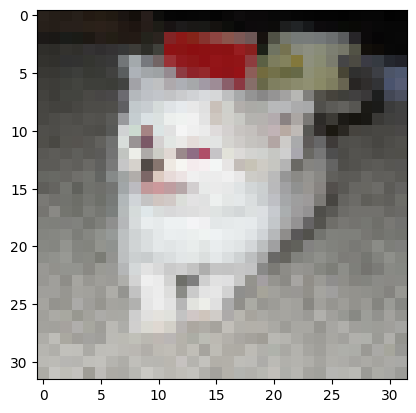

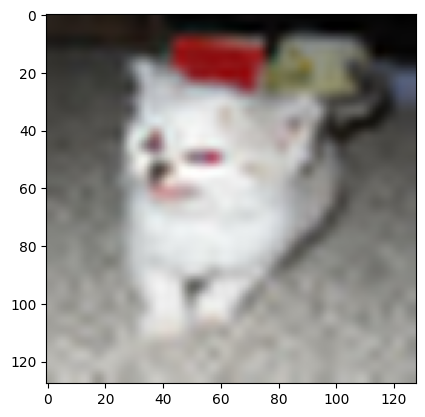

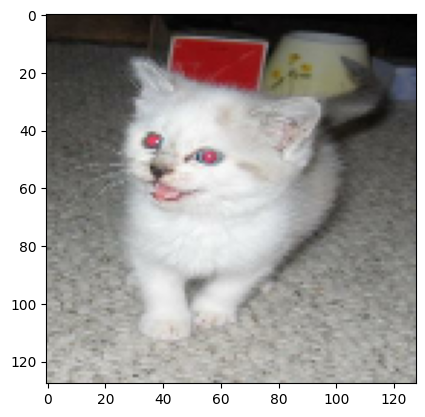

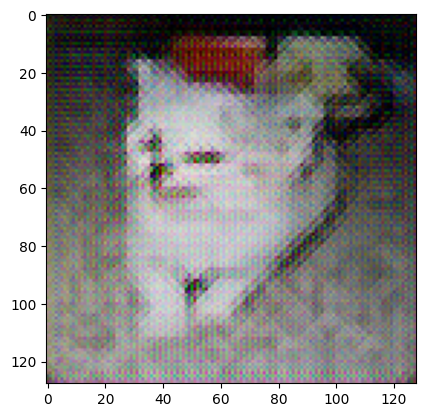

In [20]:
train_dataset_mapped = train_data.map(build_data,num_parallel_calls=tf.data.AUTOTUNE)
for x in train_dataset_mapped.take(1):
  plt.figure()
  plt.imshow(x[0].numpy())
  plt.show()
  plt.imshow(bicubic_interpolate(x[0].numpy(),(128,128)))
  plt.show()
  plt.imshow(x[1].numpy())
  plt.show()

  pred=SRResnet(x[0].numpy().reshape(1,32,32,3))
  plt.imshow(pred[0])
  plt.show()

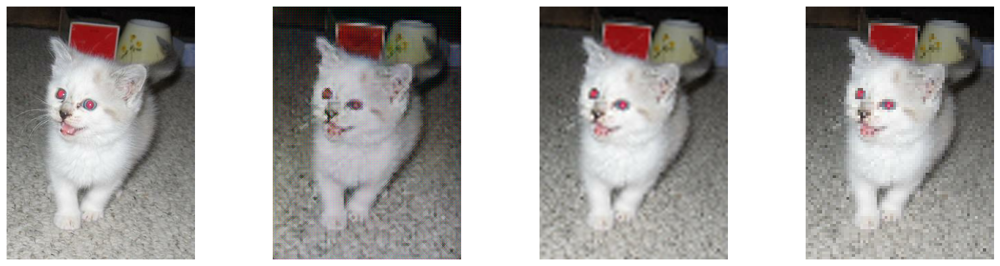

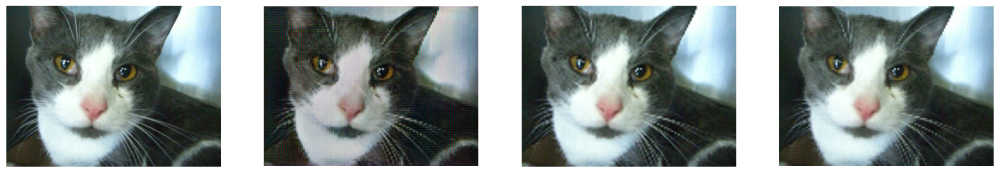

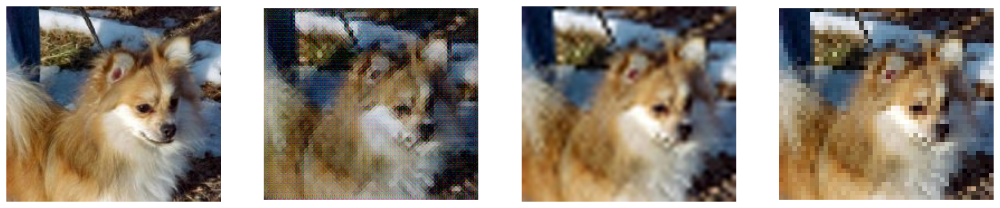

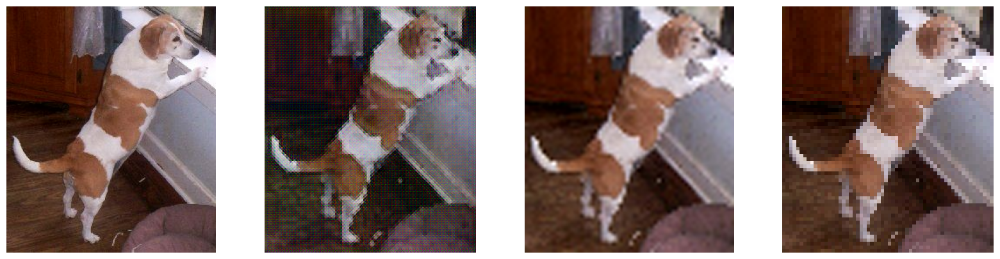

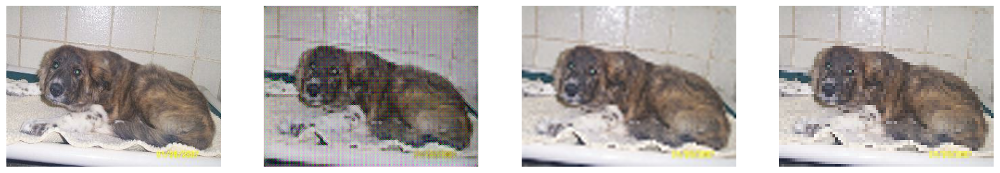

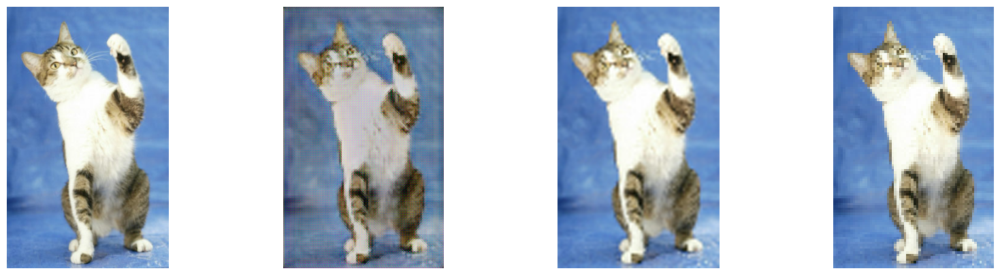

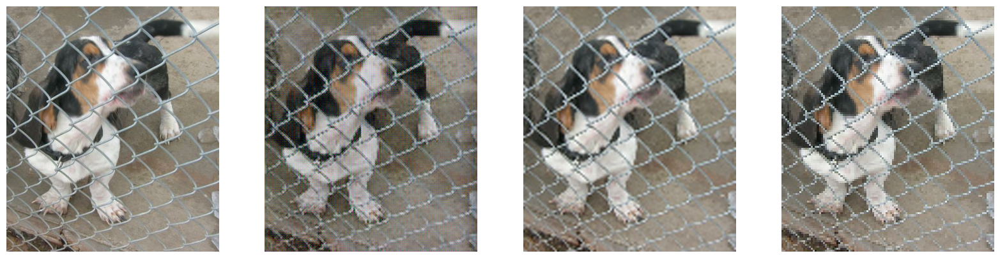

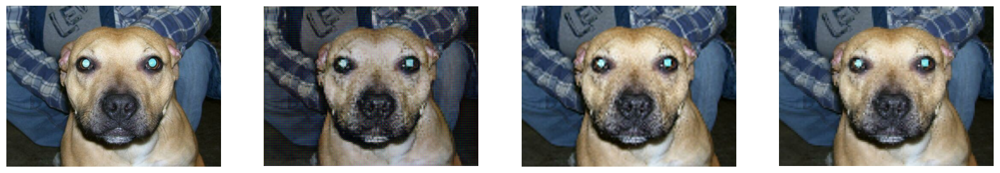

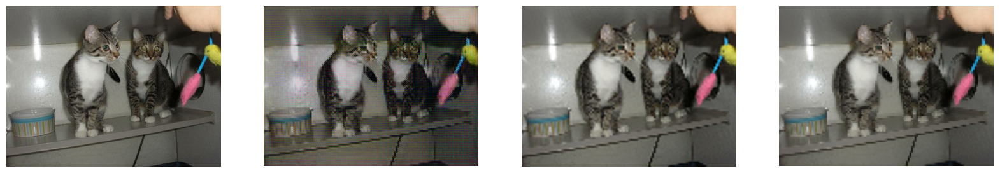

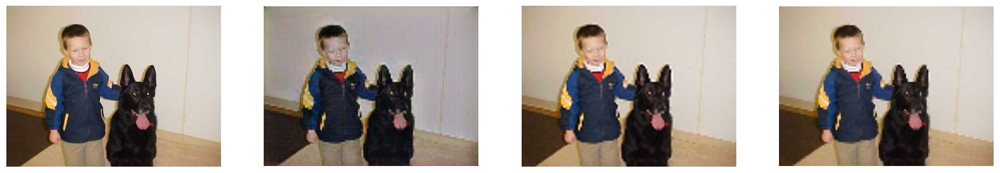

In [21]:
train_dataset_mapped = train_data.map(build_data,num_parallel_calls=tf.data.AUTOTUNE)
for x in train_data.take(10):
  fig=plt.figure(figsize=(20,5))
  im=x['image'].numpy()
  plt.subplot(1,4,1)
  plt.imshow(im)
  plt.axis('off')

  plt.subplot(1,4,4)
  lr=bicubic_interpolate(im,(im.shape[1]//4,im.shape[0]//4))
  plt.imshow(lr)
  plt.axis('off')

  plt.subplot(1,4,2)
  pred=SRResnet(np.array([lr])/255)
  plt.imshow(pred[0].numpy())
  plt.axis('off')

  plt.subplot(1,4,3)
  bic=bicubic_interpolate(lr,(im.shape[1],im.shape[0]))
  plt.imshow(bic)
  plt.axis('off')

  plt.show()
  #print(x['image'].numpy(),lr)
  #print('Bicubic PSNR:',PSNR(x['image'].numpy(),lr),'  SRCNN PSNR:',PSNR(x['image'].numpy(),pred[0].numpy()))